In [1]:
## Import des librairies + chemin à l'image
import os

os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant')

import matplotlib as mp
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import glob
import sys
import scipy
from spectral_analysis_functions import *
from scipy.interpolate import interpolate
from scipy.interpolate import RectBivariateSpline
from scipy.interpolate import griddata
# Using OceanDataLab reader 
#from sentinel2_l1c import *
import numpy as np
from S2_read import *
from s2_angs import *
bands=['B04','B08','B03','B02'];  



# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWL_20160827T065722.SAFE/'
S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWN_20160827T065722.SAFE/'

# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXL_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXM_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXN_20160827T065722.SAFE/'

# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYL_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYM_20160827T065722.SAFE/' # A VERIFIER
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYN_20160827T065722.SAFE/'




In [2]:
XML_File = find('MTD_TL.xml', S2path)
XML_File_DS=find('MTD_DS.xml',S2path)
if XML_File is None:
    print("Le fichier 'MTD_TL.xml' n'a pas été trouvé dans le répertoire spécifié:", S2path)

Mother_box=[0,11000,0,11000]

taille_boite=500
width=(Mother_box[1] - Mother_box[0]) // taille_boite 
length=(Mother_box[3] - Mother_box[2]) // taille_boite 

boxi=[3000, 3500, 1000, 1500]

# U = np.zeros((width, length))
# V = np.zeros((width, length))
# coordlon = np.zeros((width, length))
# coordlat = np.zeros((width, length))

print('widht',width)
print('length',length)

widht 22
length 22


/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA


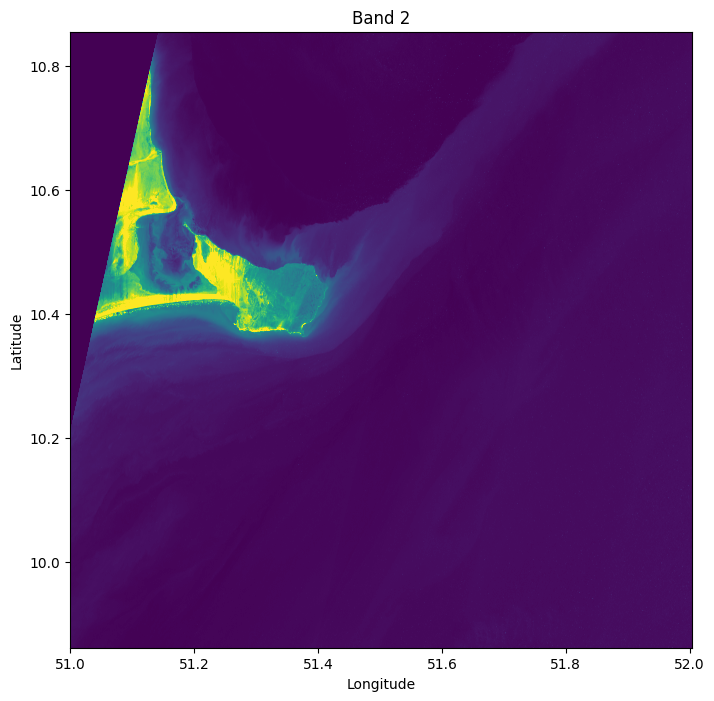

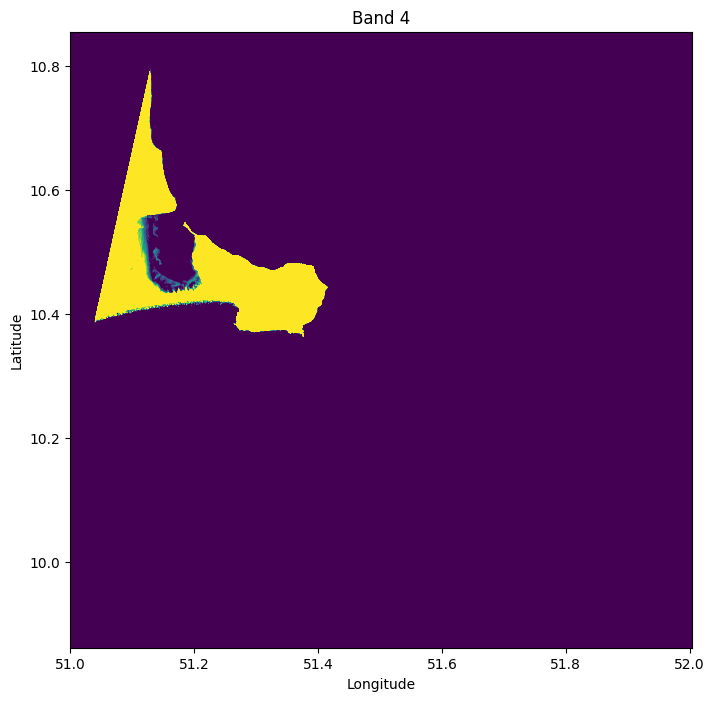

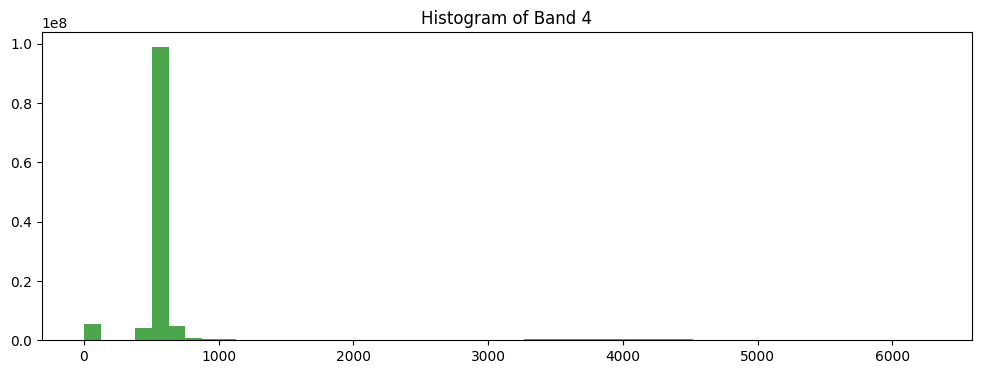

[50.9998170118793, 52.00436820558485, 9.860923091666987, 10.855481221564638]


/tmp/ipykernel_123671/292770347.py:40: UserWarning: Adding colorbar to a different Figure <Figure size 1200x400 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  plt.colorbar(im)


<Figure size 640x480 with 0 Axes>

minlon 50.9998170118793
minlat 9.860923091666987
maxlon 52.00436820558485
maxlat 10.855481221564638


In [3]:
%run Visualisation_image.ipynb
# corriger le niveau pour les cartes

In [4]:
print('maxlon=',maxlon)
print('minlon=',minlon)
print('maxlat=',maxlat)
print('minlat=',minlat)


maxlon= 52.00436820558485
minlon= 50.9998170118793
maxlat= 10.855481221564638
minlat= 9.860923091666987


test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading file for band  B02 : /home/a

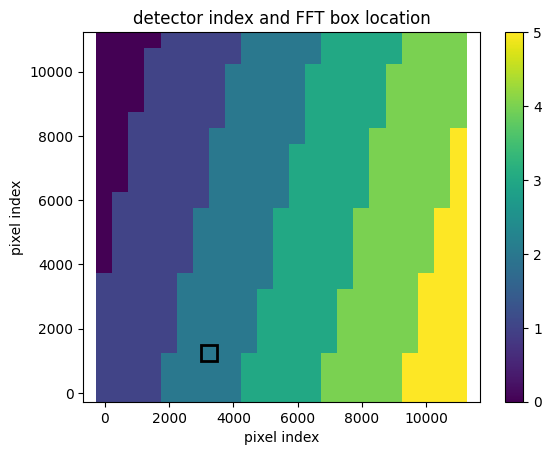

[[0 0 0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4]
 [0 0 0 1 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4]
 [0 0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4]
 [0 0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4]
 [0 0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4]
 [0 0 1 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4]
 [0 0 1 1 1 1 1 2 2 2 2 2 2 3 3 3 3 4 4 4 4 4 5]
 [0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5]
 [0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5]
 [0 0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5]
 [0 1 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5]
 [0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5]
 [0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5]
 [0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5]
 [0 1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5]
 [1 1 1 1 1 2 2 2 2 2 2 3 3 3 3 3 4 4 4 4 5 5 5]
 [1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5 5]
 [1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5 5]
 [1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5 5]
 [1 1 1 1 1 2 2 2 2 2 3 3 3 3 3 4 4 4 4 4 5 5 5]
 [1 1 1 1 2 2 2 2 2 

In [5]:
[imgs,NX,NY,nx,ny,dx,dy,offspec,phitrig,thetav,loncenter,latcenter,detector,indexX,indexY]=S2_read(S2path,boxi,bands)
array1=np.squeeze(detector[1,:,:])
fig, ax = plt.subplots() 
im=ax.pcolor(indexX,indexY,array1)
fig.colorbar(im)
ax.set_title('detector index and FFT box location')
ax.set_xlabel('pixel index')
ax.set_ylabel('pixel index')
ax.axis('equal')
rect = mp.patches.Rectangle((boxi[0], boxi[2]), boxi[1]-boxi[0], boxi[3]-boxi[2], linewidth=2,
                         edgecolor='k', facecolor="none")
# rect1 = mp.patches.Rectangle((boxi1[0], boxi1[2]), boxi1[1]-boxi1[0], boxi1[3]-boxi1[2], linewidth=2,
#                          edgecolor='r', facecolor="none")
# ax.add_patch(rect1)

ax.add_patch(rect)
plt.show()
print(array1)


In [6]:
# # Exemple d'une seule boîte 

# # boxi=[Mother_box[0],Mother_box[0]+800,Mother_box[2],Mother_box[2]+800]
# # boxi=[2500,2600,2500,2600]

# # Exemple de boite
# taille_boite=500
# # mapping = {
# #     1: 'D01',
# #     2: 'D02',
# #     3: 'D03',
# #     4: 'D04',
# #     5: 'D05',
# #     6: 'D06',
# #     7: 'D07',
# #     8: 'D08',
# #     9: 'D09',
# #     10: 'D10',
# #     11: 'D11',
# #     12: 'D12'
# # }

# # #
# # Dx=(Mother_box[1]-Mother_box[0])/taille_boite
# # Dy=(Mother_box[3]-Mother_box[2])/taille_boite
# # #
# # x_centers = np.arange(Mother_box[0] + taille_boite/2, Mother_box[1], taille_boite)
# # y_centers = np.arange(Mother_box[2] + taille_boite/2, Mother_box[3], taille_boite)
# # x_grid, y_grid = np.meshgrid(x_centers, y_centers)

# # points = np.column_stack((indexX_detec, indexY_detec))


# # interpolated_value=np.round(griddata(points,zone_detec,(x_grid, y_grid),method='linear'))
# # print(interpolated_value)

# # boxi=[6000,6800,8000,8800]
# Sat='A'
# %run S2_get.ipynb

# # [imgs1,NX,NY,nx,ny,dx,dy,offspec,phitrig,thetav,loncenter,latcenter,detector,indexX,indexY]=S2_read(S2path,boxi1,bands)
# print('width=',width)
# print('length=',length)
# print('U and V components of current :',X)
# coord_lon=loncenter
# coord_lat=latcenter

# print('lon,lat:',loncenter,latcenter)

In [7]:
print(taille_boite)

500


box [500, 1000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading f

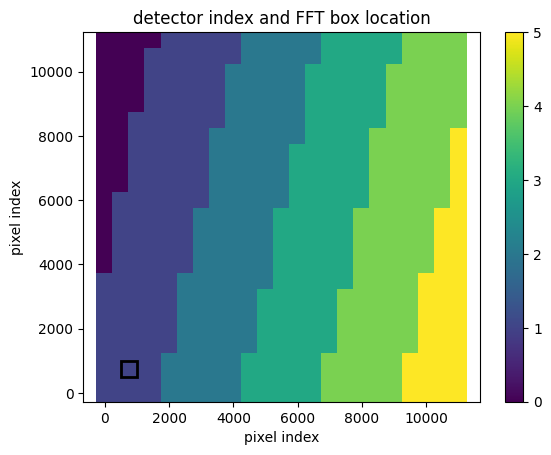

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076484294161396
(31, 31)
(31, 31)
(31, 31)


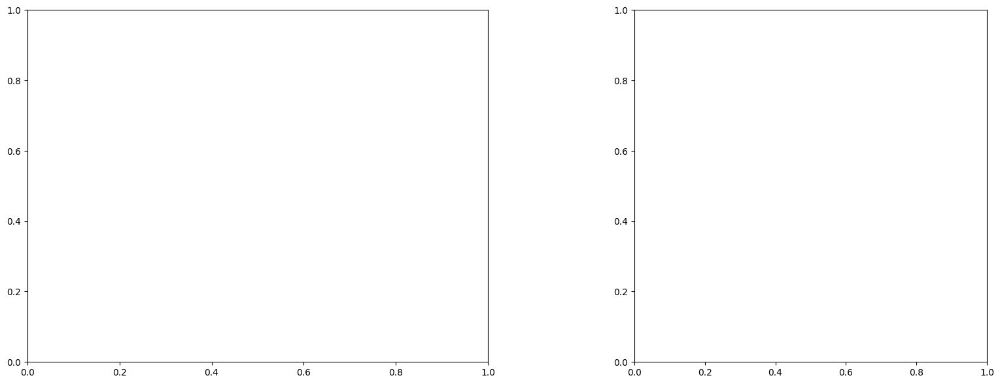

U and V components of current : [0.5945278  0.54671833]
uncertainties for U and V: 0.22434567806801858 0.18382051423804918


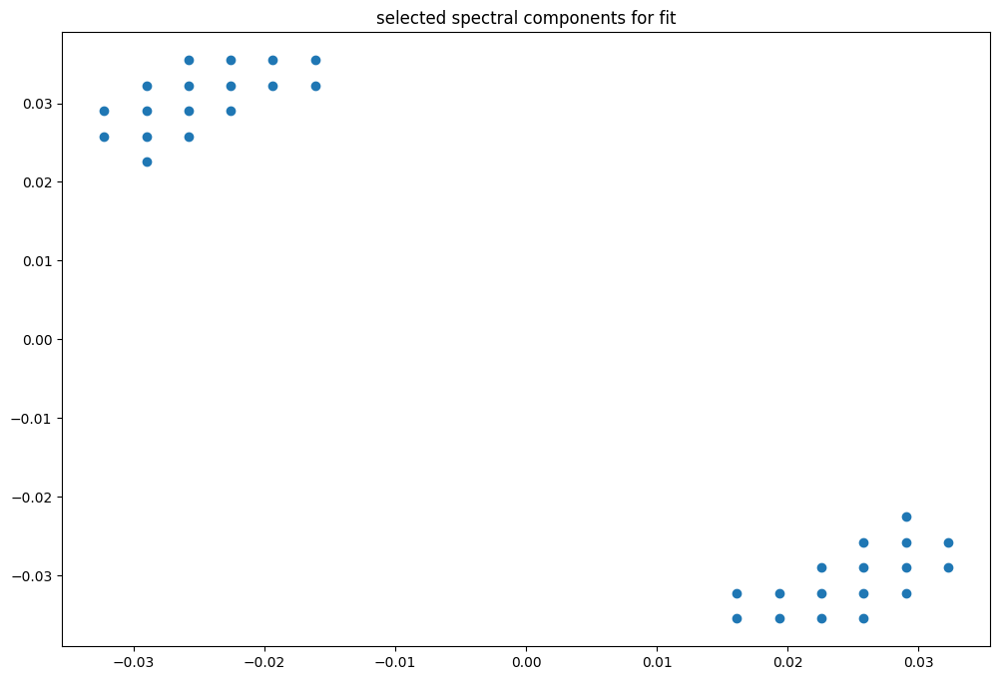

box [500, 1000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

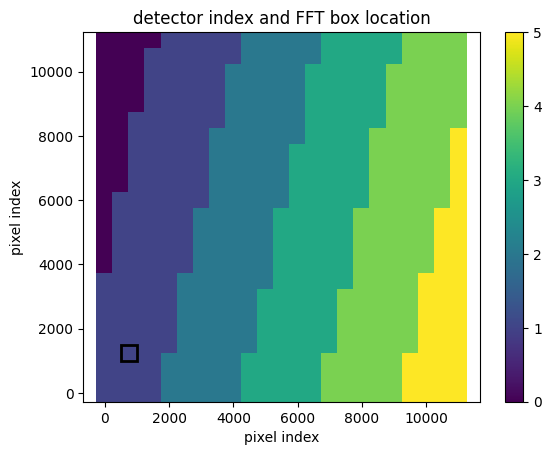

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076443785228635
(31, 31)
(31, 31)
(31, 31)


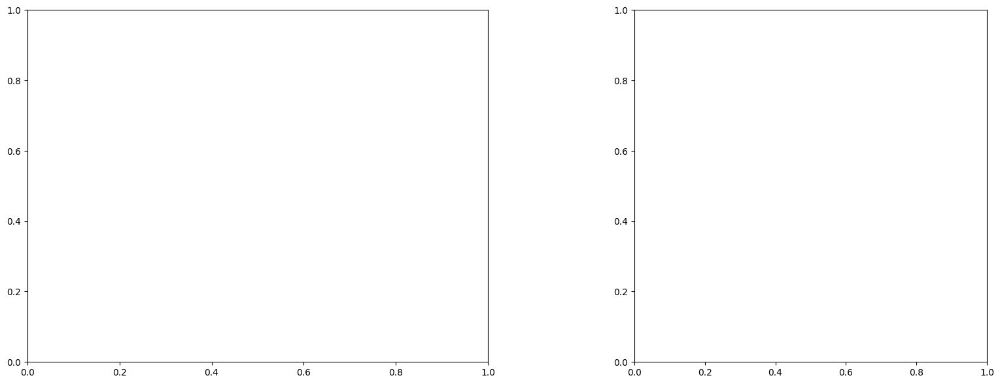

U and V components of current : [0.41267589 0.3577911 ]
uncertainties for U and V: 0.1994114727282 0.15731597435670888


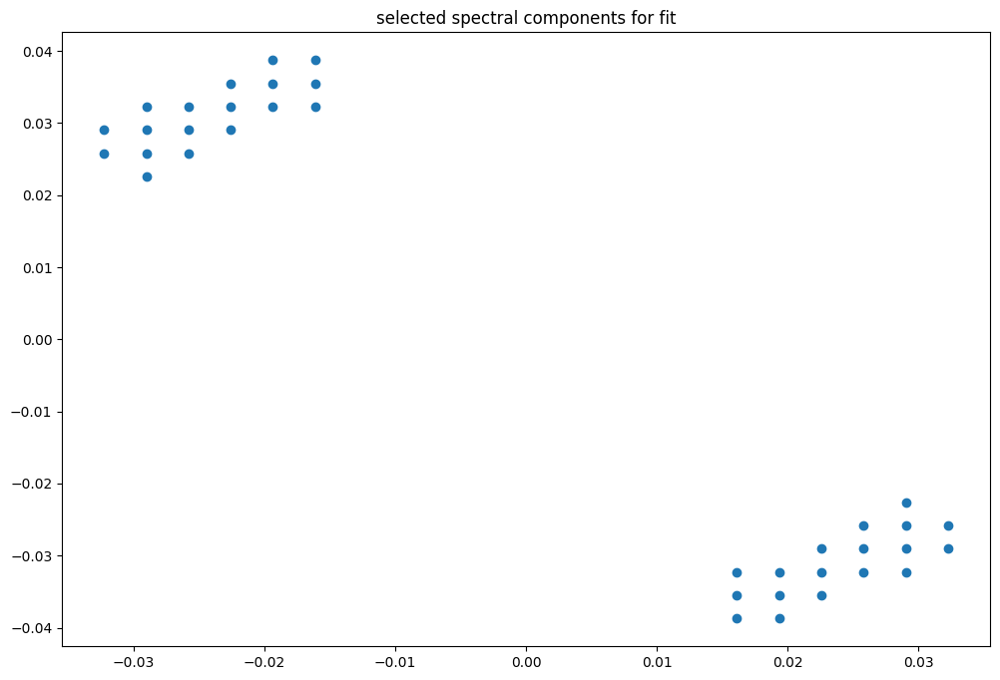

box [500, 1000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

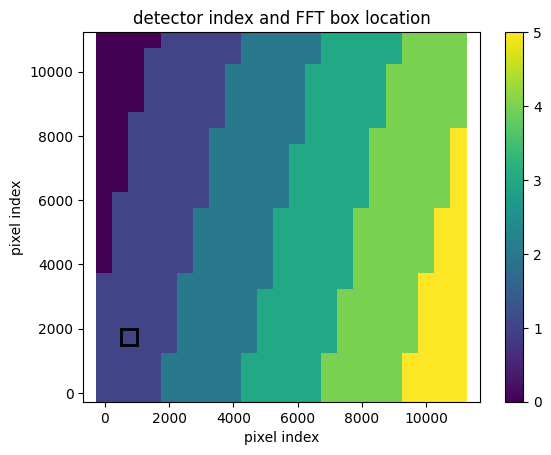

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076410180021975
(31, 31)
(31, 31)
(31, 31)


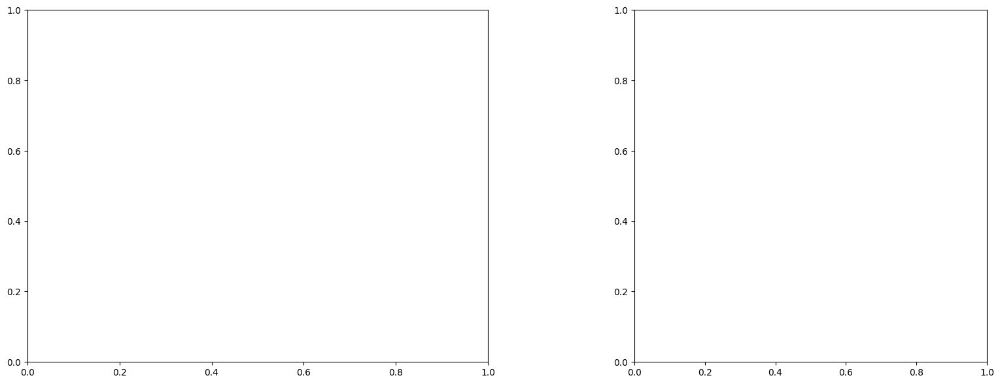

U and V components of current : [0.3993336 0.1825081]
uncertainties for U and V: 0.198744046700347 0.16836378356310186


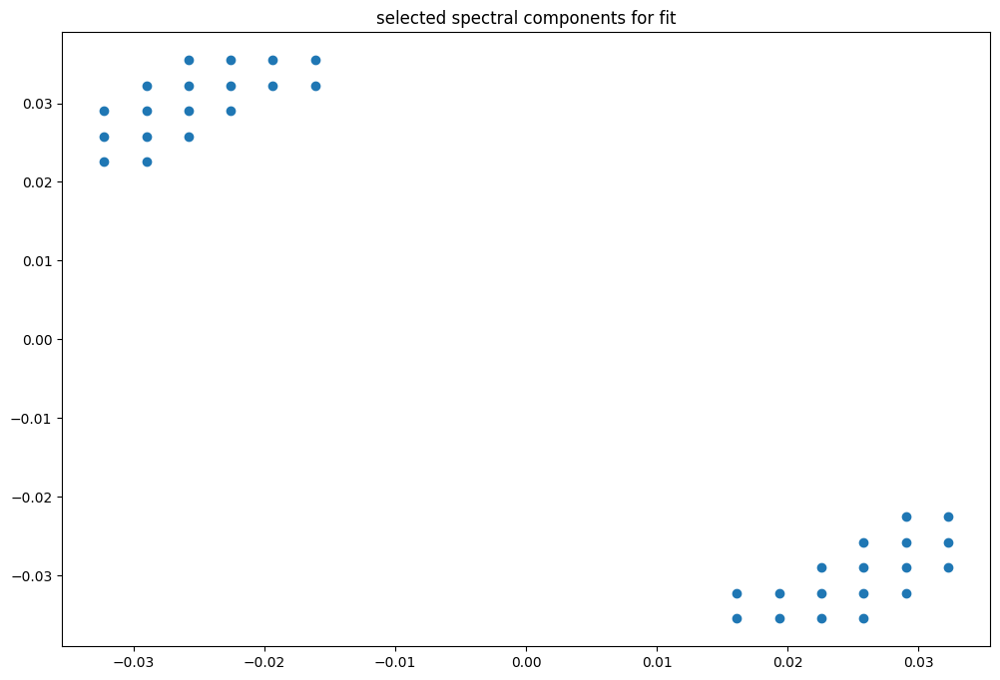

box [500, 1000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

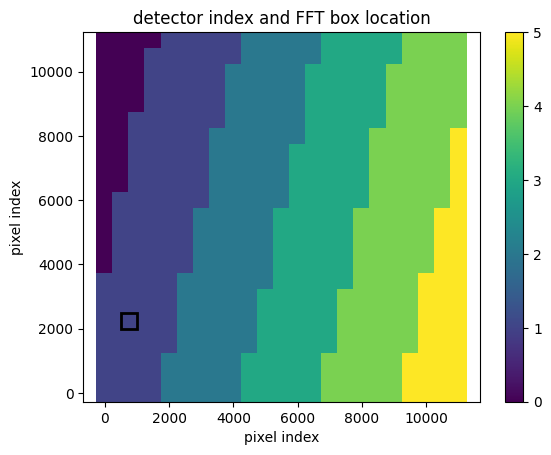

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076410180021975
(31, 31)
(31, 31)
(31, 31)


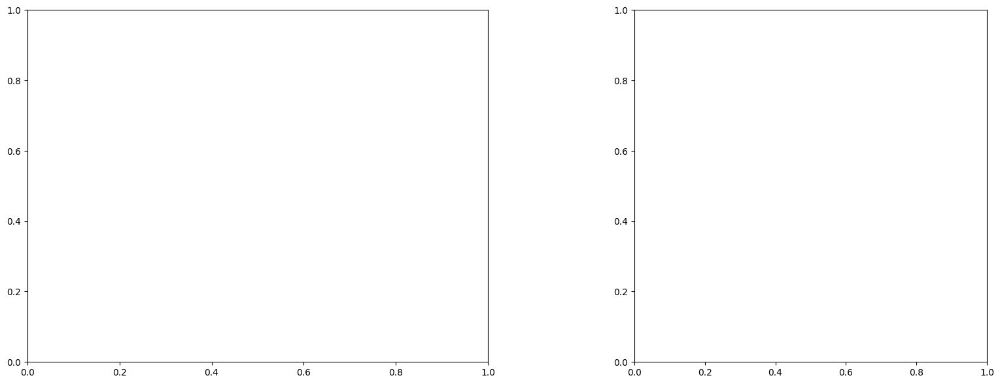

U and V components of current : [ 0.02710413 -0.03320841]
uncertainties for U and V: 0.20493389171674842 0.1781780616371959


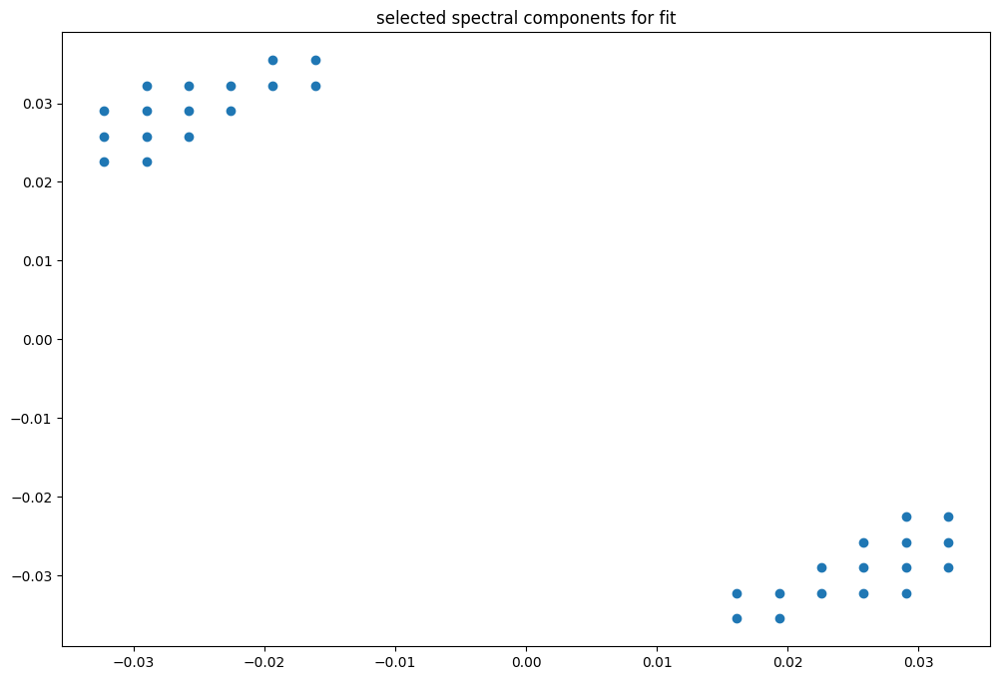

box [500, 1000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

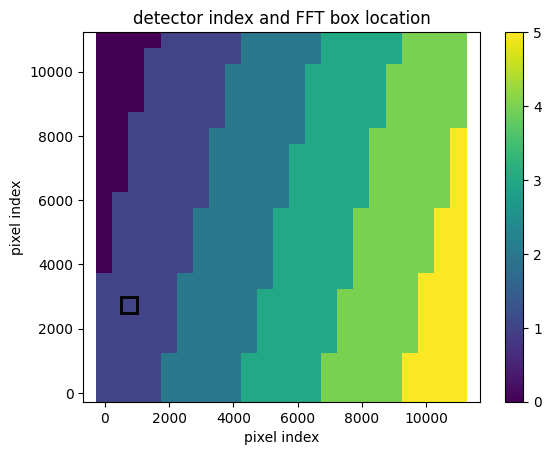

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076371759408578
(31, 31)
(31, 31)
(31, 31)


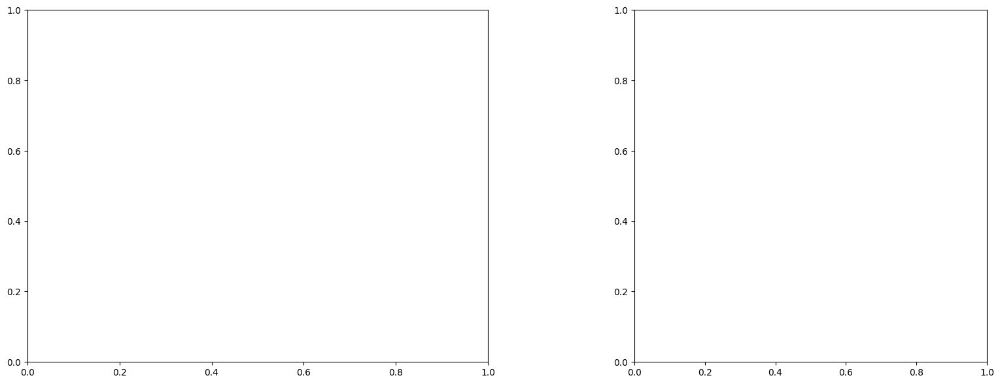

U and V components of current : [0.17937304 0.06375671]
uncertainties for U and V: 0.15363101016442587 0.1364215030257184


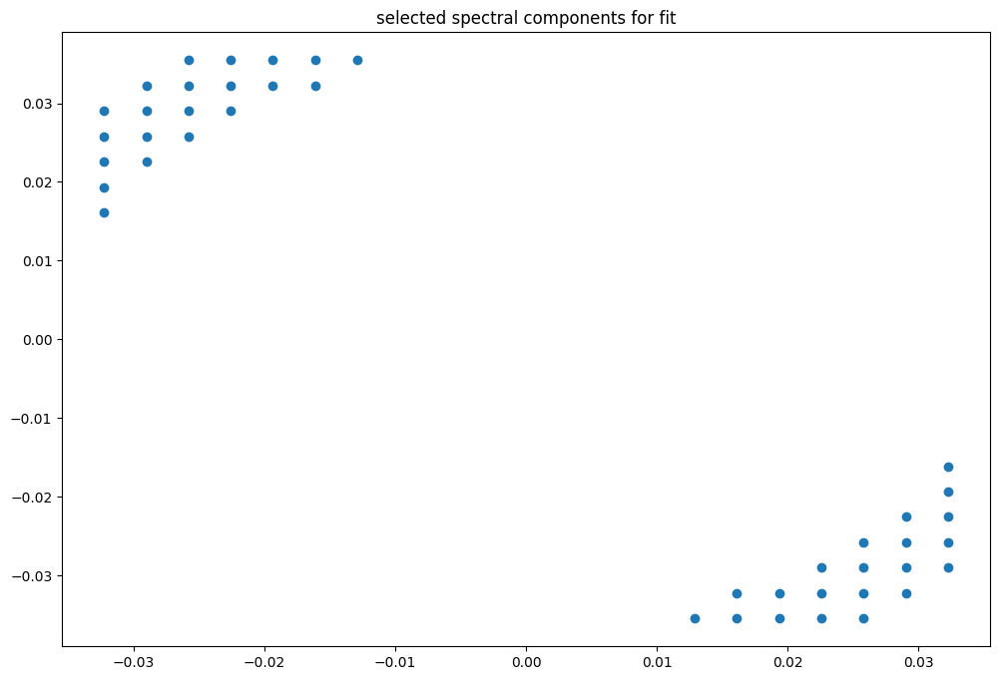

box [500, 1000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

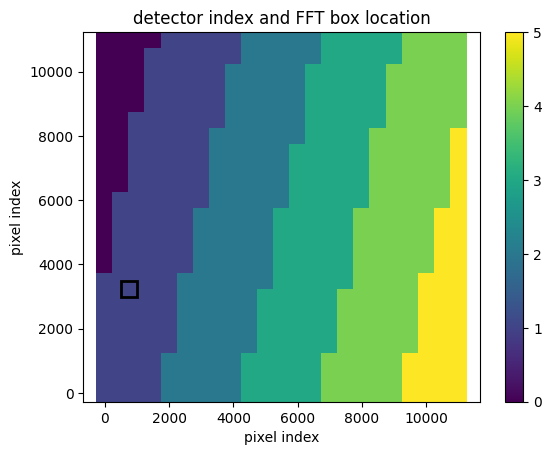

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007633656525753
(31, 31)
(31, 31)
(31, 31)


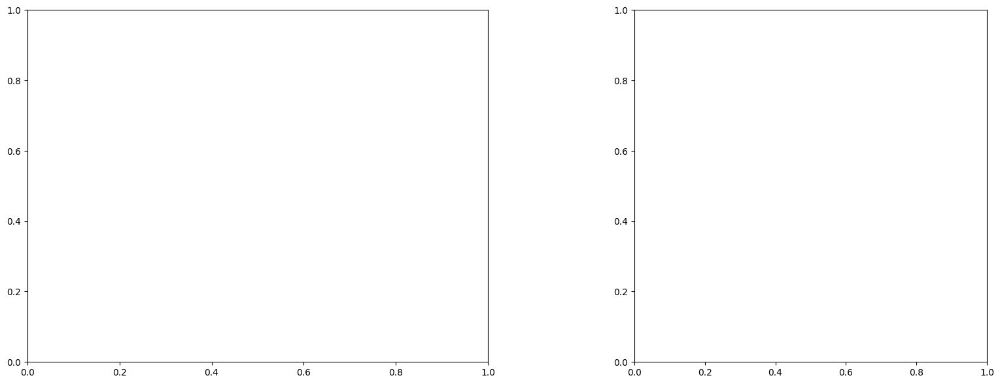

U and V components of current : [ 0.27929716 -0.07628527]
uncertainties for U and V: 0.1661463939407079 0.15103150380689792


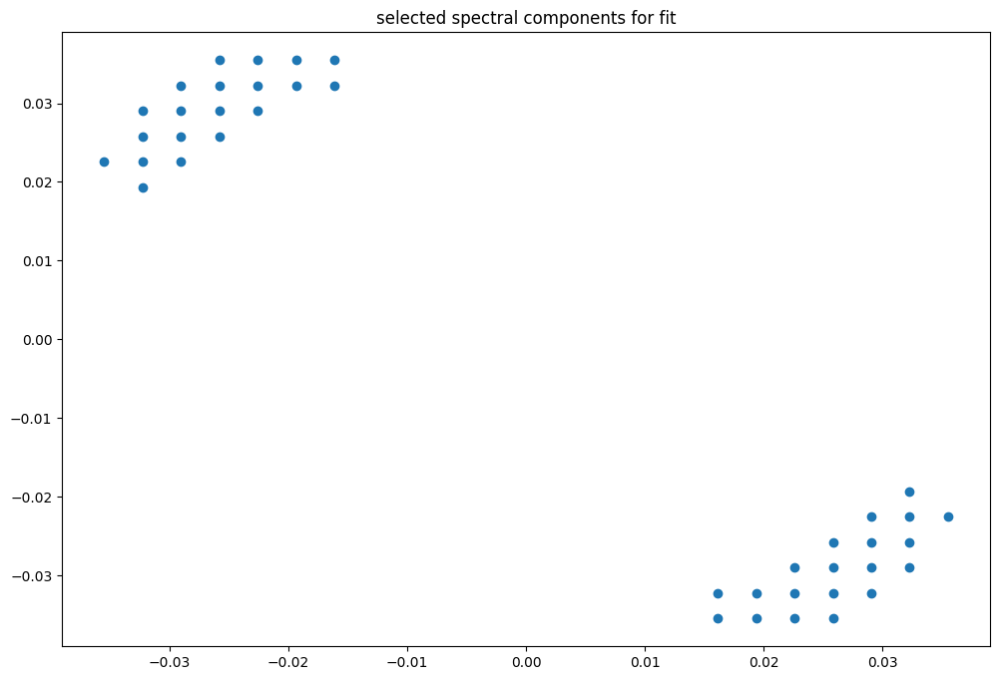

box [500, 1000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

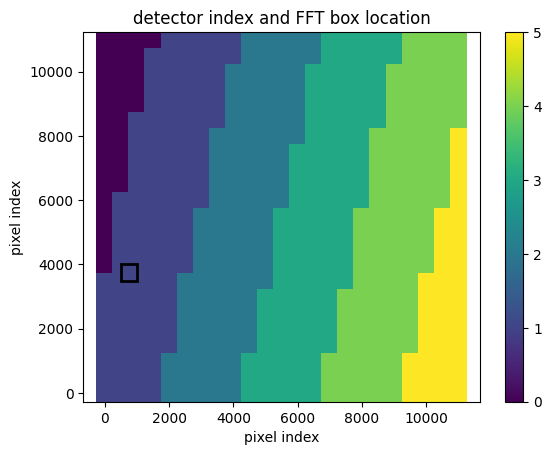

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007633656525753
(31, 31)
(31, 31)
(31, 31)


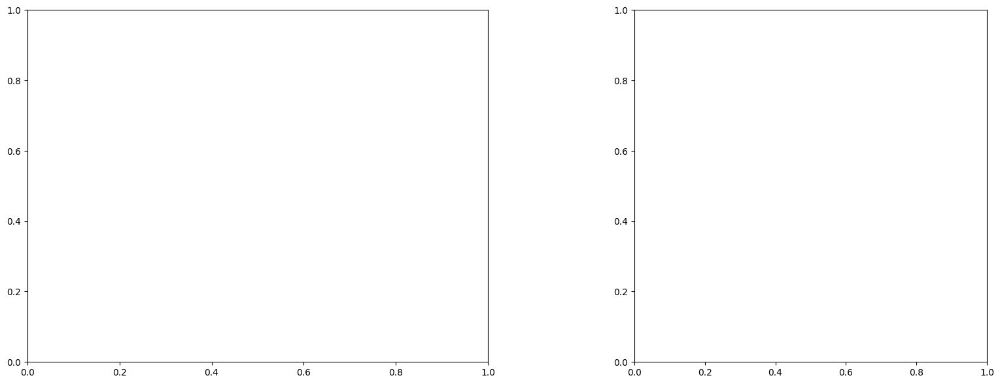

U and V components of current : [ 0.10317207 -0.16069861]
uncertainties for U and V: 0.1571981129853042 0.13924530680392394


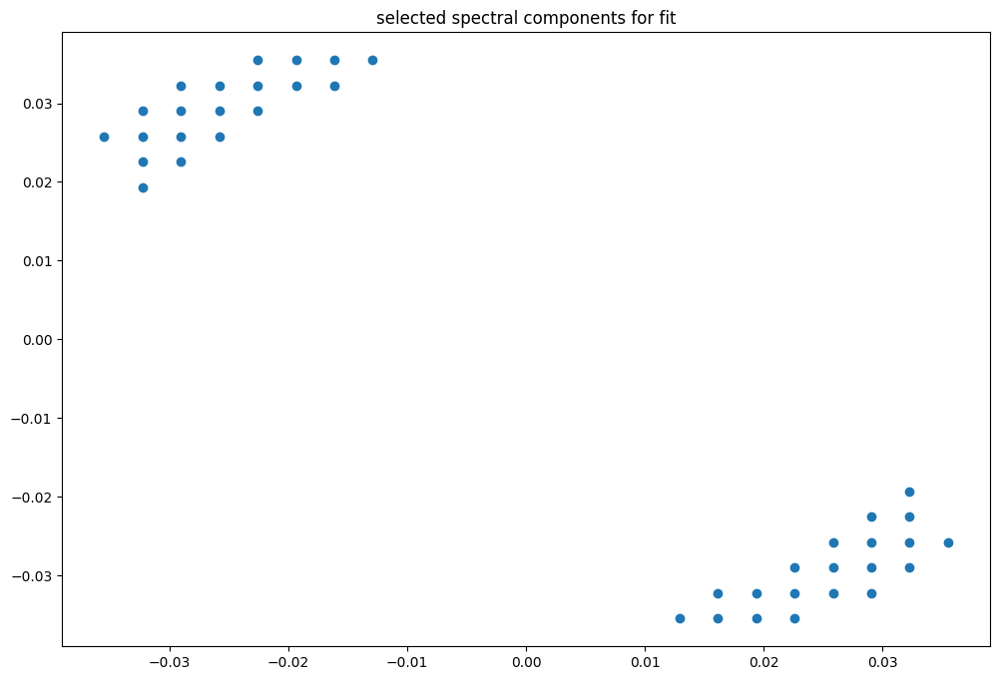

box [500, 1000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

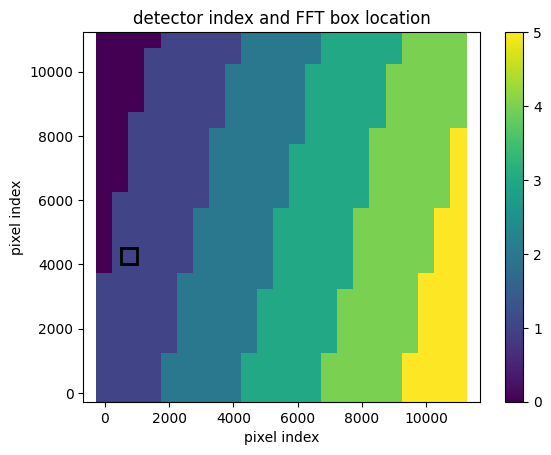

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


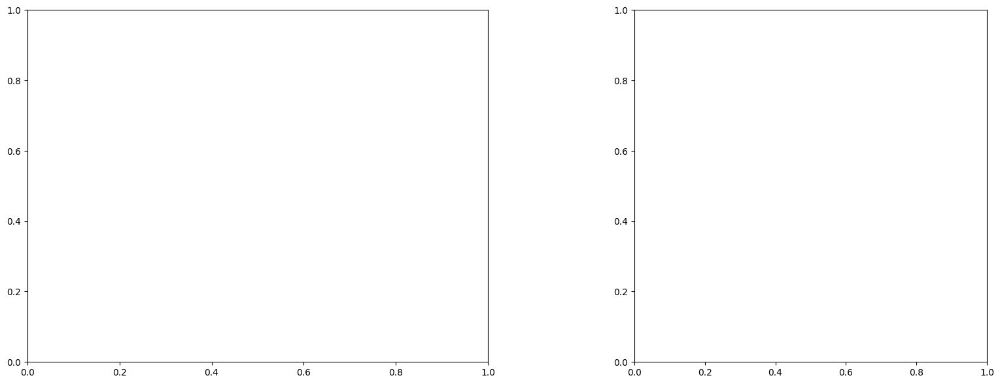

U and V components of current : [ 0.03246042 -0.2721326 ]
uncertainties for U and V: 0.19083322744988274 0.15257579642059207


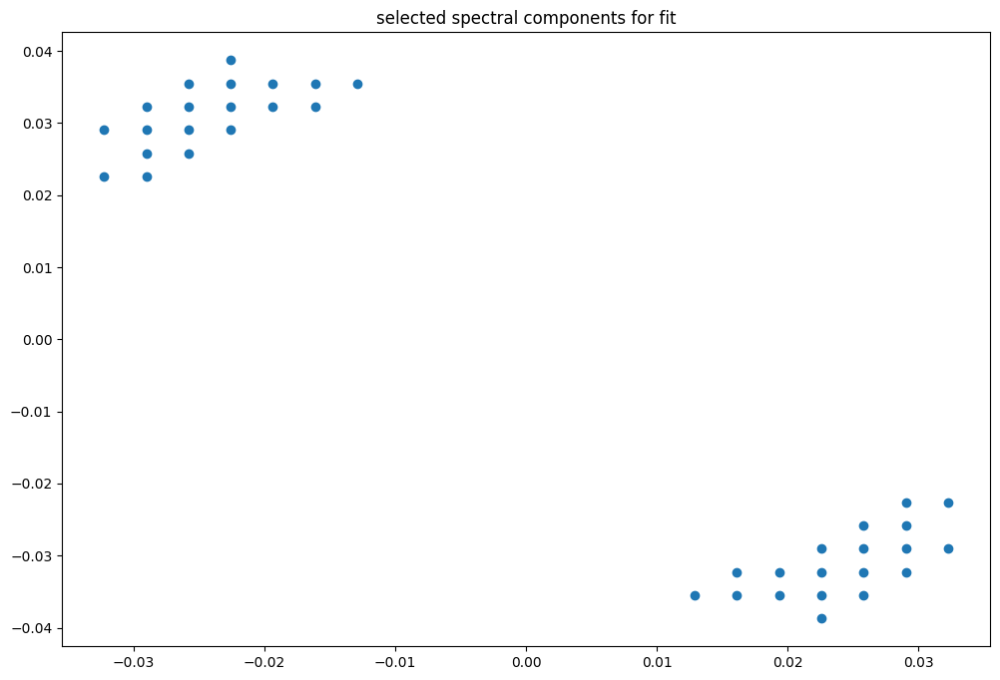

box [500, 1000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

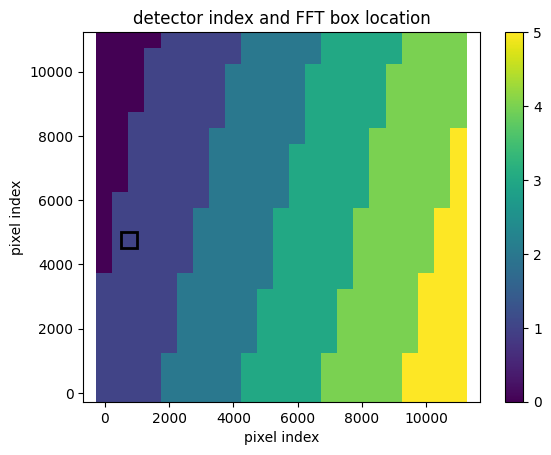

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007626729847849
(31, 31)
(31, 31)
(31, 31)


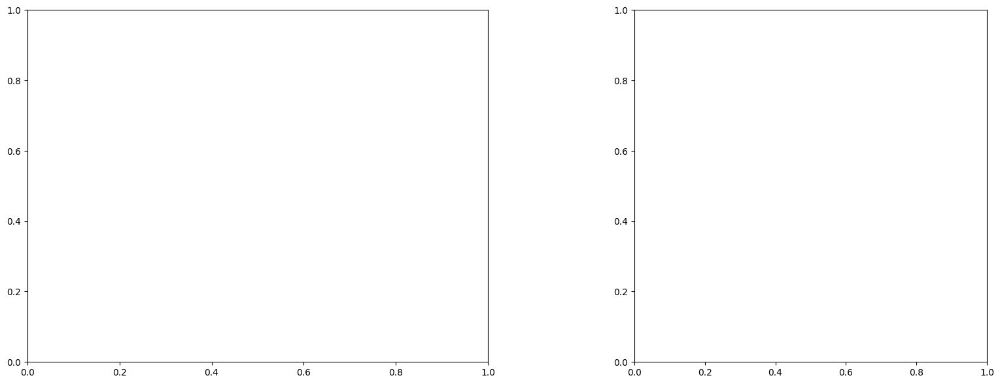

U and V components of current : [ 0.16165021 -0.45754884]
uncertainties for U and V: 0.15641605635671693 0.14319970029254028


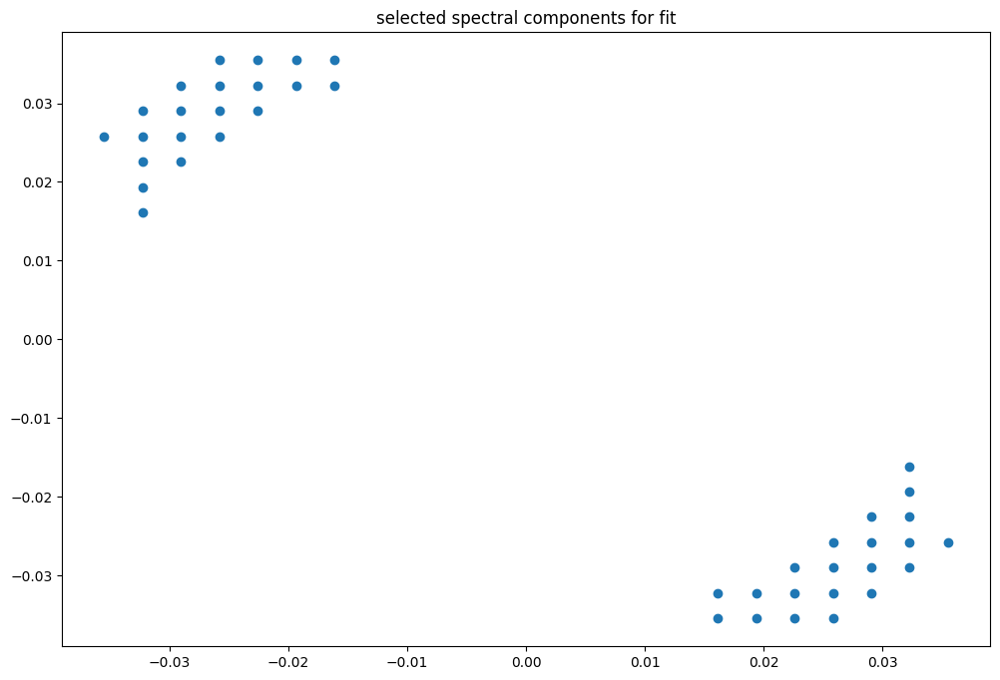

box [500, 1000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

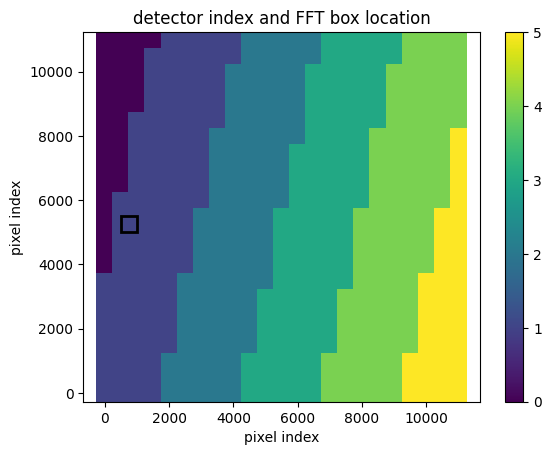

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


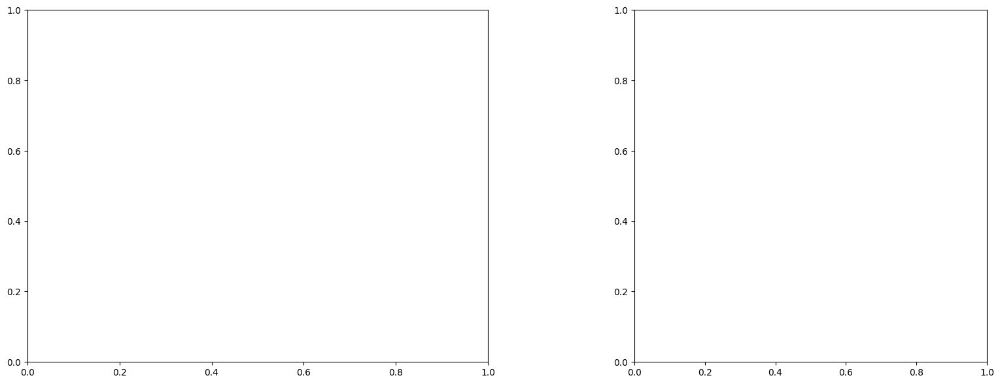

U and V components of current : [ 0.02441677 -0.74680429]
uncertainties for U and V: 0.1532188137721153 0.1445545237489229


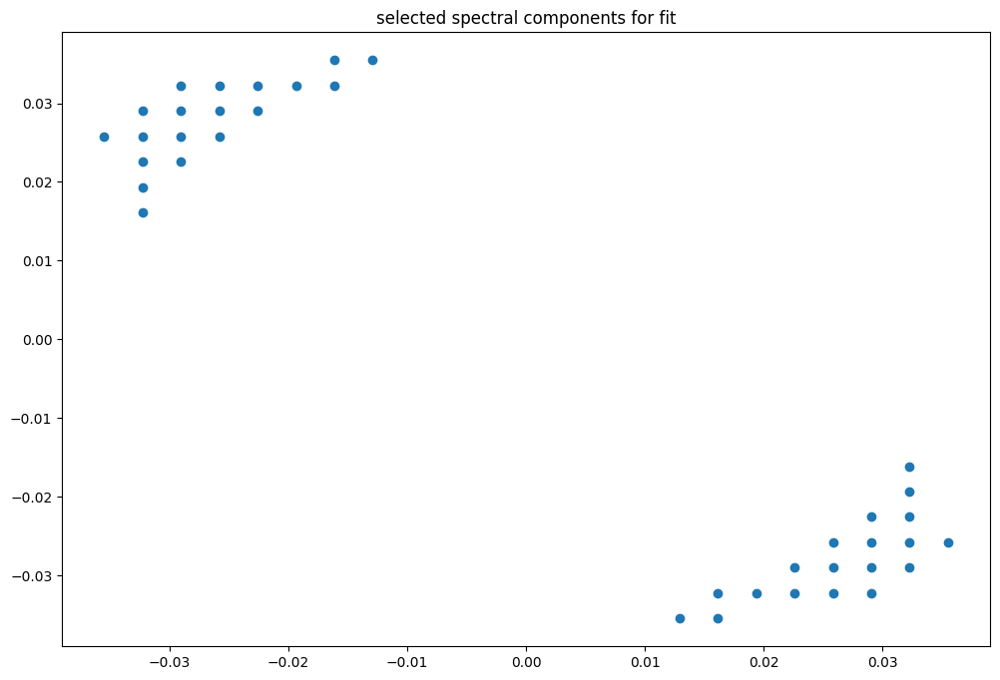

box [500, 1000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

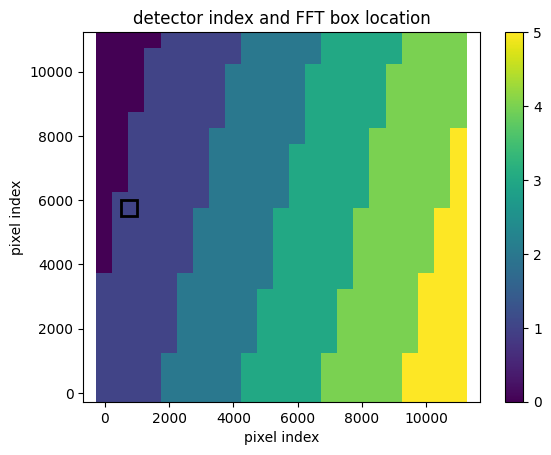

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


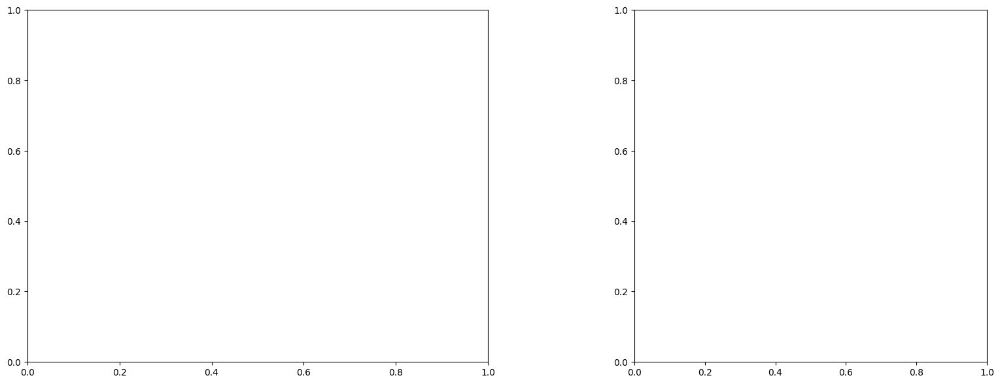

U and V components of current : [-1.12563353 -7.09006786]
uncertainties for U and V: 0.5807823295920032 0.4690183536554158


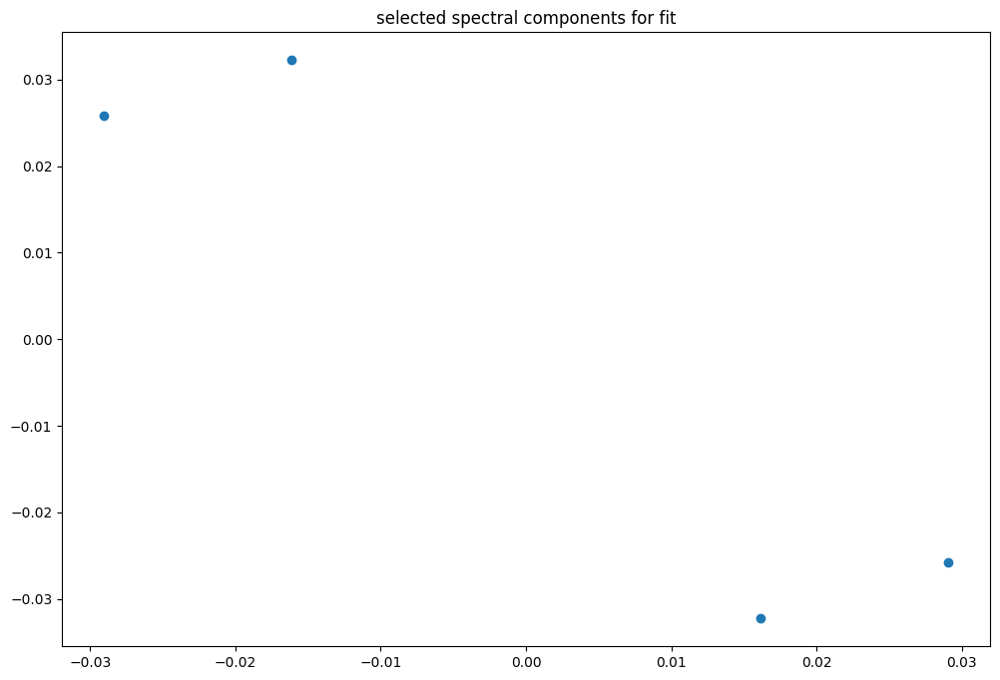

box [500, 1000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

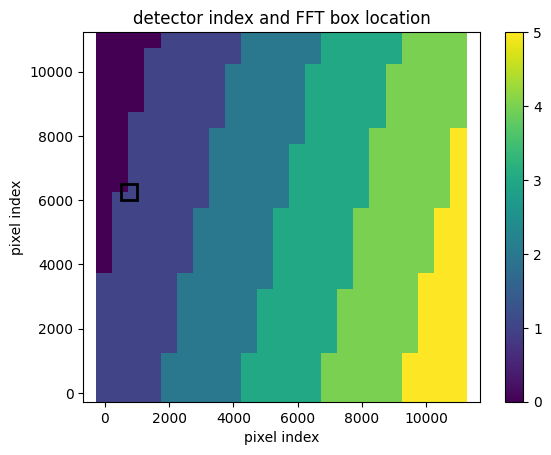

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:364: RuntimeWarning: invalid value encountered in divide
  phases[:, :, m] = tileFFT2_shift * np.conj(tileFFT1_shift) / (abs(tileFFT2_shift) * abs(tileFFT1_shift))


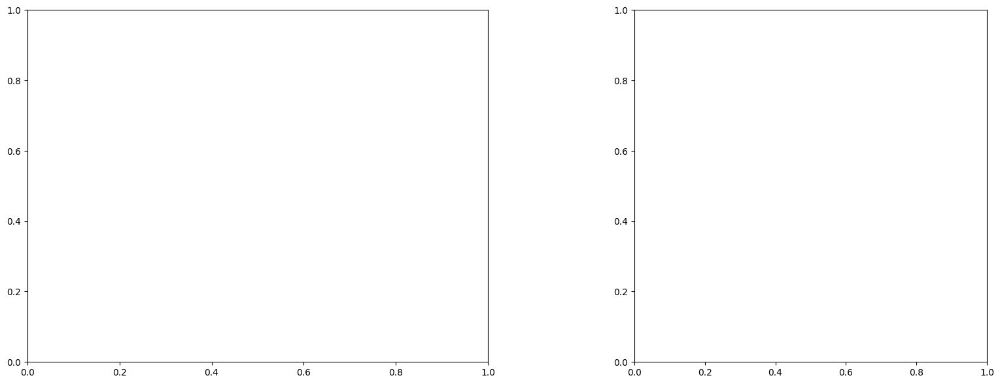

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

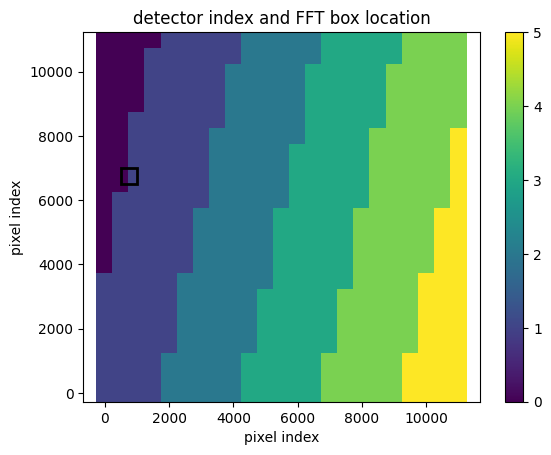

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


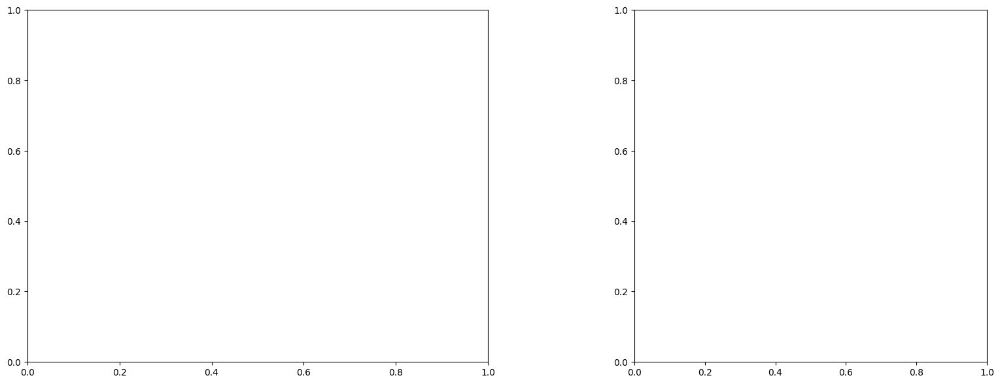

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

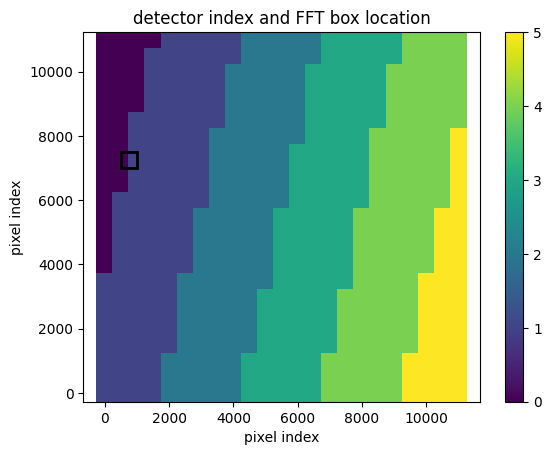

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.49999999999999994
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


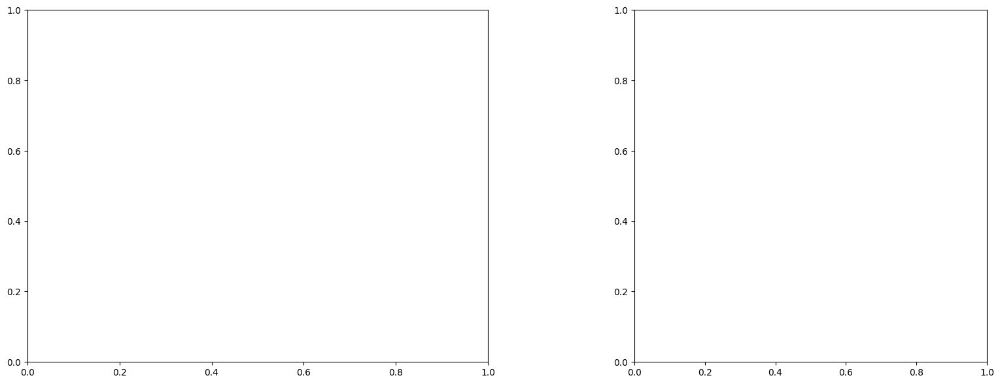

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

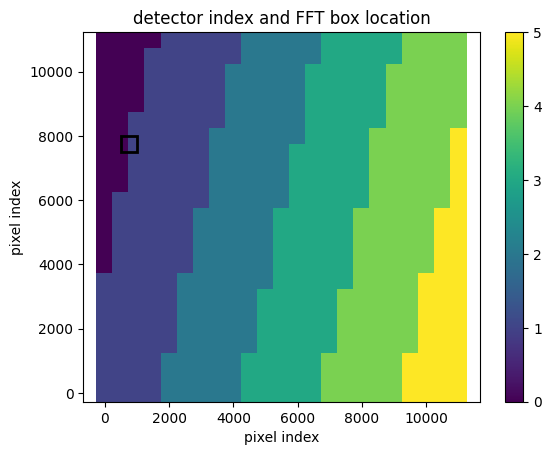

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:338: RuntimeWarning: Mean of empty slice
  array1[mask1] = np.nanmean(array1)
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:340: RuntimeWarning: Mean of empty slice
  array2[mask2] = np.nanmean(array2)
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_funct

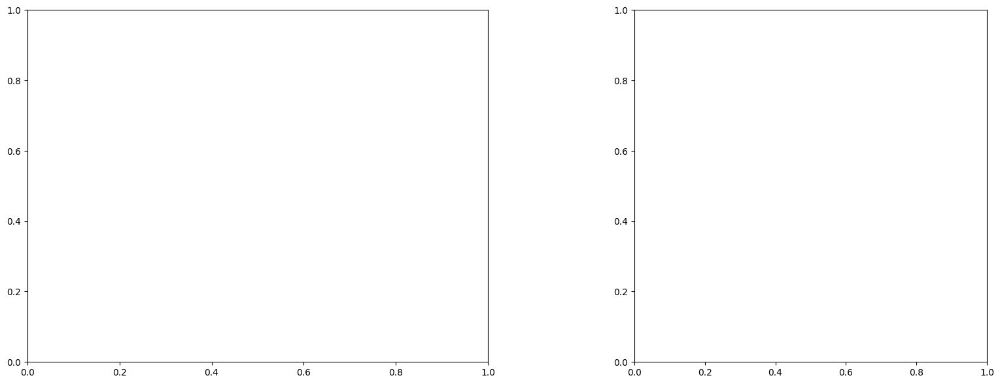

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

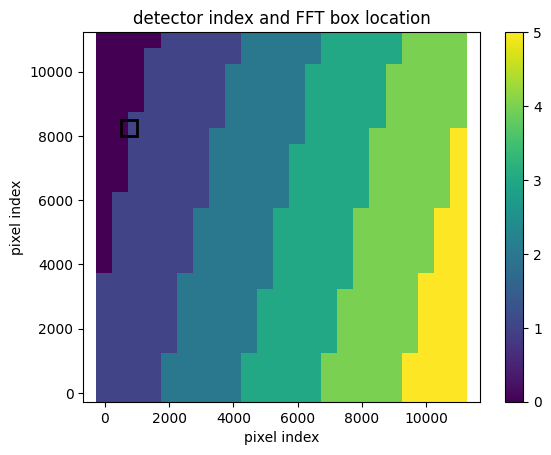

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


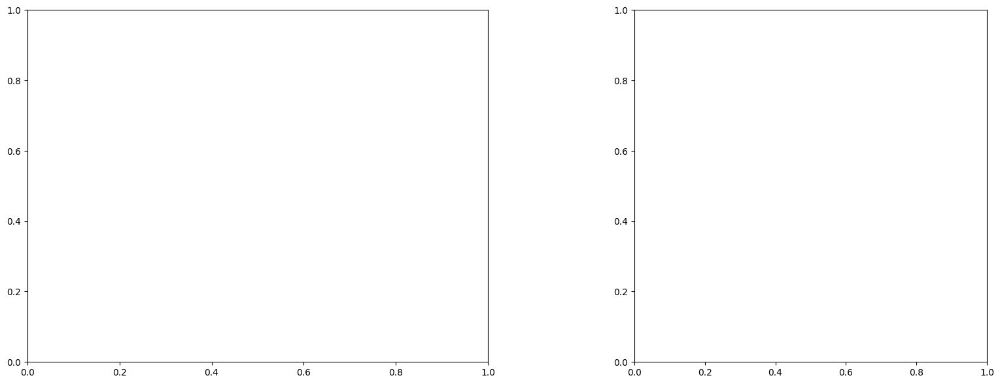

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

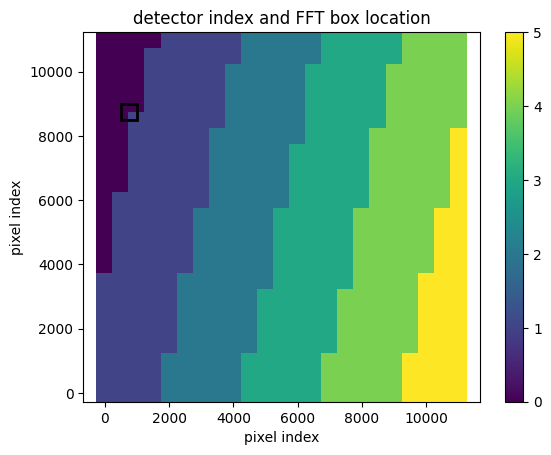

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.46
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


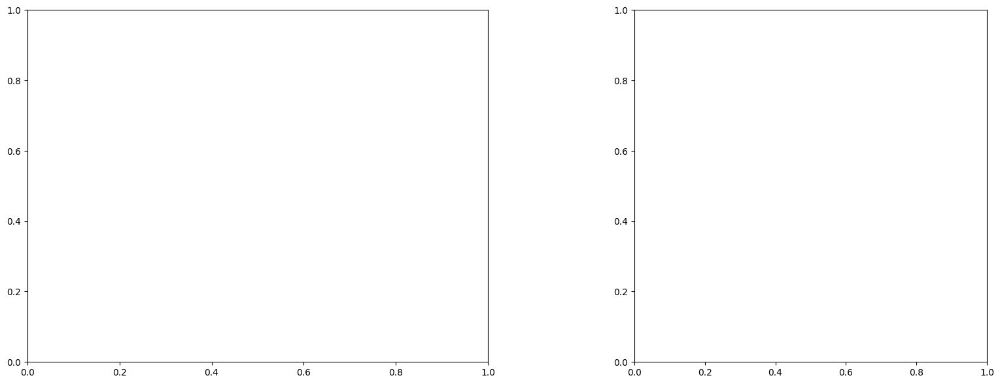

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

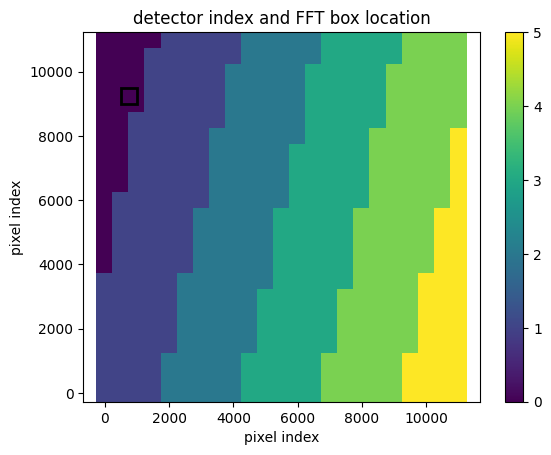

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


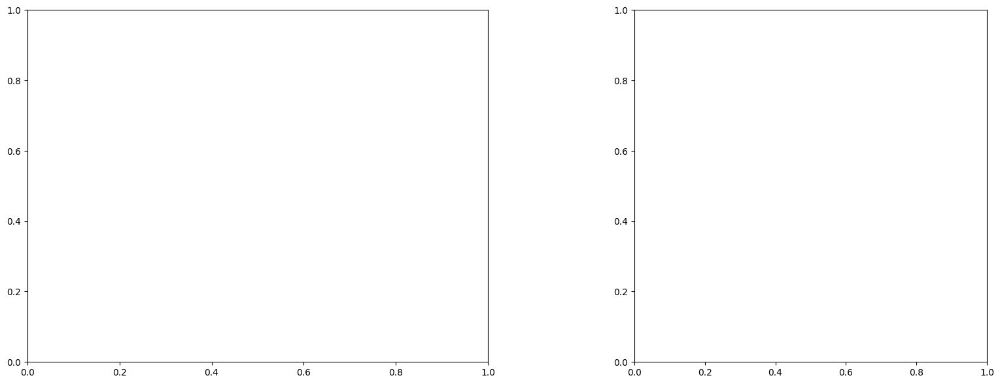

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

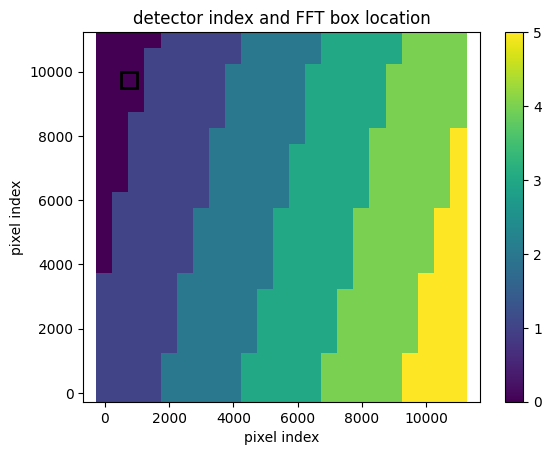

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


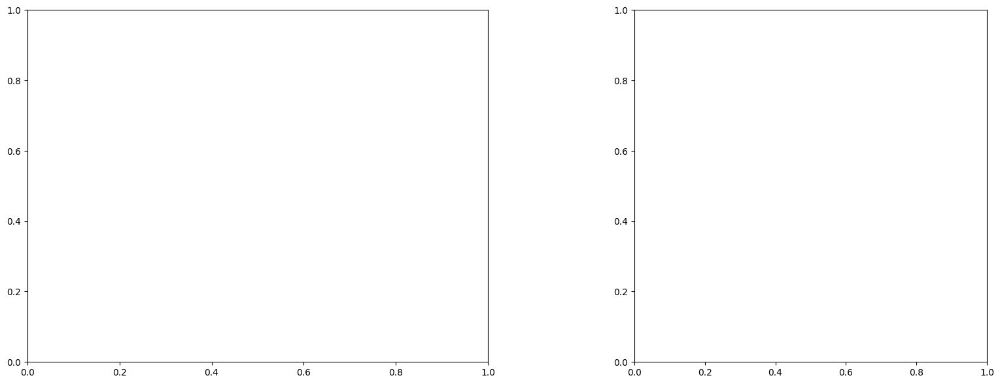

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

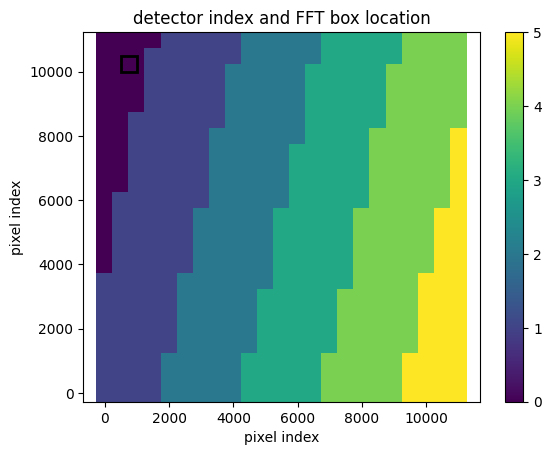

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


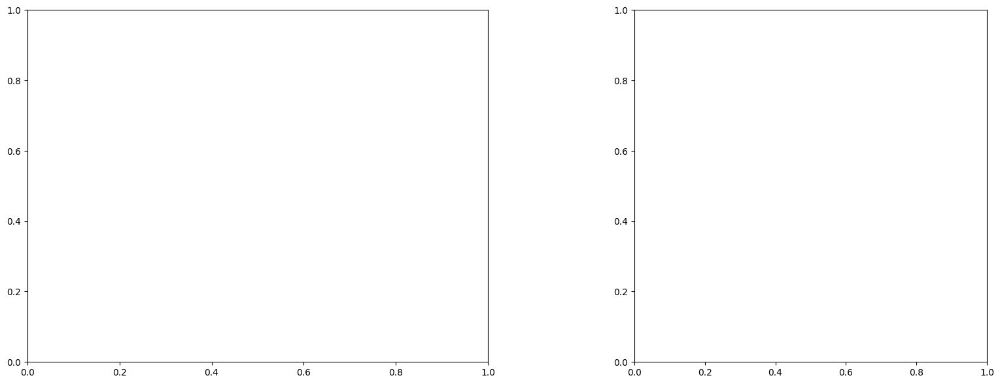

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

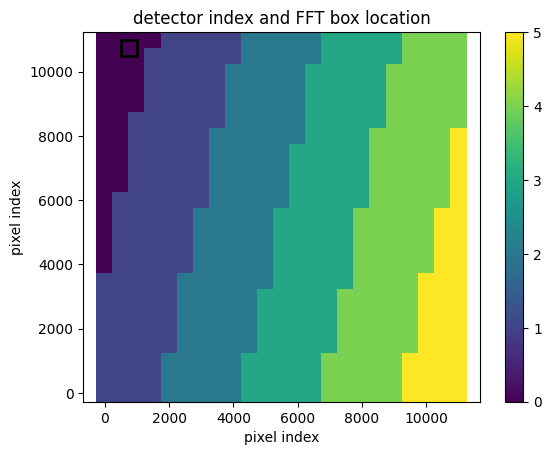

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 30)
(31, 30)
(31, 30)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


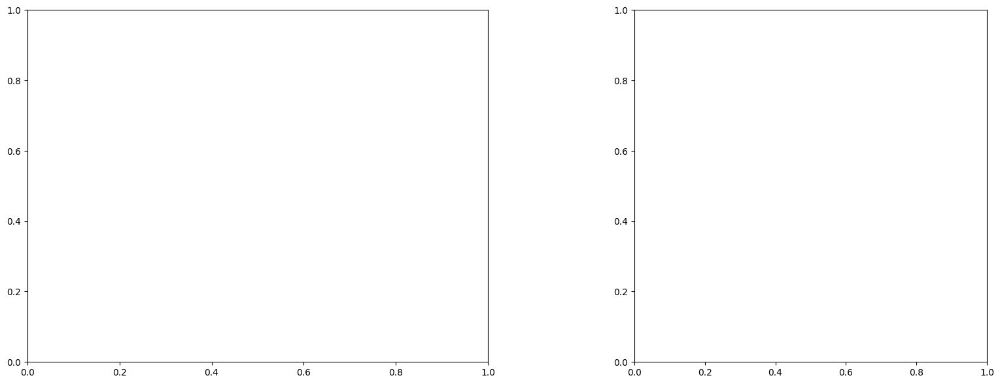

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

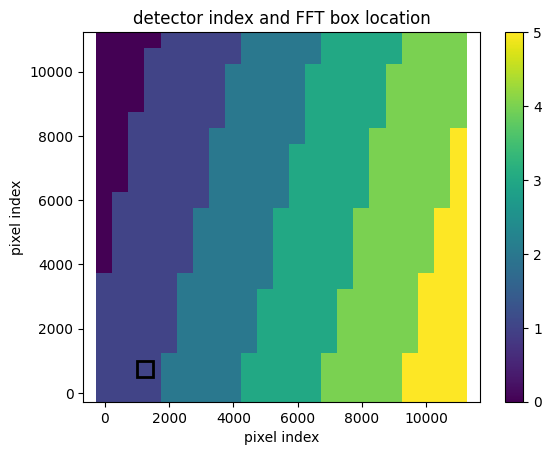

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076484294161396
(31, 31)
(31, 31)
(31, 31)


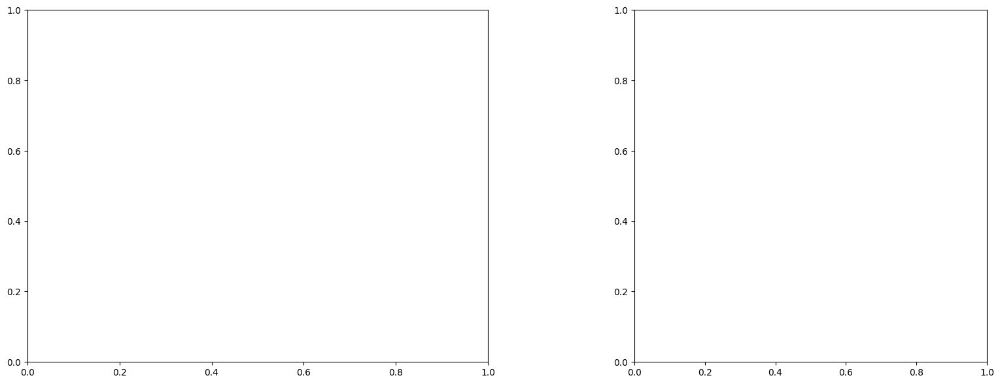

U and V components of current : [0.84540953 0.73707945]
uncertainties for U and V: 0.23059591171297628 0.2054714813691336


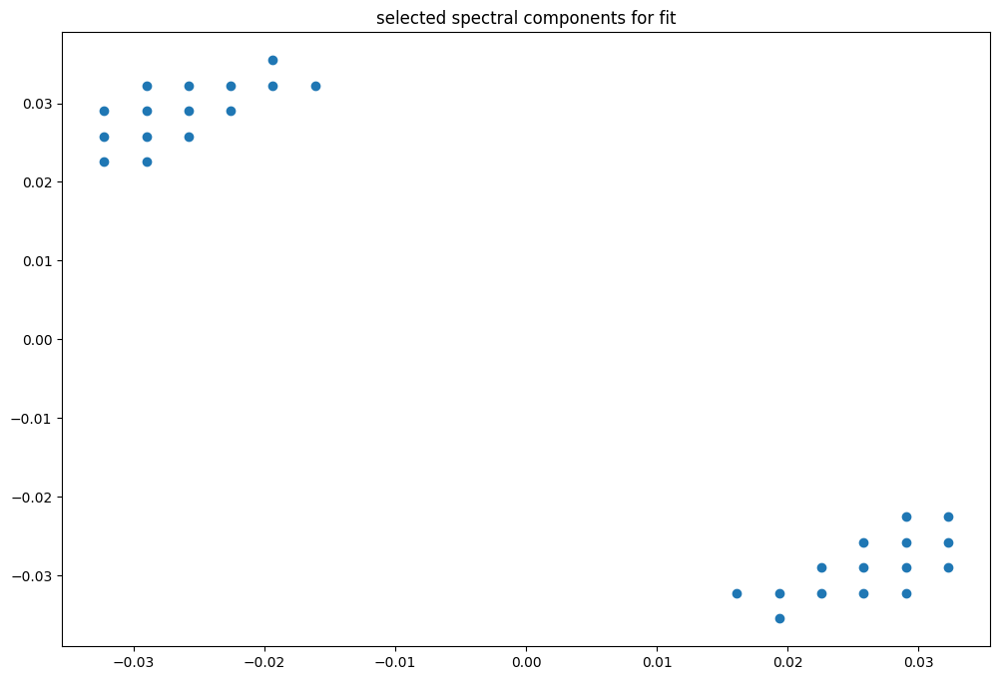

box [1000, 1500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

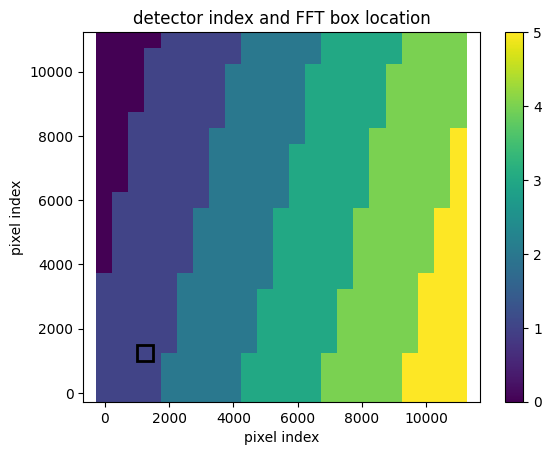

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076443785228635
(31, 31)
(31, 31)
(31, 31)


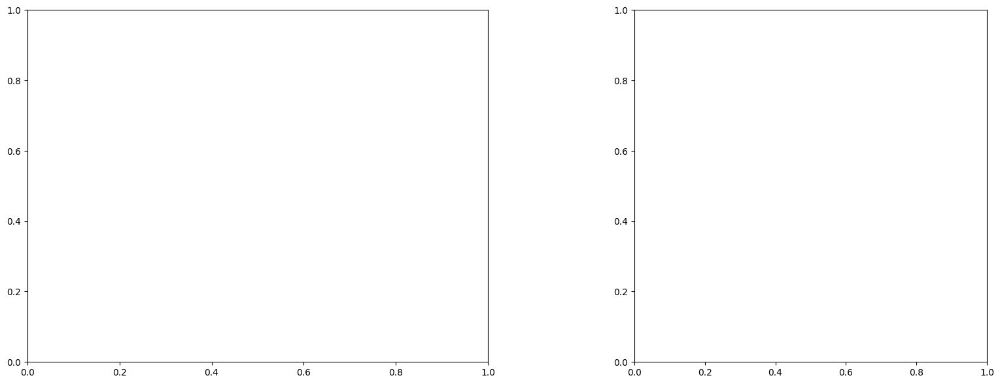

U and V components of current : [0.20158872 0.06502741]
uncertainties for U and V: 0.17031708270102622 0.13525377789795856


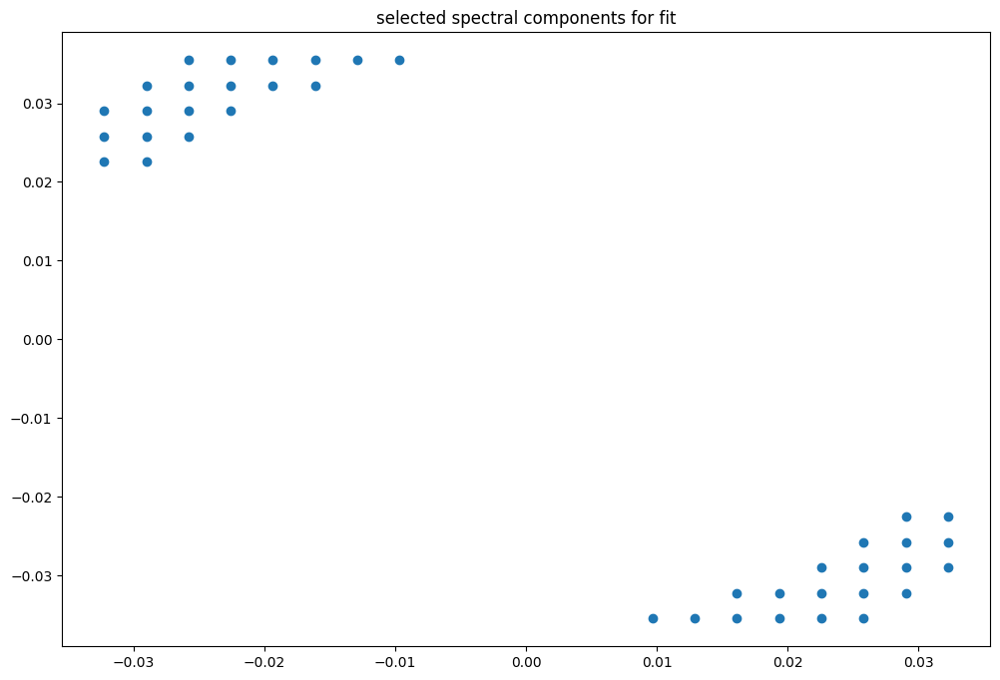

box [1000, 1500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

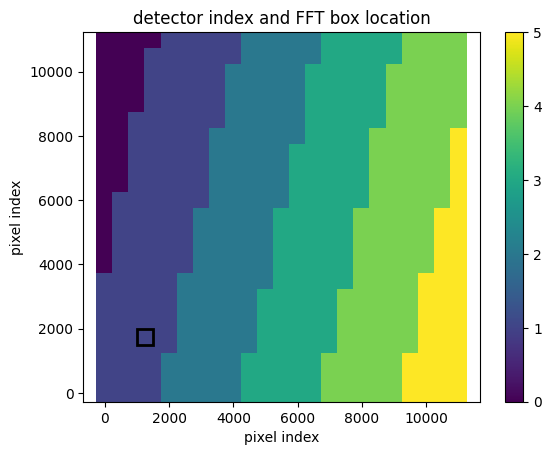

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076410180021975
(31, 31)
(31, 31)
(31, 31)


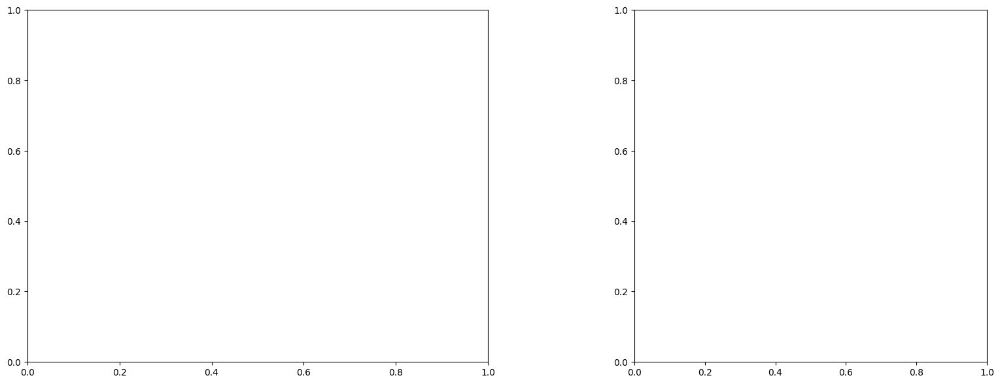

U and V components of current : [0.23996103 0.05003862]
uncertainties for U and V: 0.22600862358173768 0.19063440232218953


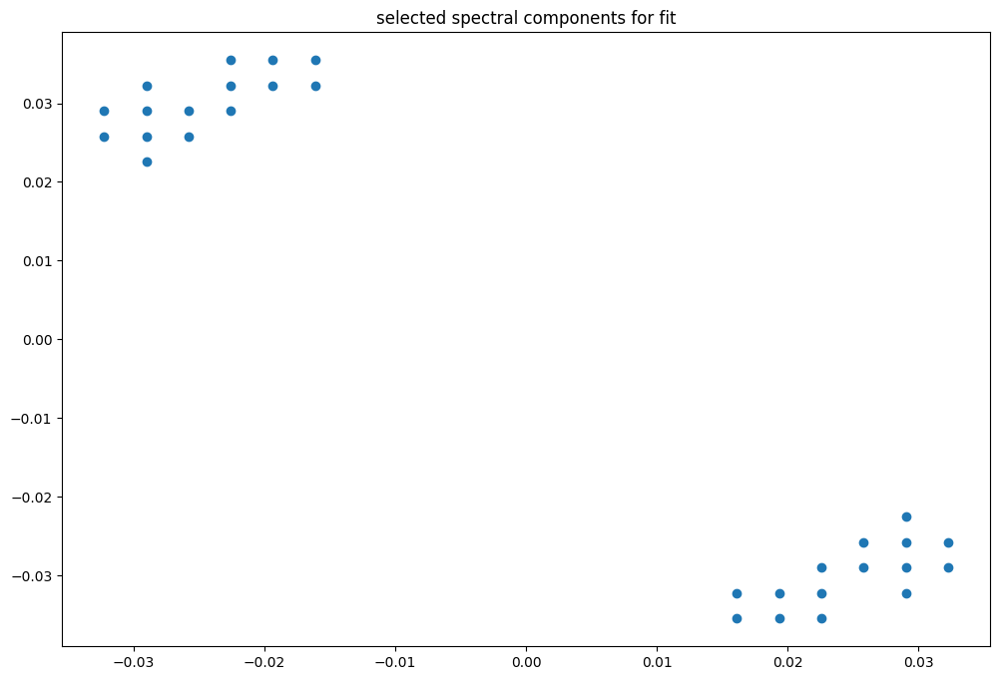

box [1000, 1500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

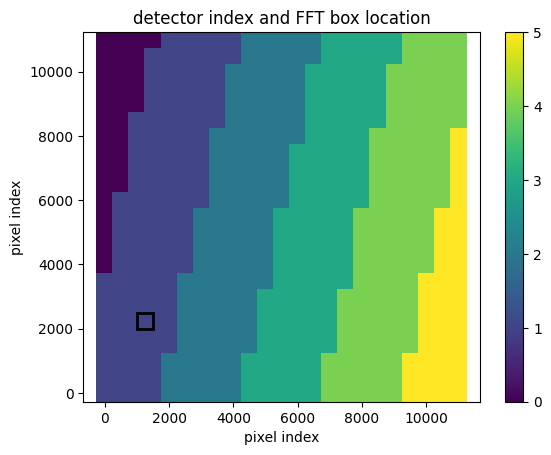

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076410180021975
(31, 31)
(31, 31)
(31, 31)


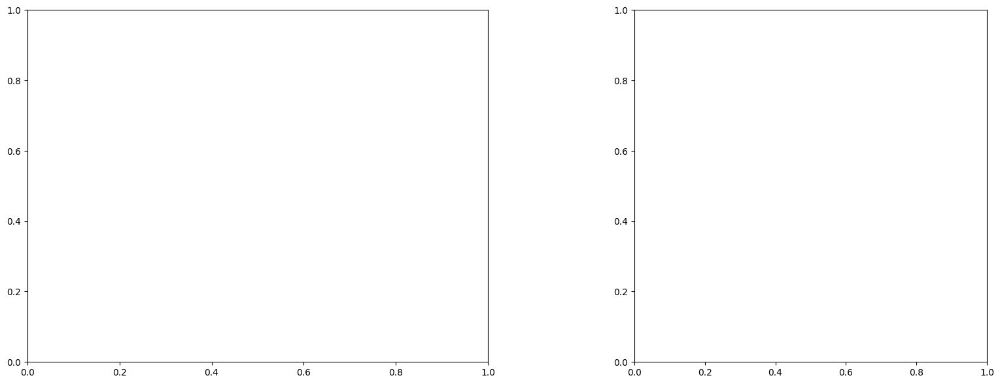

U and V components of current : [0.32156087 0.0938147 ]
uncertainties for U and V: 0.16658559038563195 0.14056958881417303


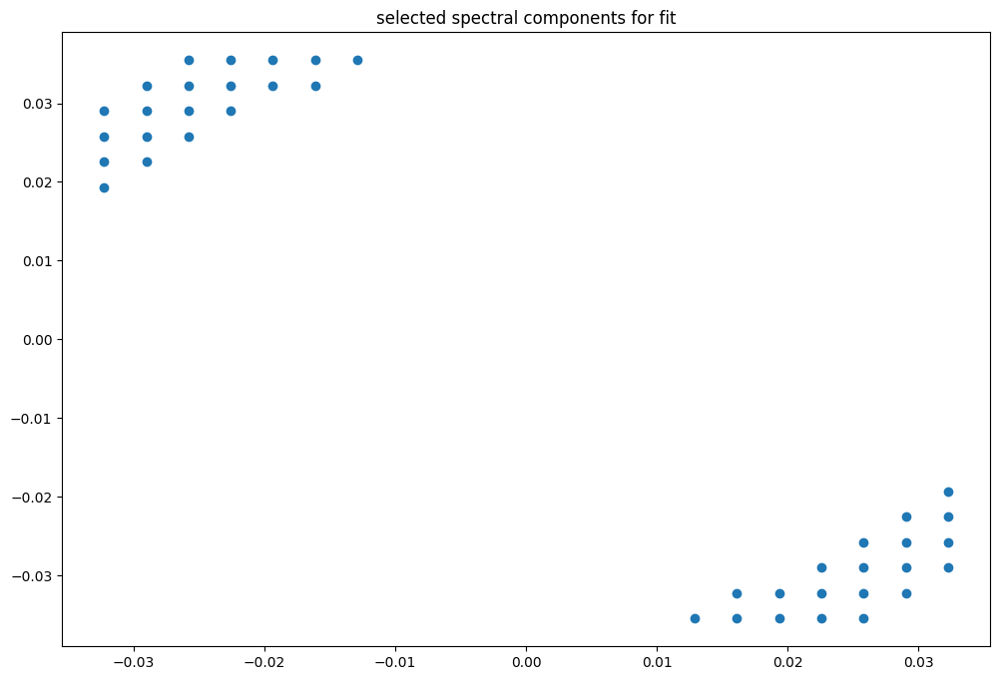

box [1000, 1500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

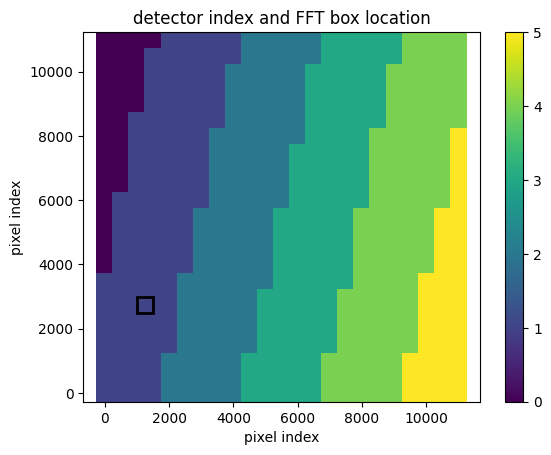

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076371759408578
(31, 31)
(31, 31)
(31, 31)


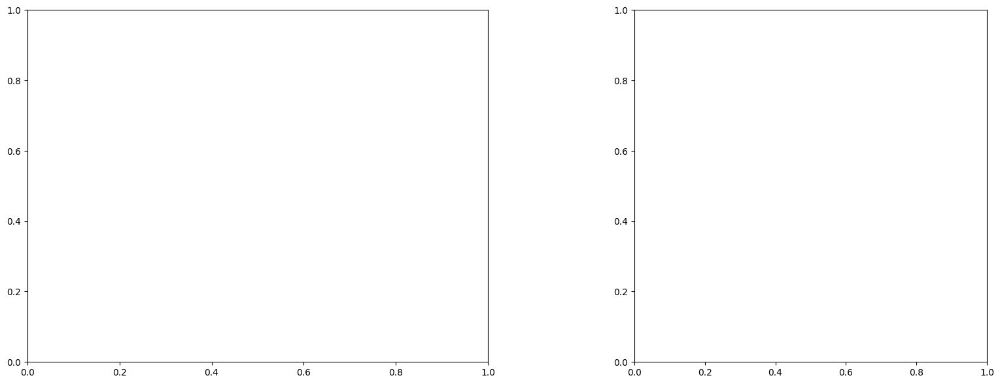

U and V components of current : [0.21009329 0.16654059]
uncertainties for U and V: 0.15754417707219096 0.14429799813227057


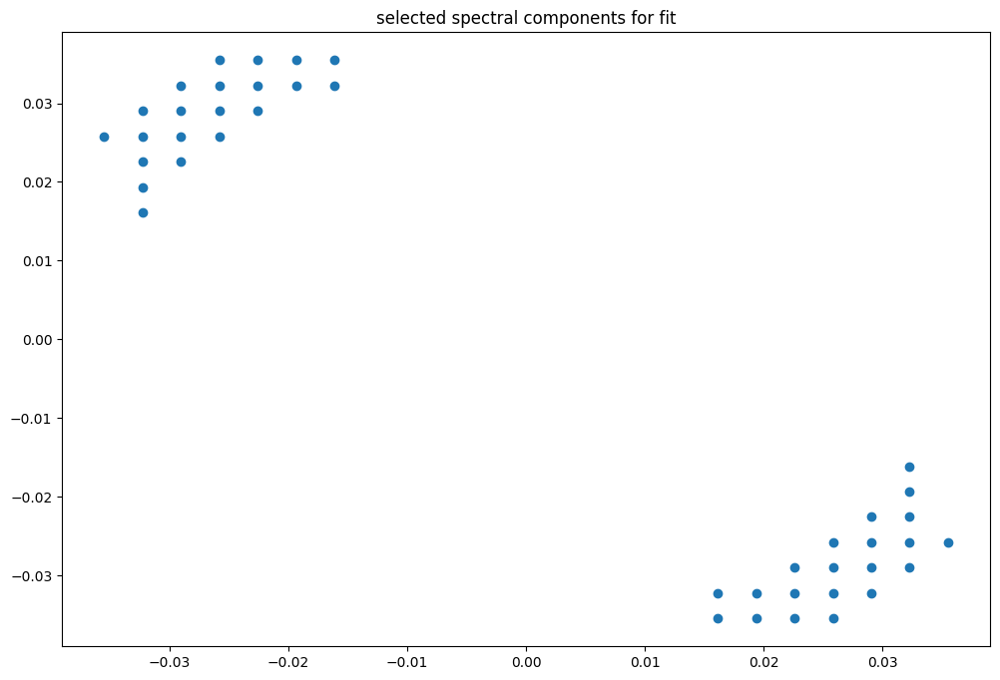

box [1000, 1500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

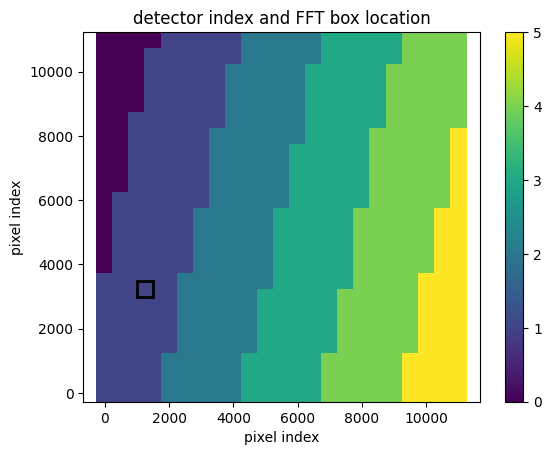

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007633656525753
(31, 31)
(31, 31)
(31, 31)


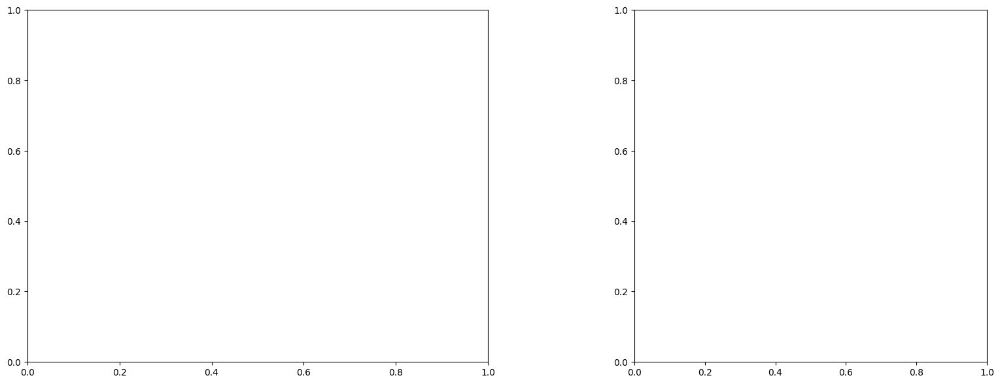

U and V components of current : [0.40990597 0.08936105]
uncertainties for U and V: 0.18398817943801676 0.15844737178197027


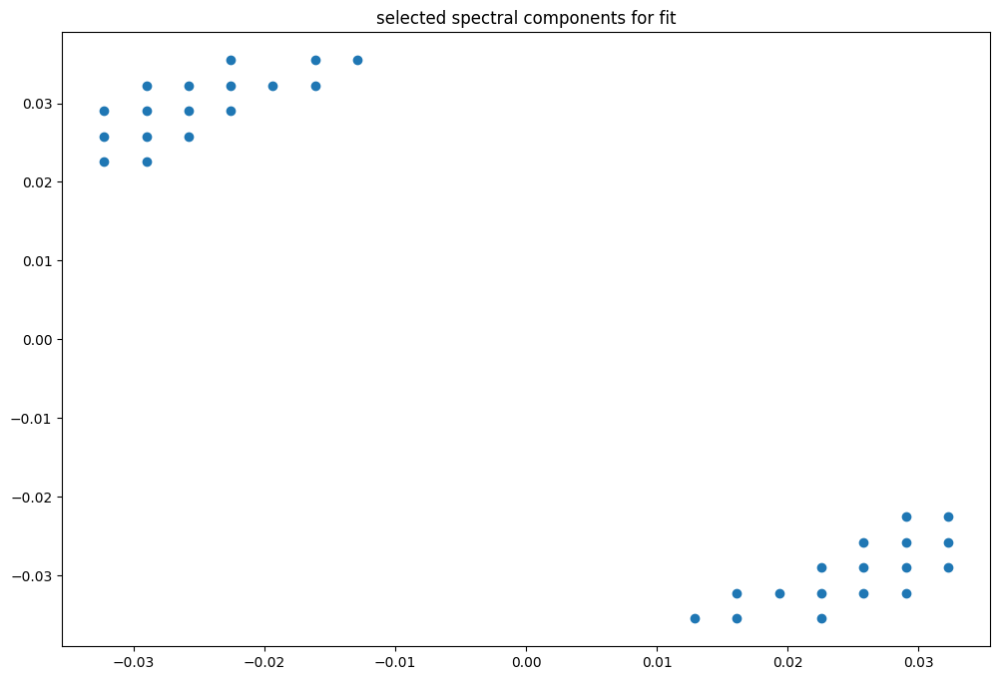

box [1000, 1500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

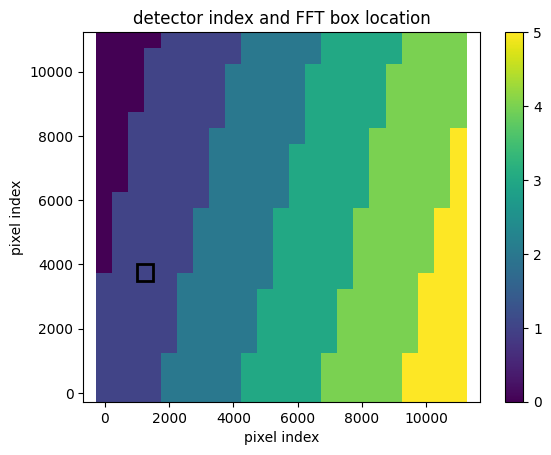

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


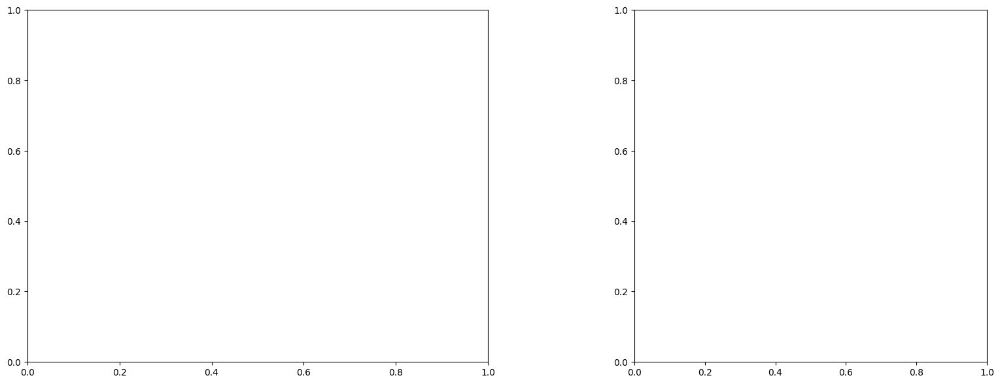

U and V components of current : [ 0.1818402 -0.1606284]
uncertainties for U and V: 0.16536462278360337 0.14044477855100249


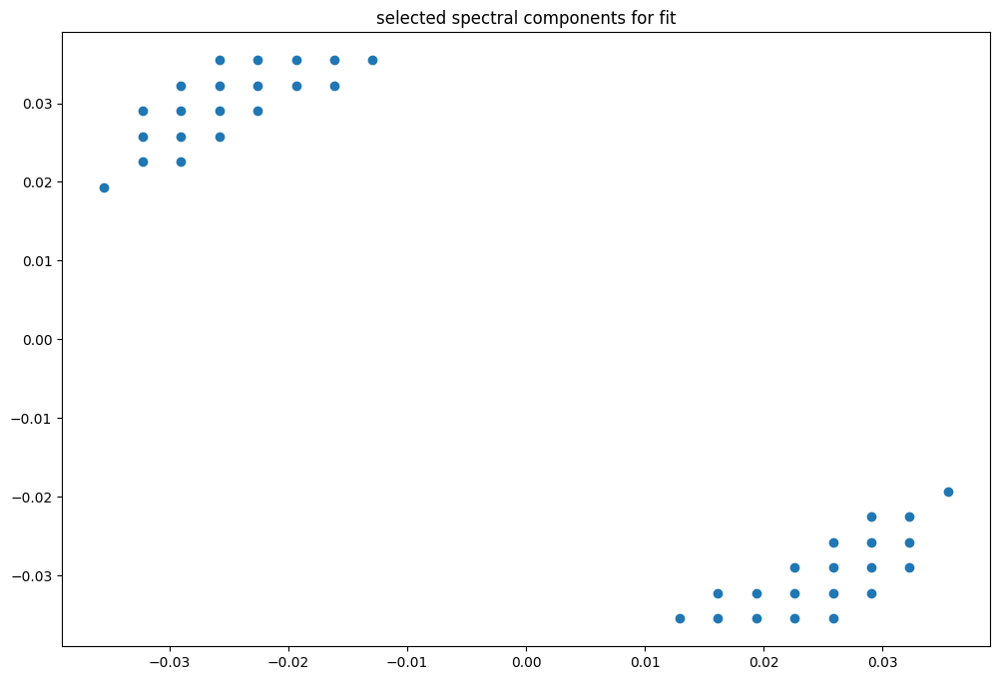

box [1000, 1500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

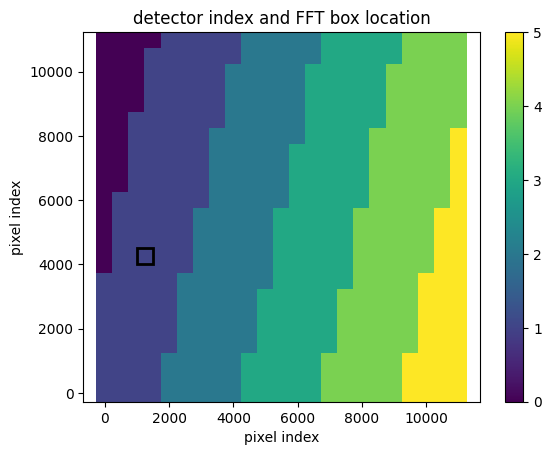

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


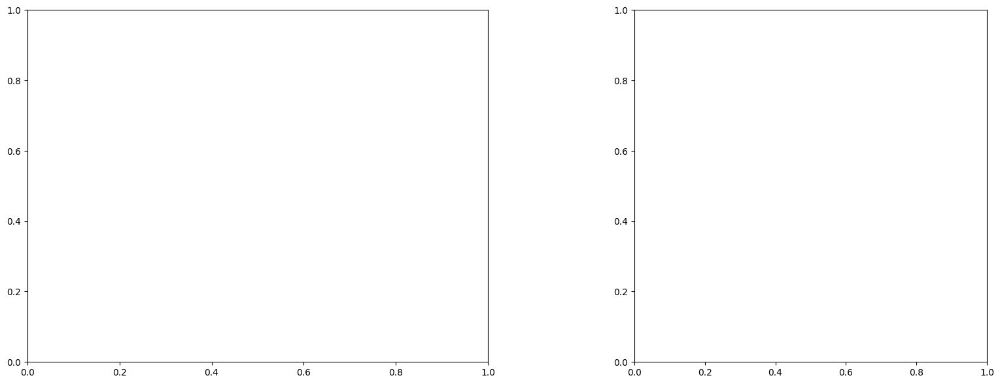

U and V components of current : [ 0.23202195 -0.21278084]
uncertainties for U and V: 0.19680207671955785 0.16847494590901516


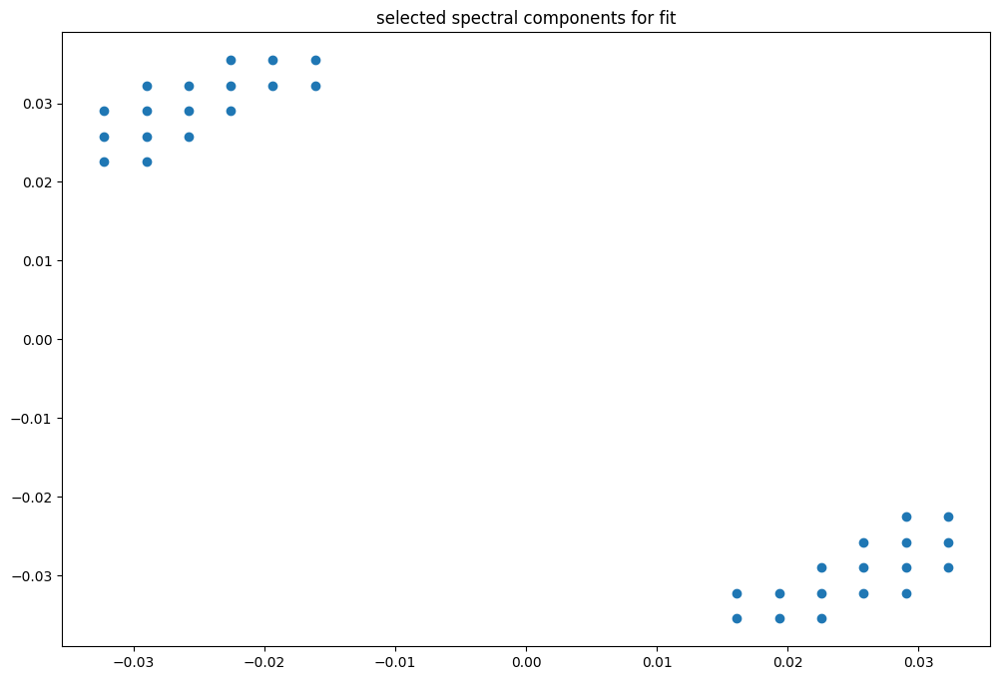

box [1000, 1500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

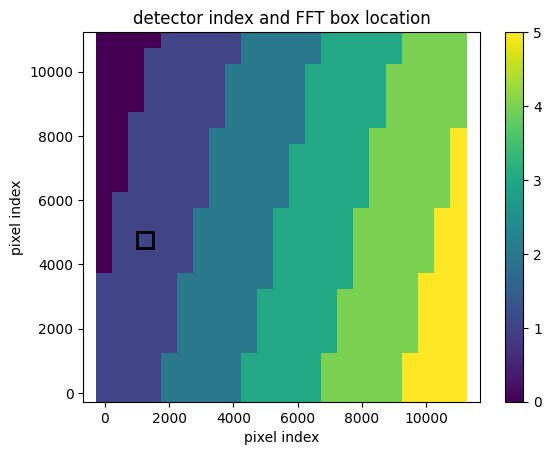

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007626729847849
(31, 31)
(31, 31)
(31, 31)


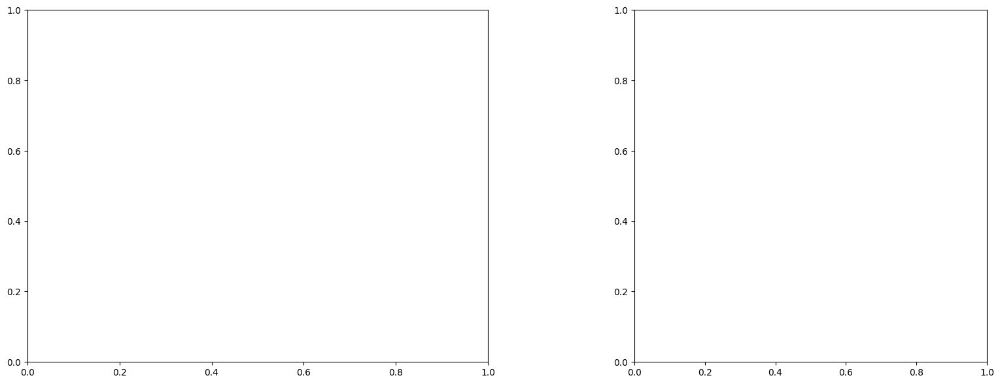

U and V components of current : [ 0.32803403 -0.26099542]
uncertainties for U and V: 0.16615278195650998 0.14983925700677755


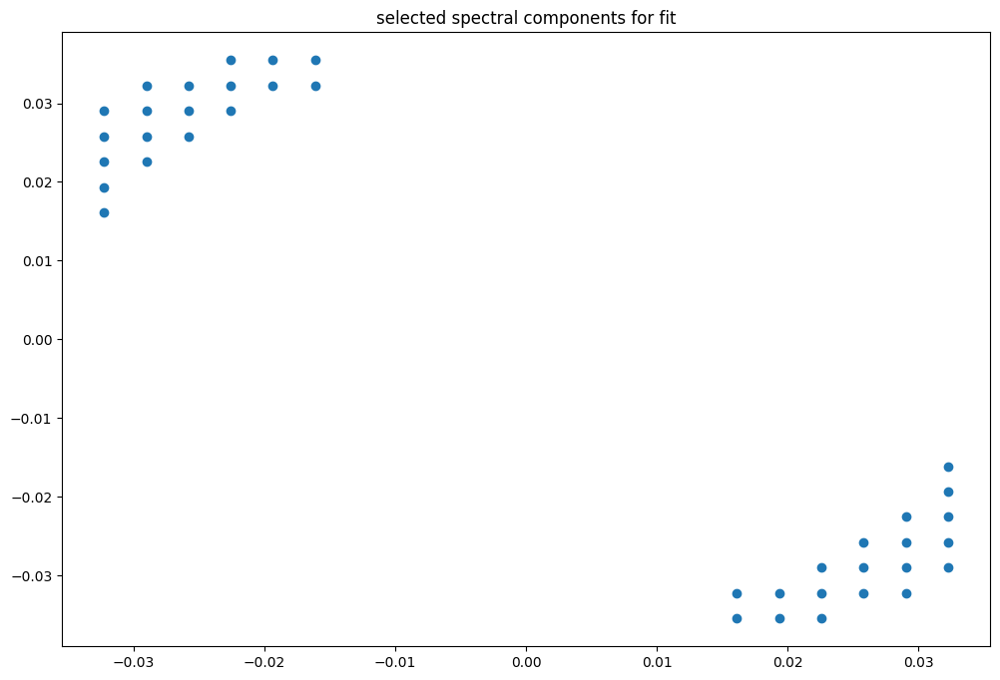

box [1000, 1500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

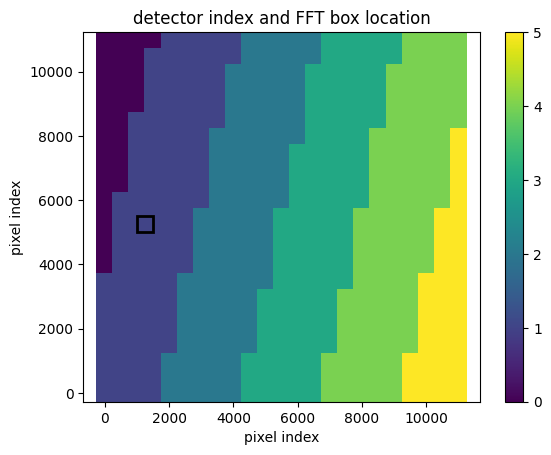

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


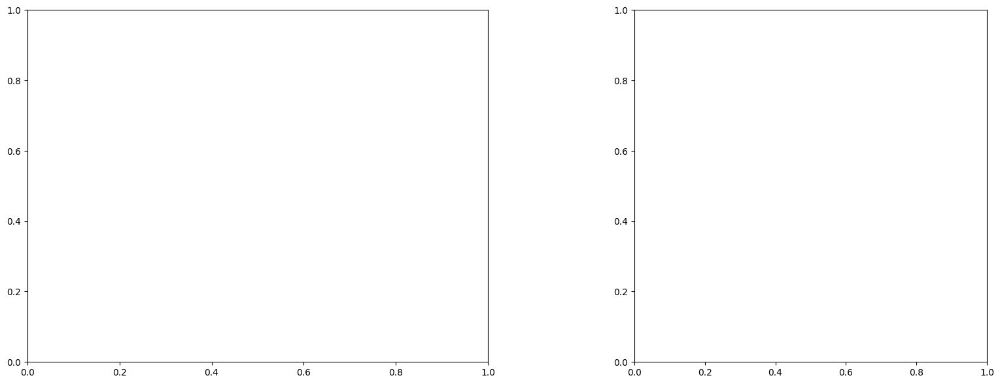

U and V components of current : [ 0.28708415 -0.53423563]
uncertainties for U and V: 0.1758384312184082 0.16088177515640317


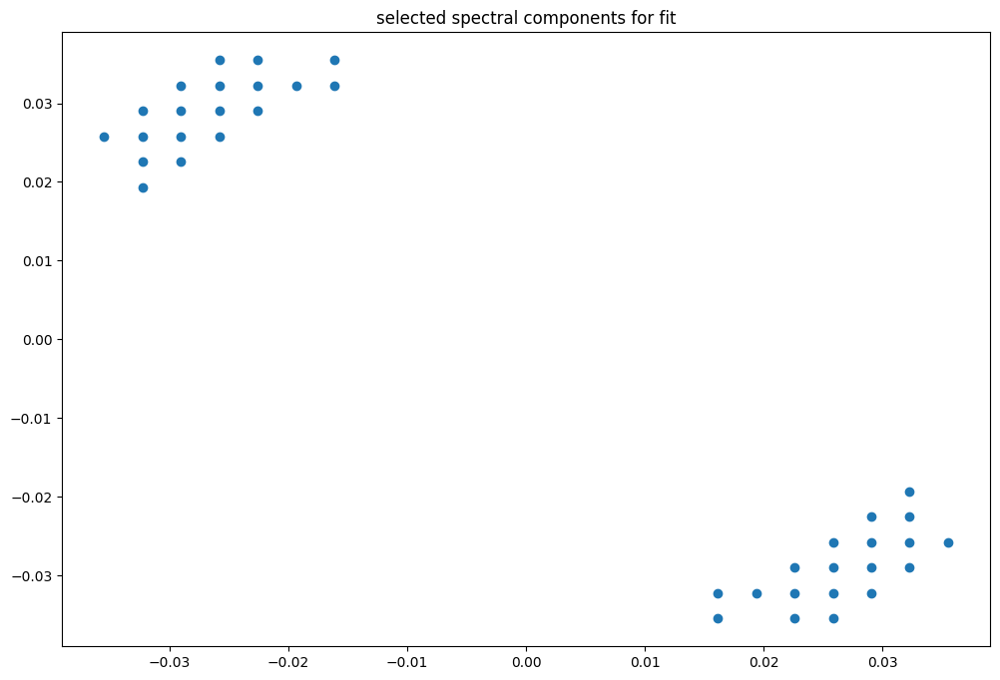

box [1000, 1500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

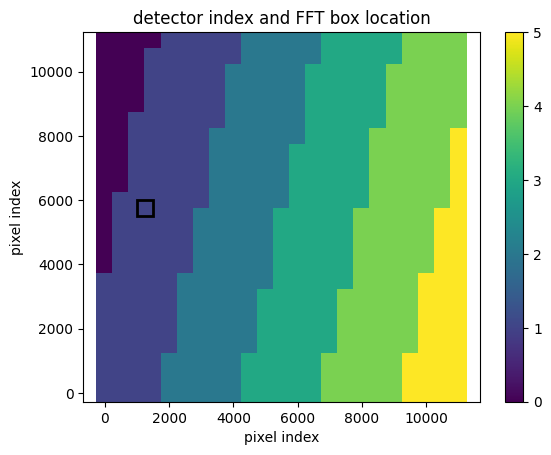

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


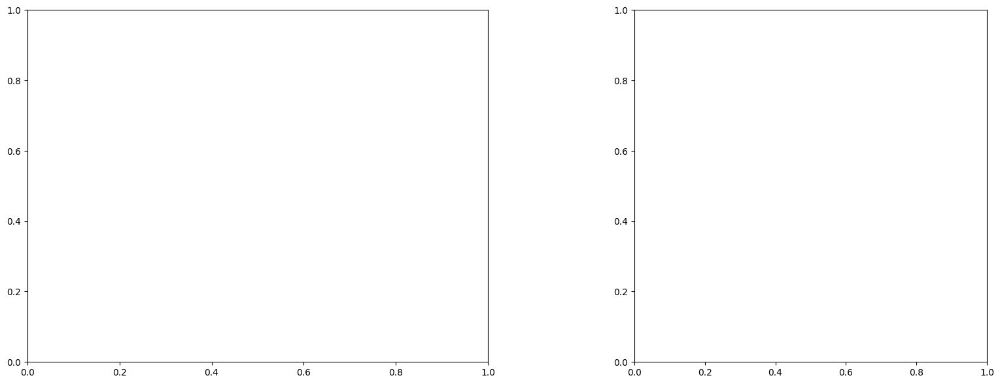

U and V components of current : [ 0.37046684 -0.49235954]
uncertainties for U and V: 0.19438936311223248 0.1942177035970614


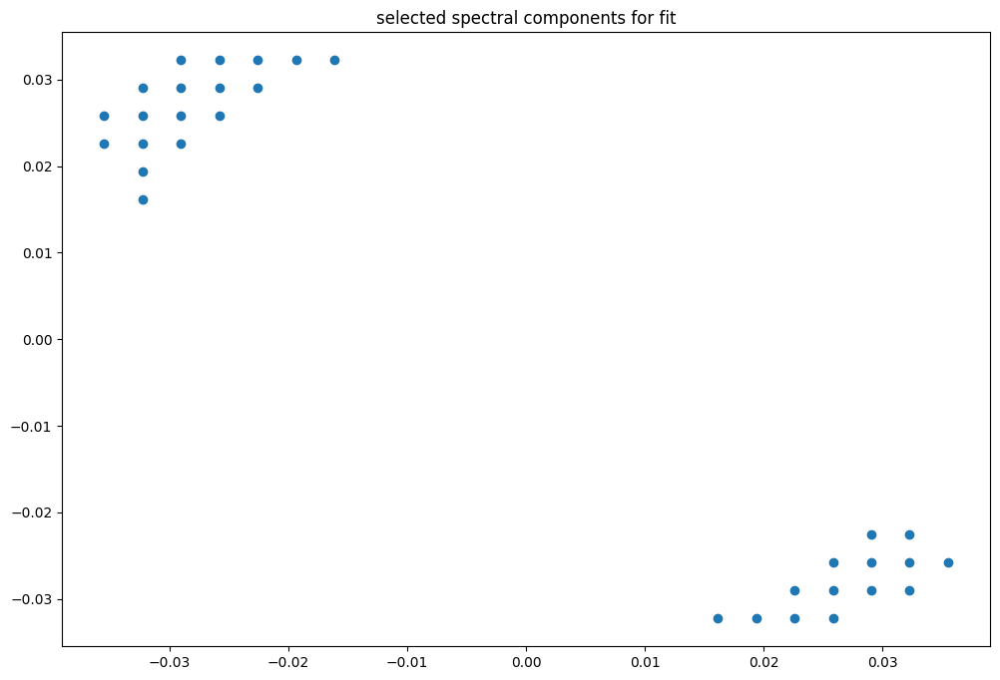

box [1000, 1500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

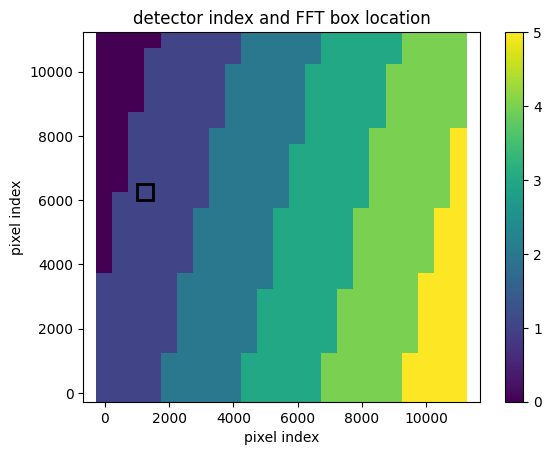

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076202347460554
(31, 31)
(31, 31)
(31, 31)


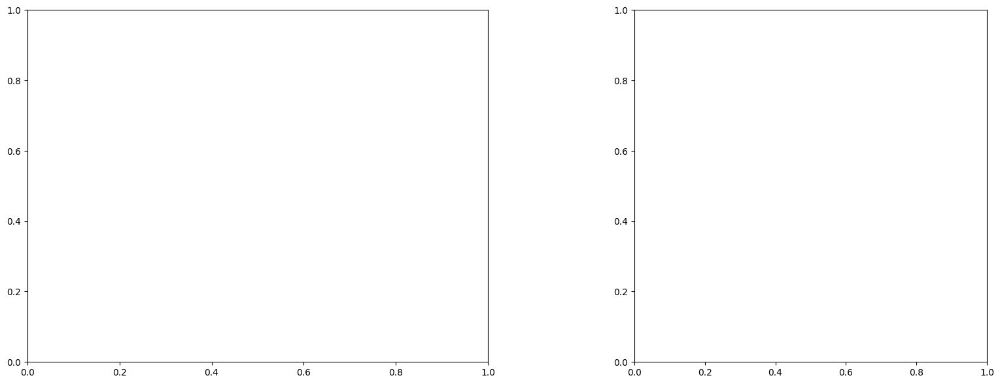

LinAlgError: Singular matrix

box [1000, 1500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

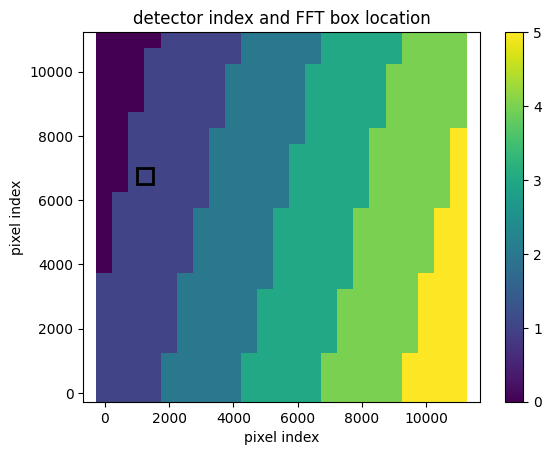

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


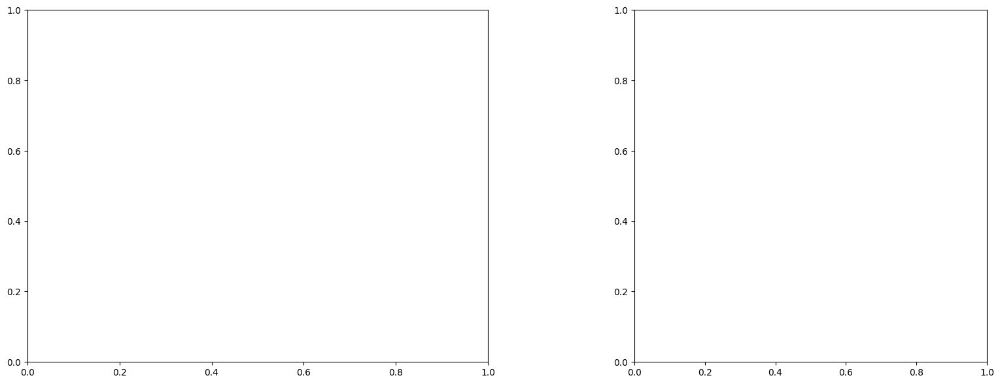

LinAlgError: Singular matrix

box [1000, 1500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

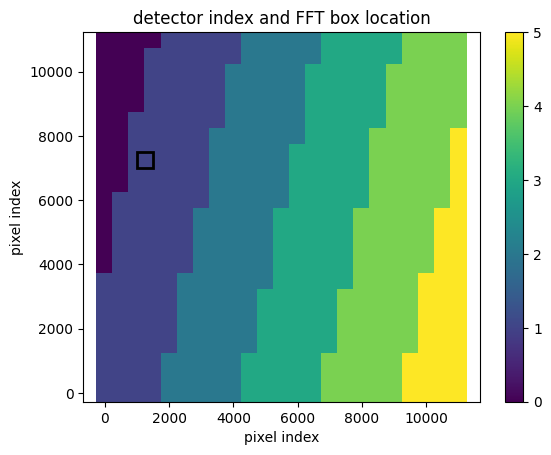

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076138799349308
(31, 31)
(31, 31)
(31, 31)


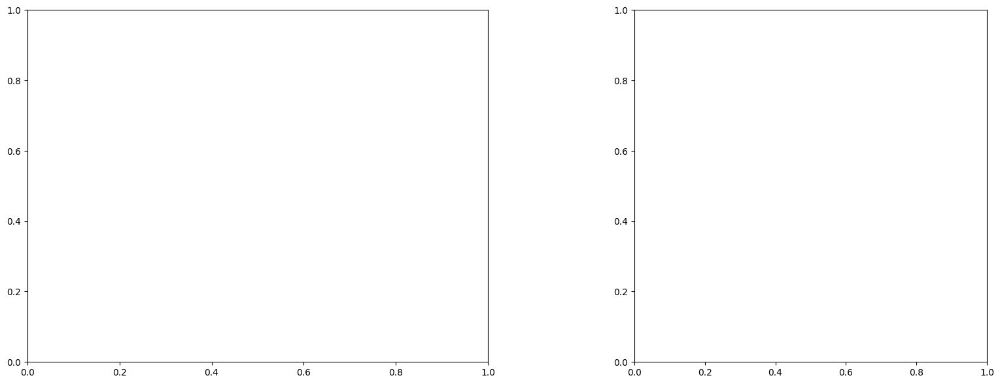

LinAlgError: Singular matrix

box [1000, 1500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

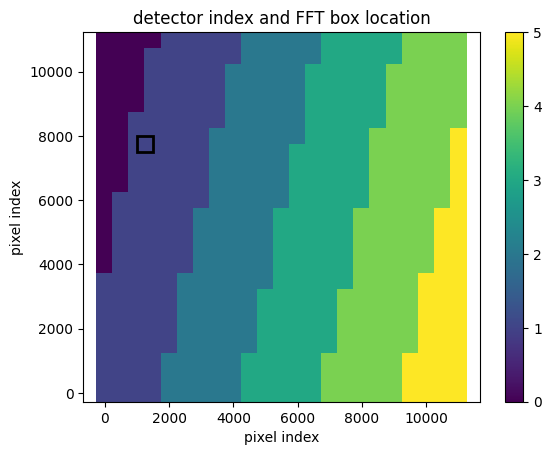

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076138799349308
(31, 31)
(31, 31)
(31, 31)


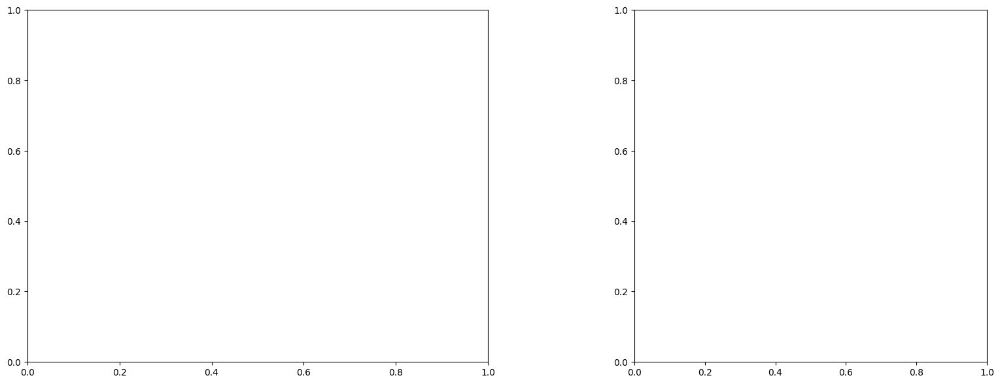

LinAlgError: Singular matrix

box [1000, 1500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

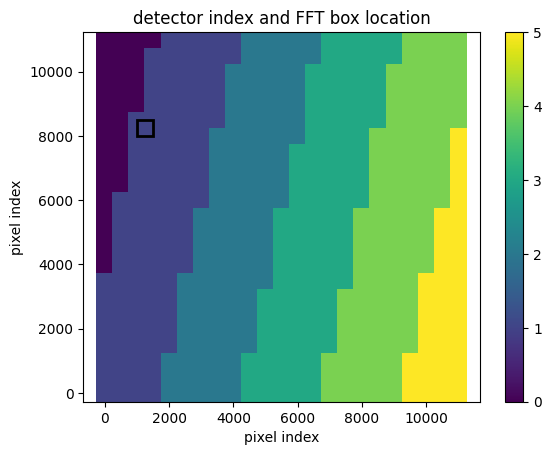

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


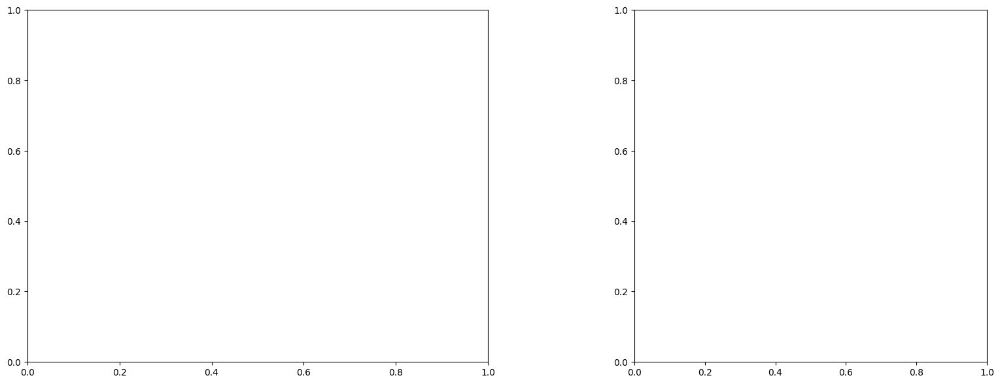

U and V components of current : [-0.38764302 -3.46442756]
uncertainties for U and V: 0.03974976373294201 0.030865553491955692


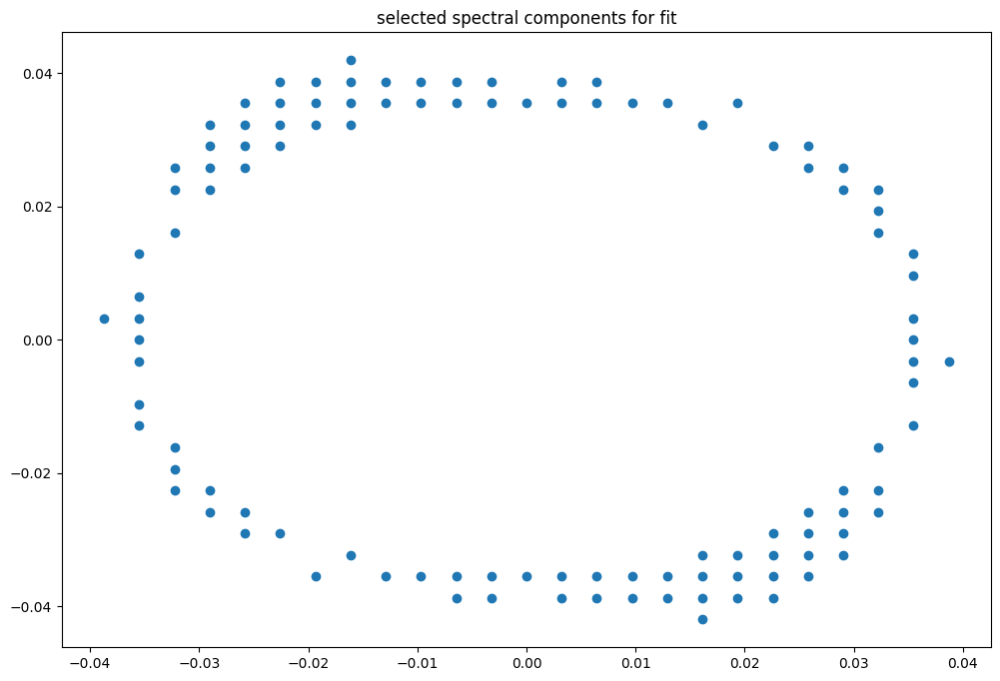

box [1000, 1500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

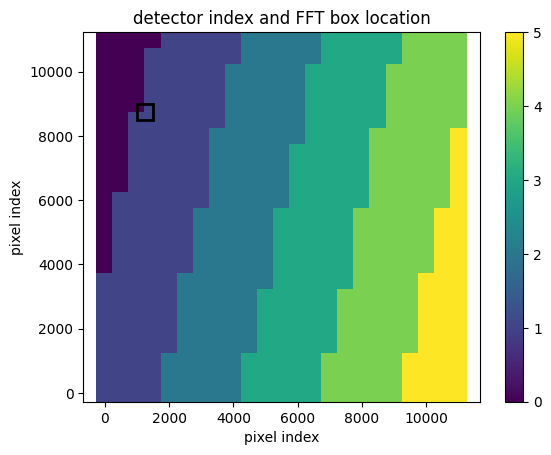

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.96
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


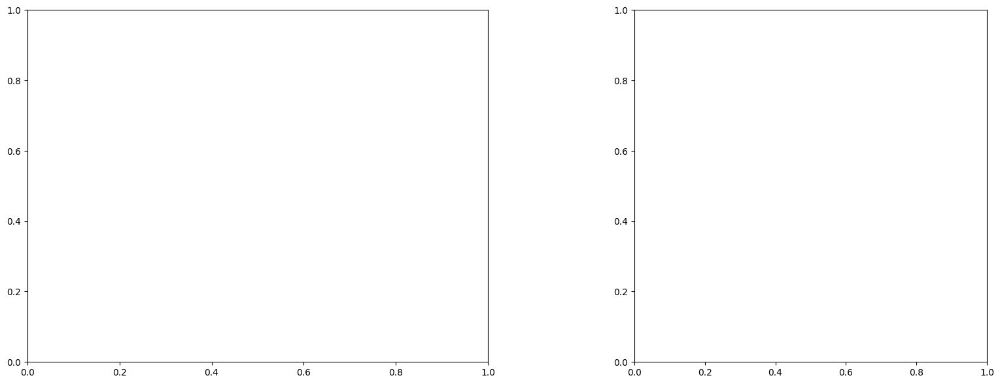

LinAlgError: Singular matrix

box [1000, 1500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

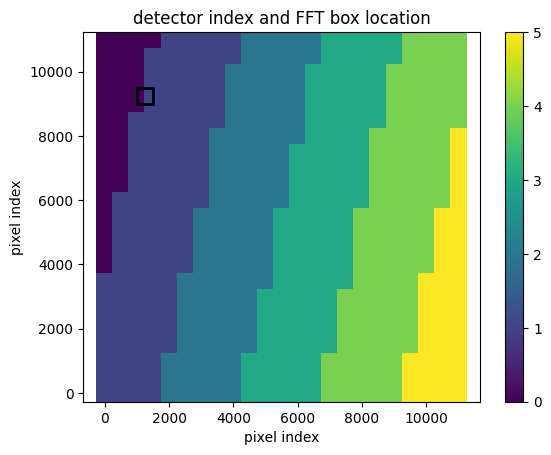

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


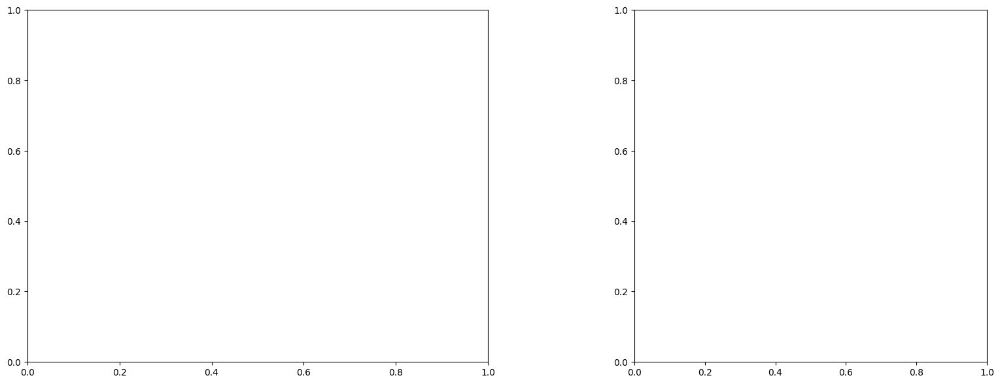

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

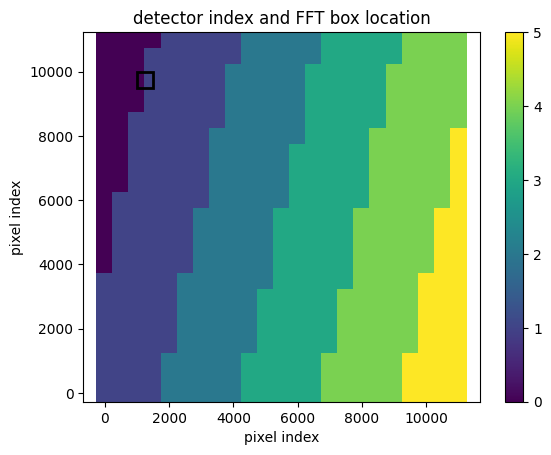

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


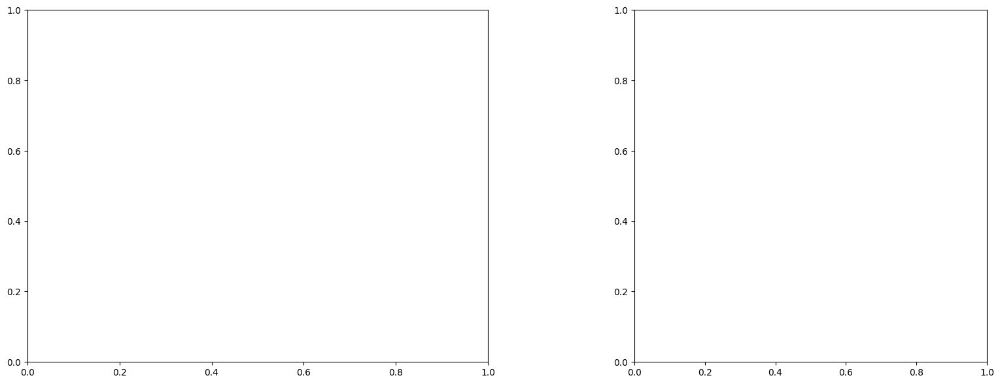

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

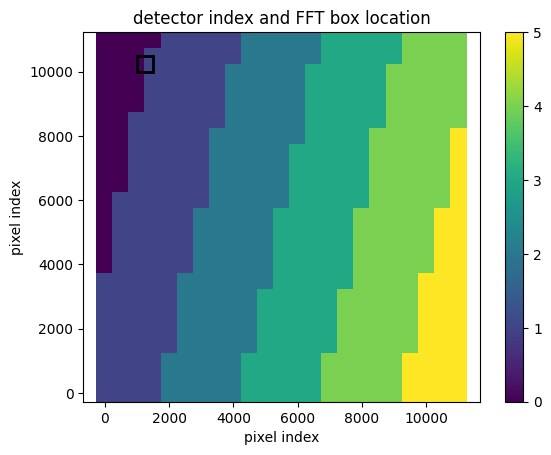

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 31)
(31, 31)
(31, 31)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


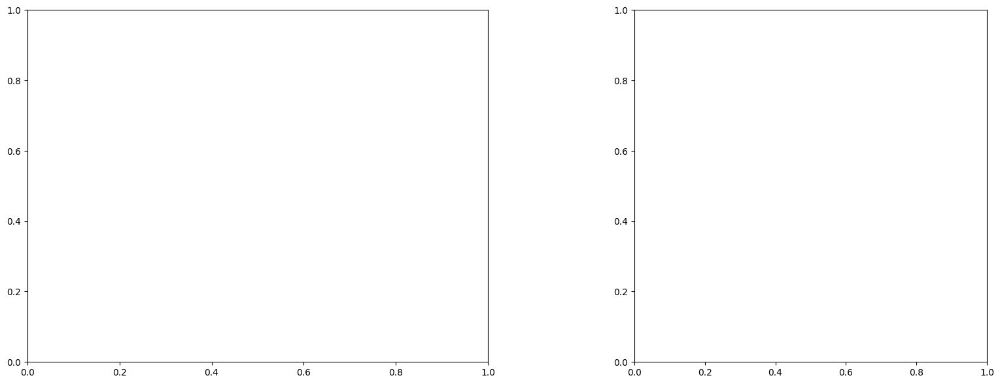

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

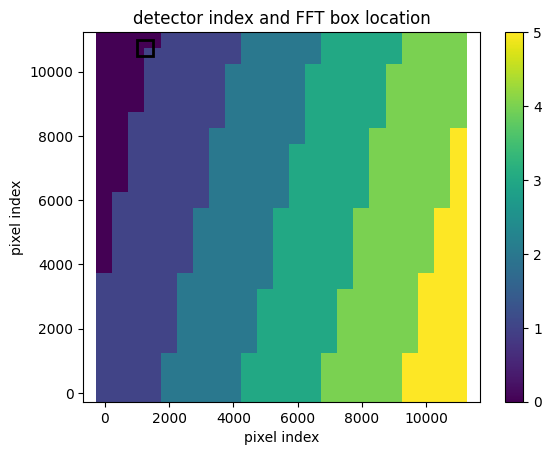

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.45999999999999996
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 30)
(31, 30)
(31, 30)


/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_123671/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


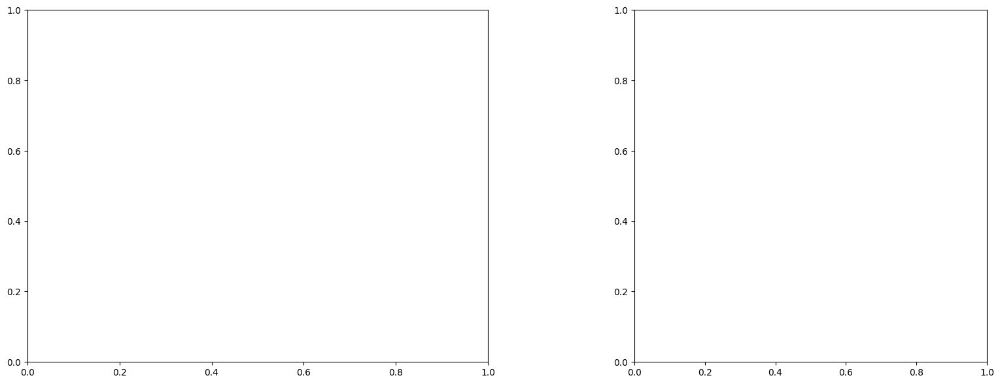

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

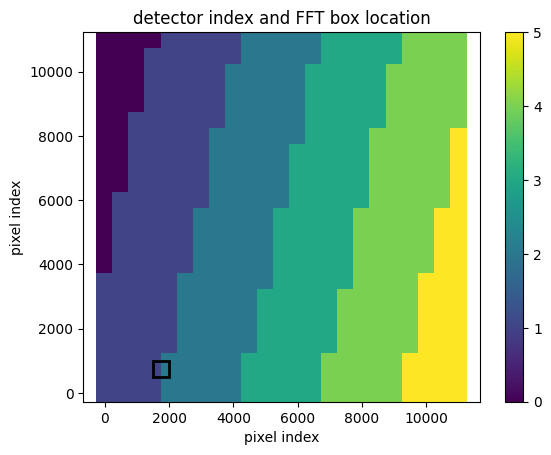

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091980873679585
(31, 31)
(31, 31)
(31, 31)


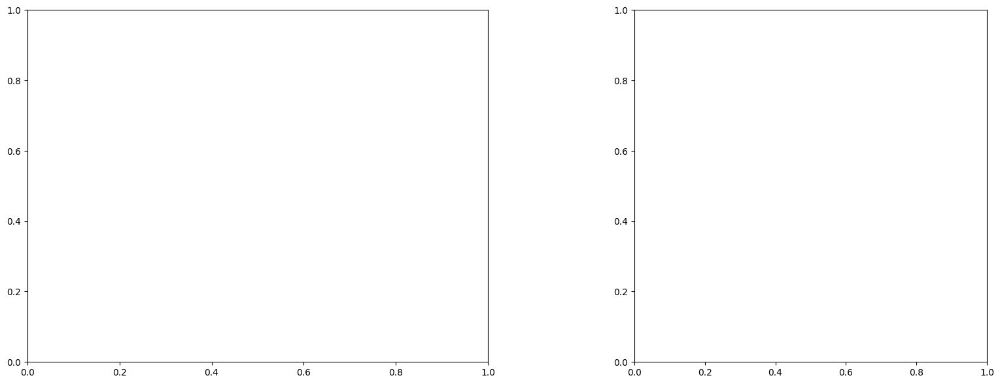

U and V components of current : [-1.64875    -1.37895399]
uncertainties for U and V: 0.8991215338051325 0.6957098702555926


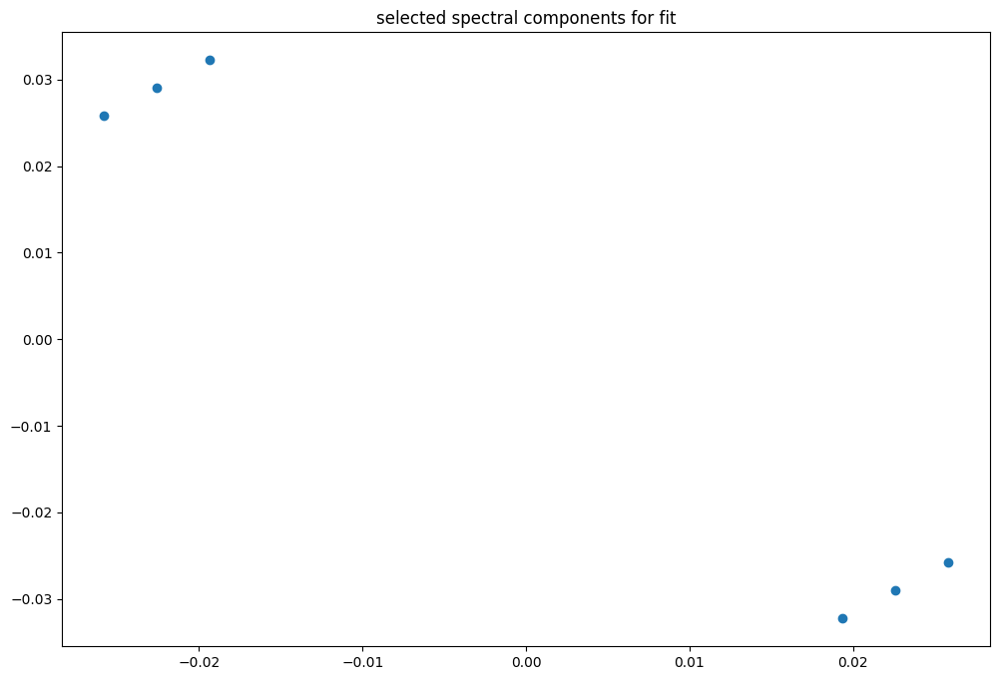

box [1500, 2000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

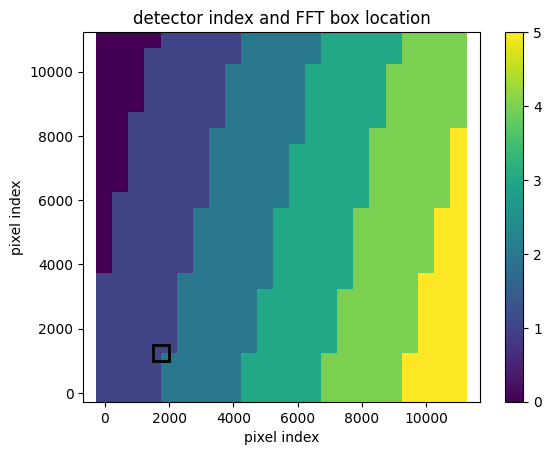

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.46
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076443785228635
(31, 31)
(31, 31)
(31, 31)


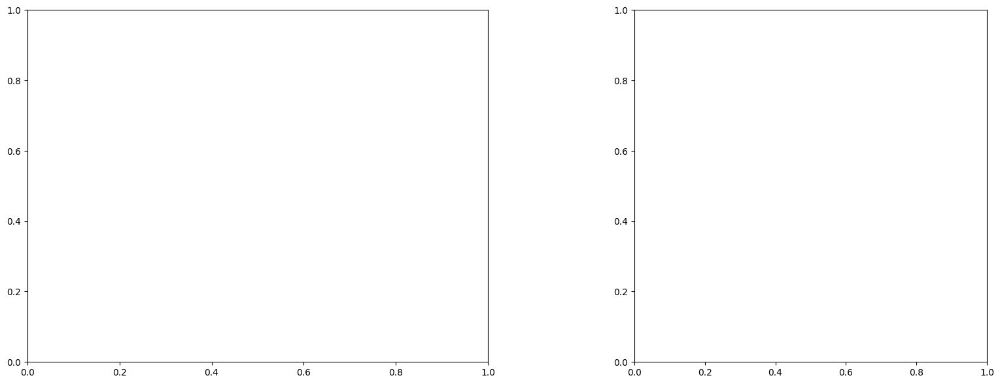

U and V components of current : [0.5192388  0.29446651]
uncertainties for U and V: 0.21153250122199851 0.16820951209281348


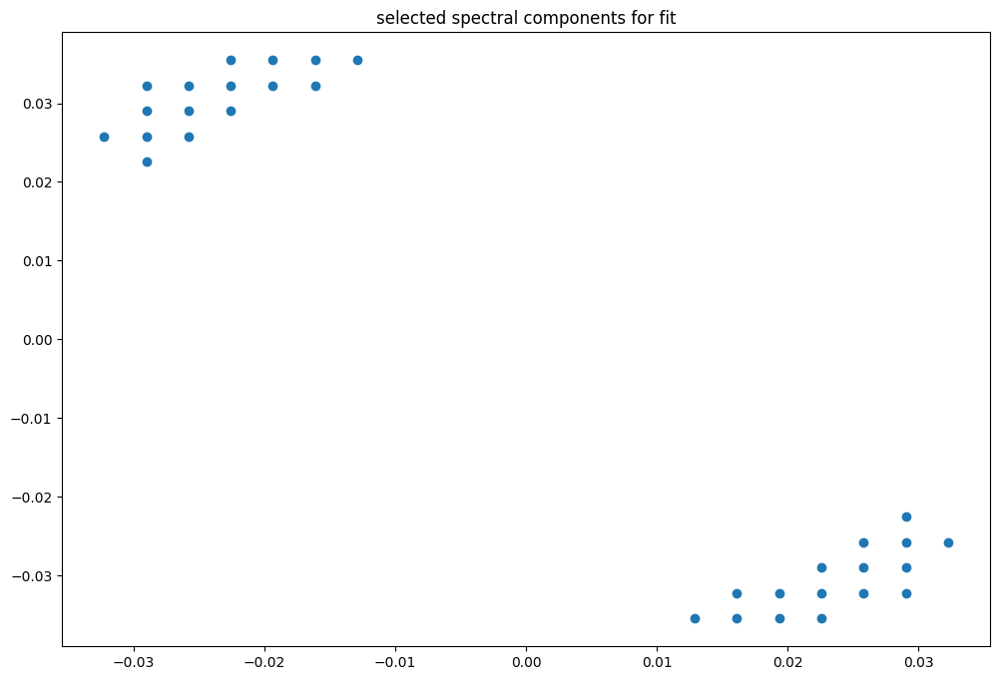

box [1500, 2000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

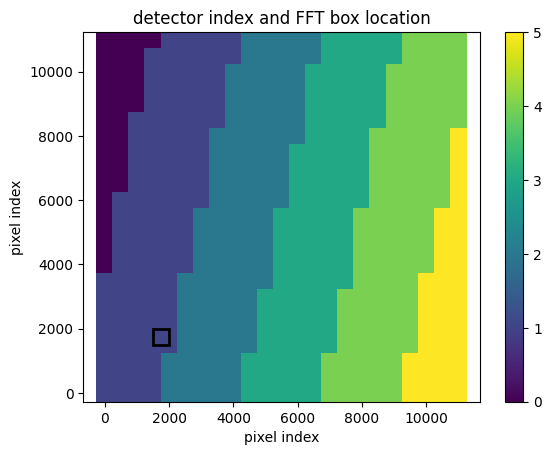

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076410180021975
(31, 31)
(31, 31)
(31, 31)


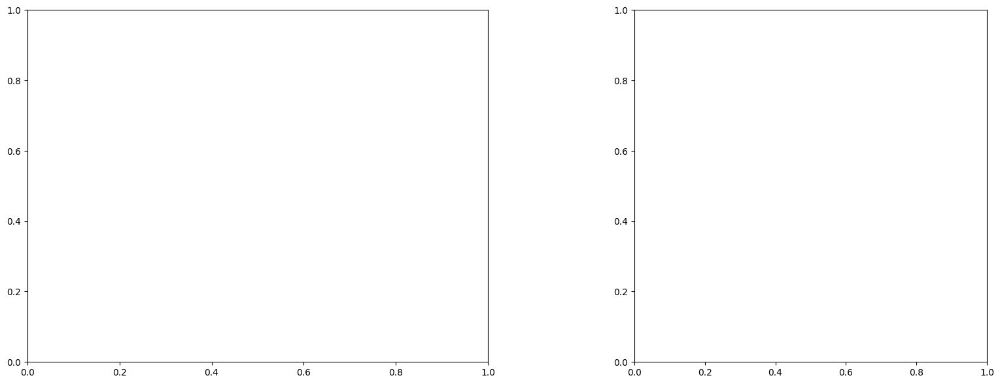

U and V components of current : [0.98063479 0.7228325 ]
uncertainties for U and V: 0.22646631518436214 0.18482135643148628


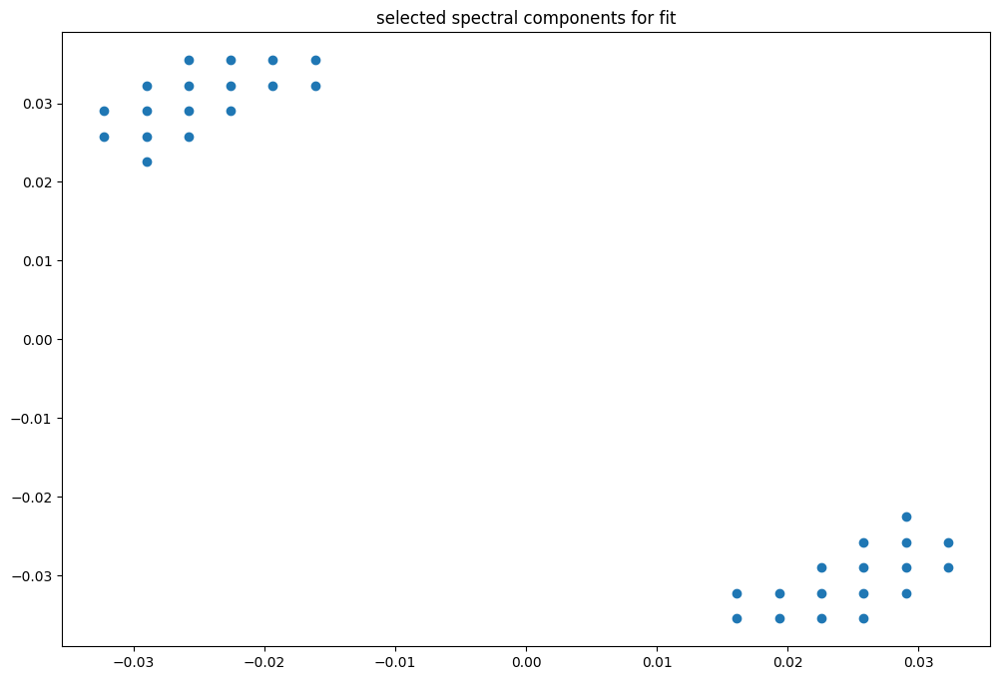

box [1500, 2000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

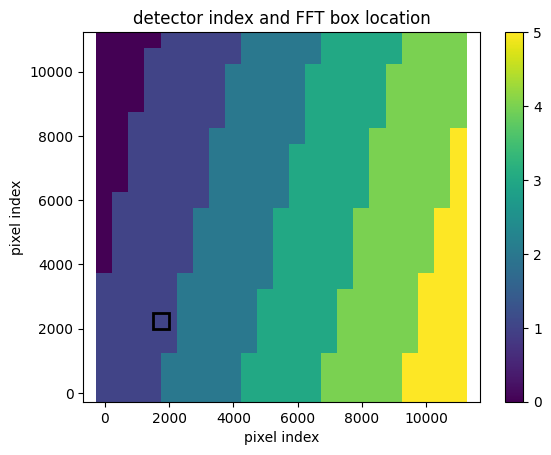

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076371759408578
(31, 31)
(31, 31)
(31, 31)


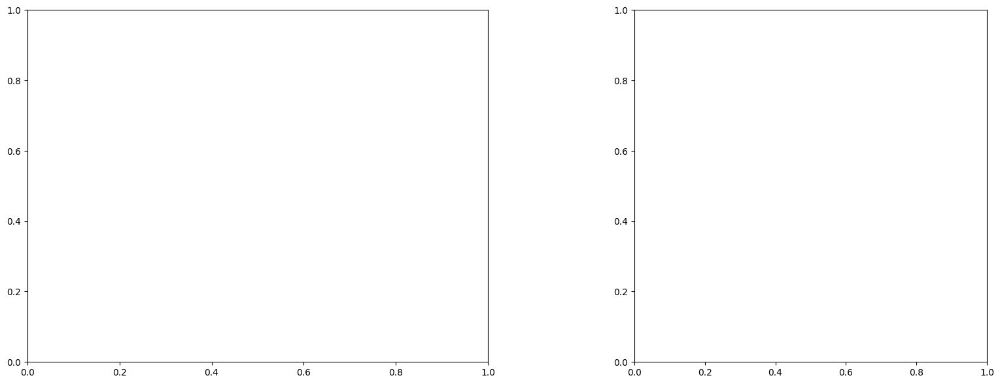

U and V components of current : [ 0.20702028 -0.00960169]
uncertainties for U and V: 0.2335644380963978 0.2034923406206849


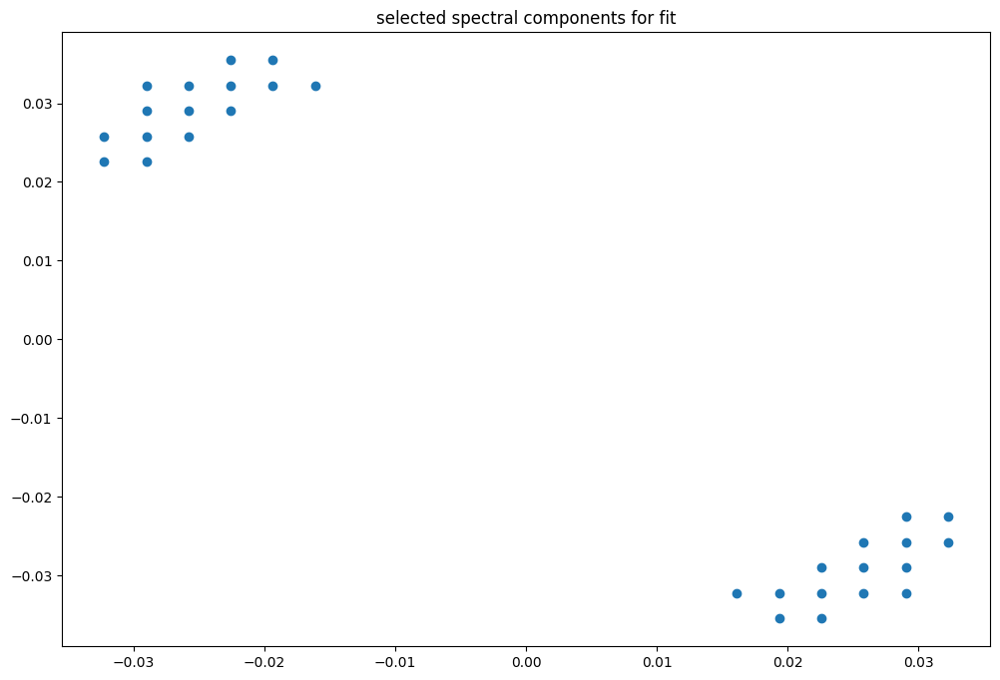

box [1500, 2000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

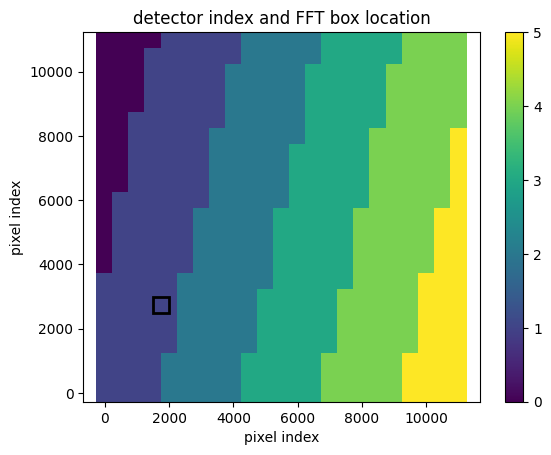

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076371759408578
(31, 31)
(31, 31)
(31, 31)


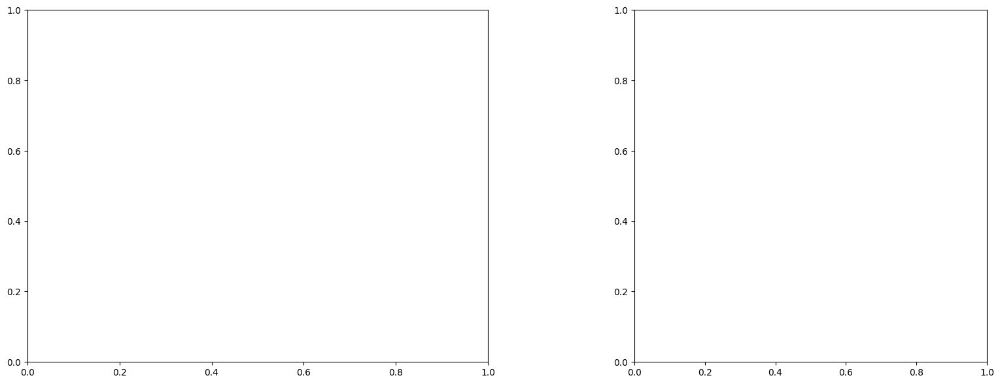

U and V components of current : [0.30838029 0.17250346]
uncertainties for U and V: 0.21129847261063966 0.19551332692901593


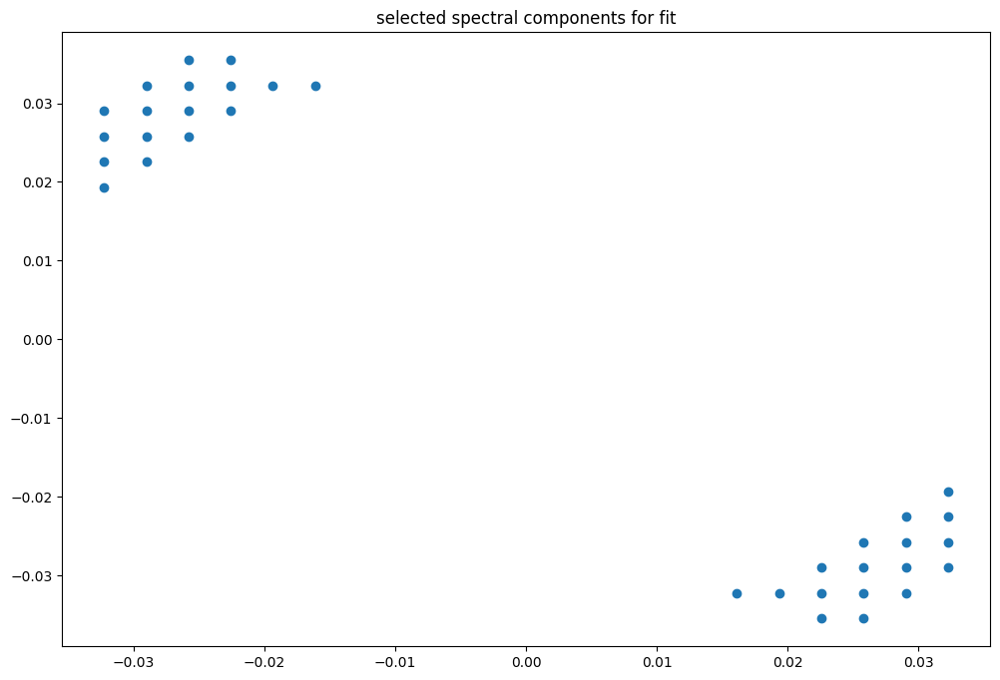

box [1500, 2000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

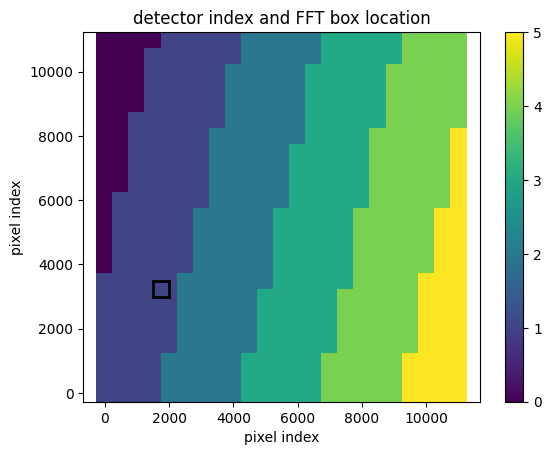

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007633656525753
(31, 31)
(31, 31)
(31, 31)


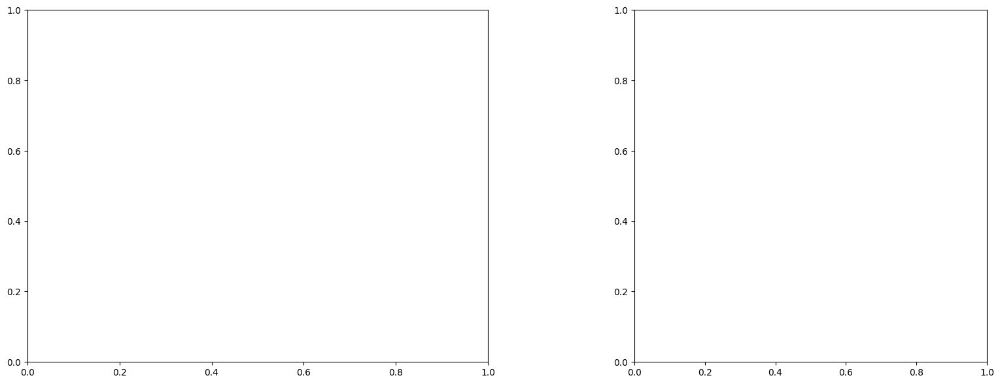

U and V components of current : [0.19322759 0.01579011]
uncertainties for U and V: 0.18005293304339315 0.15970343060120892


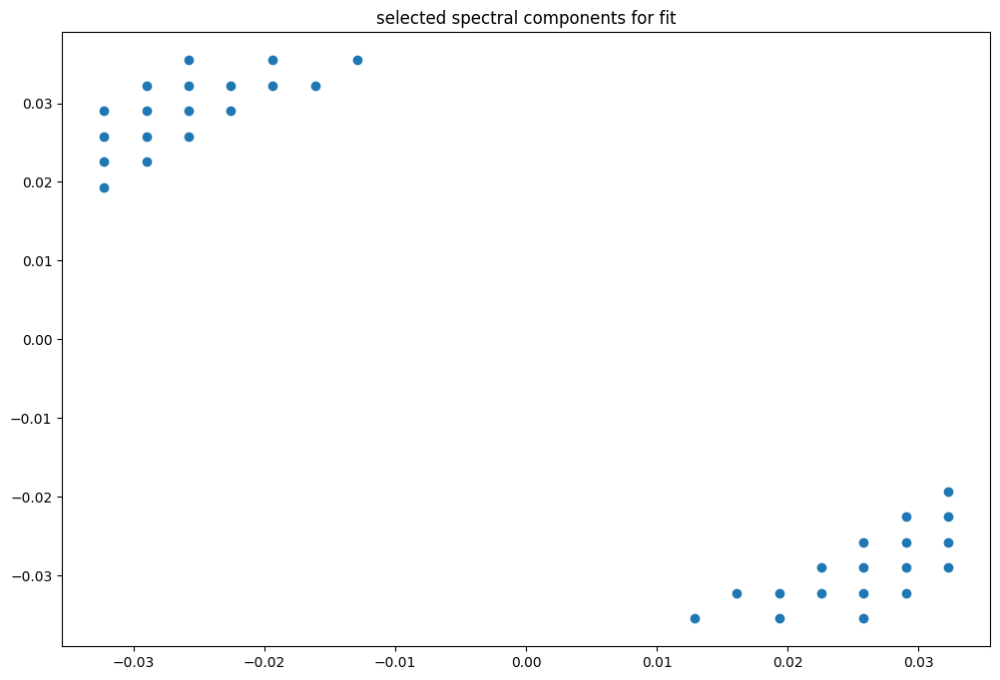

box [1500, 2000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

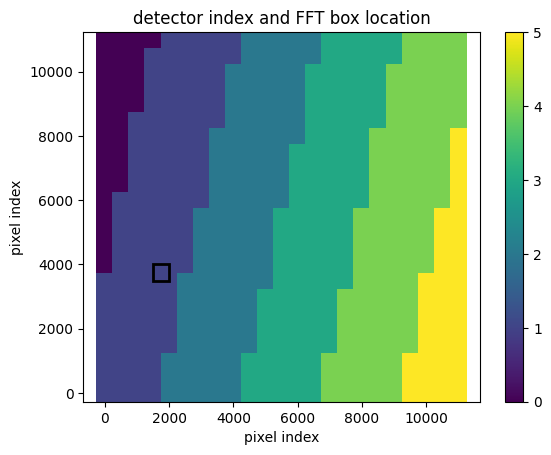

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


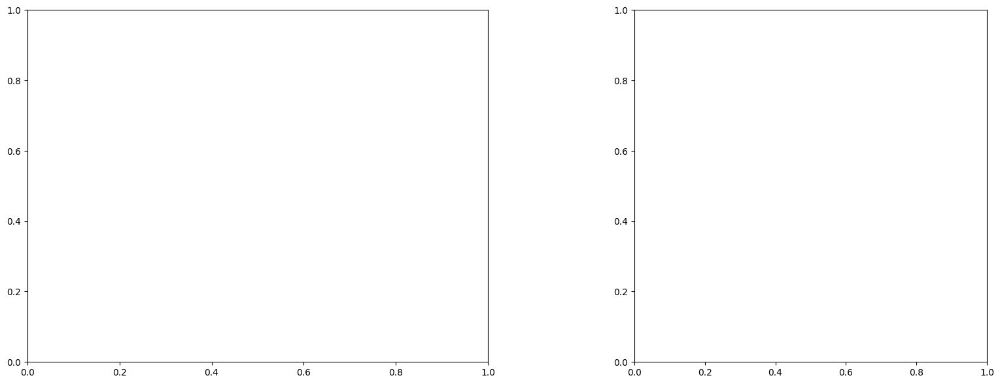

U and V components of current : [0.56012523 0.14945779]
uncertainties for U and V: 0.1789898320139636 0.15695278608079702


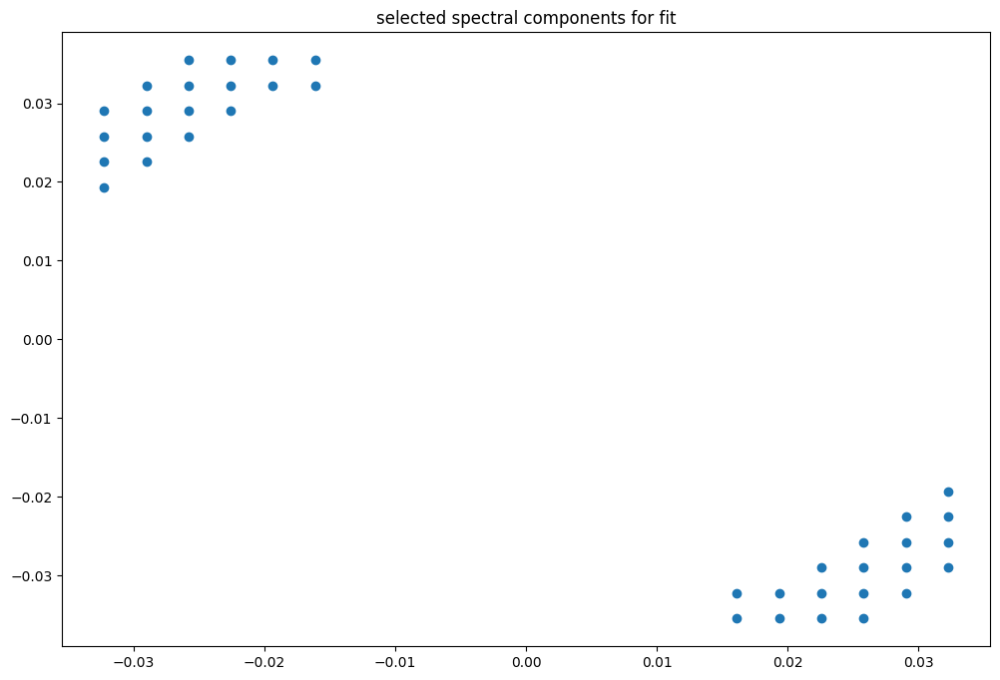

box [1500, 2000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

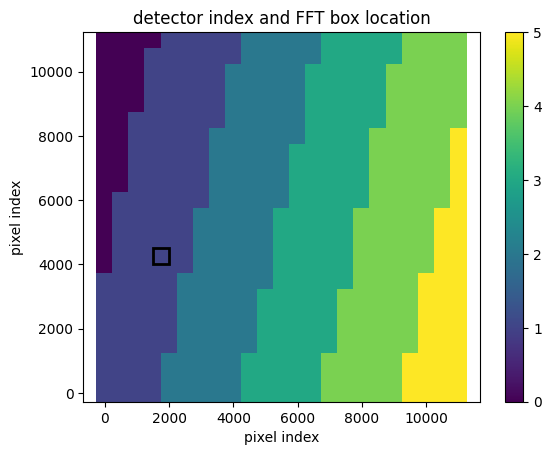

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


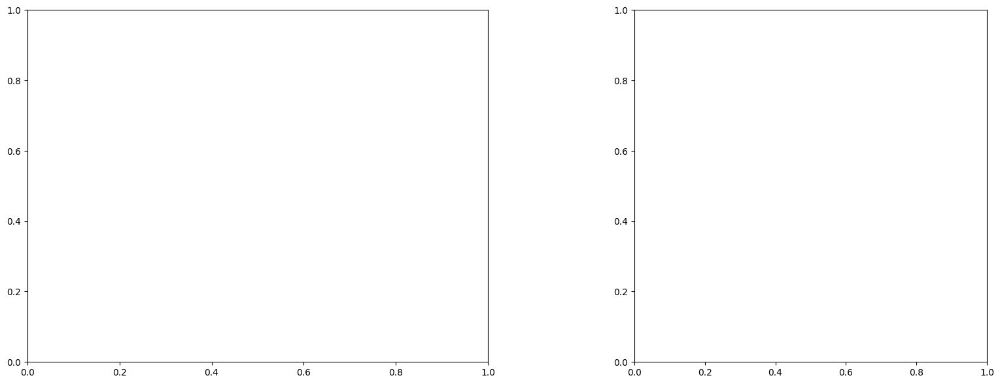

U and V components of current : [ 0.03554534 -0.45301626]
uncertainties for U and V: 0.15045544970316876 0.14529871771412958


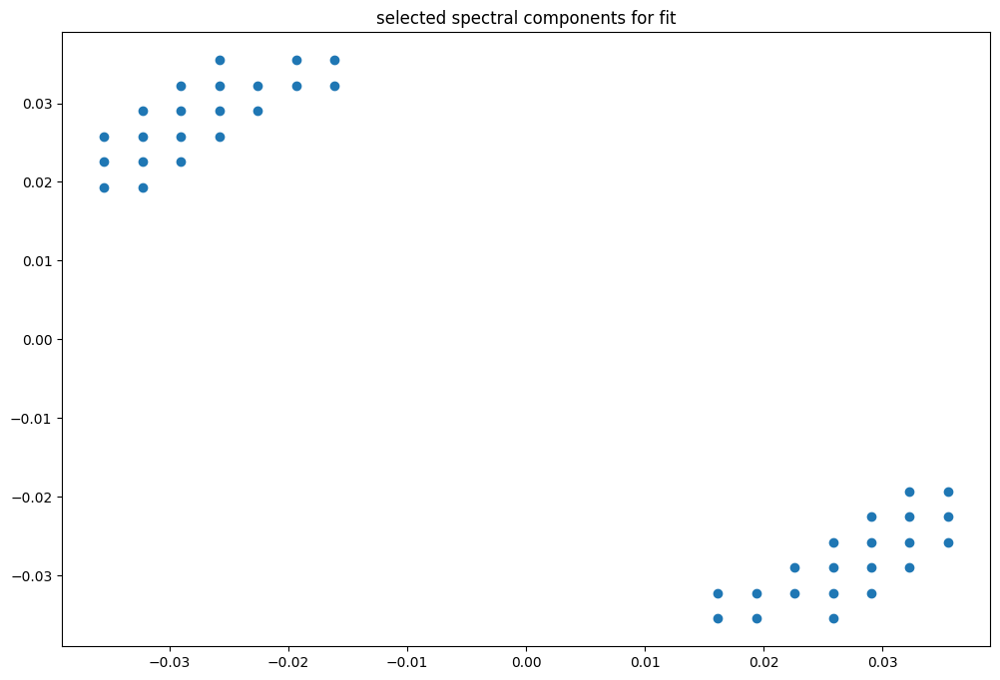

box [1500, 2000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

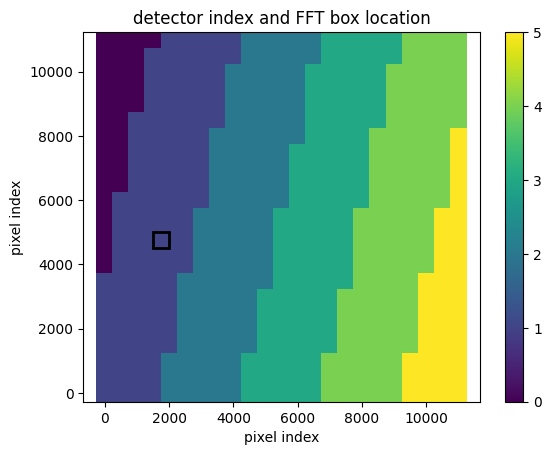

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007626729847849
(31, 31)
(31, 31)
(31, 31)


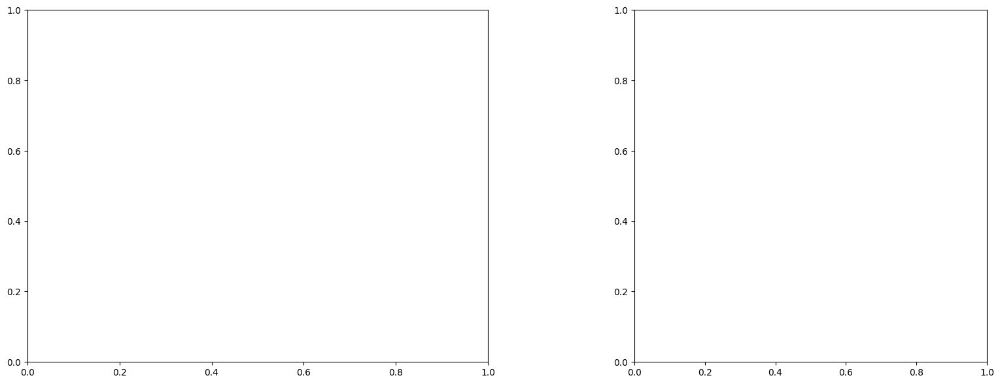

U and V components of current : [ 0.30977103 -0.37391907]
uncertainties for U and V: 0.18459051864289006 0.16111063418386454


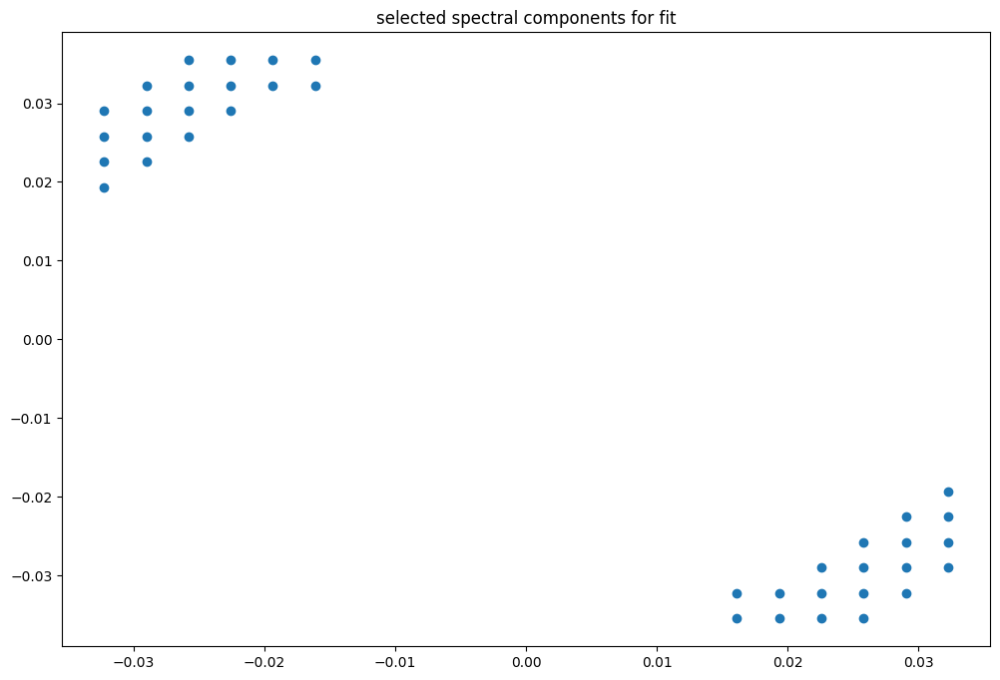

box [1500, 2000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

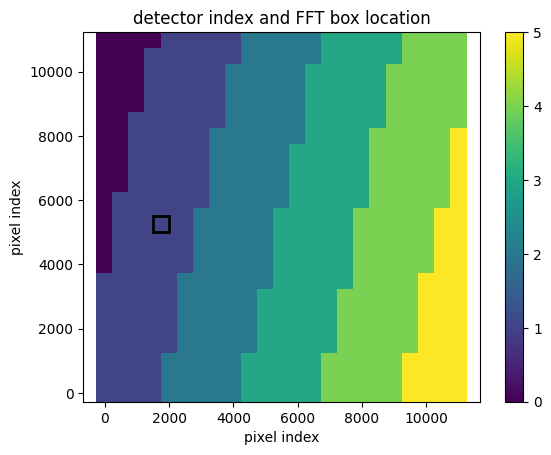

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


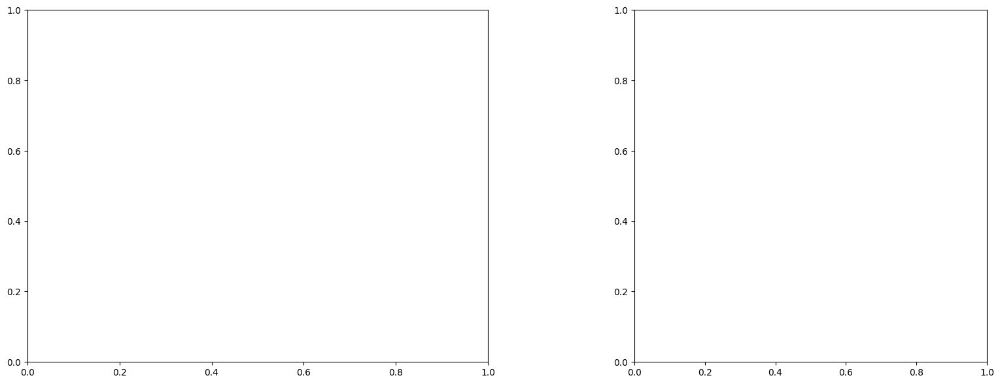

U and V components of current : [ 0.10531201 -0.84128955]
uncertainties for U and V: 0.15913561746379962 0.14891928580293043


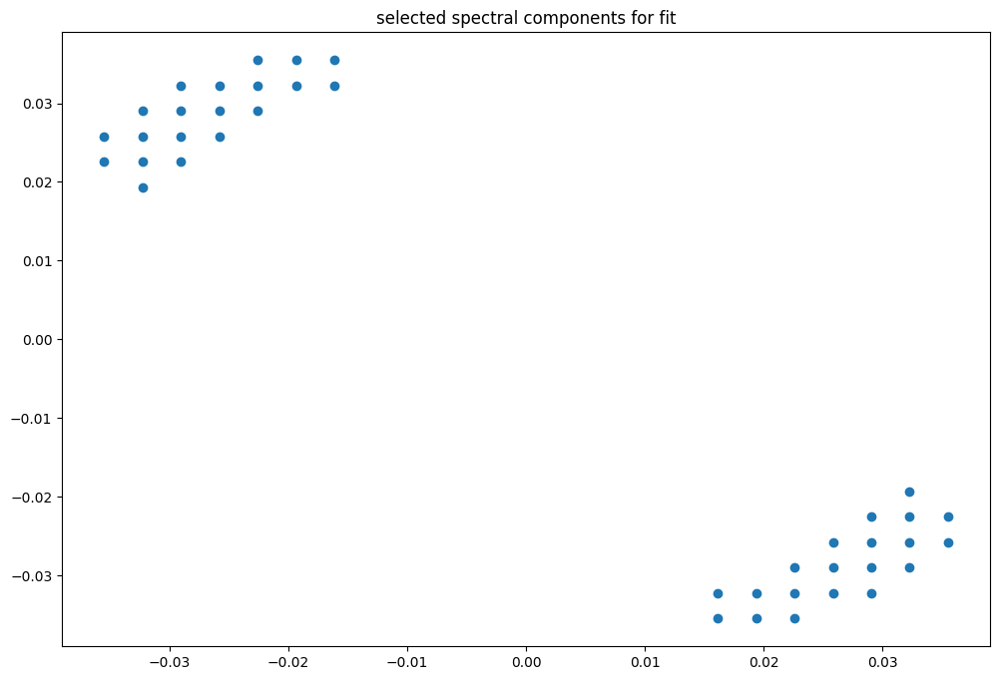

box [1500, 2000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

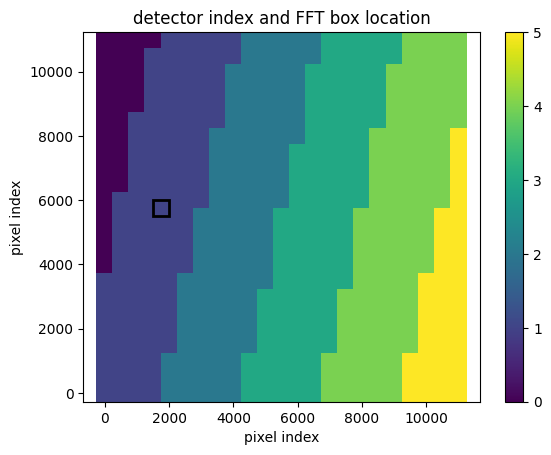

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076202347460554
(31, 31)
(31, 31)
(31, 31)


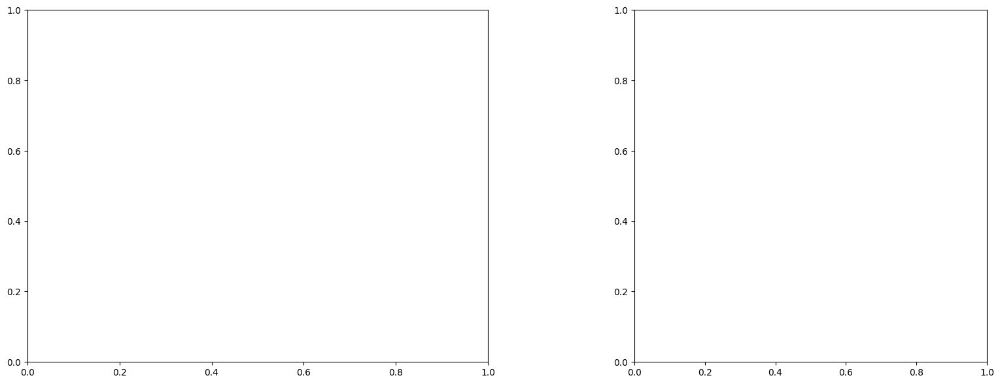

U and V components of current : [ 0.38465372 -0.540912  ]
uncertainties for U and V: 0.1839220919880692 0.17964916766677785


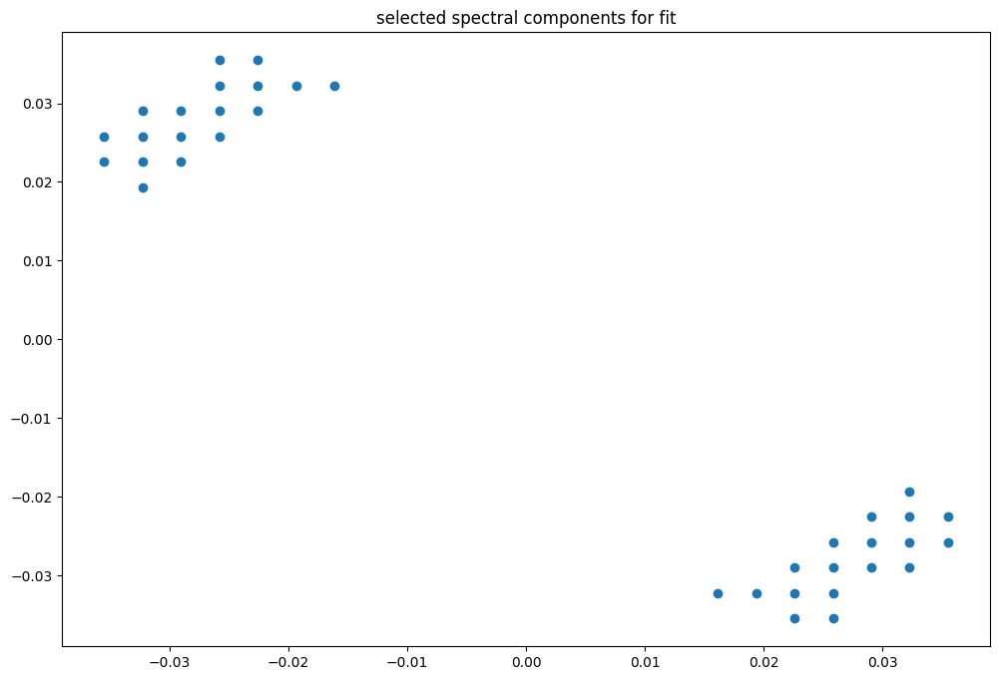

box [1500, 2000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

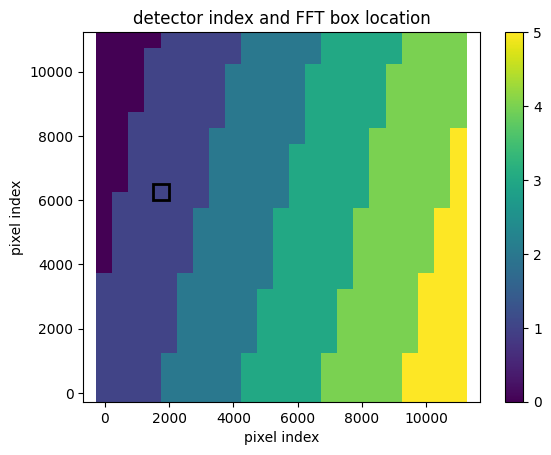

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076202347460554
(31, 31)
(31, 31)
(31, 31)


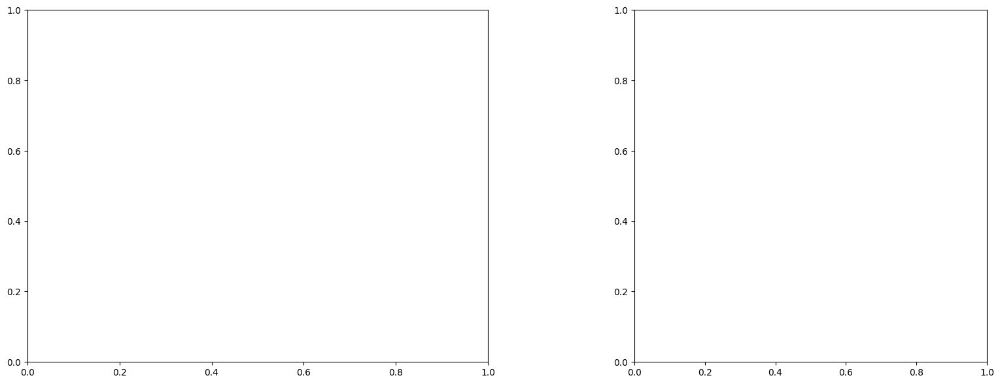

LinAlgError: Singular matrix

box [1500, 2000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

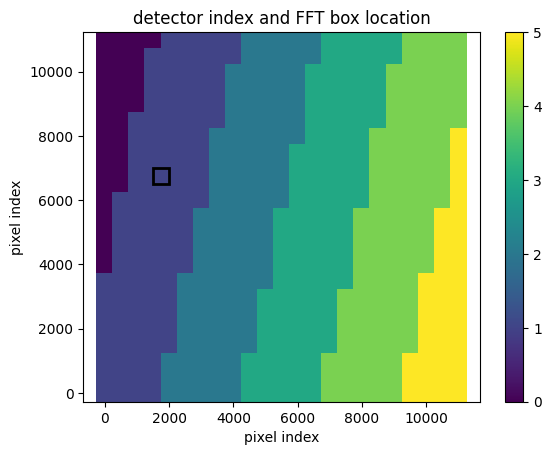

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


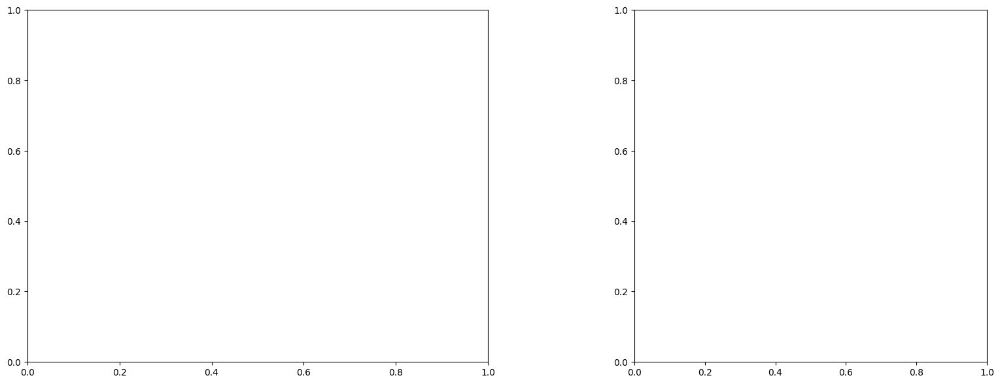

LinAlgError: Singular matrix

box [1500, 2000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

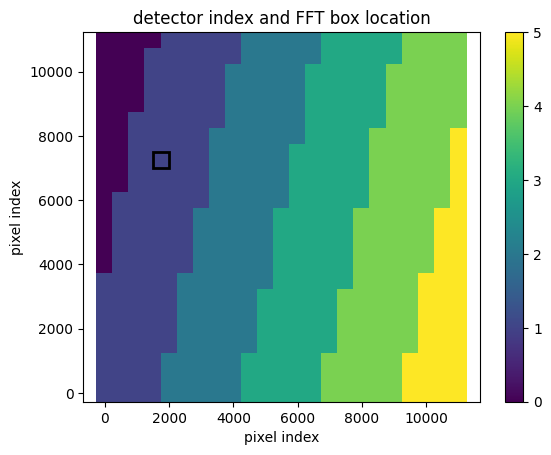

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076138799349308
(31, 31)
(31, 31)
(31, 31)


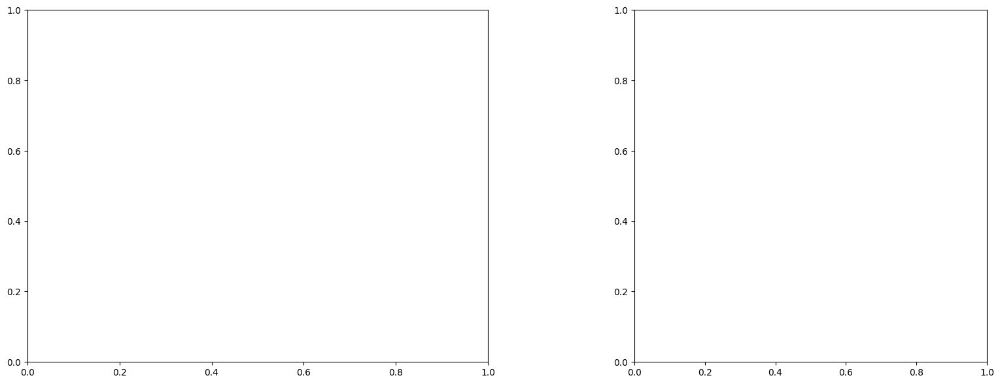

LinAlgError: Singular matrix

box [1500, 2000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

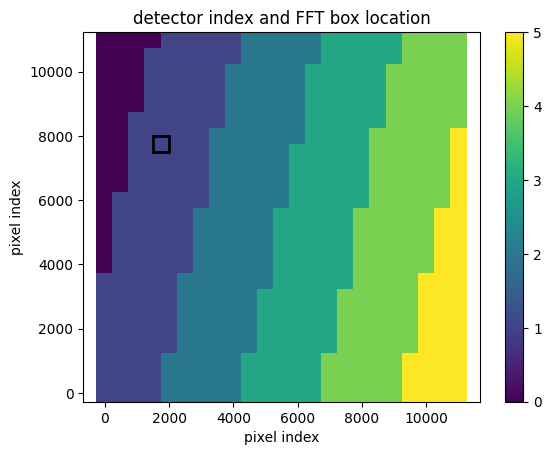

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


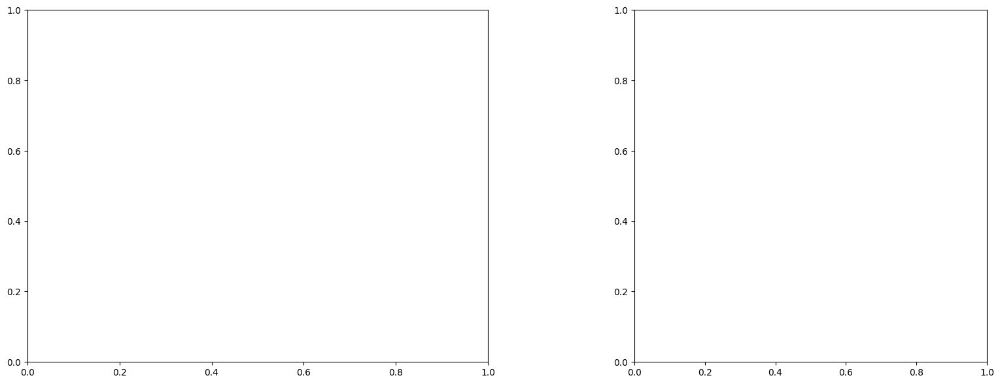

LinAlgError: Singular matrix

box [1500, 2000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

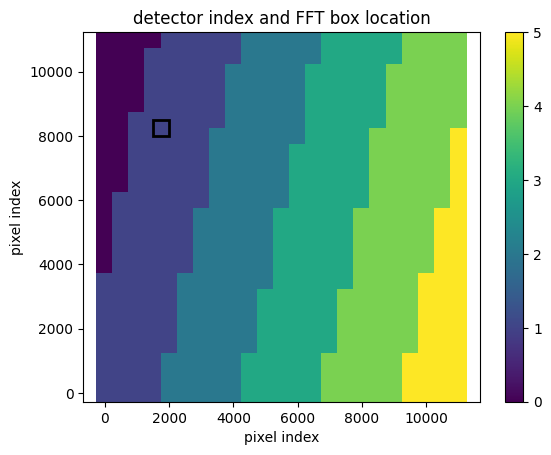

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


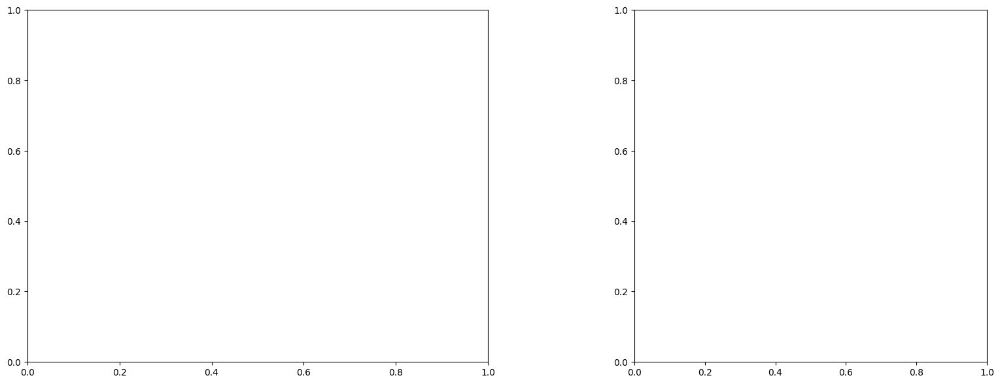

LinAlgError: Singular matrix

box [1500, 2000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

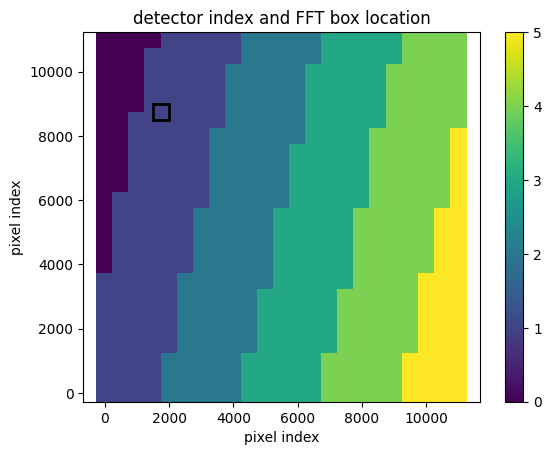

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


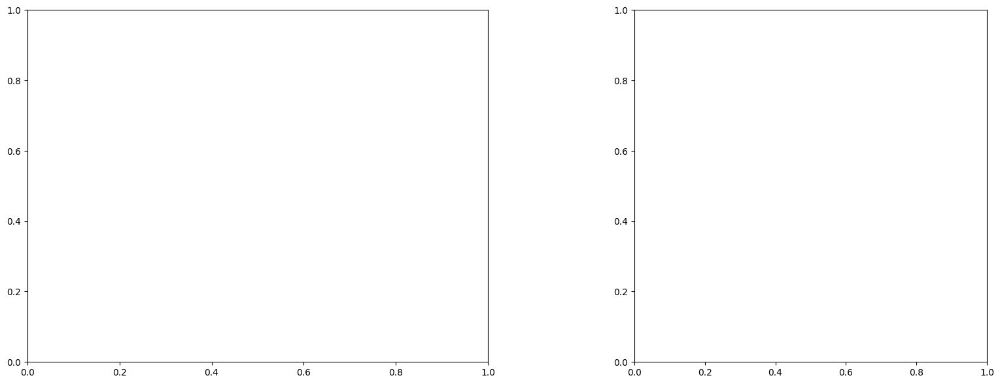

LinAlgError: Singular matrix

box [1500, 2000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

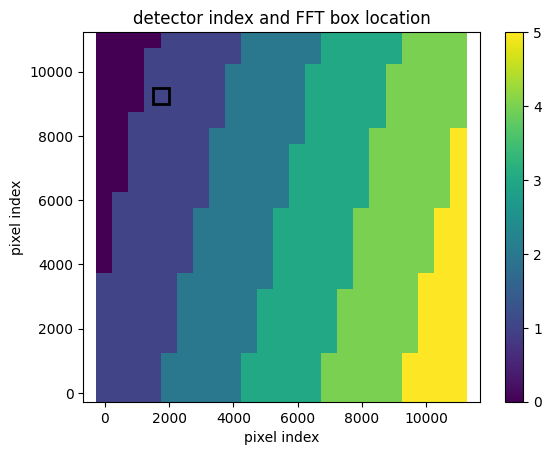

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076048561584954
(31, 31)
(31, 31)
(31, 31)


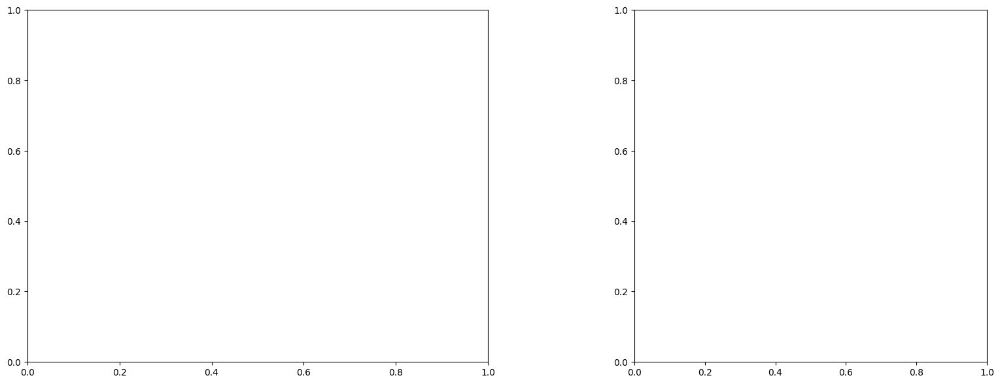

U and V components of current : [ 0.27758087 -0.01991566]
uncertainties for U and V: 0.153814827566667 0.1293670652912105


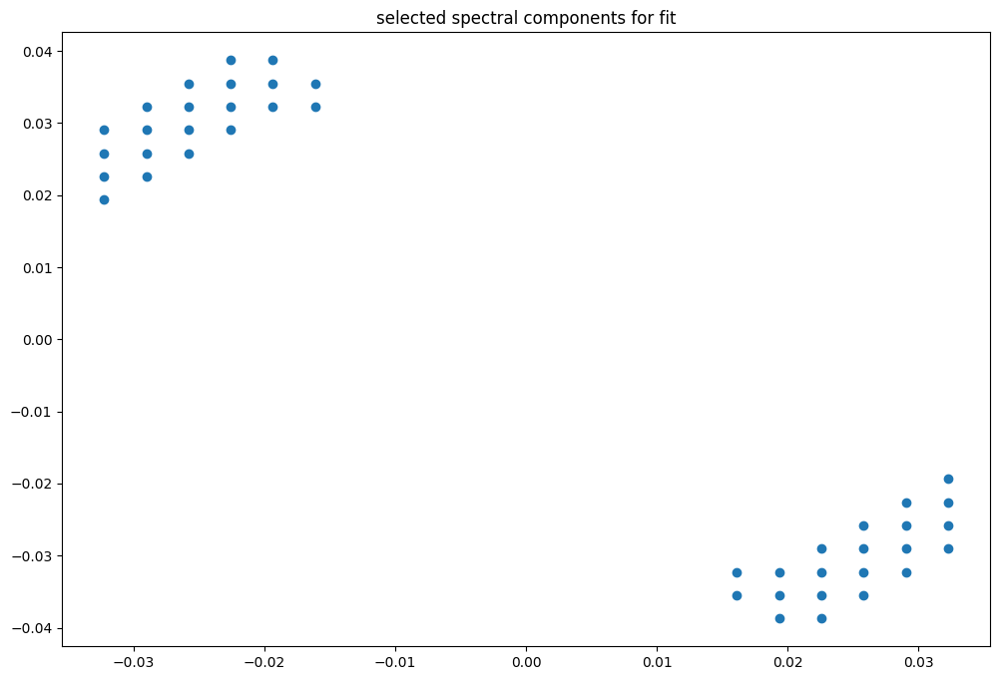

box [1500, 2000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

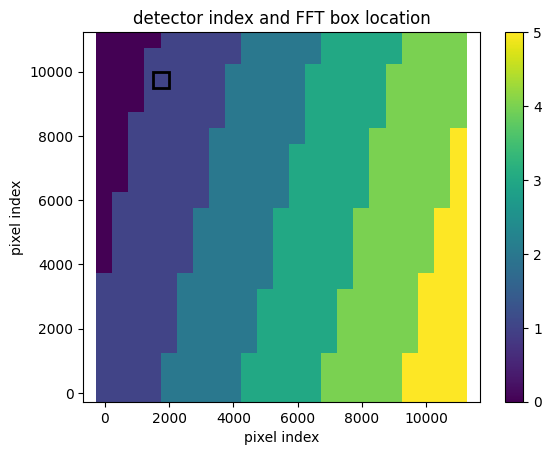

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076048561584954
(31, 31)
(31, 31)
(31, 31)


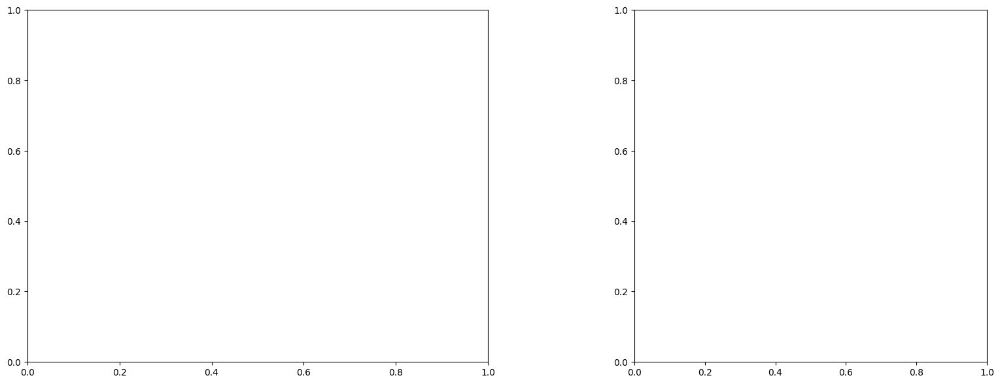

U and V components of current : [ 0.20864928 -0.151662  ]
uncertainties for U and V: 0.1107137654483504 0.08496240046425556


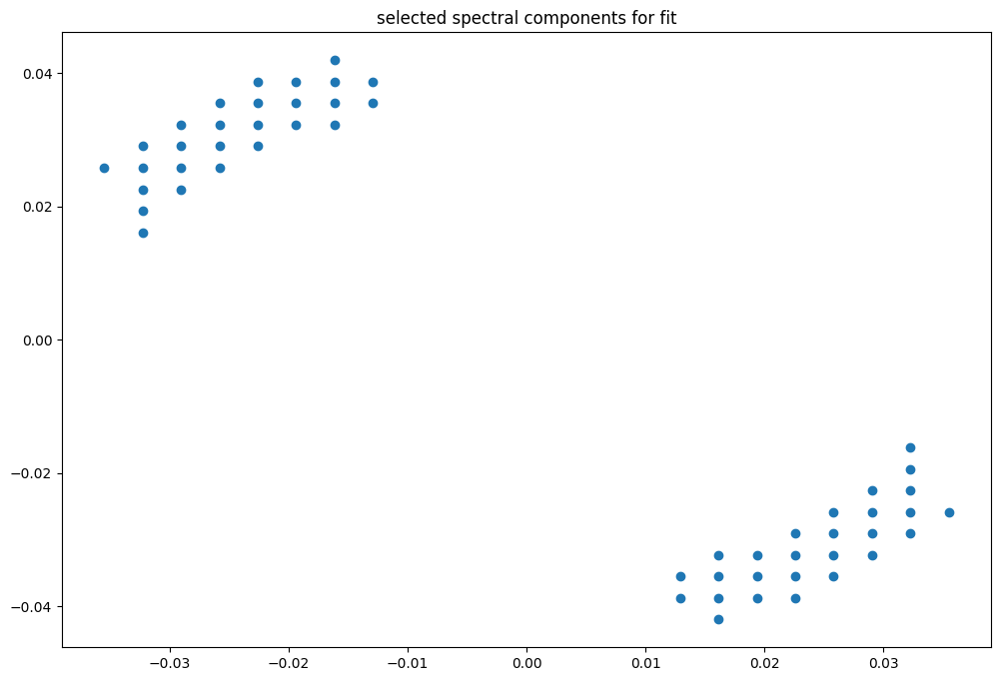

box [1500, 2000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

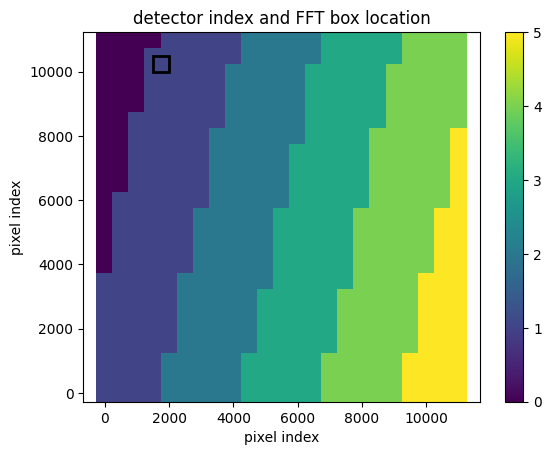

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(31, 31)
(31, 31)
(31, 31)


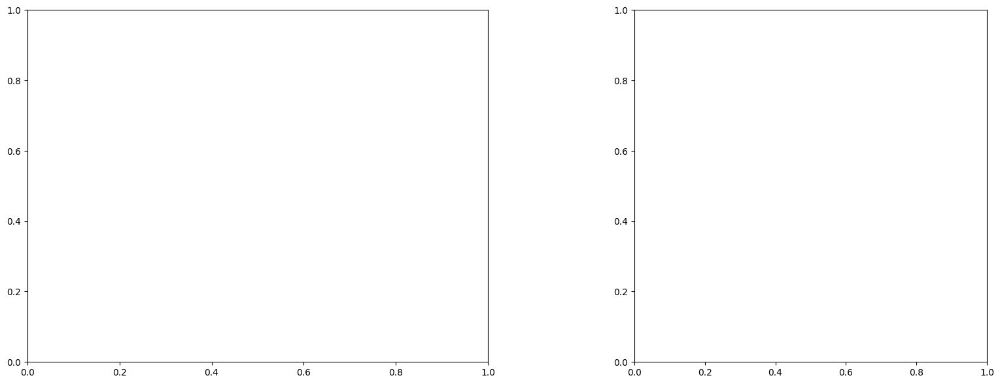

U and V components of current : [-0.11968889 -0.33537916]
uncertainties for U and V: 0.11786092136690267 0.09433720466994781


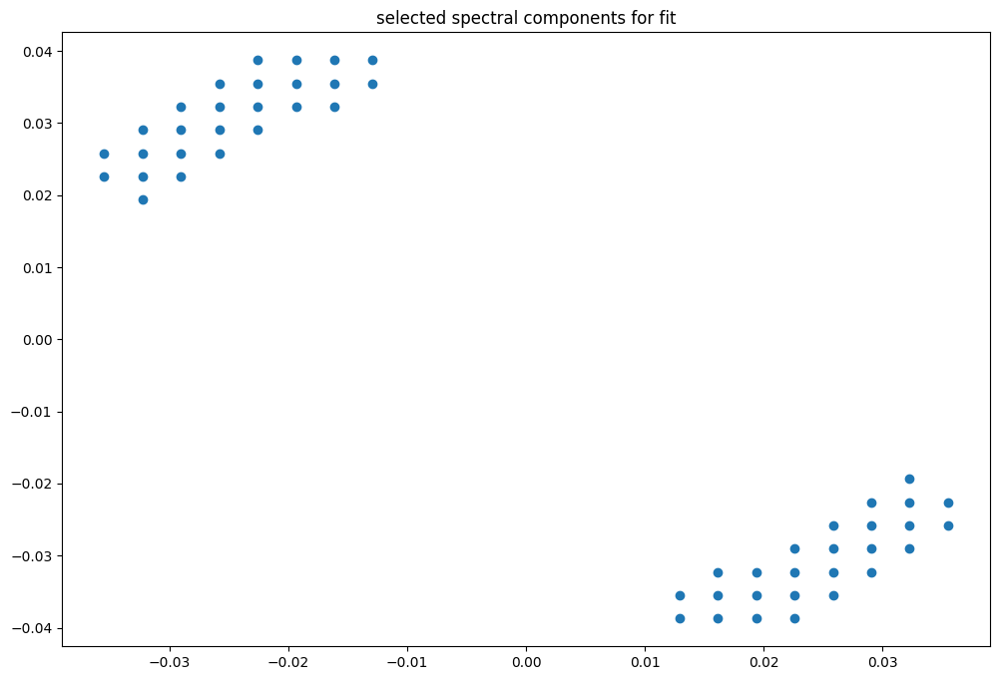

box [1500, 2000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

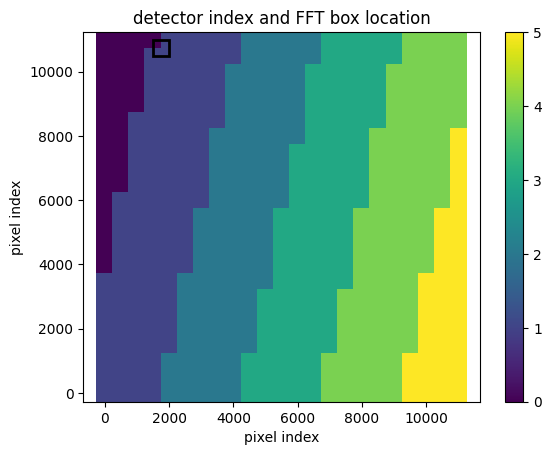

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.5
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(31, 30)
(31, 30)
(31, 30)


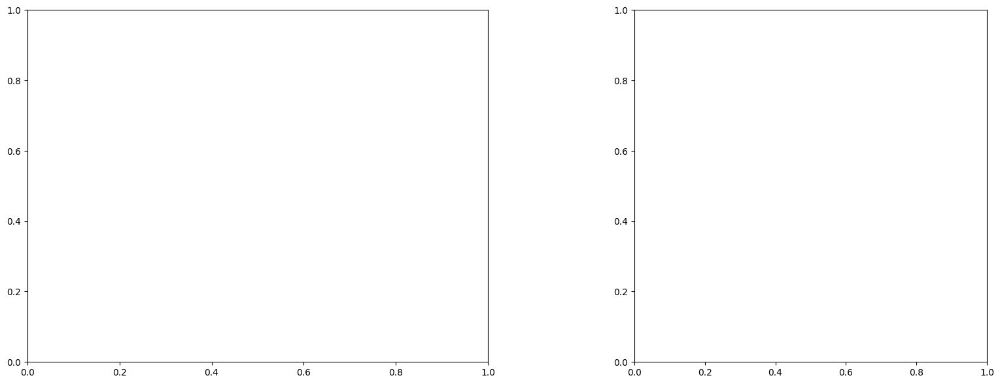

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

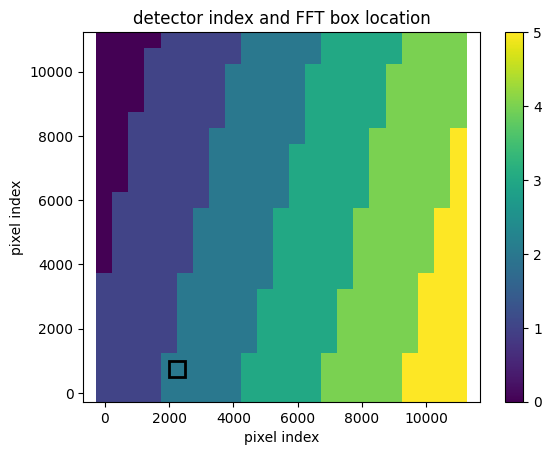

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


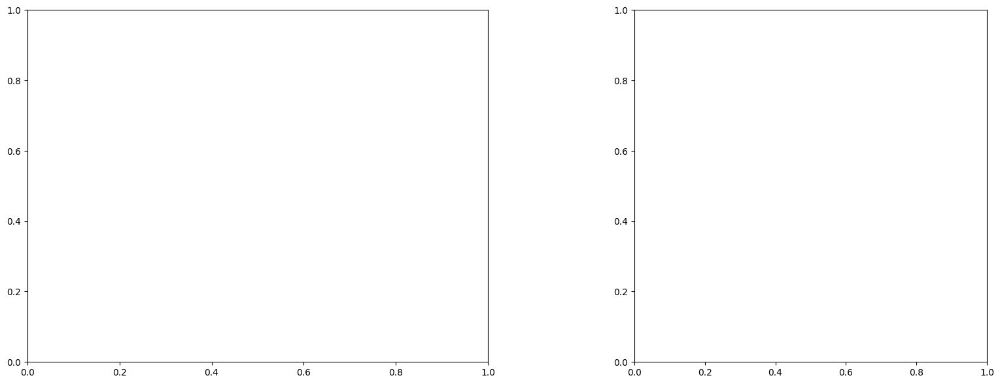

U and V components of current : [1.0282639  1.26085841]
uncertainties for U and V: 0.26167460205238063 0.22099060867742282


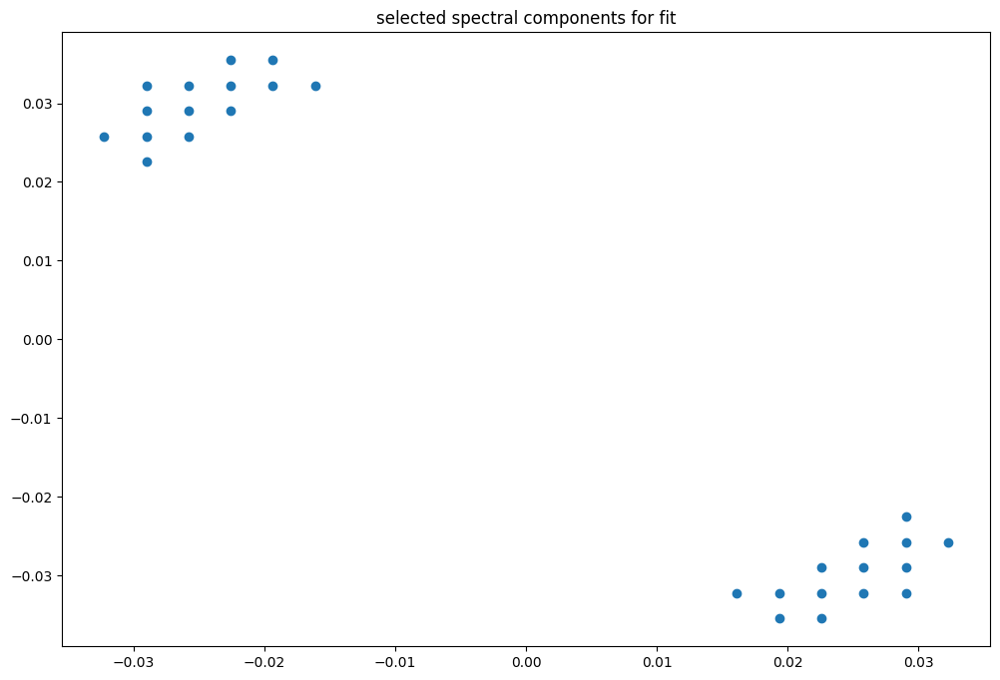

box [2000, 2500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

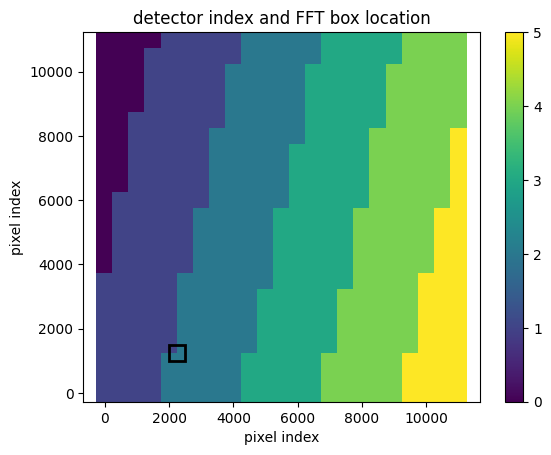

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


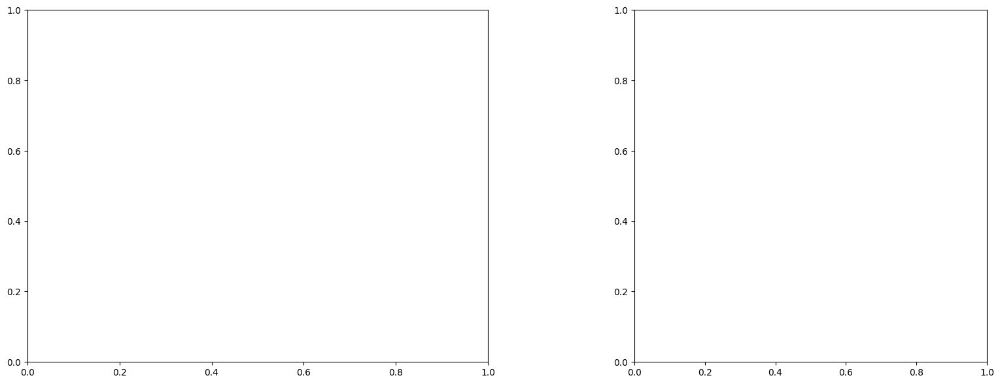

LinAlgError: Singular matrix

box [2000, 2500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

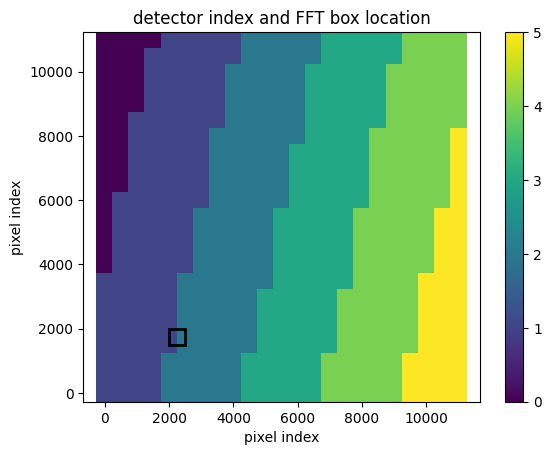

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


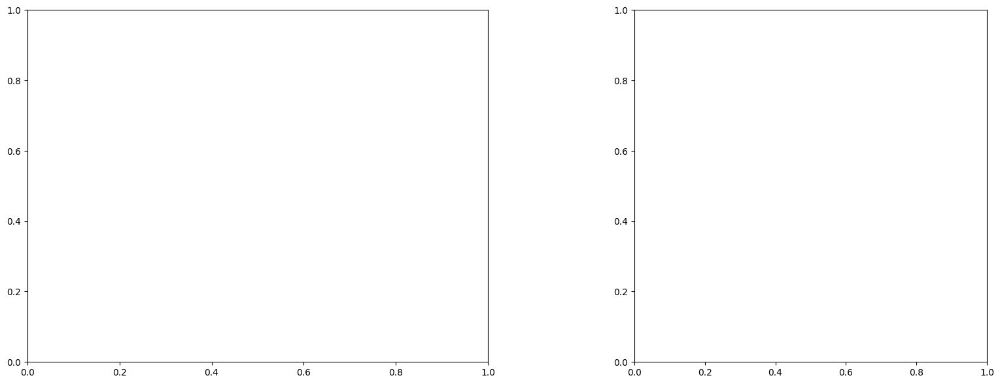

LinAlgError: Singular matrix

box [2000, 2500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

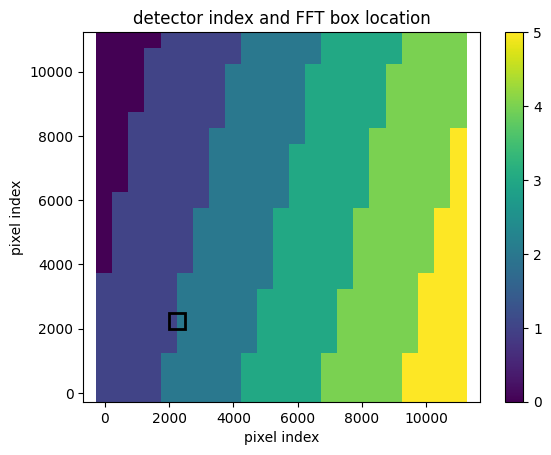

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


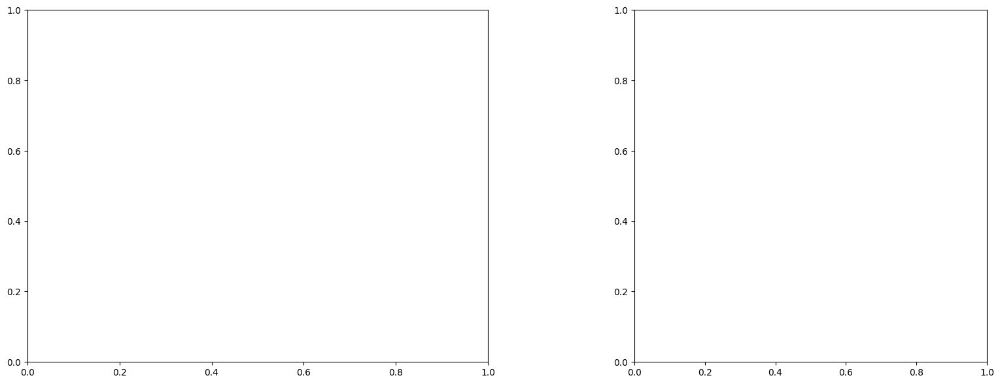

LinAlgError: Singular matrix

box [2000, 2500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

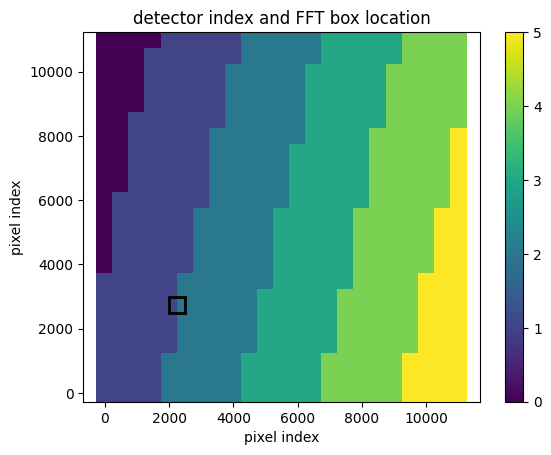

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


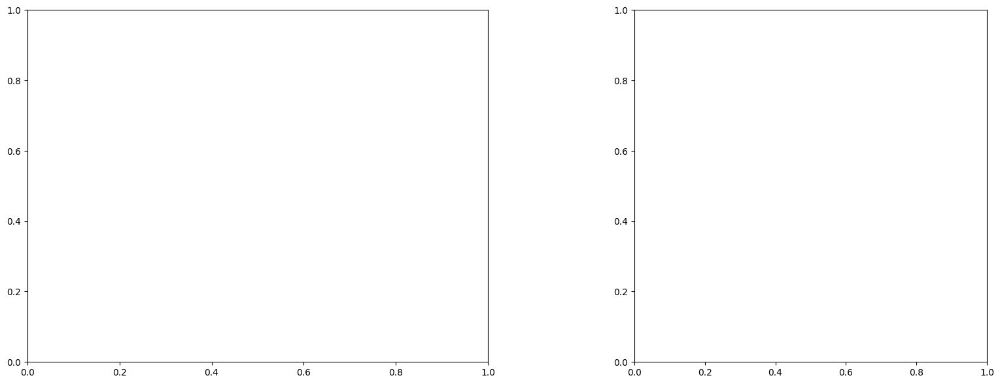

LinAlgError: Singular matrix

box [2000, 2500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

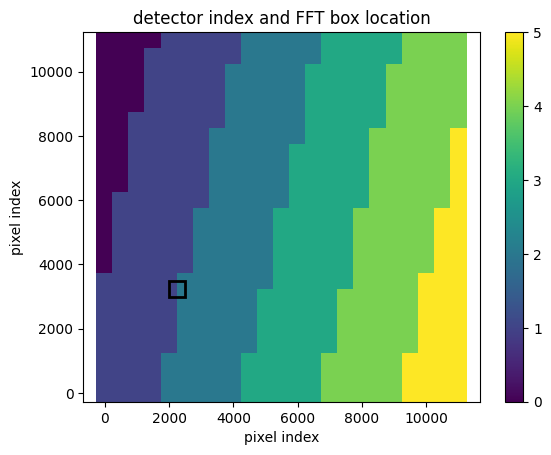

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


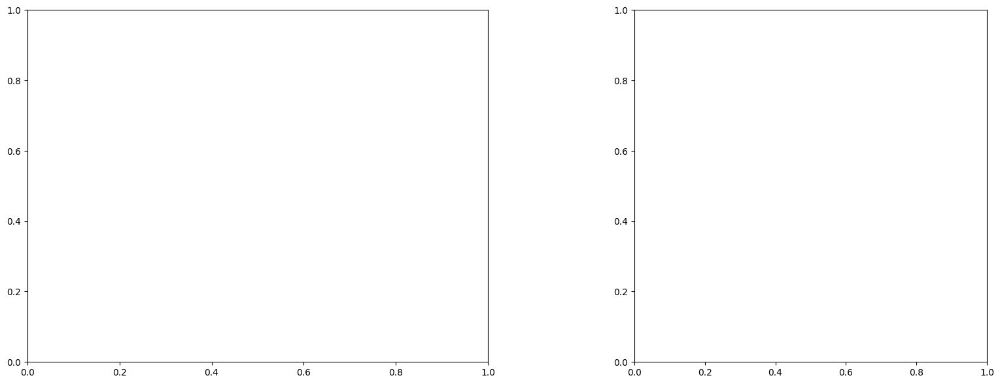

U and V components of current : [-0.77644944 -0.56518083]
uncertainties for U and V: 0.20140739773616537 0.18921031379783962


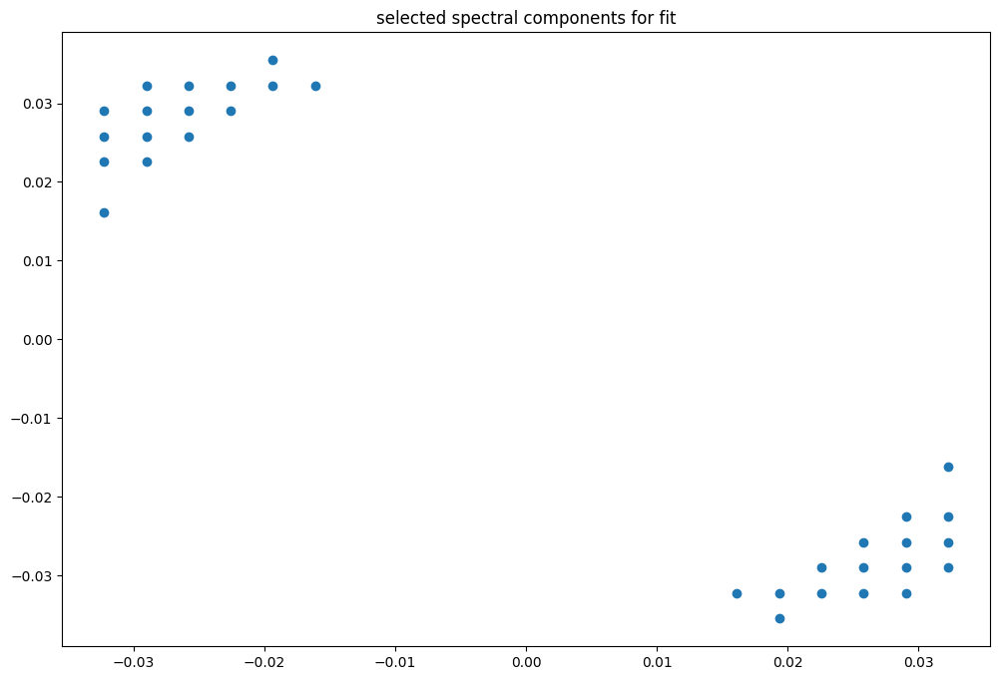

box [2000, 2500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

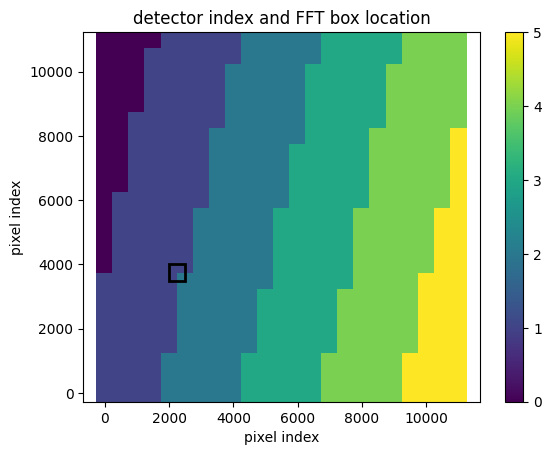

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076300773184161
(31, 31)
(31, 31)
(31, 31)


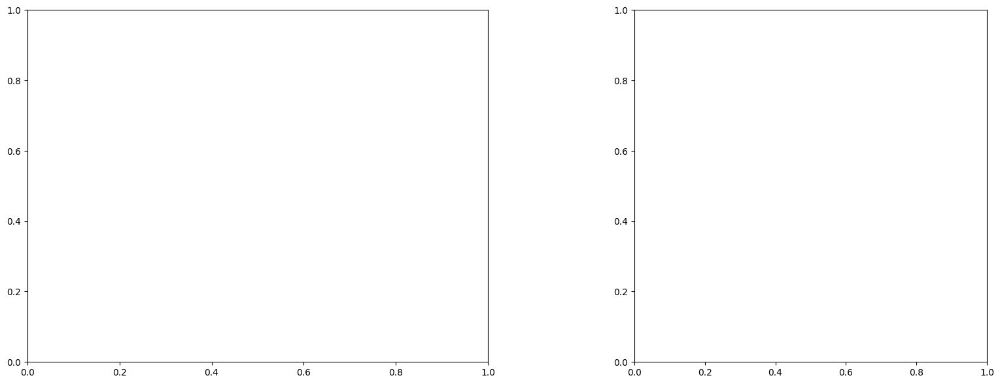

U and V components of current : [0.6967398  0.35827315]
uncertainties for U and V: 0.17203699703114955 0.15777734302534127


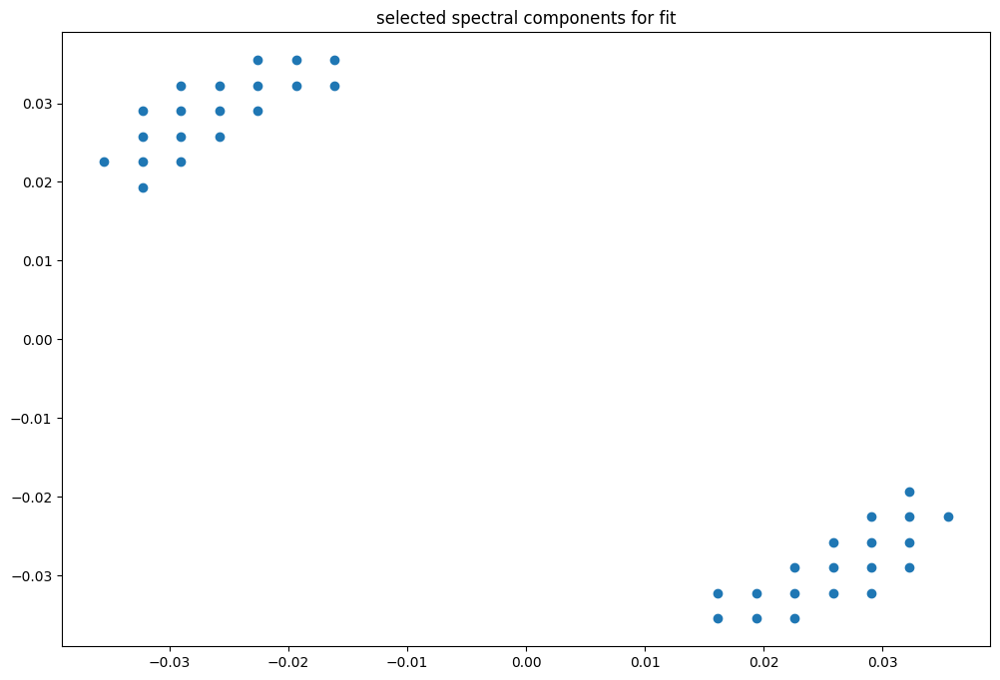

box [2000, 2500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

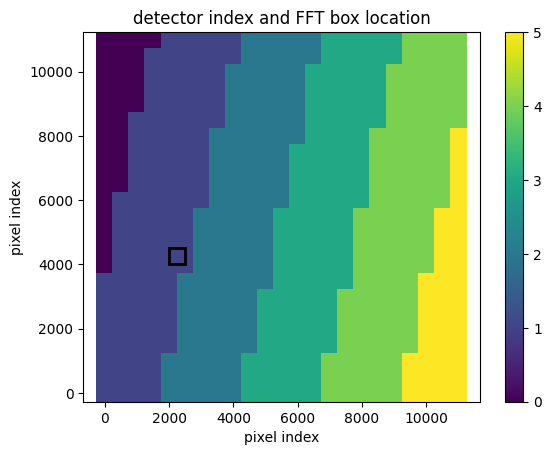

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007626729847849
(31, 31)
(31, 31)
(31, 31)


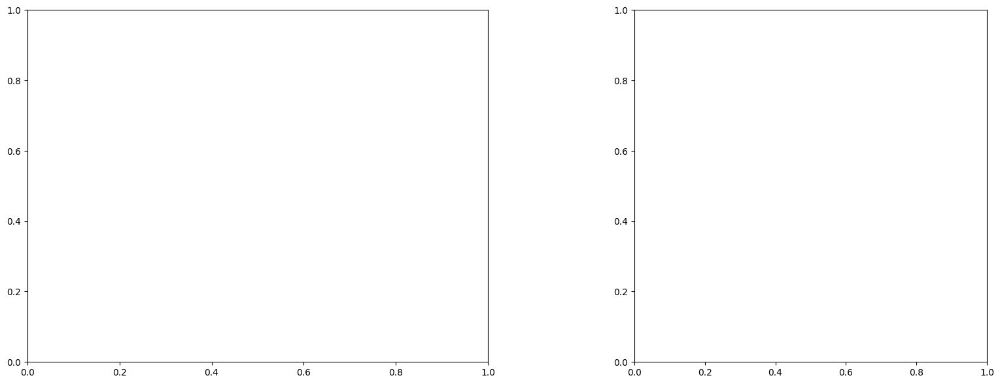

U and V components of current : [ 0.10148517 -0.50613462]
uncertainties for U and V: 0.22788354344655795 0.21984293397949006


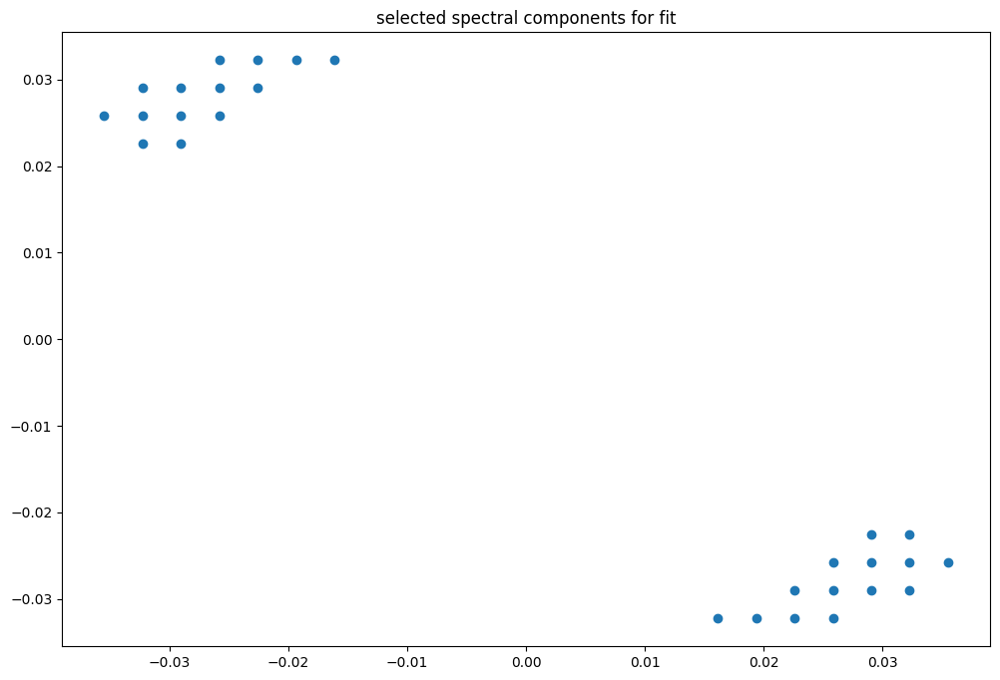

box [2000, 2500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

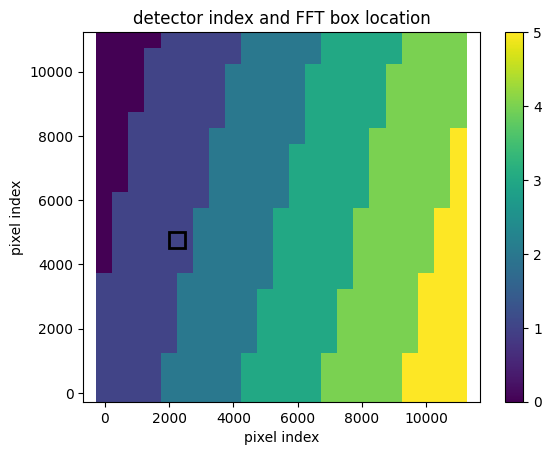

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007626729847849
(31, 31)
(31, 31)
(31, 31)


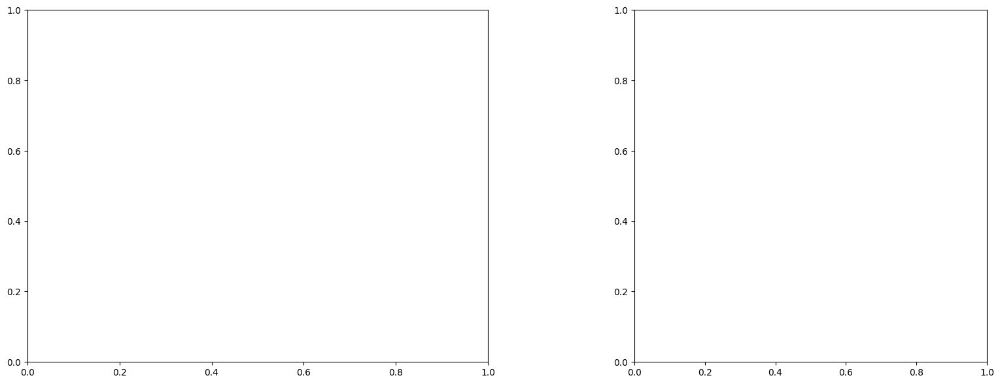

U and V components of current : [ 0.73012673 -0.08875985]
uncertainties for U and V: 0.1668277175178891 0.15147809846636356


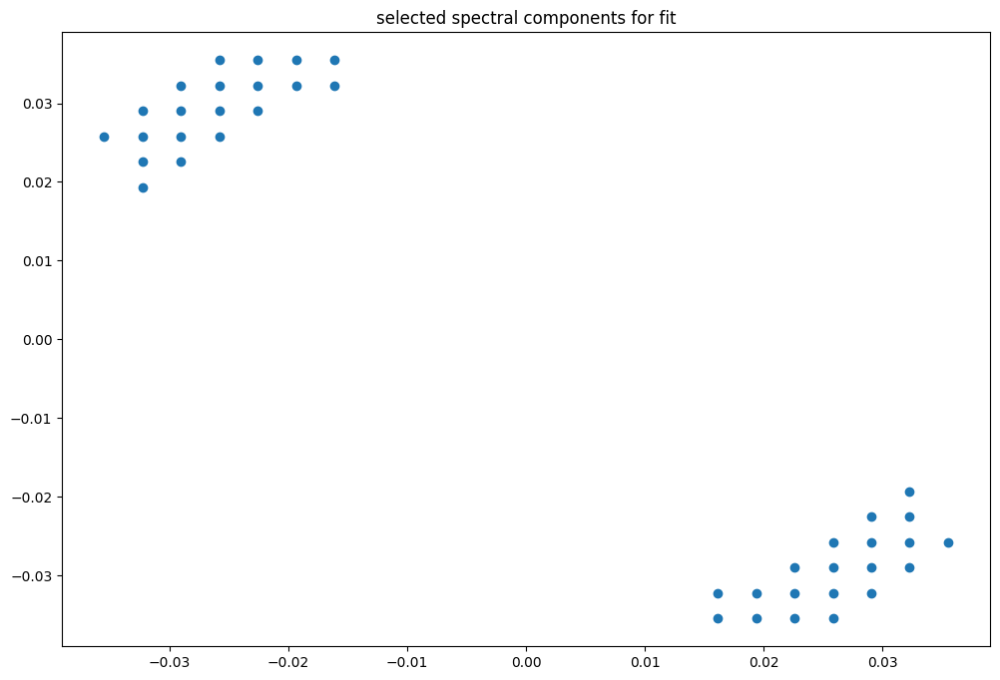

box [2000, 2500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

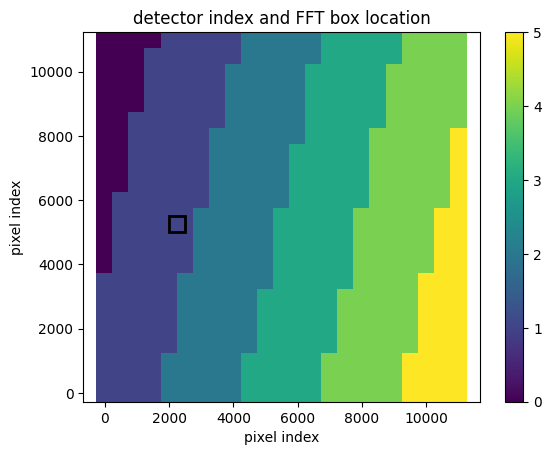

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076235398753548
(31, 31)
(31, 31)
(31, 31)


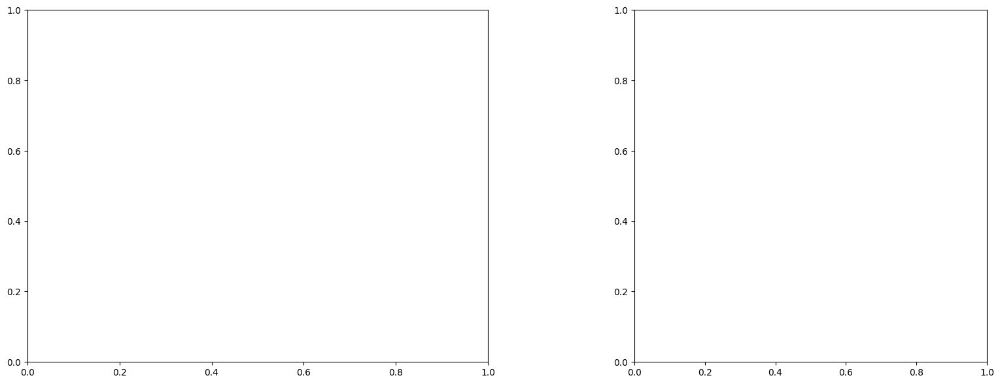

U and V components of current : [ 0.19439075 -0.52879425]
uncertainties for U and V: 0.2125160701525961 0.20631479670866618


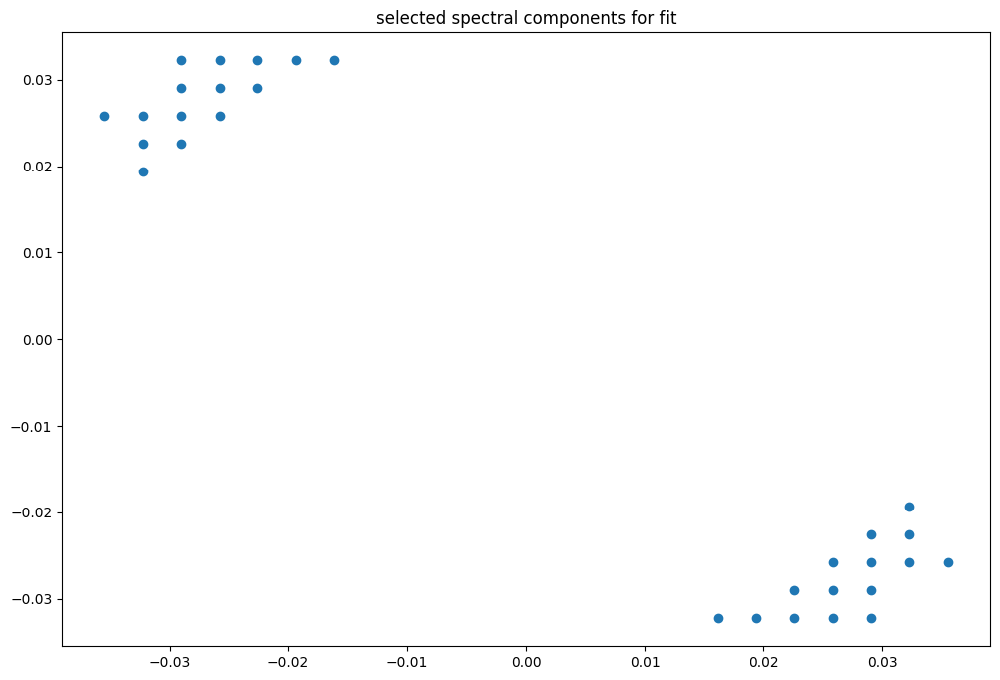

box [2000, 2500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

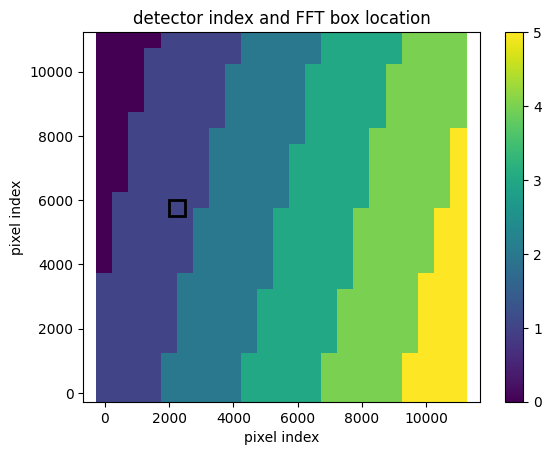

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076202347460554
(31, 31)
(31, 31)
(31, 31)


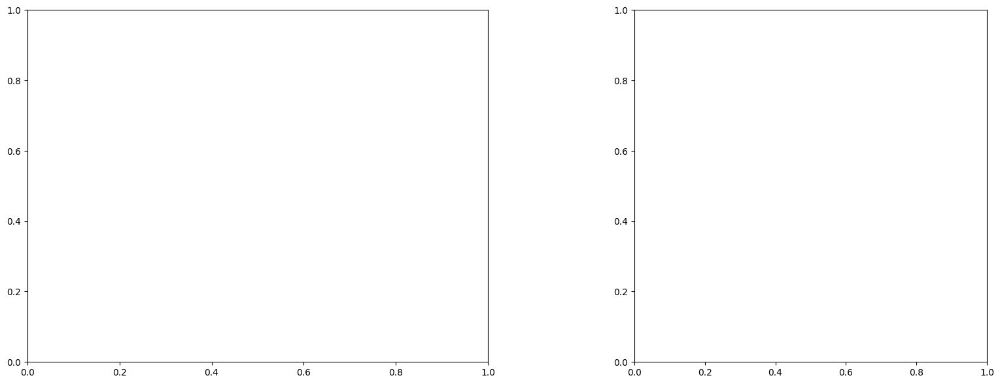

U and V components of current : [ 0.6637201  -0.39463741]
uncertainties for U and V: 0.17325809472734255 0.17610886309200682


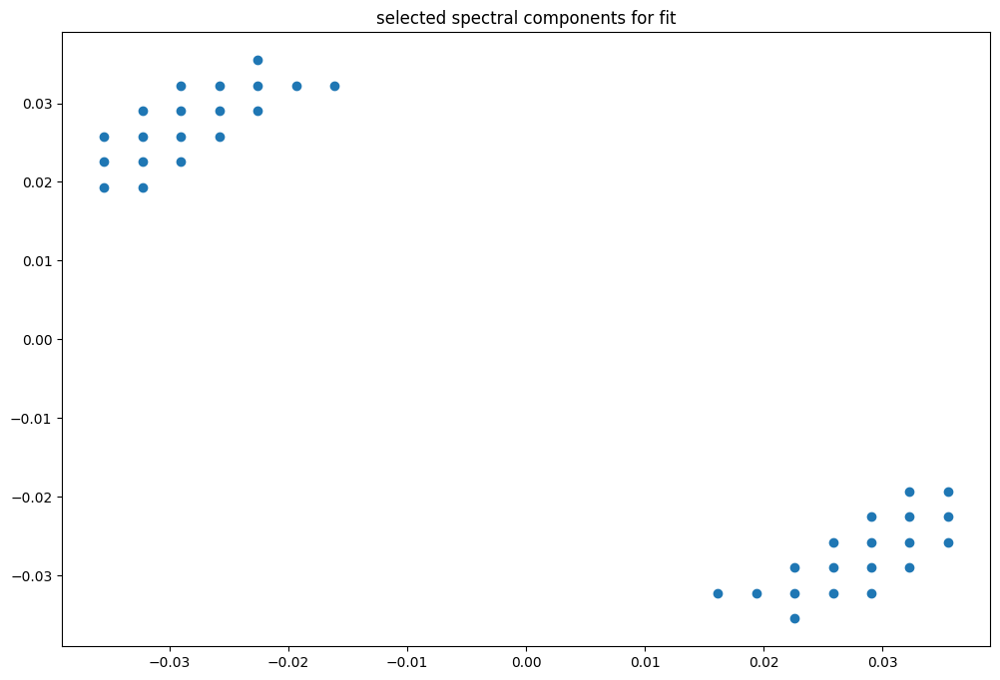

box [2000, 2500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

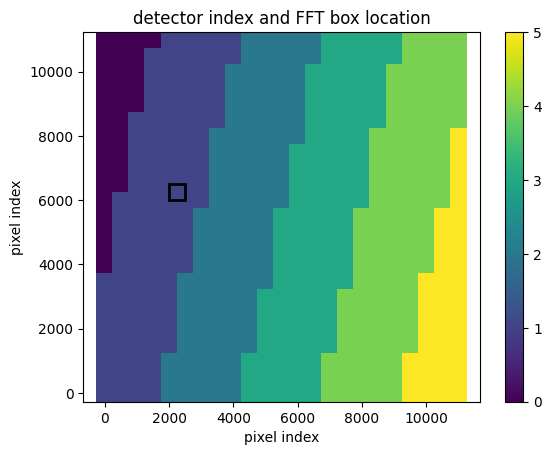

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


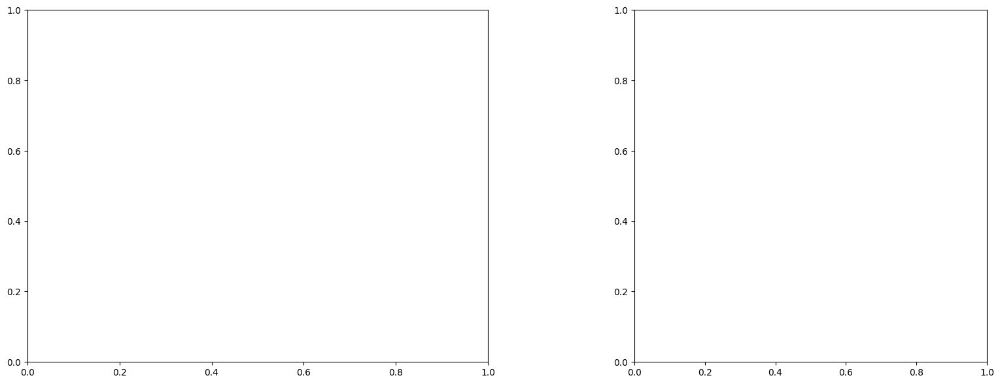

LinAlgError: Singular matrix

box [2000, 2500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

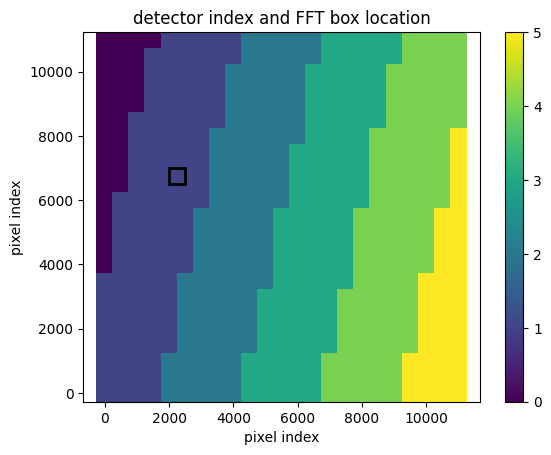

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


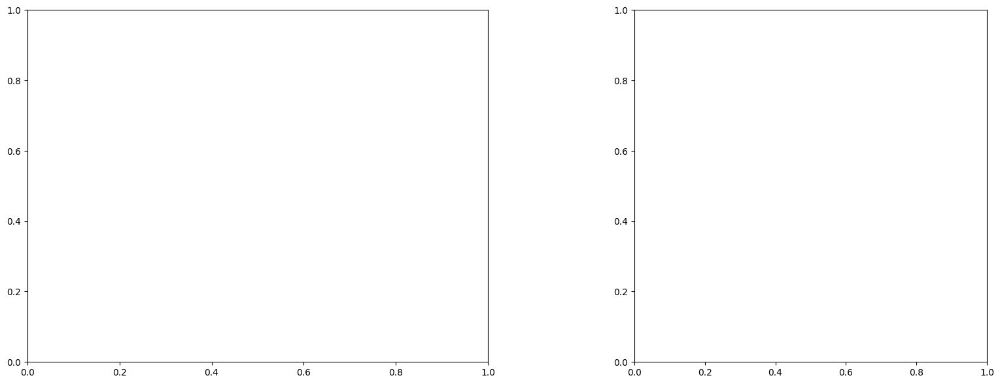

LinAlgError: Singular matrix

box [2000, 2500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

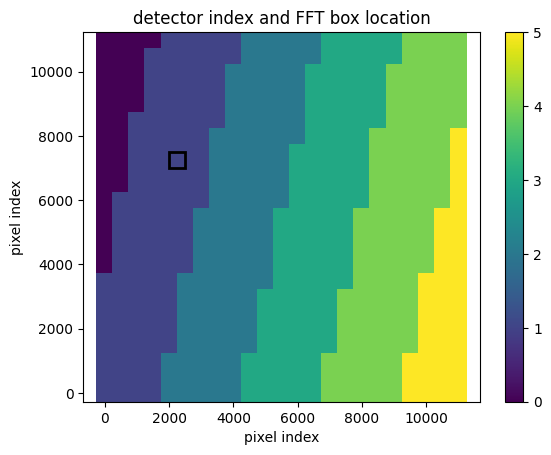

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076138799349308
(31, 31)
(31, 31)
(31, 31)


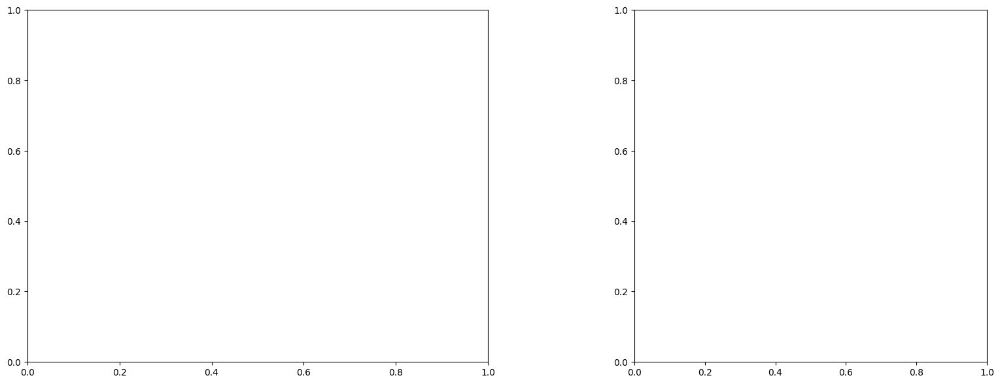

LinAlgError: Singular matrix

box [2000, 2500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

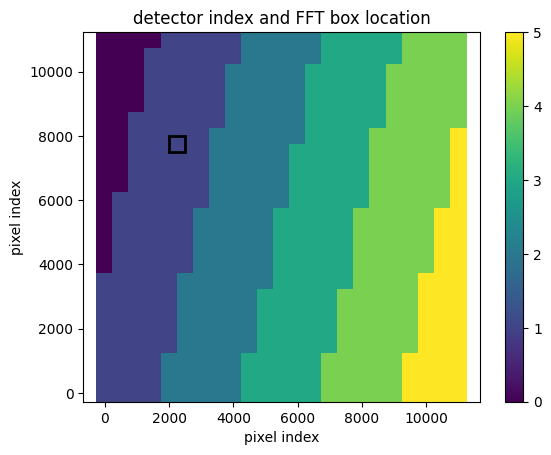

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


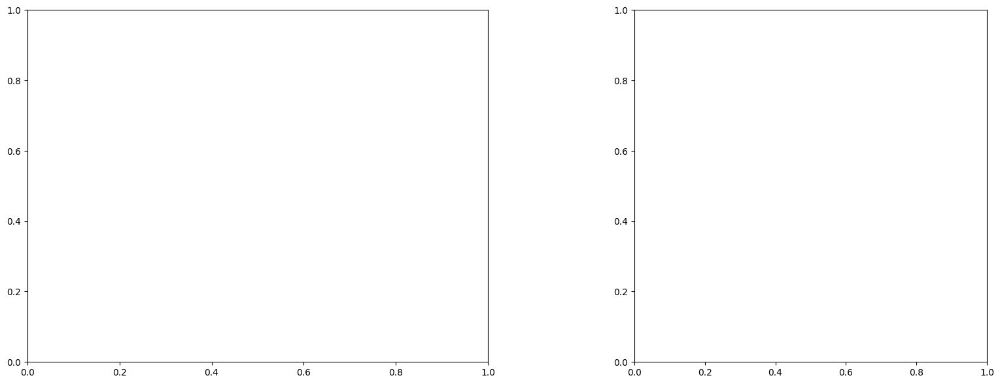

LinAlgError: Singular matrix

box [2000, 2500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

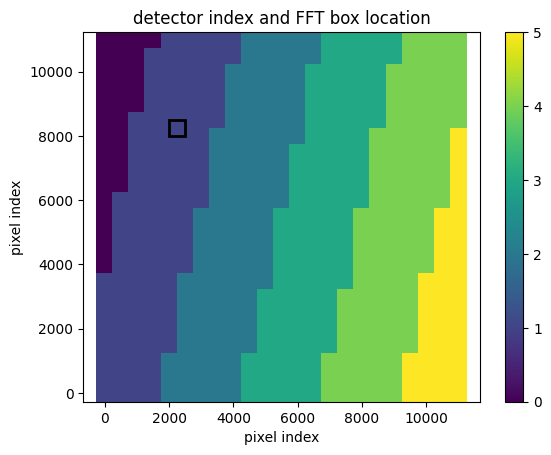

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


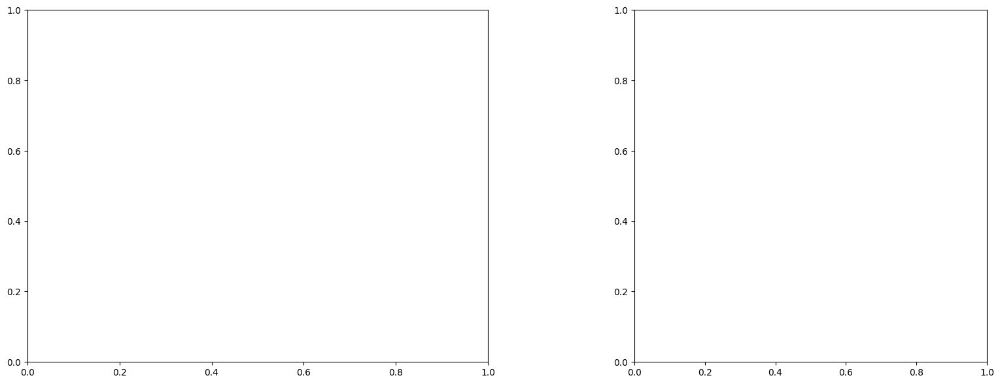

U and V components of current : [ 0.23395496 -0.1120825 ]
uncertainties for U and V: 0.175343809006744 0.17670916267497974


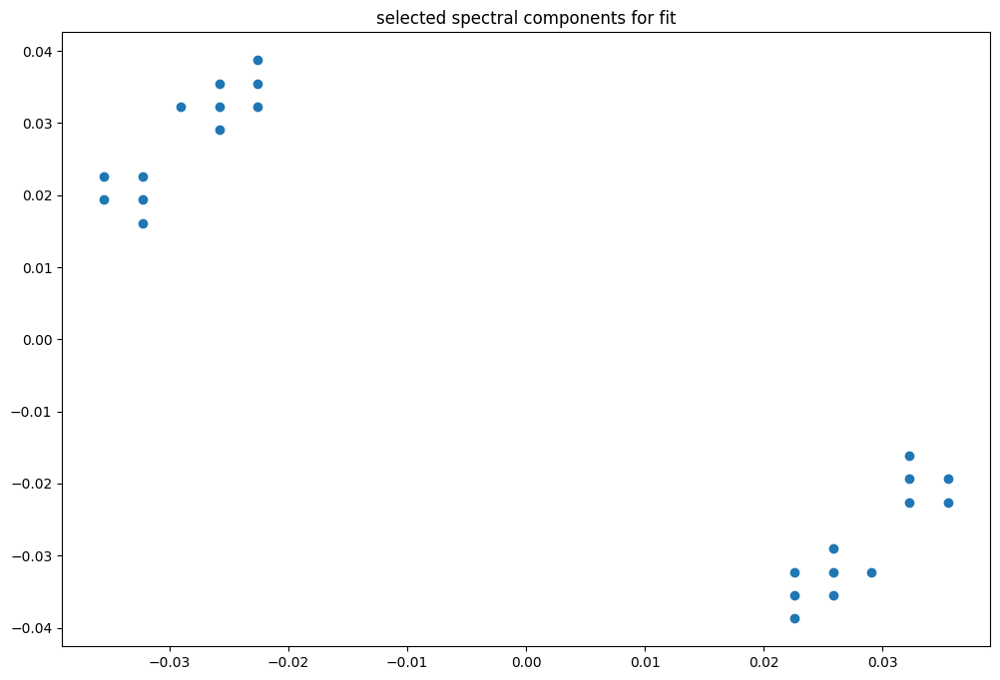

box [2000, 2500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

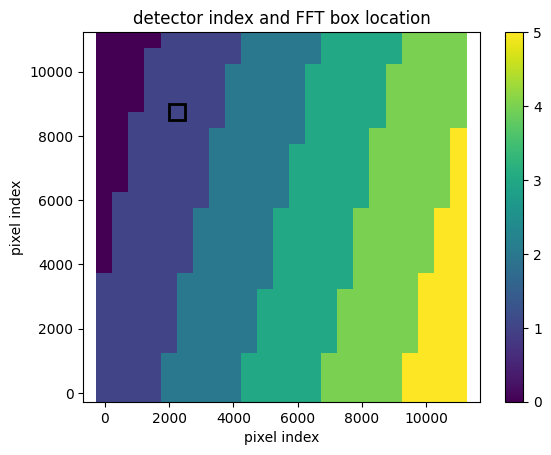

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


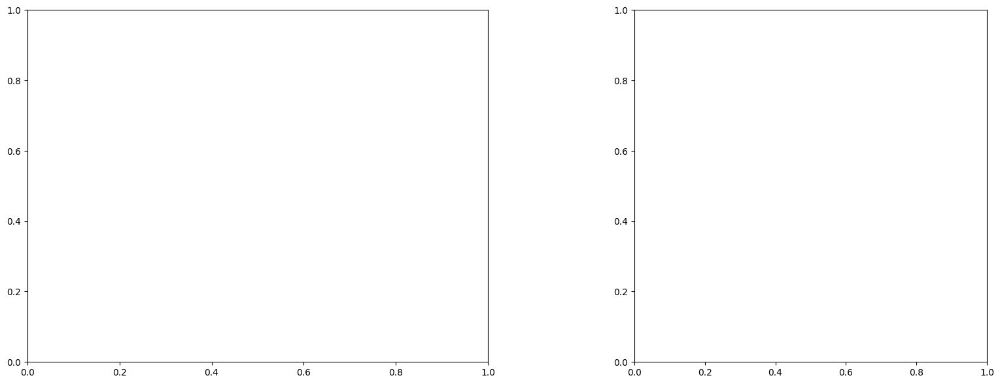

U and V components of current : [ 0.03115441 -0.13292223]
uncertainties for U and V: 0.1179354713717901 0.08192948696332304


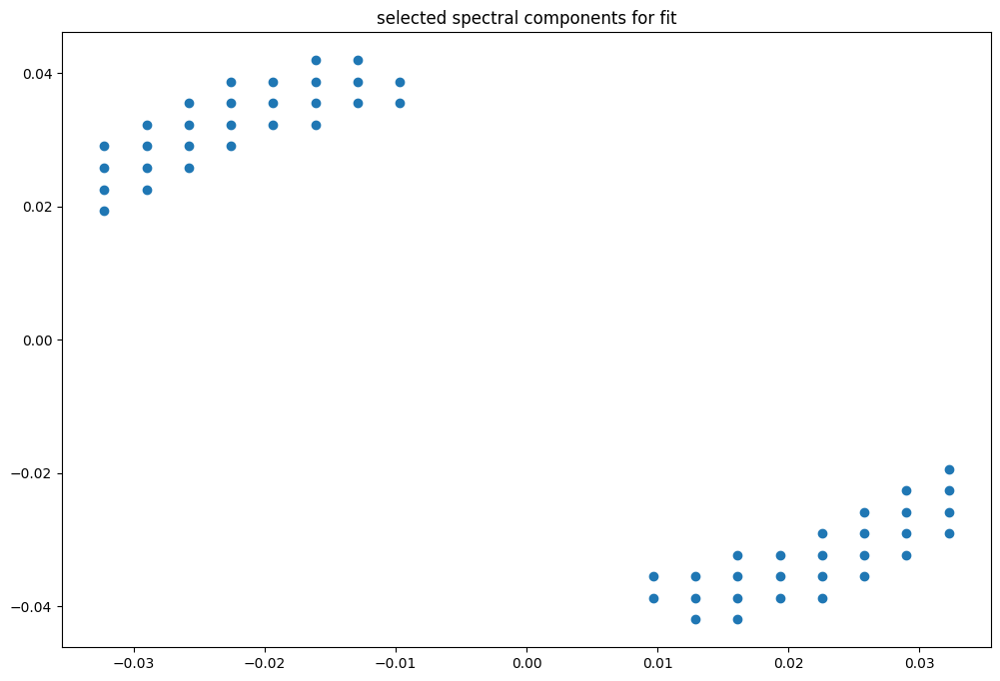

box [2000, 2500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

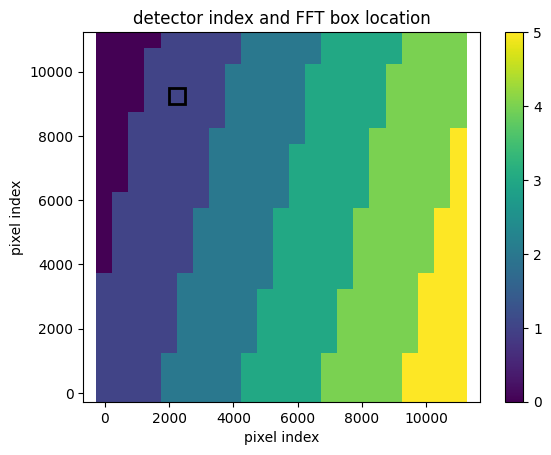

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076048561584954
(31, 31)
(31, 31)
(31, 31)


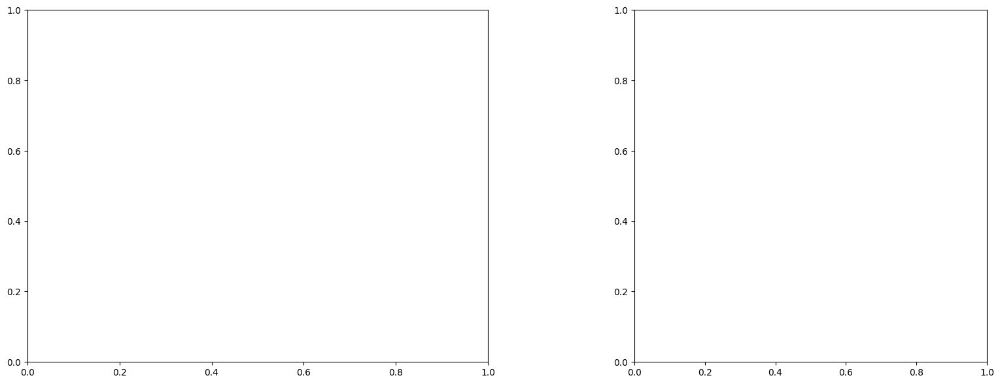

U and V components of current : [ 0.01733474 -0.24068198]
uncertainties for U and V: 0.10002938220667545 0.06853816500981234


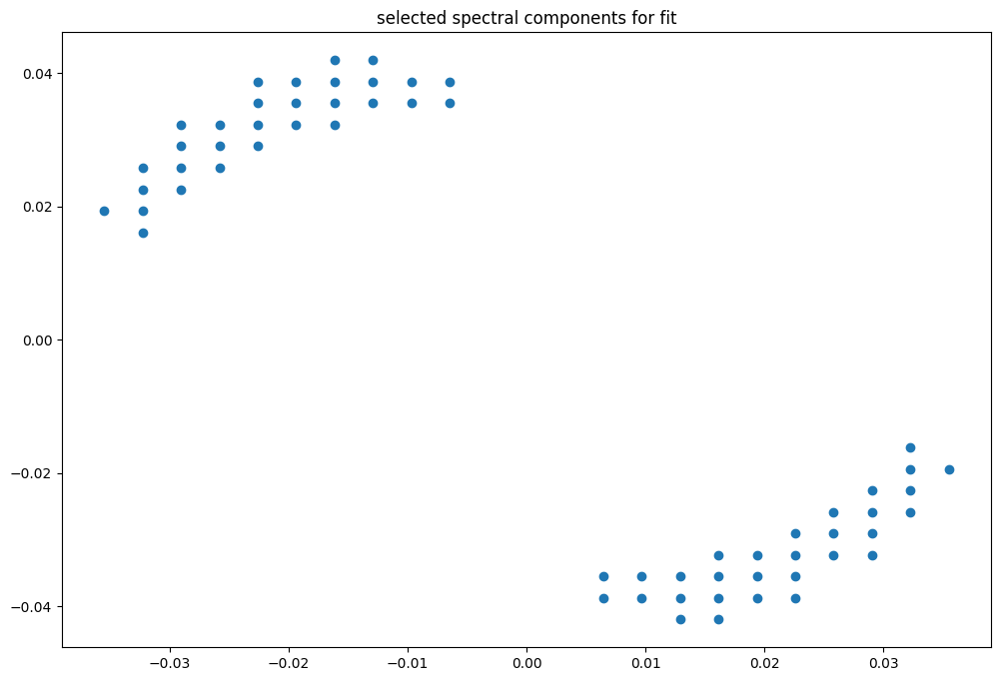

box [2000, 2500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

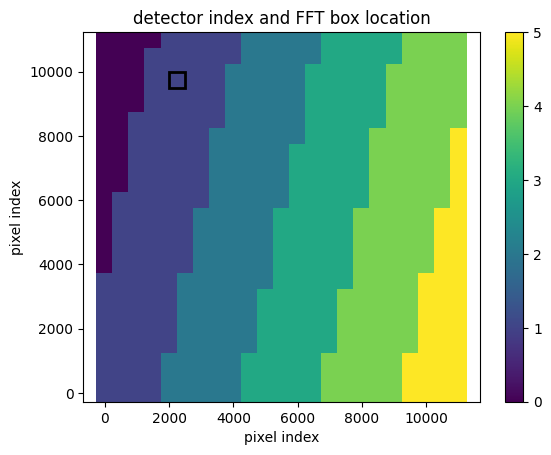

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(31, 31)
(31, 31)
(31, 31)


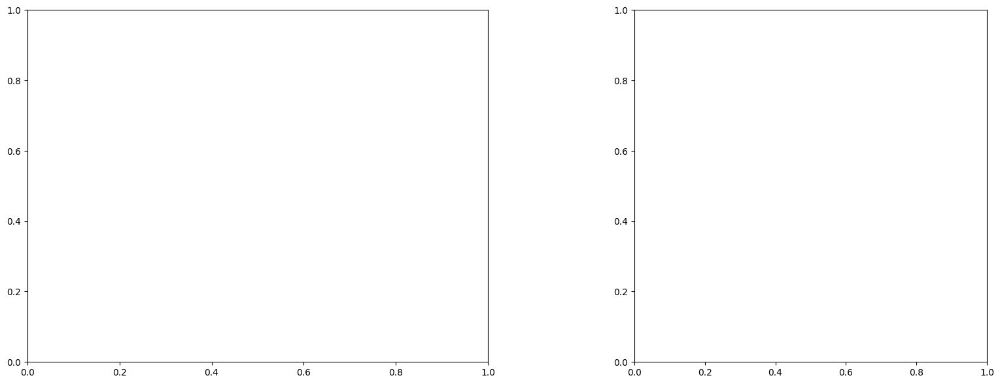

U and V components of current : [-0.17596948 -0.25821613]
uncertainties for U and V: 0.12291822466734084 0.09028058498717516


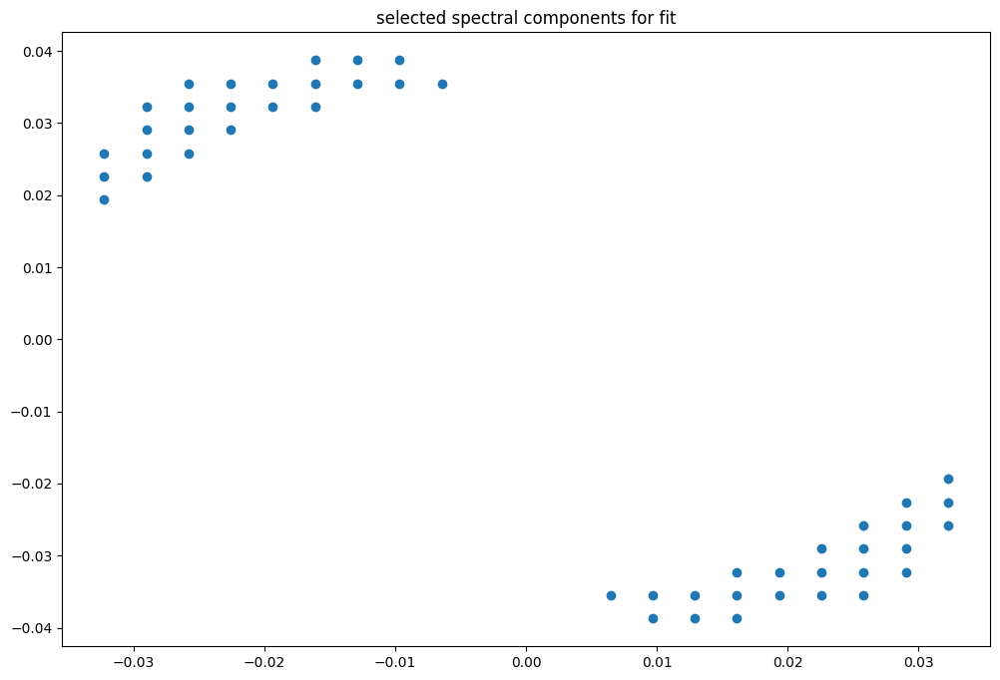

box [2000, 2500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

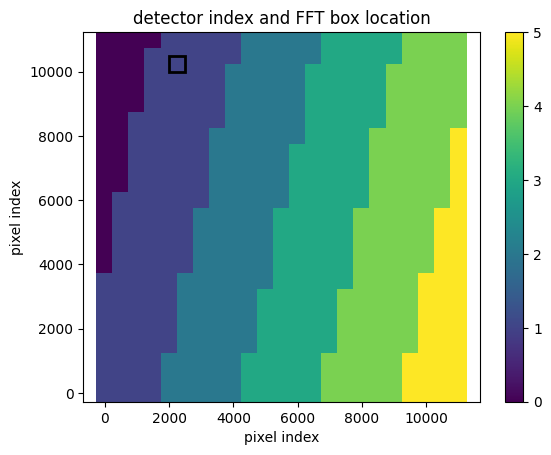

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(31, 31)
(31, 31)
(31, 31)


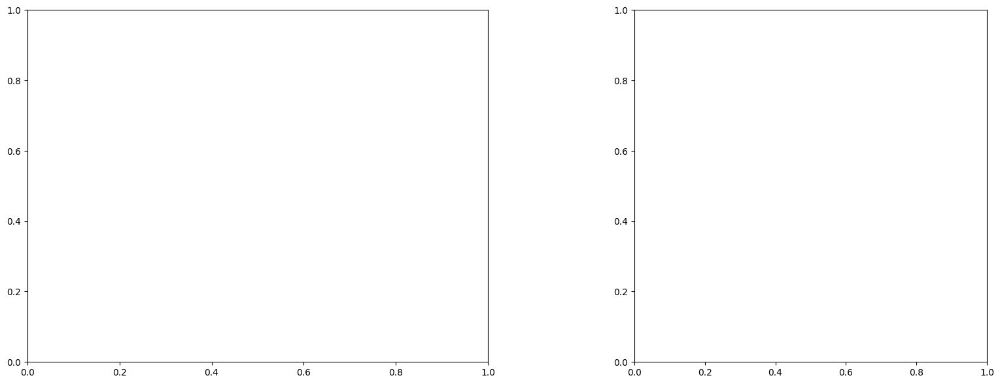

U and V components of current : [-0.1833703  -0.25221019]
uncertainties for U and V: 0.29778031104166114 0.1891494748201967


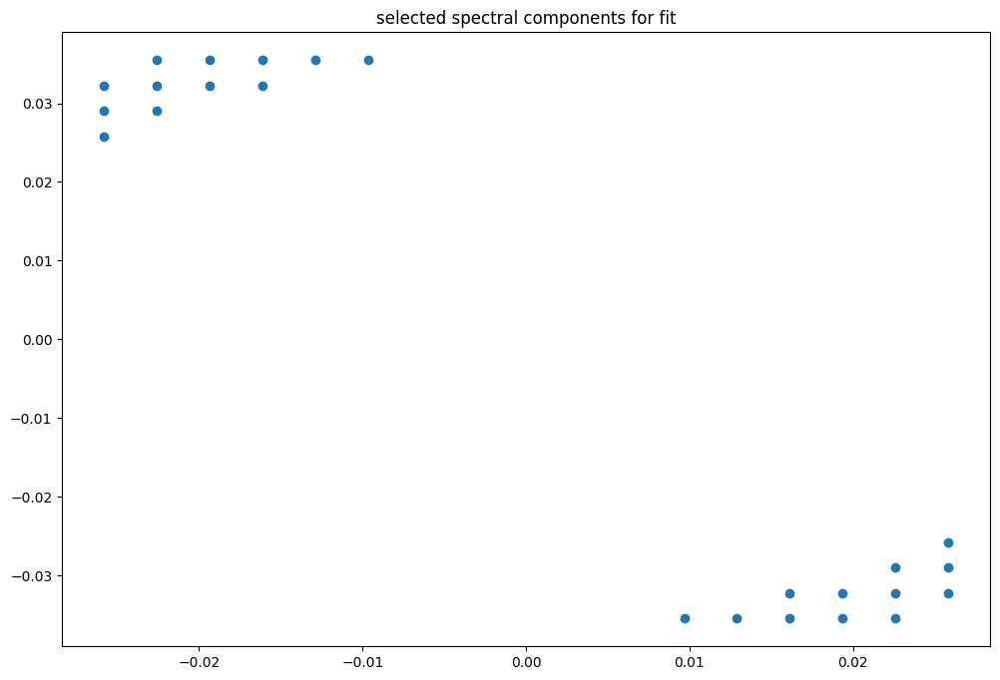

box [2000, 2500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

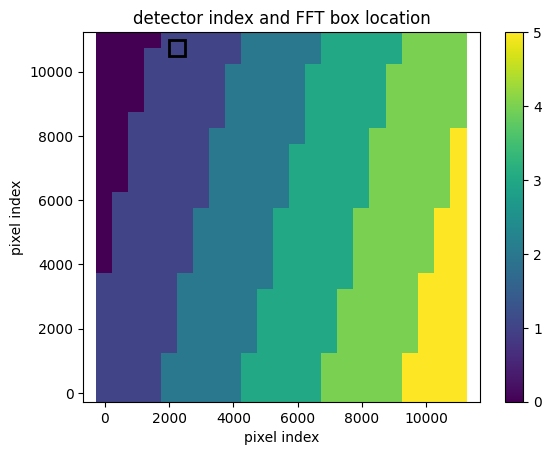

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 30)
(31, 30)
(31, 30)


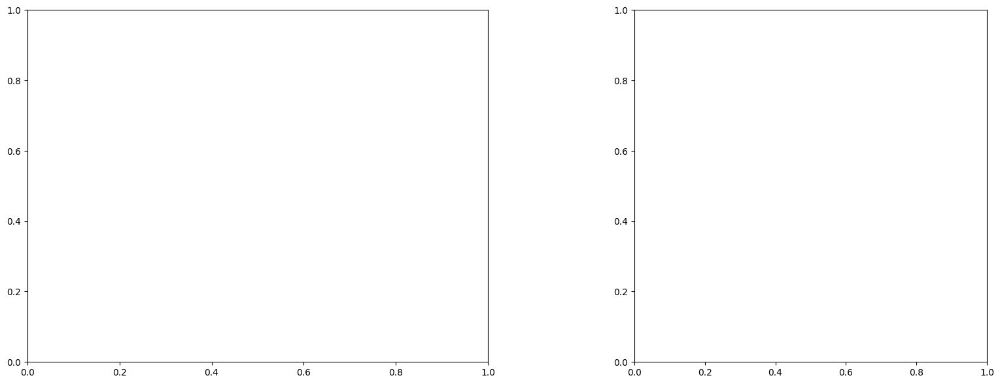

U and V components of current : [0.41476765 0.02249521]
uncertainties for U and V: 0.4522601679346944 0.296687402050963


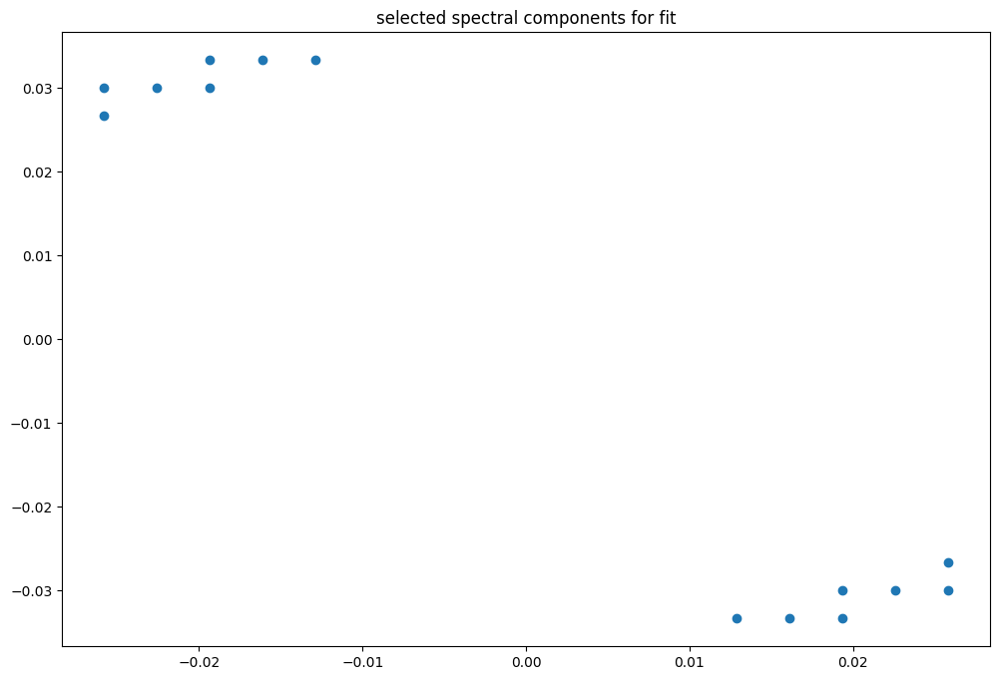

box [2500, 3000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

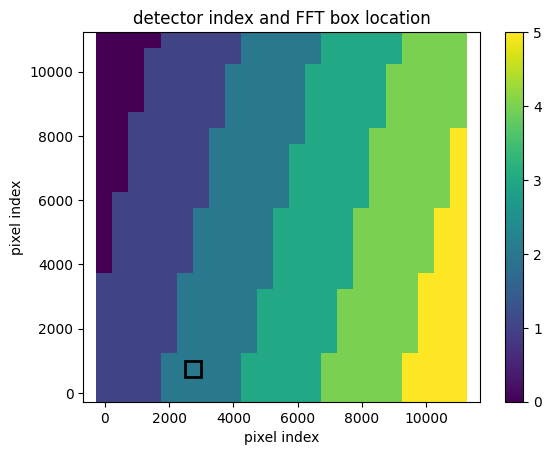

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


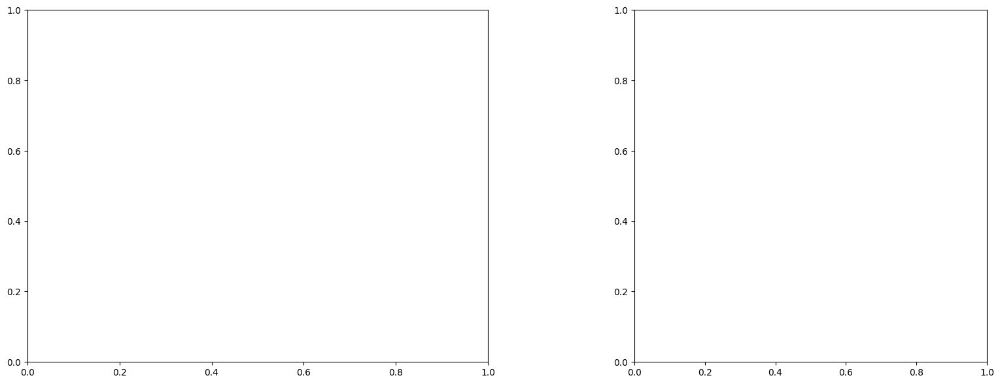

U and V components of current : [0.60859177 0.8351412 ]
uncertainties for U and V: 0.09589805906057433 0.08714388217276967


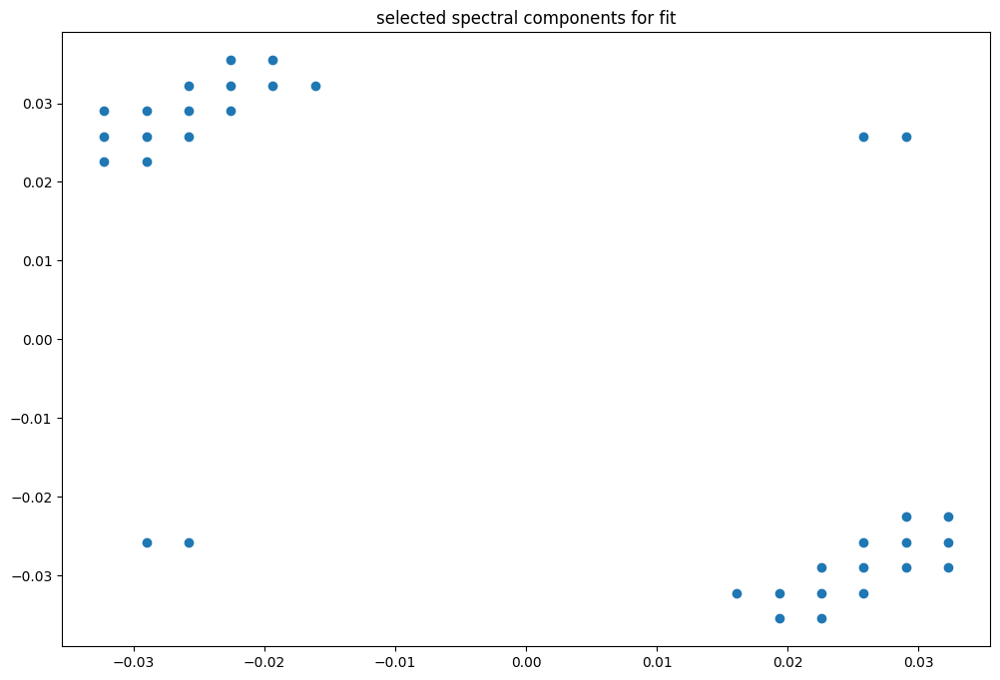

box [2500, 3000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

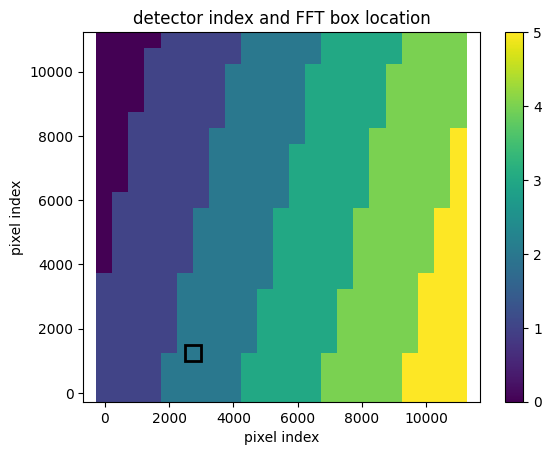

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


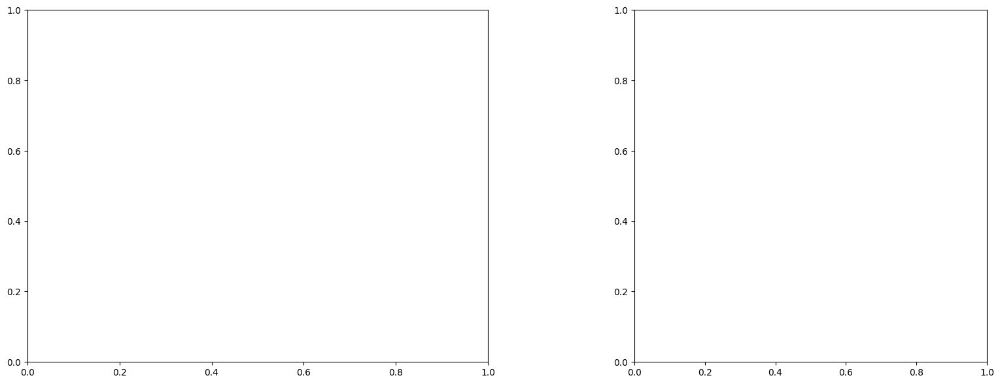

U and V components of current : [1.30229326 1.50675686]
uncertainties for U and V: 0.222025182148501 0.18490107416000792


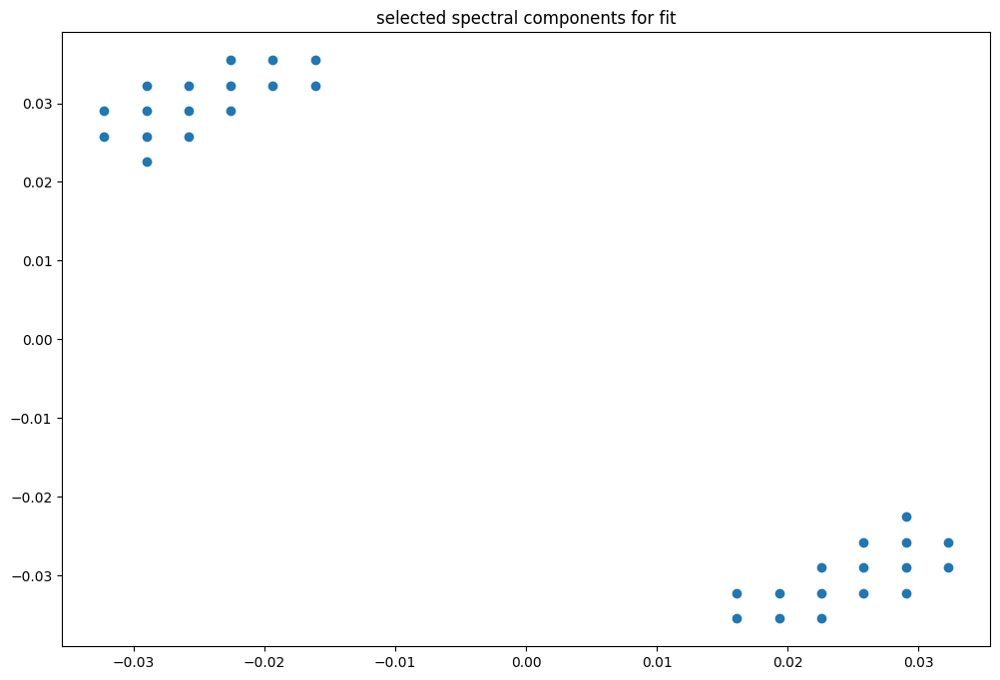

box [2500, 3000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

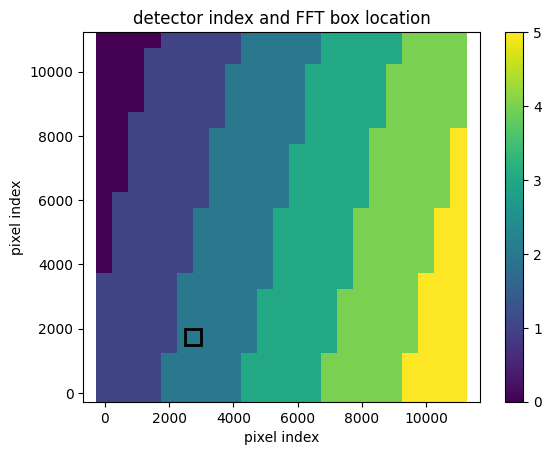

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


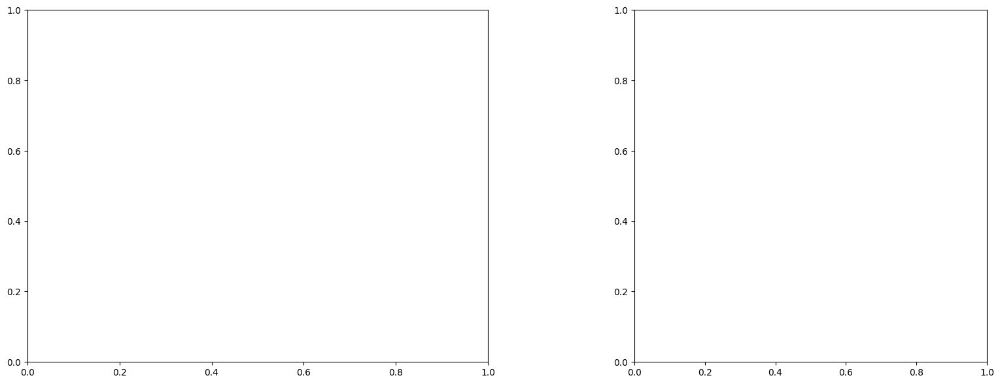

U and V components of current : [0.6931231  0.85344327]
uncertainties for U and V: 0.21619203926087652 0.18829979685560438


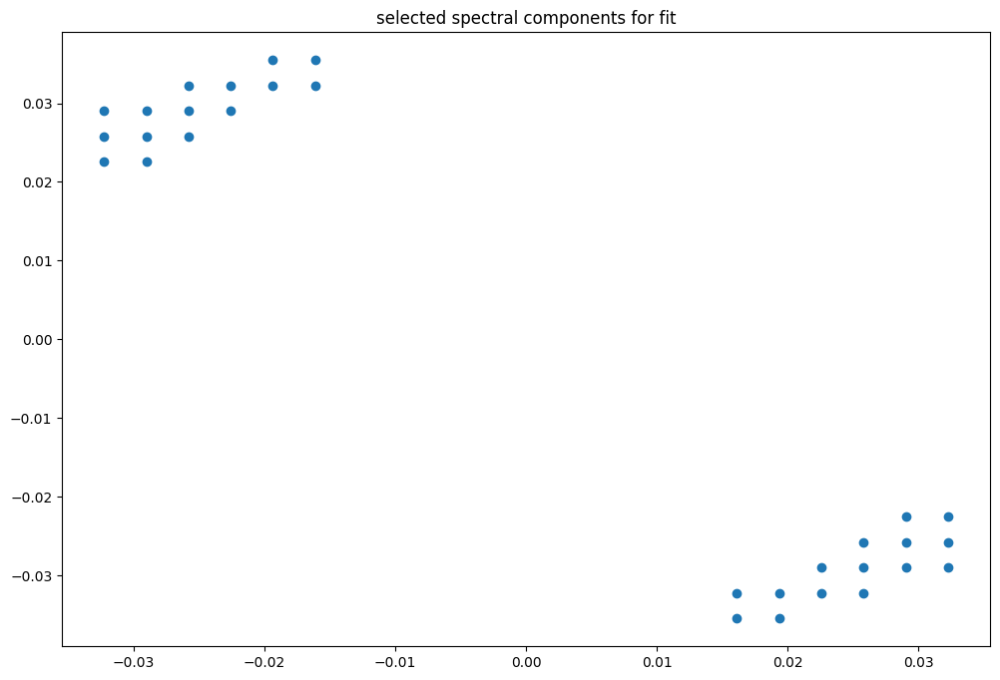

box [2500, 3000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

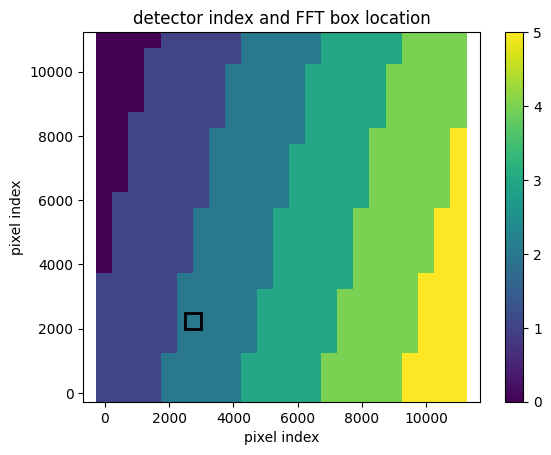

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


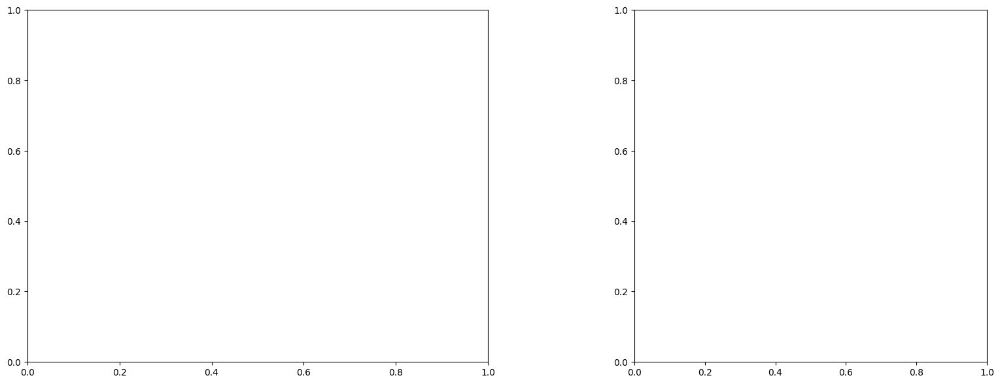

U and V components of current : [0.55172321 0.54127823]
uncertainties for U and V: 0.17001913507110059 0.14482613993122334


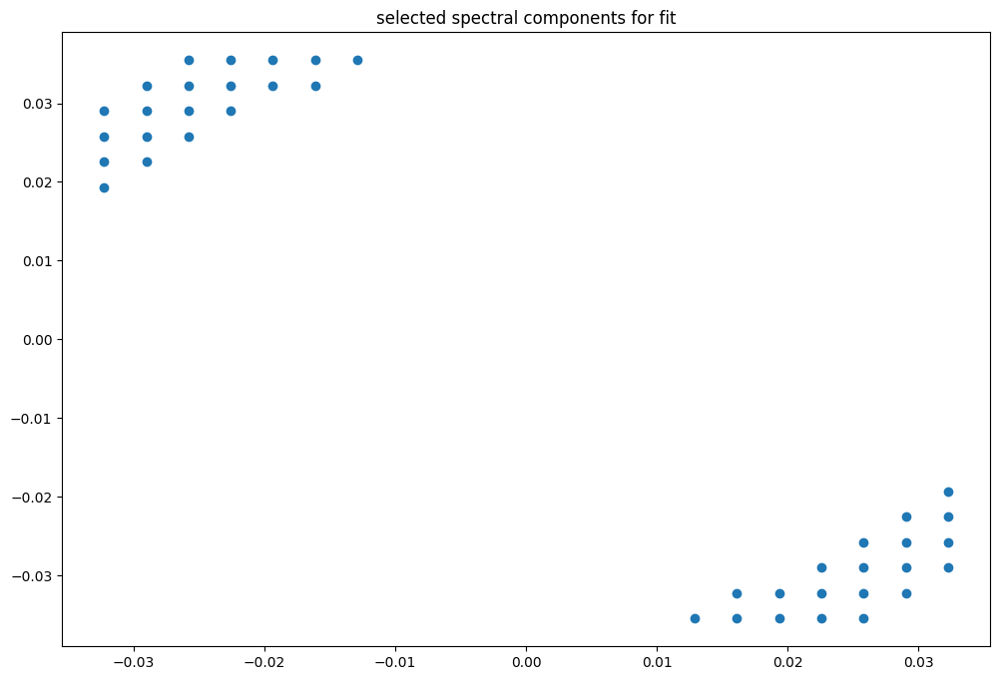

box [2500, 3000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

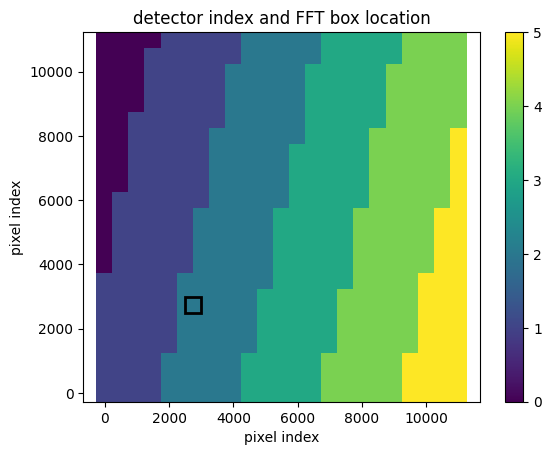

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


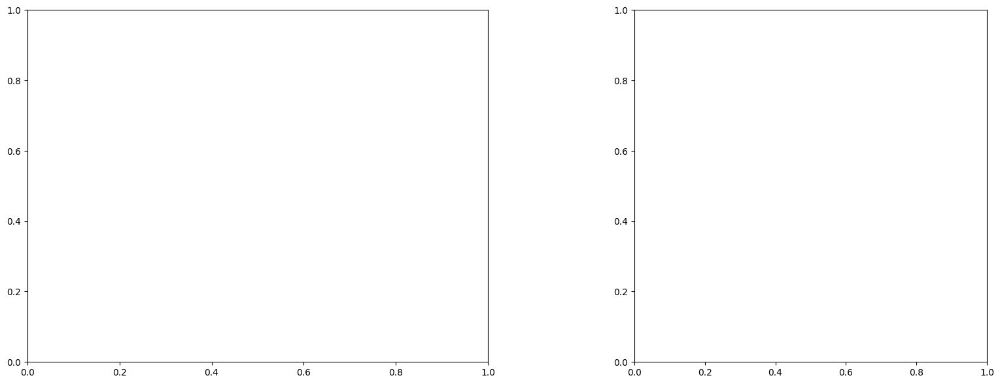

U and V components of current : [1.03725629 0.82300934]
uncertainties for U and V: 0.2043915279851916 0.18036903390333817


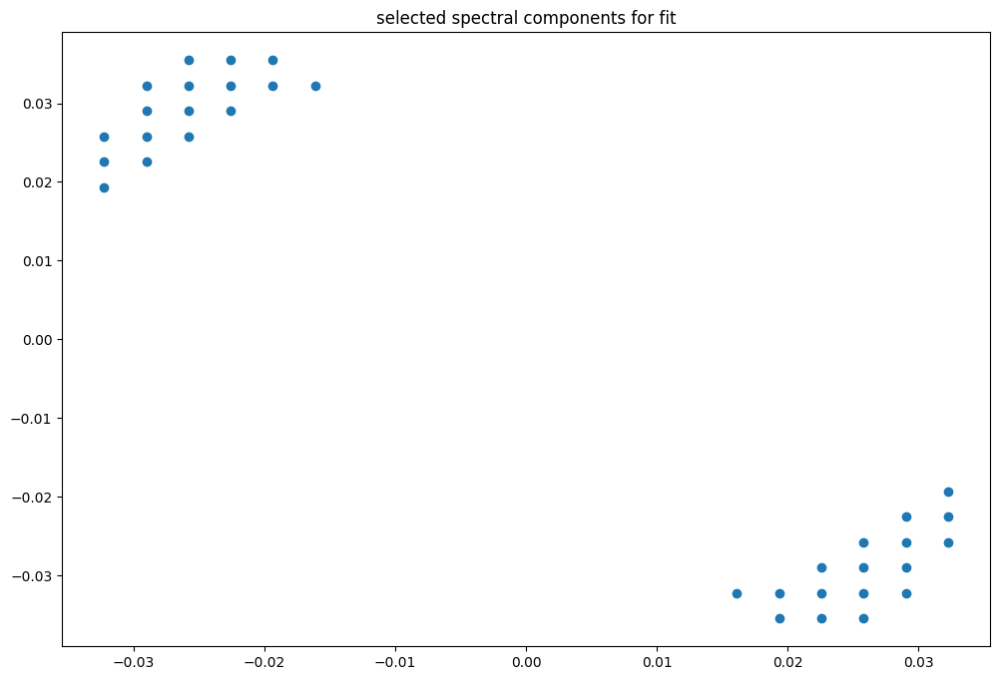

box [2500, 3000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

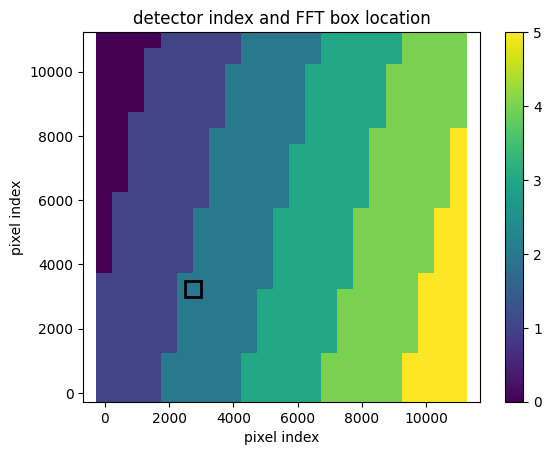

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


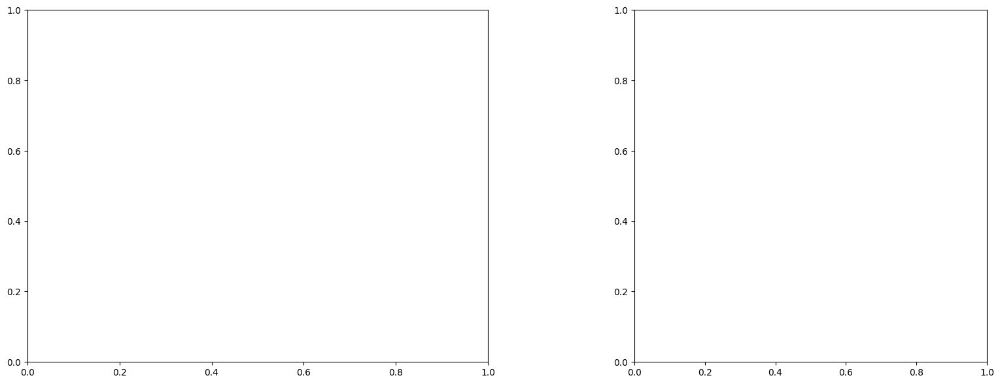

U and V components of current : [0.22371658 0.16050644]
uncertainties for U and V: 0.4047415082661572 0.37307507748435015


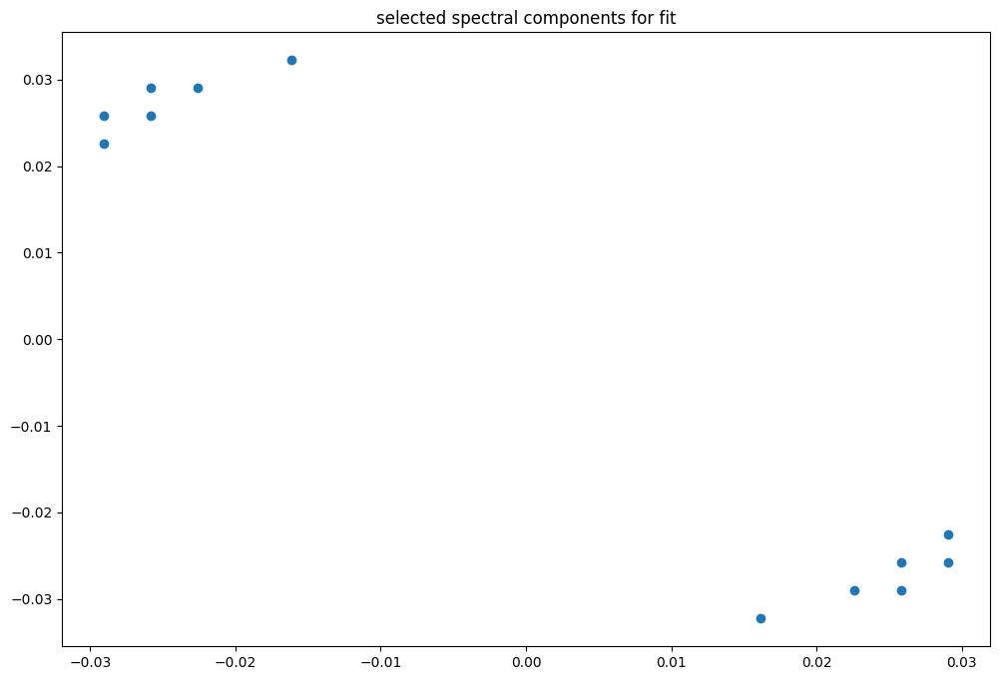

box [2500, 3000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

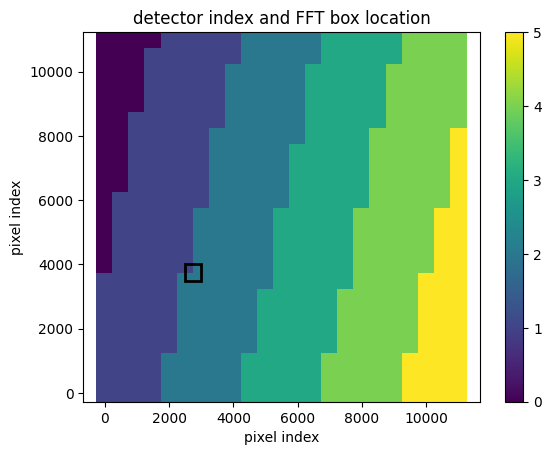

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


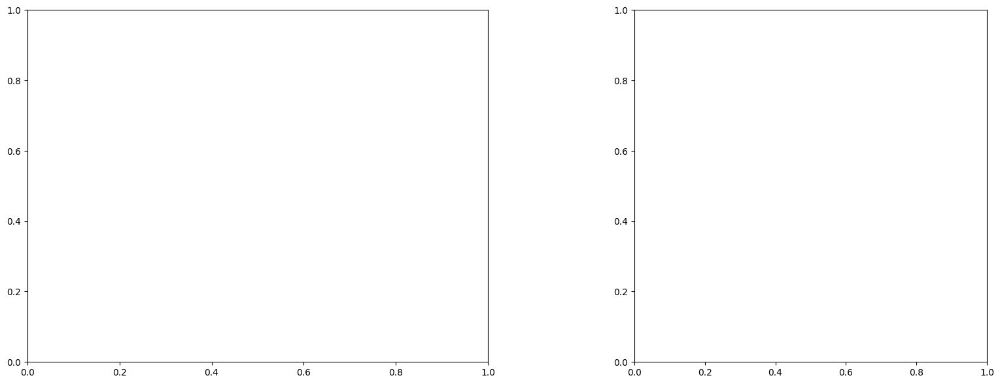

LinAlgError: Singular matrix

box [2500, 3000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

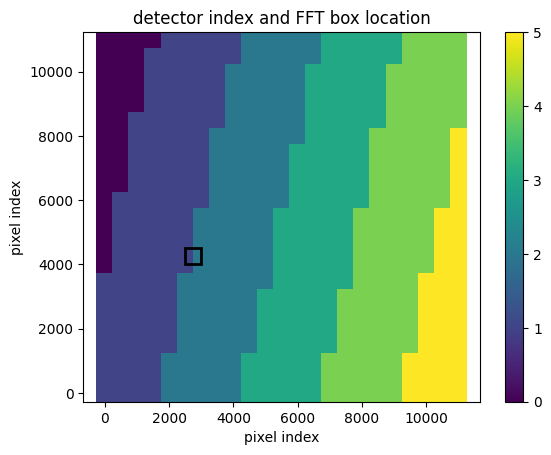

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


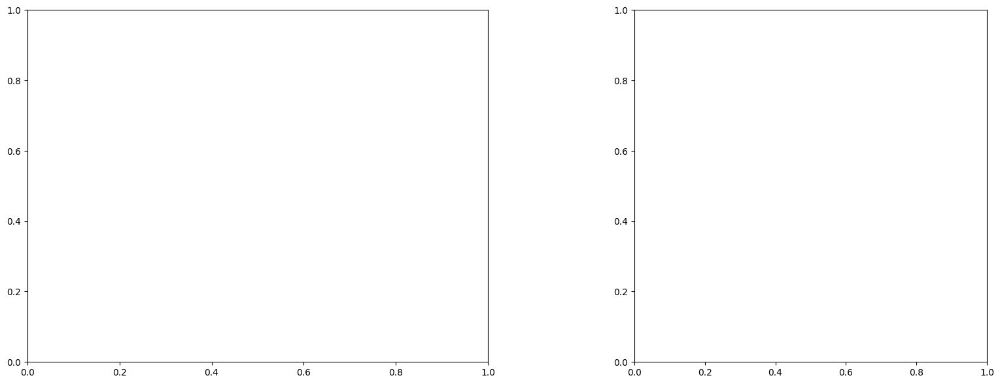

LinAlgError: Singular matrix

box [2500, 3000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

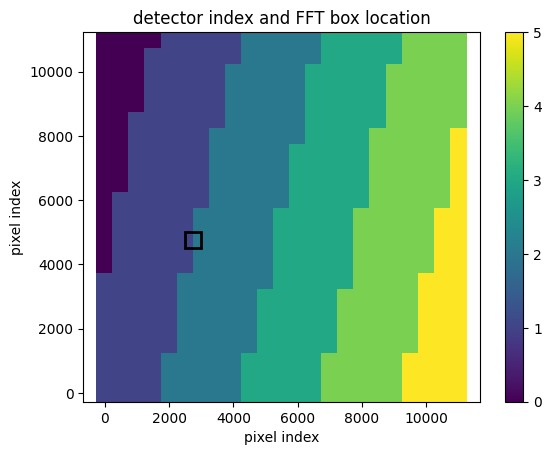

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


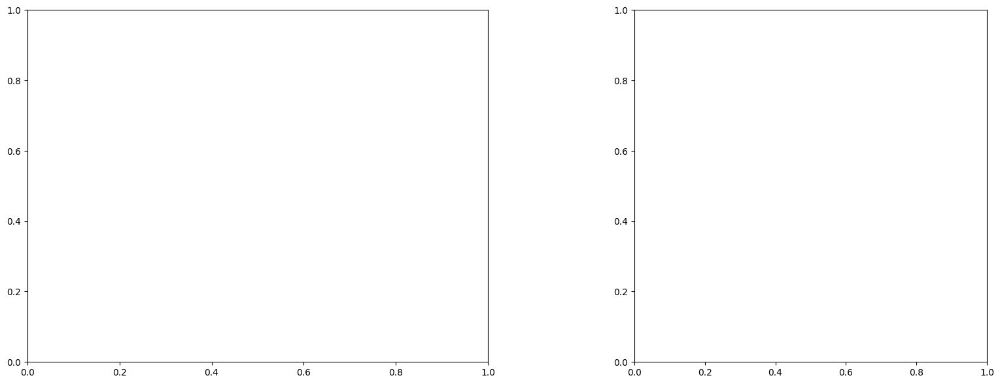

LinAlgError: Singular matrix

box [2500, 3000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

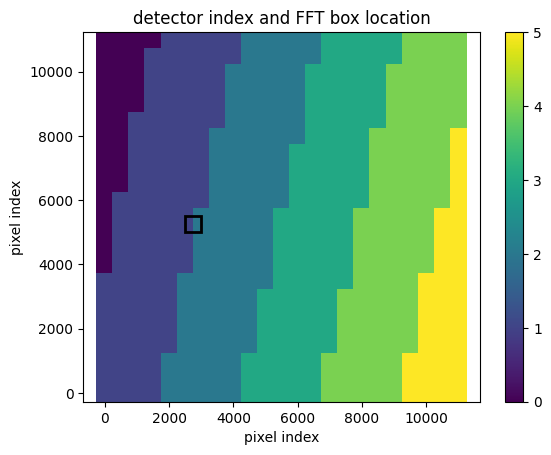

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


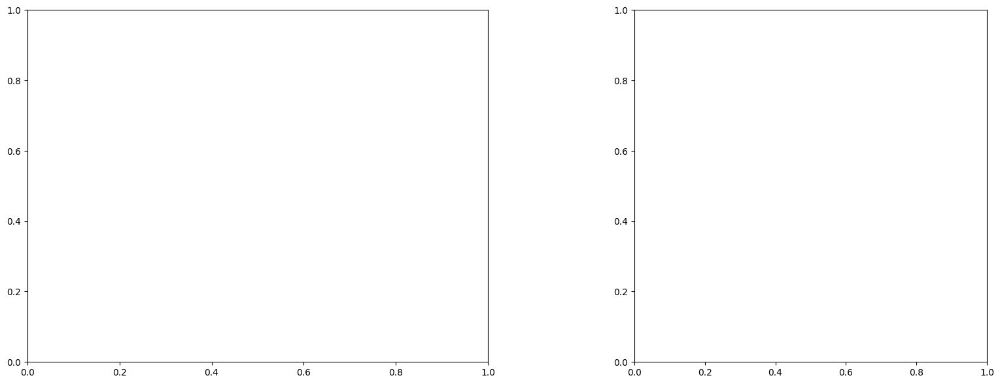

LinAlgError: Singular matrix

box [2500, 3000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

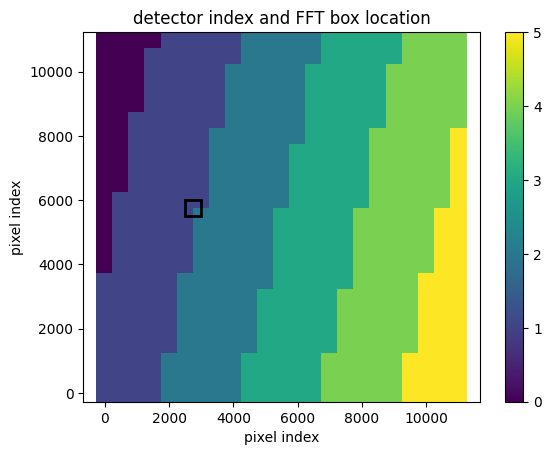

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076202347460554
(31, 31)
(31, 31)
(31, 31)


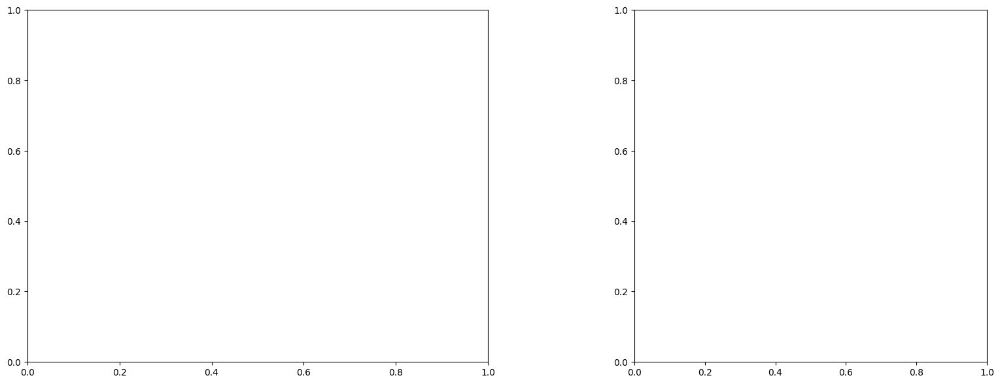

U and V components of current : [-1.20376193 -3.8250961 ]
uncertainties for U and V: 1.583449317142453 1.3156253510534446


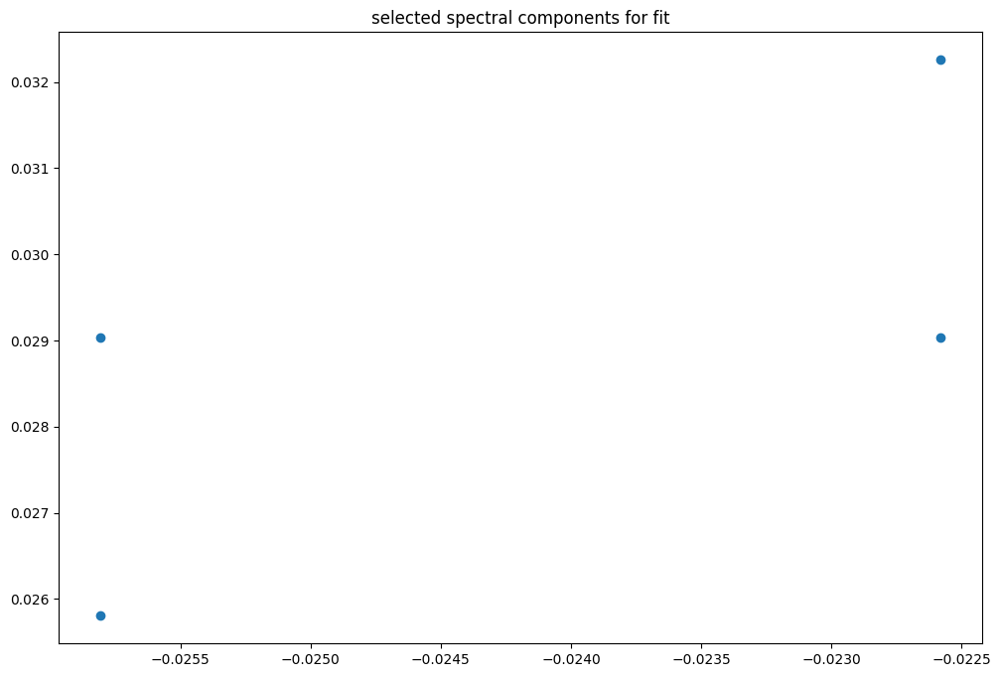

box [2500, 3000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

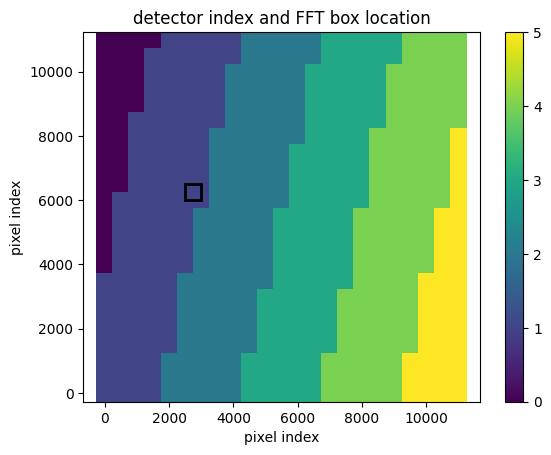

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


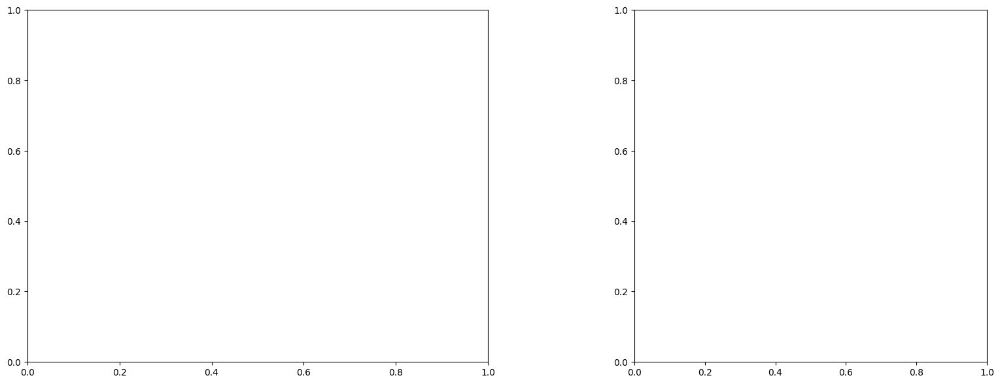

LinAlgError: Singular matrix

box [2500, 3000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

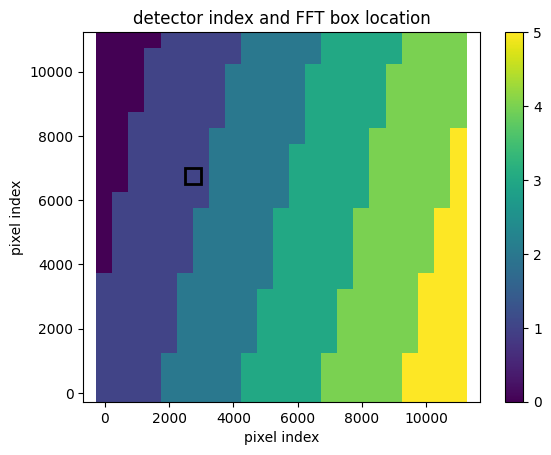

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007616794634108
(31, 31)
(31, 31)
(31, 31)


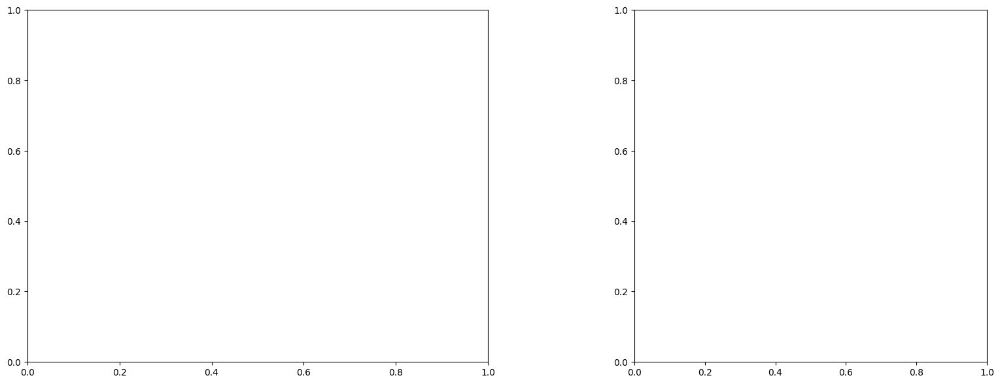

LinAlgError: Singular matrix

box [2500, 3000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

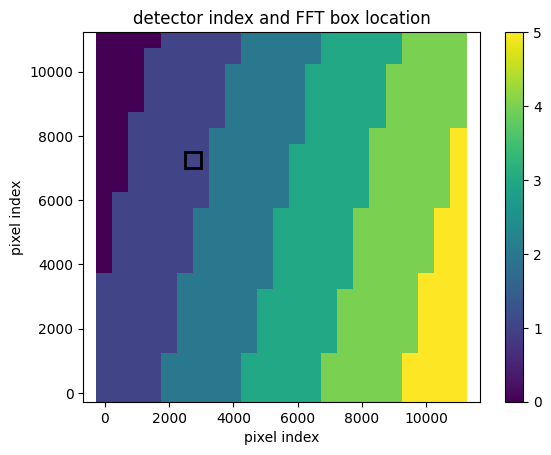

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076138799349308
(31, 31)
(31, 31)
(31, 31)


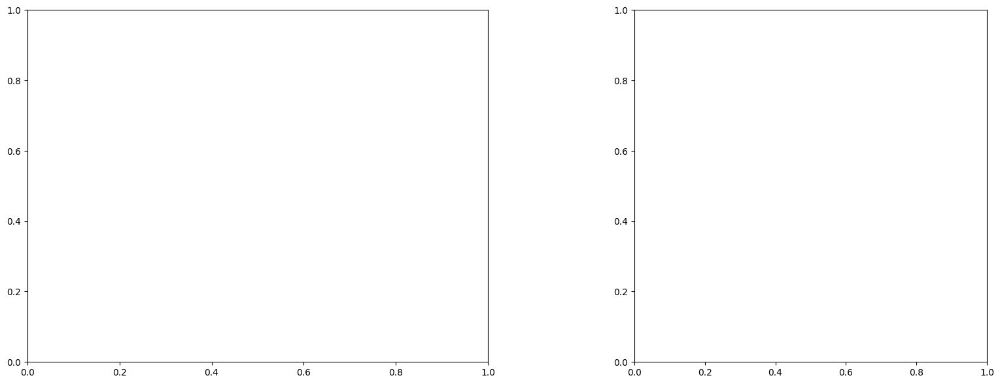

LinAlgError: Singular matrix

box [2500, 3000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

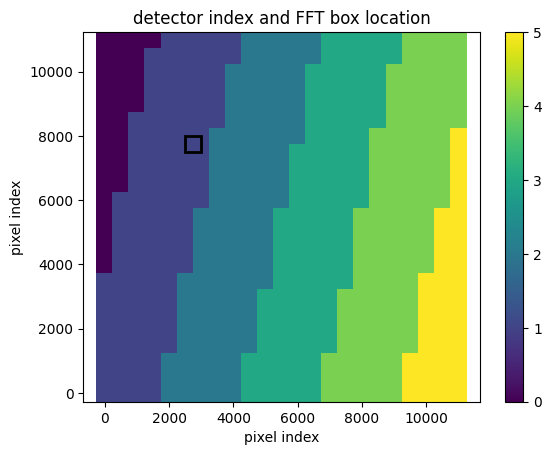

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076106461680039
(31, 31)
(31, 31)
(31, 31)


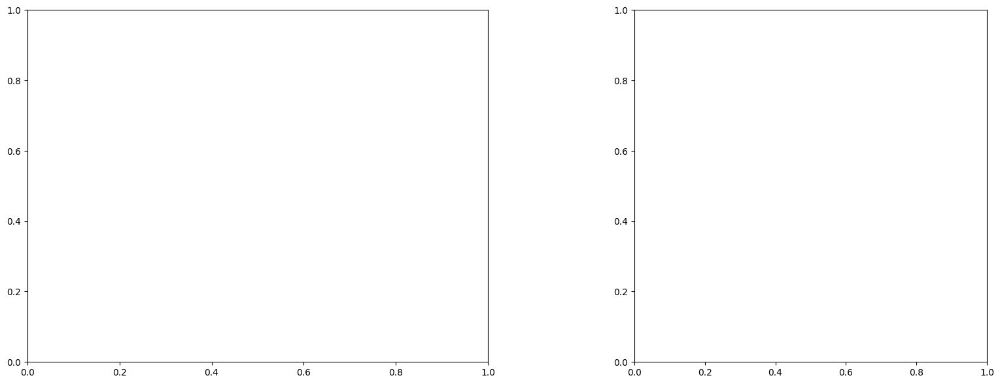

LinAlgError: Singular matrix

box [2500, 3000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

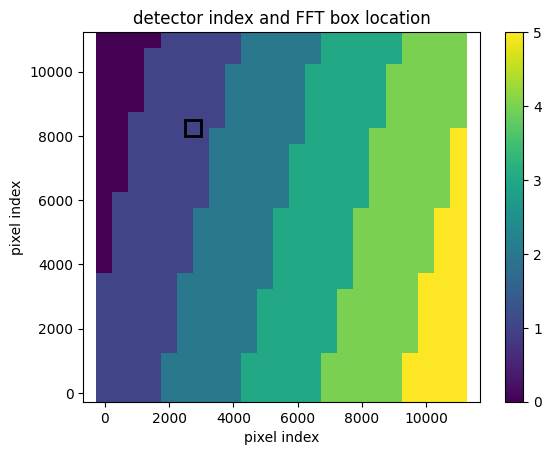

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


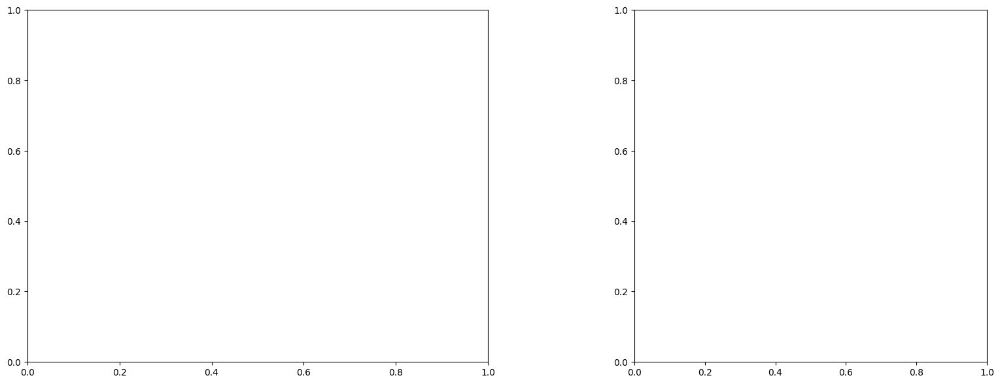

U and V components of current : [-0.15753877 -0.3000146 ]
uncertainties for U and V: 0.1053945825832524 0.0873550678489443


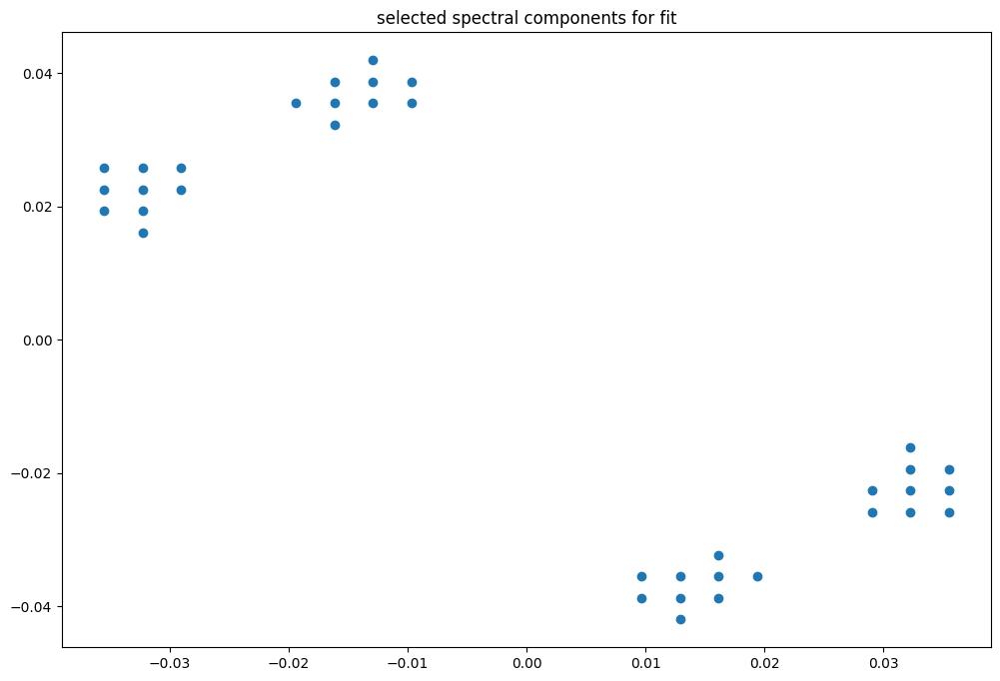

box [2500, 3000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

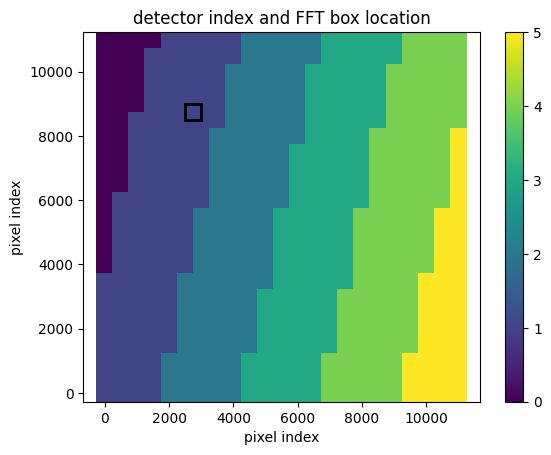

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


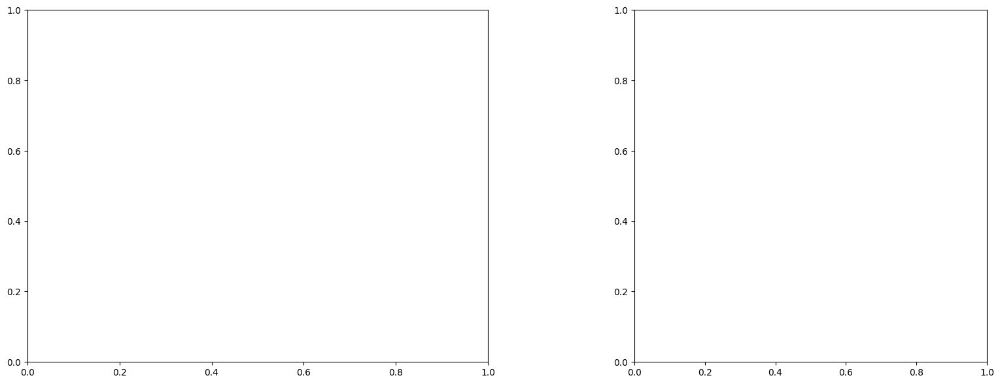

U and V components of current : [ 0.15606062 -0.19944557]
uncertainties for U and V: 0.1264876628268341 0.08795443516851853


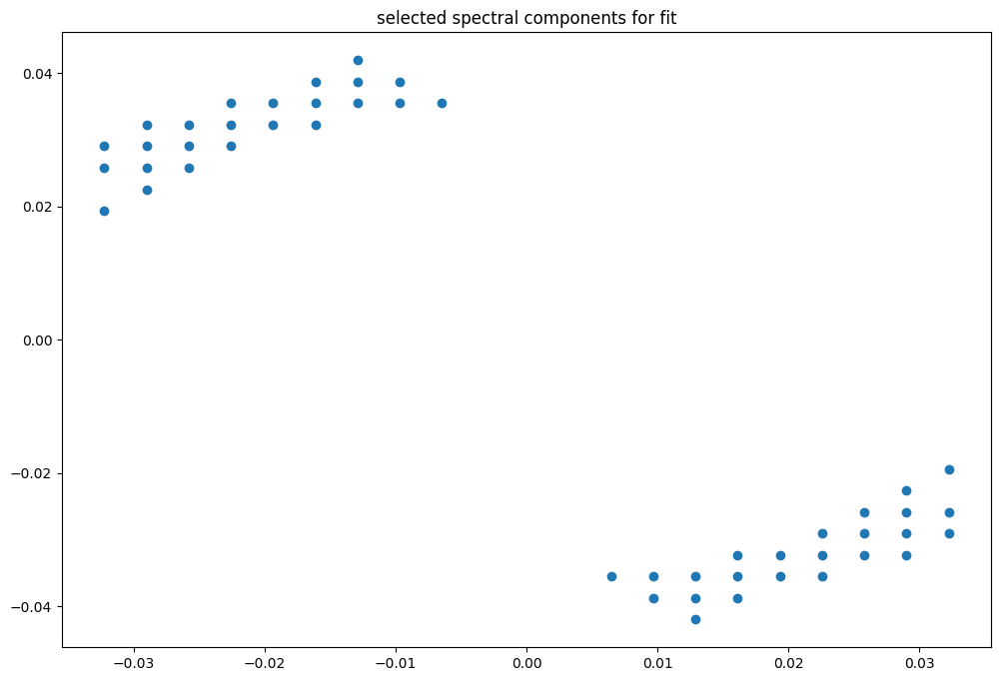

box [2500, 3000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

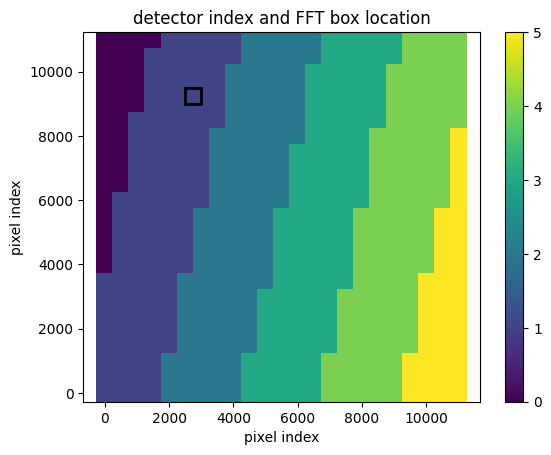

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076048561584954
(31, 31)
(31, 31)
(31, 31)


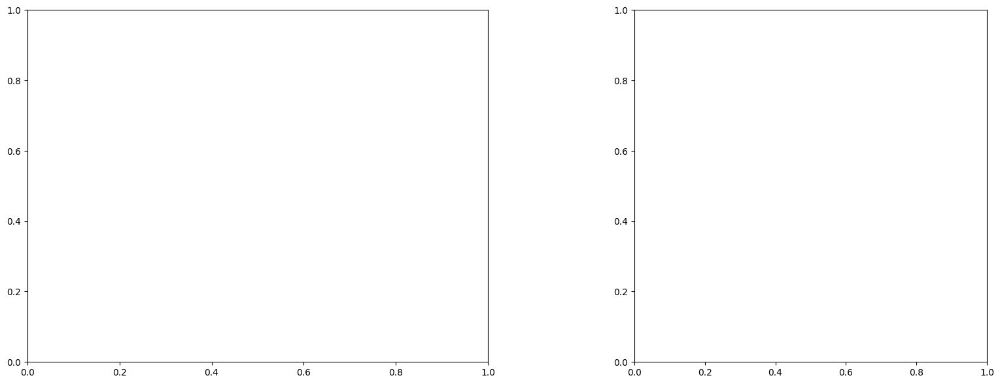

U and V components of current : [ 0.08808397 -0.07224102]
uncertainties for U and V: 0.13218542728712893 0.10838372704795352


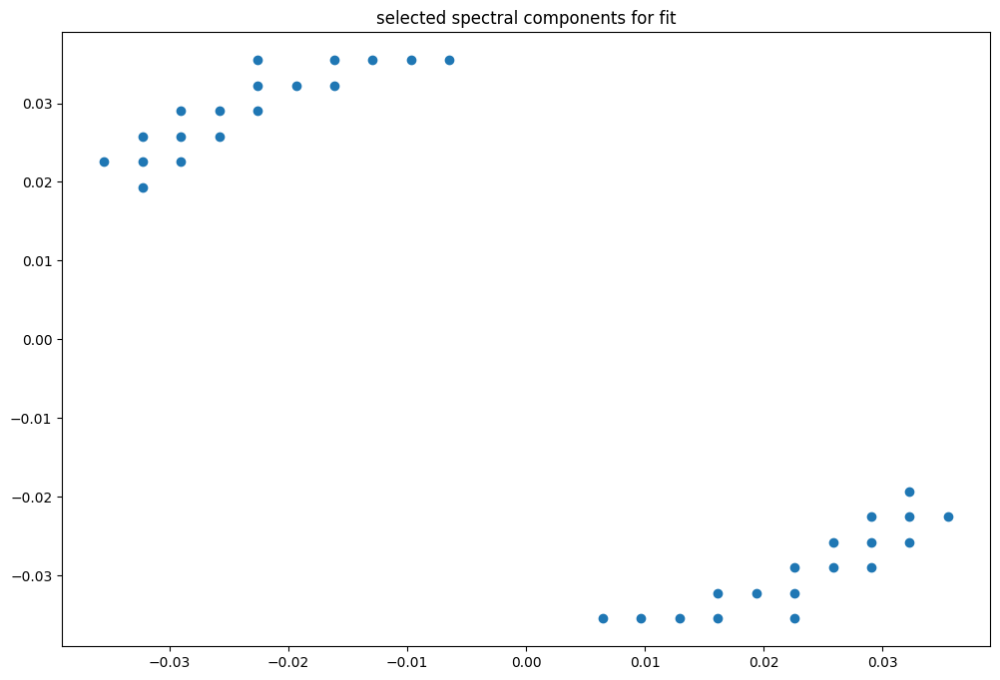

box [2500, 3000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

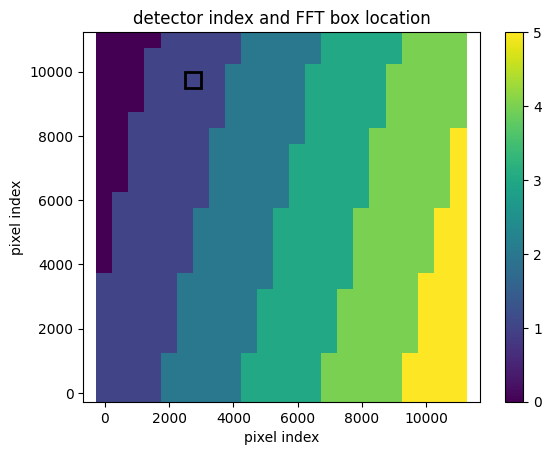

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(31, 31)
(31, 31)
(31, 31)


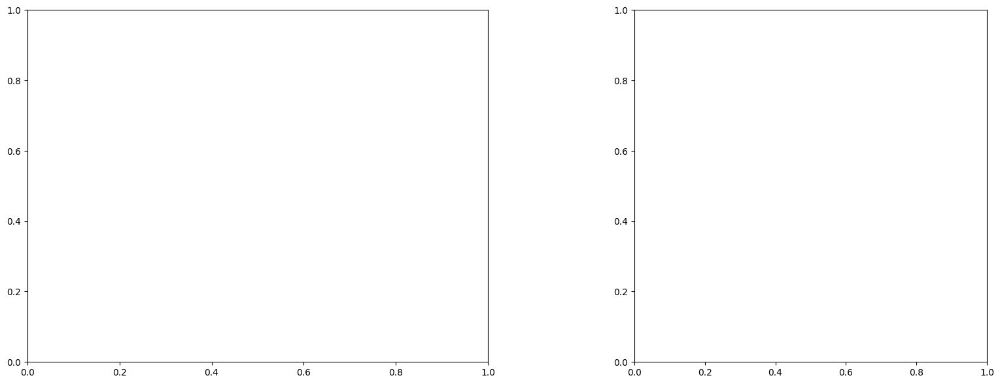

U and V components of current : [ 0.07240285 -0.21993302]
uncertainties for U and V: 0.2365423674533329 0.1929201857955157


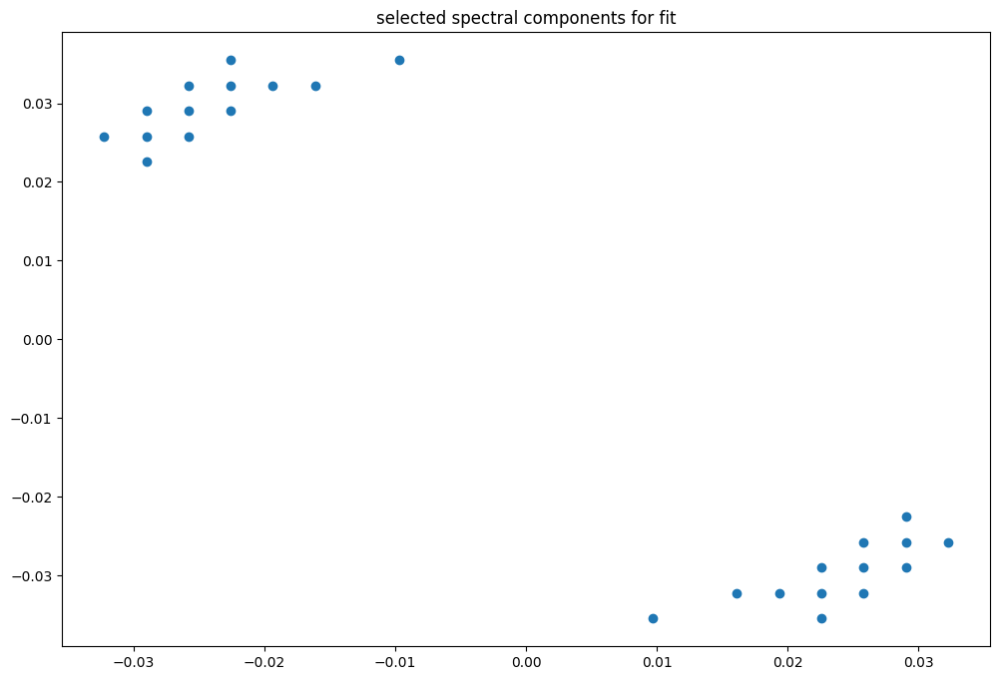

box [2500, 3000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

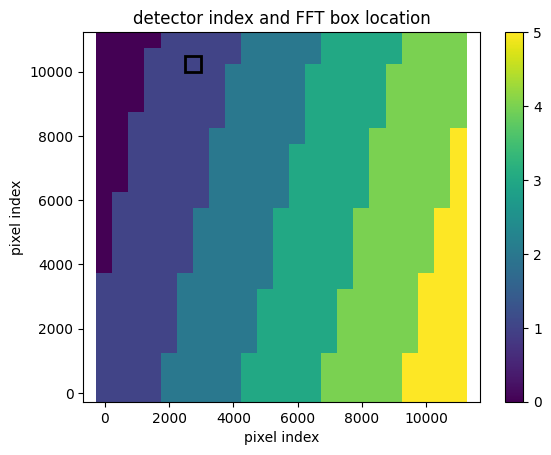

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 31)
(31, 31)
(31, 31)


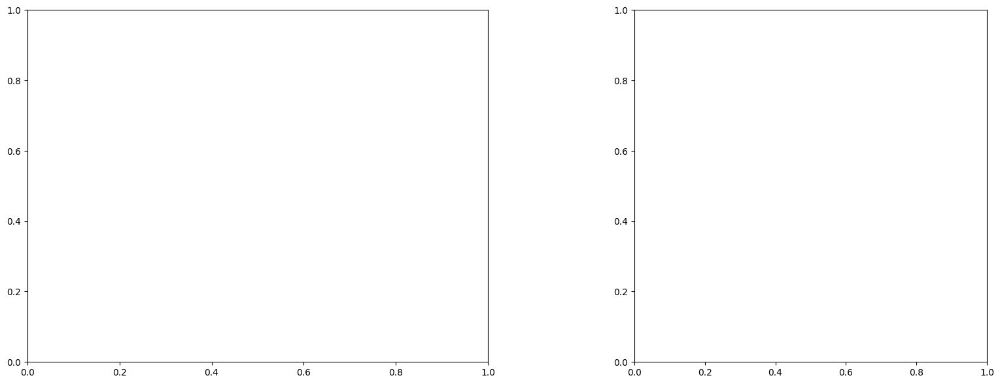

U and V components of current : [-0.45941087 -0.59064093]
uncertainties for U and V: 0.5560640258799828 0.41218980243540343


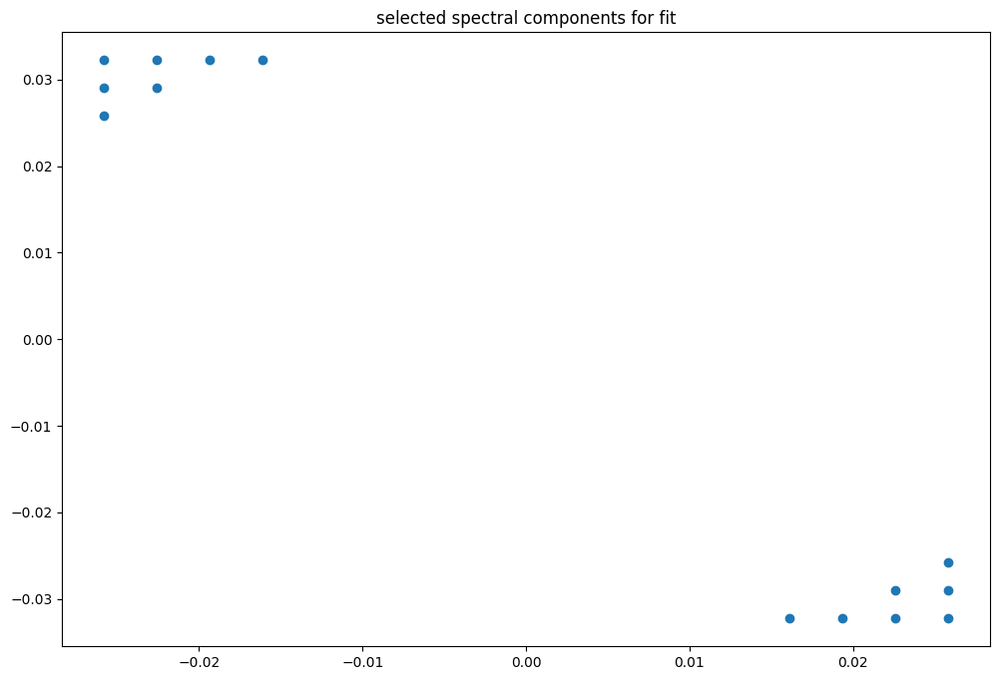

box [2500, 3000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

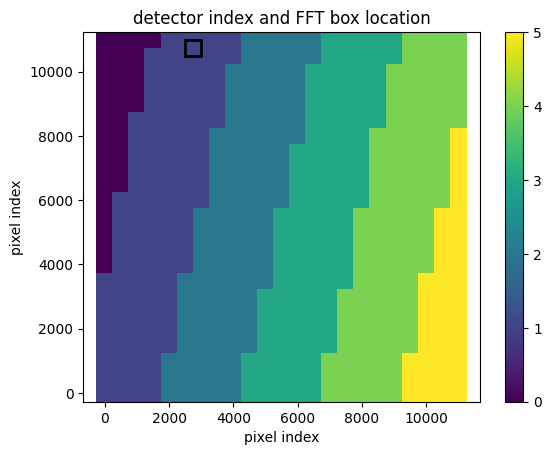

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 30)
(31, 30)
(31, 30)


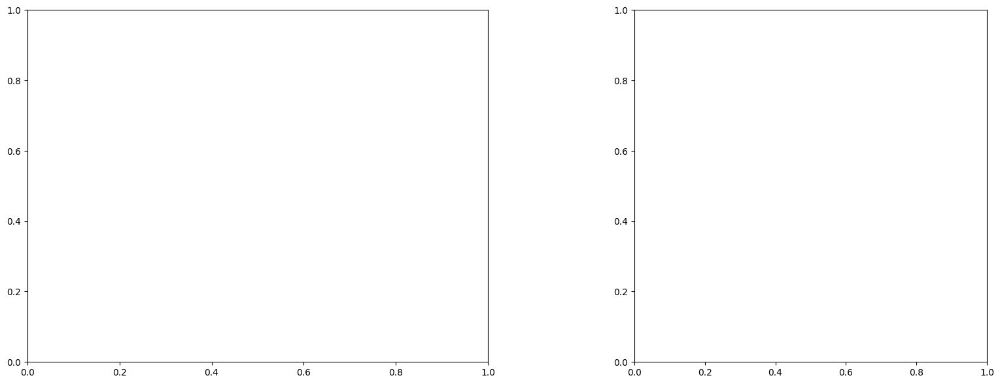

U and V components of current : [-0.13726545 -0.68731356]
uncertainties for U and V: 0.18882894234810782 0.1709720774081954


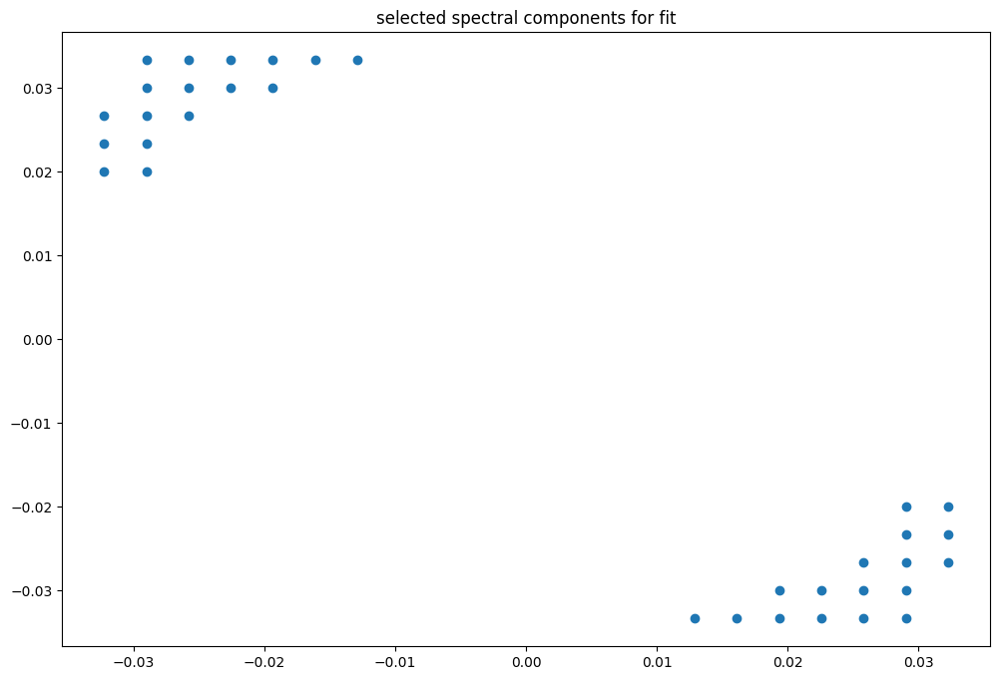

box [3000, 3500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

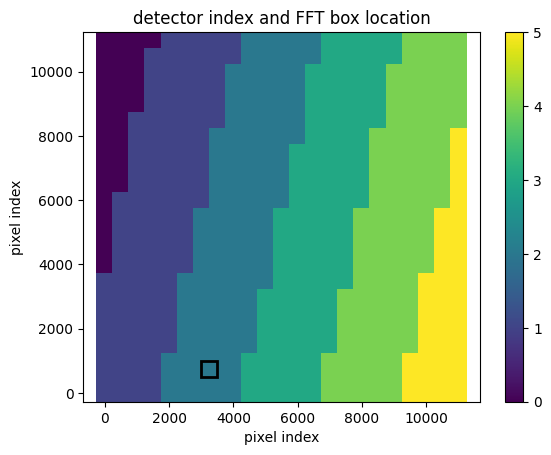

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


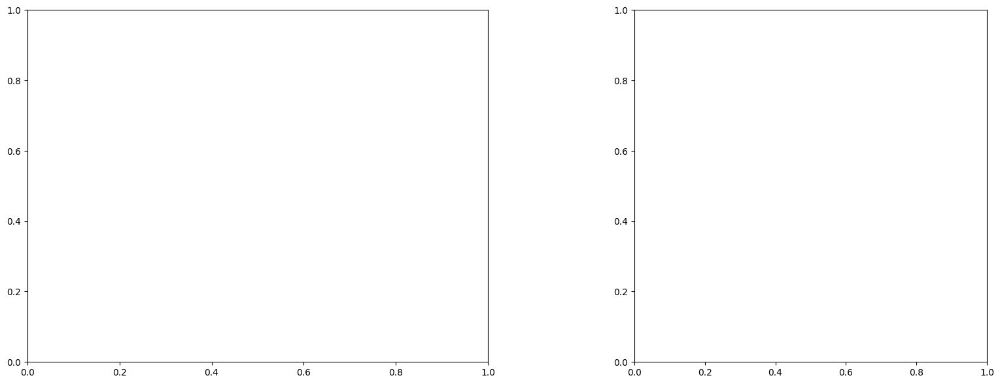

U and V components of current : [0.57296595 0.96162928]
uncertainties for U and V: 0.0570773907174822 0.05417232982773265


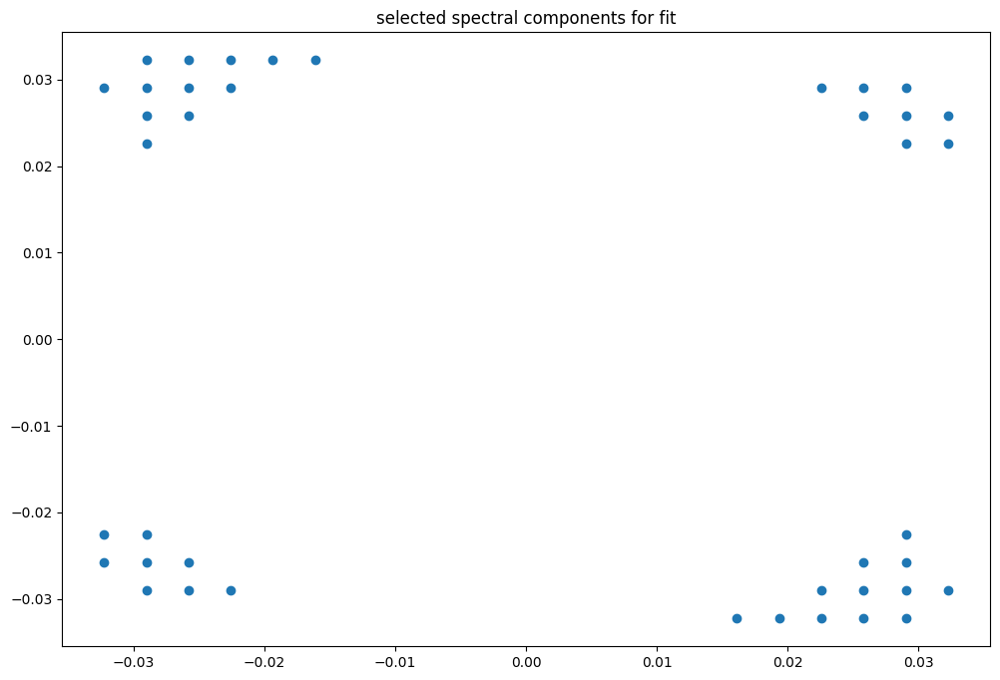

box [3000, 3500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

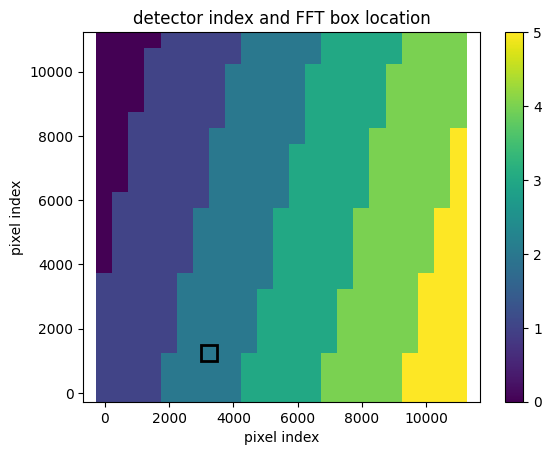

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


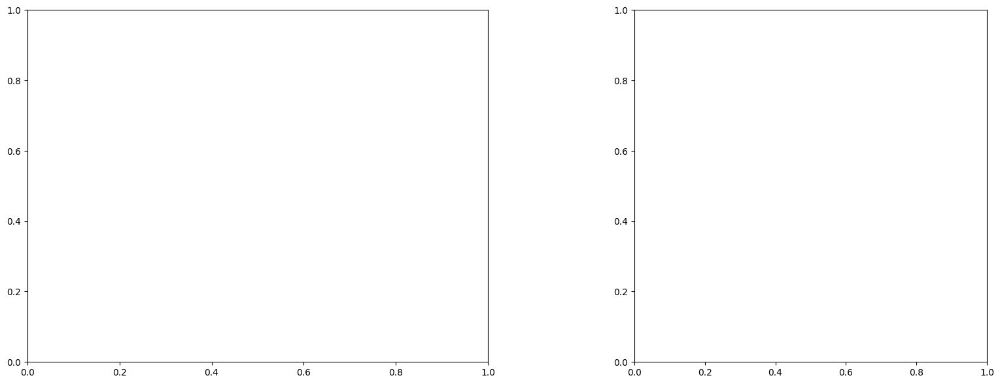

U and V components of current : [0.71331248 0.93510758]
uncertainties for U and V: 0.10135960611458768 0.08593548731371824


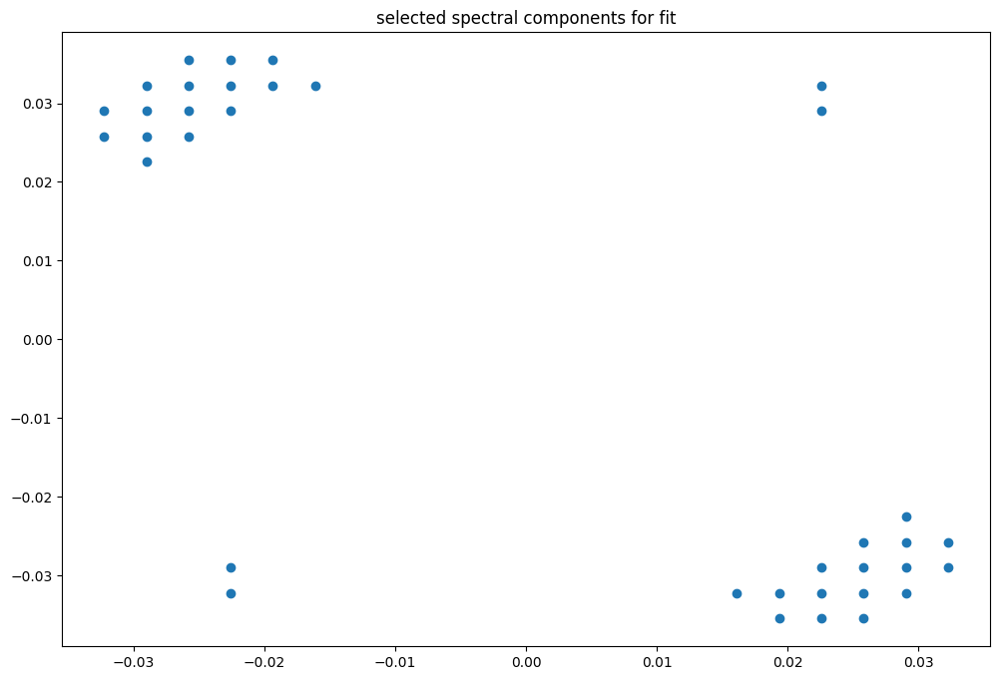

box [3000, 3500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

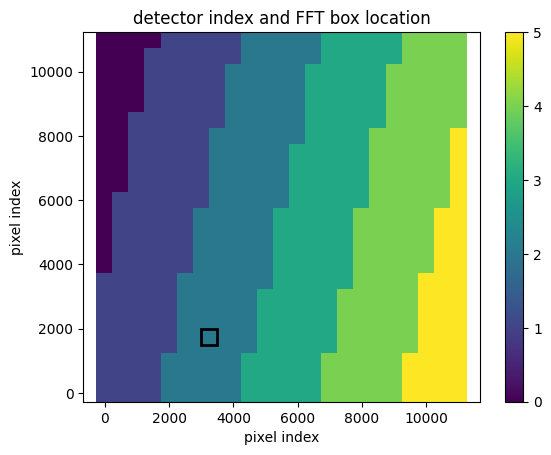

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


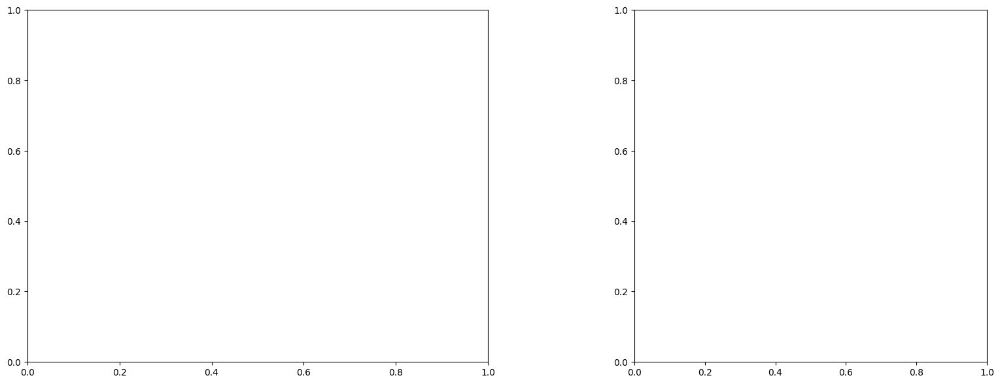

U and V components of current : [0.69061757 0.74296703]
uncertainties for U and V: 0.08428131187669466 0.0718480699306648


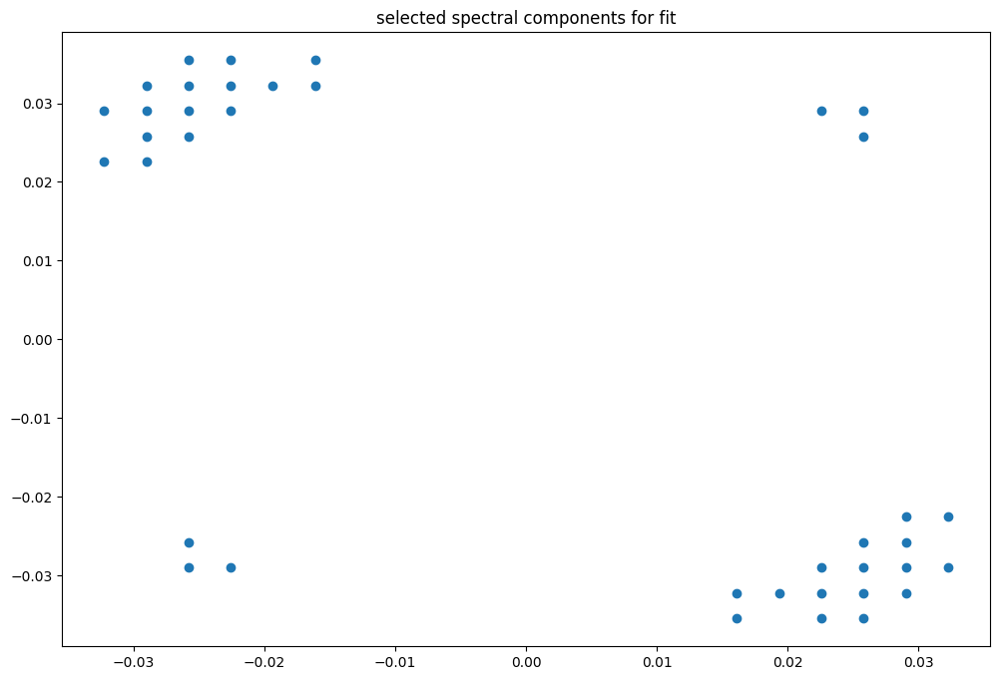

box [3000, 3500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

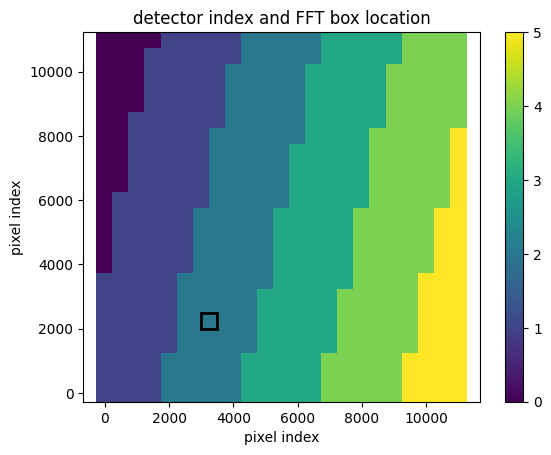

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


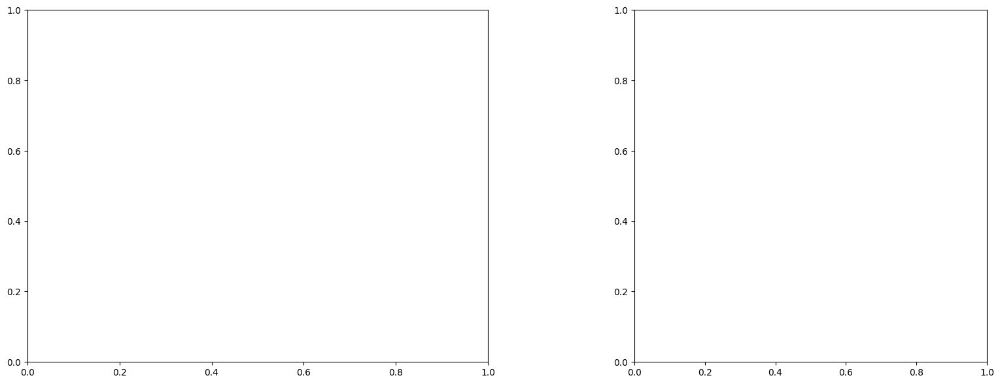

U and V components of current : [0.92474931 1.05007808]
uncertainties for U and V: 0.19819657299574844 0.17841830567234893


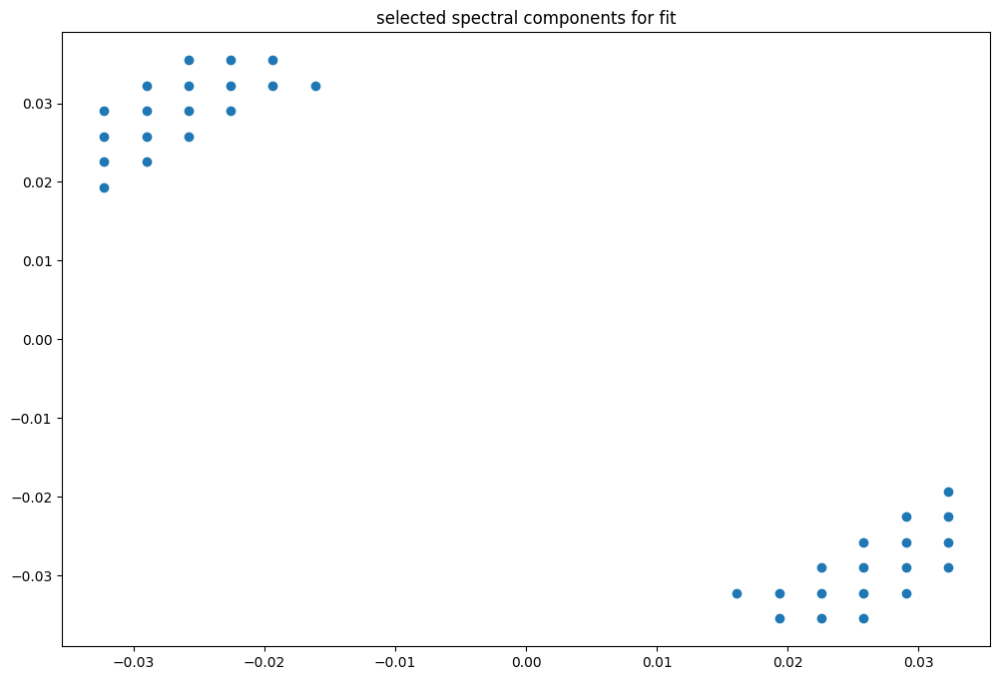

box [3000, 3500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

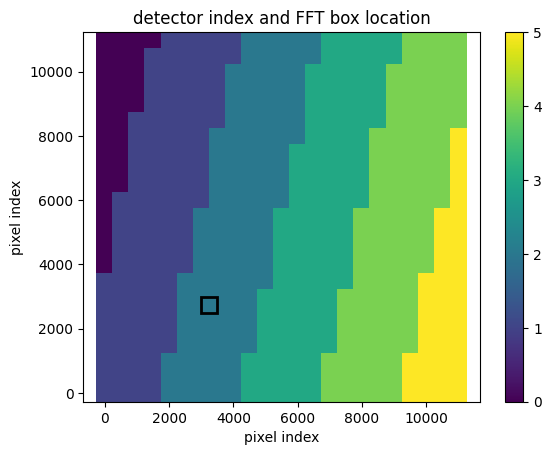

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


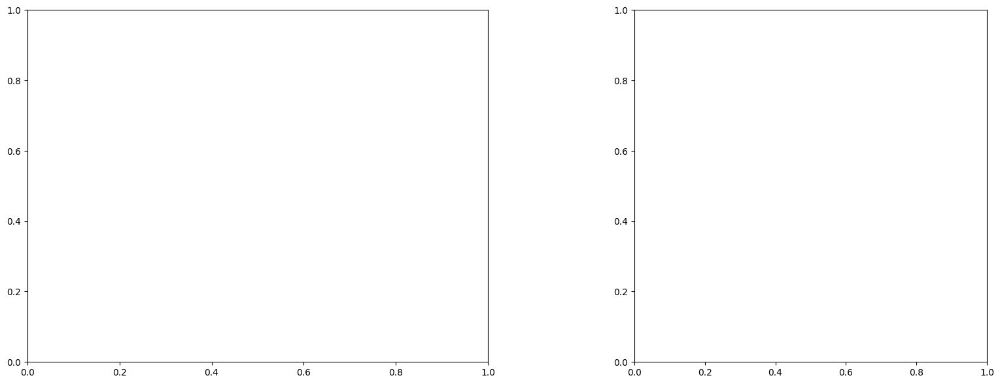

U and V components of current : [0.58620243 0.51883873]
uncertainties for U and V: 0.24108146287098803 0.20910457038398805


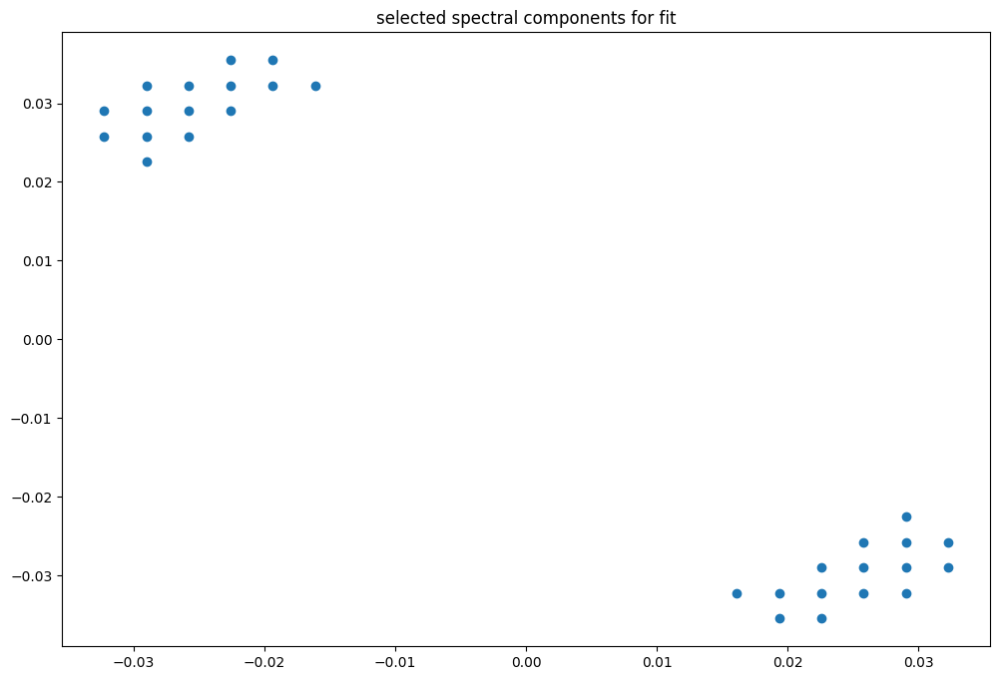

box [3000, 3500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

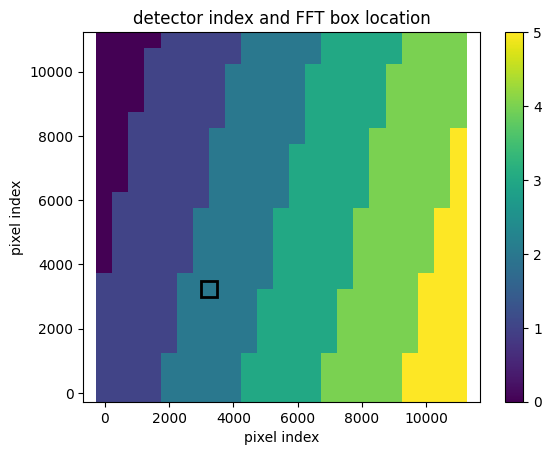

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


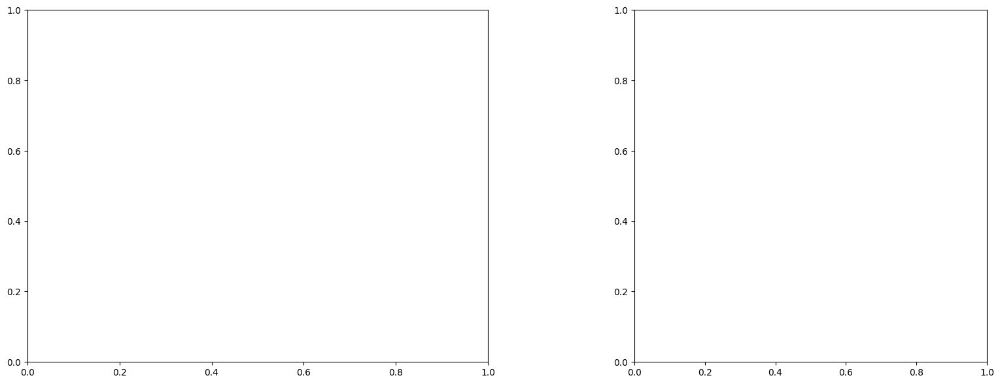

U and V components of current : [0.49562262 0.38736553]
uncertainties for U and V: 0.18073905441983137 0.1642876584826066


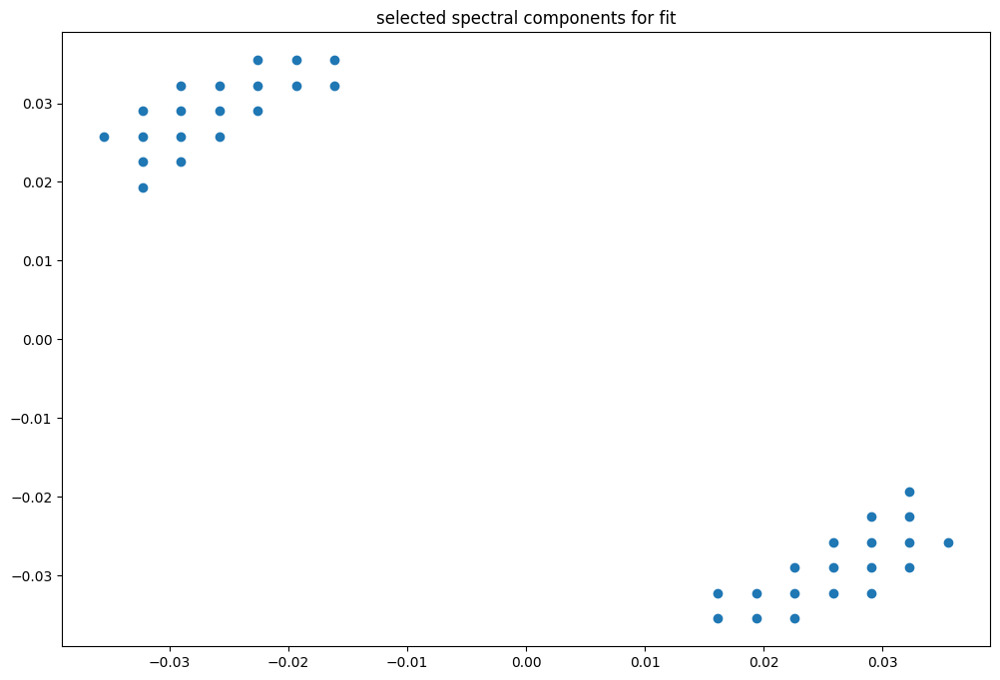

box [3000, 3500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

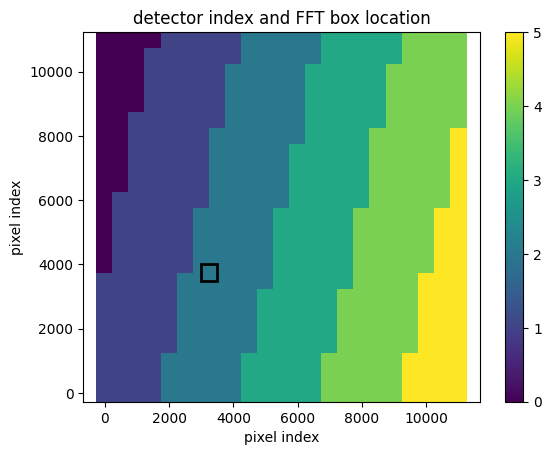

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


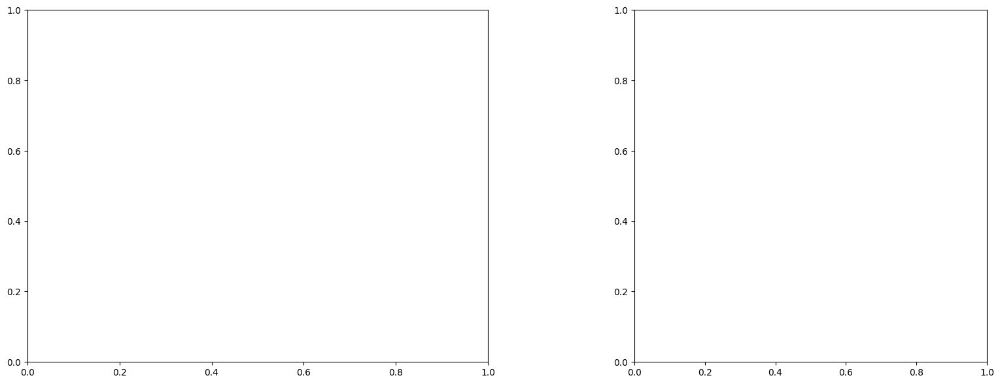

U and V components of current : [0.50856463 0.34218441]
uncertainties for U and V: 0.25835806874406786 0.2430375366677285


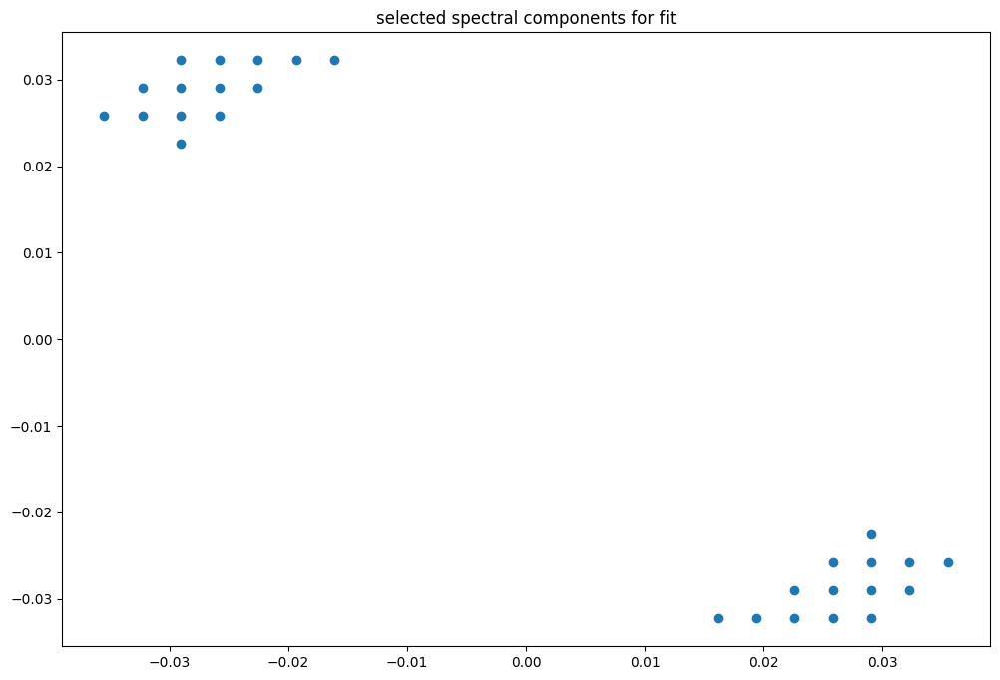

box [3000, 3500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

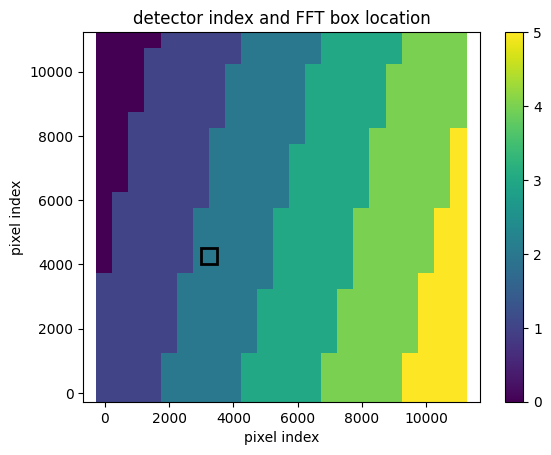

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


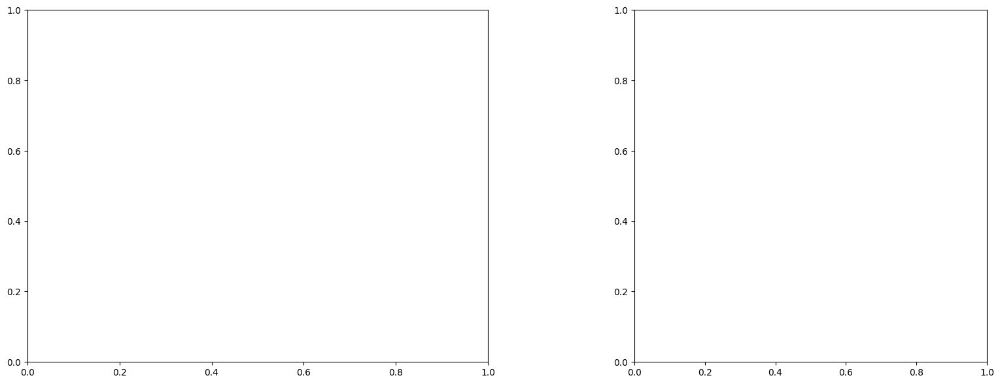

U and V components of current : [0.78082664 0.43026202]
uncertainties for U and V: 0.22327831160033793 0.21556388799611018


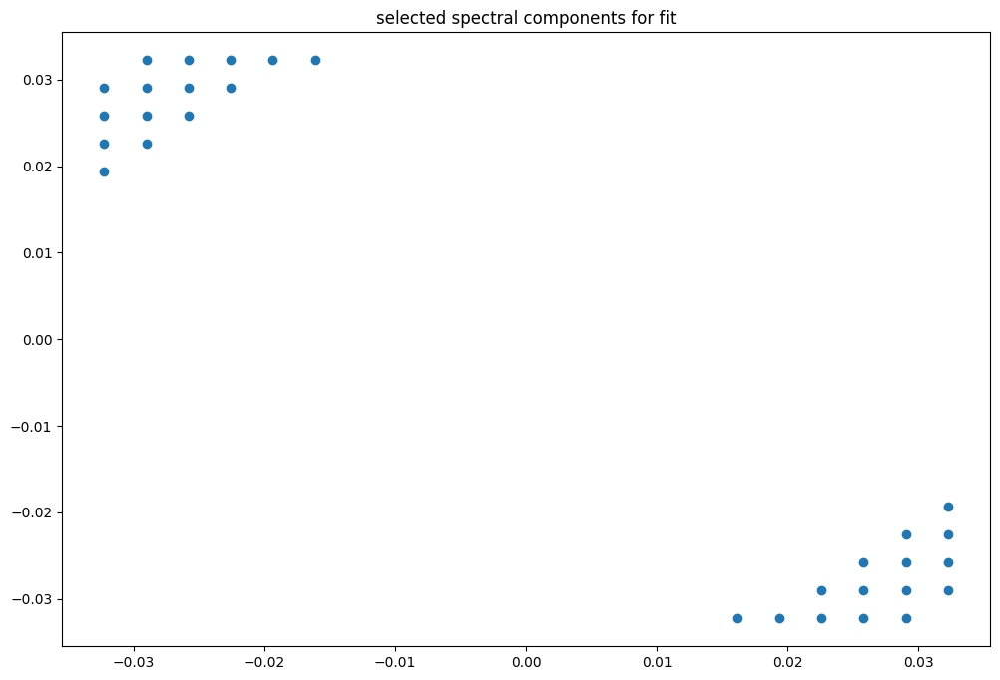

box [3000, 3500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

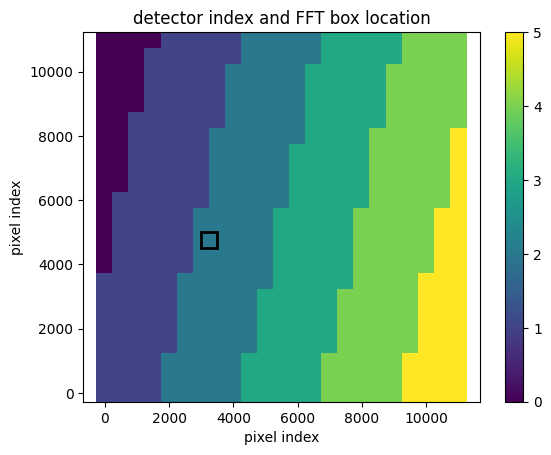

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


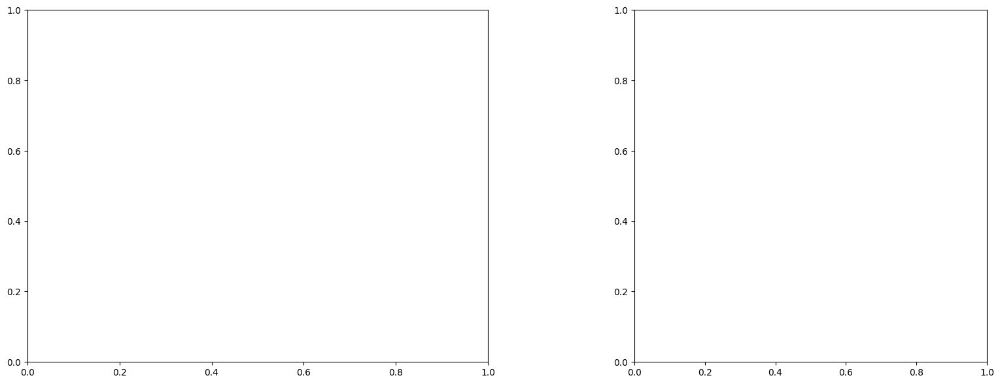

U and V components of current : [0.86360938 0.60998588]
uncertainties for U and V: 0.26871917806220974 0.23403441477071021


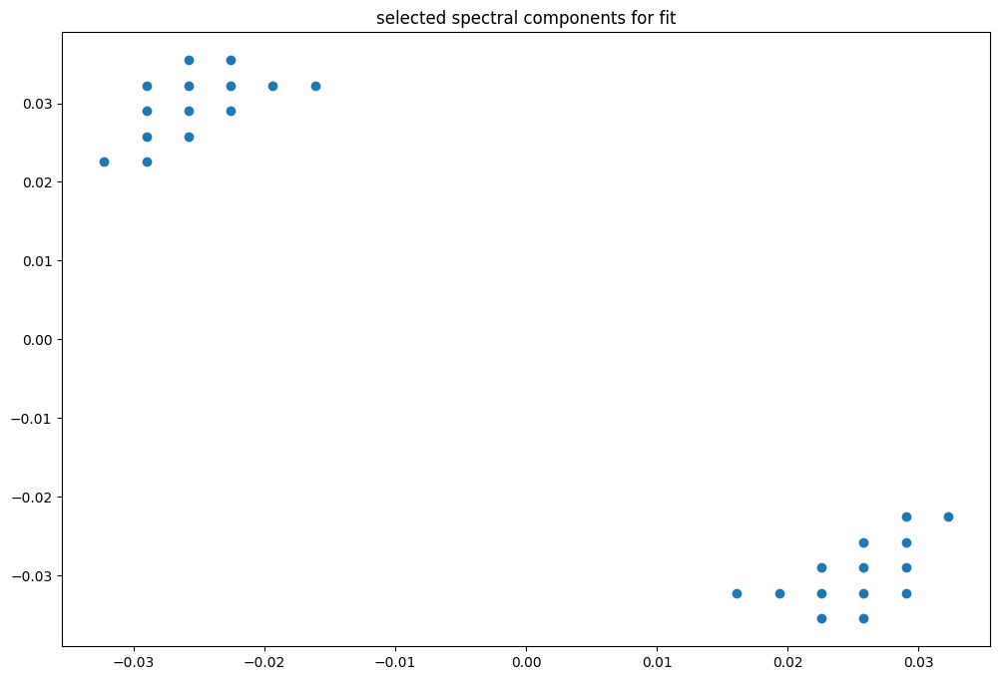

box [3000, 3500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

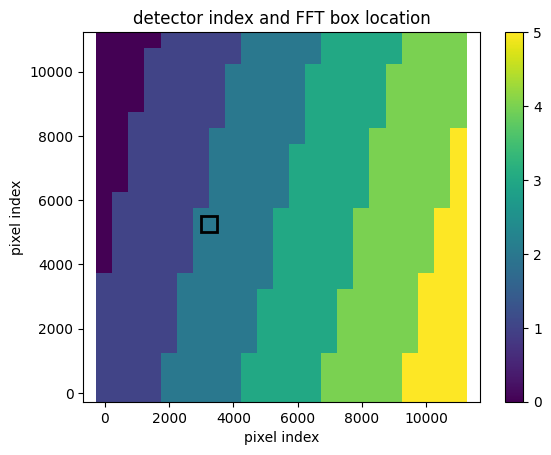

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


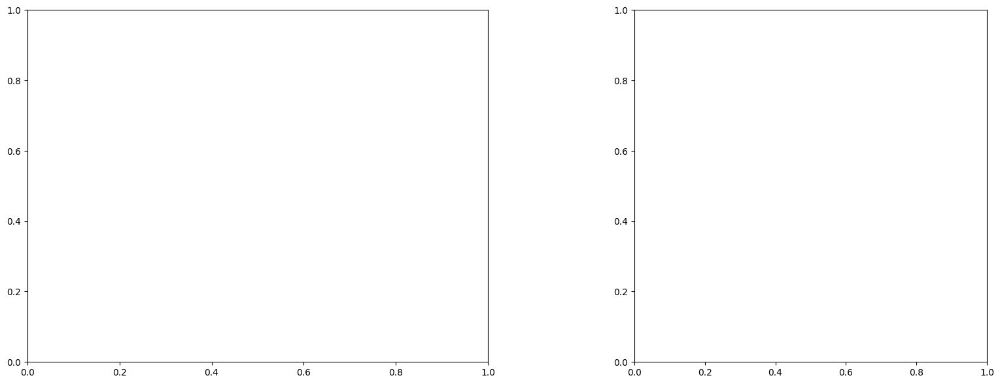

U and V components of current : [0.60819804 0.5223126 ]
uncertainties for U and V: 0.2657972461980326 0.24345827343137963


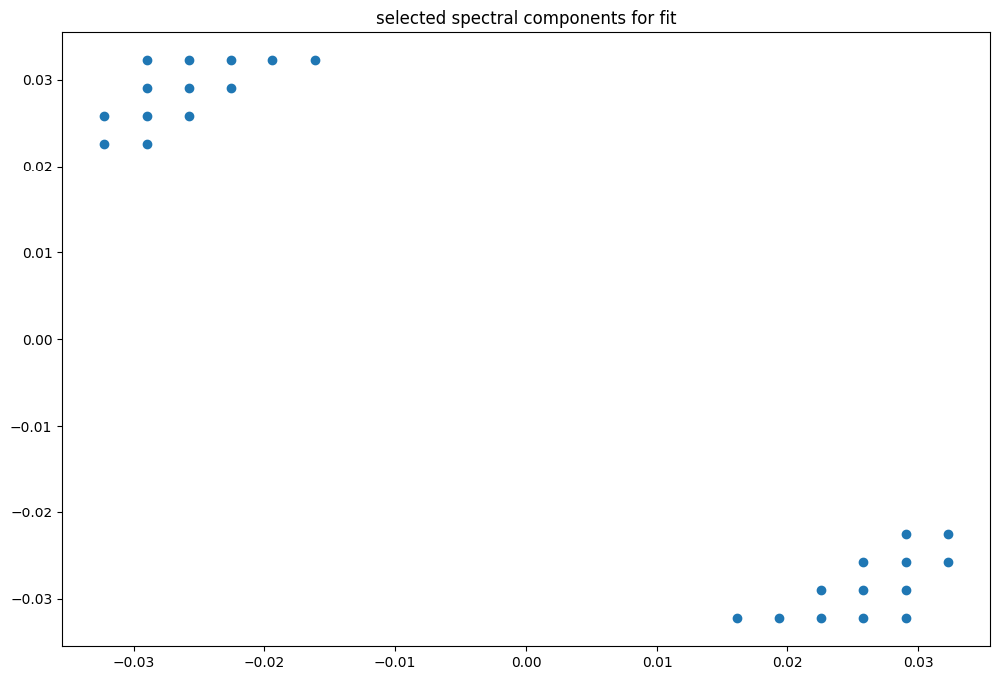

box [3000, 3500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

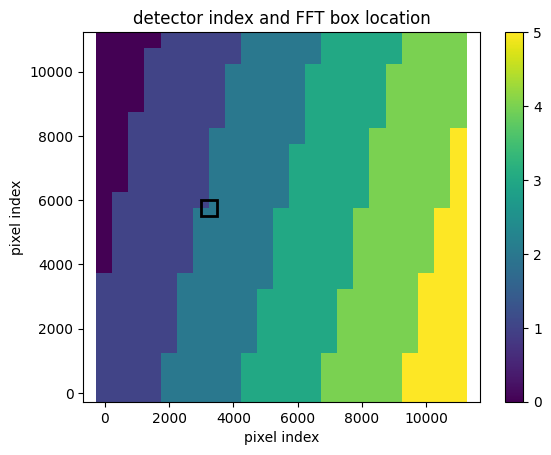

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


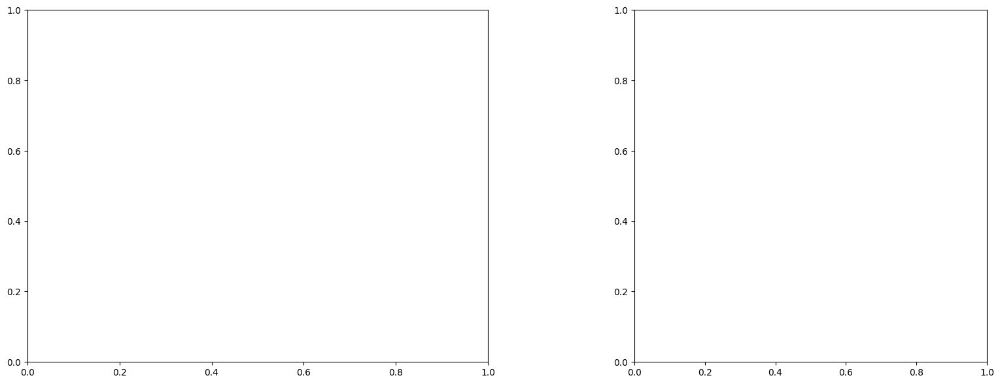

LinAlgError: Singular matrix

box [3000, 3500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

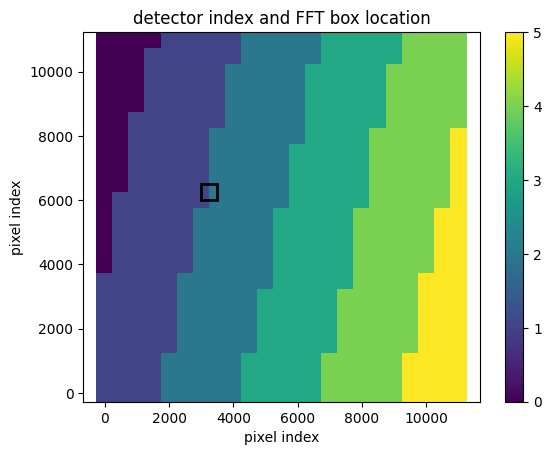

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


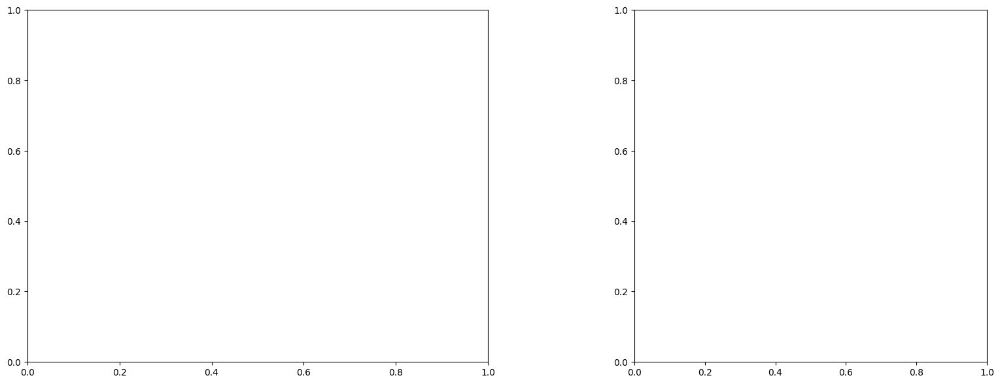

U and V components of current : [ 6.53234305 -3.0620703 ]
uncertainties for U and V: 0.12545481346041393 0.1550948464559799


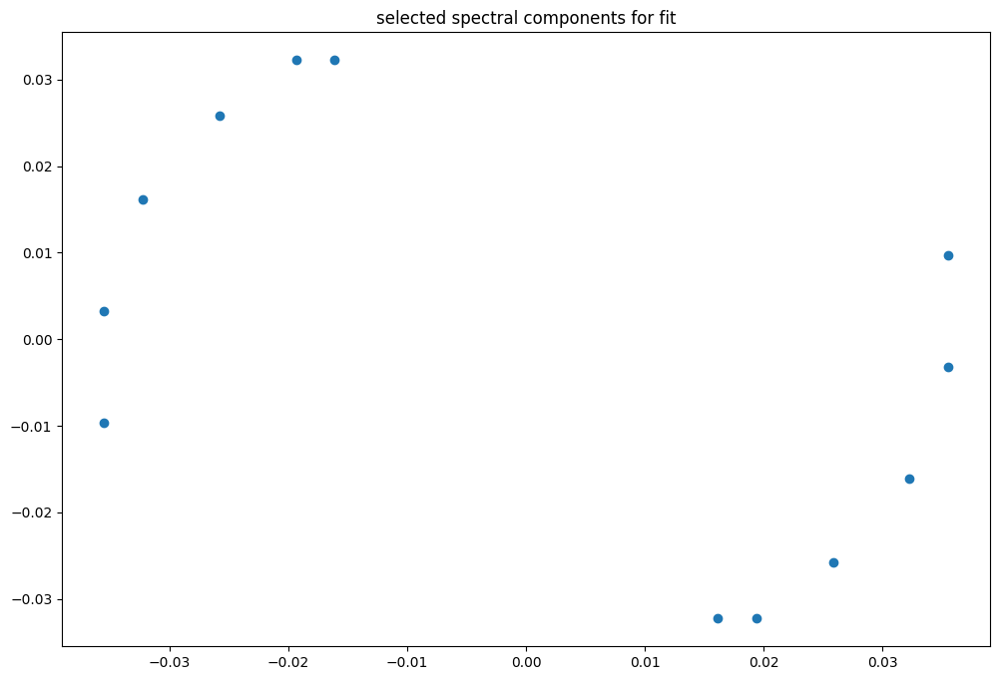

box [3000, 3500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

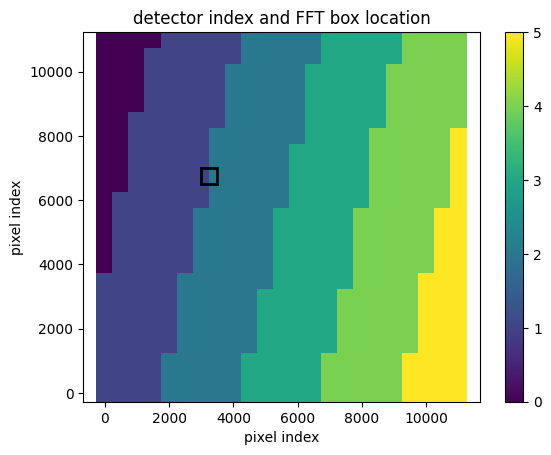

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


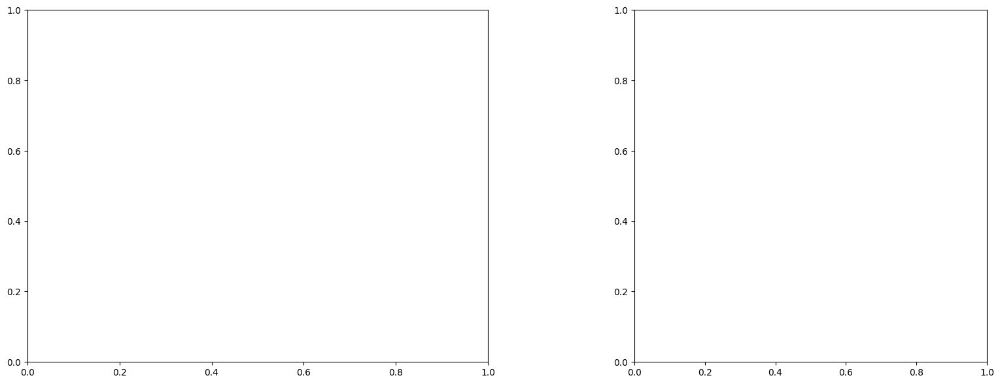

LinAlgError: Singular matrix

box [3000, 3500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

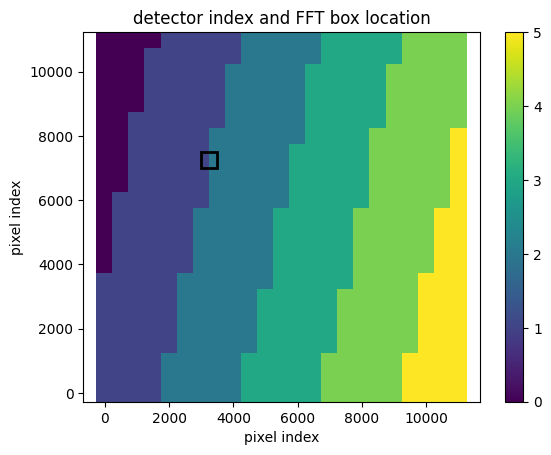

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


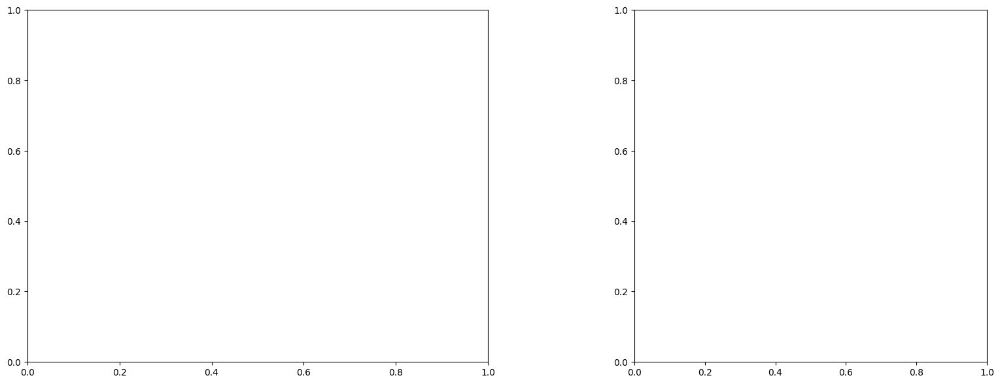

LinAlgError: Singular matrix

box [3000, 3500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

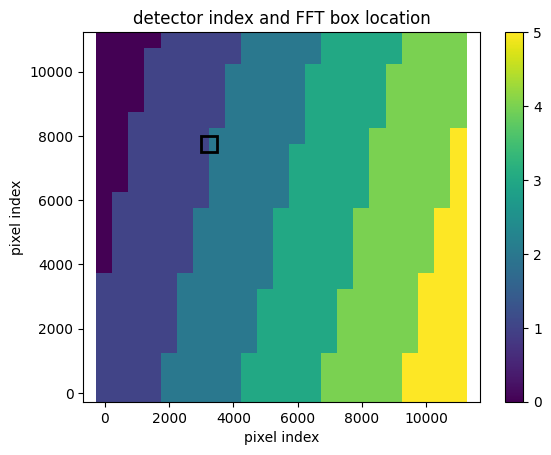

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


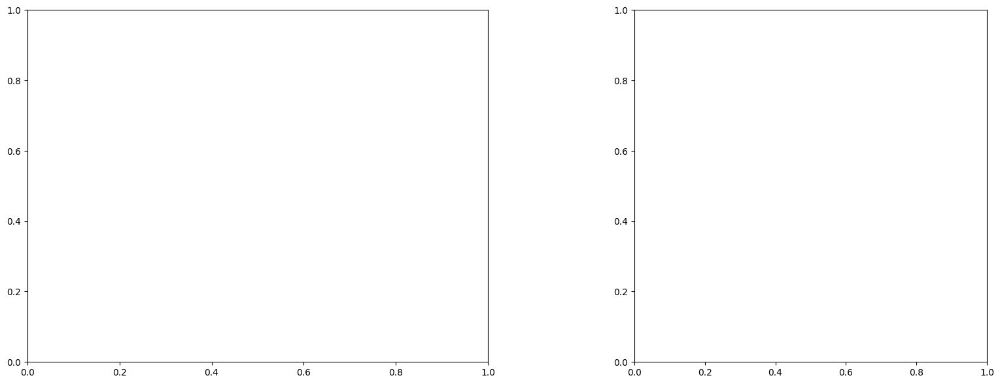

U and V components of current : [-1.21851265 -1.60827097]
uncertainties for U and V: 0.6996876518869504 1.0850565264523078


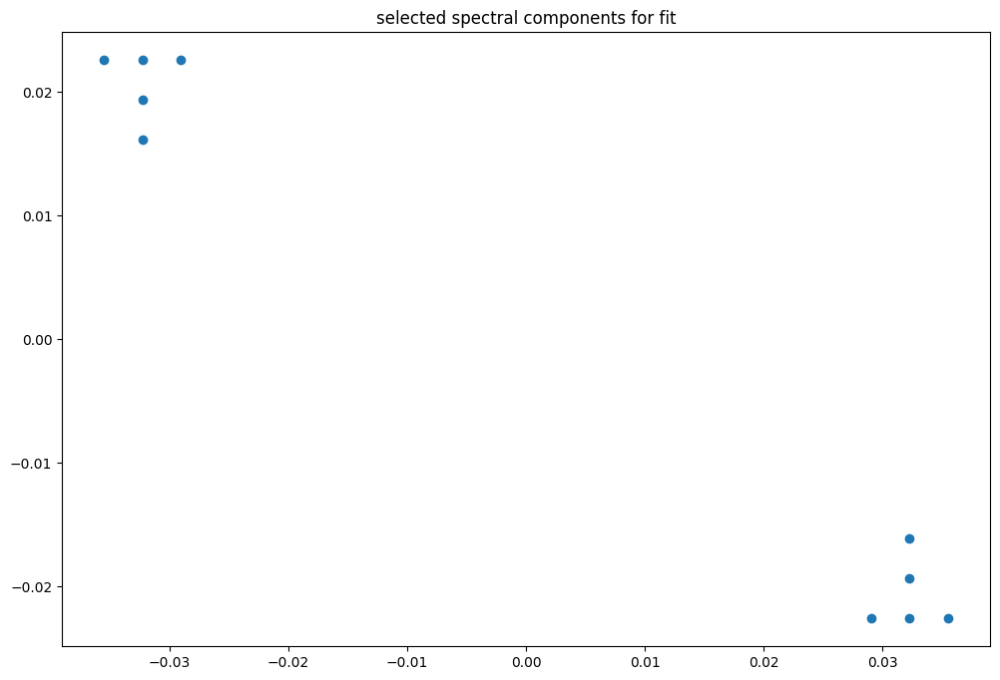

box [3000, 3500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

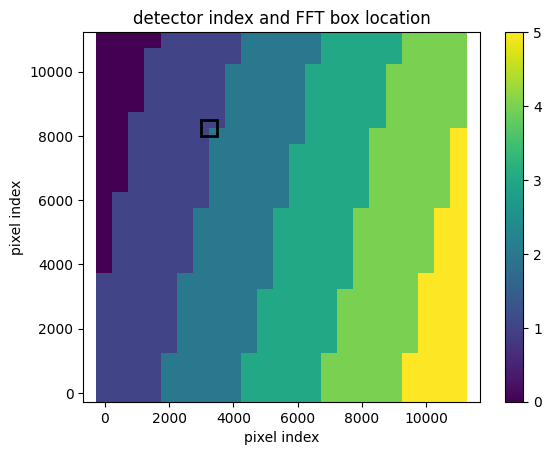

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


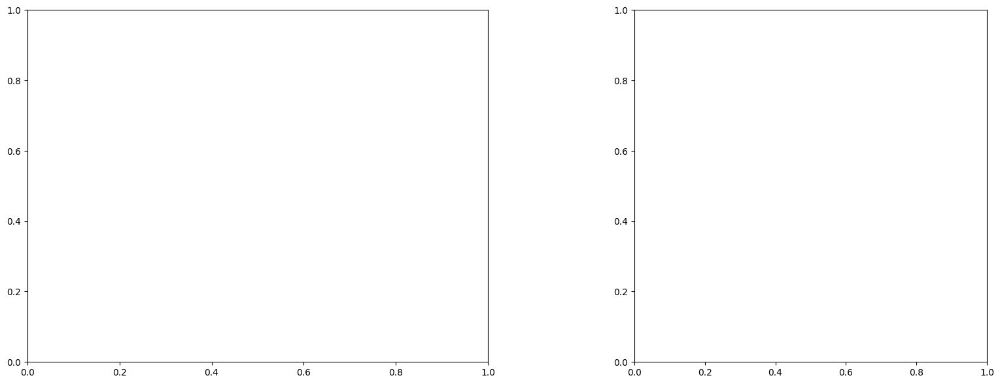

U and V components of current : [ 0.06433604 -0.02219368]
uncertainties for U and V: 0.13520145203958742 0.12804863284272372


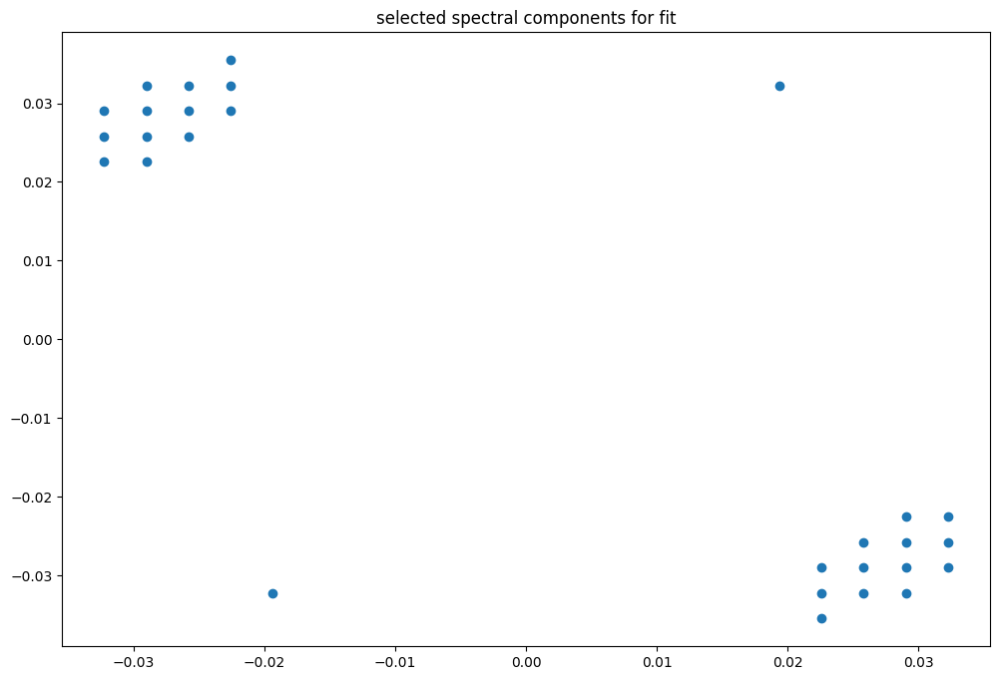

box [3000, 3500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

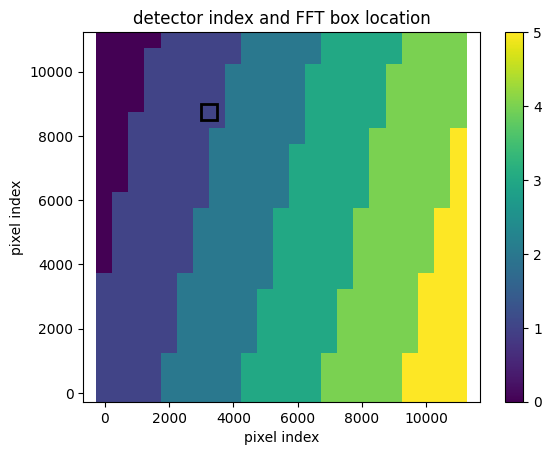

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00760757280773
(31, 31)
(31, 31)
(31, 31)


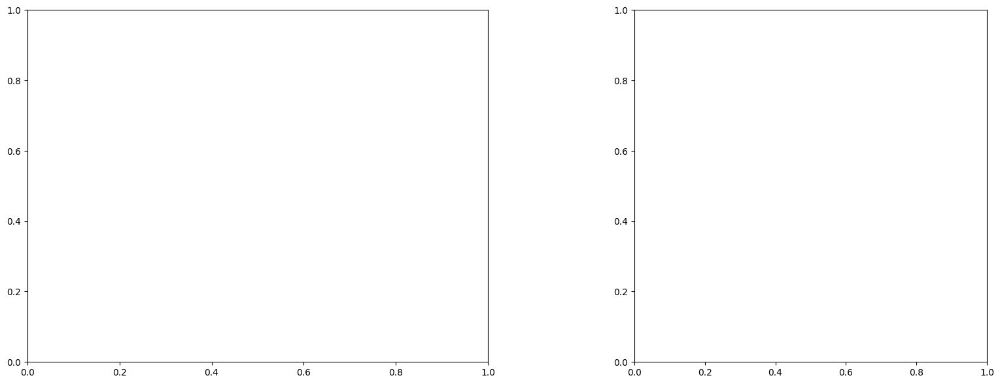

U and V components of current : [ 0.0604914  -0.22839805]
uncertainties for U and V: 0.08032203752512425 0.06634155319773419


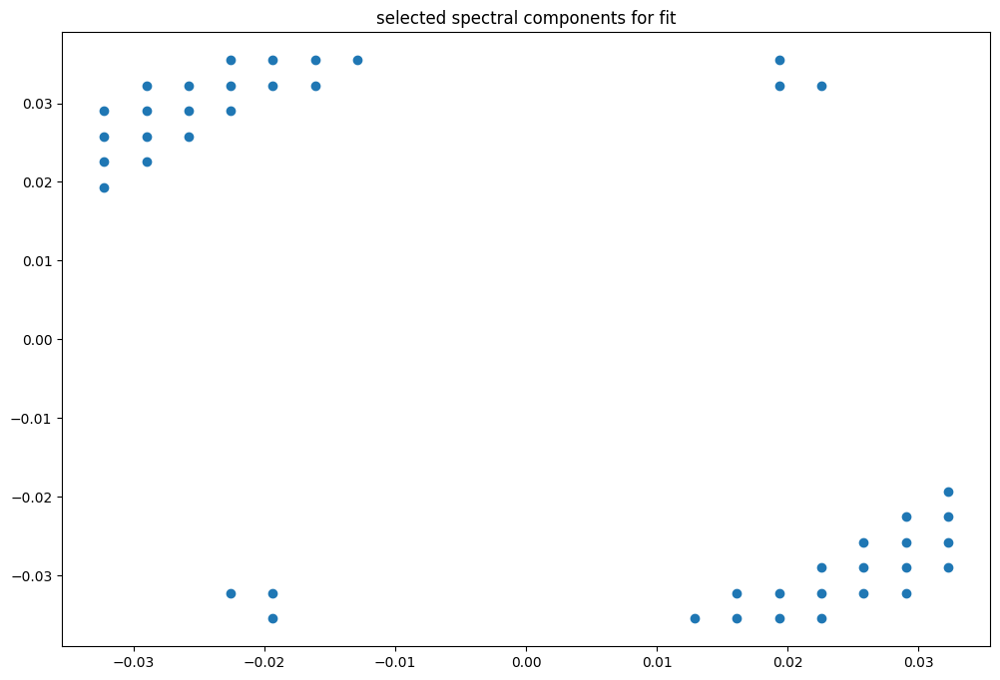

box [3000, 3500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

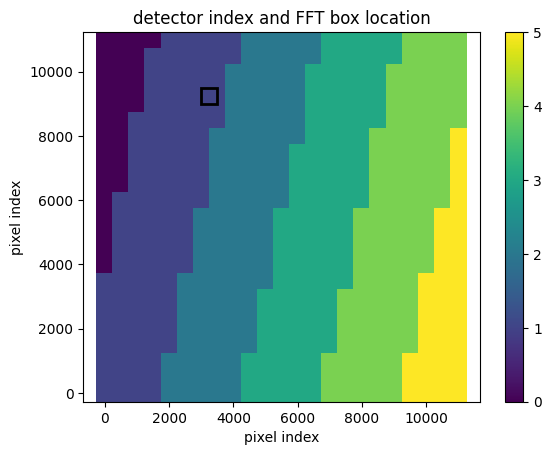

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0076048561584954
(31, 31)
(31, 31)
(31, 31)


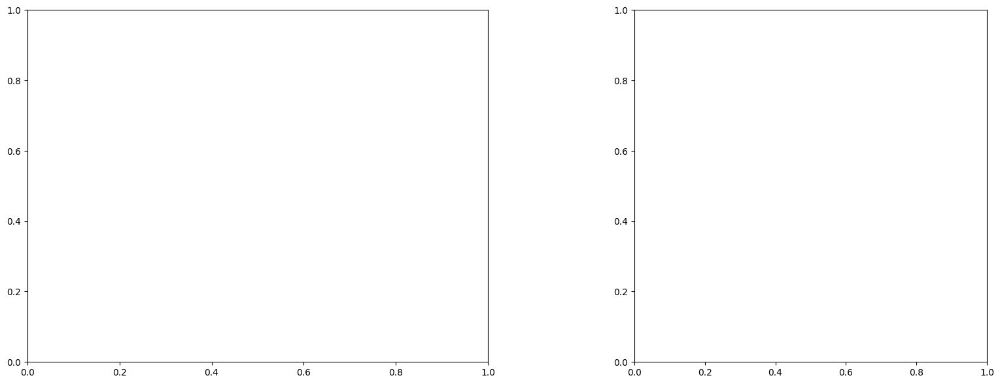

U and V components of current : [-0.04082636 -0.33326581]
uncertainties for U and V: 0.10203533458176103 0.08386522558144782


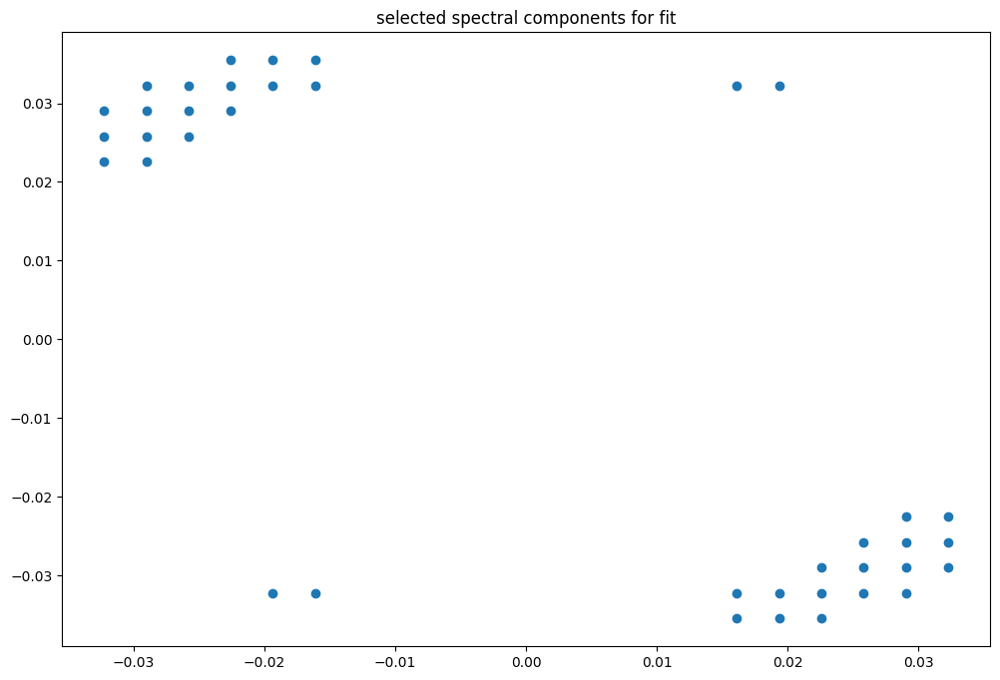

box [3000, 3500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

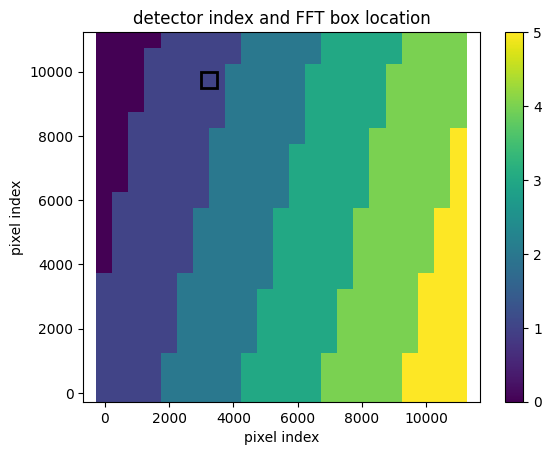

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(31, 31)
(31, 31)
(31, 31)


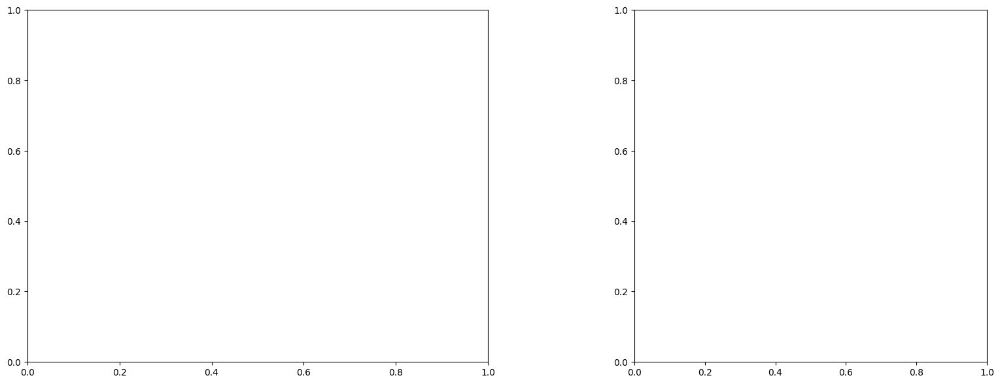

U and V components of current : [ 0.02513924 -0.37890884]
uncertainties for U and V: 0.08492448720988008 0.06263724071297874


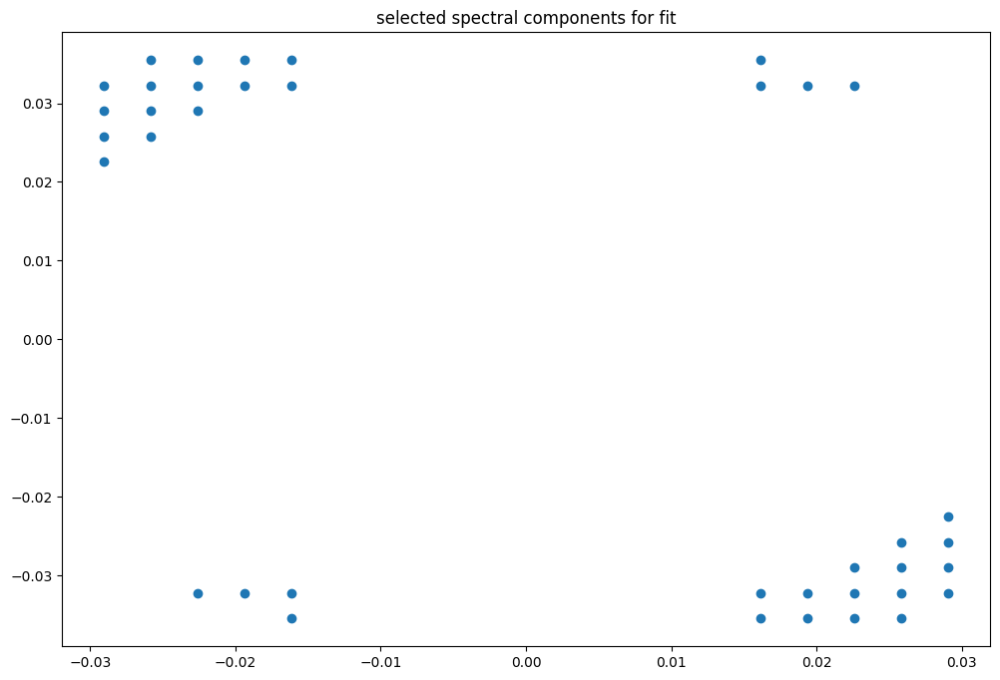

box [3000, 3500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

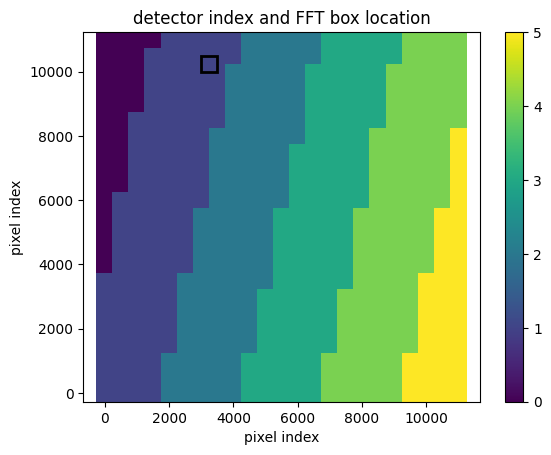

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 31)
(31, 31)
(31, 31)


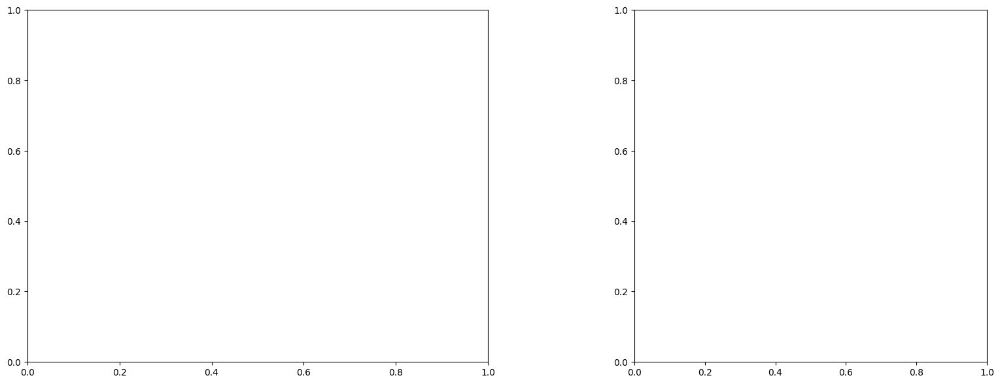

U and V components of current : [ 0.1201456  -0.32886552]
uncertainties for U and V: 0.15630061858474642 0.14419629391255717


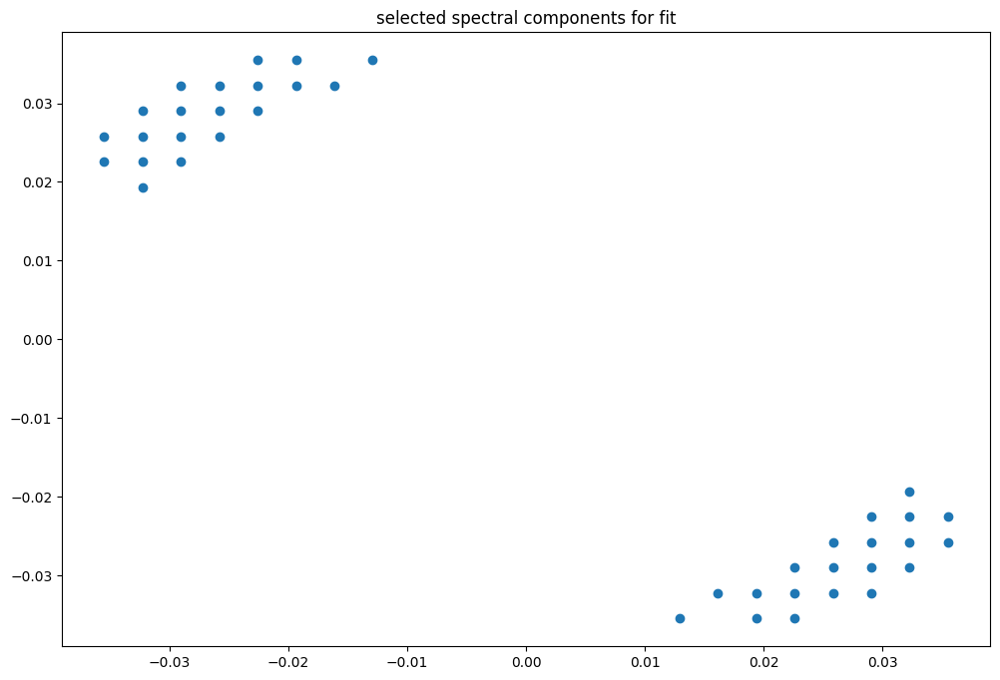

box [3000, 3500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

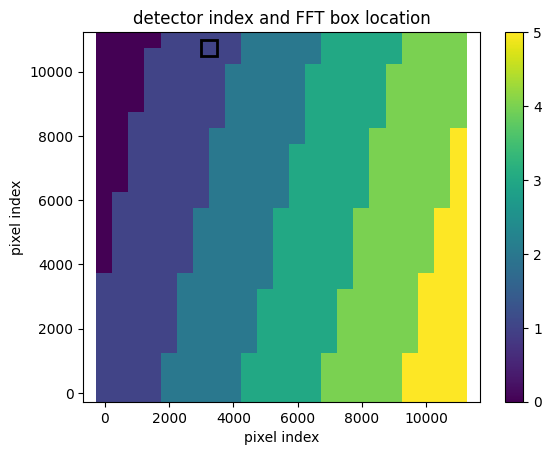

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 30)
(31, 30)
(31, 30)


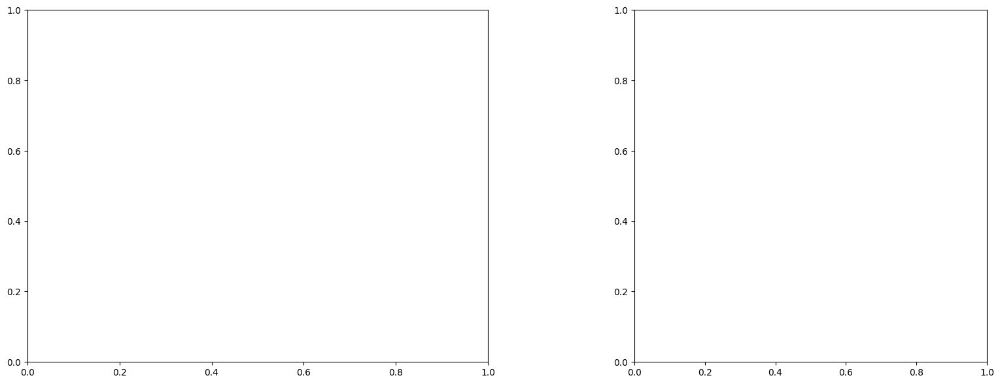

U and V components of current : [ 0.5423483  -0.15695749]
uncertainties for U and V: 0.12363642996078138 0.12946734292937767


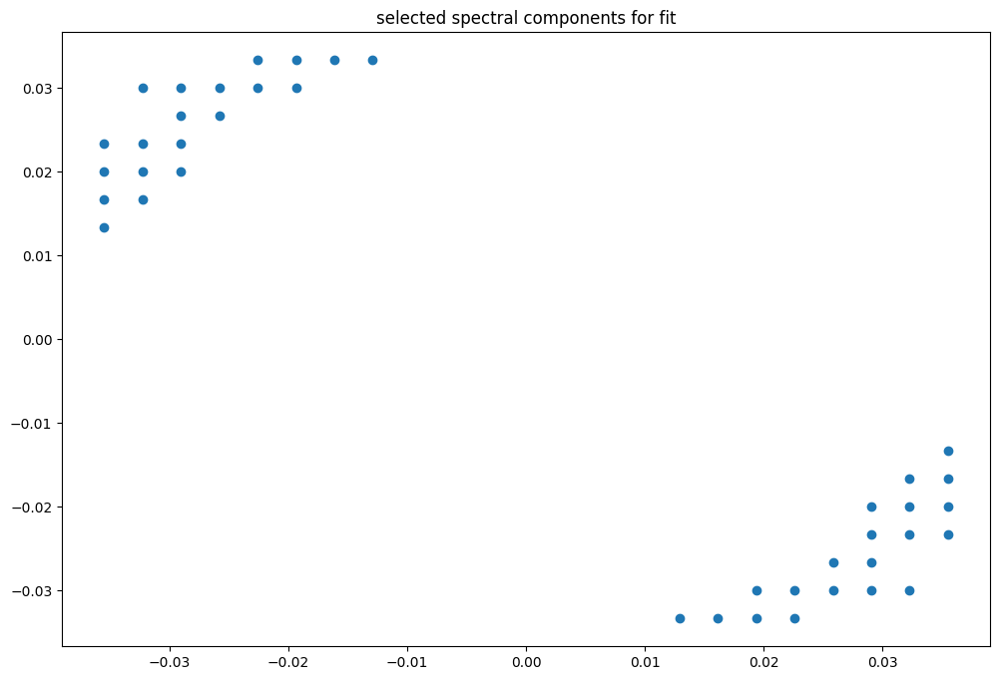

box [3500, 4000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

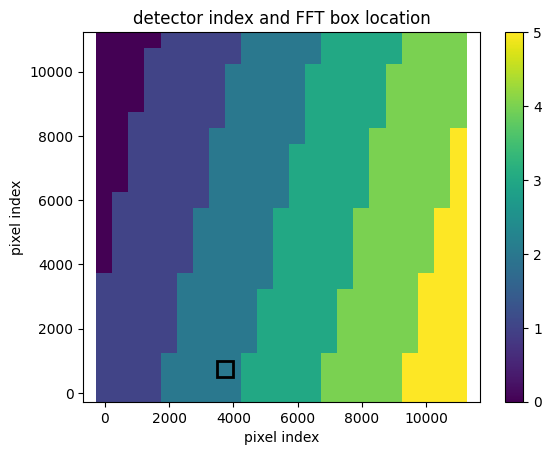

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


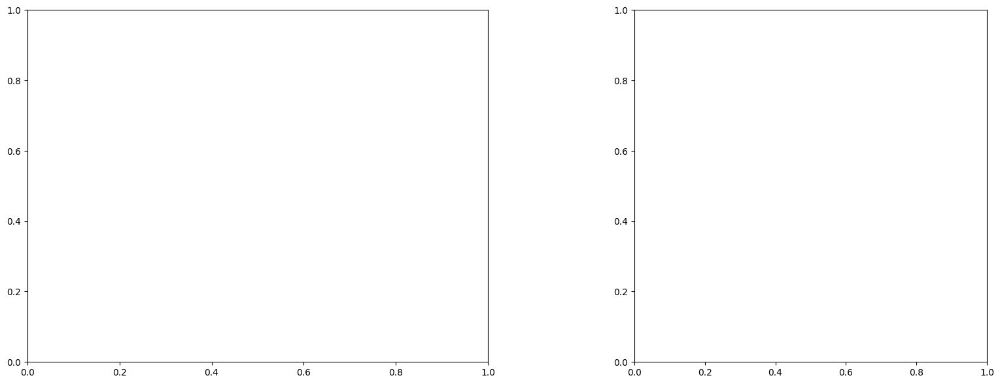

U and V components of current : [0.54044656 0.98395521]
uncertainties for U and V: 0.049780390348610946 0.05676034964615186


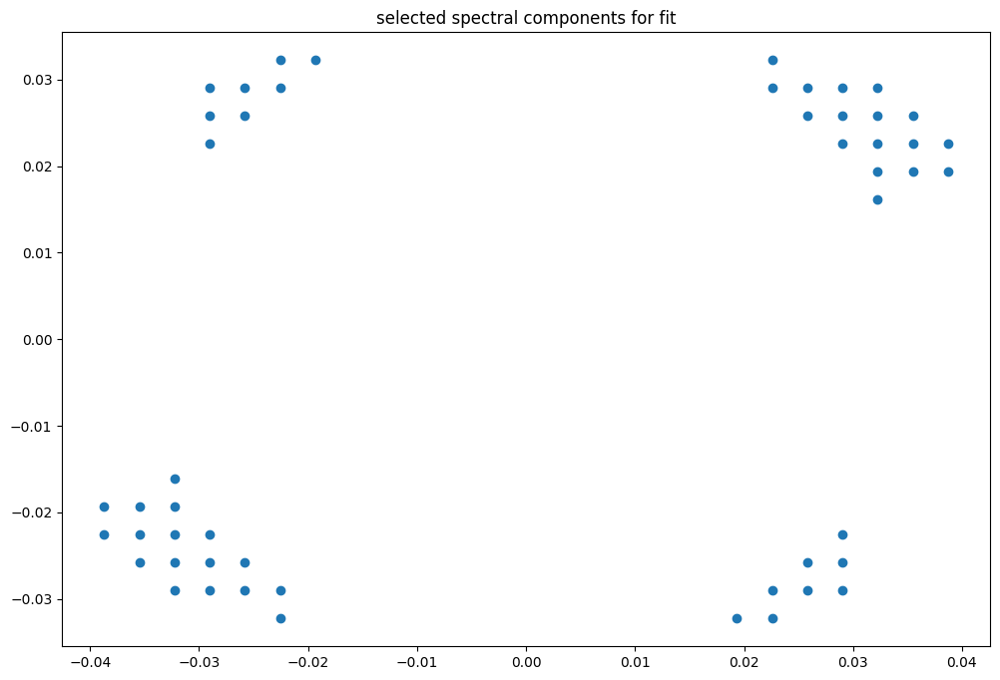

box [3500, 4000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

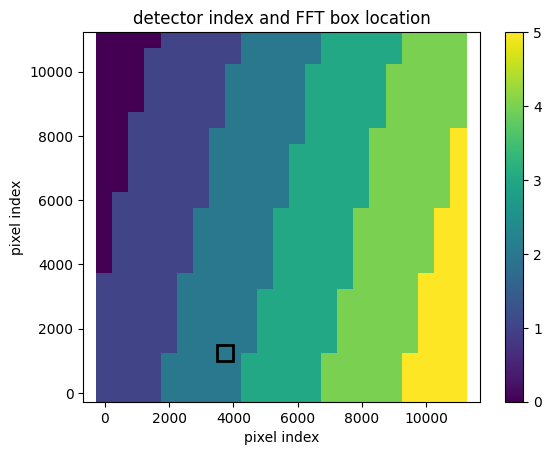

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


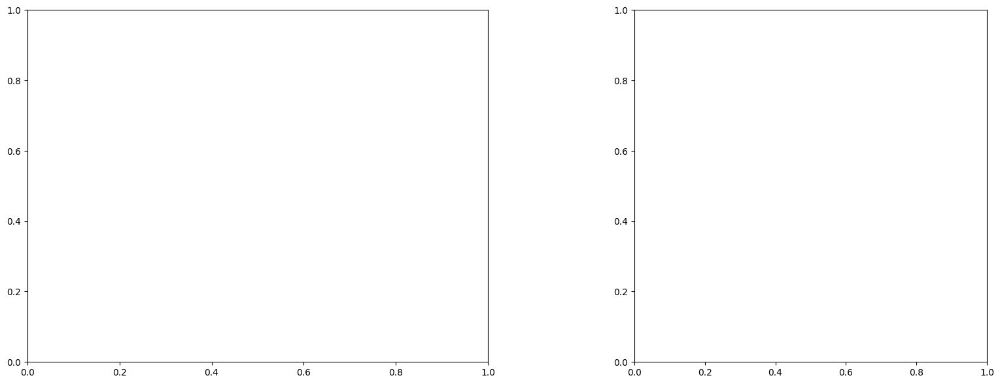

U and V components of current : [0.61727414 0.99242373]
uncertainties for U and V: 0.05105244546990788 0.04961106818677398


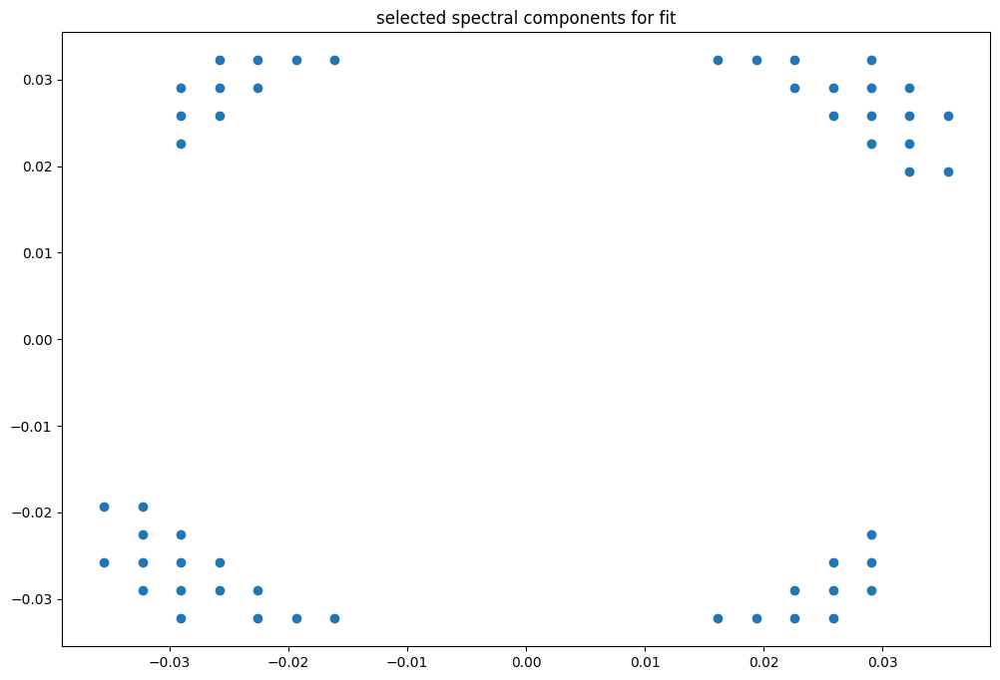

box [3500, 4000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

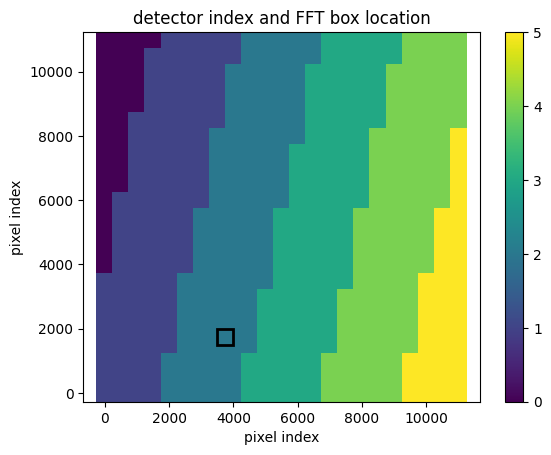

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


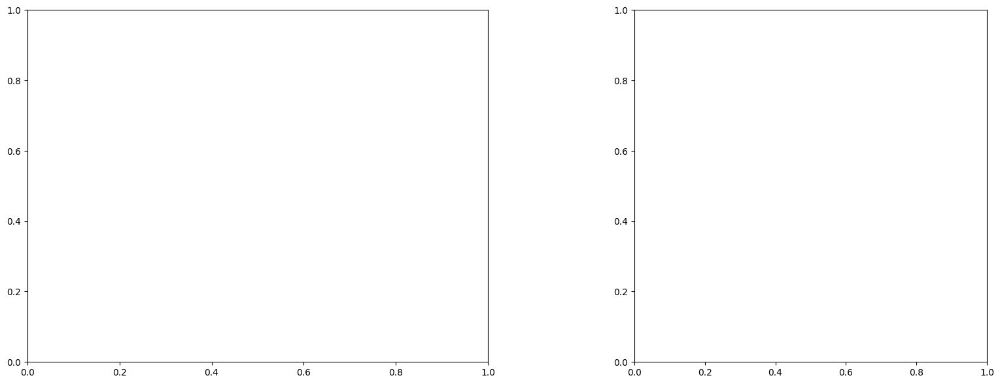

U and V components of current : [0.50292877 0.74228957]
uncertainties for U and V: 0.07888953541692753 0.0652704412295939


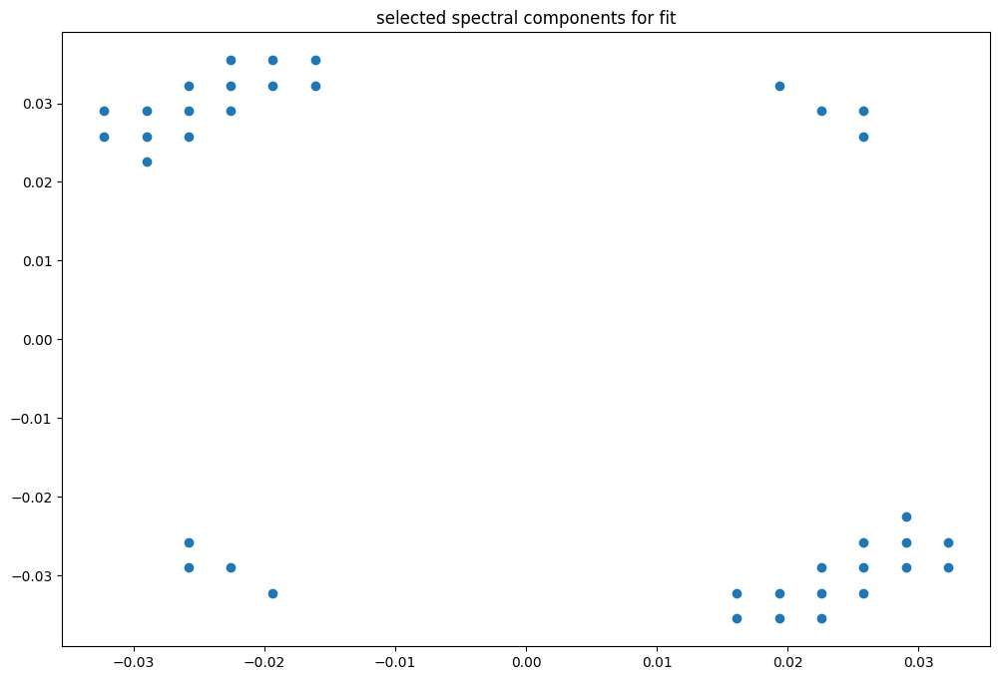

box [3500, 4000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

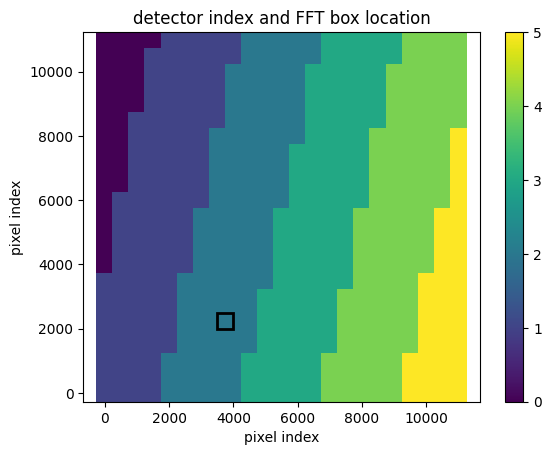

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


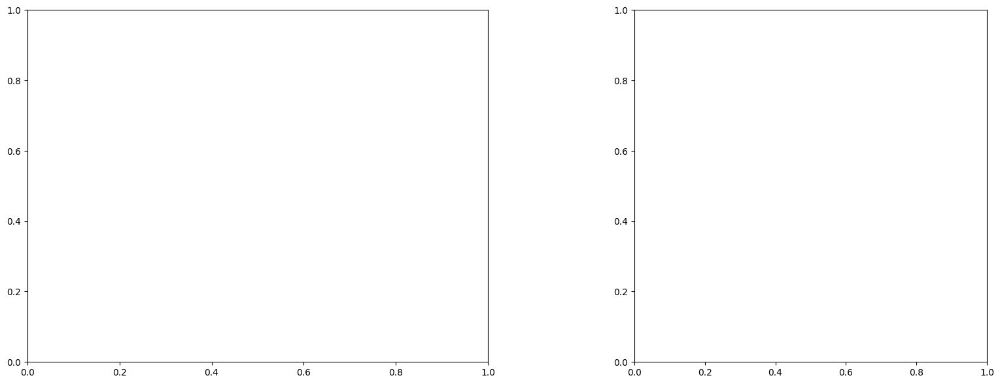

U and V components of current : [0.81575379 0.86777569]
uncertainties for U and V: 0.10018121745912309 0.0853246727249152


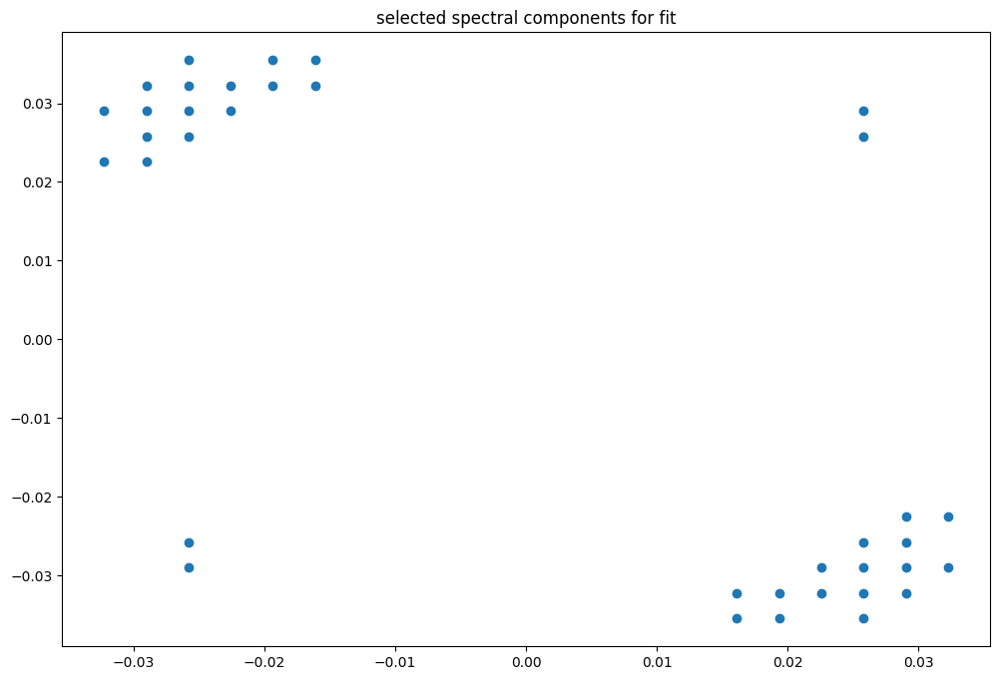

box [3500, 4000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

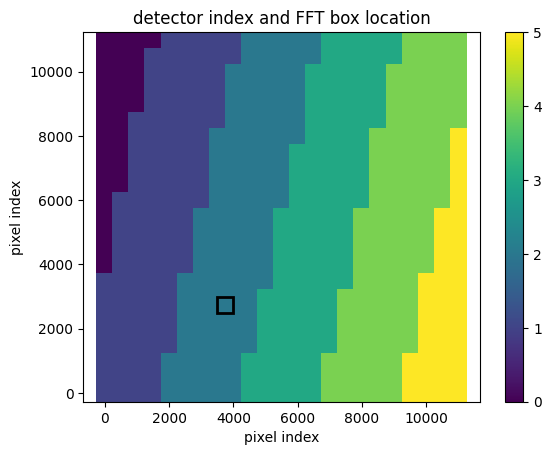

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


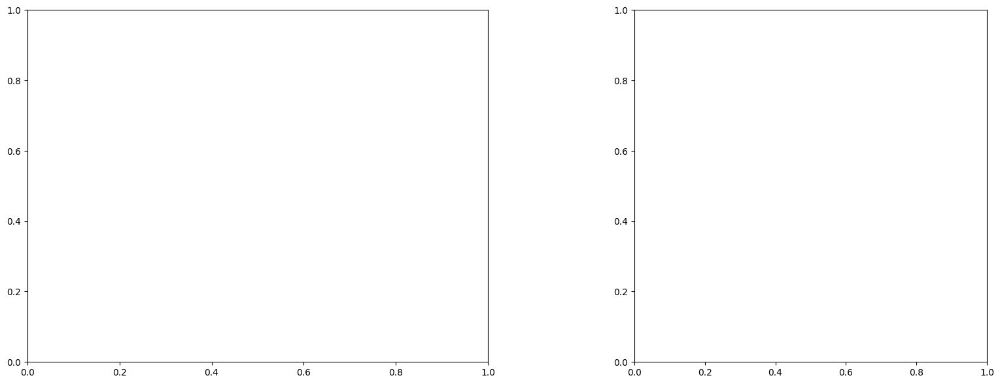

U and V components of current : [1.13400354 1.01539674]
uncertainties for U and V: 0.21021671689183363 0.1924044090682087


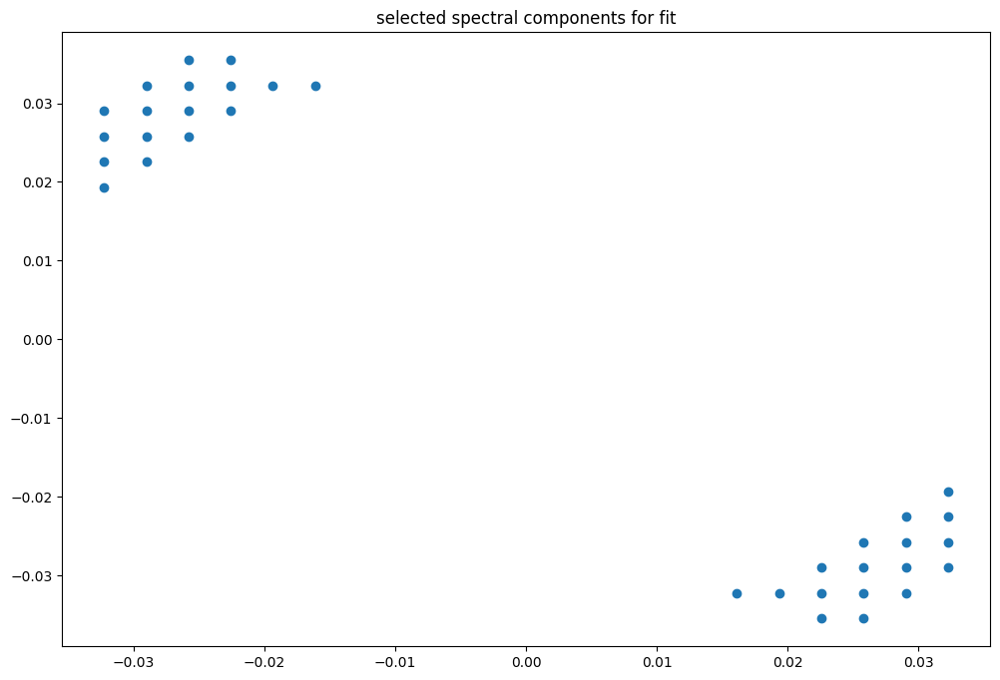

box [3500, 4000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

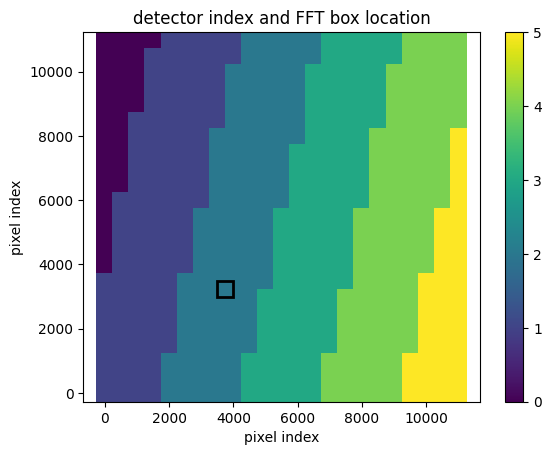

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


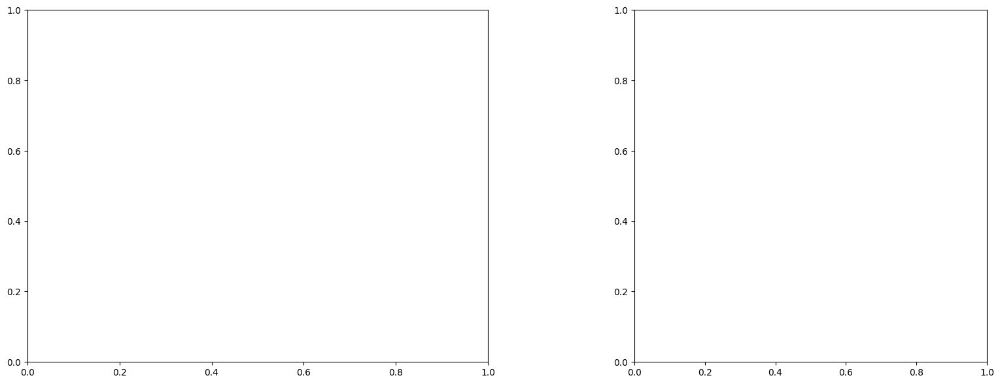

U and V components of current : [1.01911967 0.90496387]
uncertainties for U and V: 0.1976000500513178 0.17746675877516918


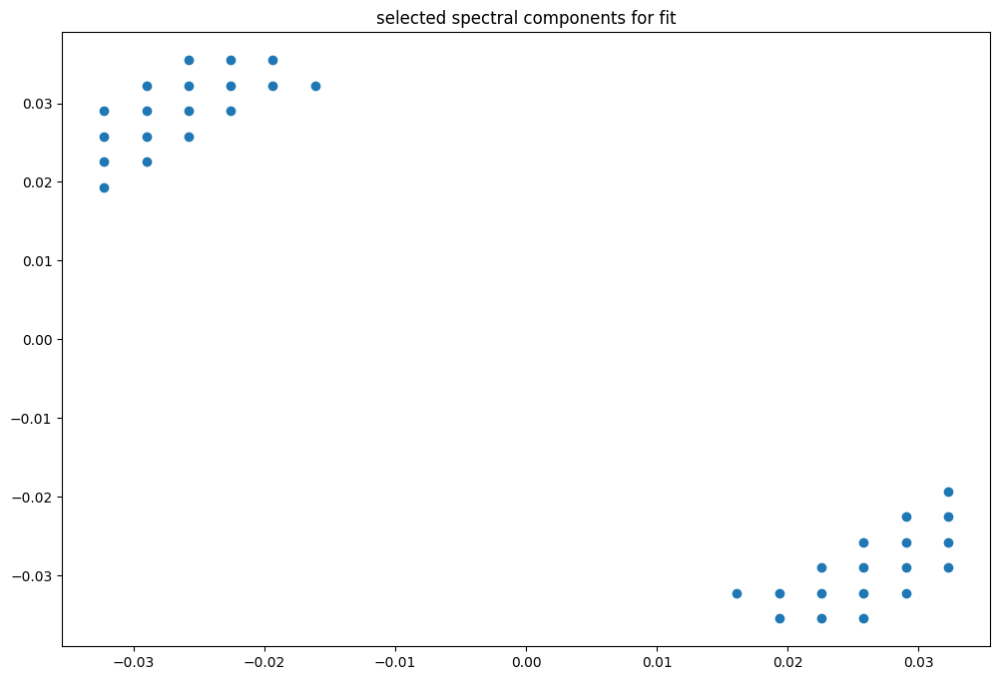

box [3500, 4000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

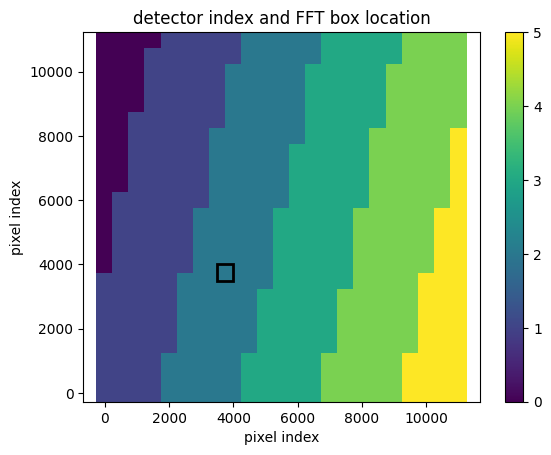

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


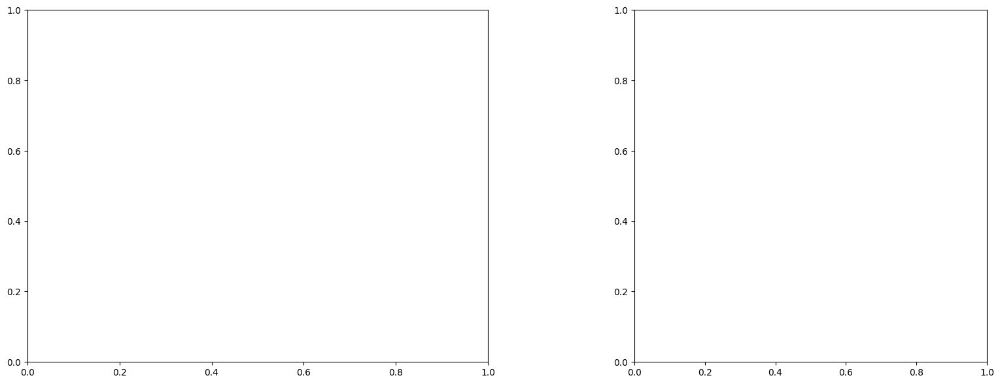

U and V components of current : [0.78965861 0.67036427]
uncertainties for U and V: 0.21906453125429012 0.19572619201984734


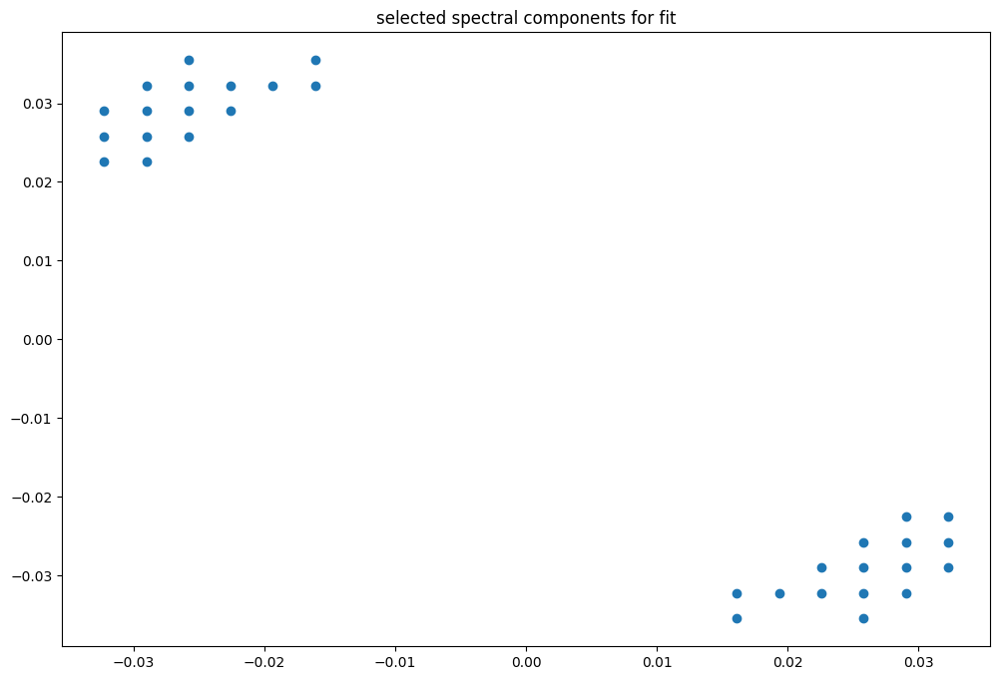

box [3500, 4000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

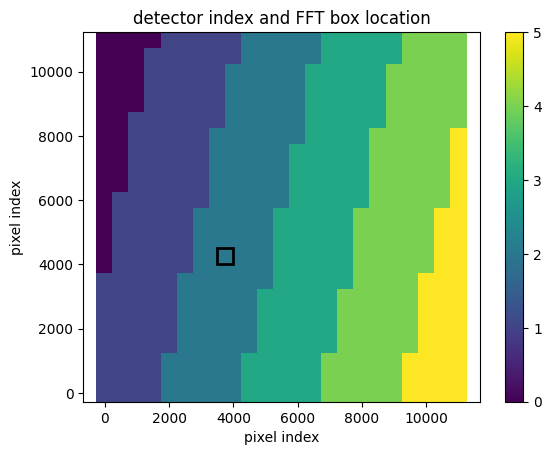

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


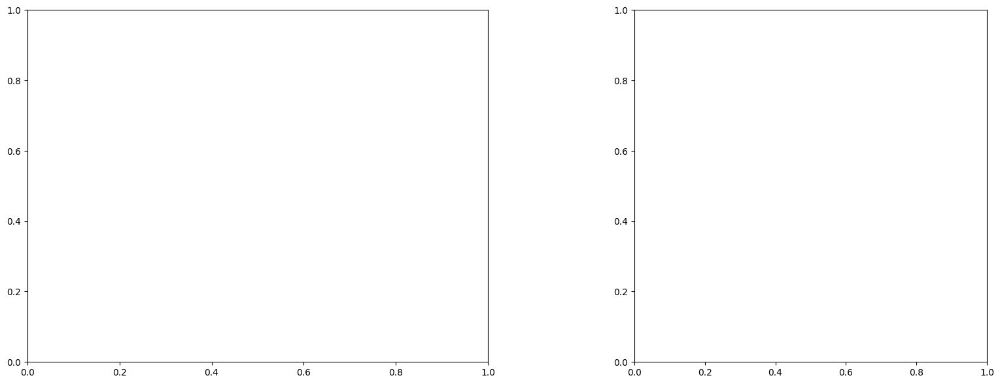

U and V components of current : [0.69181838 0.30995338]
uncertainties for U and V: 0.2198297744376103 0.190166231019526


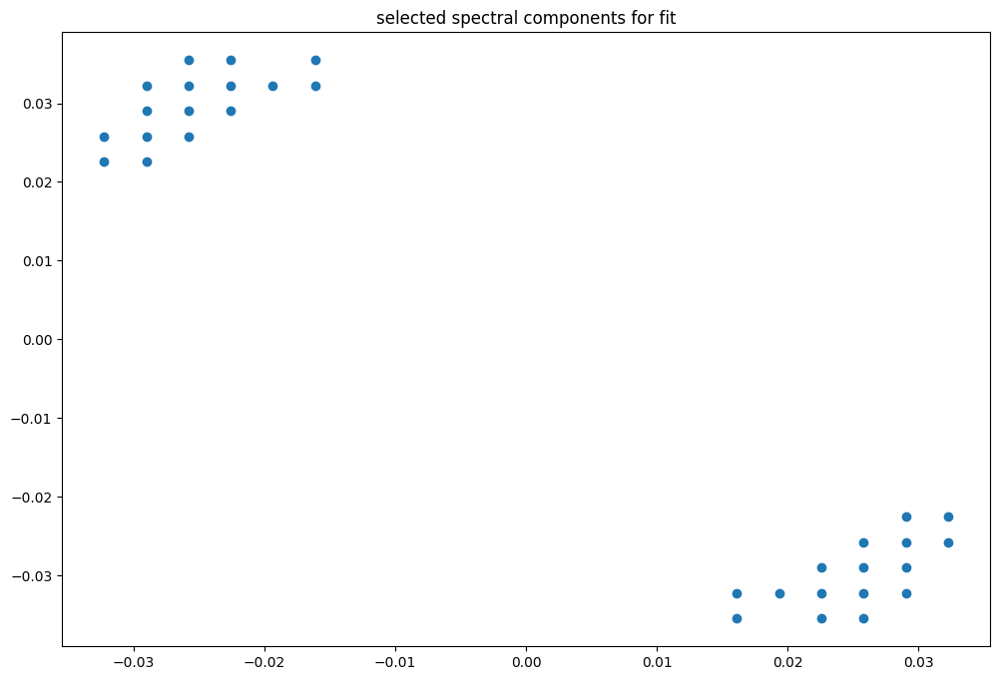

box [3500, 4000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

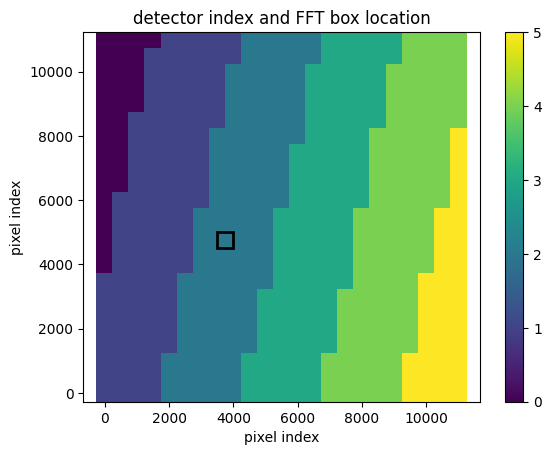

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


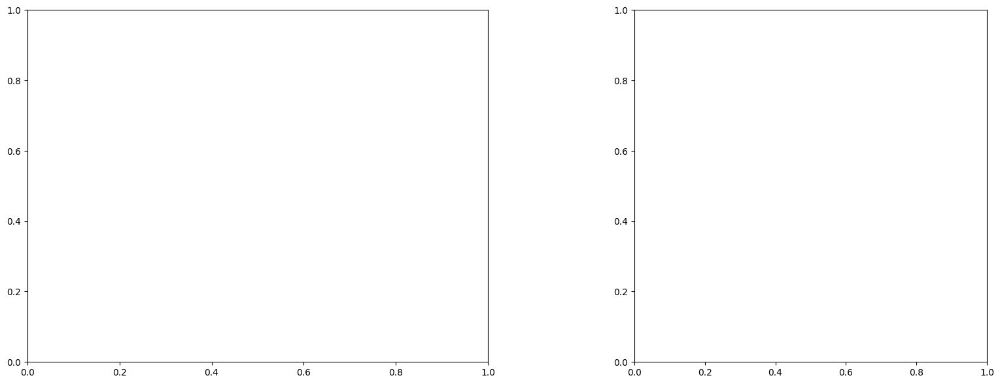

U and V components of current : [0.96836273 0.81021557]
uncertainties for U and V: 0.2641894616878211 0.24490282973898828


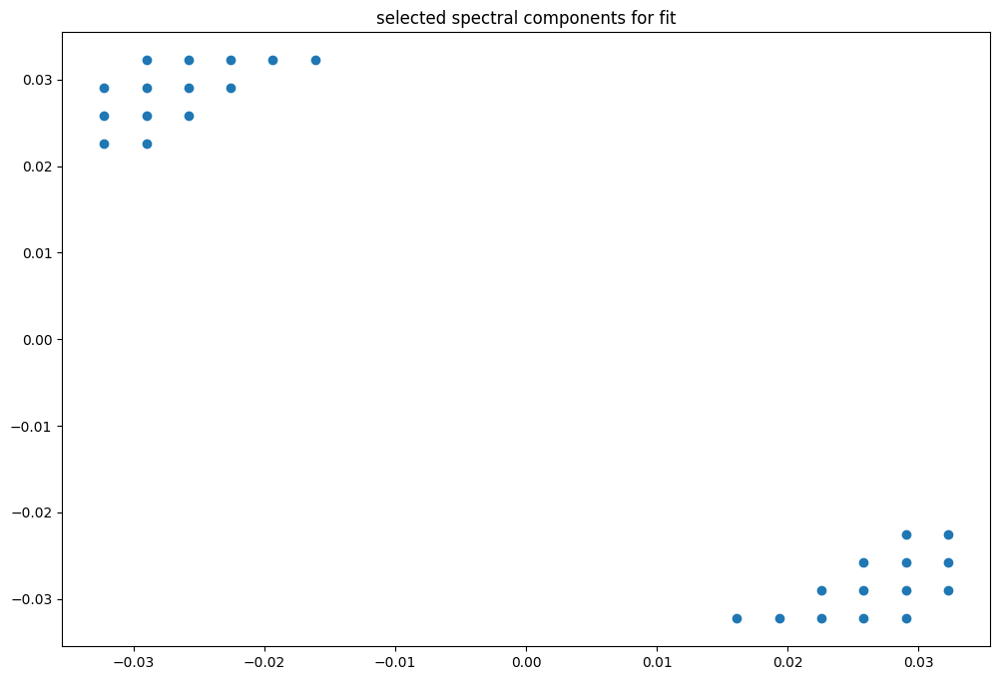

box [3500, 4000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

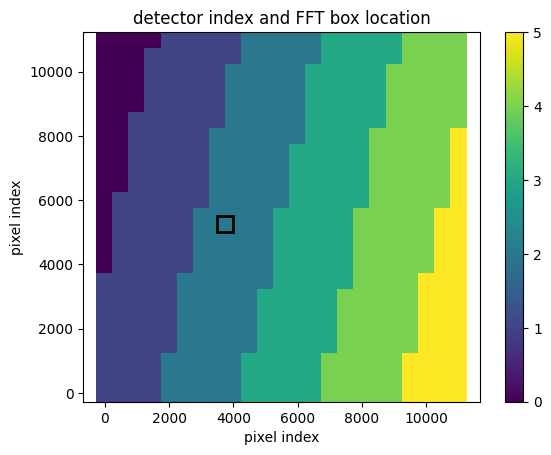

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


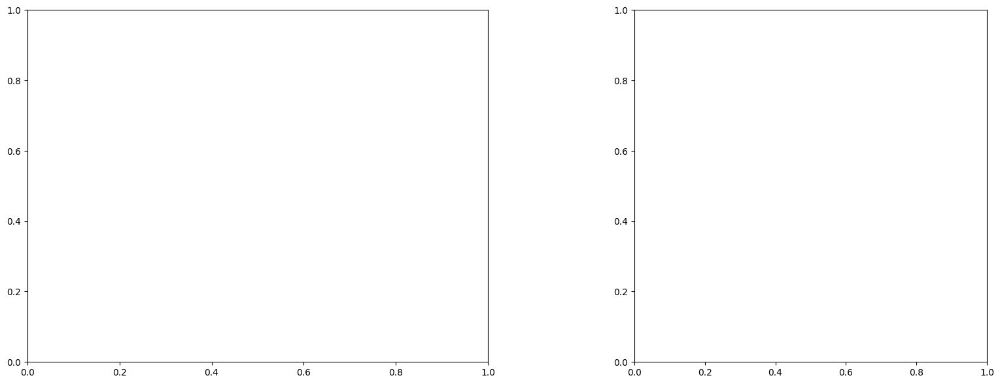

U and V components of current : [0.98111166 0.73170805]
uncertainties for U and V: 0.30486386735886206 0.29213363142077786


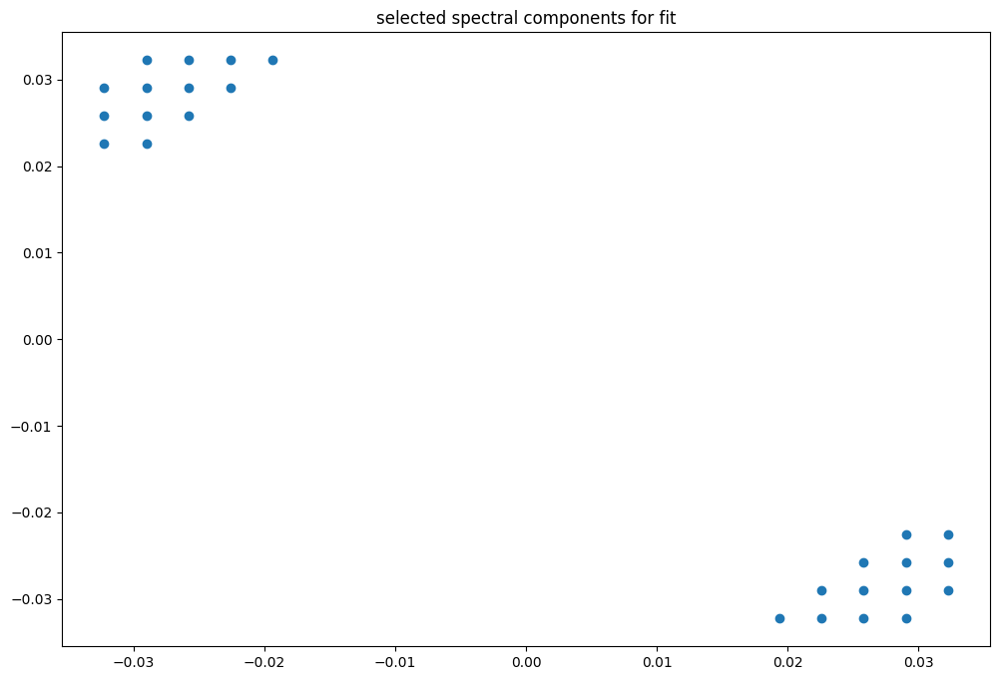

box [3500, 4000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

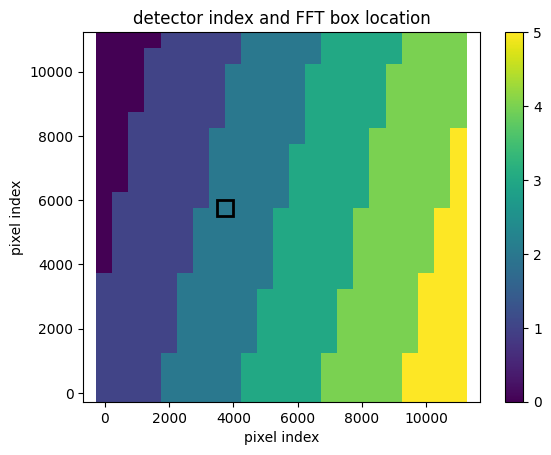

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


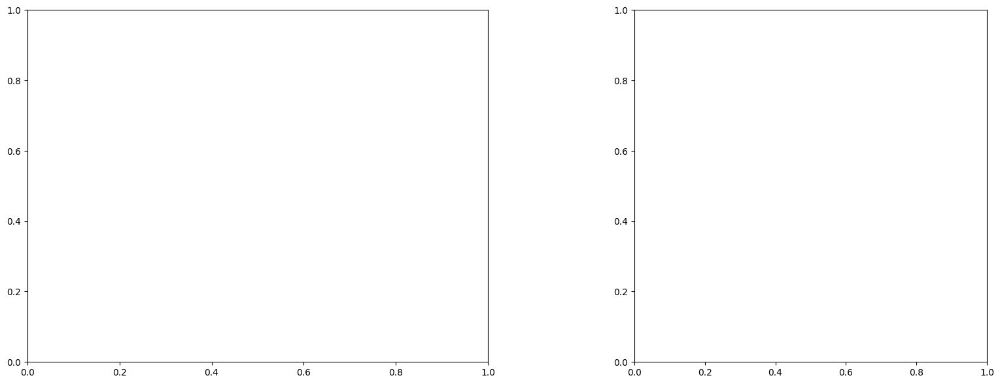

LinAlgError: Singular matrix

box [3500, 4000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

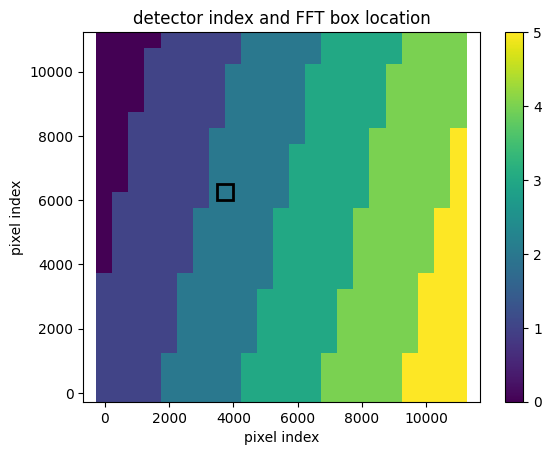

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


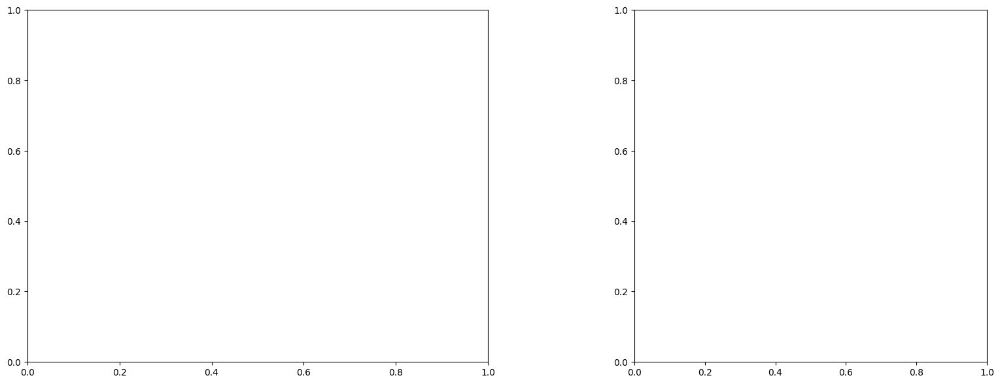

LinAlgError: Singular matrix

box [3500, 4000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

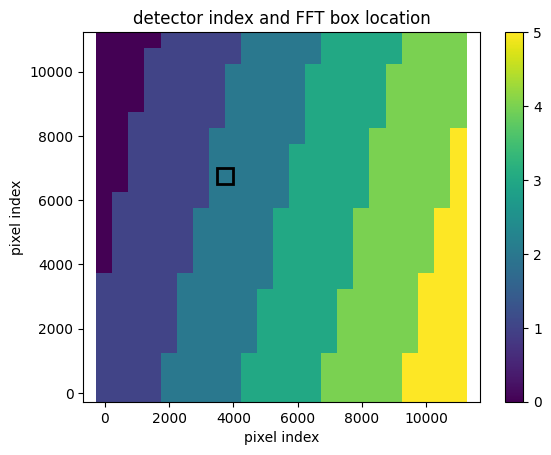

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


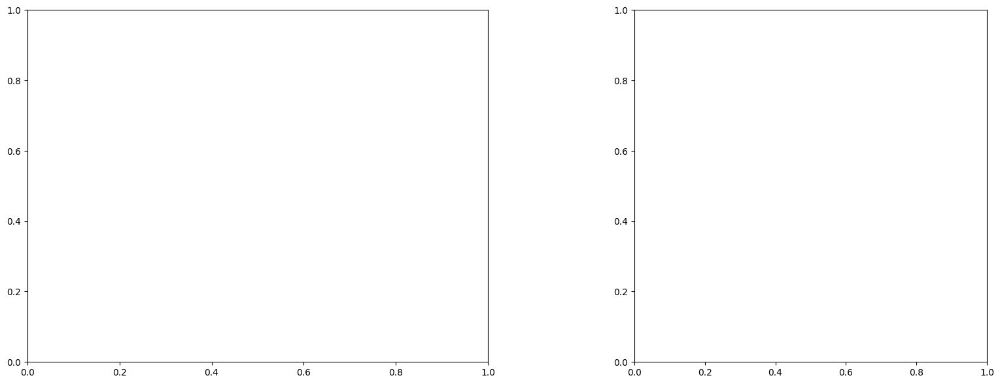

LinAlgError: Singular matrix

box [3500, 4000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

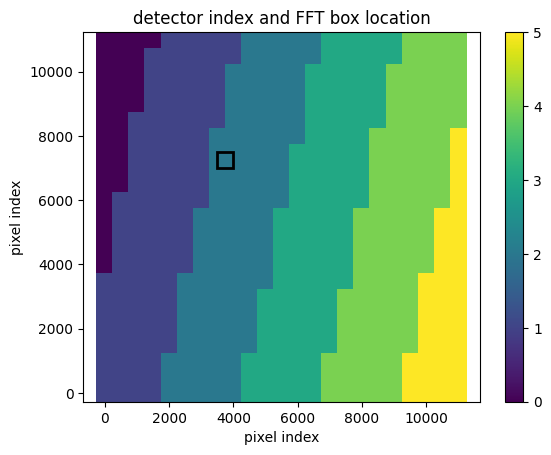

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


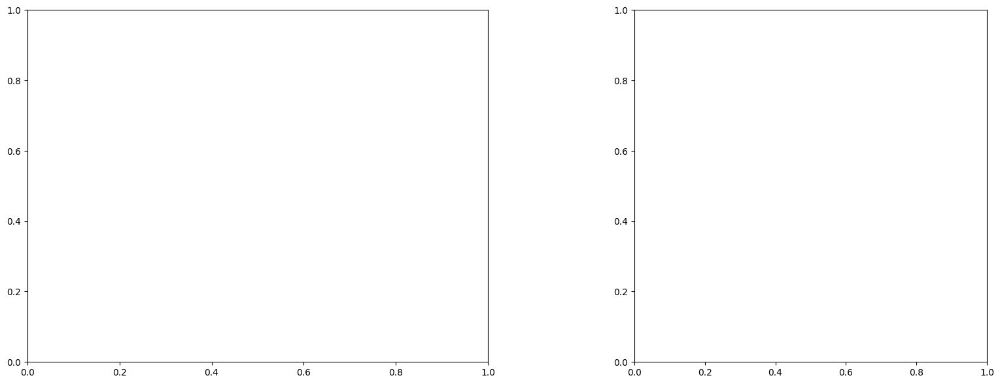

LinAlgError: Singular matrix

box [3500, 4000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

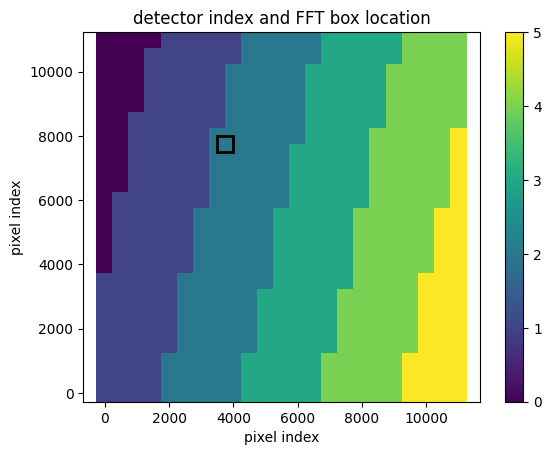

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


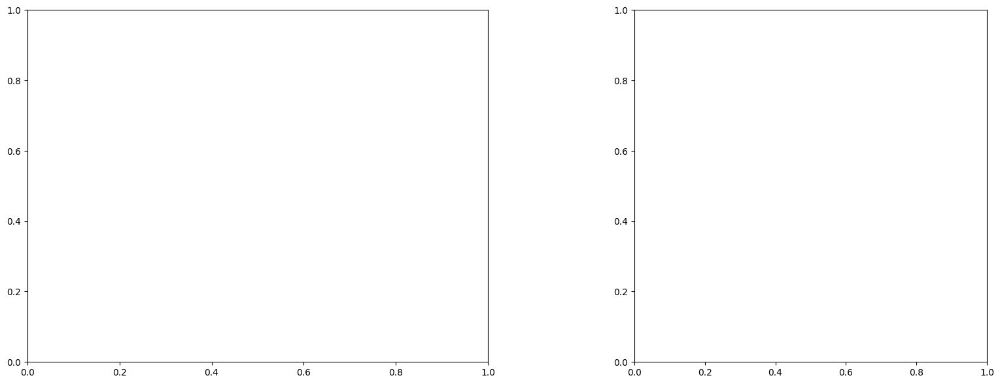

U and V components of current : [-0.1447925  -0.16523304]
uncertainties for U and V: 0.046100503451400134 0.047102742149250455


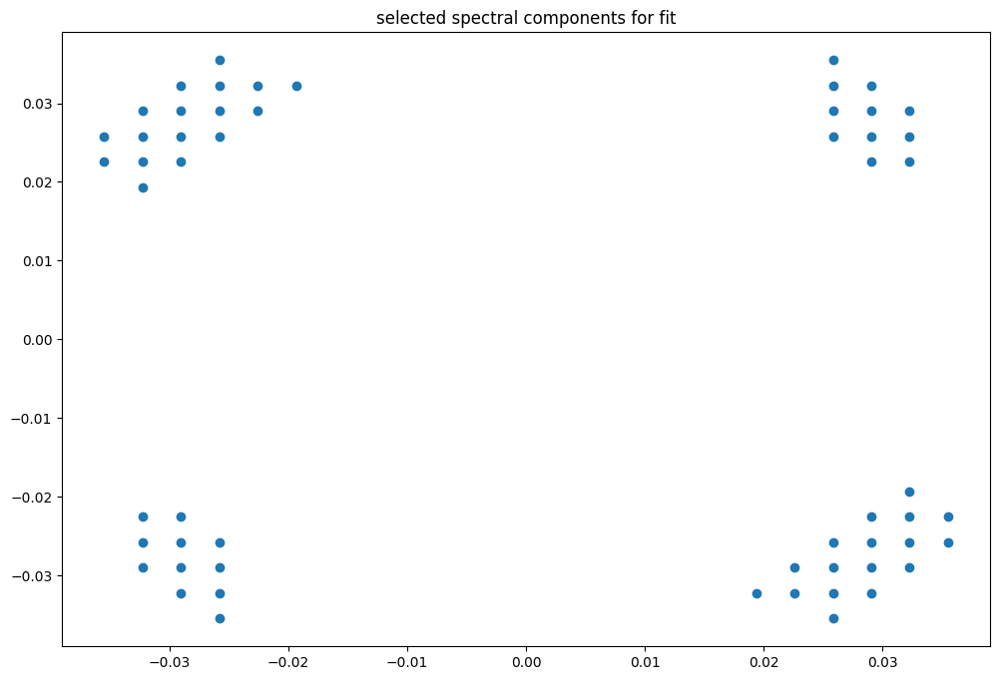

box [3500, 4000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

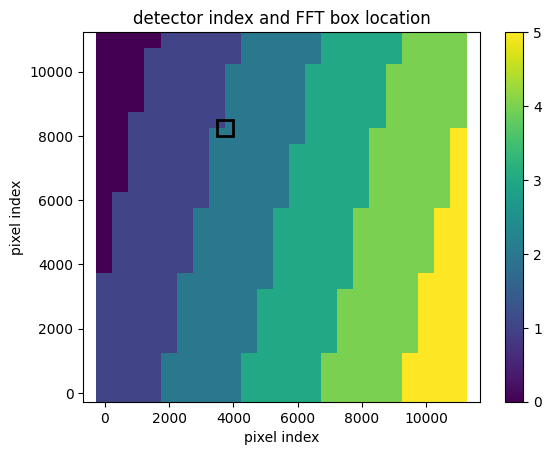

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.96
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


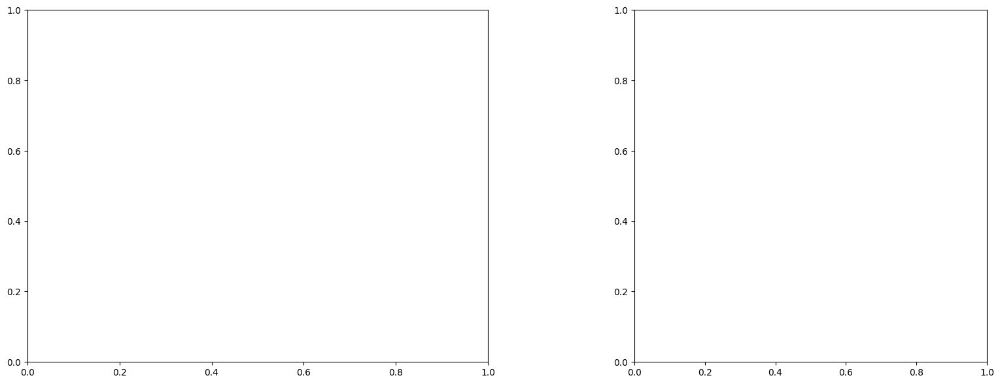

LinAlgError: Singular matrix

box [3500, 4000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

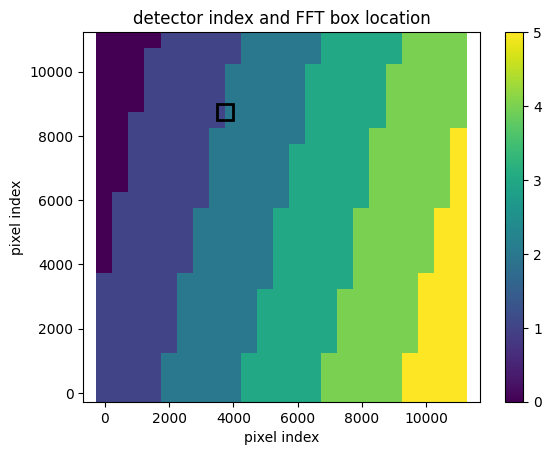

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


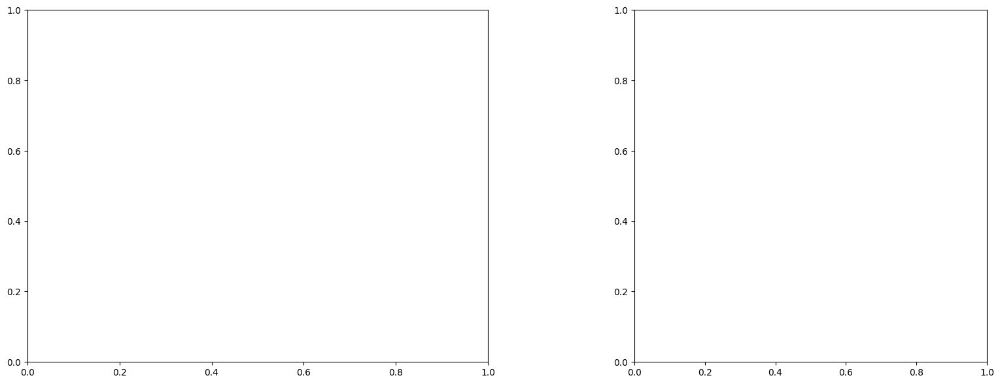

LinAlgError: Singular matrix

box [3500, 4000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

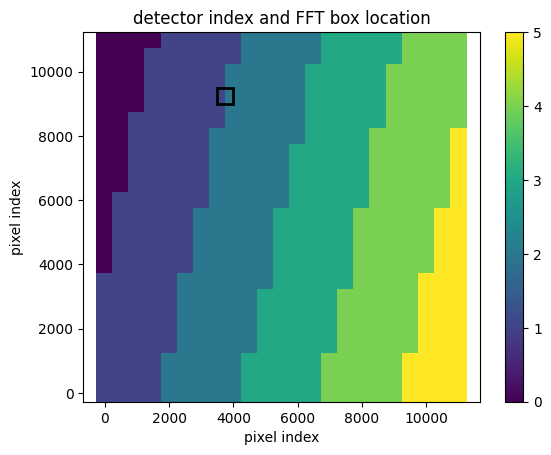

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


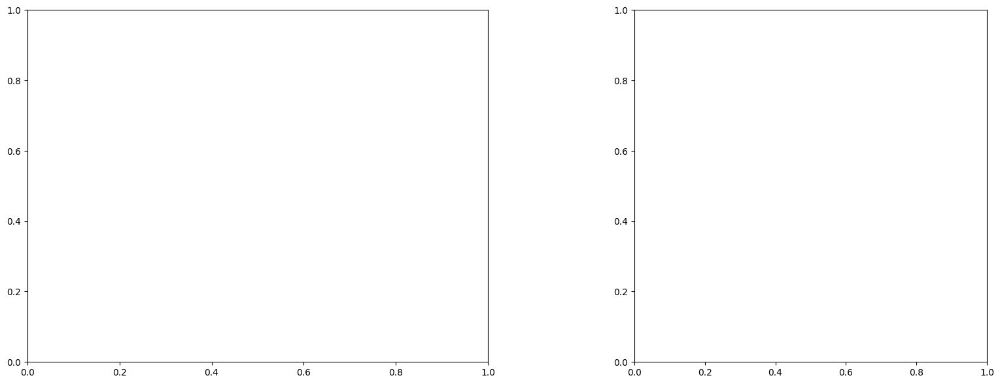

LinAlgError: Singular matrix

box [3500, 4000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

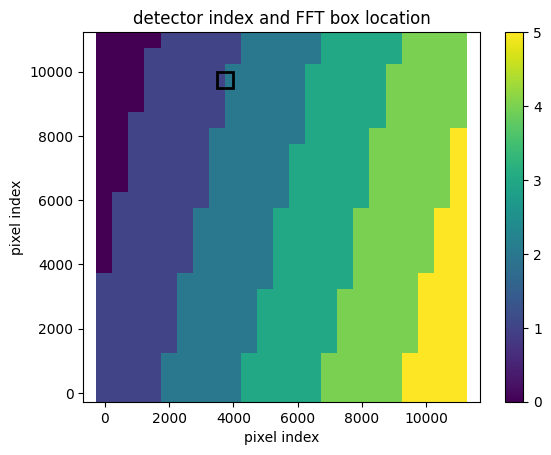

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


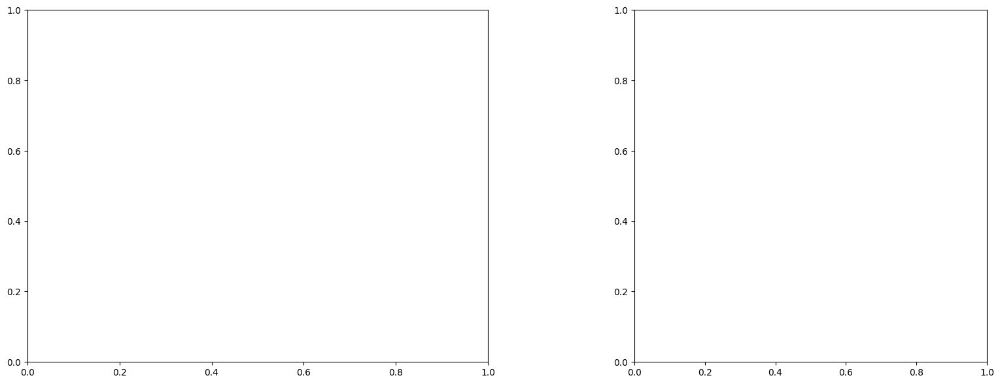

LinAlgError: Singular matrix

box [3500, 4000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

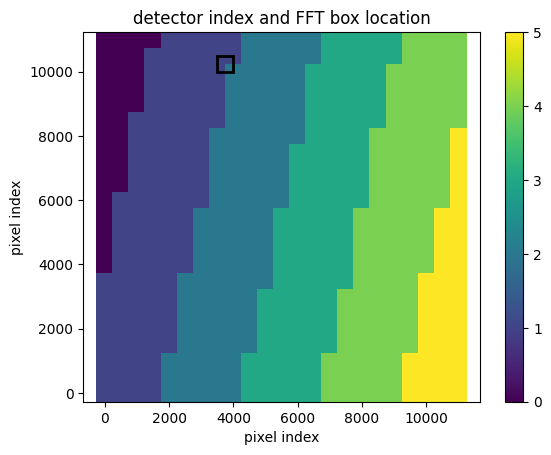

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(31, 31)
(31, 31)
(31, 31)


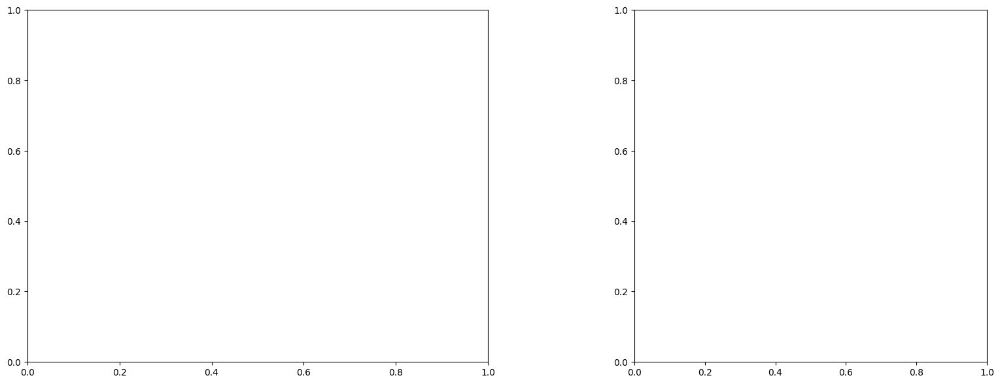

U and V components of current : [0.55863197 0.06203461]
uncertainties for U and V: 0.11692500665448259 0.12233552714957009


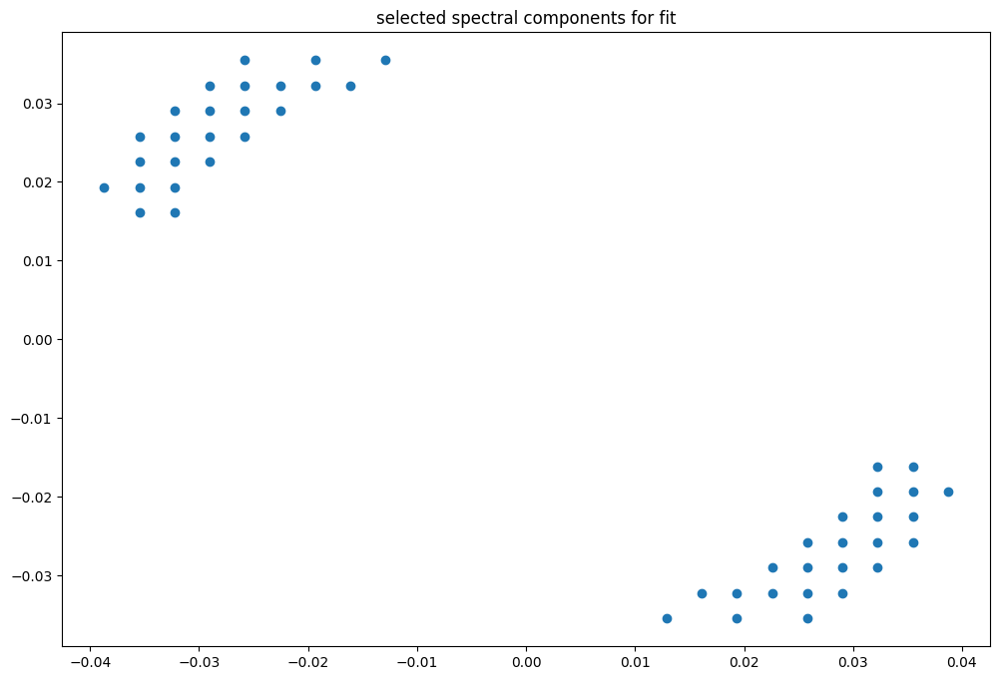

box [3500, 4000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

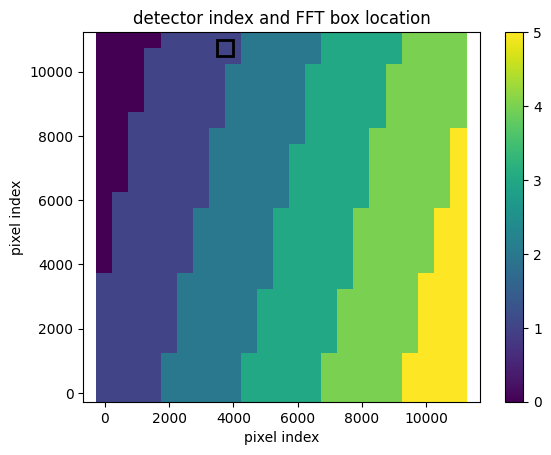

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(31, 30)
(31, 30)
(31, 30)


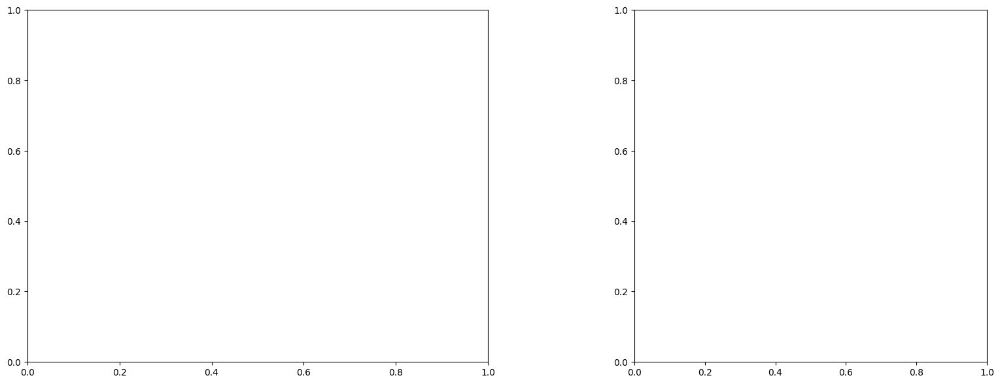

U and V components of current : [ 0.2176566  -0.43390707]
uncertainties for U and V: 0.10060820132754814 0.11779616217452223


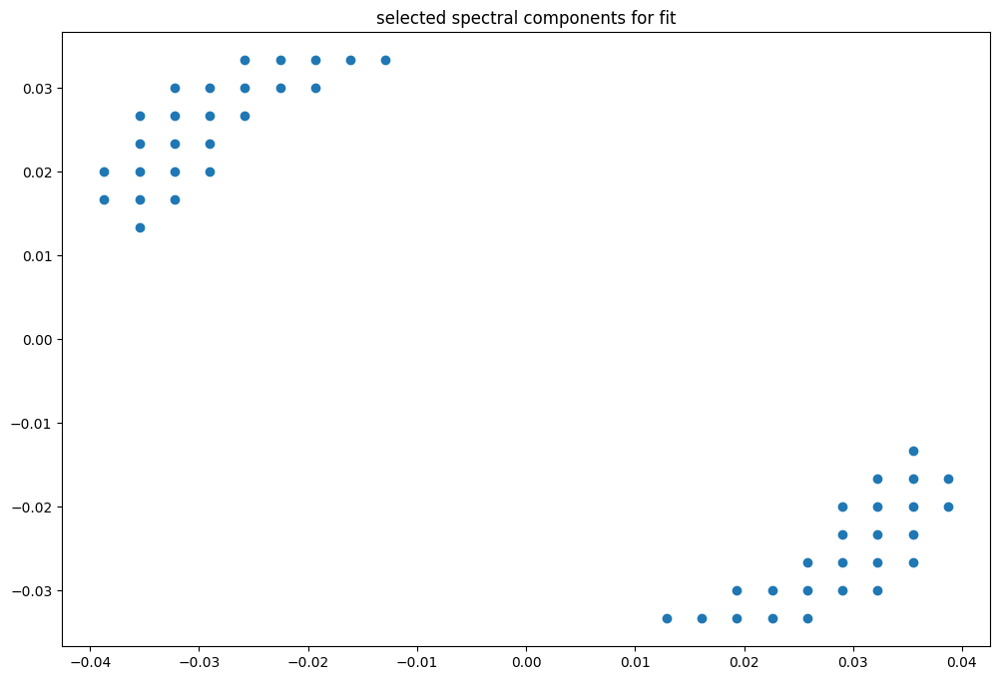

box [4000, 4500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

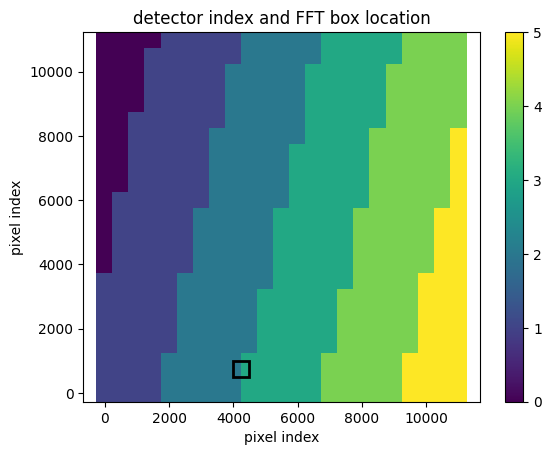

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091940302448317
(31, 31)
(31, 31)
(31, 31)


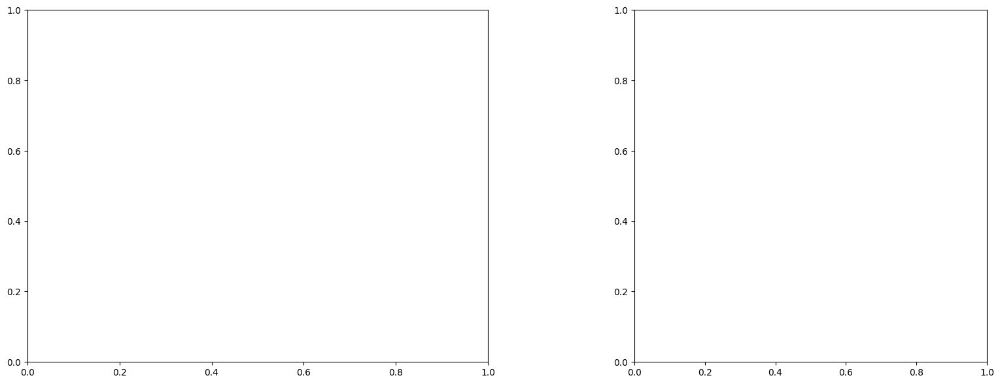

U and V components of current : [0.45764614 1.10993155]
uncertainties for U and V: 0.08876642843328811 0.09642726866459551


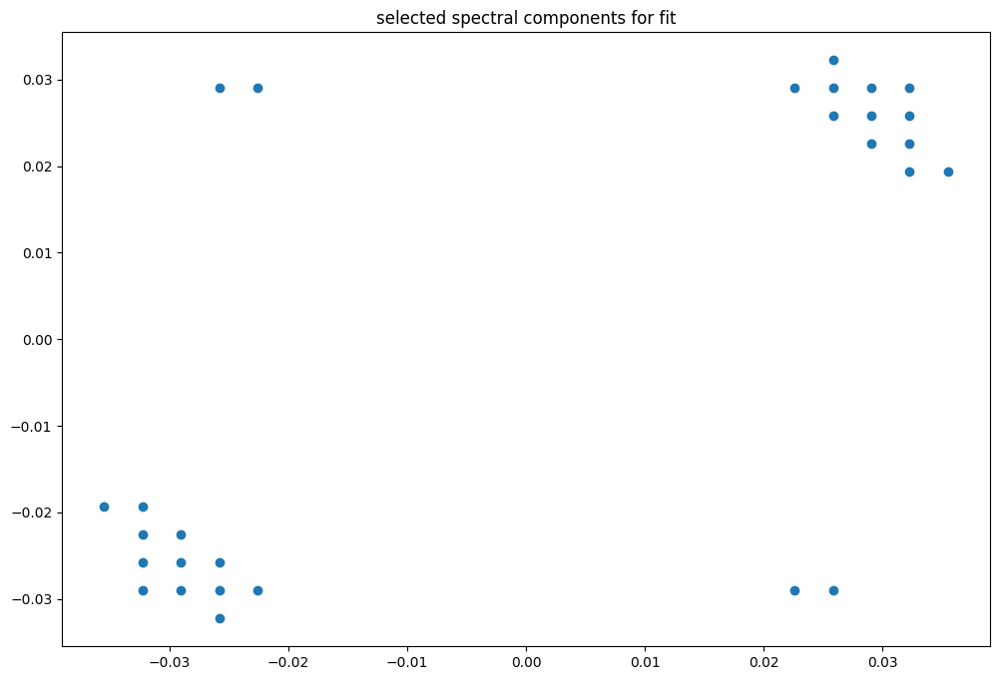

box [4000, 4500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

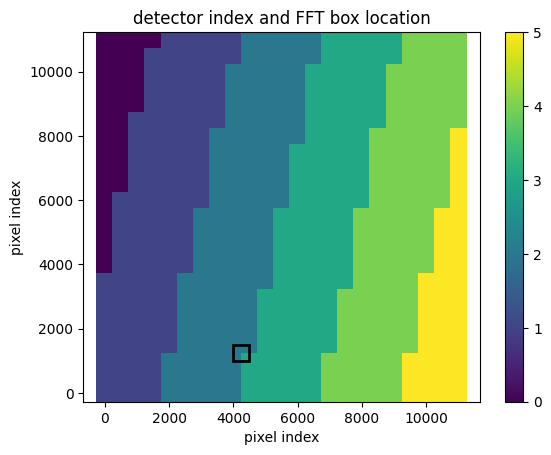

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


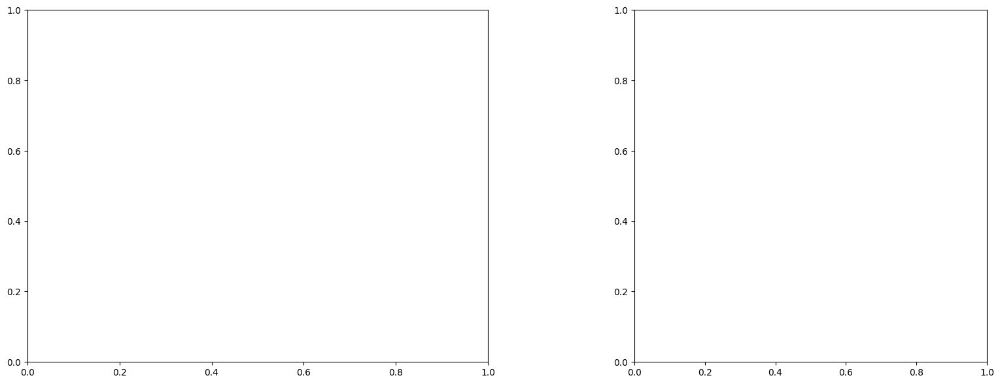

U and V components of current : [0.57092966 1.12502518]
uncertainties for U and V: 0.05340959296352608 0.059456037238294346


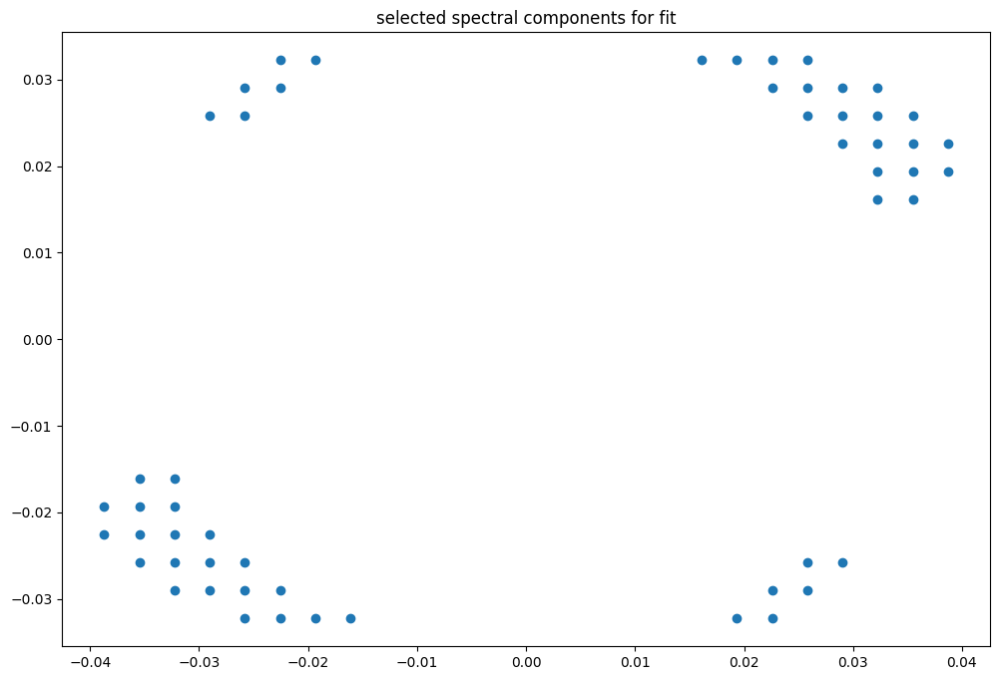

box [4000, 4500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

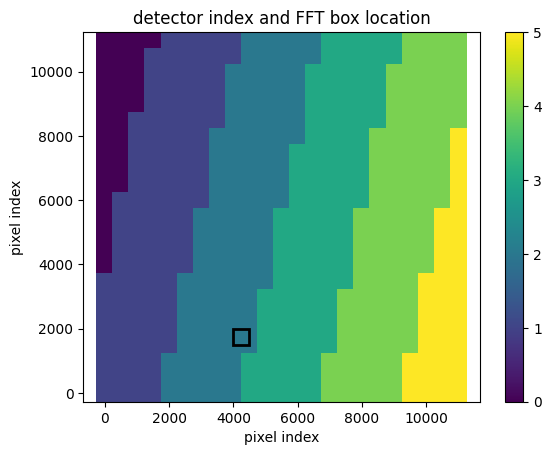

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


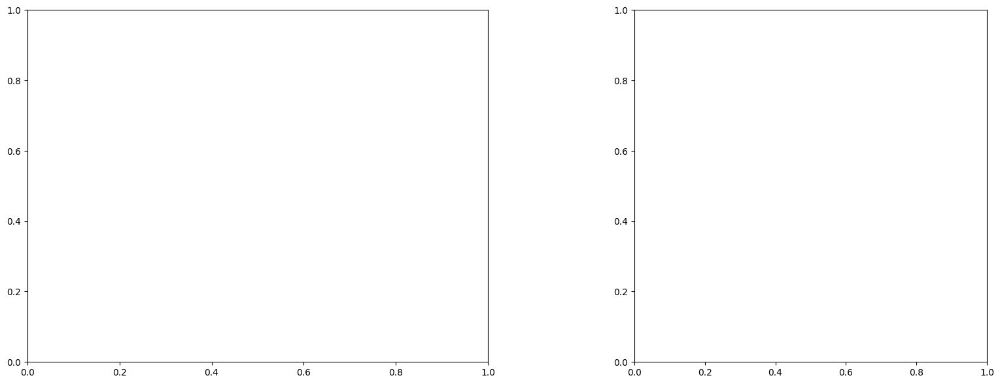

U and V components of current : [0.596405 1.075654]
uncertainties for U and V: 0.050909663970112956 0.049033788912958905


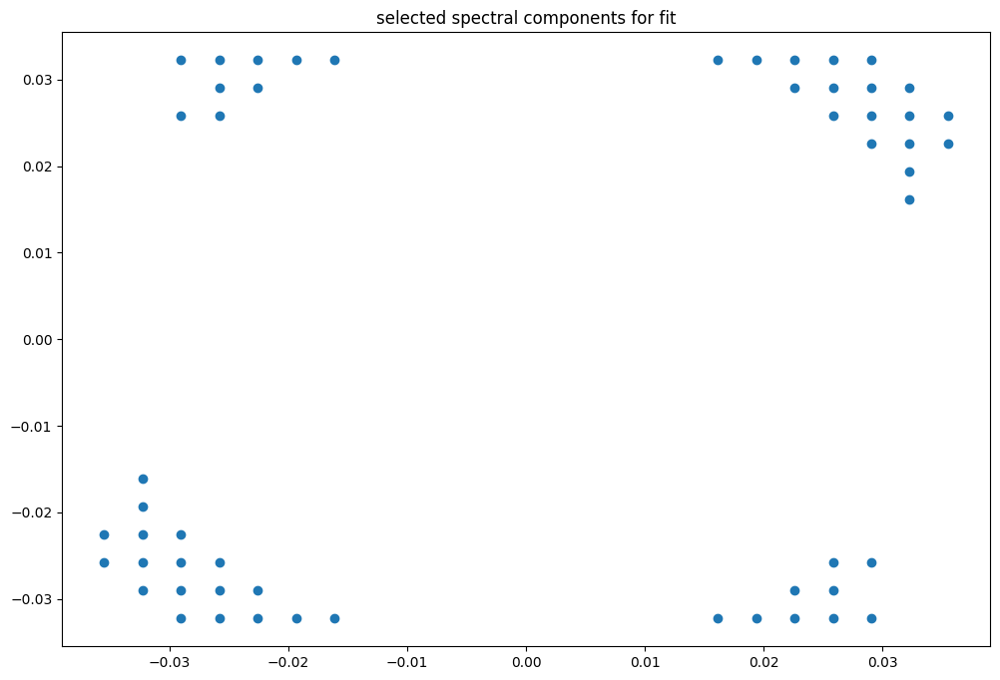

box [4000, 4500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

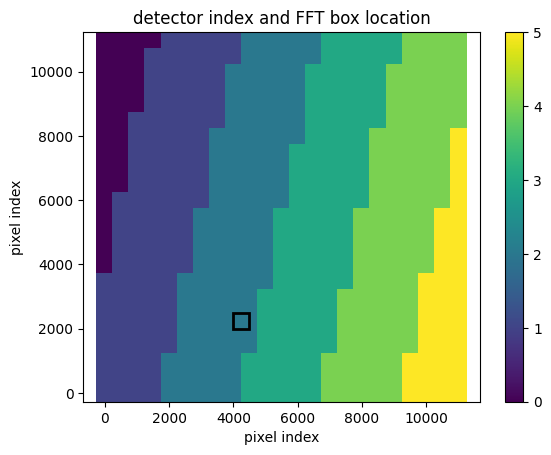

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


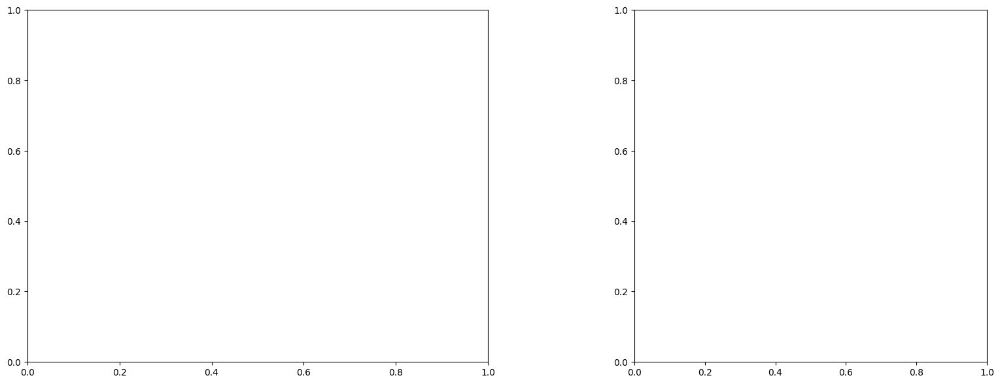

U and V components of current : [0.79540737 0.79014825]
uncertainties for U and V: 0.05437217824439562 0.04855701862843924


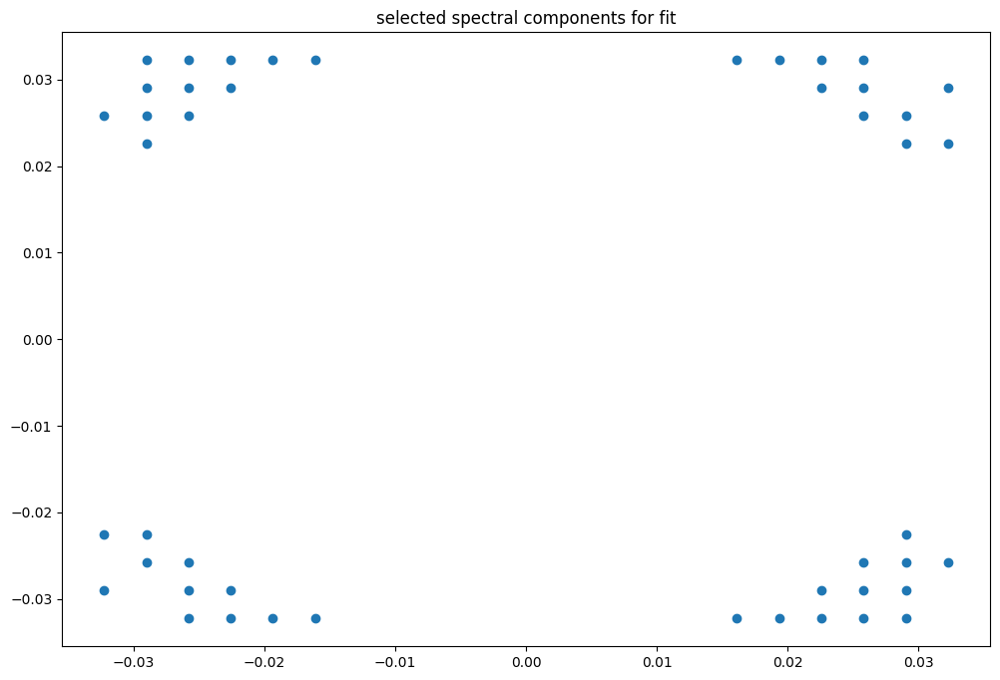

box [4000, 4500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

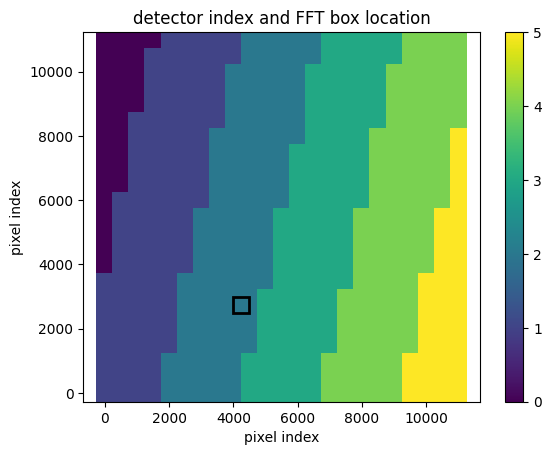

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


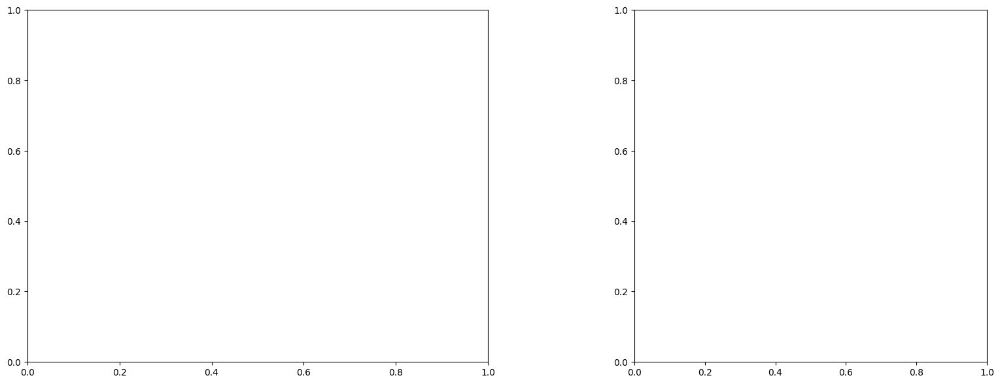

U and V components of current : [0.80991325 0.95954586]
uncertainties for U and V: 0.13355737386472488 0.11709838741780575


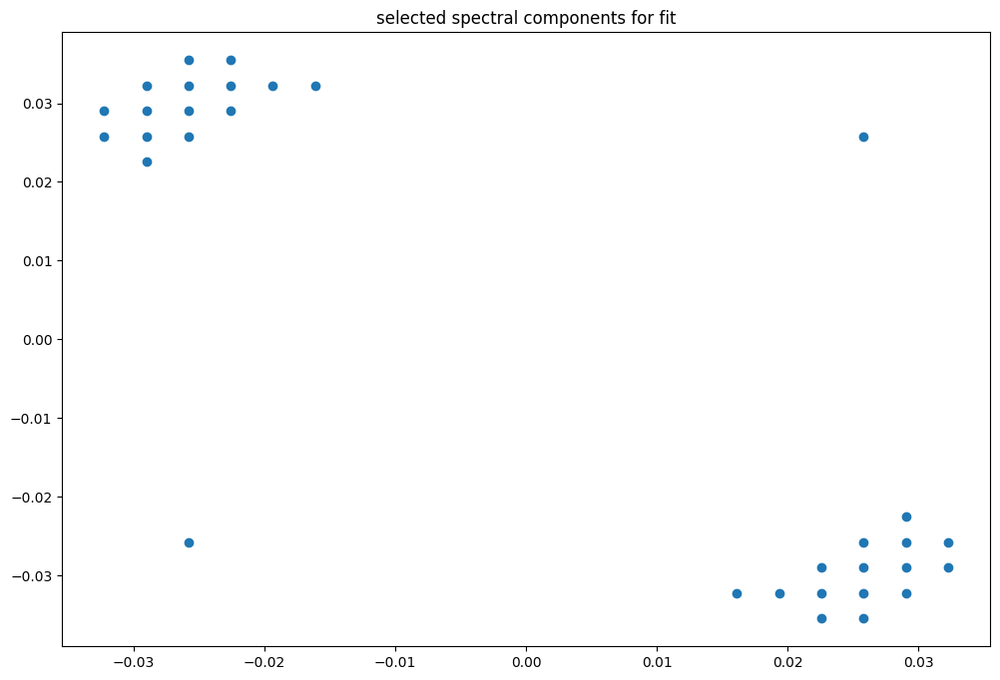

box [4000, 4500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

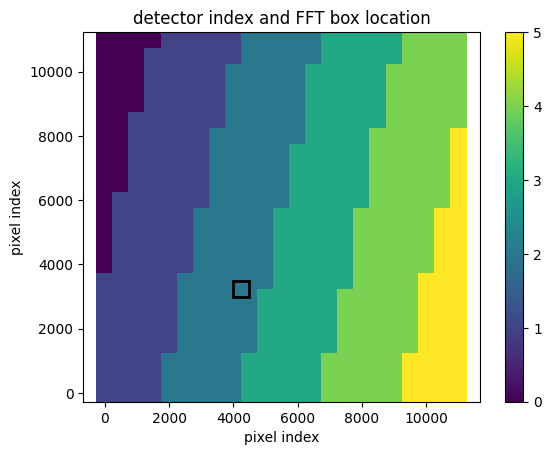

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


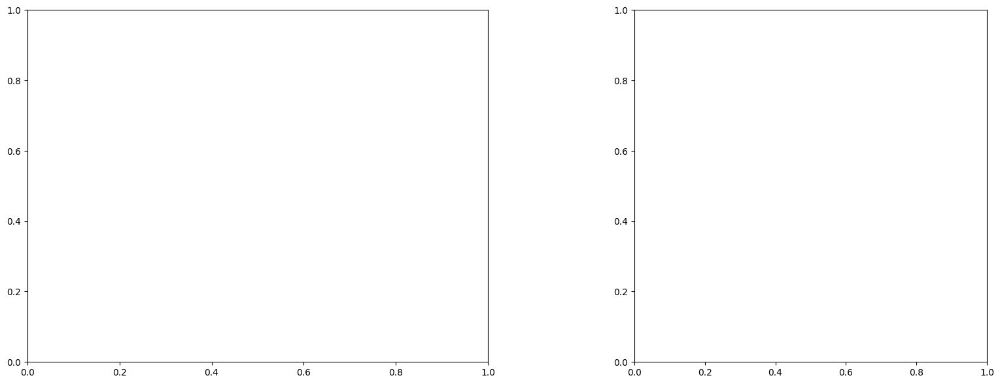

U and V components of current : [0.72364877 0.73985019]
uncertainties for U and V: 0.1865456663720787 0.16400883783272116


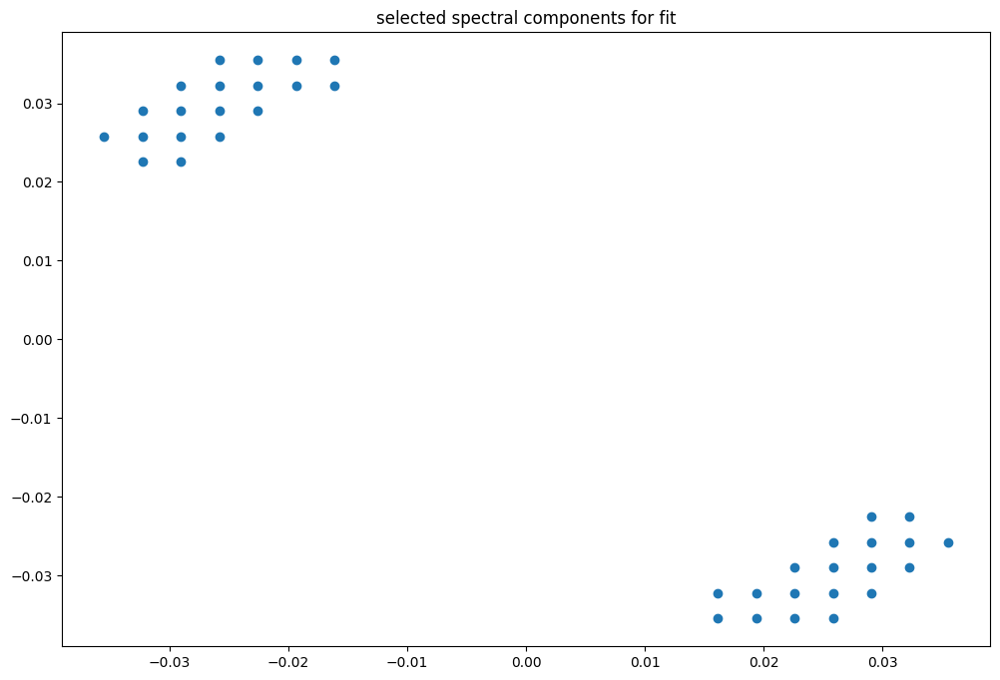

box [4000, 4500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

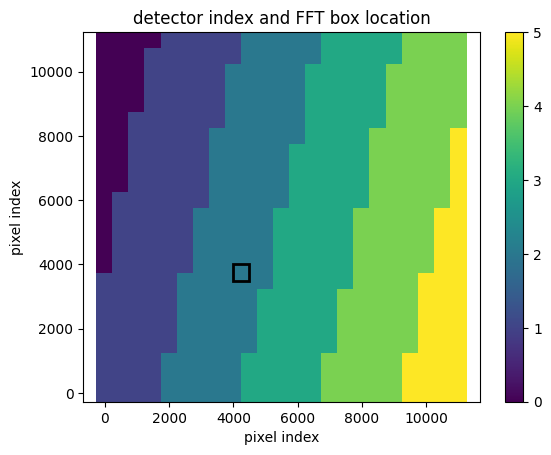

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


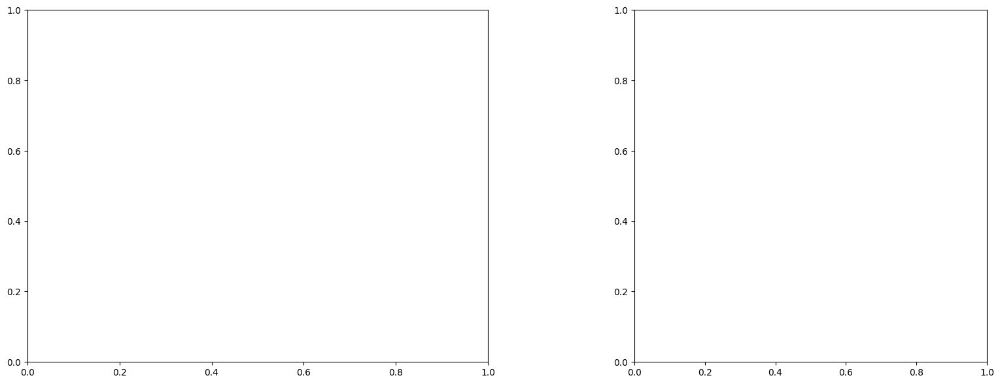

U and V components of current : [0.49683364 0.51203372]
uncertainties for U and V: 0.20235169083864024 0.17185937739819854


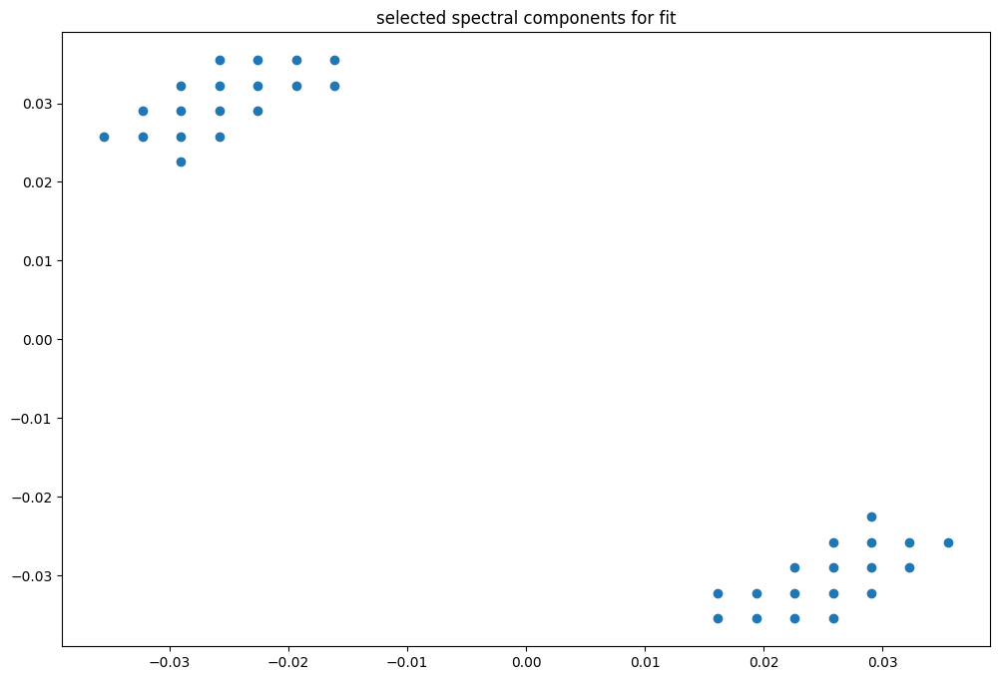

box [4000, 4500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

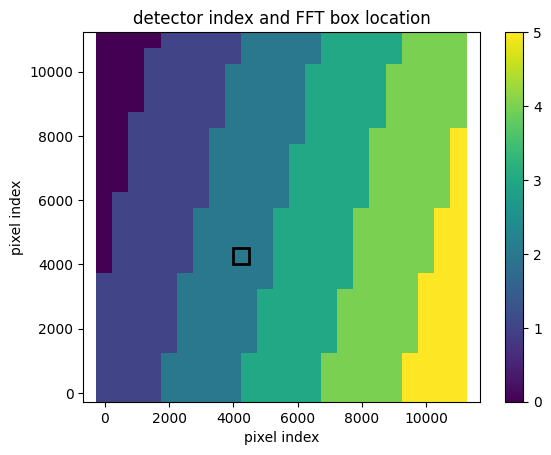

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


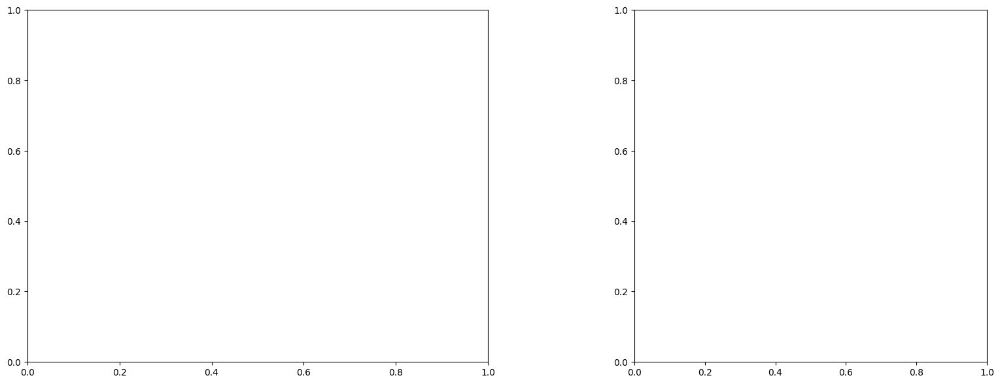

U and V components of current : [0.28036319 0.11947939]
uncertainties for U and V: 0.35779917635445874 0.28182190741903596


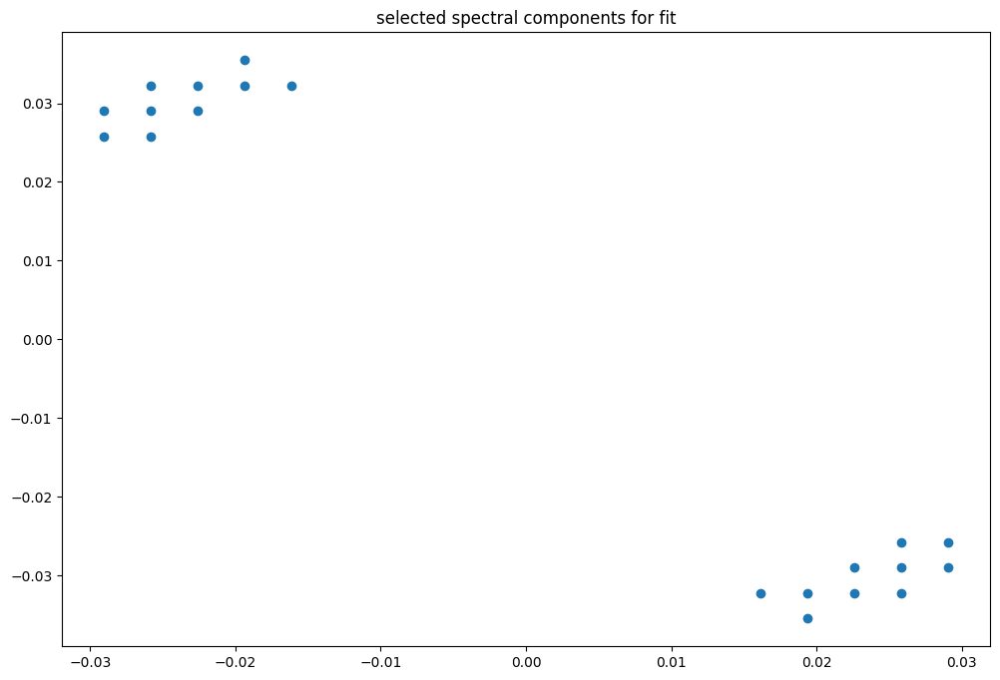

box [4000, 4500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

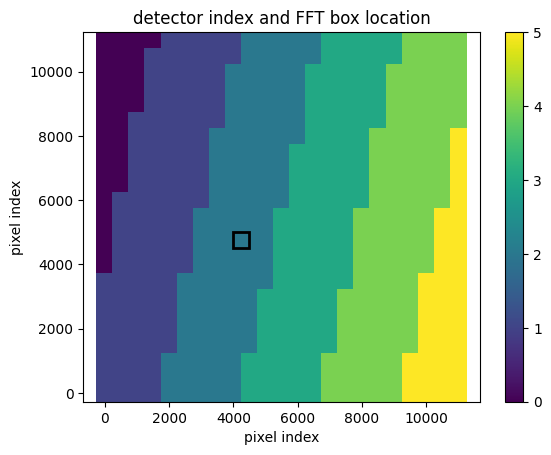

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


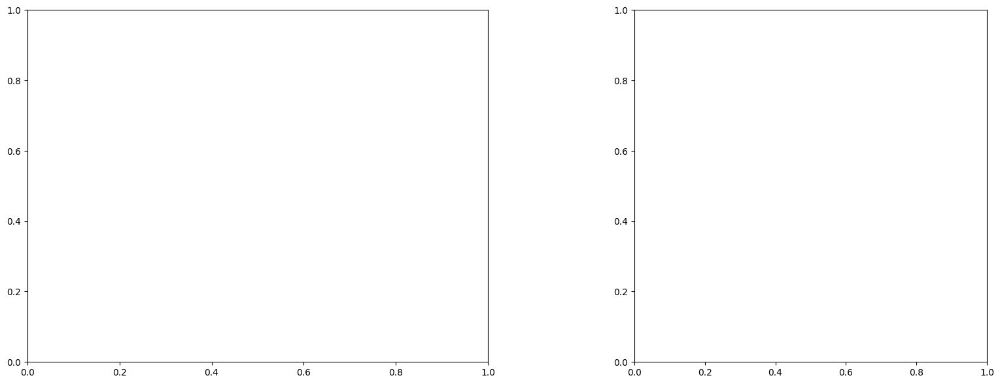

U and V components of current : [0.220685   0.10657328]
uncertainties for U and V: 0.1340251062567842 0.12160931041629701


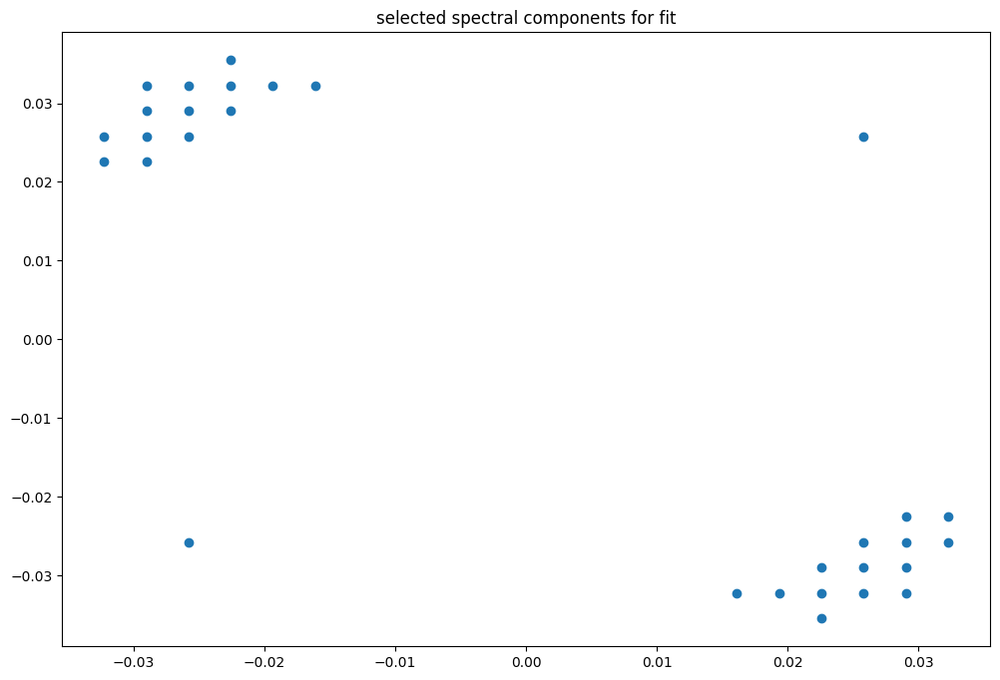

box [4000, 4500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

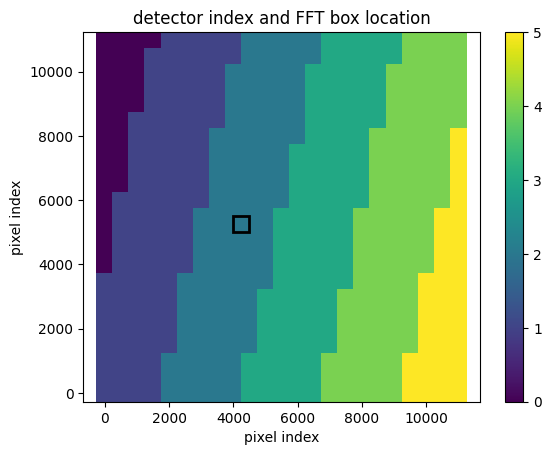

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


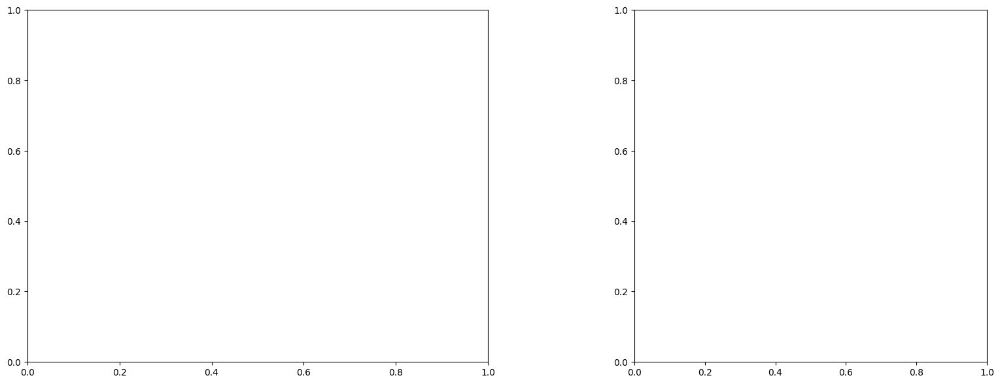

U and V components of current : [0.98111259 0.83627073]
uncertainties for U and V: 1.0604650373009241 1.0326166562432448


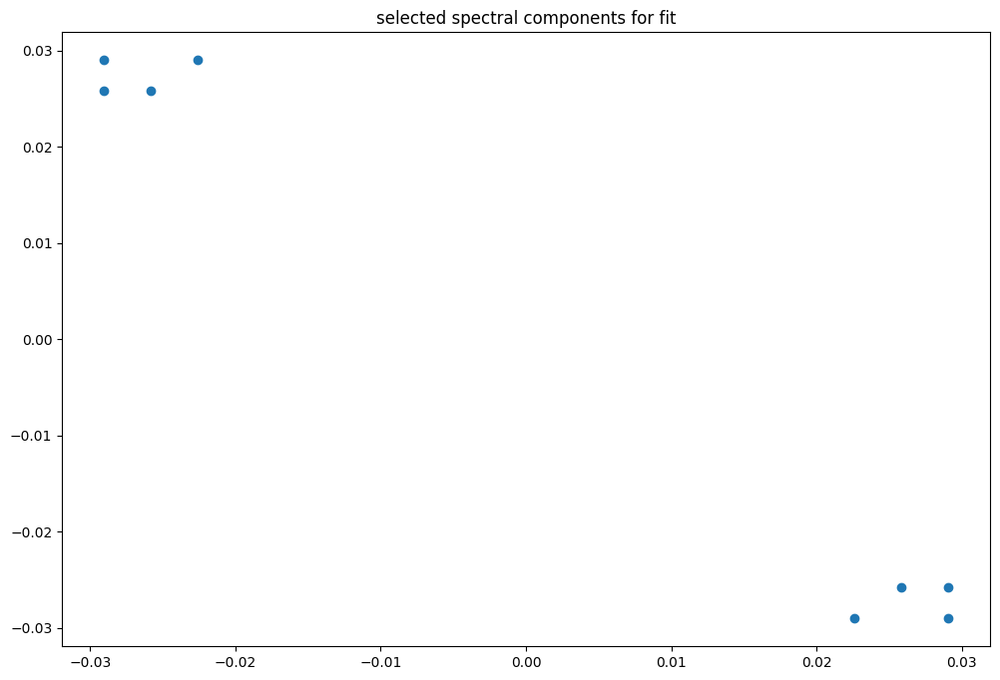

box [4000, 4500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

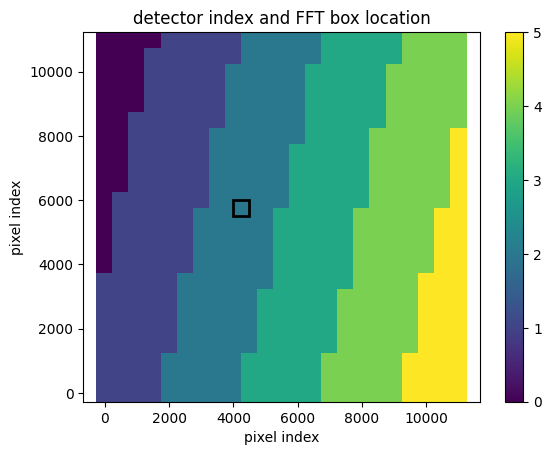

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


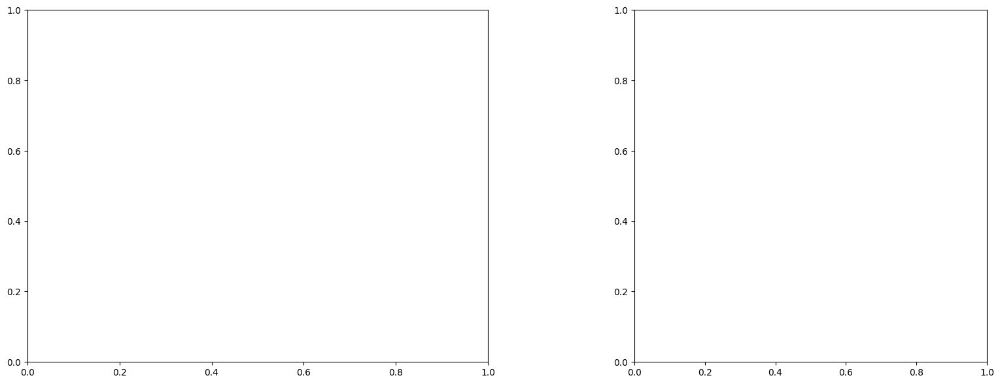

LinAlgError: Singular matrix

box [4000, 4500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

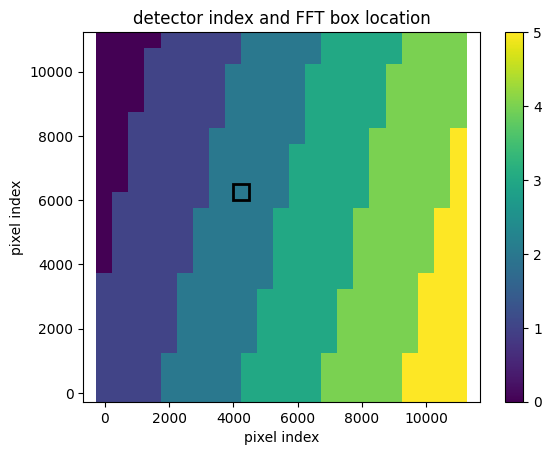

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


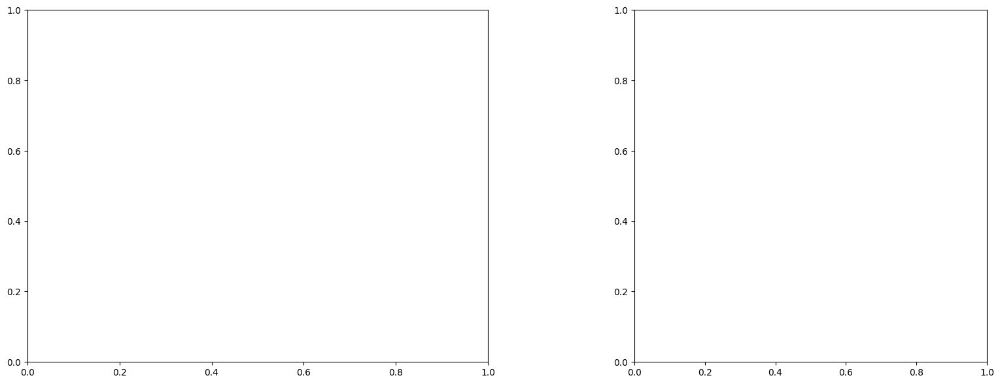

LinAlgError: Singular matrix

box [4000, 4500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

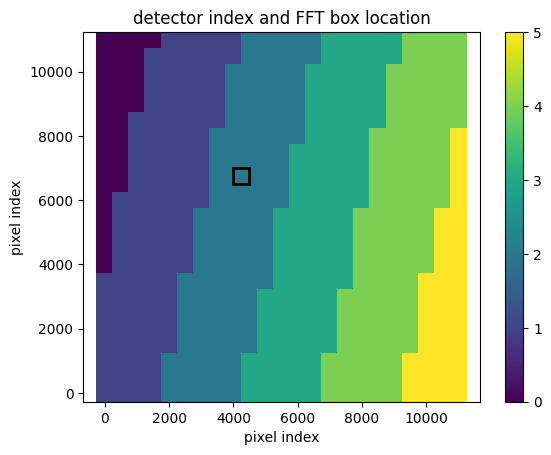

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


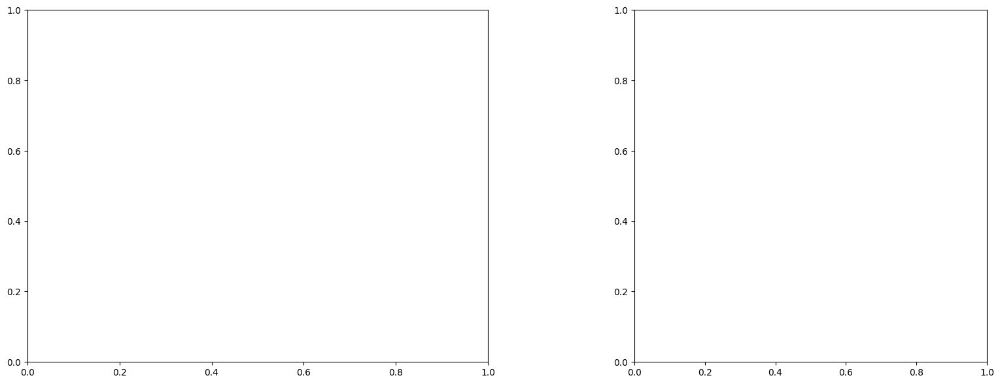

LinAlgError: Singular matrix

box [4000, 4500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

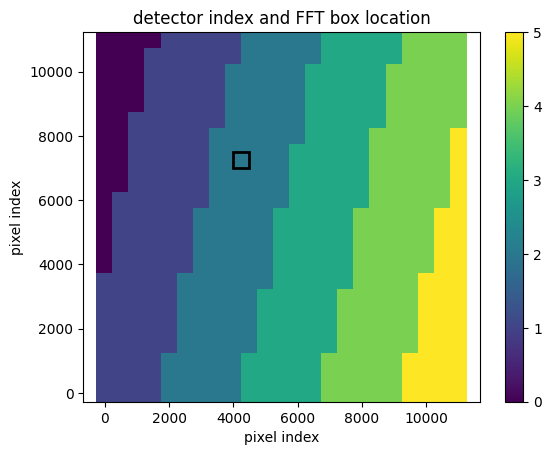

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


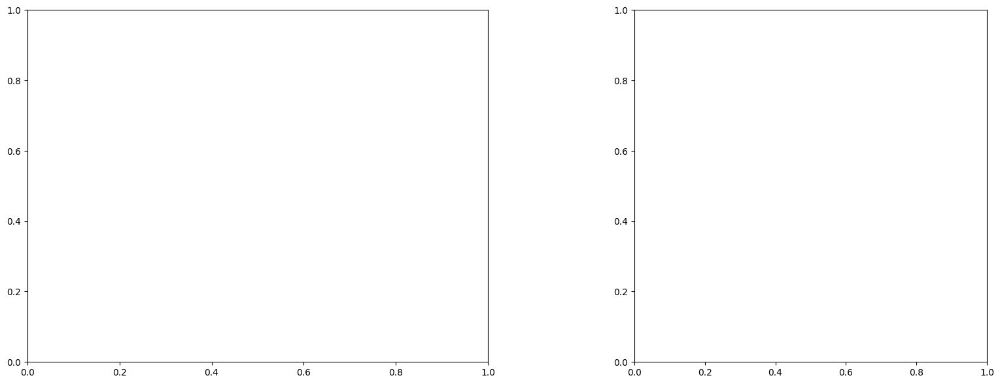

U and V components of current : [0.43676991 0.64807285]
uncertainties for U and V: 0.1611477919504574 0.15981161820166848


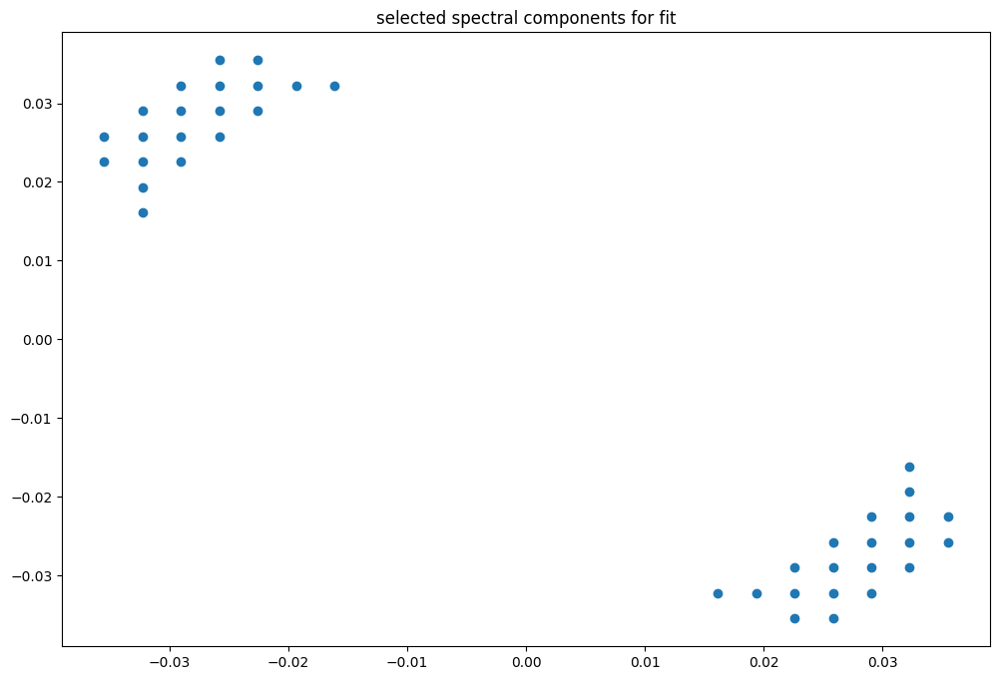

box [4000, 4500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

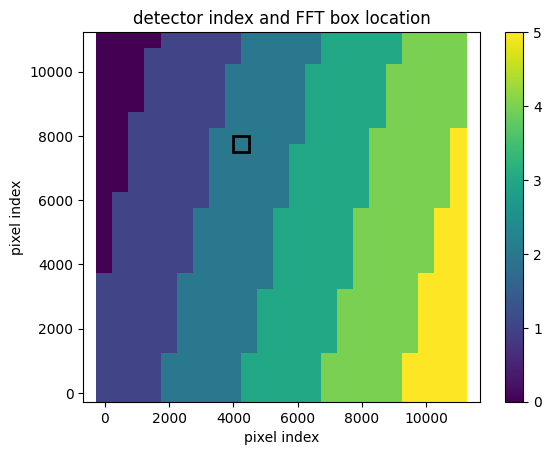

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


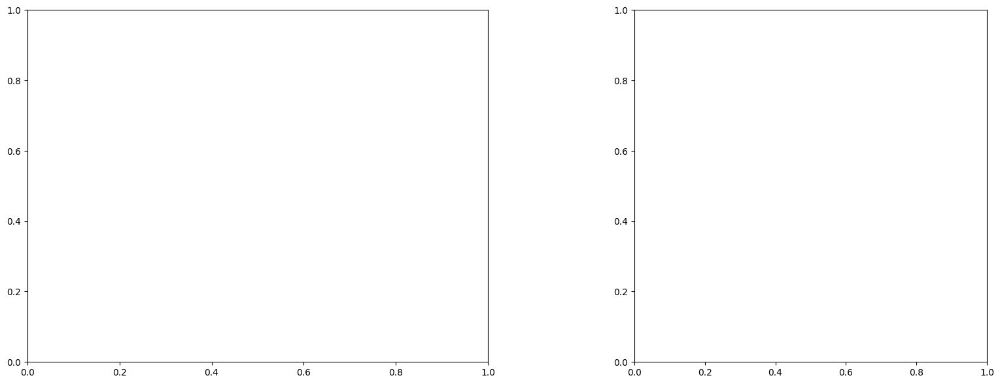

U and V components of current : [-0.1534255  -0.23029179]
uncertainties for U and V: 0.04461238375167812 0.042857775178695025


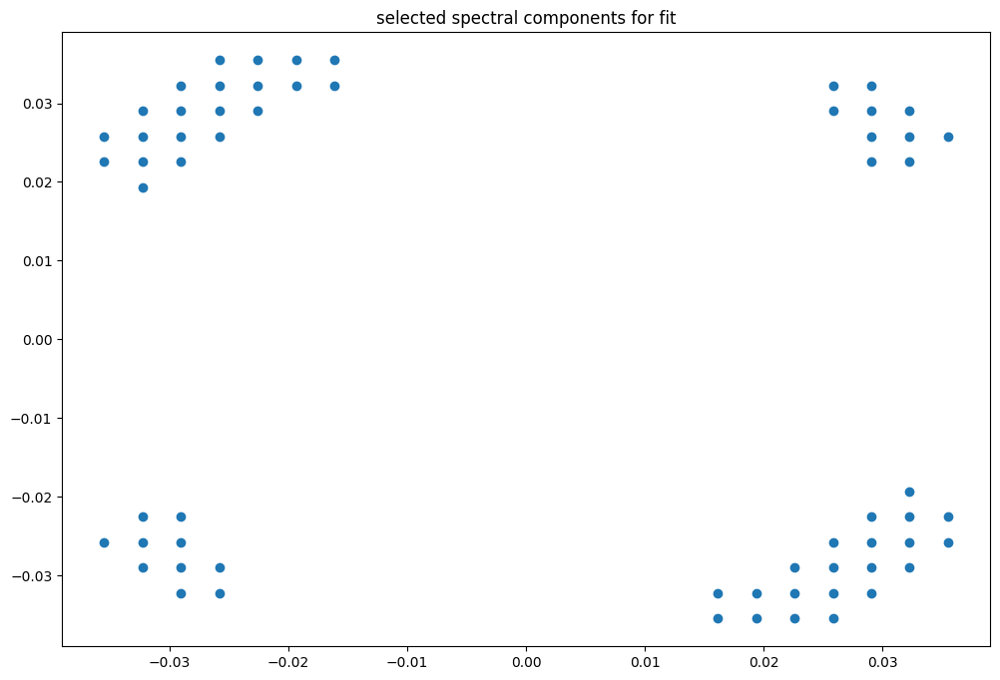

box [4000, 4500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

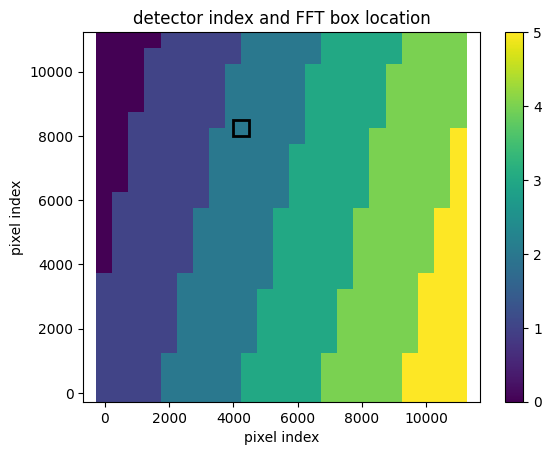

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


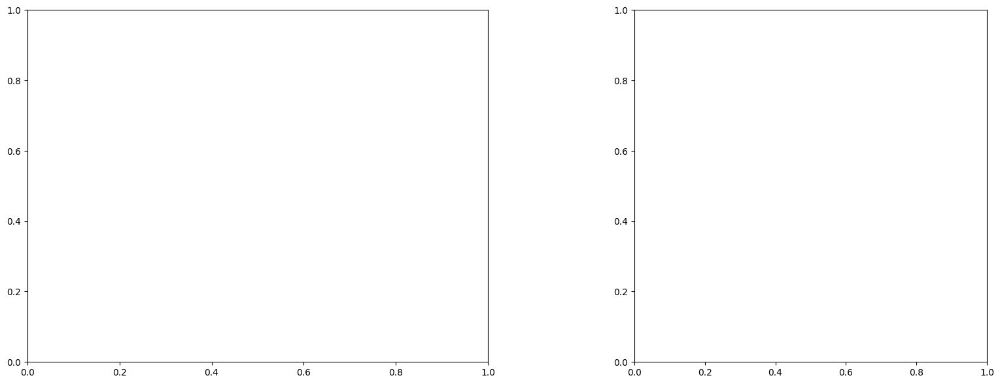

U and V components of current : [-0.16307266 -0.36200622]
uncertainties for U and V: 0.03652571130655017 0.03370747427285355


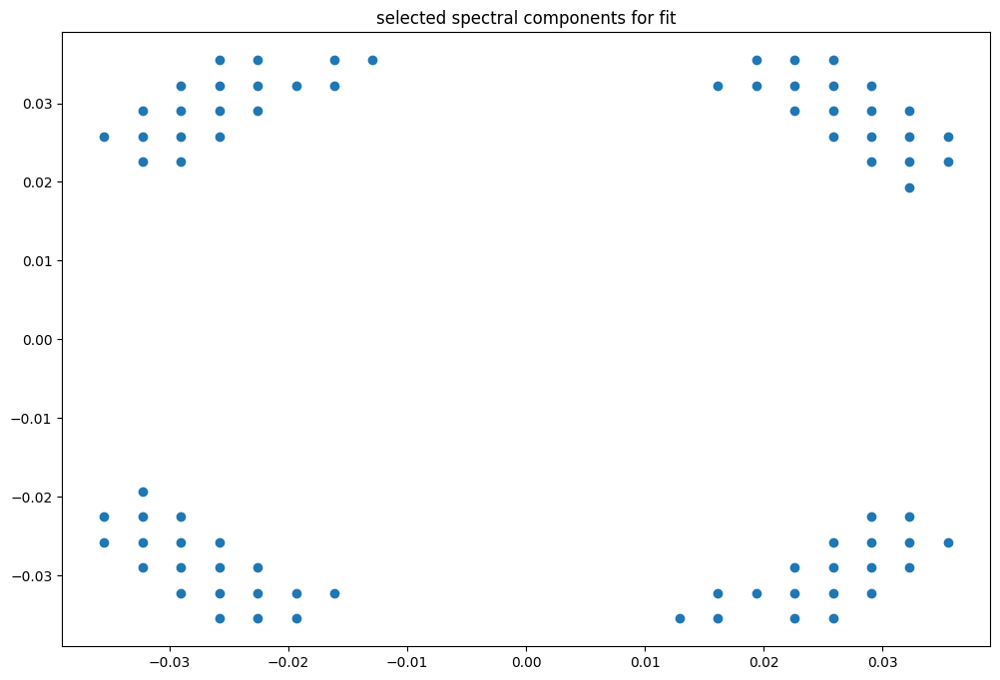

box [4000, 4500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

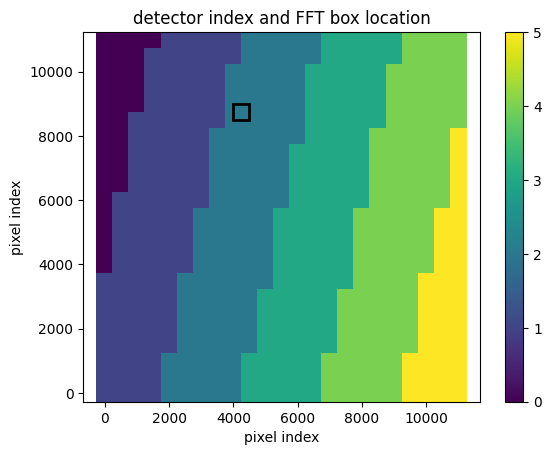

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


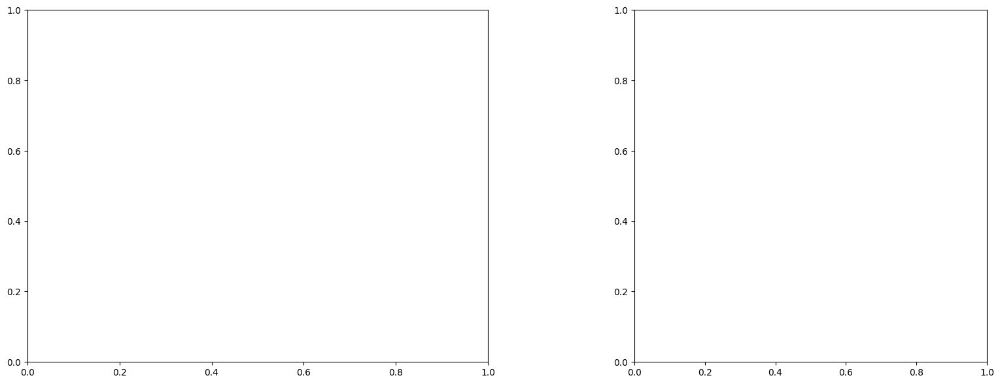

U and V components of current : [-0.00943055 -0.28928908]
uncertainties for U and V: 0.039955899186786076 0.03650761546302101


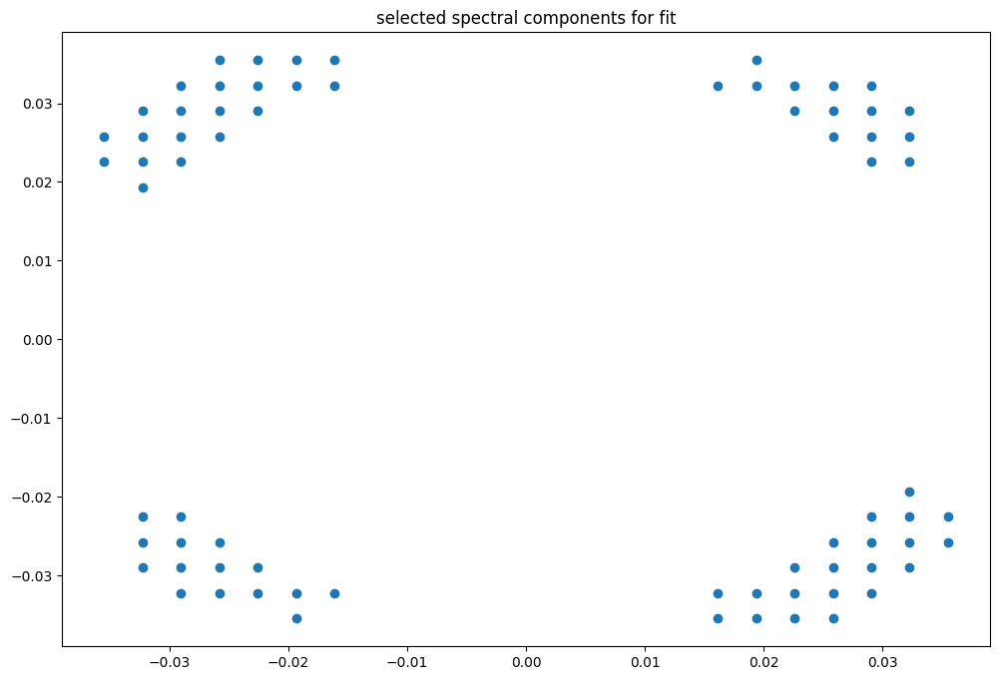

box [4000, 4500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

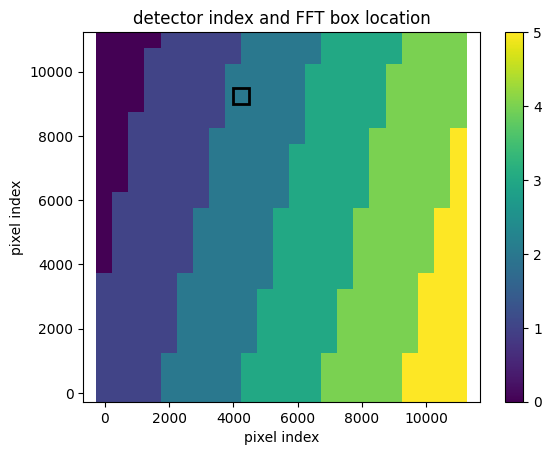

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


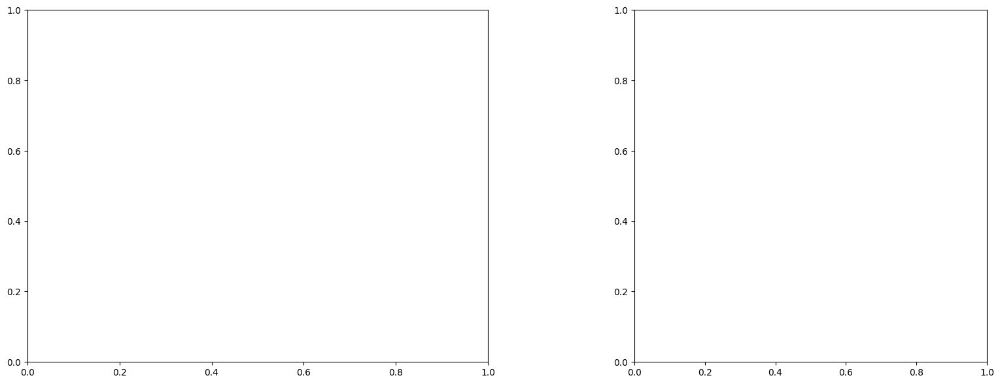

U and V components of current : [ 0.15985147 -0.0863004 ]
uncertainties for U and V: 0.053658361977891346 0.04951369178563713


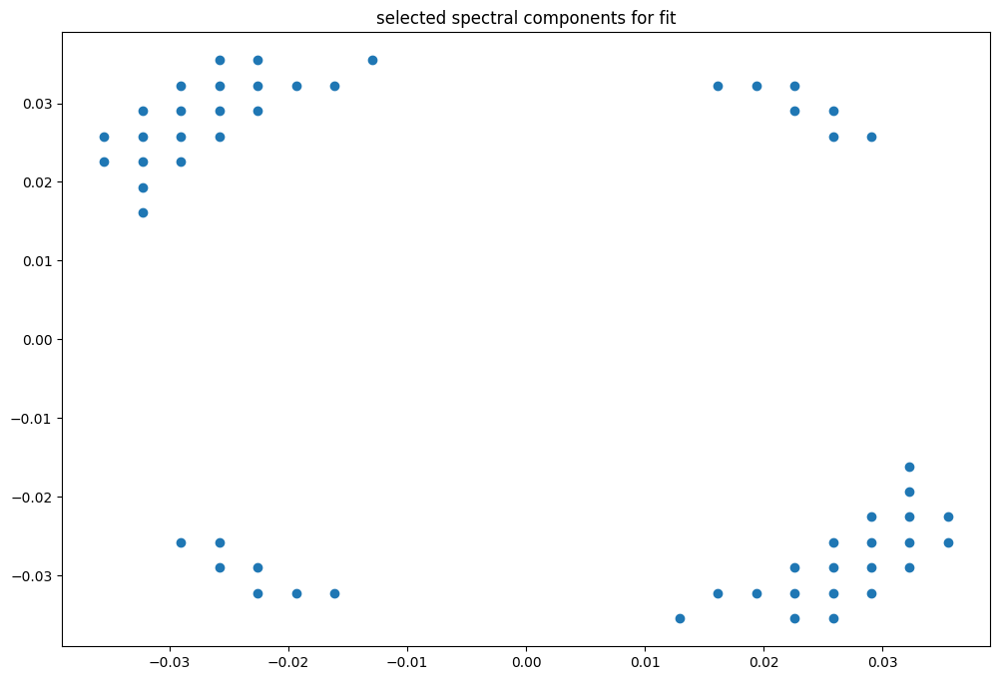

box [4000, 4500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

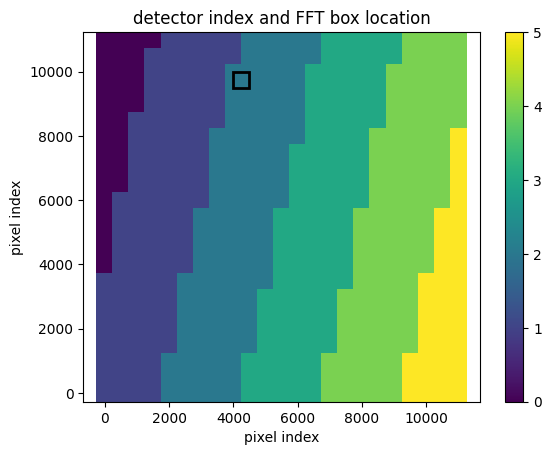

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


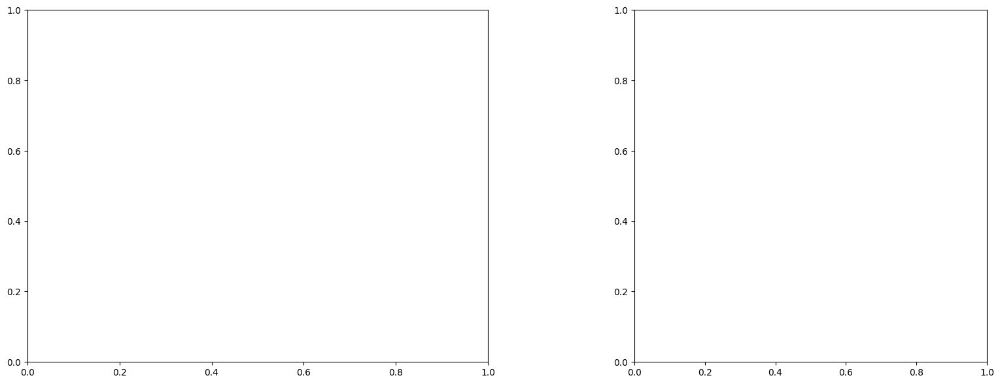

U and V components of current : [ 0.24748087 -0.13337252]
uncertainties for U and V: 0.07750036031648383 0.07639067157020071


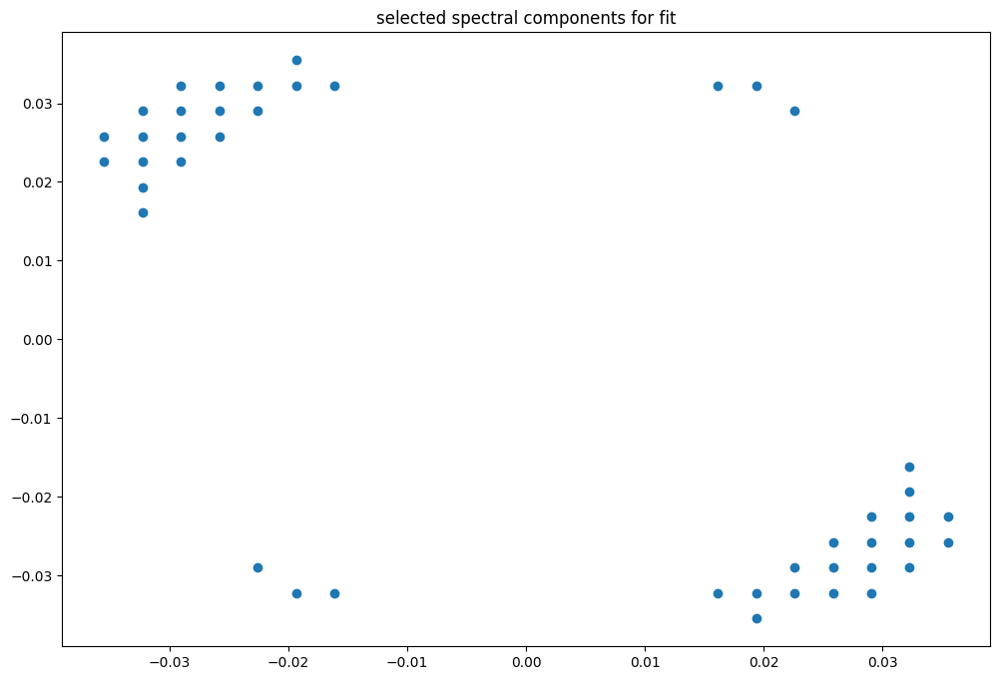

box [4000, 4500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

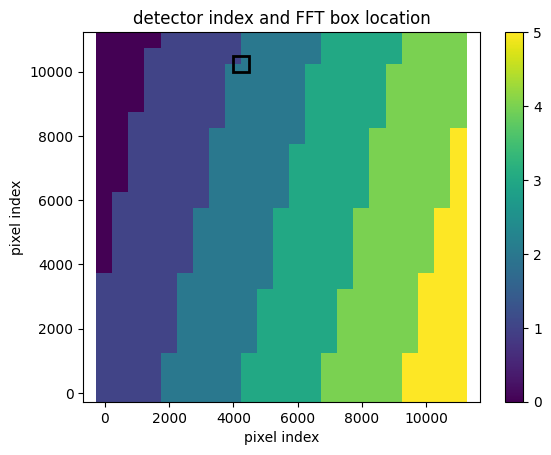

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


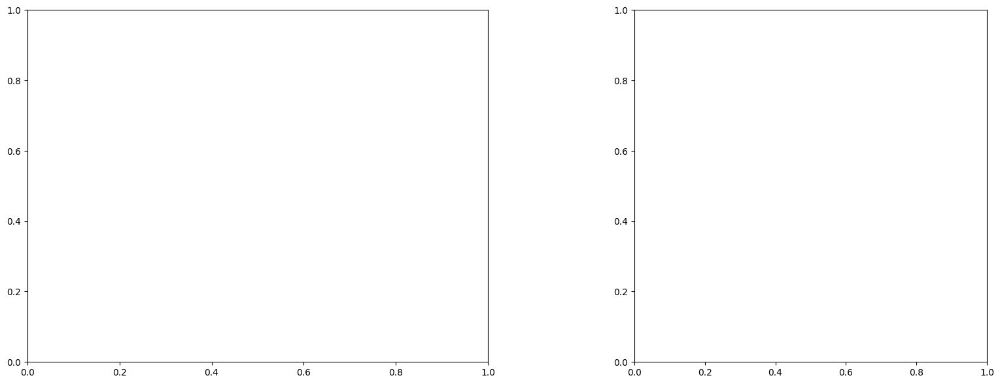

U and V components of current : [0.84461651 0.56604641]
uncertainties for U and V: 0.520029945673474 0.6841247403845645


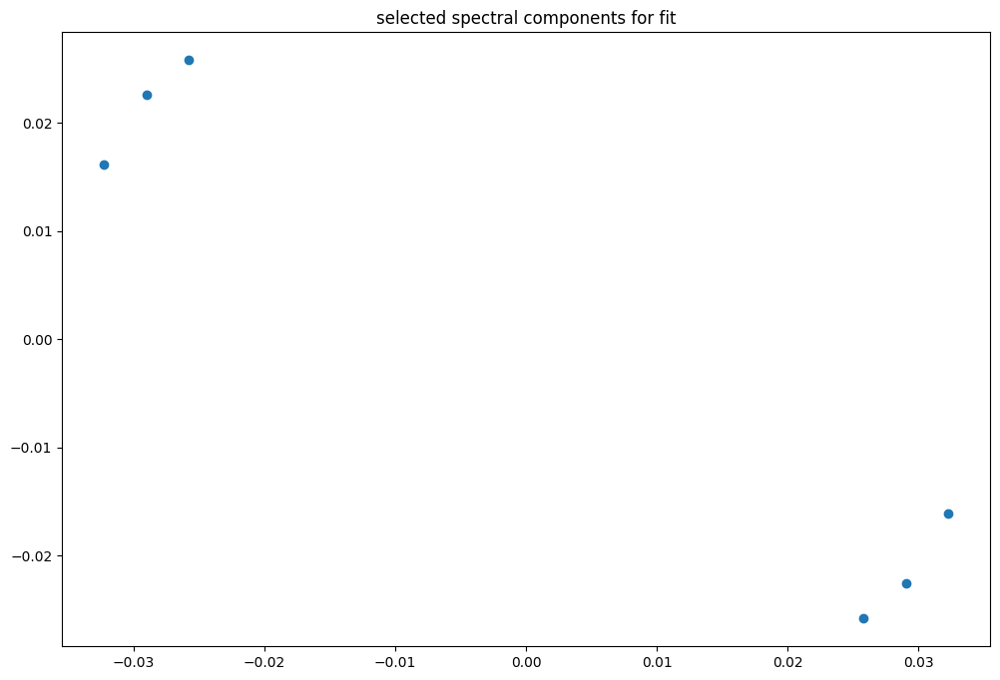

box [4000, 4500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

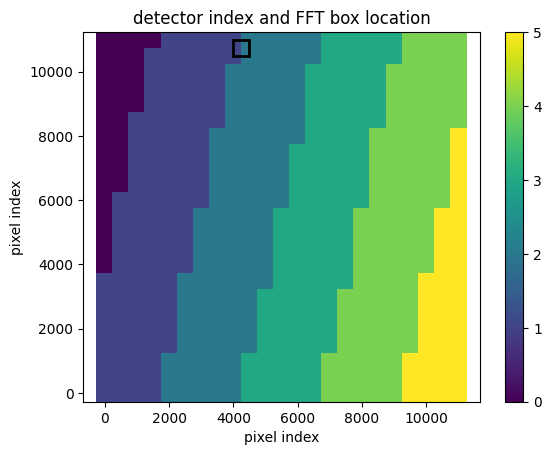

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 30)
(31, 30)
(31, 30)


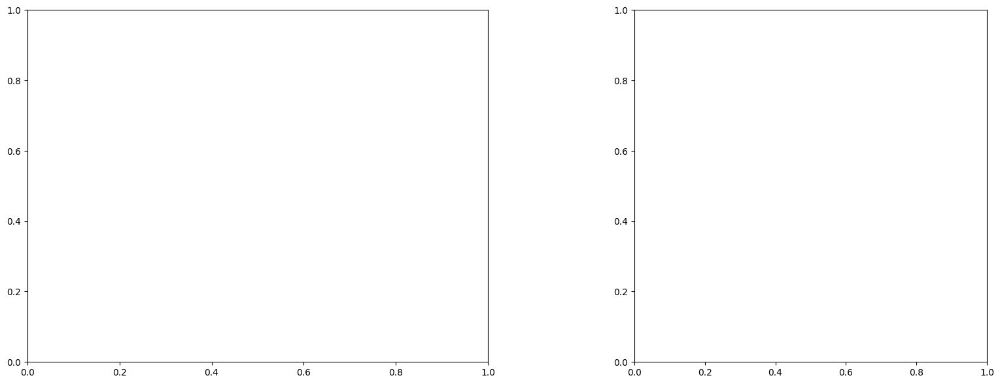

LinAlgError: Singular matrix

box [4500, 5000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

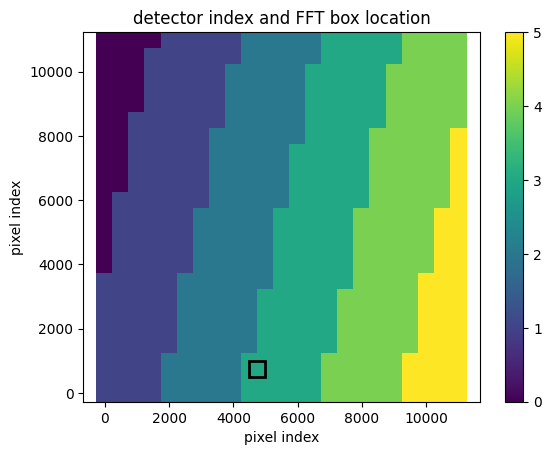

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948049337217942
(31, 31)
(31, 31)
(31, 31)


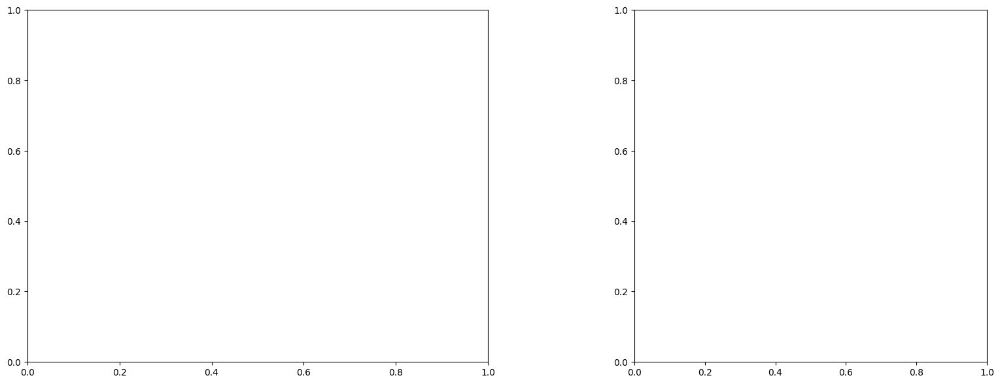

U and V components of current : [0.9415364  0.89972222]
uncertainties for U and V: 0.07226495206819837 0.07165542273449178


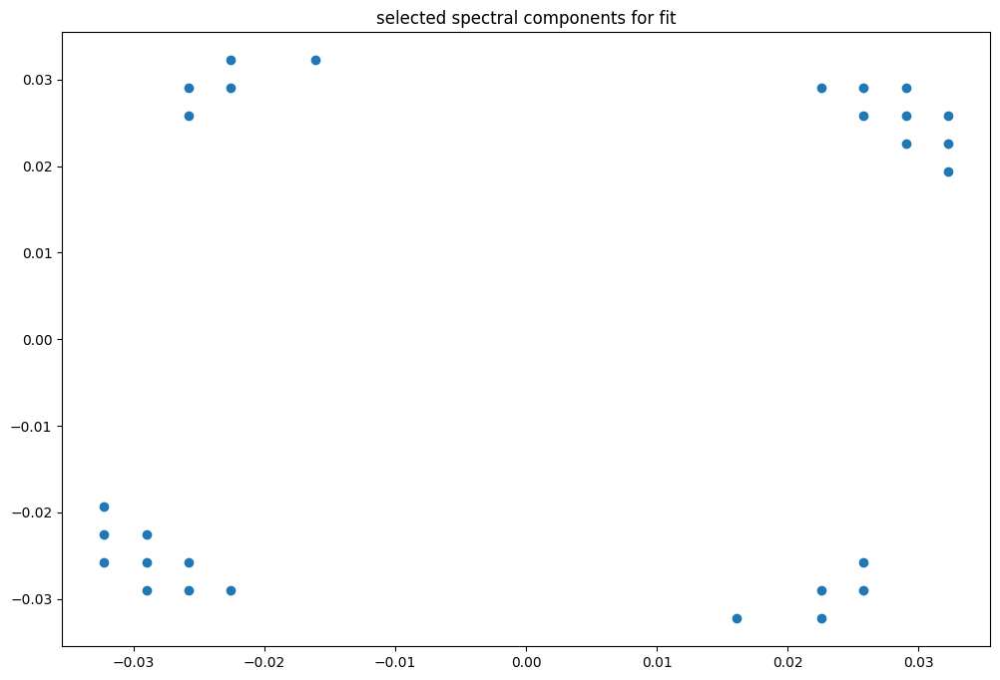

box [4500, 5000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

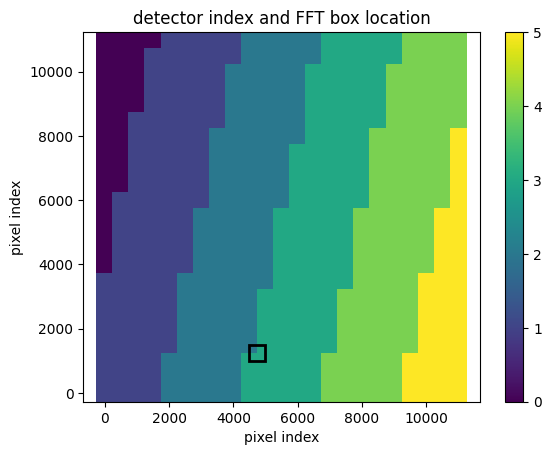

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091906645560362
(31, 31)
(31, 31)
(31, 31)


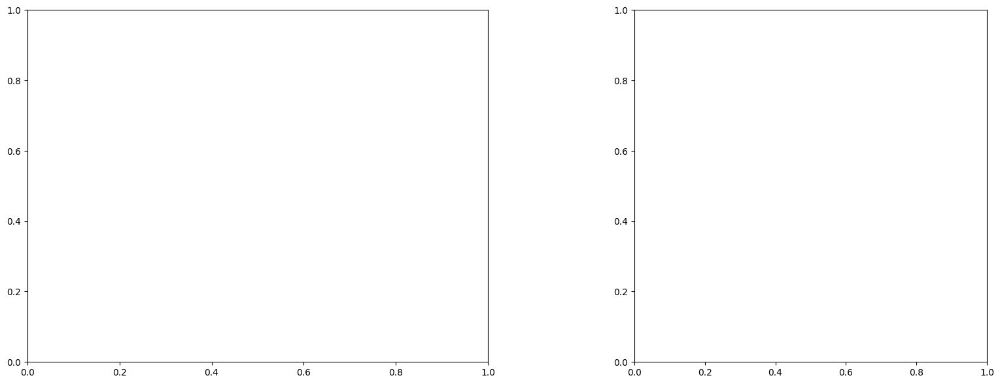

LinAlgError: Singular matrix

box [4500, 5000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

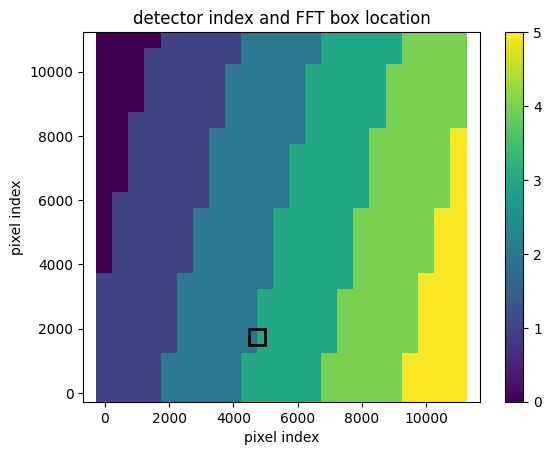

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


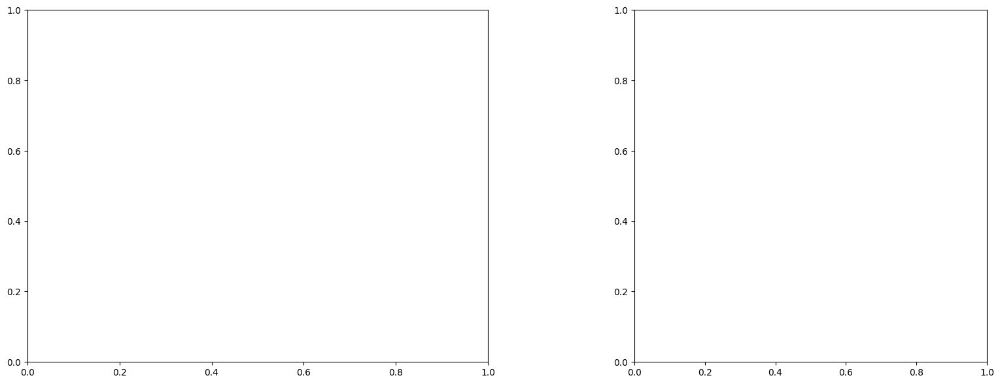

LinAlgError: Singular matrix

box [4500, 5000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

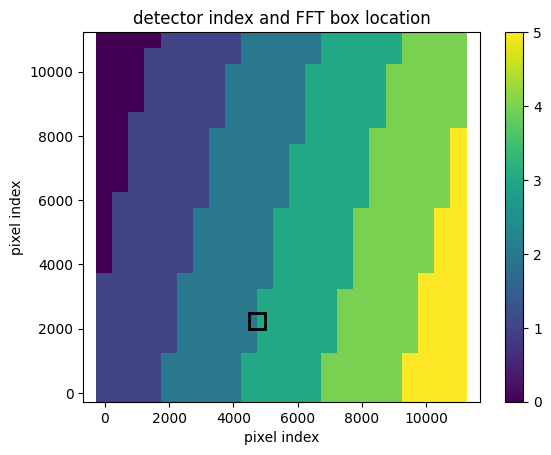

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091868165860078
(31, 31)
(31, 31)
(31, 31)


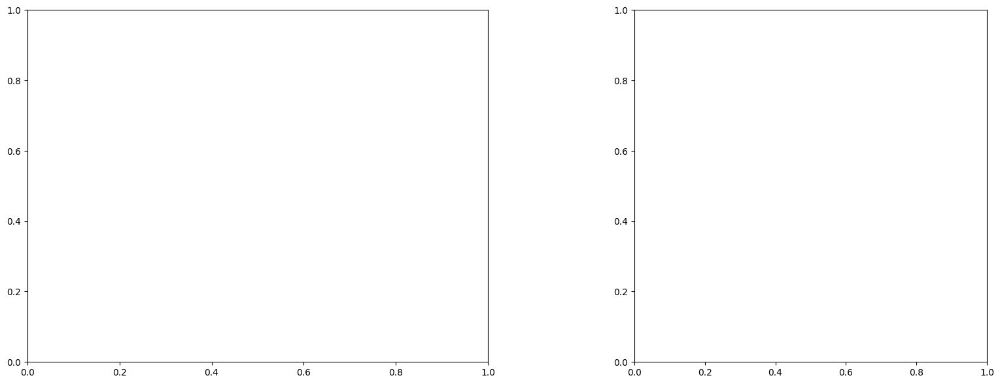

LinAlgError: Singular matrix

box [4500, 5000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

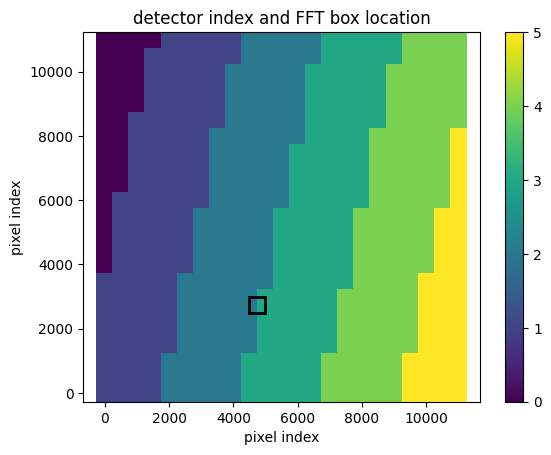

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091832917584105
(31, 31)
(31, 31)
(31, 31)


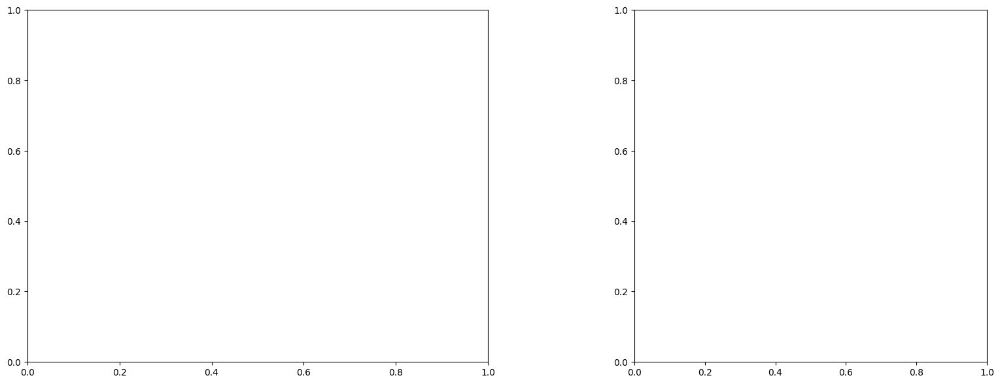

LinAlgError: Singular matrix

box [4500, 5000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

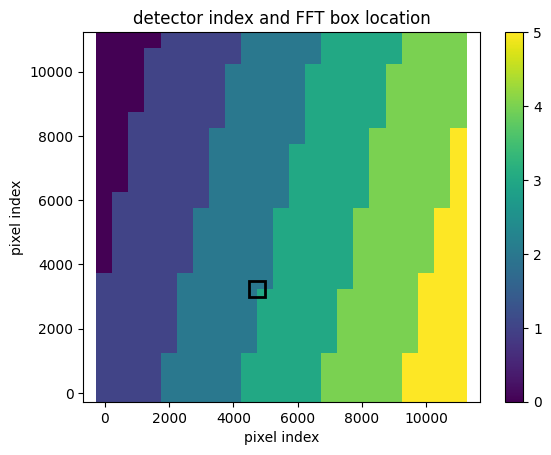

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


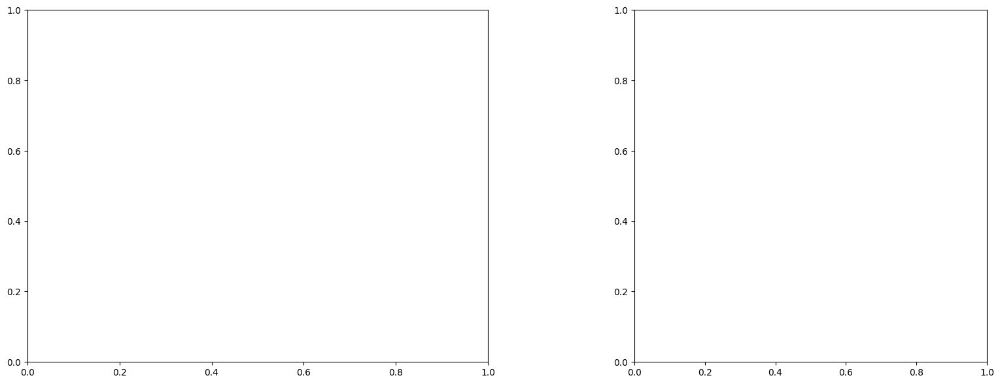

U and V components of current : [0.87697538 1.01937444]
uncertainties for U and V: 0.05974114435754741 0.05253819422010538


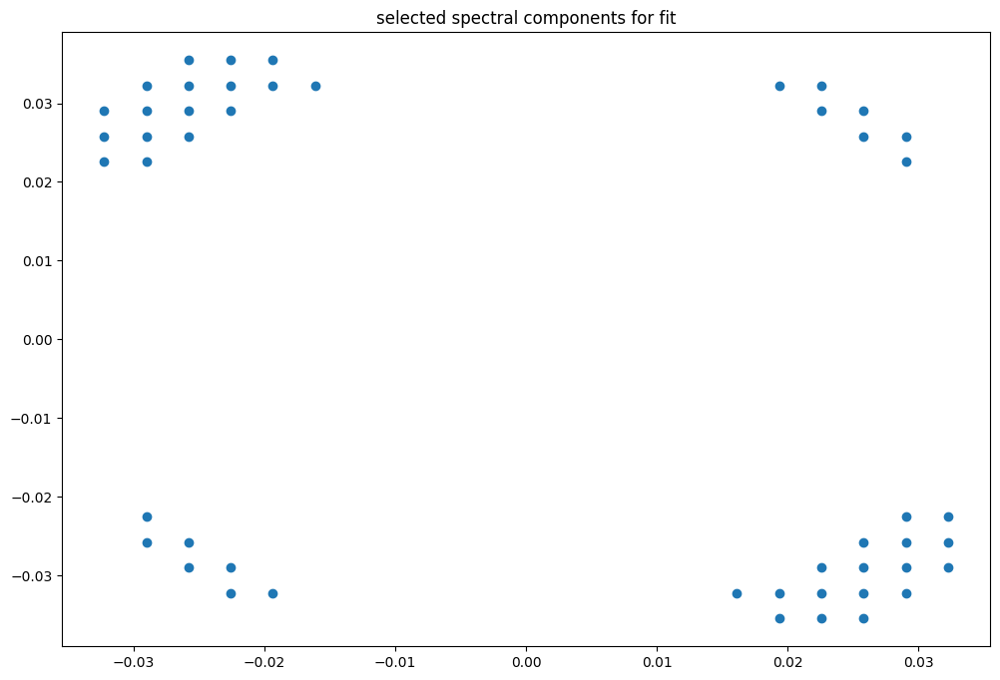

box [4500, 5000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

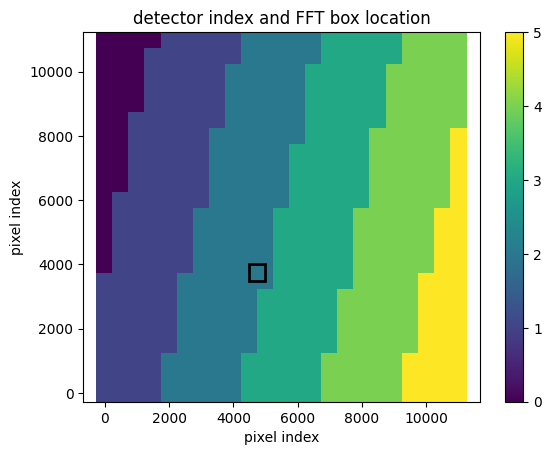

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


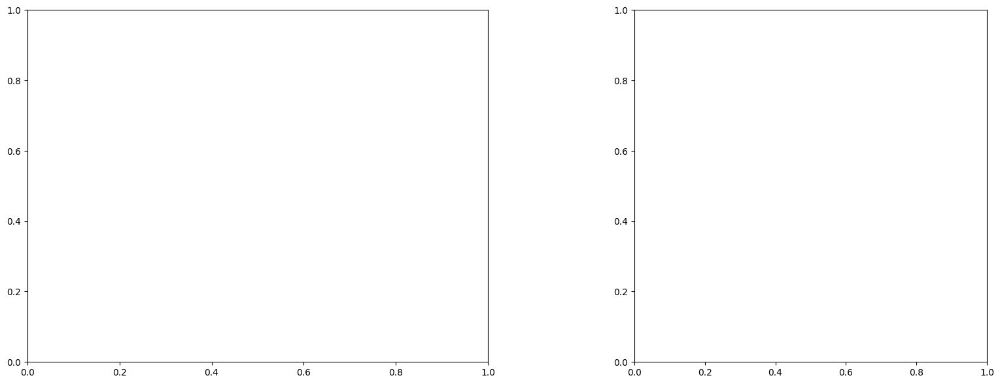

U and V components of current : [1.35812562 1.32802564]
uncertainties for U and V: 0.21056207669068686 0.196394618693026


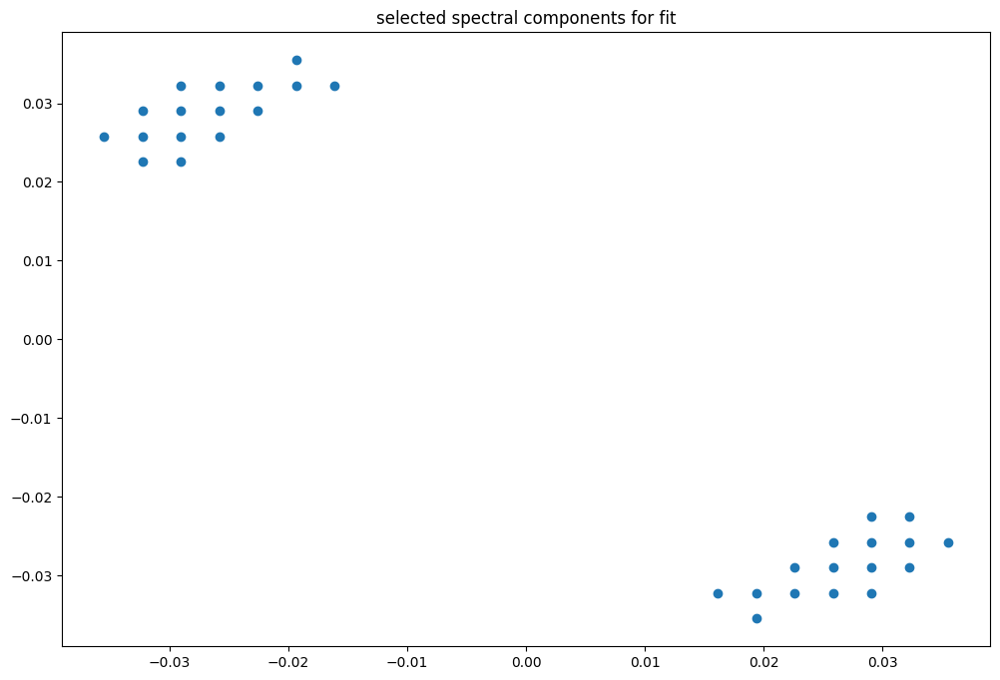

box [4500, 5000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

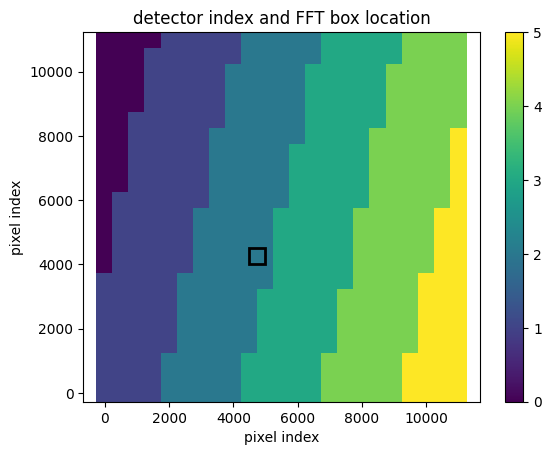

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


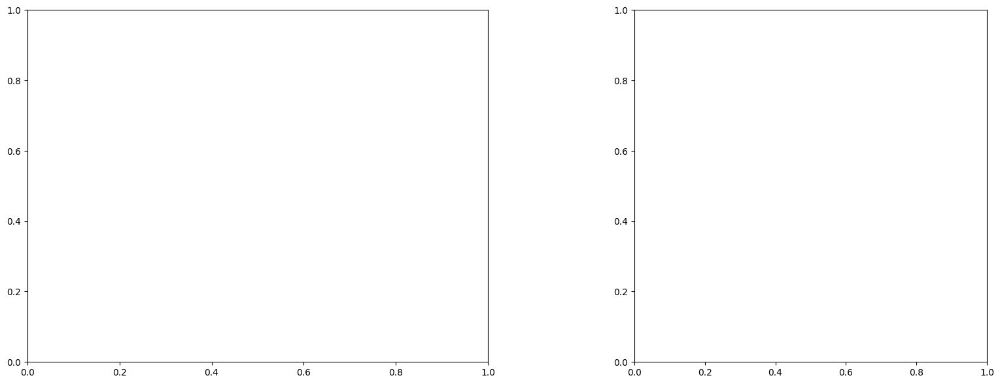

U and V components of current : [0.89442112 0.89310653]
uncertainties for U and V: 0.2922454231532983 0.25107747372624334


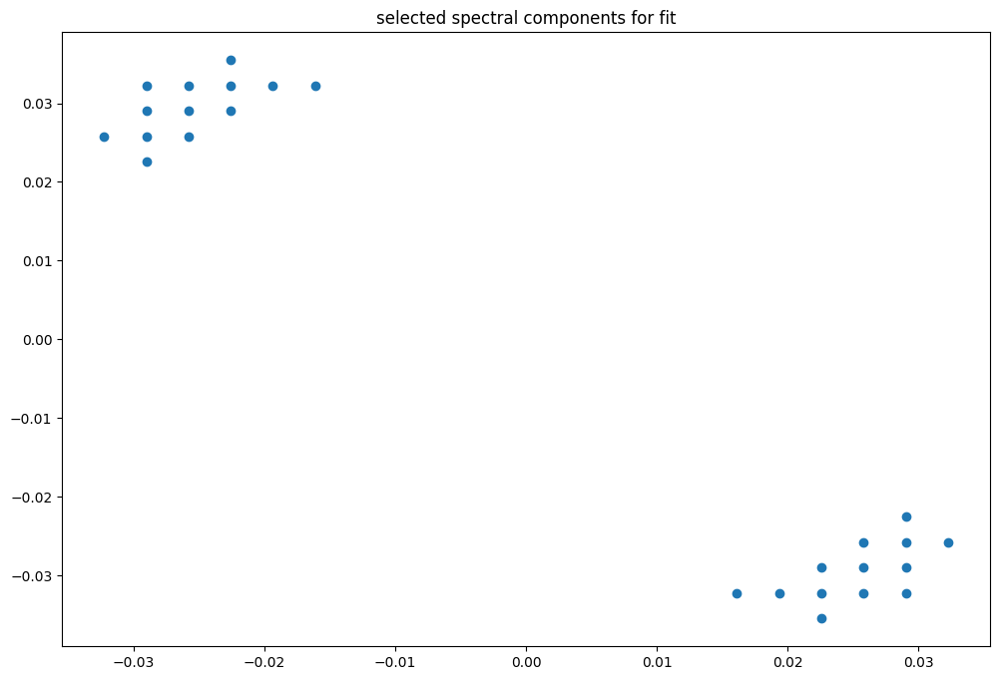

box [4500, 5000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

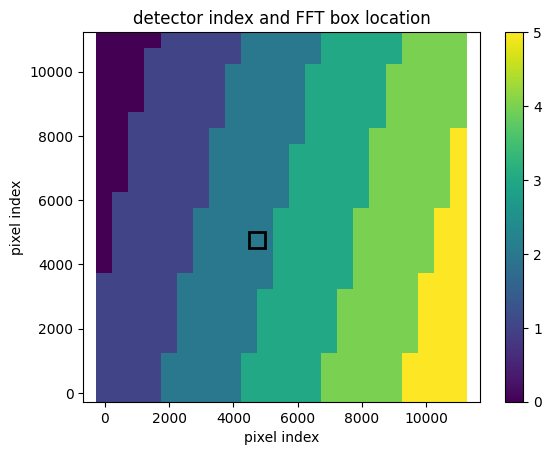

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


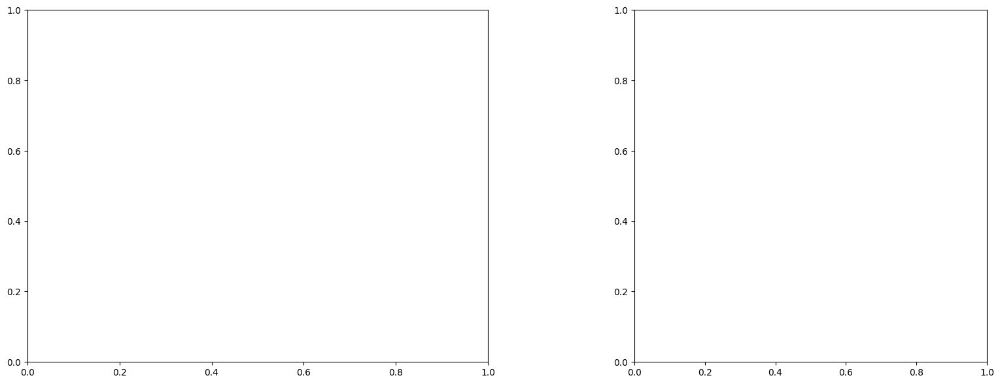

U and V components of current : [0.87564889 0.59383873]
uncertainties for U and V: 0.4003262986008113 0.3672421011795681


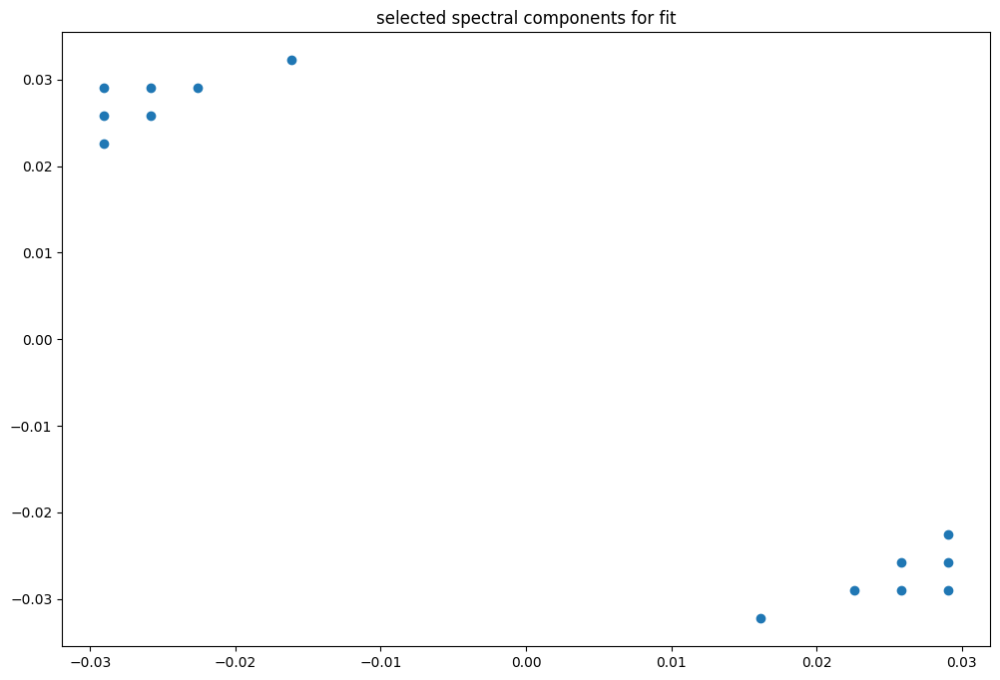

box [4500, 5000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

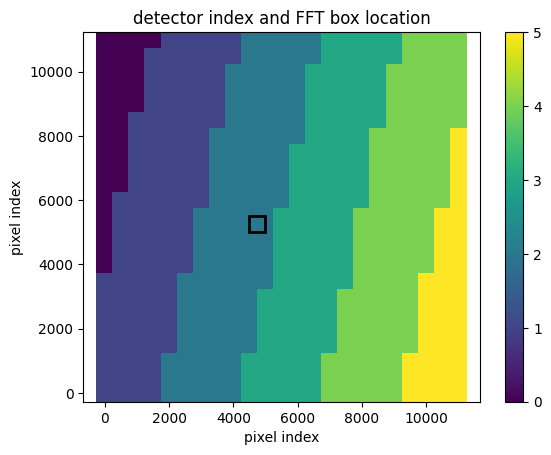

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


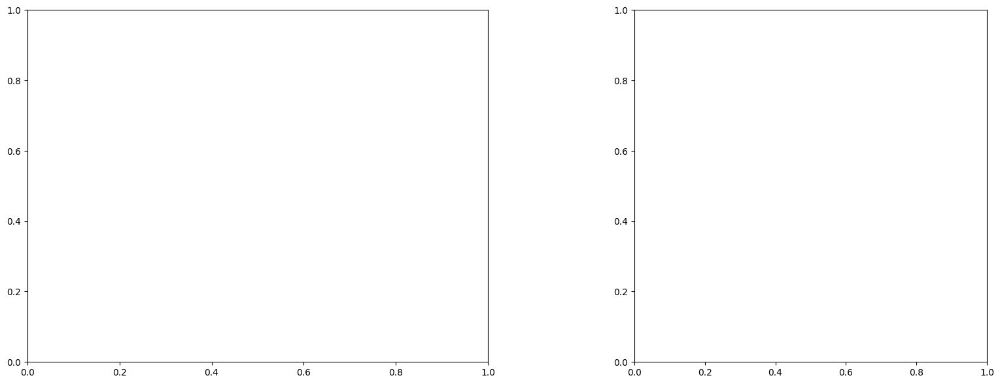

LinAlgError: Singular matrix

box [4500, 5000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

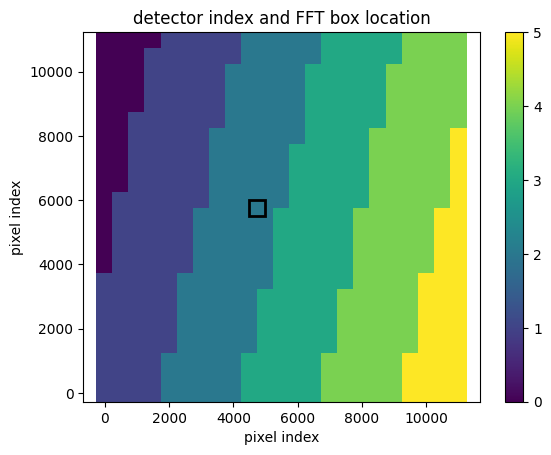

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


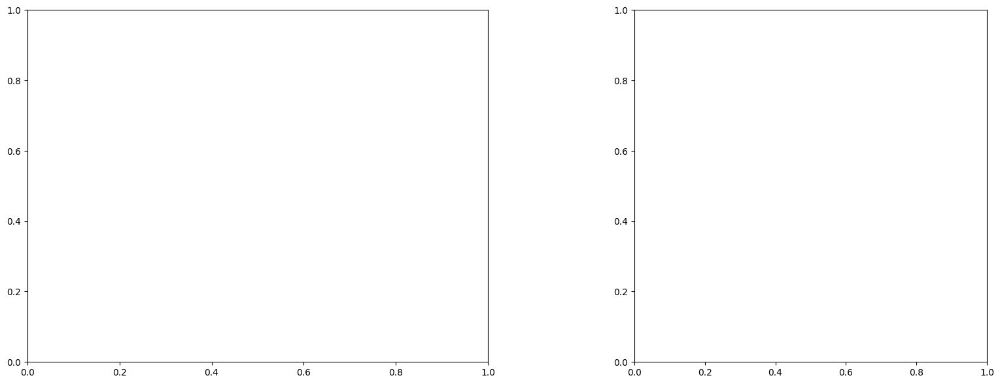

LinAlgError: Singular matrix

box [4500, 5000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

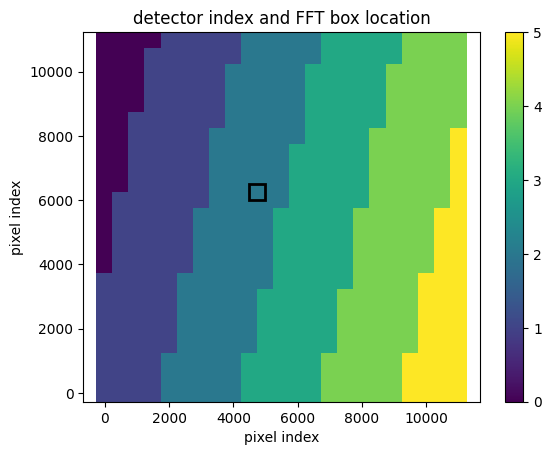

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


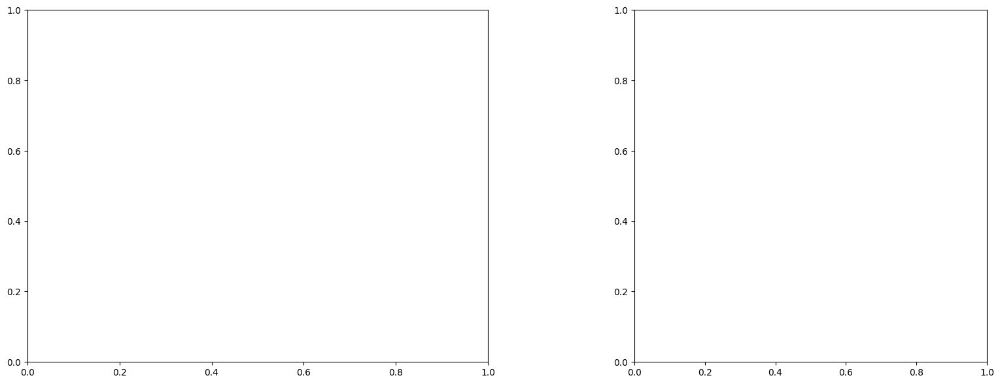

LinAlgError: Singular matrix

box [4500, 5000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

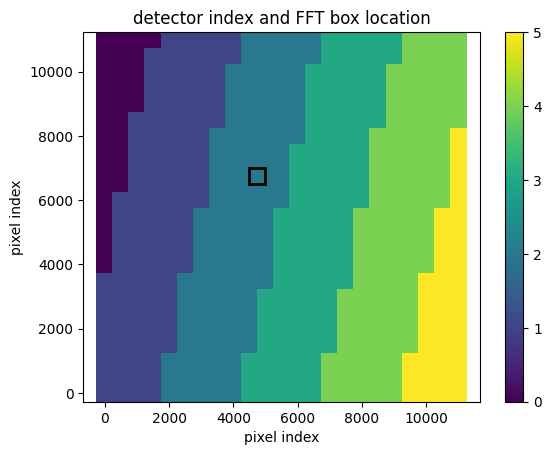

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


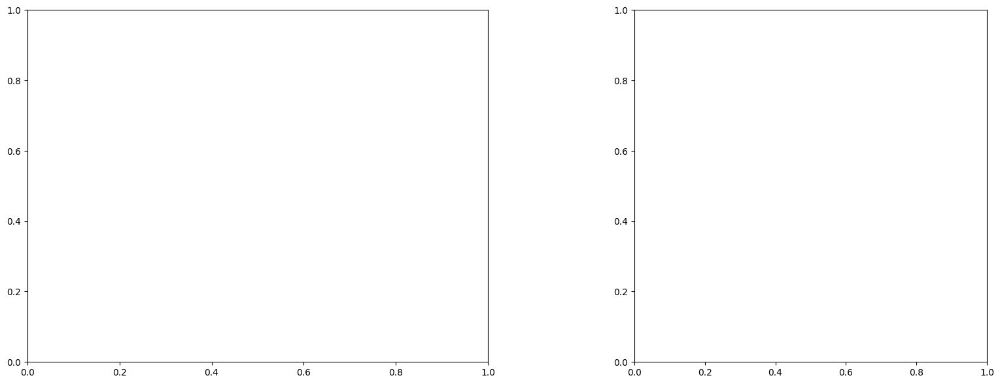

U and V components of current : [1.01986945 1.2958522 ]
uncertainties for U and V: 0.2482924848893698 0.21427832629829927


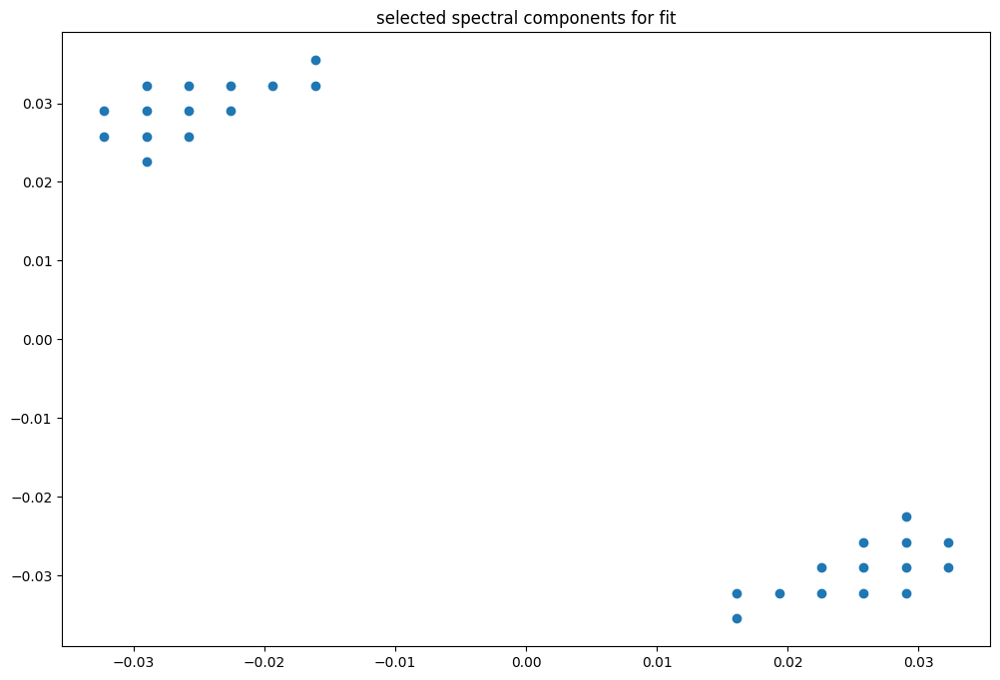

box [4500, 5000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

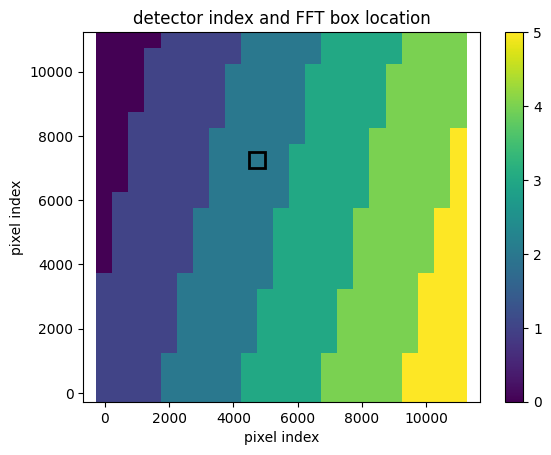

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


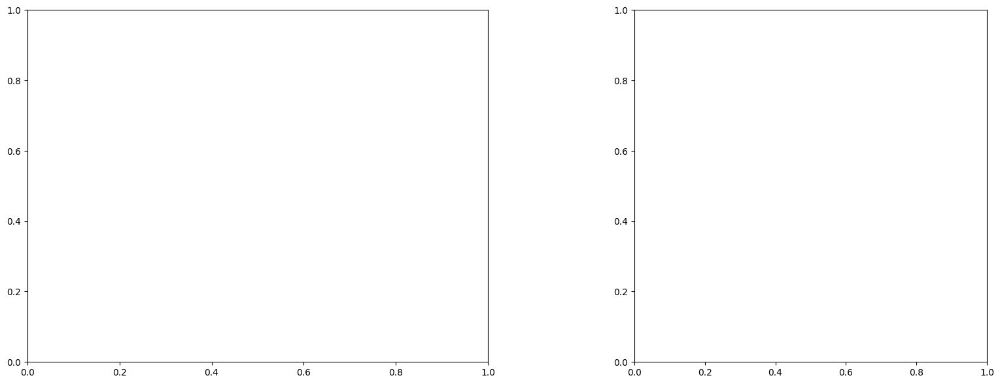

U and V components of current : [-0.28618552  0.1465376 ]
uncertainties for U and V: 0.23828971615319688 0.2116404552527608


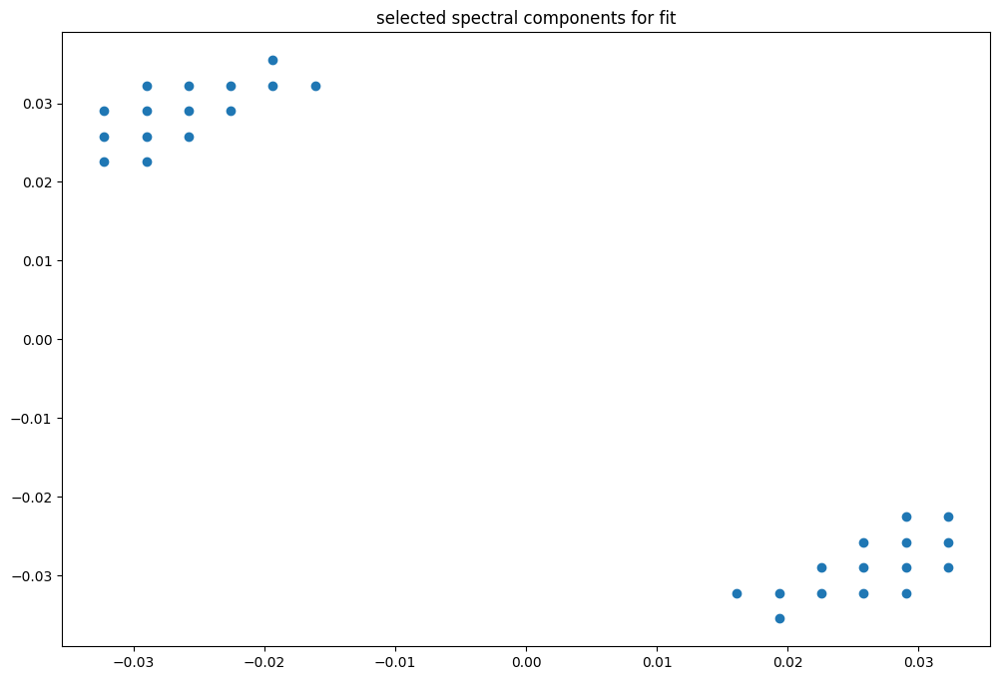

box [4500, 5000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

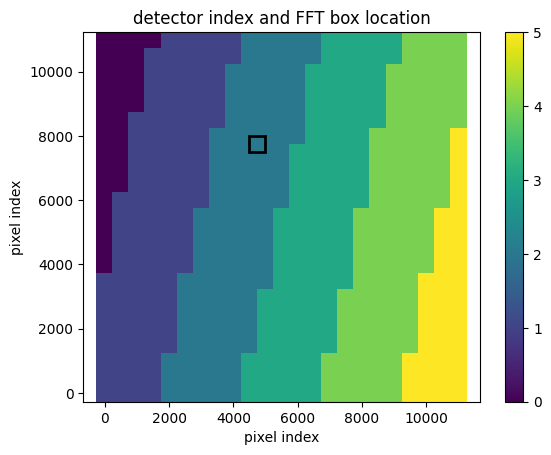

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


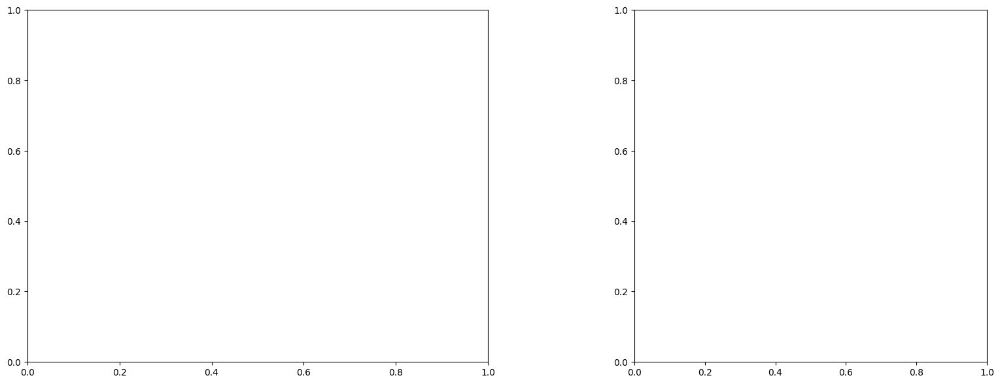

U and V components of current : [0.47611561 0.10454834]
uncertainties for U and V: 0.19587918315913258 0.16347180902671615


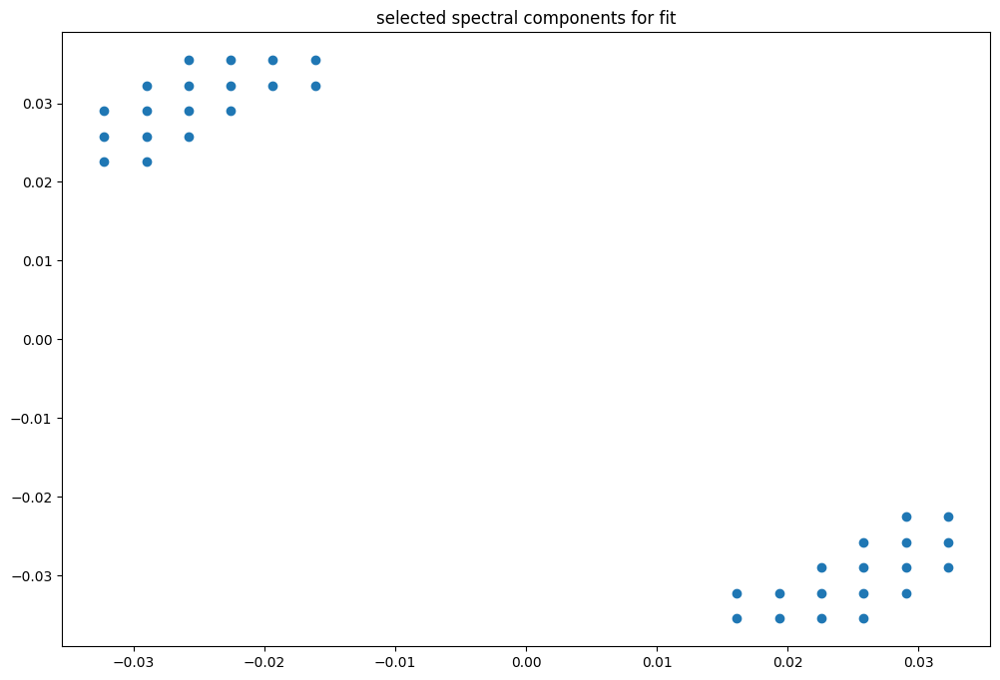

box [4500, 5000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

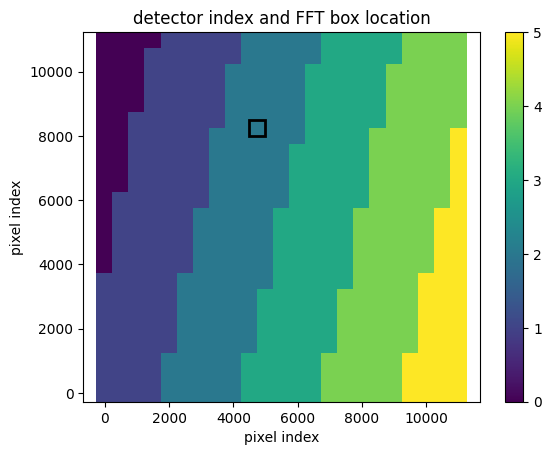

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


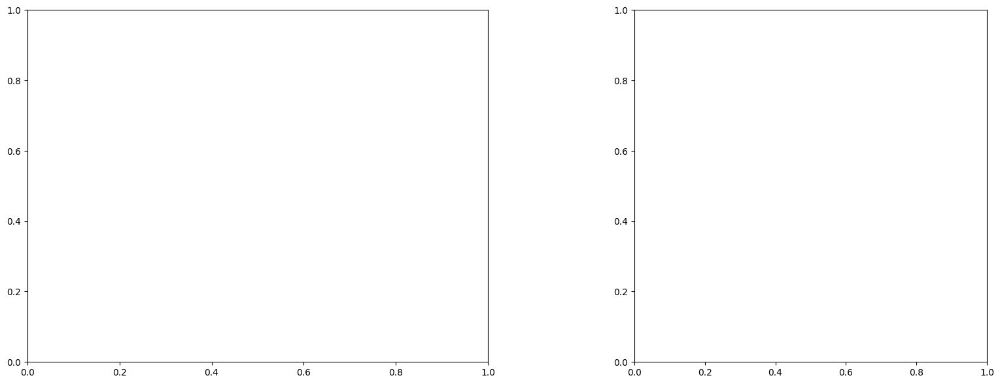

U and V components of current : [-0.16264049 -0.40239942]
uncertainties for U and V: 0.0498479091479965 0.04691618999363001


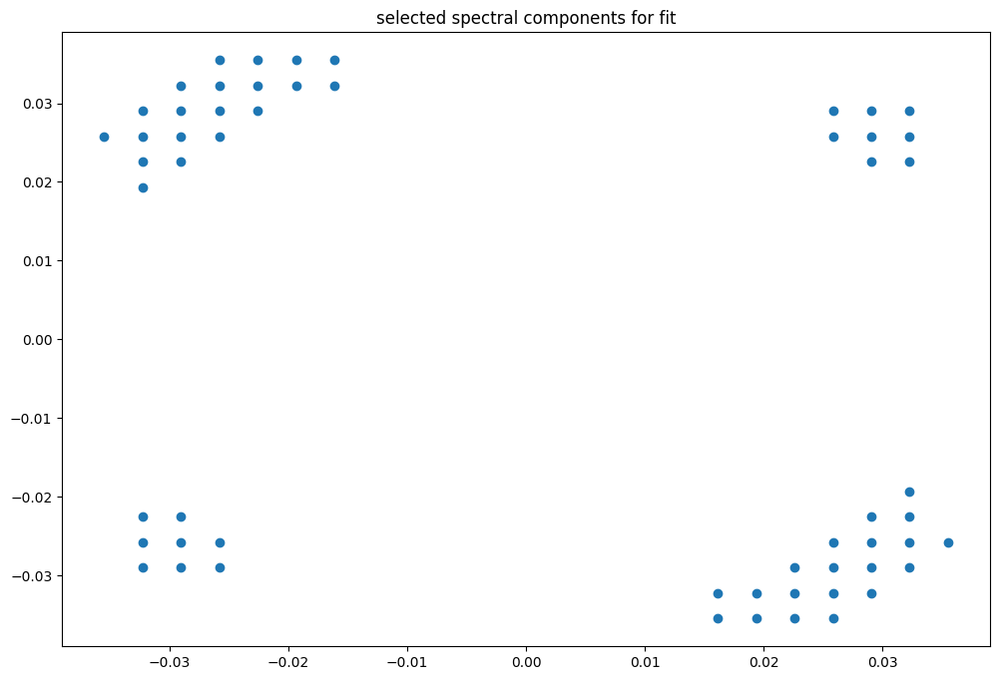

box [4500, 5000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

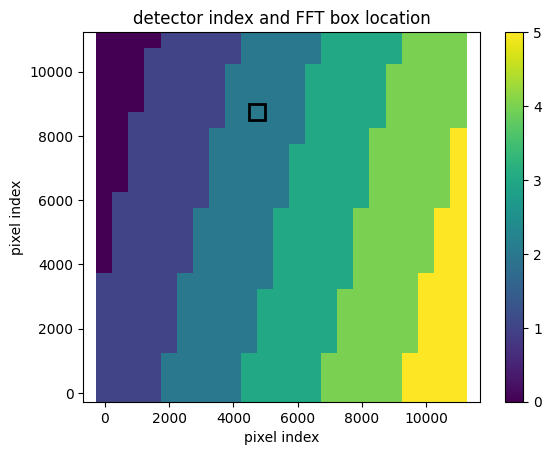

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


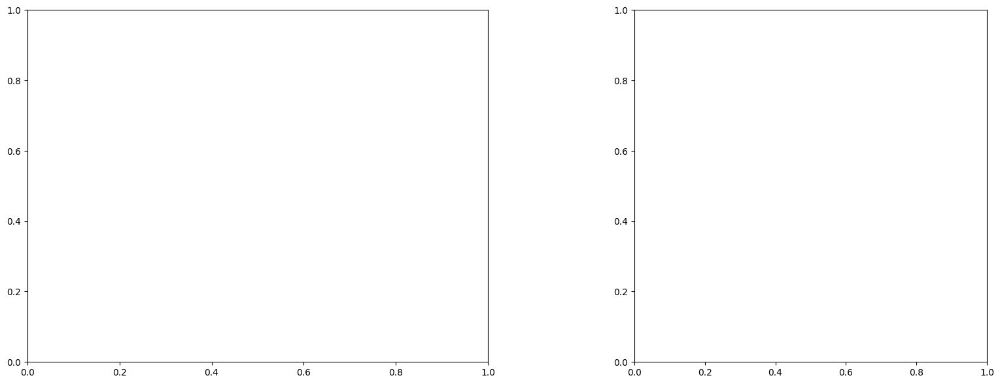

U and V components of current : [-0.07221652 -0.48004777]
uncertainties for U and V: 0.0559991137329468 0.05170016741218882


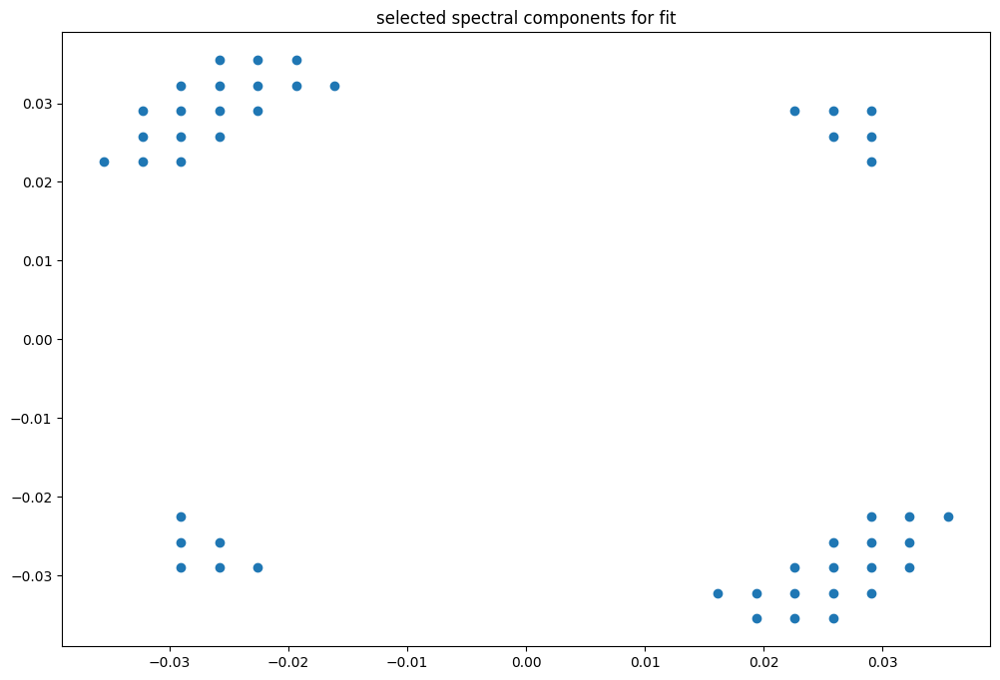

box [4500, 5000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

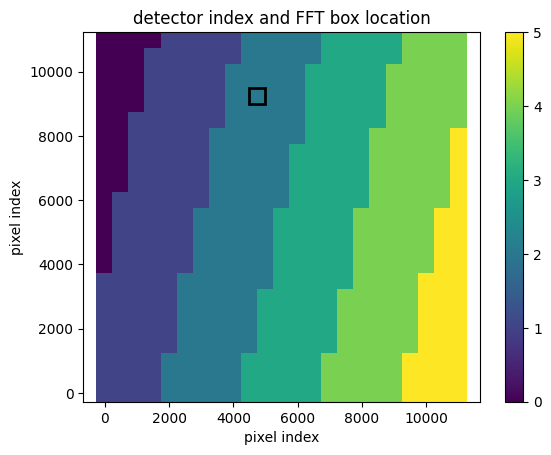

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


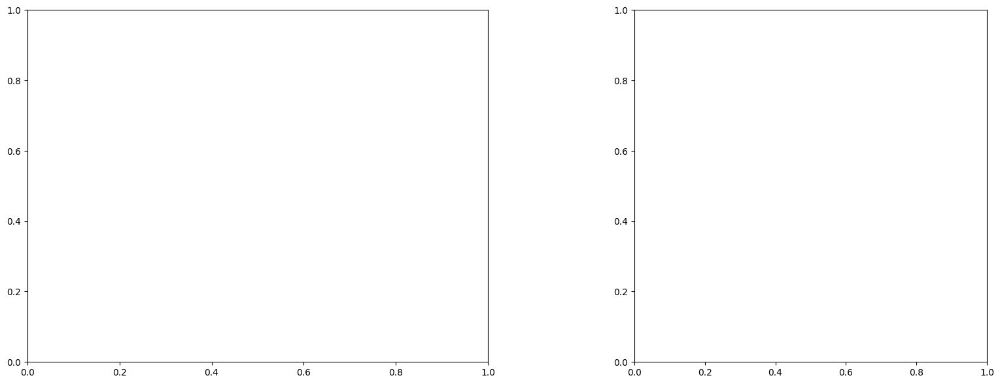

U and V components of current : [ 0.08382283 -0.26174853]
uncertainties for U and V: 0.05825676358014172 0.059454794311307


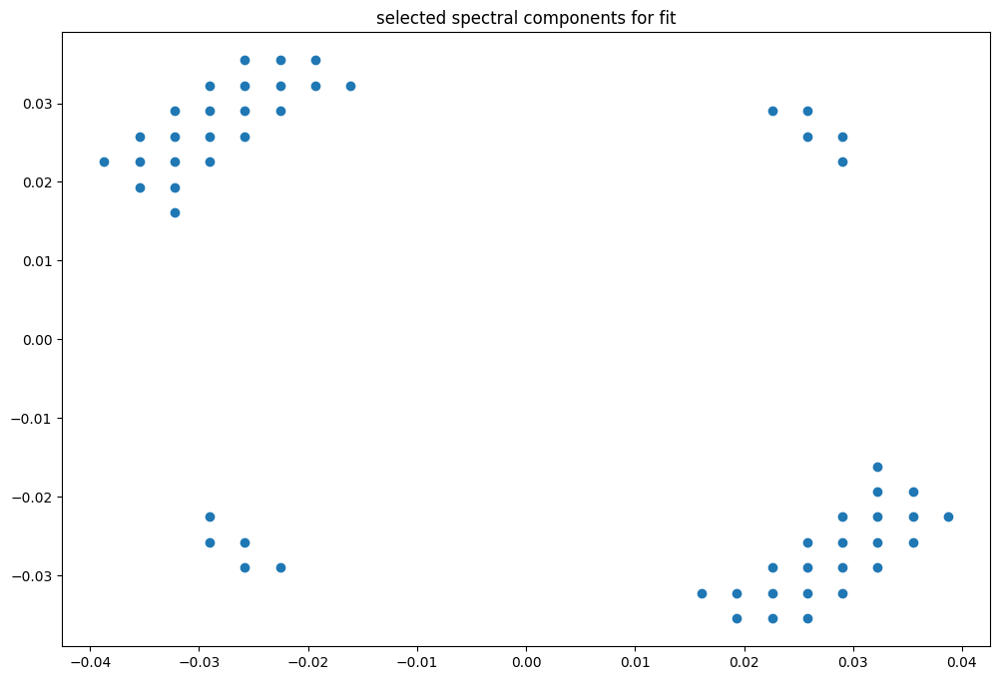

box [4500, 5000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

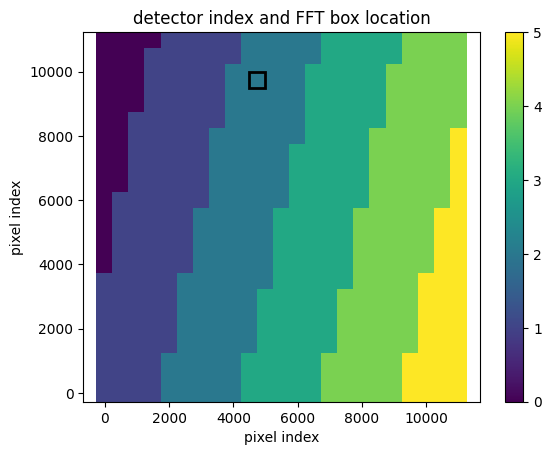

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


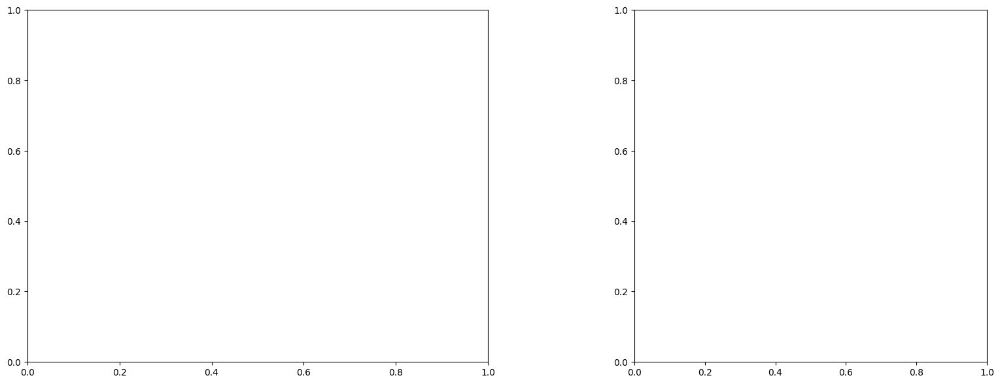

U and V components of current : [ 0.24841912 -0.289268  ]
uncertainties for U and V: 0.09054160562921602 0.10353215240372413


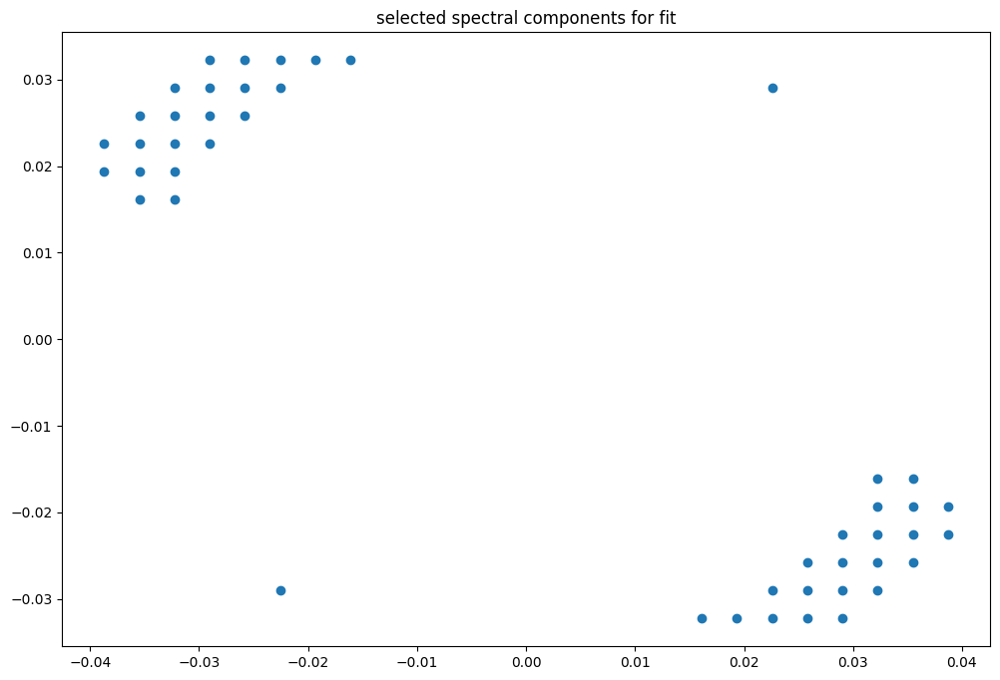

box [4500, 5000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

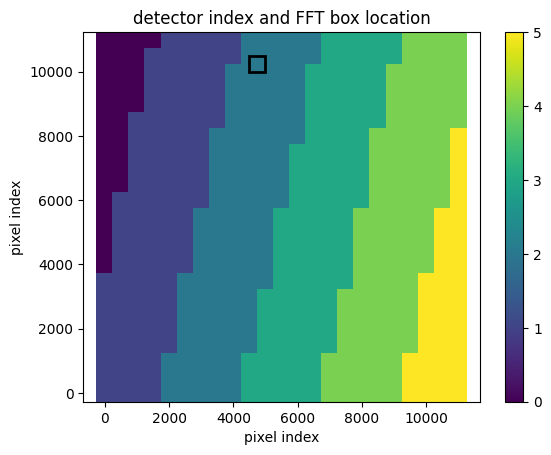

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


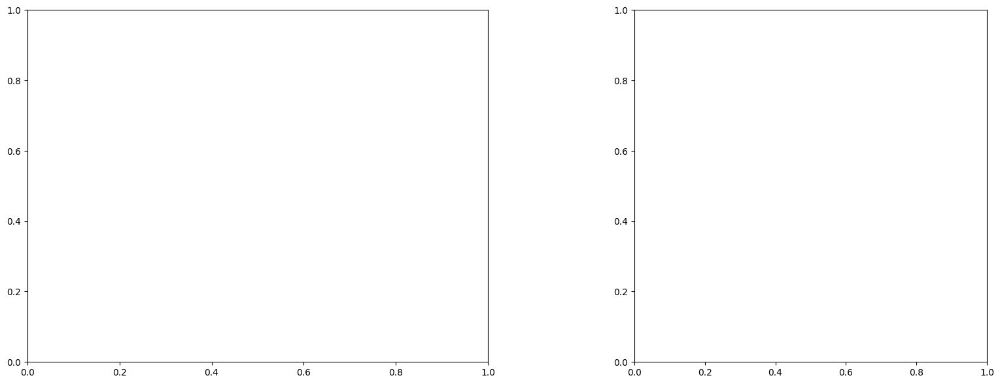

U and V components of current : [ 0.1789923  -0.06280031]
uncertainties for U and V: 0.0954581706624702 0.11235800825758921


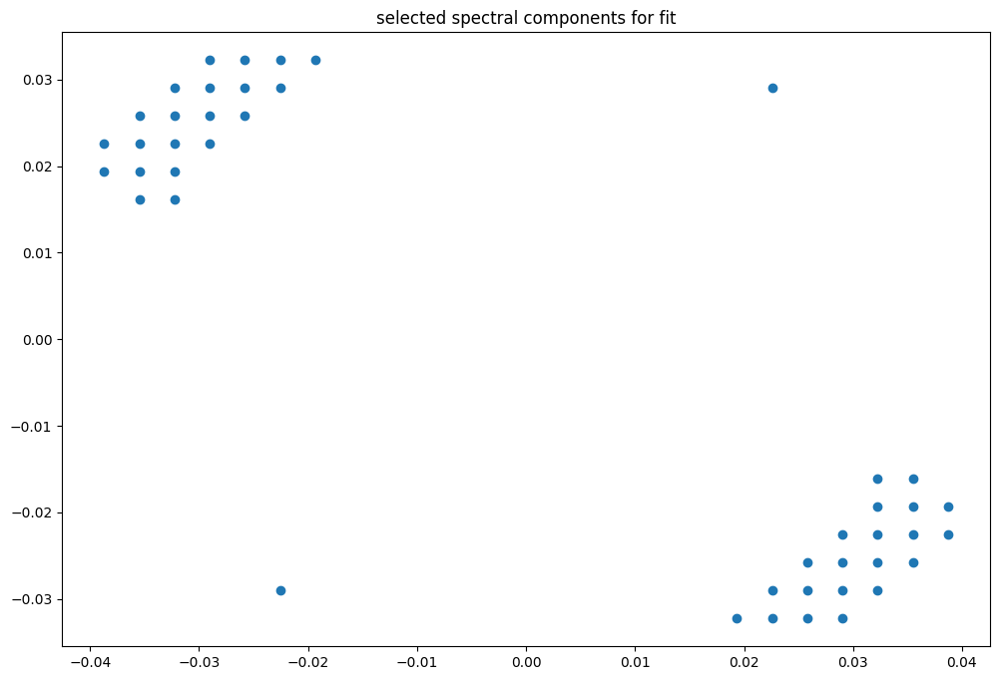

box [4500, 5000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

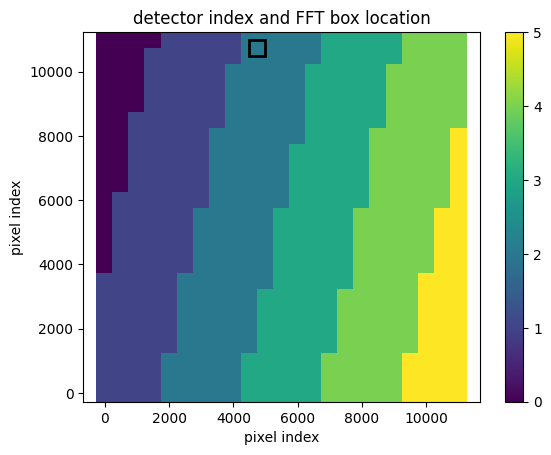

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 30)
(31, 30)
(31, 30)


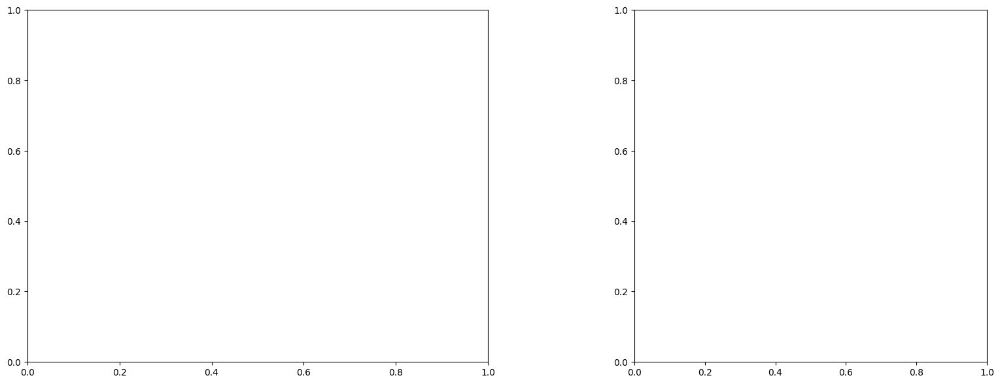

U and V components of current : [ 0.40482245 -0.30375075]
uncertainties for U and V: 0.1072586750824767 0.11106706182888586


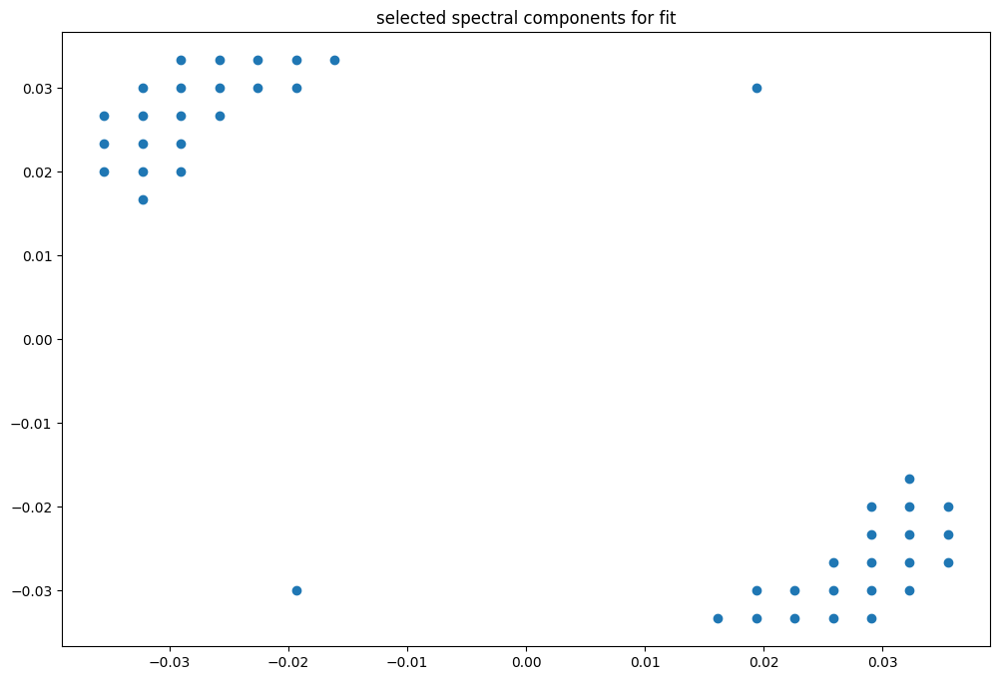

box [5000, 5500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

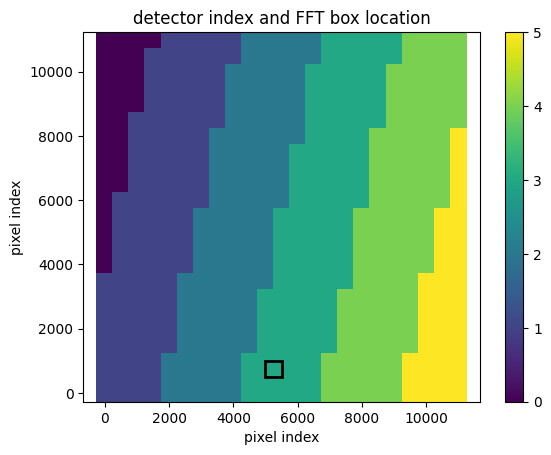

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948049337217942
(31, 31)
(31, 31)
(31, 31)


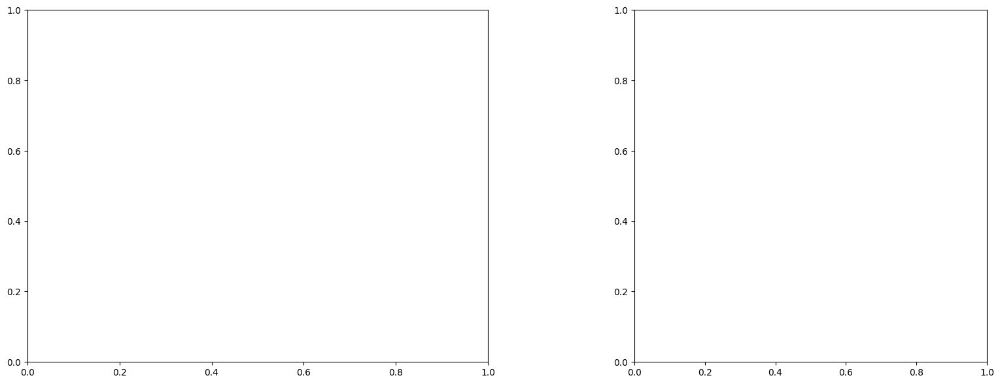

U and V components of current : [0.9359475  1.06173996]
uncertainties for U and V: 0.06094359576539151 0.07738162096084965


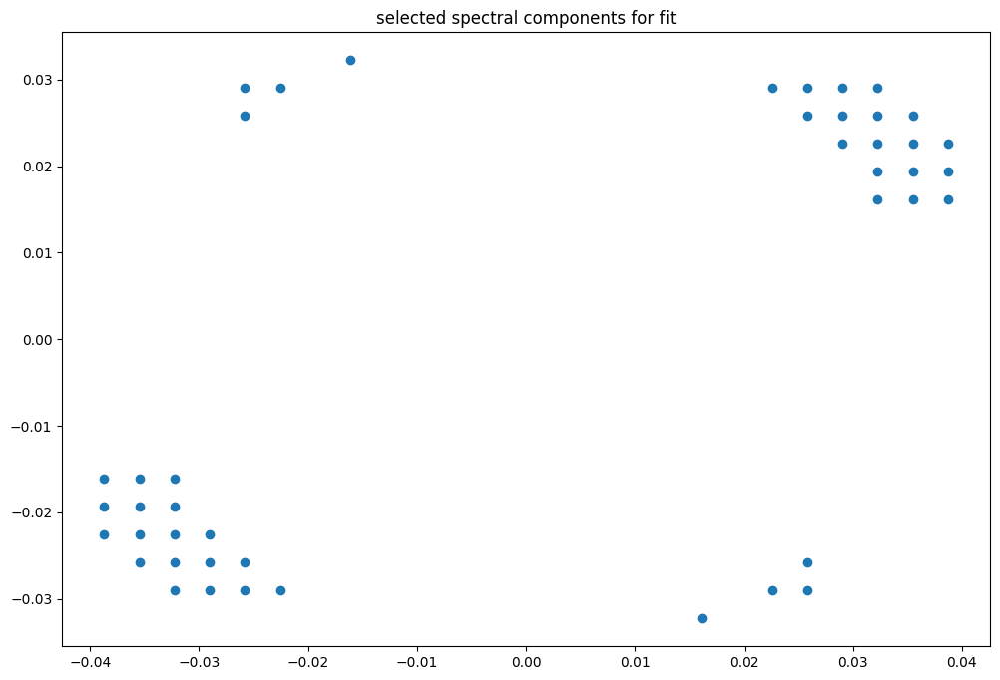

box [5000, 5500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

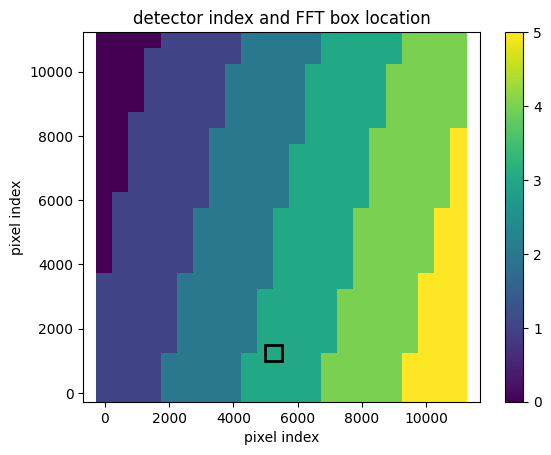

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948016160210164
(31, 31)
(31, 31)
(31, 31)


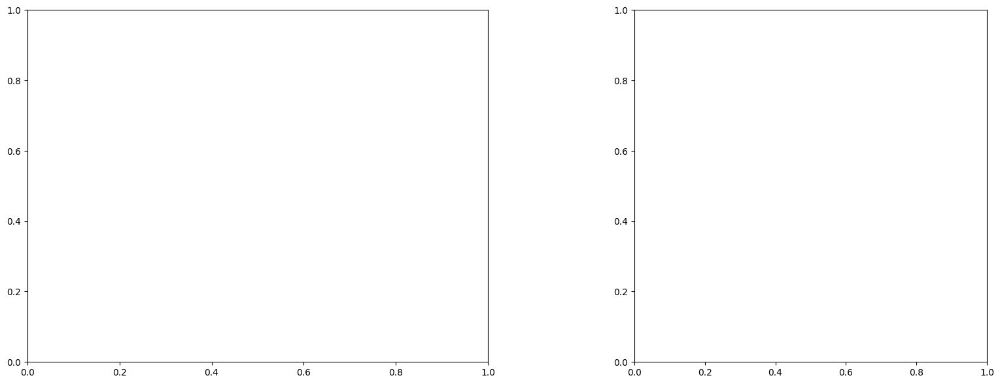

U and V components of current : [1.00727002 0.98695767]
uncertainties for U and V: 0.05033521001184977 0.054330282413925575


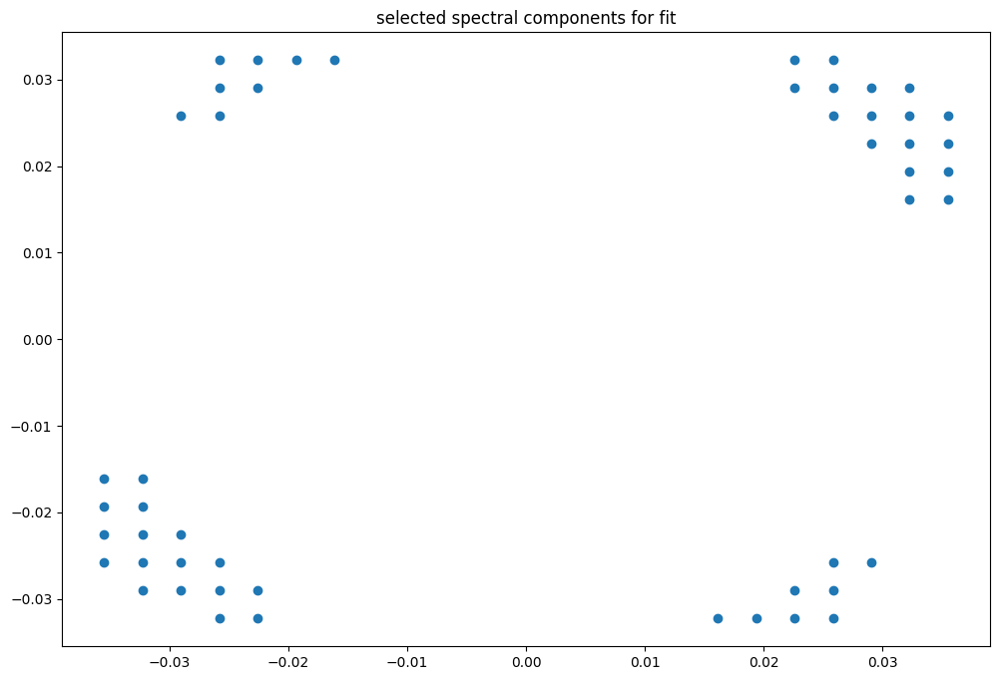

box [5000, 5500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

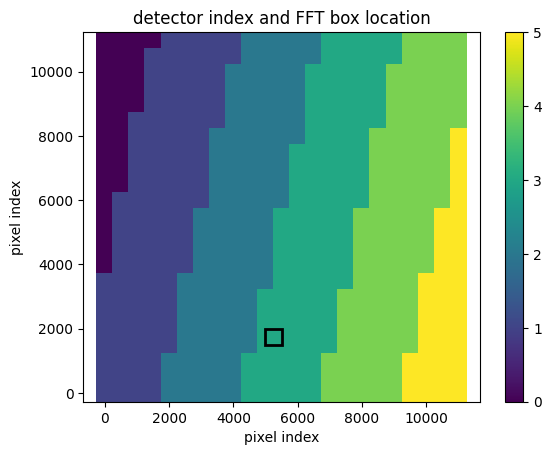

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


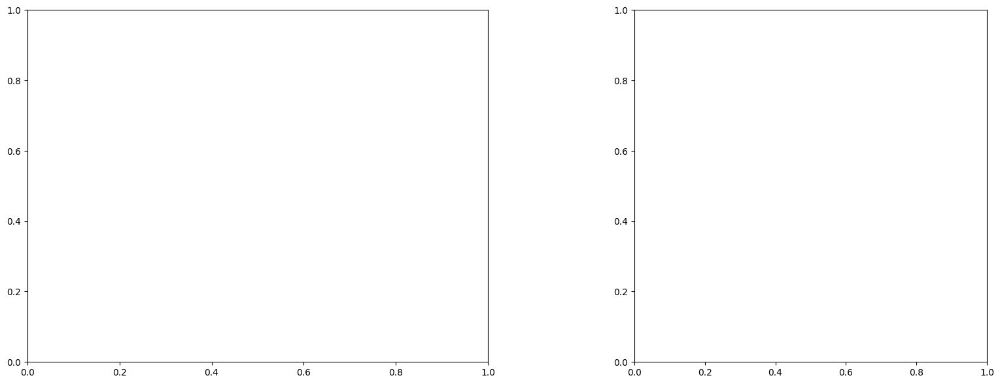

U and V components of current : [0.83102399 1.0746517 ]
uncertainties for U and V: 0.03941850262048757 0.04328183298824891


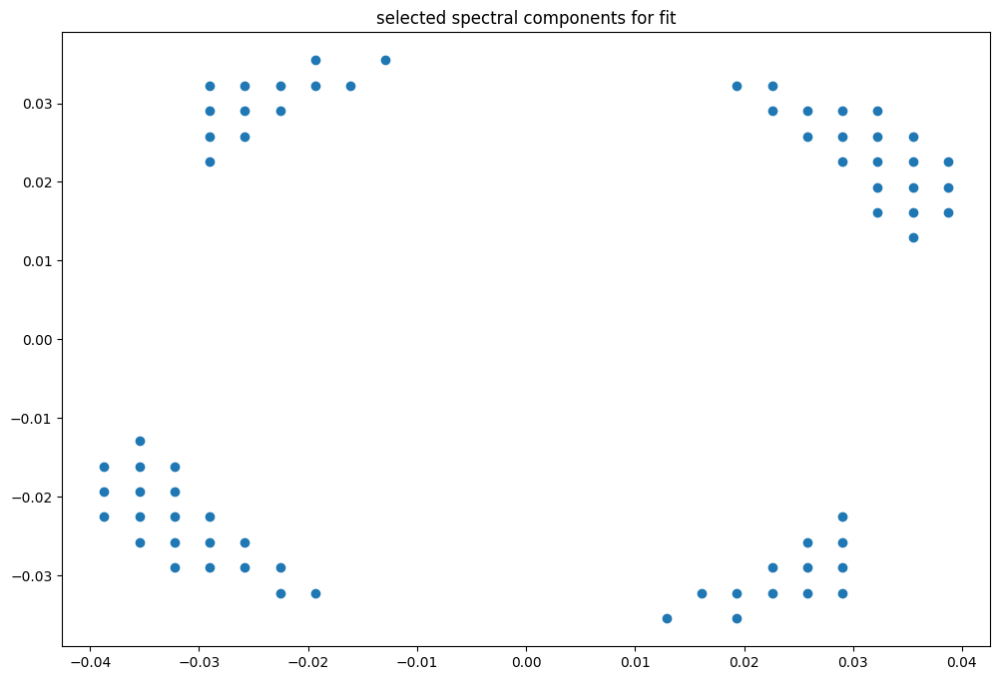

box [5000, 5500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

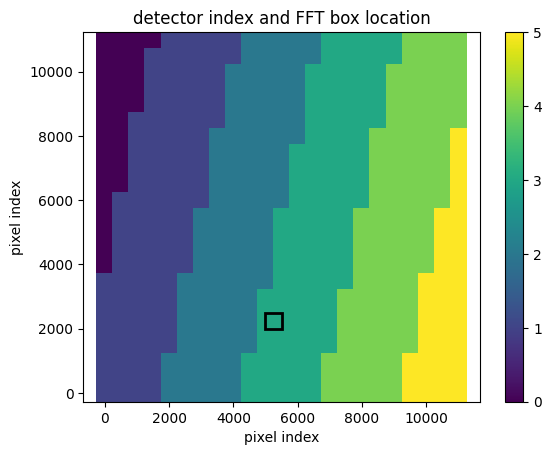

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947943483447979
(31, 31)
(31, 31)
(31, 31)


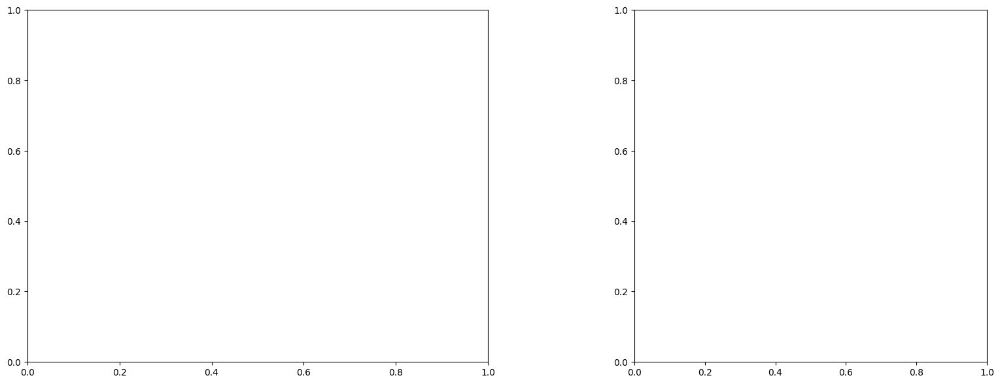

U and V components of current : [0.83118871 1.15722625]
uncertainties for U and V: 0.04556687587464376 0.04837247562186109


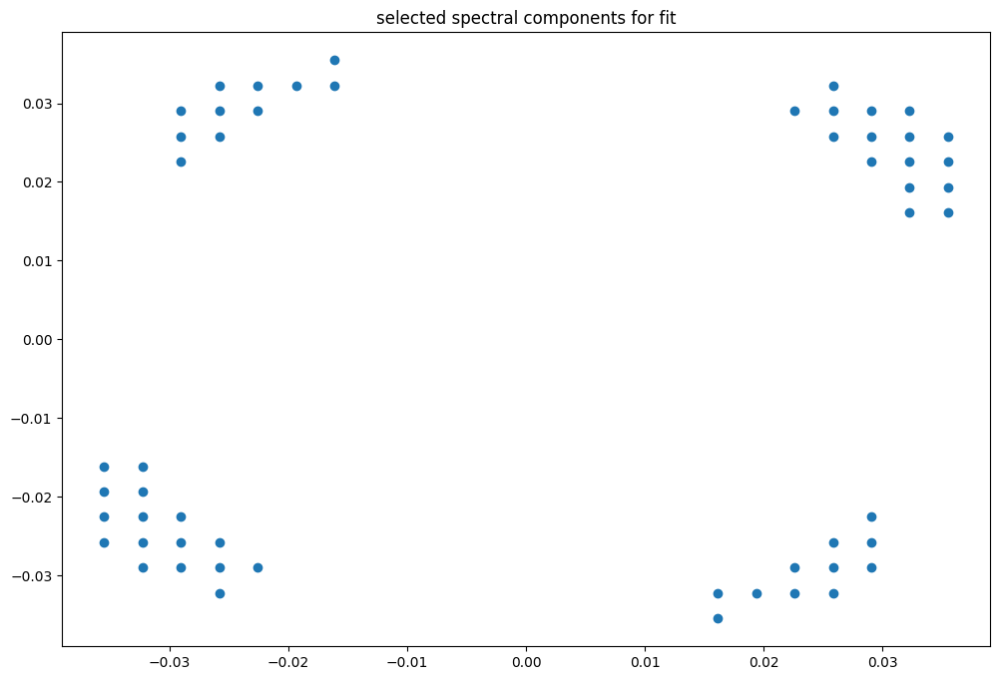

box [5000, 5500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

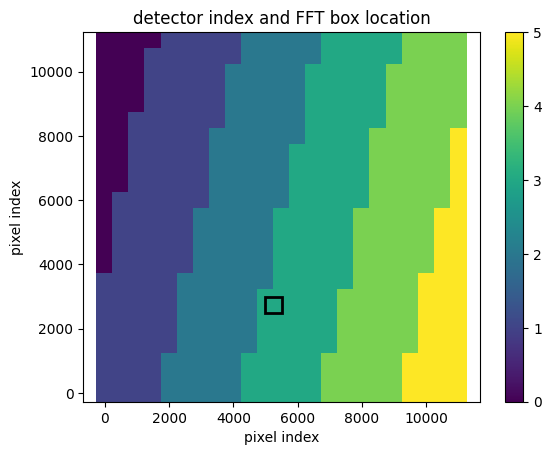

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947943483447979
(31, 31)
(31, 31)
(31, 31)


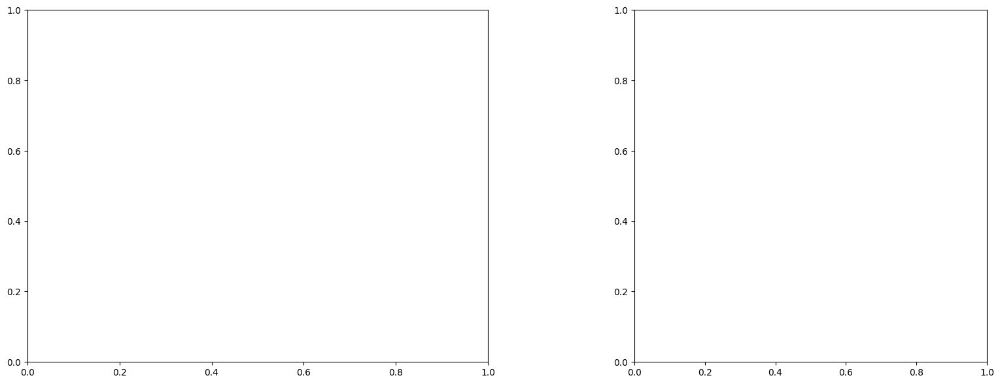

U and V components of current : [0.82908081 1.10289699]
uncertainties for U and V: 0.04889204838658851 0.048978809714092936


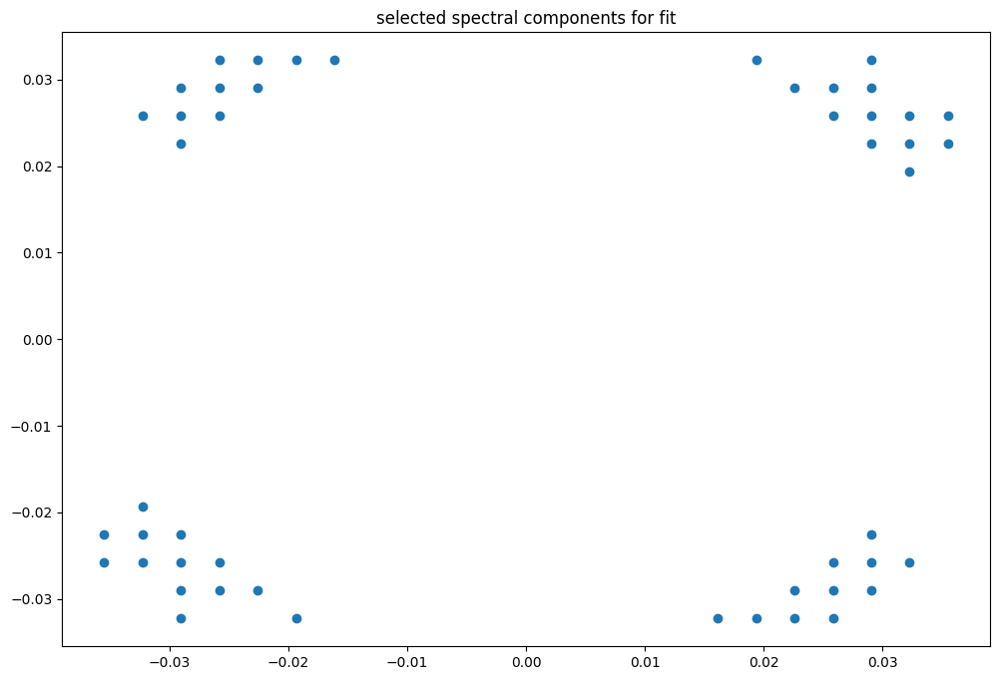

box [5000, 5500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

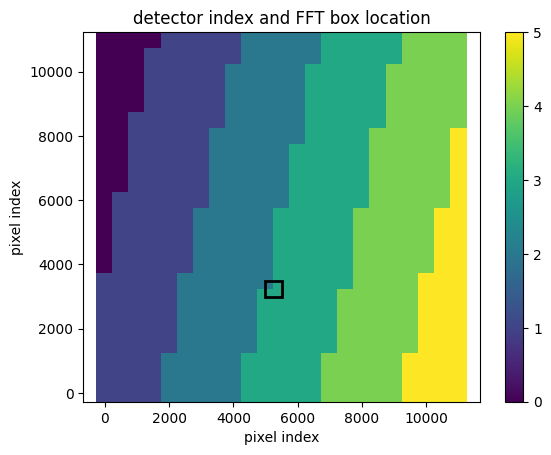

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091797070466269
(31, 31)
(31, 31)
(31, 31)


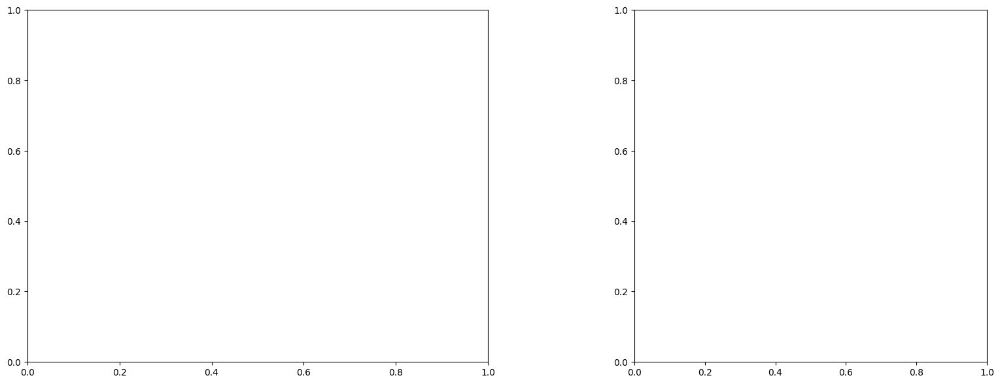

LinAlgError: Singular matrix

box [5000, 5500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

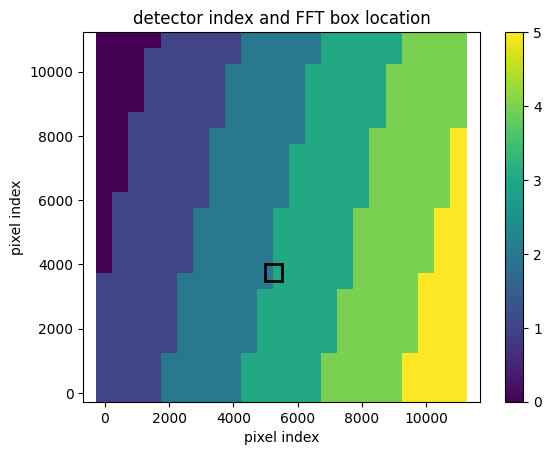

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091763544279995
(31, 31)
(31, 31)
(31, 31)


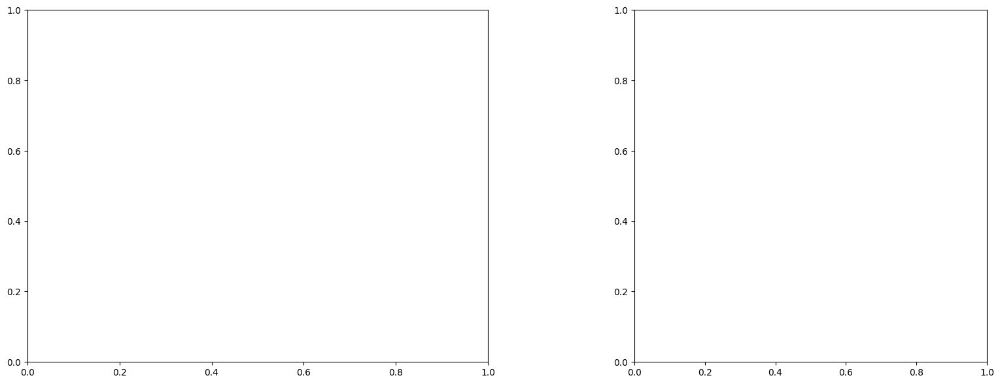

LinAlgError: Singular matrix

box [5000, 5500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

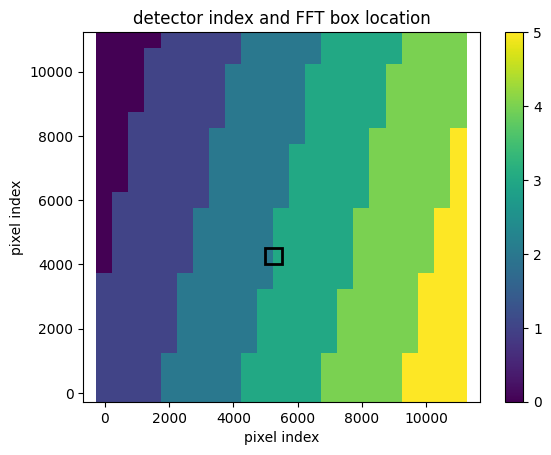

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


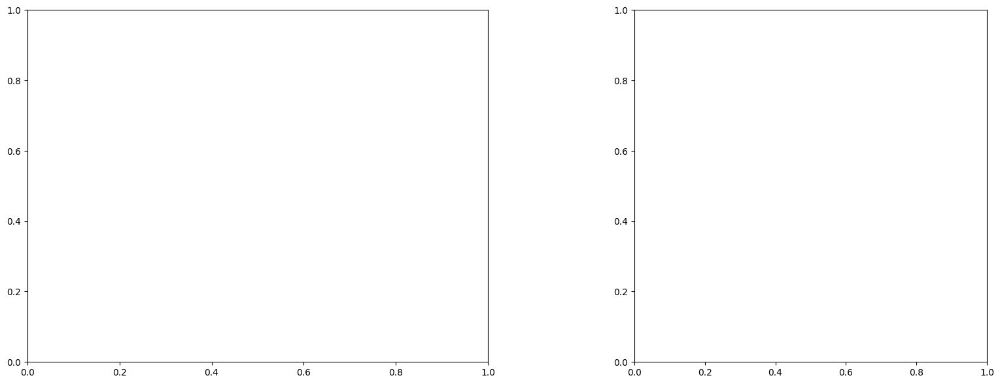

LinAlgError: Singular matrix

box [5000, 5500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

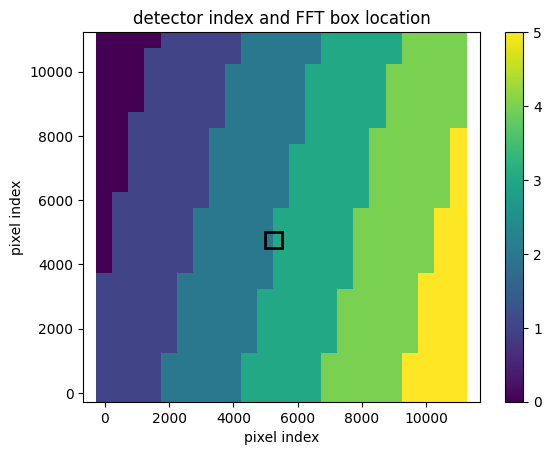

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091731595496618
(31, 31)
(31, 31)
(31, 31)


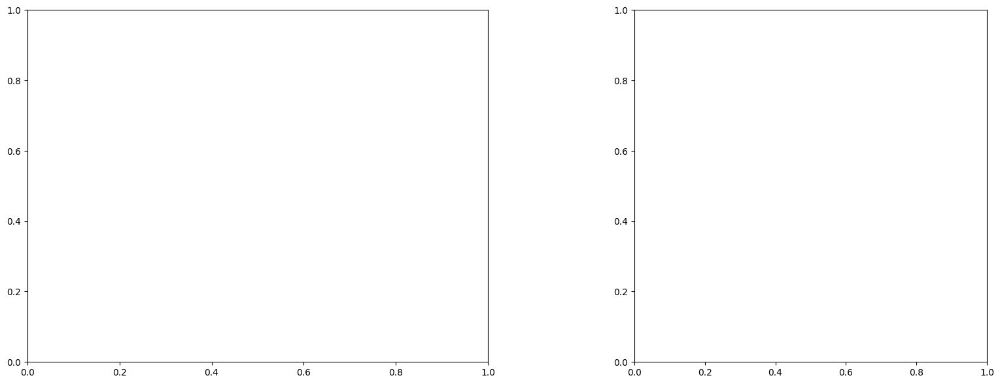

LinAlgError: Singular matrix

box [5000, 5500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

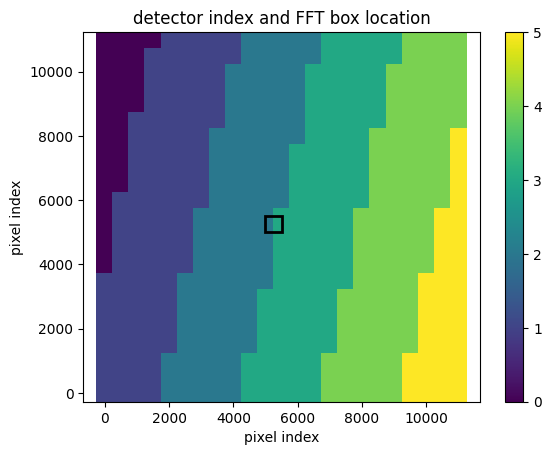

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091698493374188
(31, 31)
(31, 31)
(31, 31)


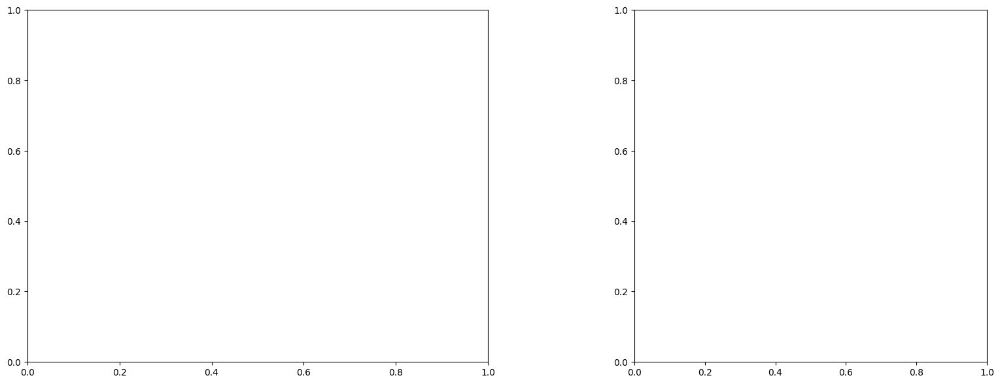

LinAlgError: Singular matrix

box [5000, 5500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

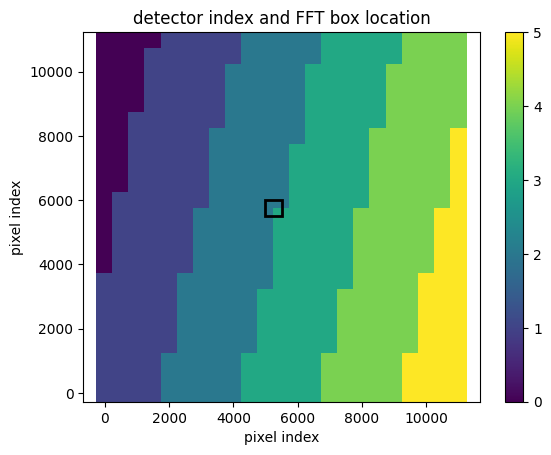

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


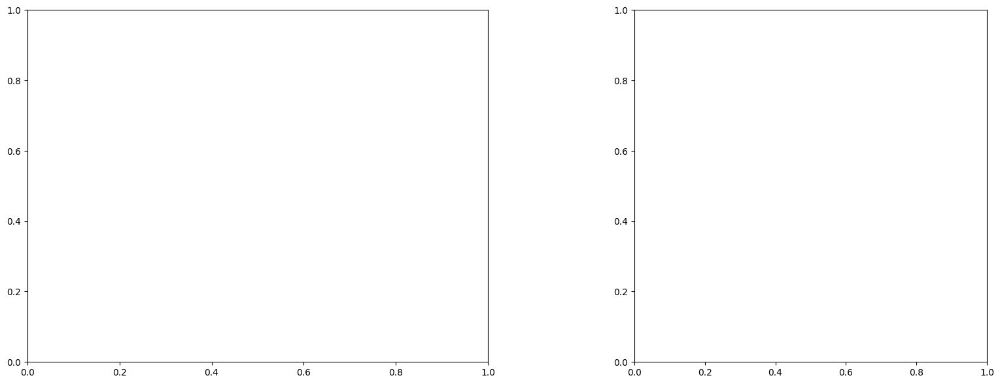

U and V components of current : [-0.51447871  1.26906219]
uncertainties for U and V: 1.5045849690606339 1.7103466932797513


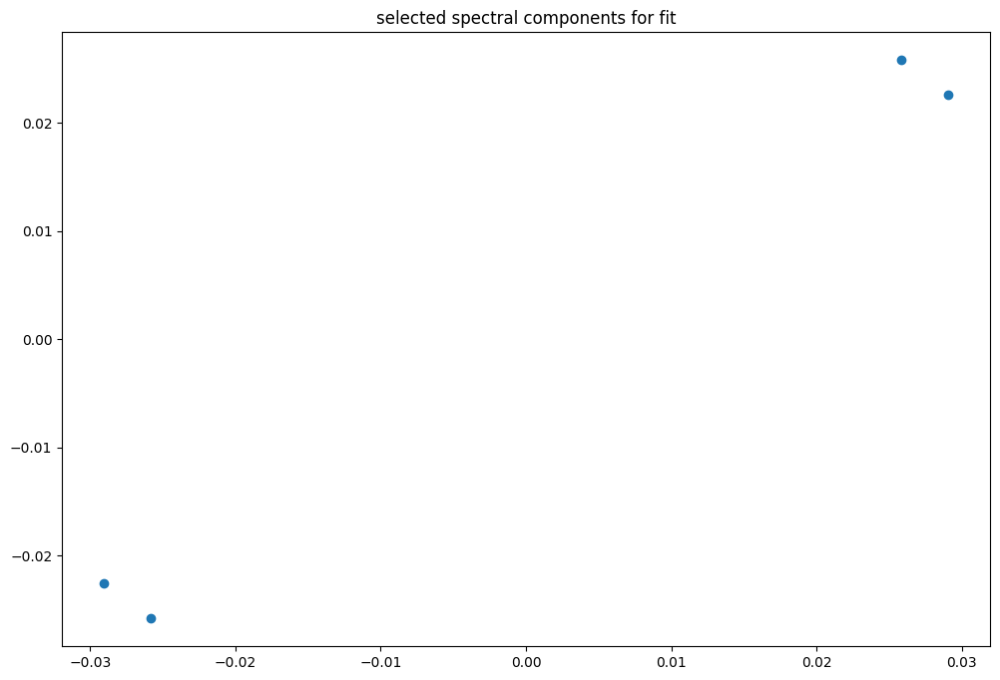

box [5000, 5500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

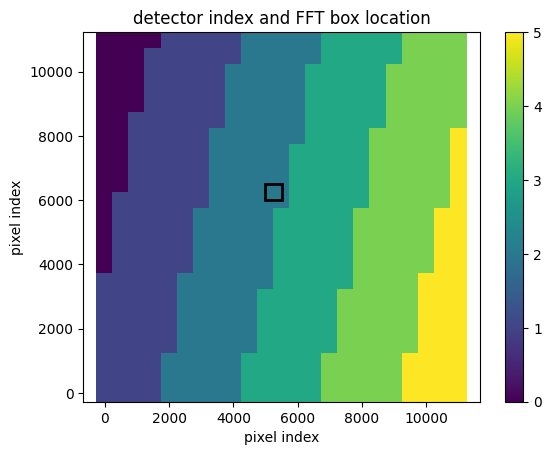

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091664039349386
(31, 31)
(31, 31)
(31, 31)


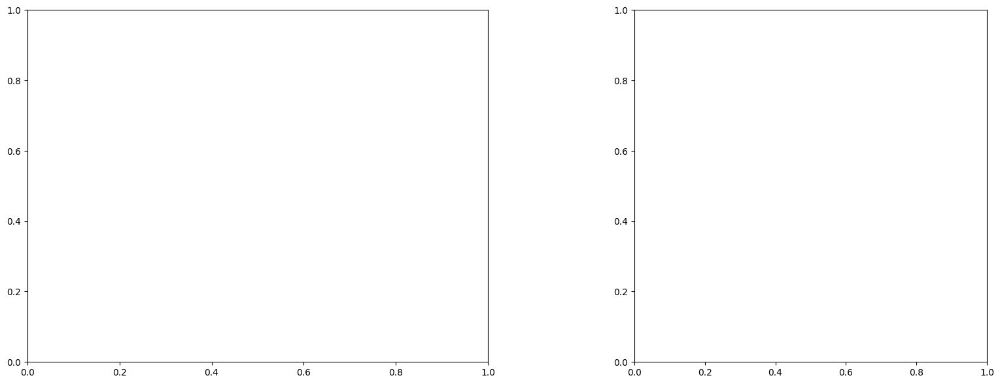

U and V components of current : [0.7779888  1.31574312]
uncertainties for U and V: 1.7690418564828136 1.2222944044575073


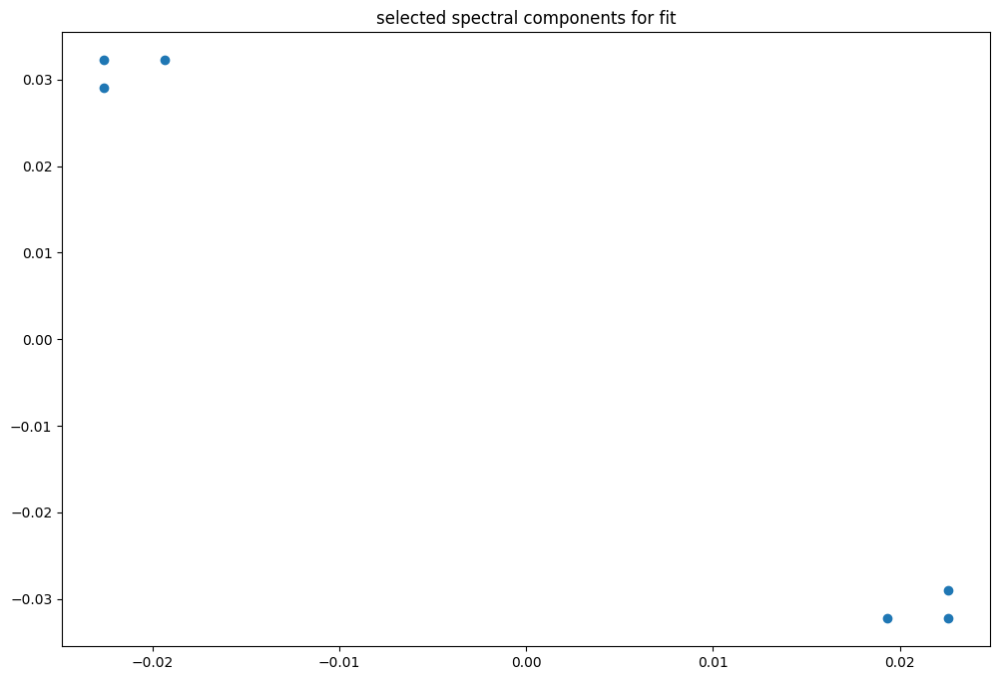

box [5000, 5500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

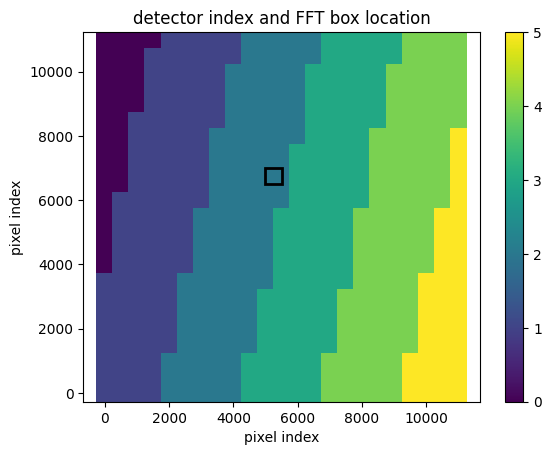

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


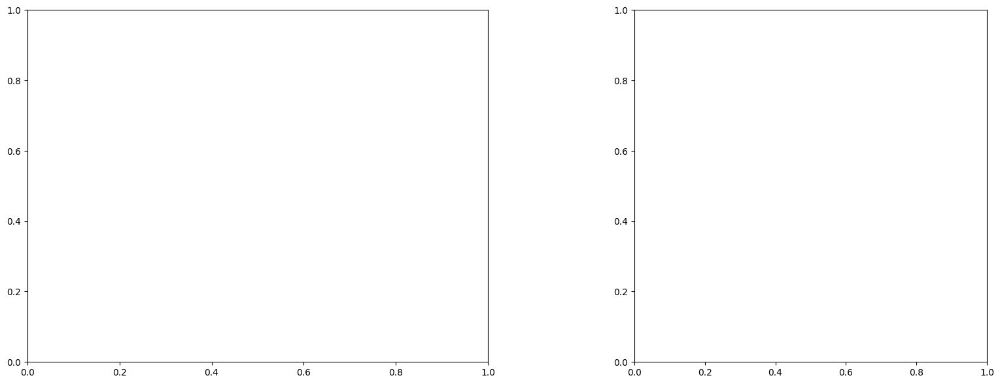

U and V components of current : [-0.173957    0.57826334]
uncertainties for U and V: 0.1144844552421806 0.08487992670250508


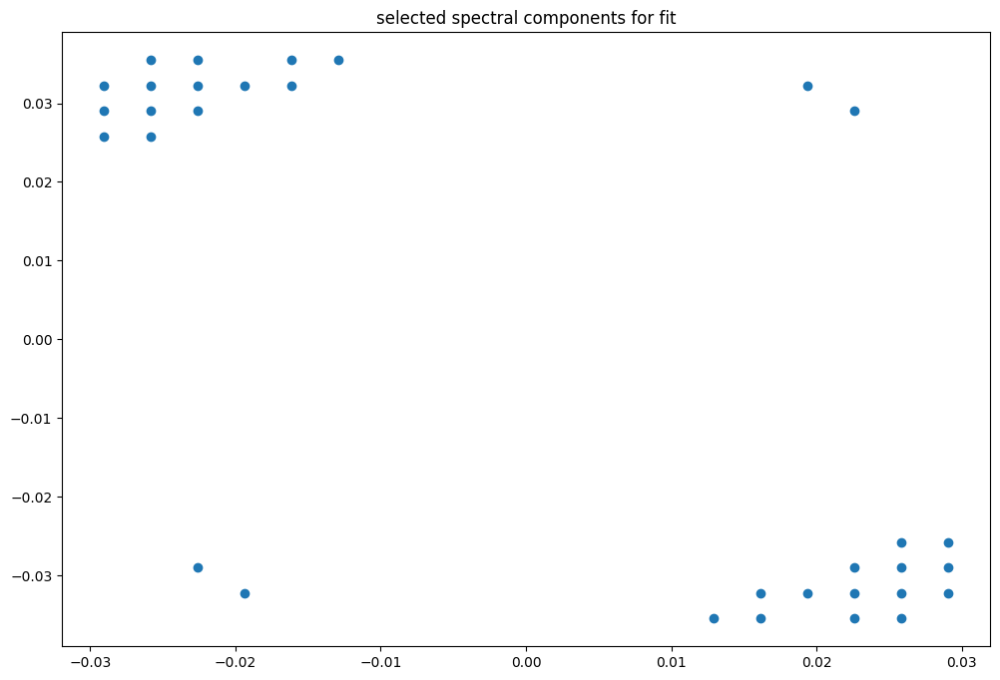

box [5000, 5500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

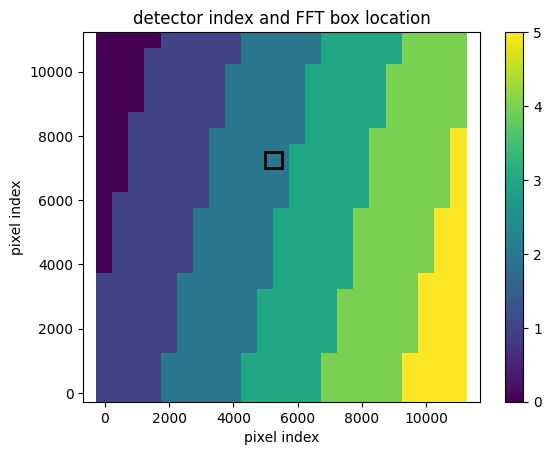

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


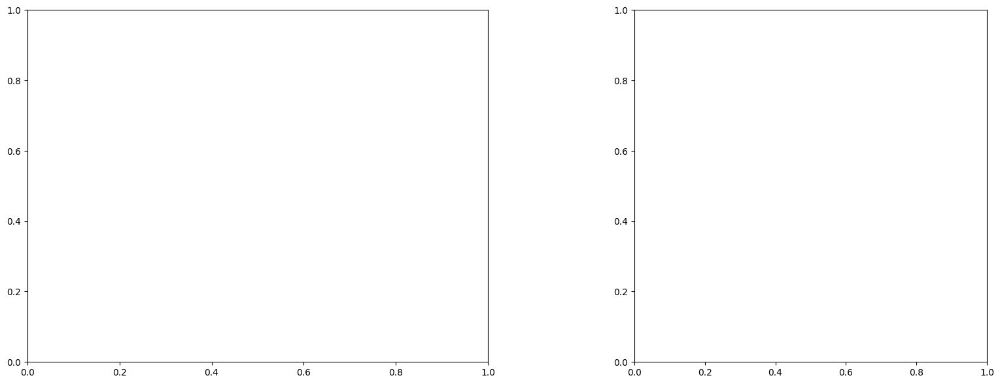

U and V components of current : [0.69889346 1.07341904]
uncertainties for U and V: 0.20563660624151187 0.16027198065889164


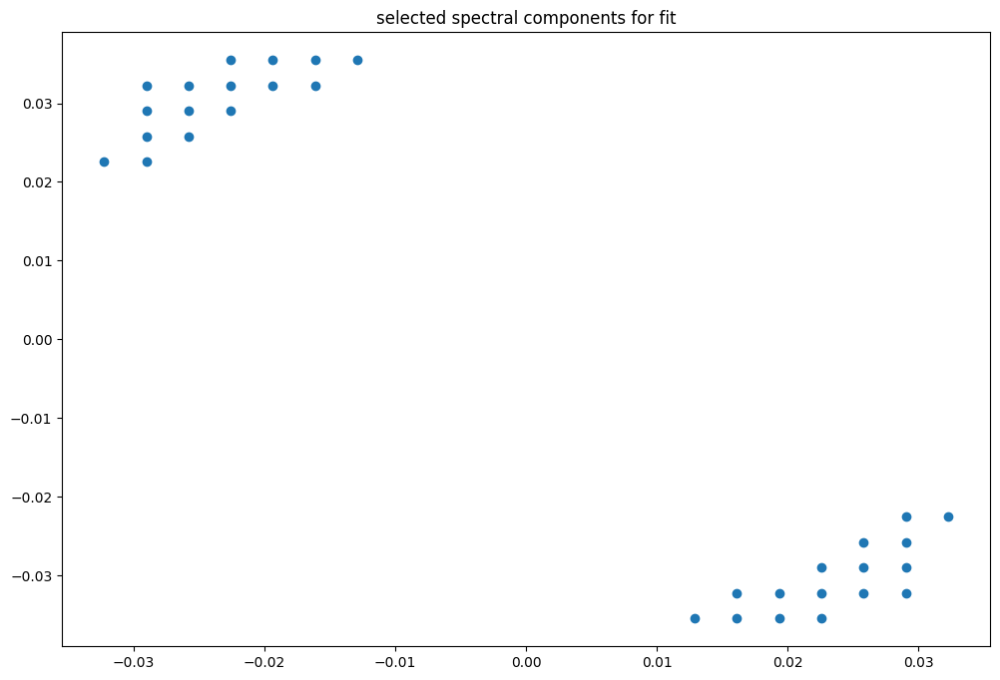

box [5000, 5500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

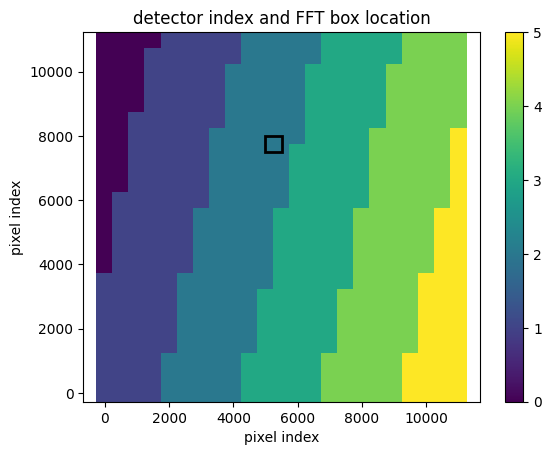

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


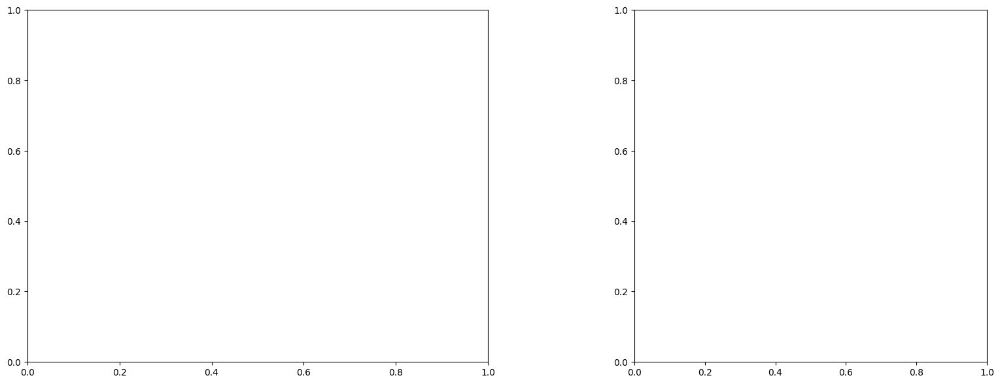

U and V components of current : [0.67230618 0.51622937]
uncertainties for U and V: 0.25674576199991134 0.1995361340512256


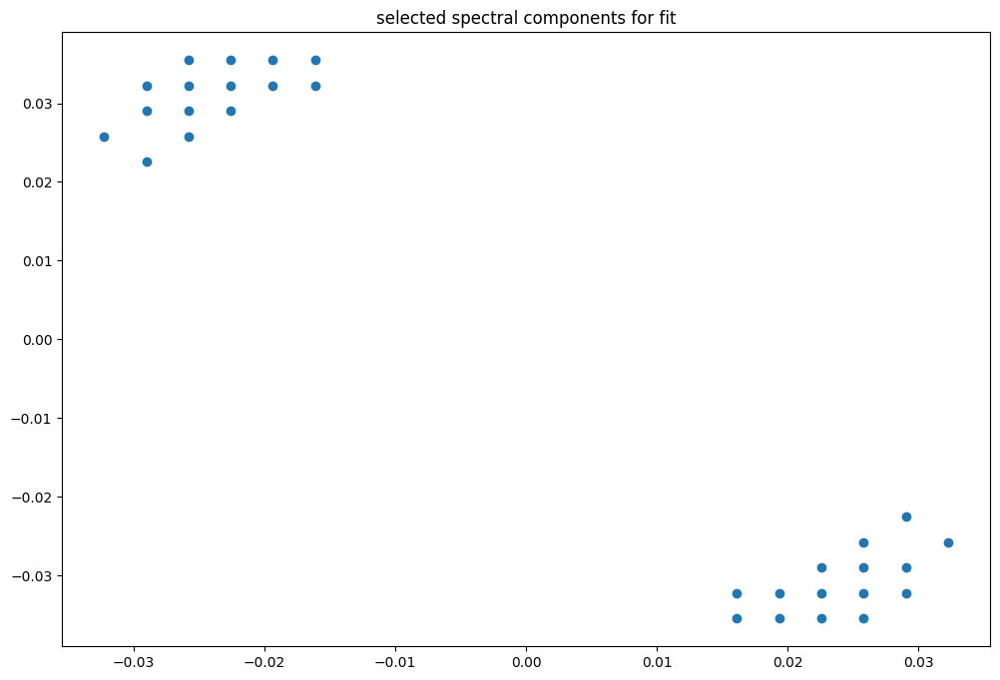

box [5000, 5500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

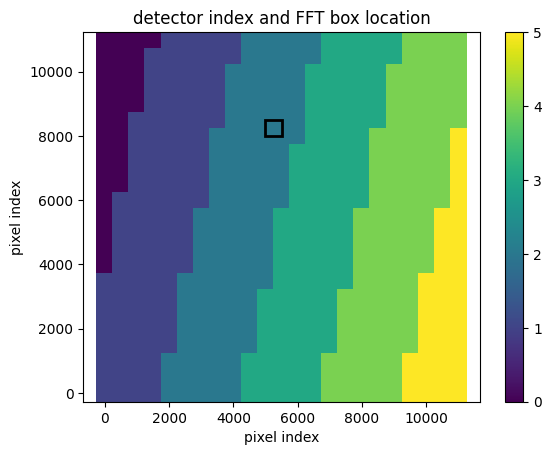

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


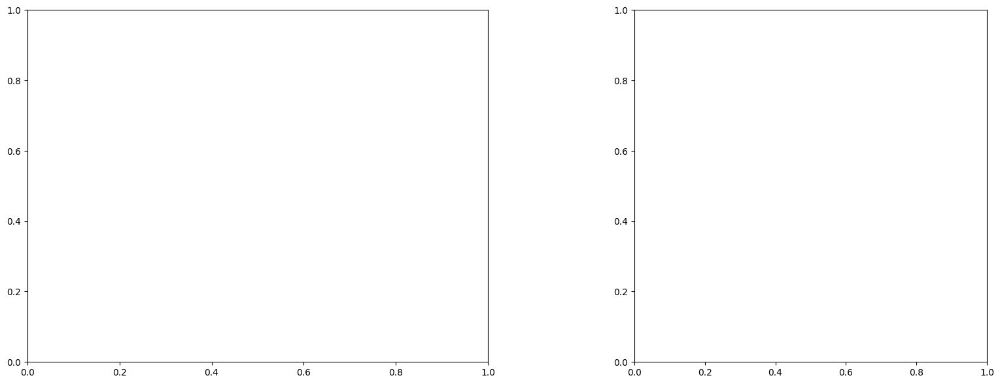

U and V components of current : [0.77928554 0.04756631]
uncertainties for U and V: 0.15415301974481505 0.1339604124745107


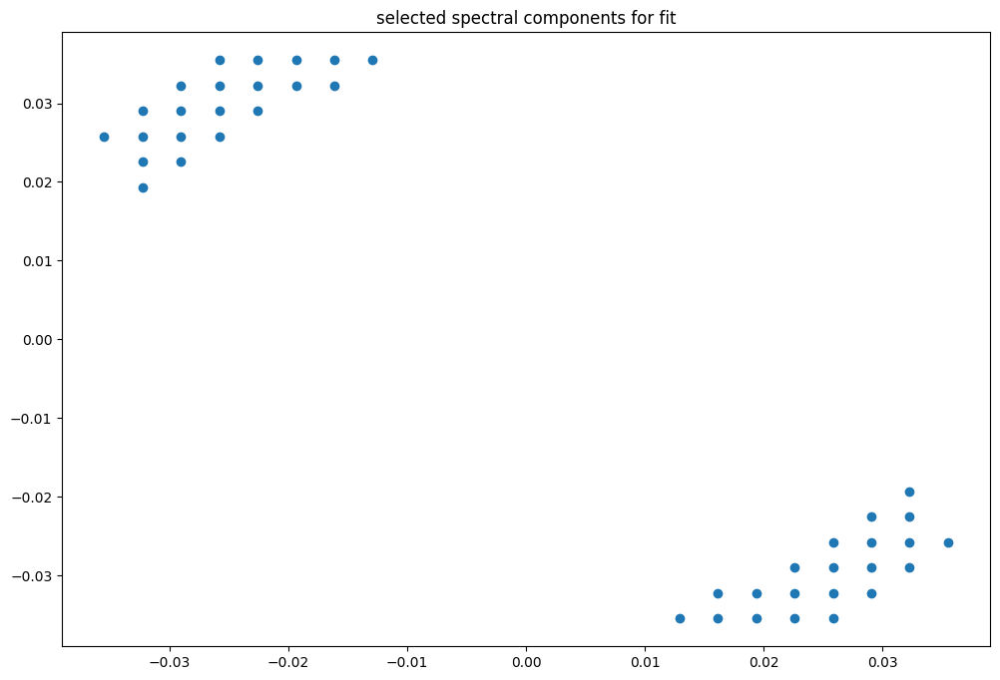

box [5000, 5500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

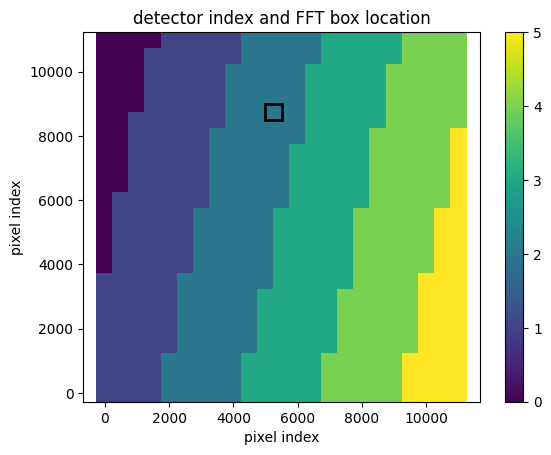

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


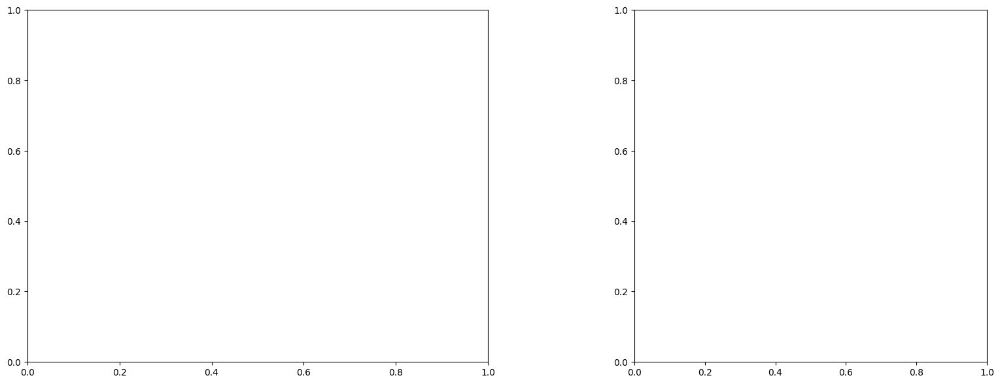

U and V components of current : [ 0.07618087 -0.43064217]
uncertainties for U and V: 0.12217881049207775 0.1064215553066299


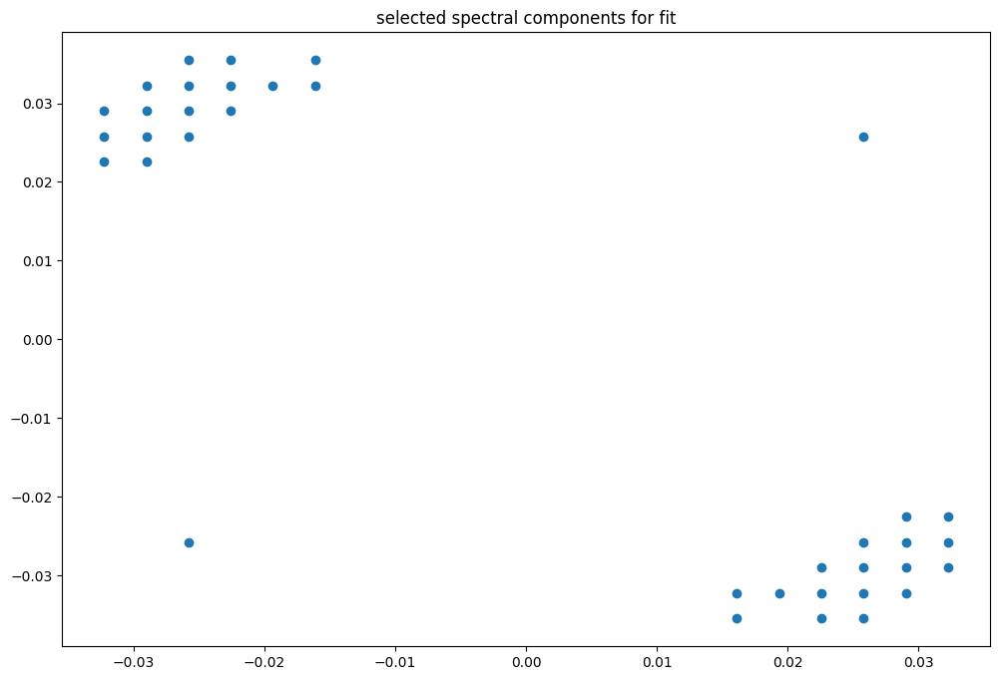

box [5000, 5500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

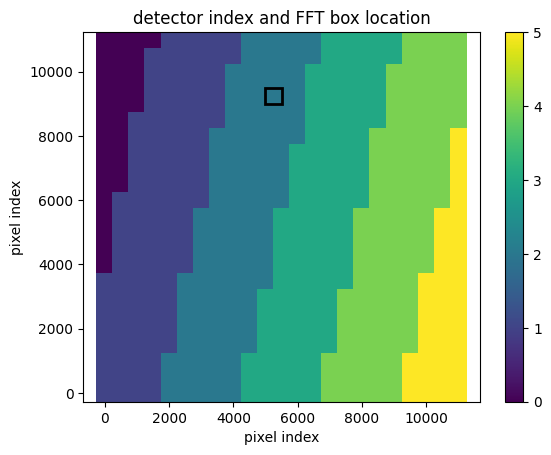

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


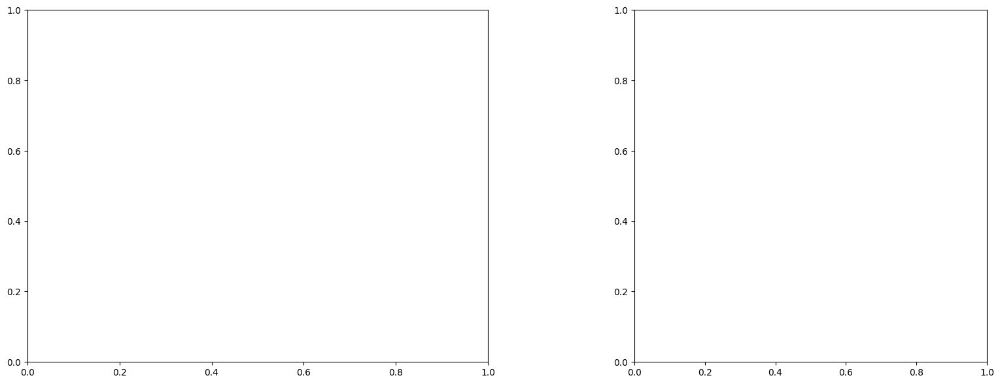

U and V components of current : [ 0.09556776 -0.45781215]
uncertainties for U and V: 0.10851888668261682 0.11754869044498911


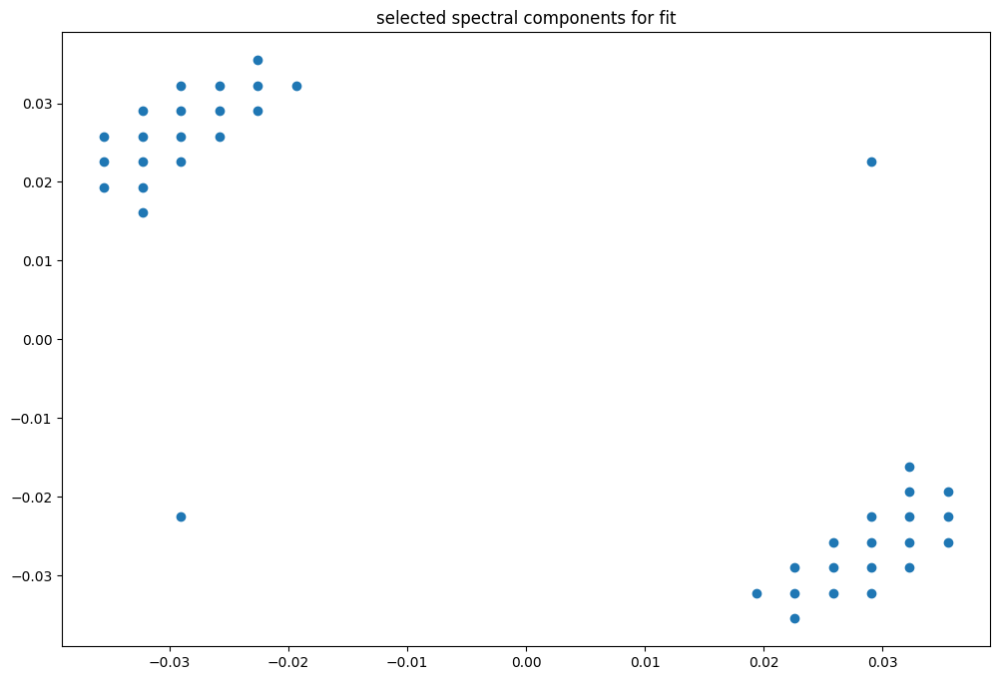

box [5000, 5500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

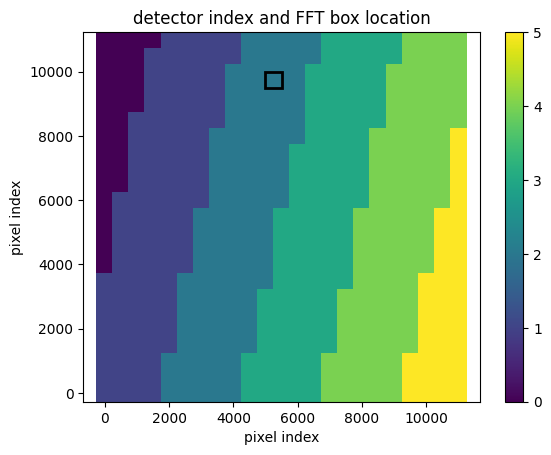

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


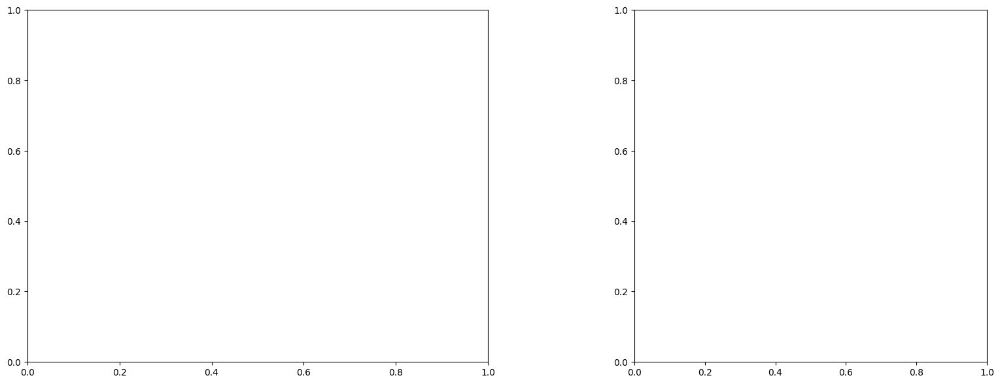

U and V components of current : [0.64824904 0.3296086 ]
uncertainties for U and V: 0.1433630208393005 0.15848127510948615


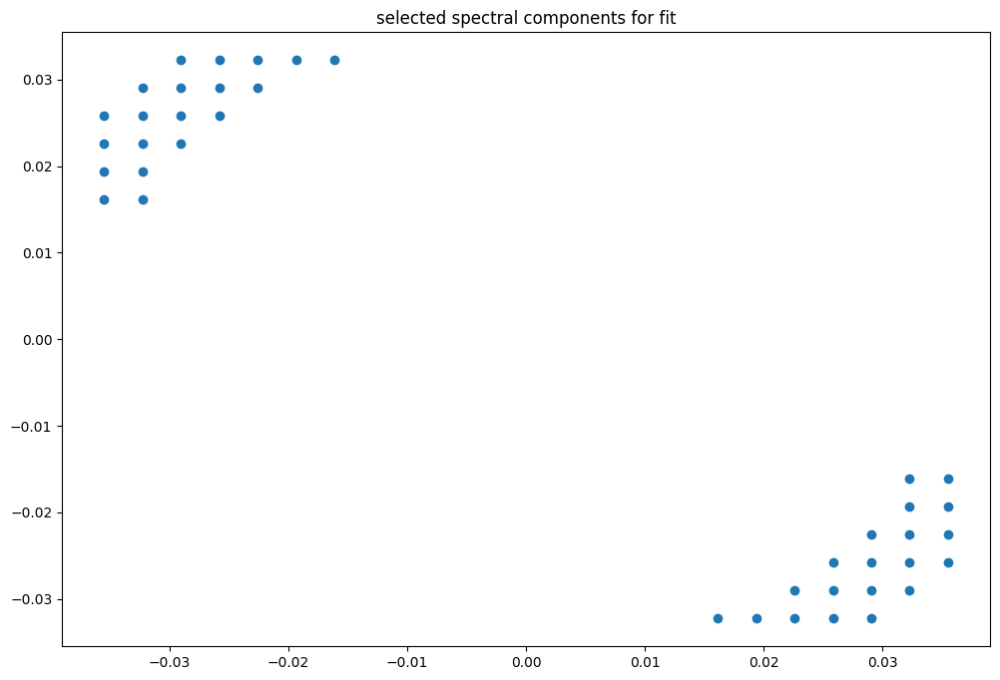

box [5000, 5500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

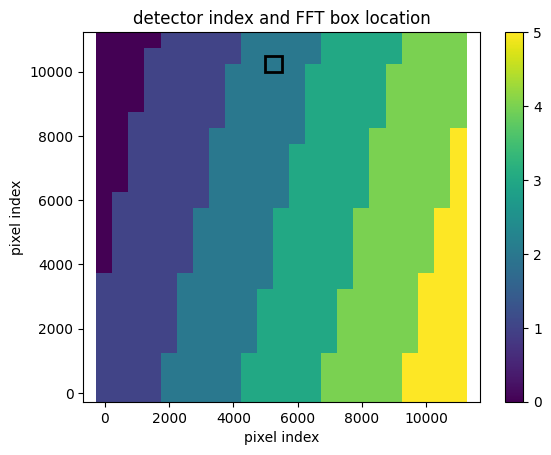

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


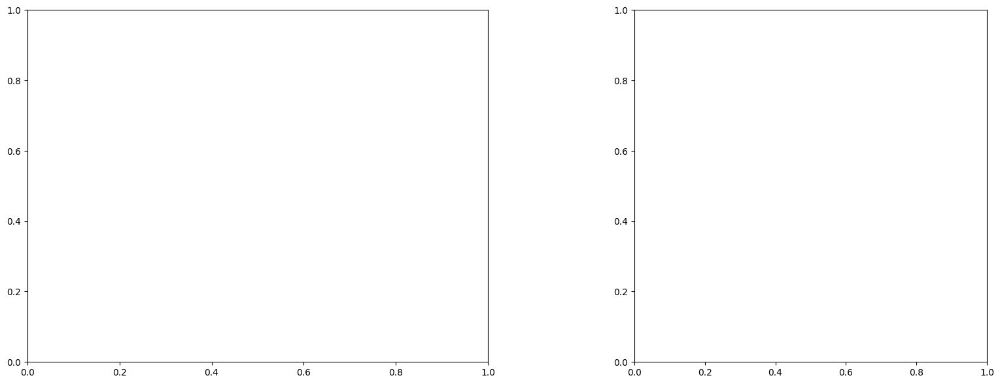

U and V components of current : [0.72314411 0.20640007]
uncertainties for U and V: 0.1539755571206415 0.16634044181545982


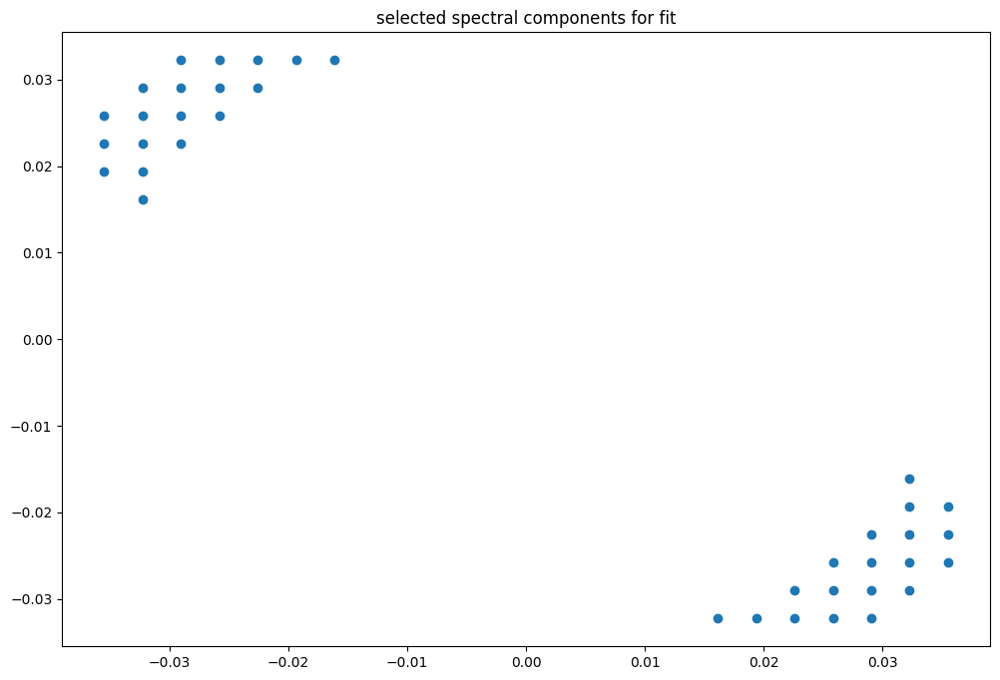

box [5000, 5500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

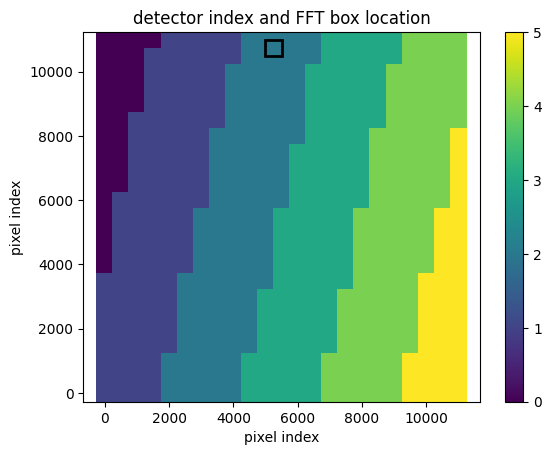

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 30)
(31, 30)
(31, 30)


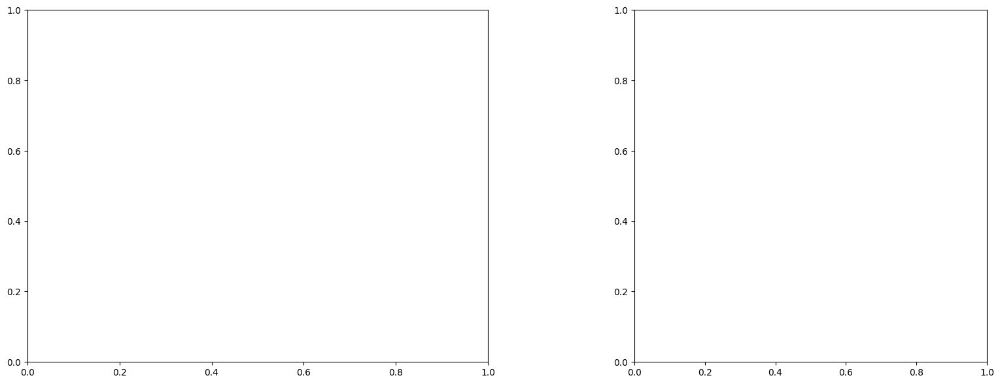

U and V components of current : [ 0.39477281 -0.30334414]
uncertainties for U and V: 0.16139390435078202 0.16483499817961547


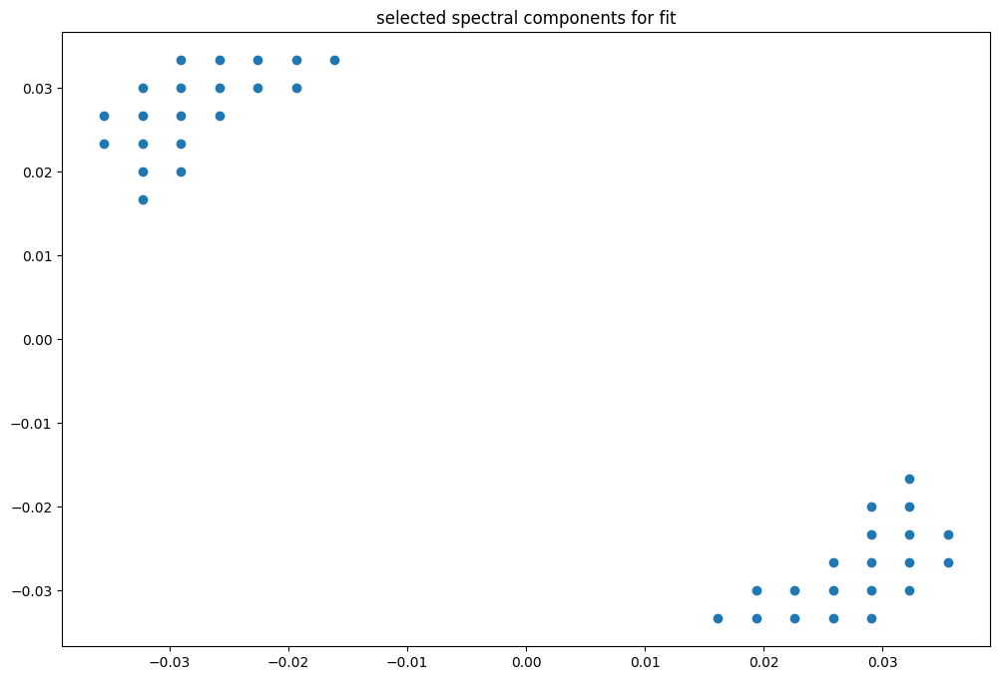

box [5500, 6000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

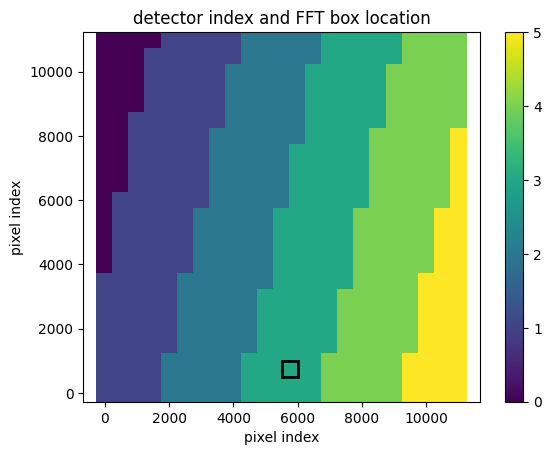

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948016160210164
(31, 31)
(31, 31)
(31, 31)


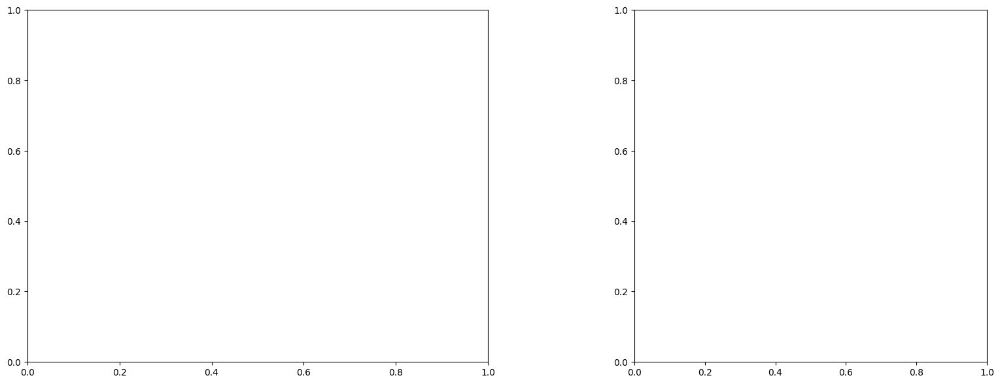

U and V components of current : [0.65859165 1.06697733]
uncertainties for U and V: 0.08847569335714685 0.12794058784878065


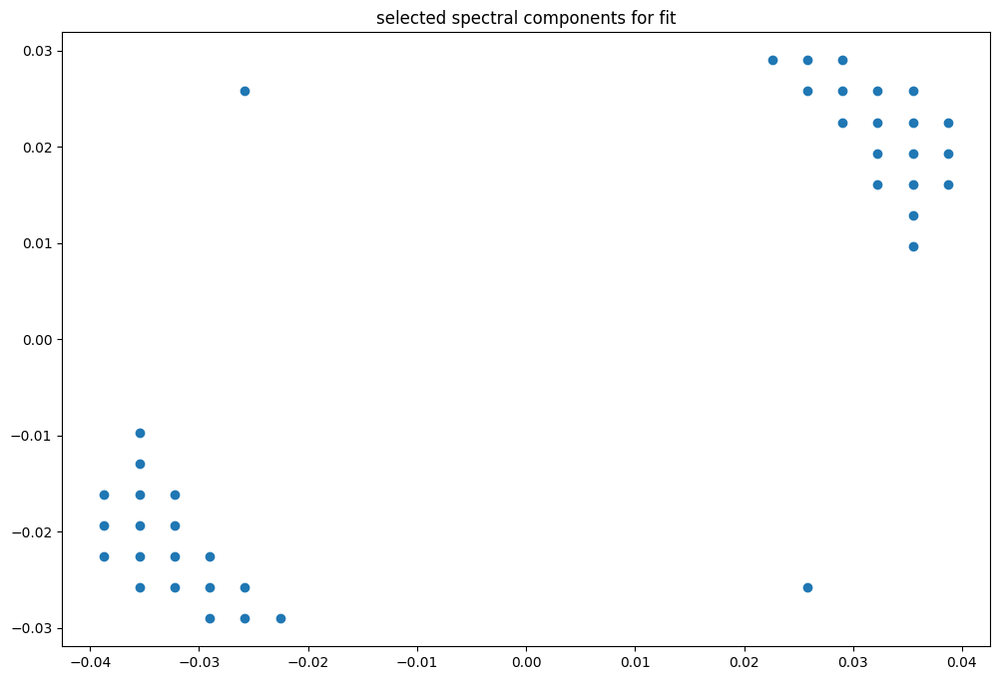

box [5500, 6000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

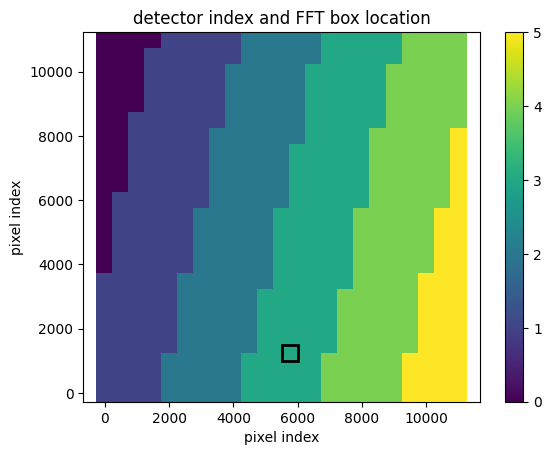

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948016160210164
(31, 31)
(31, 31)
(31, 31)


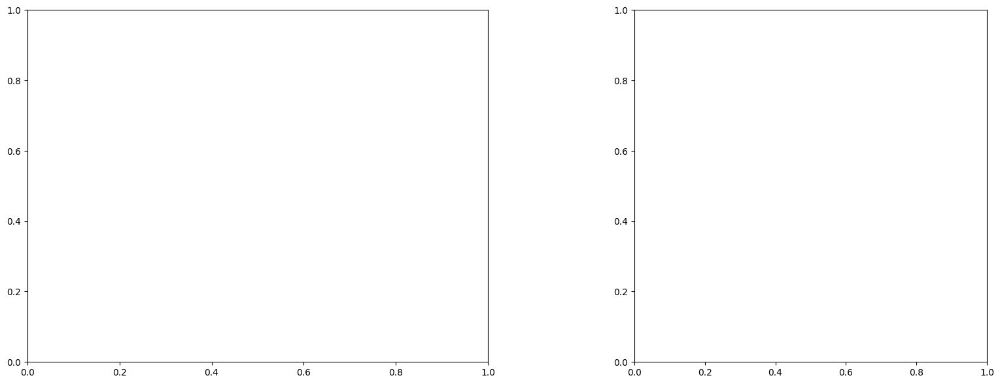

U and V components of current : [0.70622563 1.22242071]
uncertainties for U and V: 0.09336719243352616 0.12683004263710215


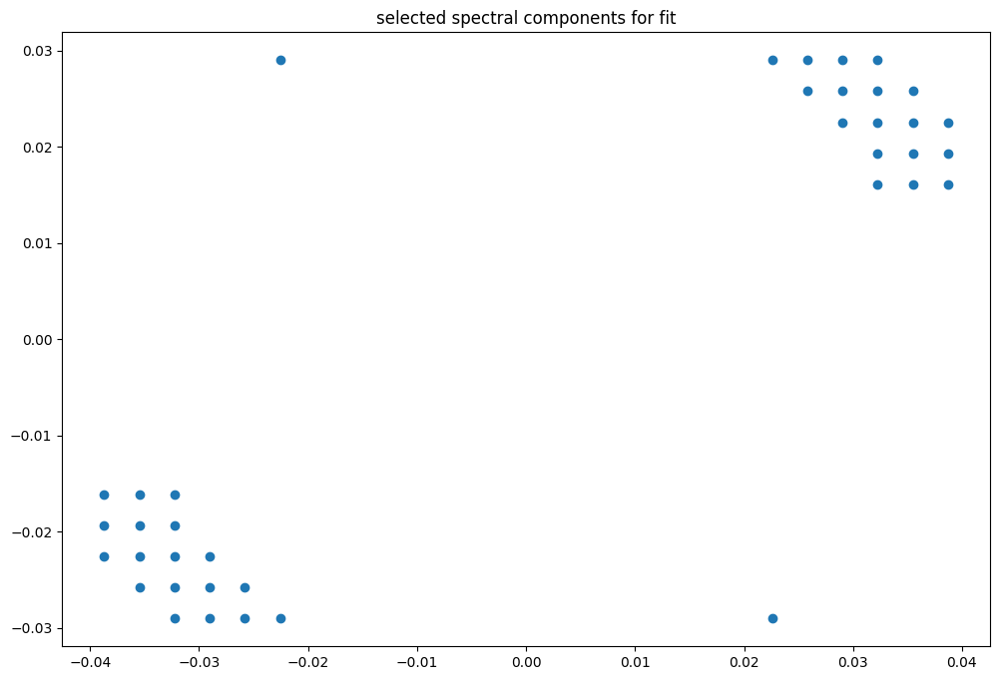

box [5500, 6000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

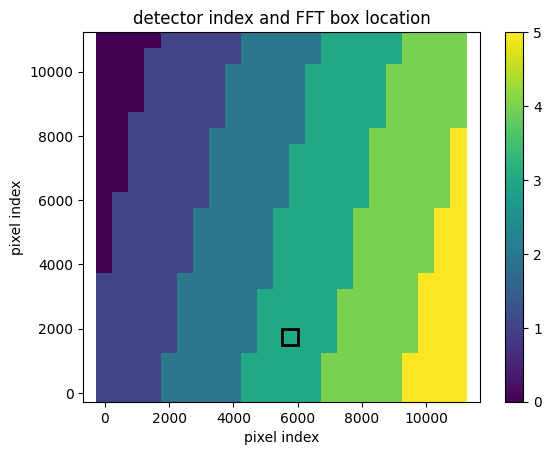

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


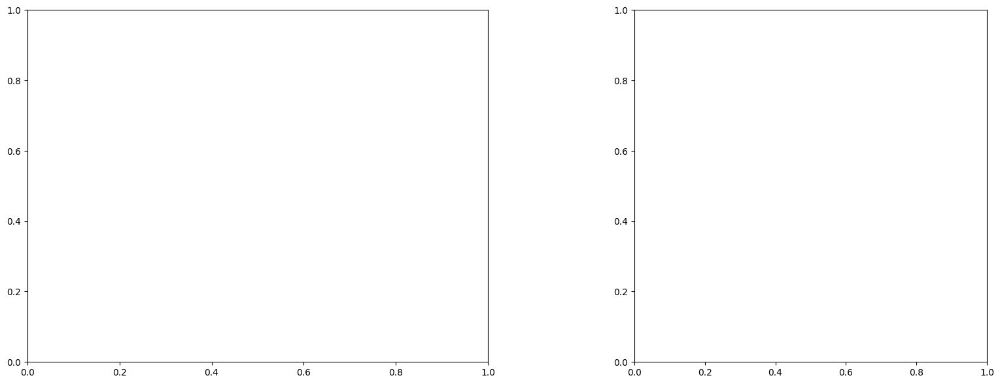

U and V components of current : [0.76696849 1.04836648]
uncertainties for U and V: 0.05284927546696893 0.06675497898172614


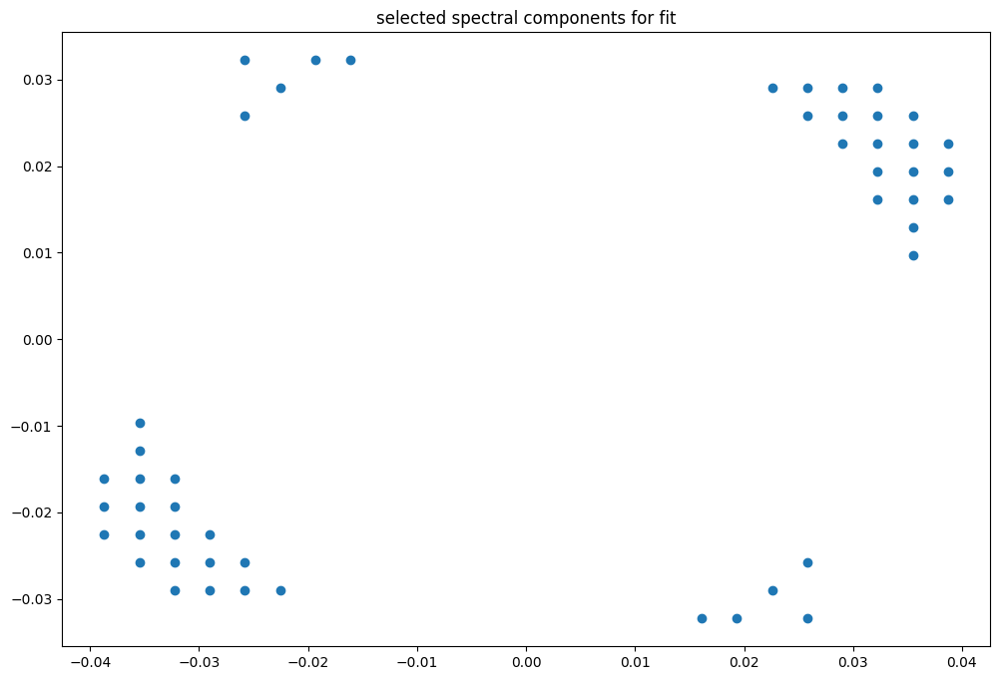

box [5500, 6000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

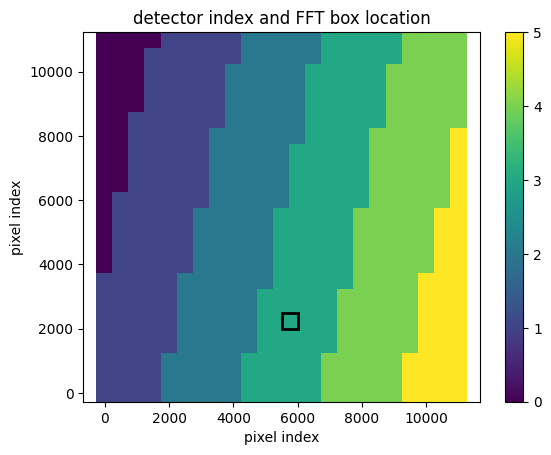

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947943483447979
(31, 31)
(31, 31)
(31, 31)


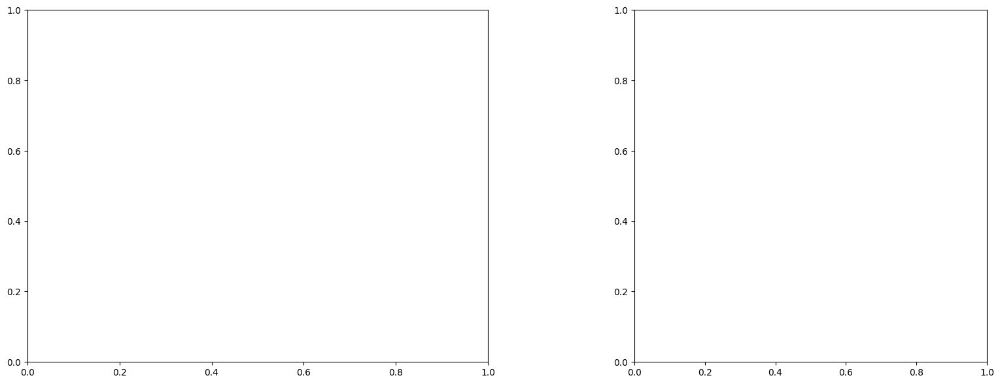

U and V components of current : [0.73714605 1.16742806]
uncertainties for U and V: 0.051042969867817575 0.06242764780373208


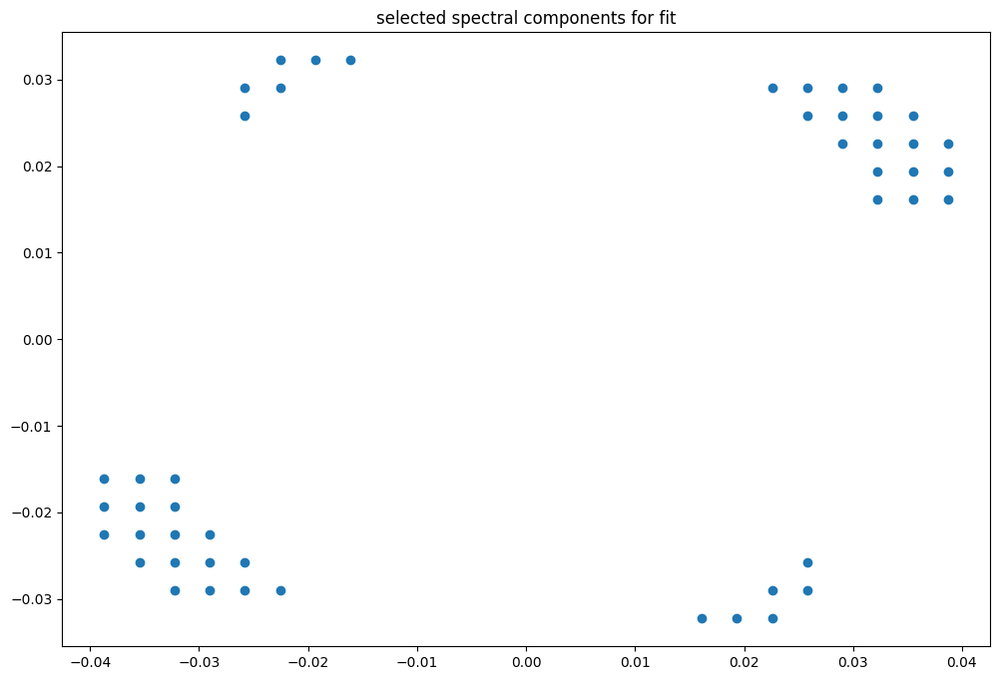

box [5500, 6000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

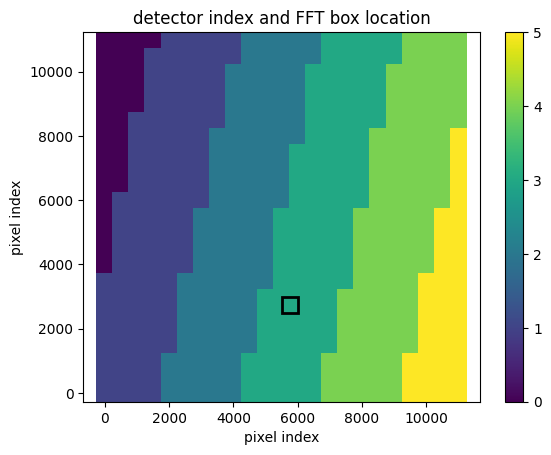

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947908147438635
(31, 31)
(31, 31)
(31, 31)


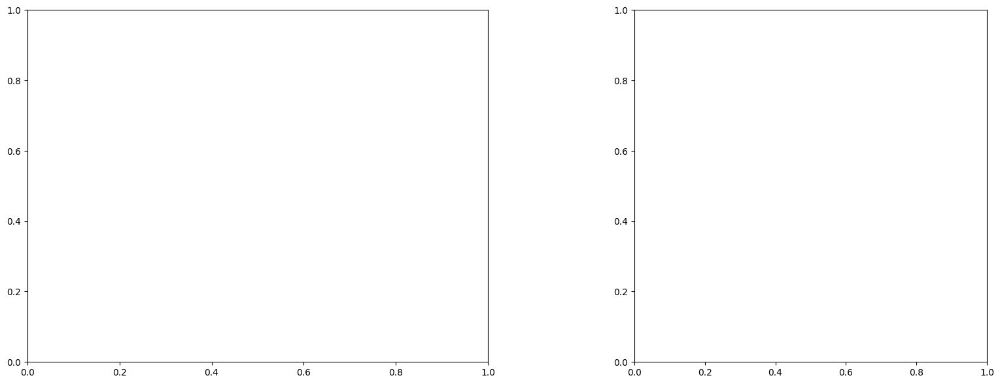

U and V components of current : [0.86112148 1.20152268]
uncertainties for U and V: 0.048045734002713246 0.051180011204092185


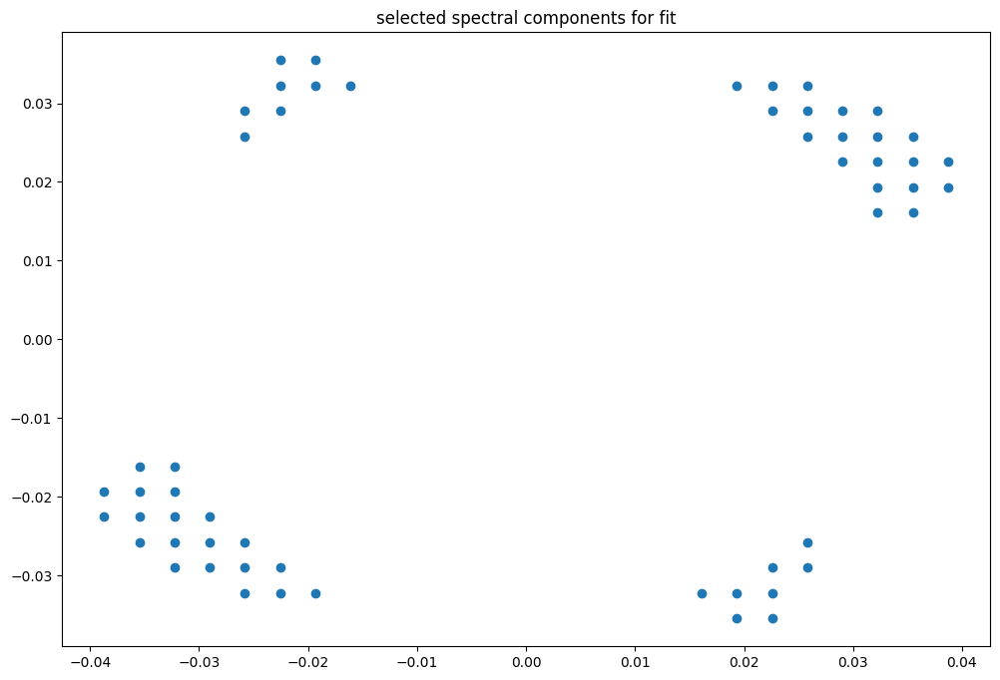

box [5500, 6000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

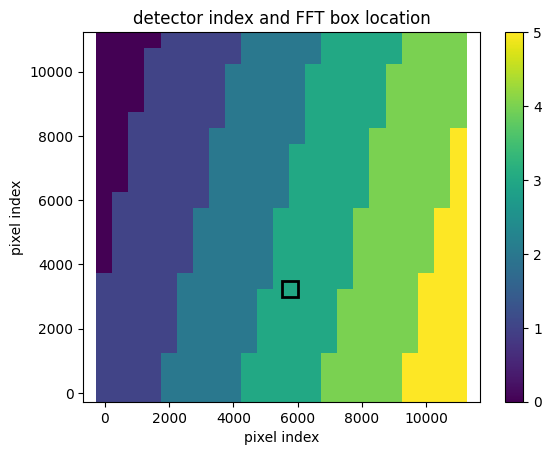

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947908147438635
(31, 31)
(31, 31)
(31, 31)


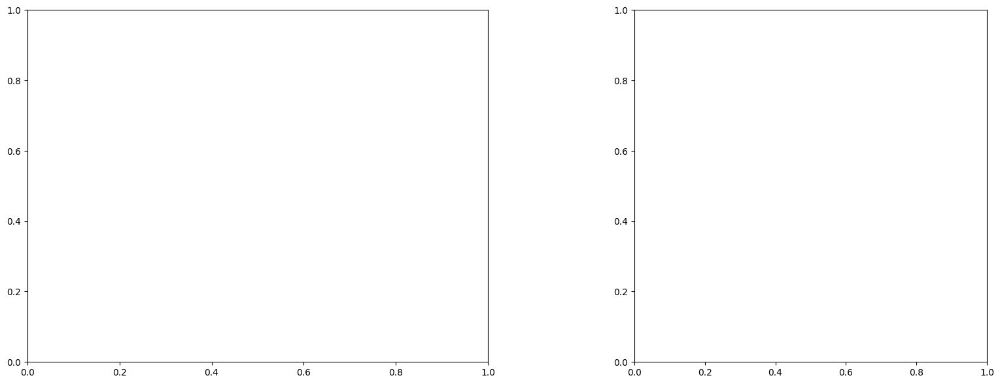

U and V components of current : [0.99843231 1.26289324]
uncertainties for U and V: 0.04960893271659307 0.04713478093983706


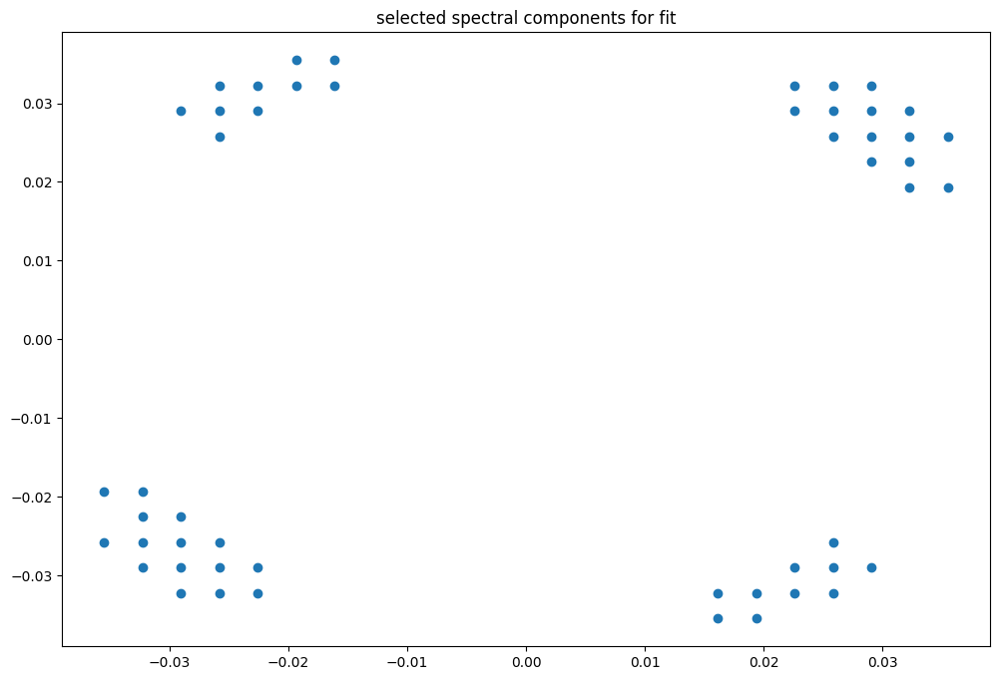

box [5500, 6000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

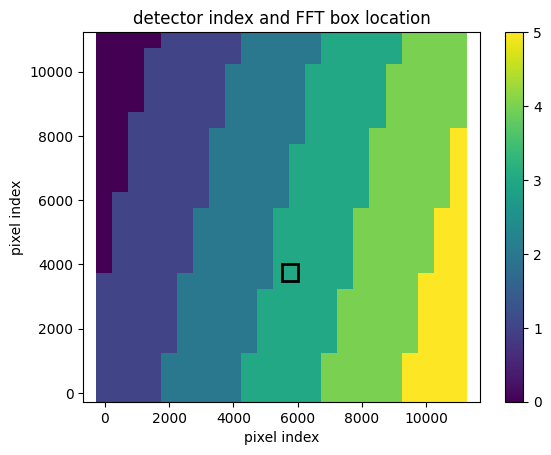

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


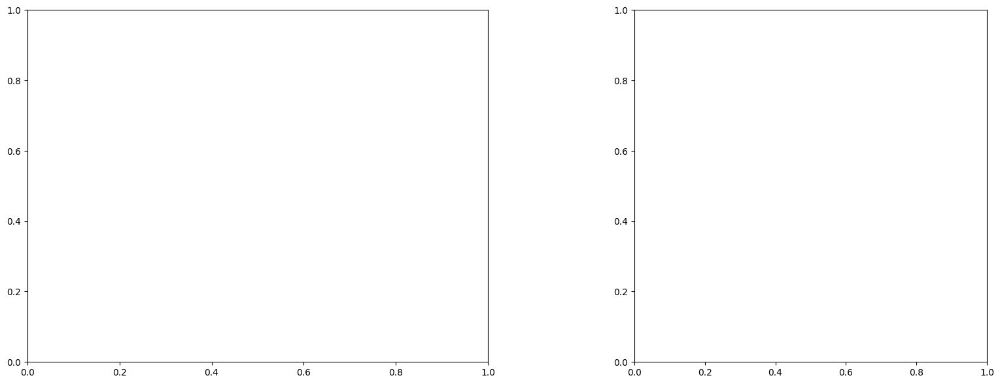

U and V components of current : [0.84817405 1.24898468]
uncertainties for U and V: 0.053301971165315036 0.04783188810172236


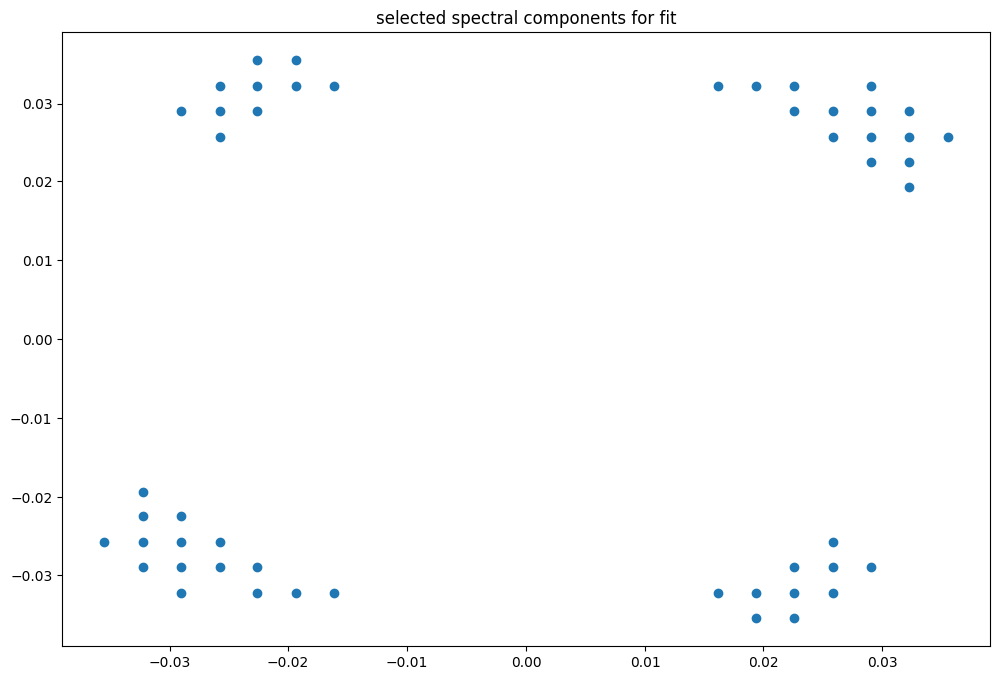

box [5500, 6000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

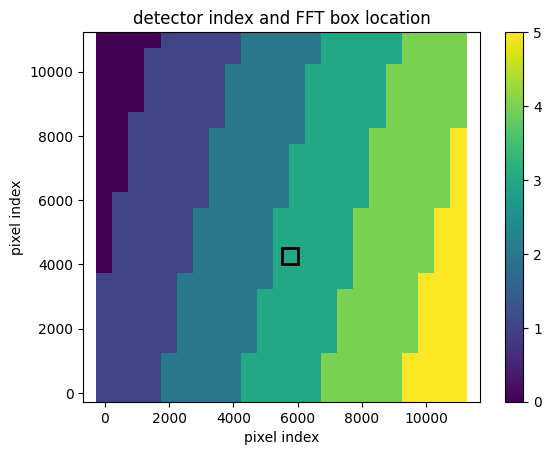

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947843606011624
(31, 31)
(31, 31)
(31, 31)


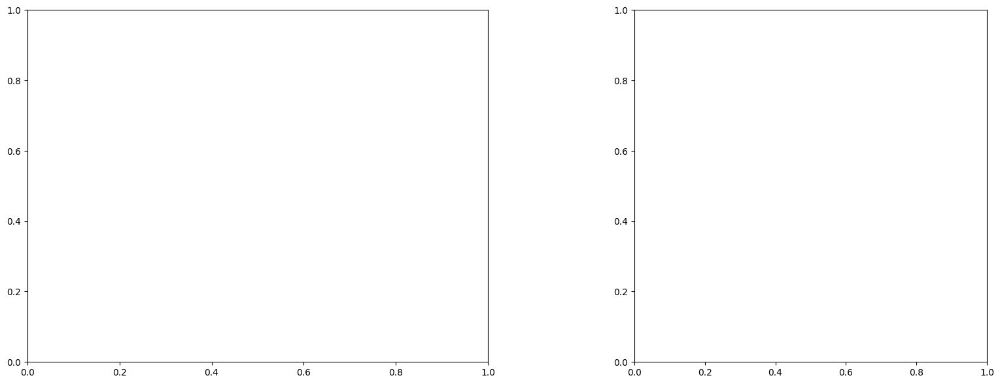

U and V components of current : [1.2127224  1.01652976]
uncertainties for U and V: 0.07136486485601438 0.06554968286457727


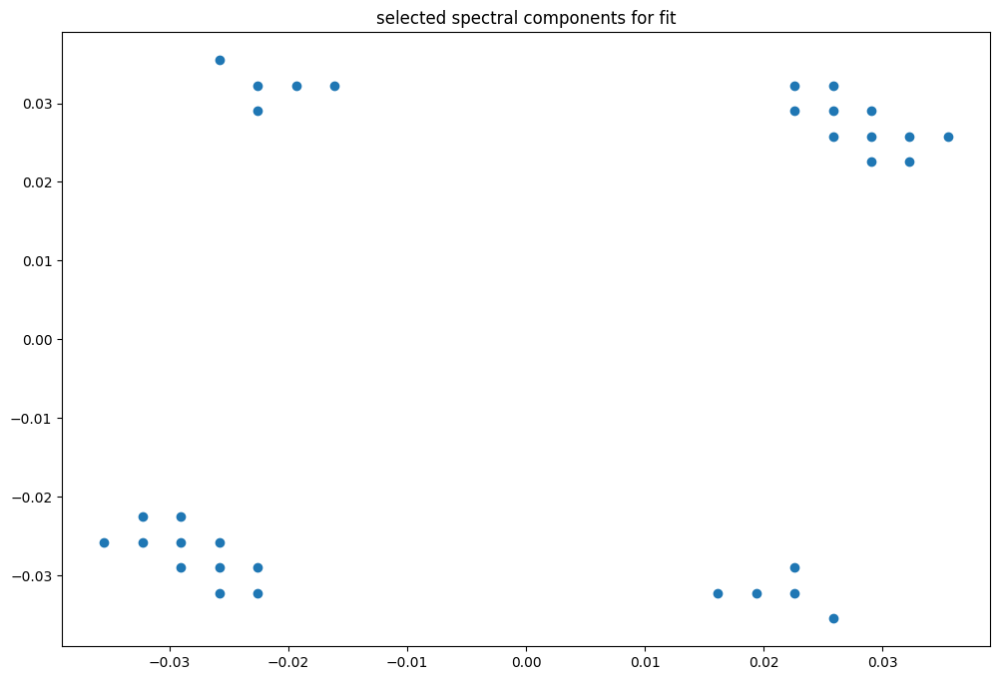

box [5500, 6000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

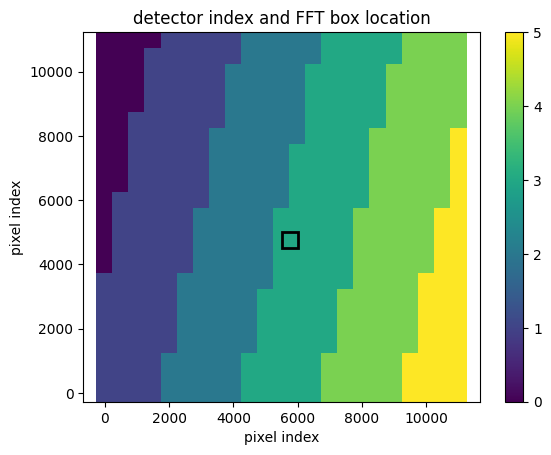

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947843606011624
(31, 31)
(31, 31)
(31, 31)


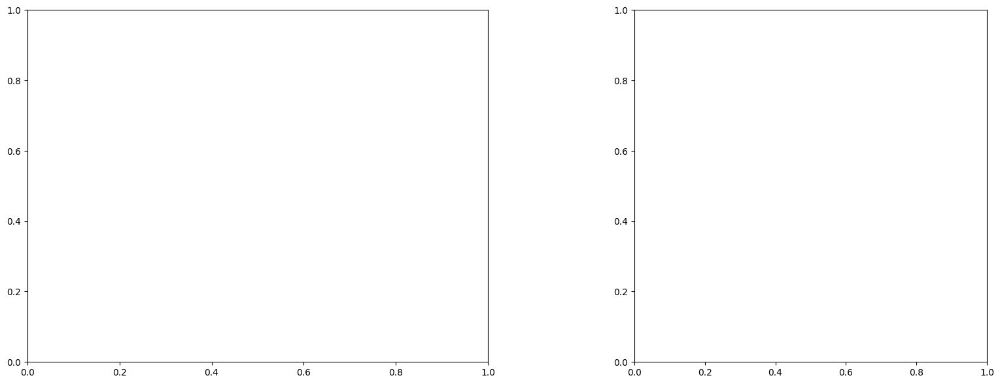

U and V components of current : [1.01945056 0.95116773]
uncertainties for U and V: 0.14893308559387866 0.1040753384270685


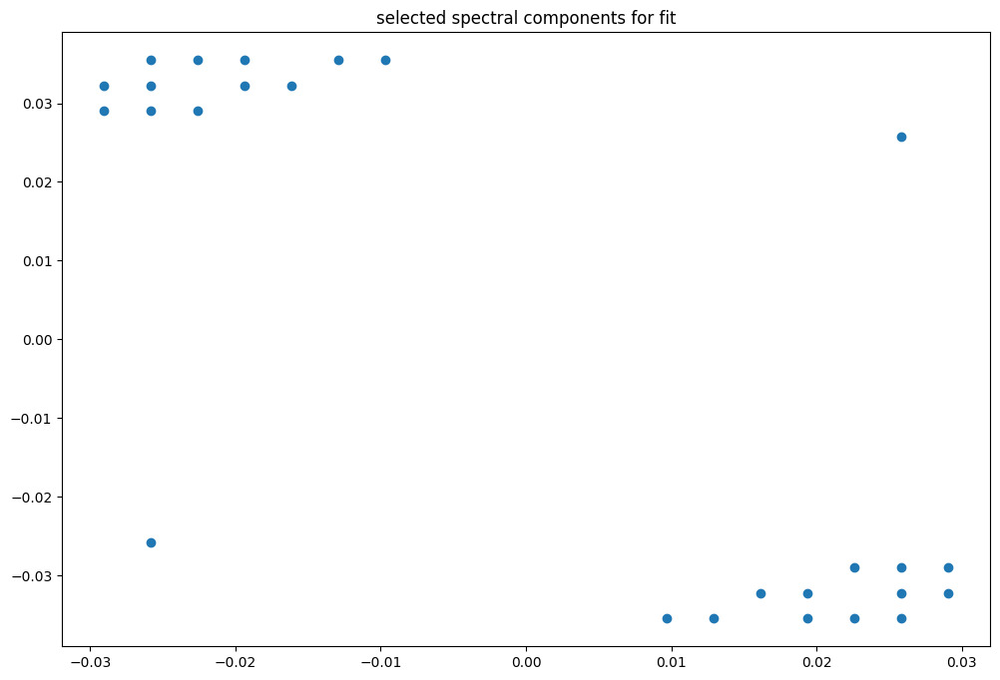

box [5500, 6000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

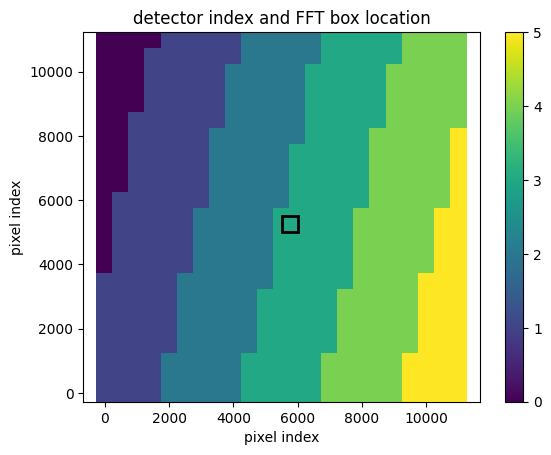

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


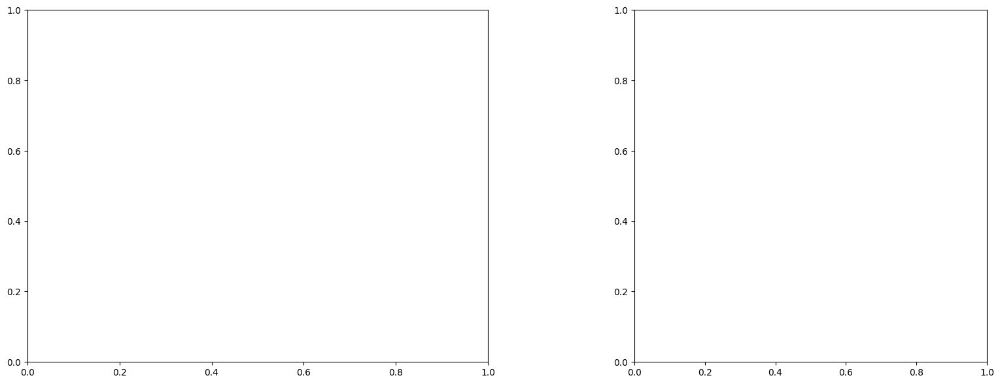

U and V components of current : [1.21659343 0.71358238]
uncertainties for U and V: 0.2839025338645262 0.18676376490169258


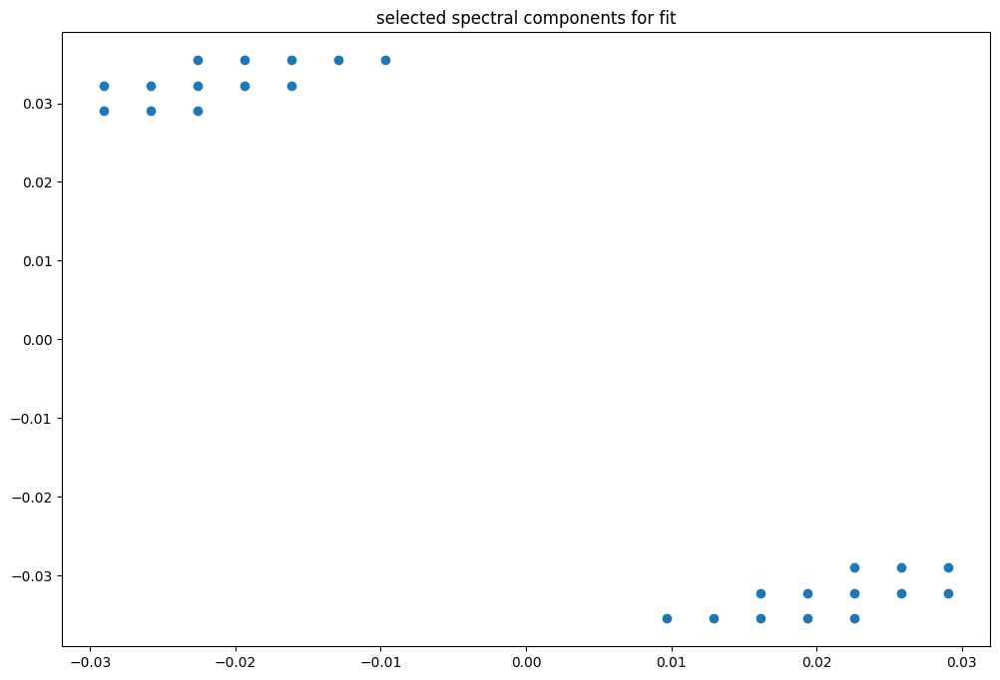

box [5500, 6000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

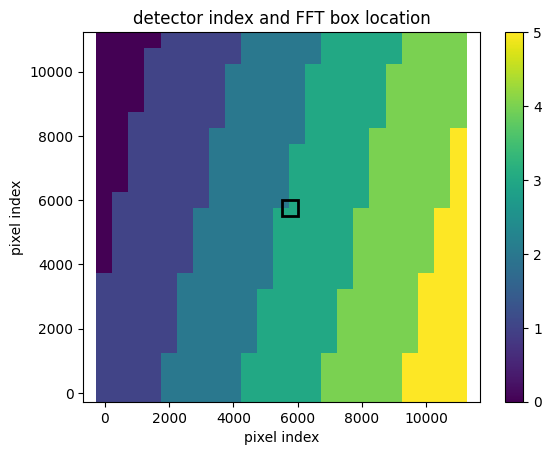

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.96
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947777013080478
(31, 31)
(31, 31)
(31, 31)


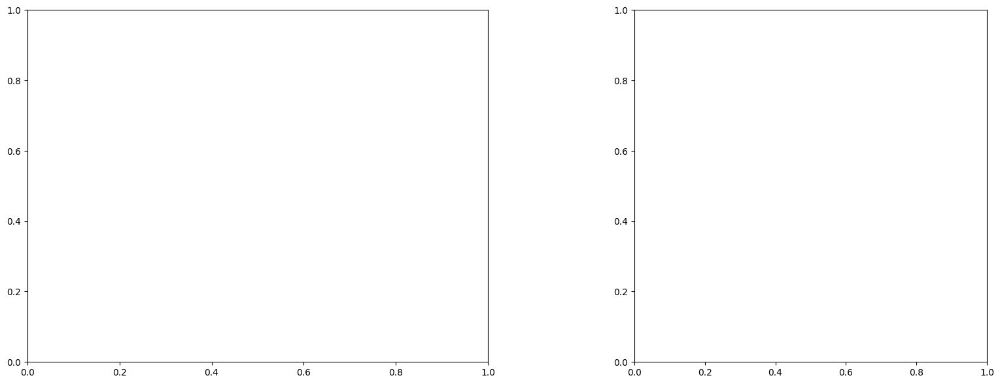

LinAlgError: Singular matrix

box [5500, 6000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

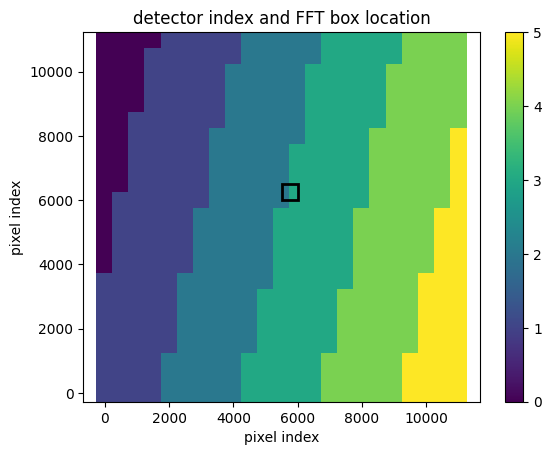

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


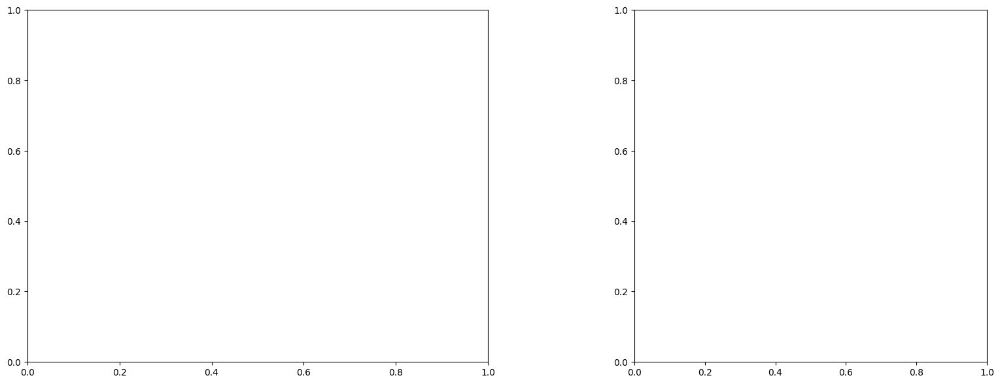

LinAlgError: Singular matrix

box [5500, 6000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

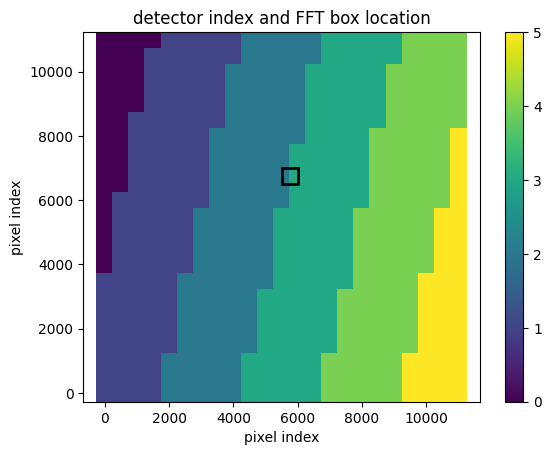

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091634847532591
(31, 31)
(31, 31)
(31, 31)


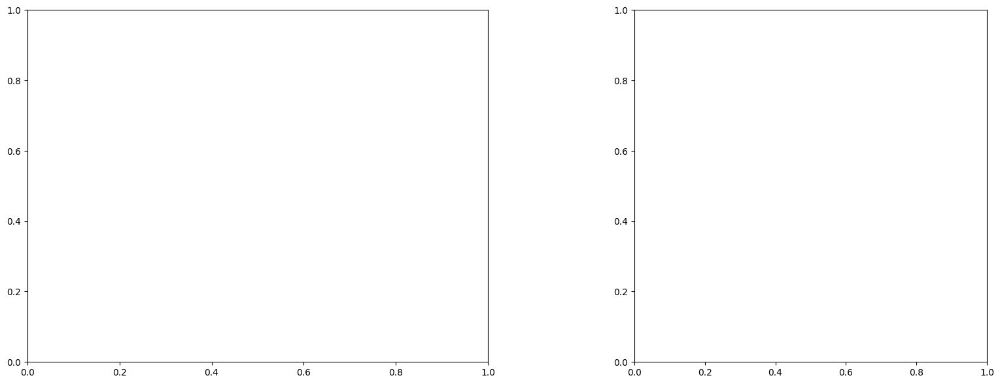

LinAlgError: Singular matrix

box [5500, 6000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

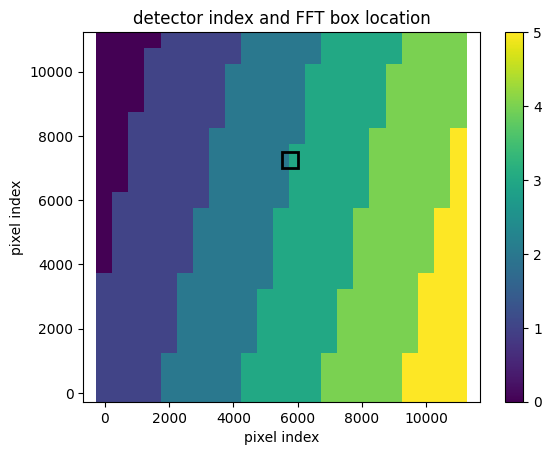

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091602460131361
(31, 31)
(31, 31)
(31, 31)


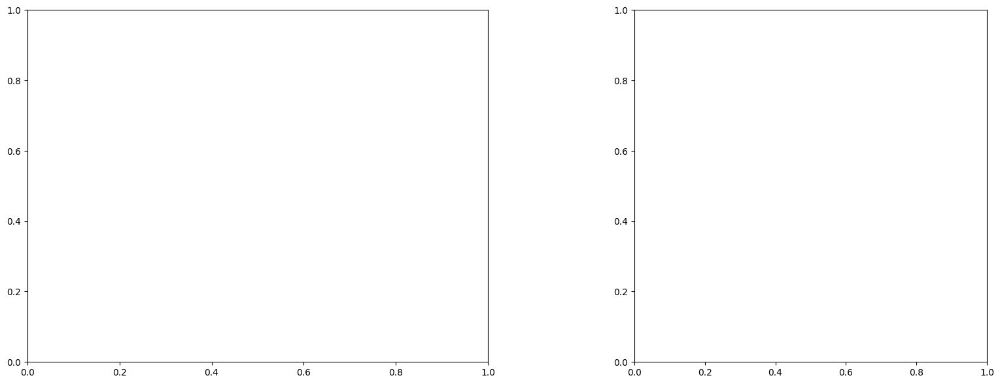

LinAlgError: Singular matrix

box [5500, 6000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

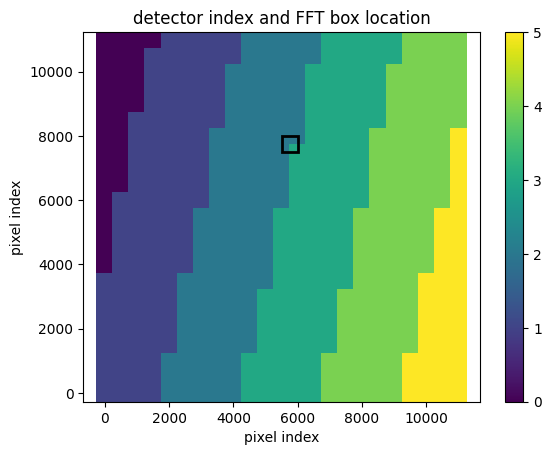

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009157167926356
(31, 31)
(31, 31)
(31, 31)


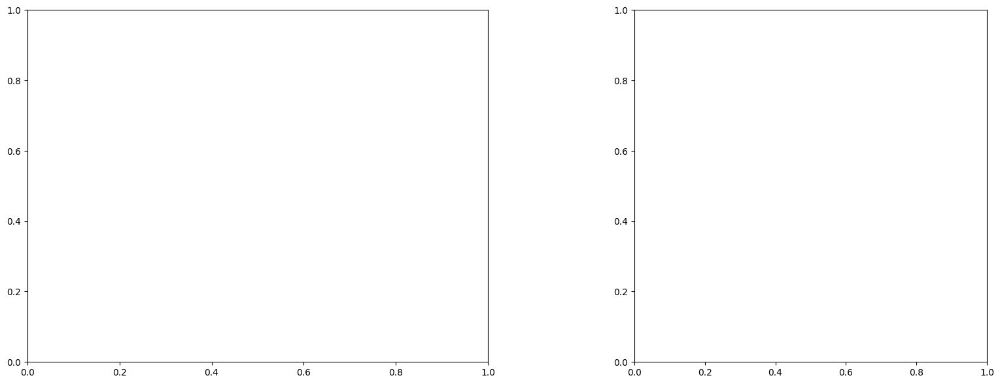

U and V components of current : [0.91995148 1.23843063]
uncertainties for U and V: 0.2676667286465809 0.20700132624866857


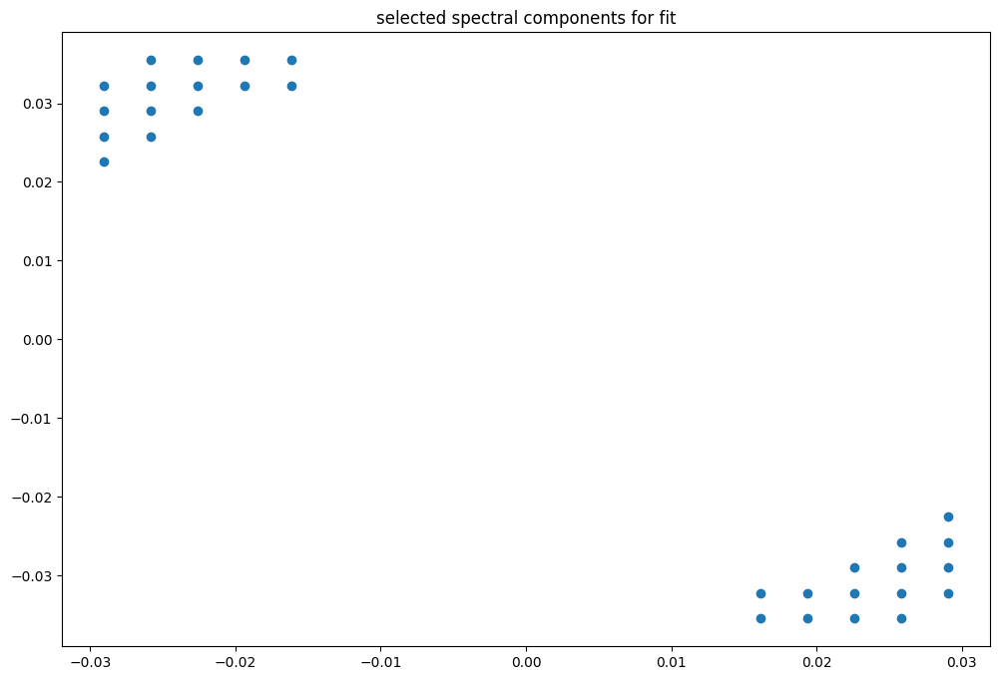

box [5500, 6000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

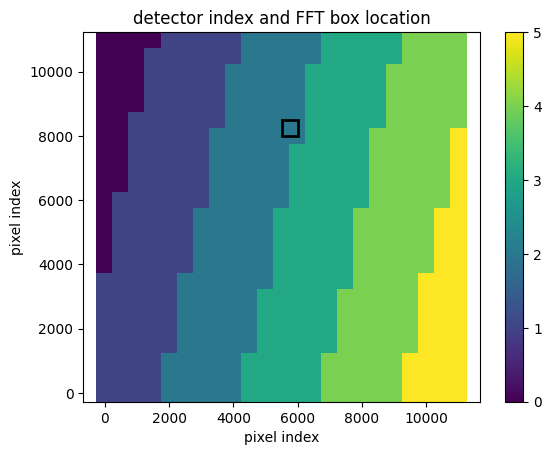

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


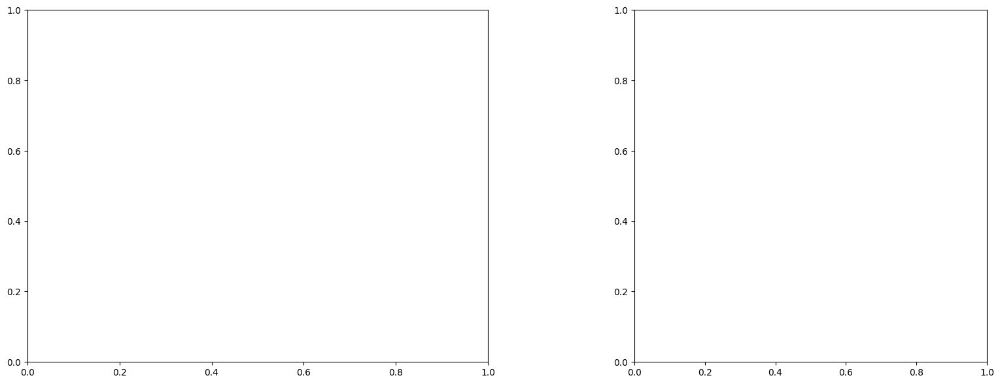

U and V components of current : [0.64443775 0.13727425]
uncertainties for U and V: 0.1793310370358732 0.14322600562669094


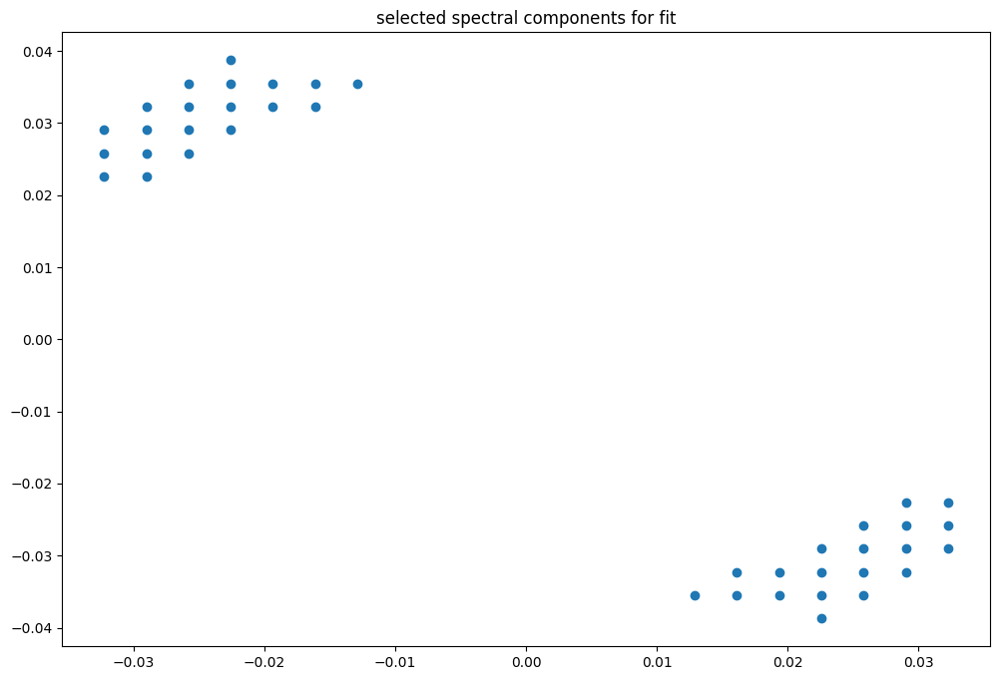

box [5500, 6000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

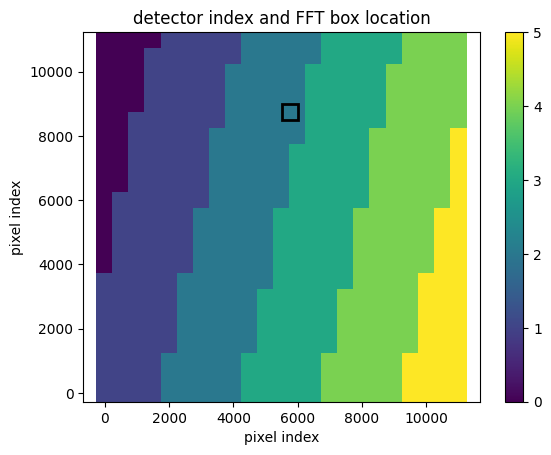

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


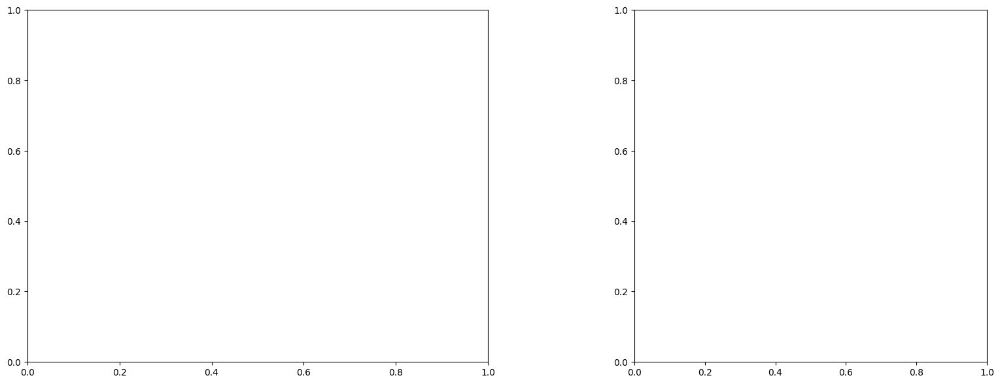

U and V components of current : [1.01063036 0.46094253]
uncertainties for U and V: 0.15430313518385483 0.13995942419125976


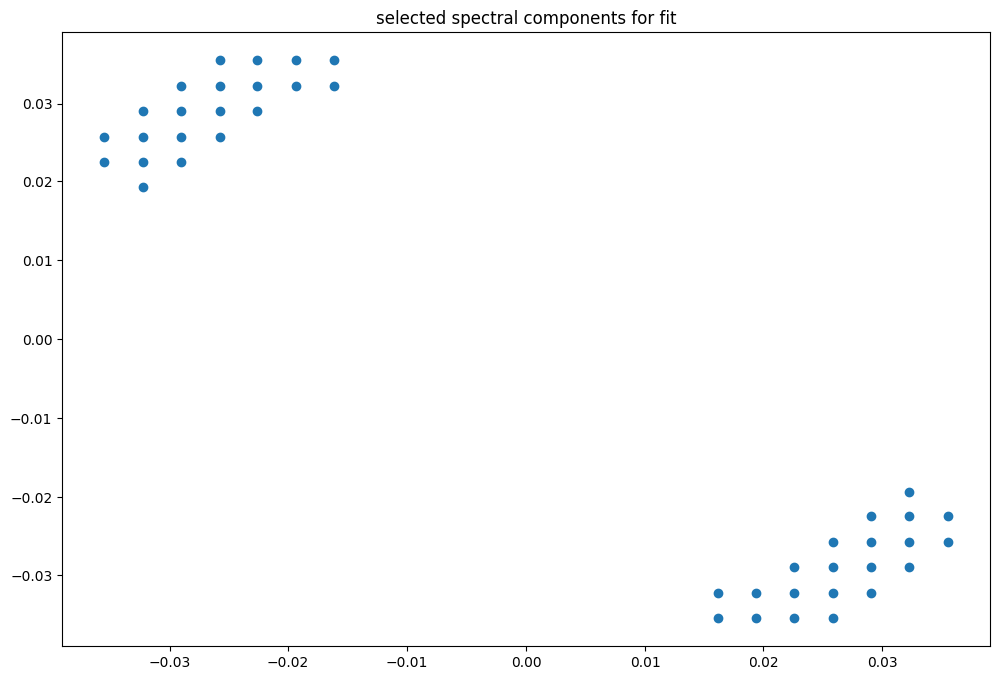

box [5500, 6000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

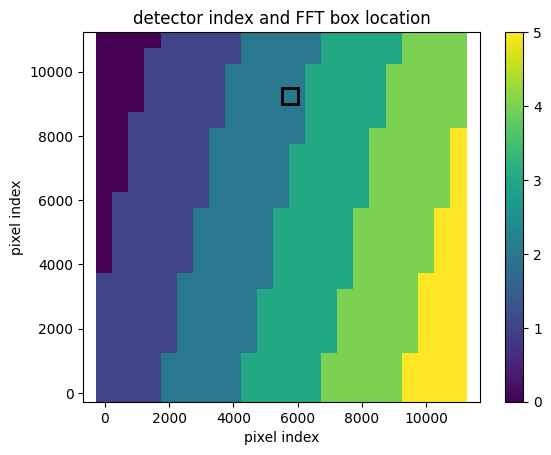

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


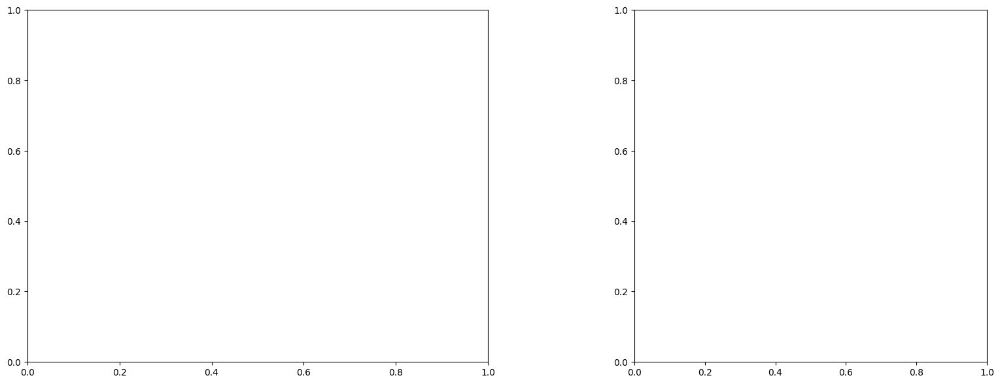

U and V components of current : [0.47485577 0.0348948 ]
uncertainties for U and V: 0.16183929840700056 0.15356481010499398


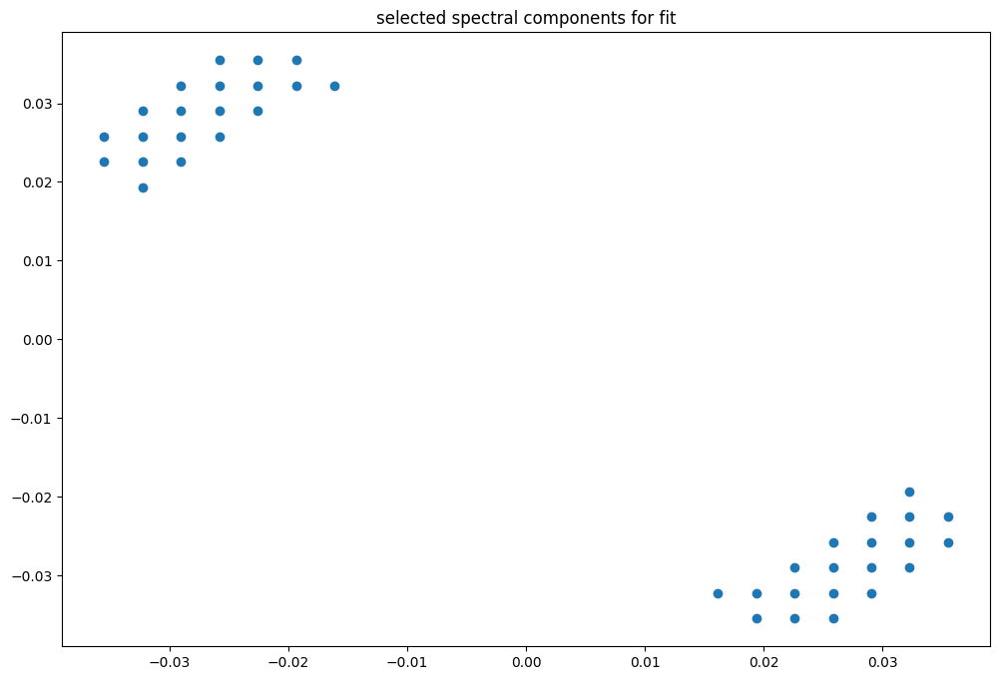

box [5500, 6000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

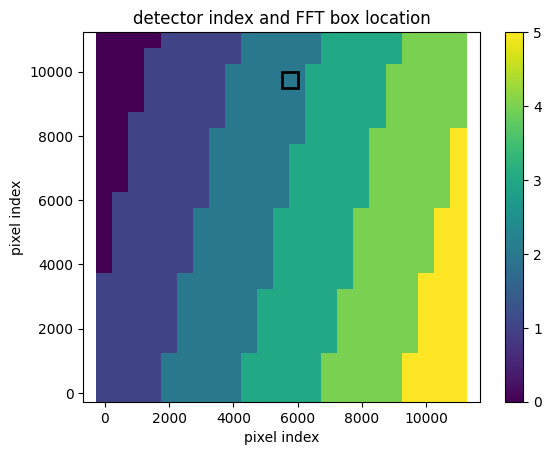

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


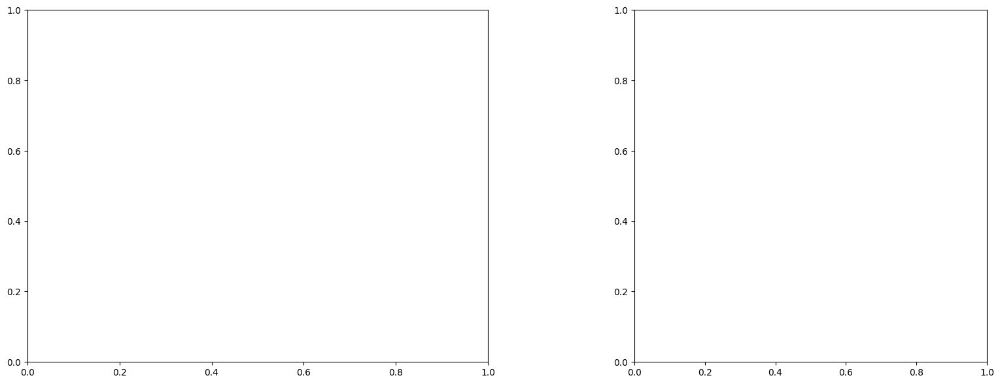

U and V components of current : [0.51850001 0.17712163]
uncertainties for U and V: 0.15984168698378035 0.17150037417030076


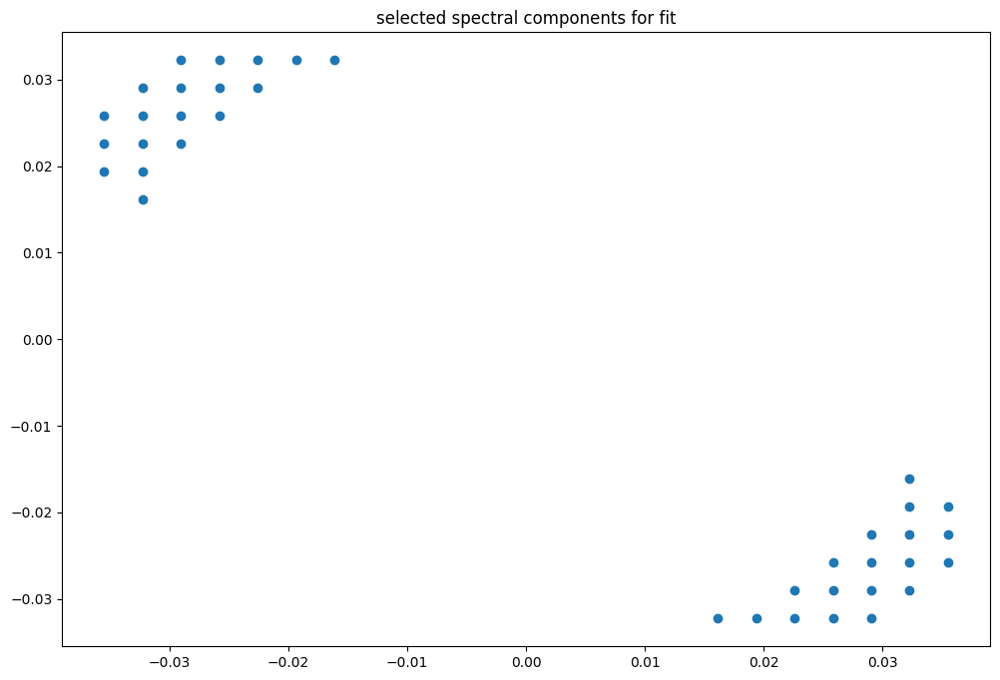

box [5500, 6000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

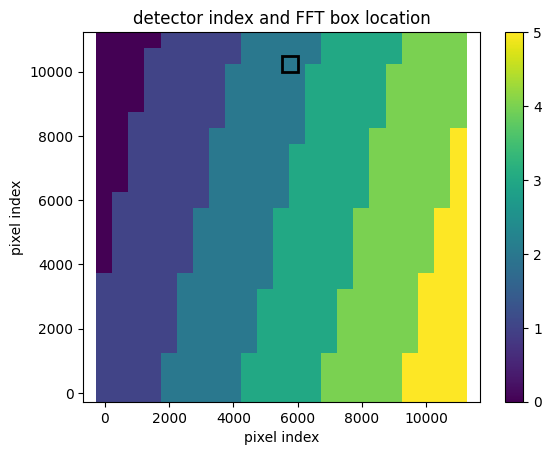

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


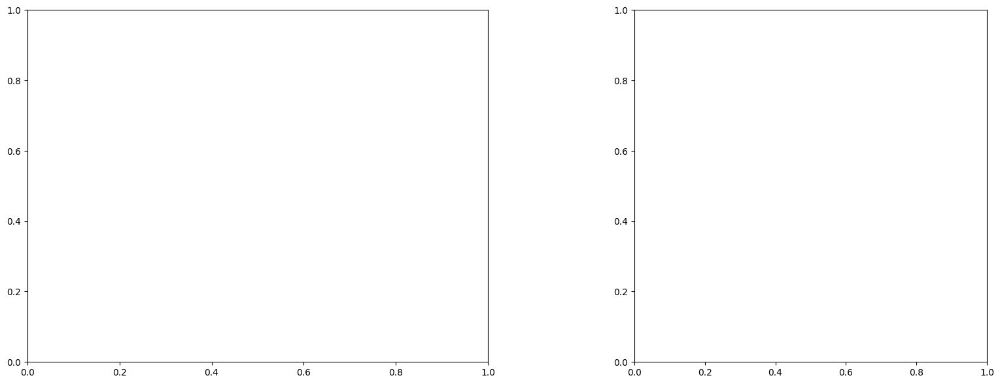

U and V components of current : [ 0.44178634 -0.42810421]
uncertainties for U and V: 0.21235414829890212 0.21164836963969413


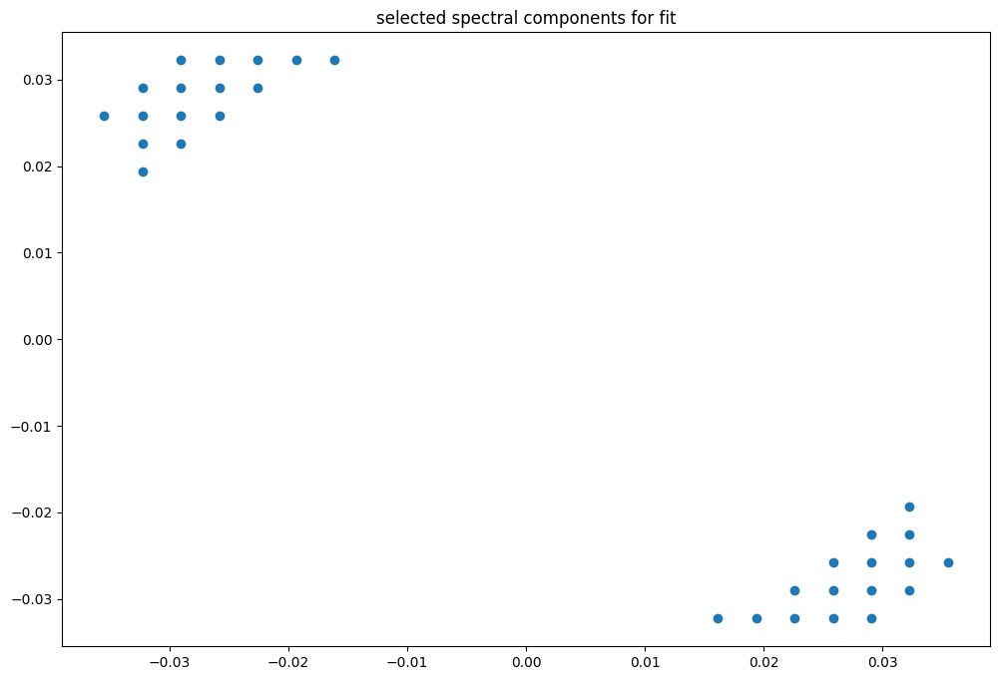

box [5500, 6000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

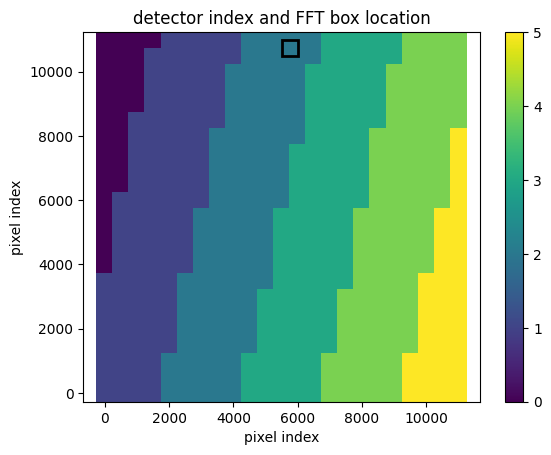

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 30)
(31, 30)
(31, 30)


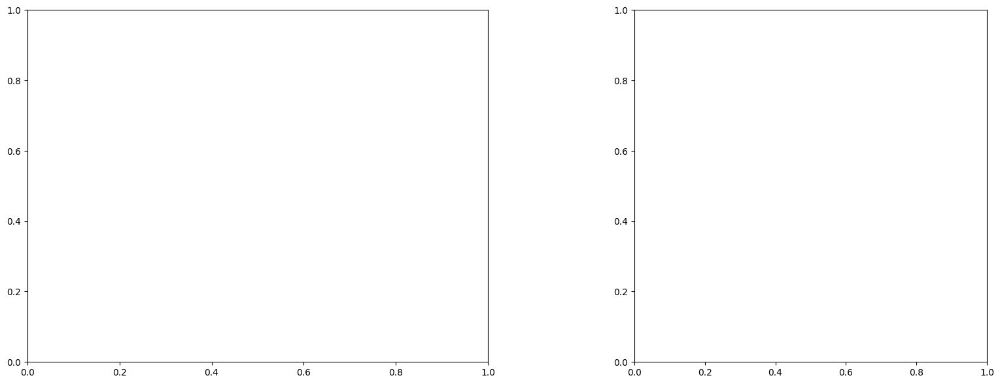

U and V components of current : [0.50811777 0.05909798]
uncertainties for U and V: 0.14833852252211002 0.15644985102343034


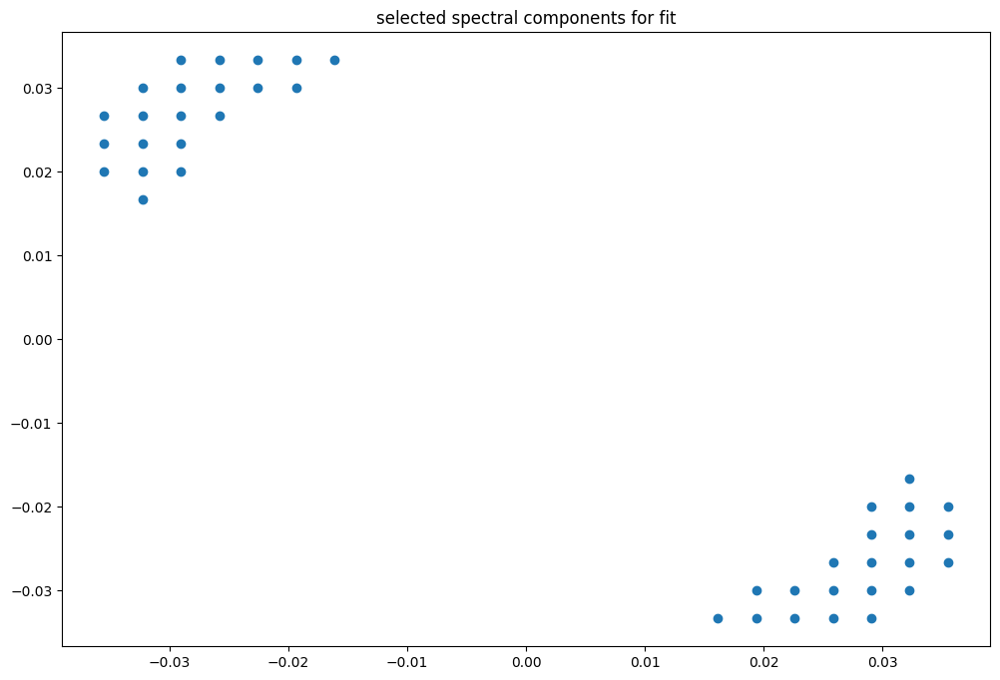

box [6000, 6500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

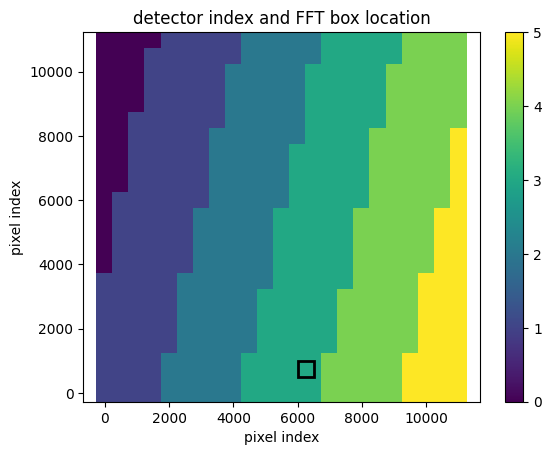

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9948016160210164
(31, 31)
(31, 31)
(31, 31)


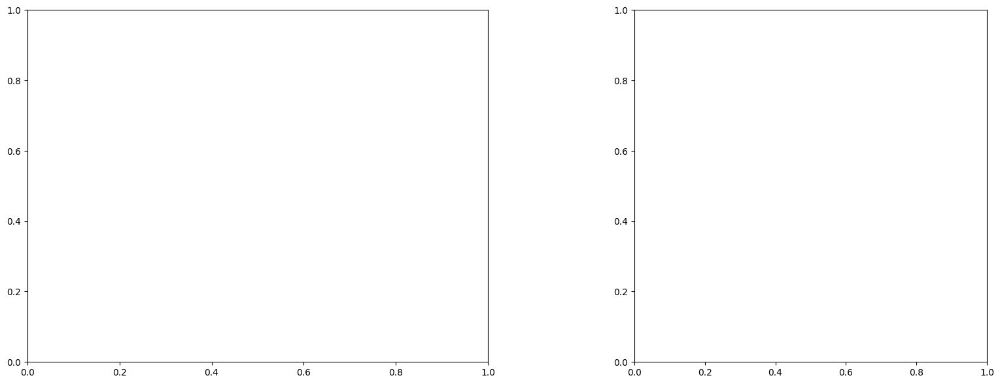

U and V components of current : [0.54897664 1.22687619]
uncertainties for U and V: 0.07314622335717877 0.115323360431906


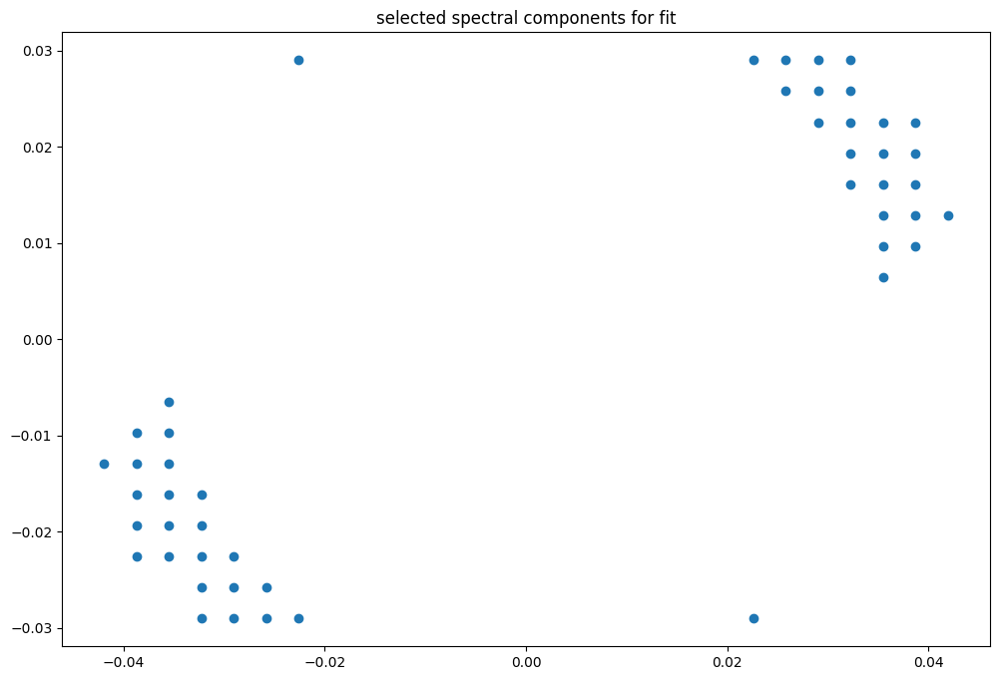

box [6000, 6500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

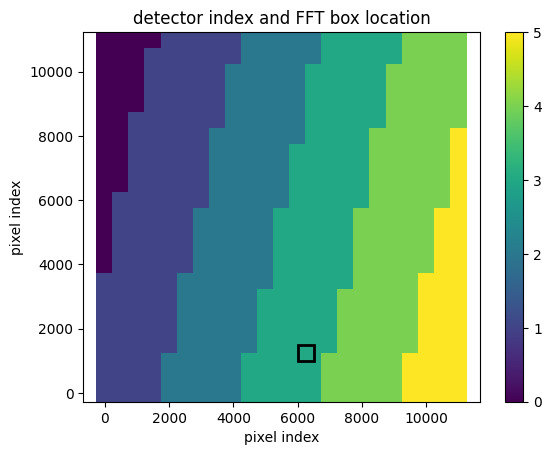

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


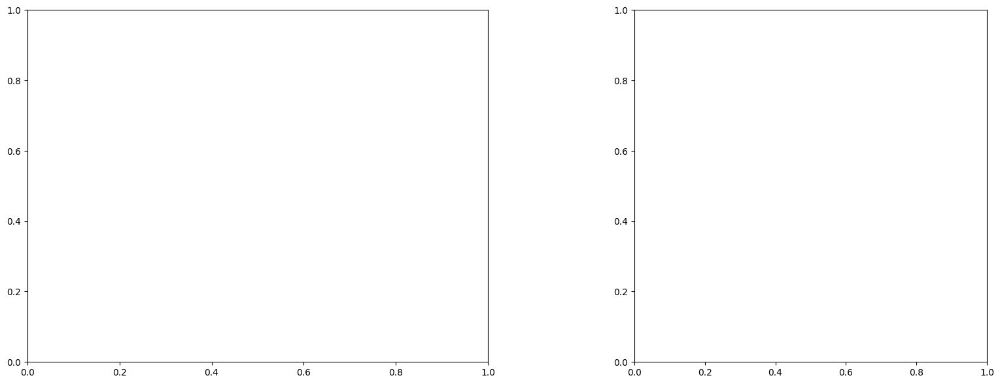

U and V components of current : [0.71982656 1.10156976]
uncertainties for U and V: 0.06534208913921993 0.09393640834668614


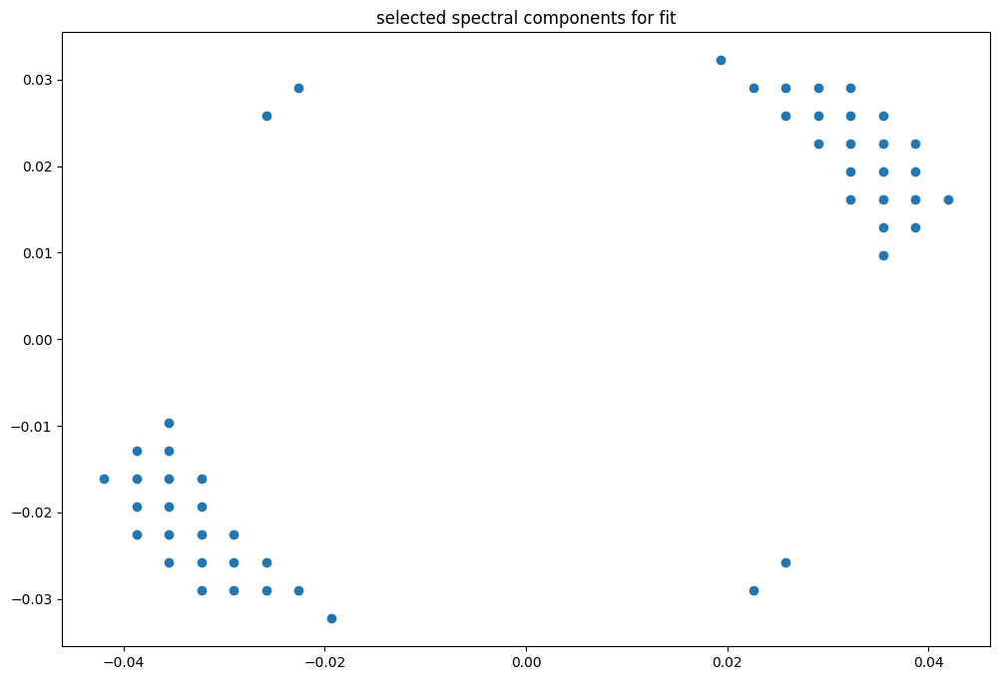

box [6000, 6500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

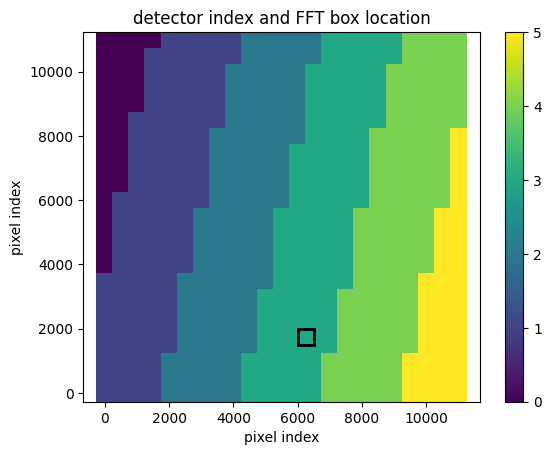

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


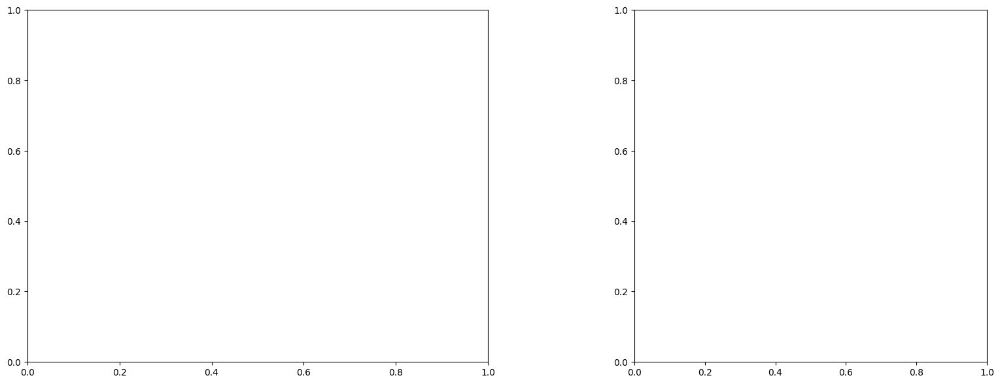

U and V components of current : [0.79471511 1.01736388]
uncertainties for U and V: 0.054910158506359365 0.07302842194091286


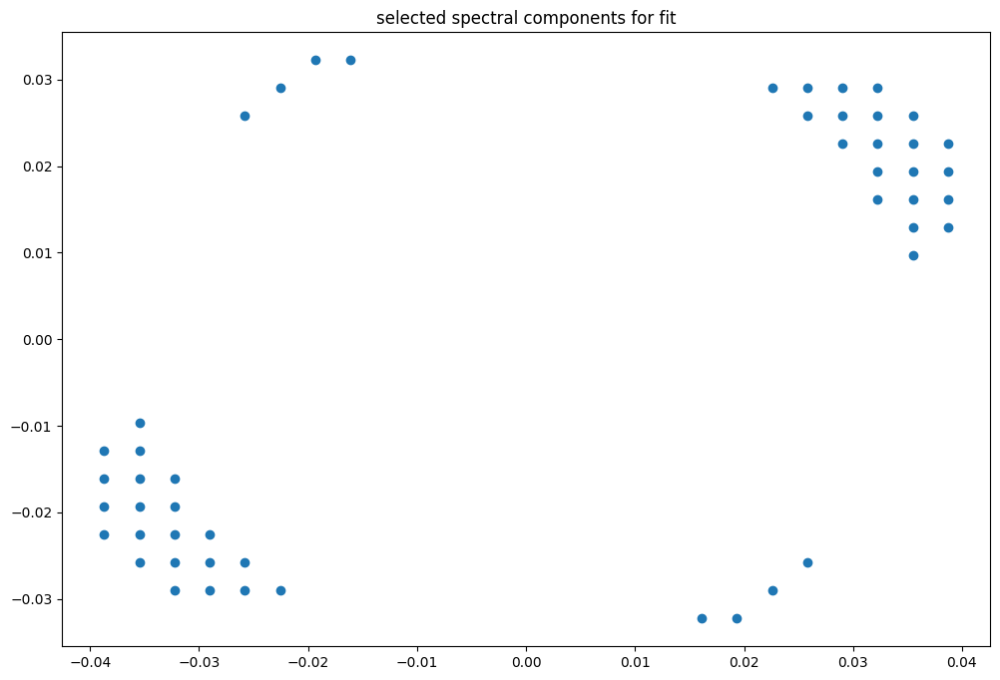

box [6000, 6500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

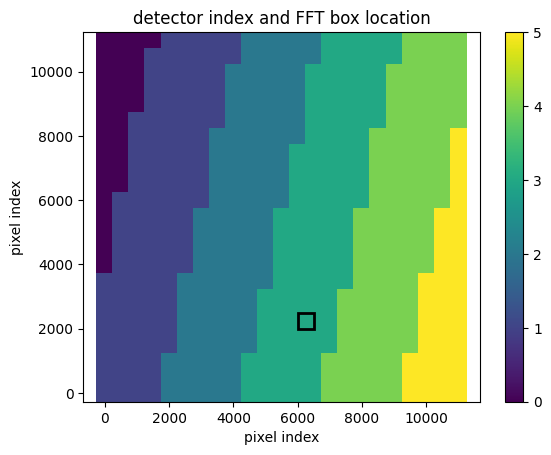

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947943483447979
(31, 31)
(31, 31)
(31, 31)


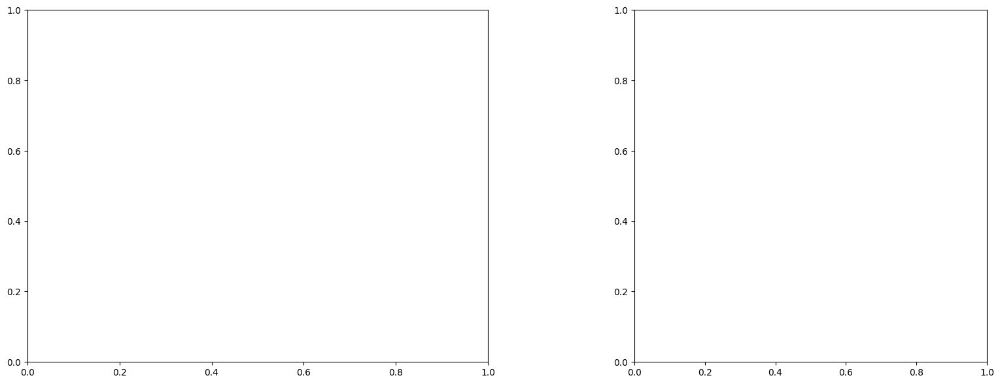

U and V components of current : [0.76646504 1.201716  ]
uncertainties for U and V: 0.05408606546375531 0.06491000913199144


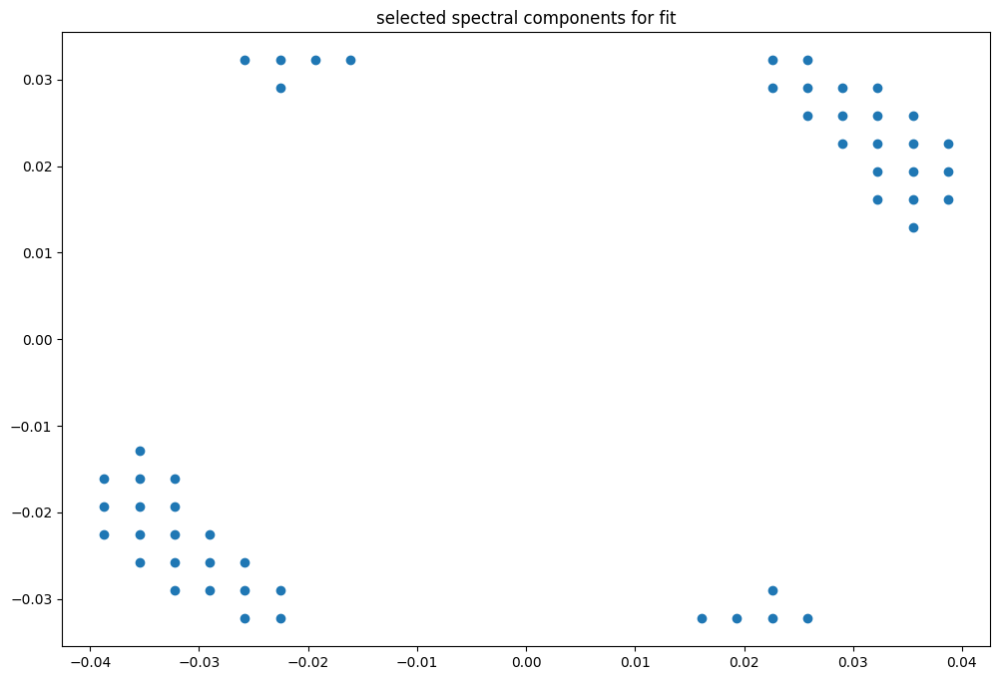

box [6000, 6500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

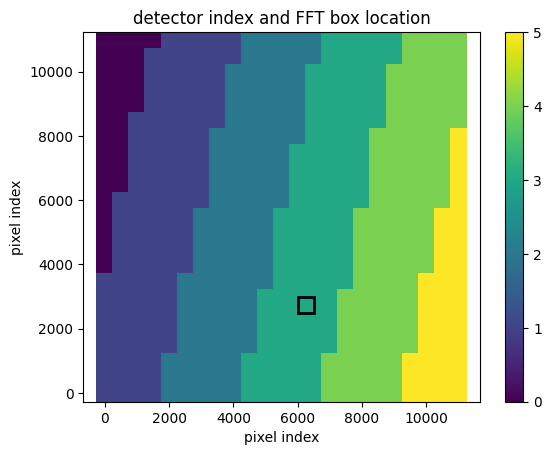

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947908147438635
(31, 31)
(31, 31)
(31, 31)


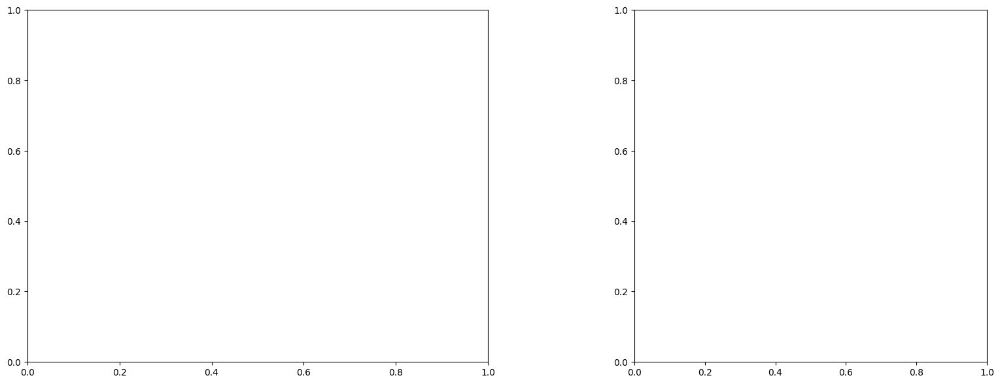

U and V components of current : [0.89270363 1.23732925]
uncertainties for U and V: 0.060624652355889055 0.07719209014288114


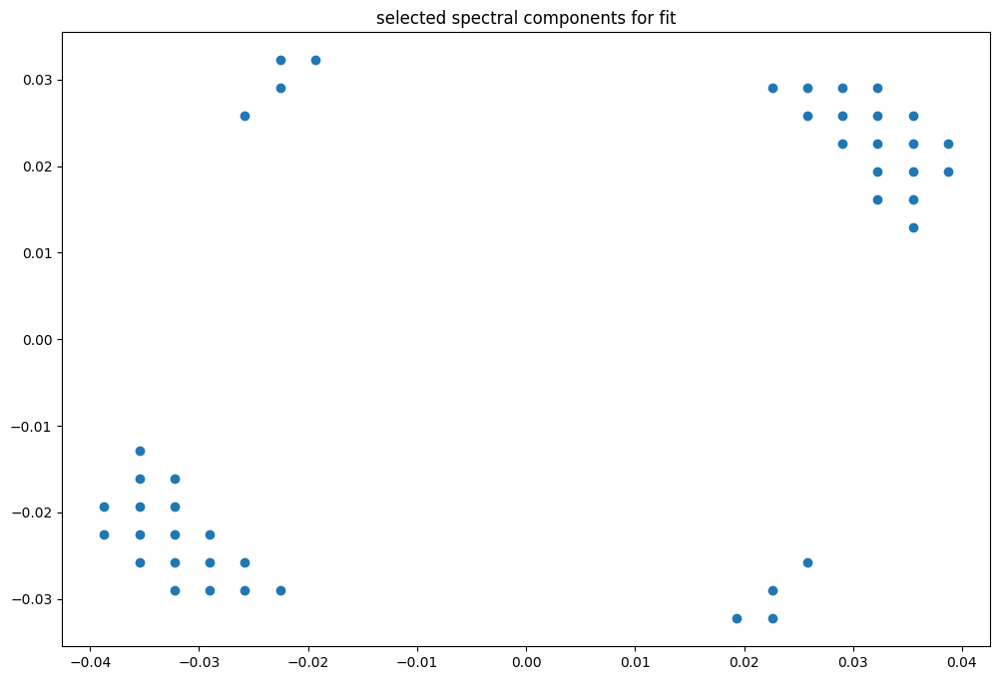

box [6000, 6500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

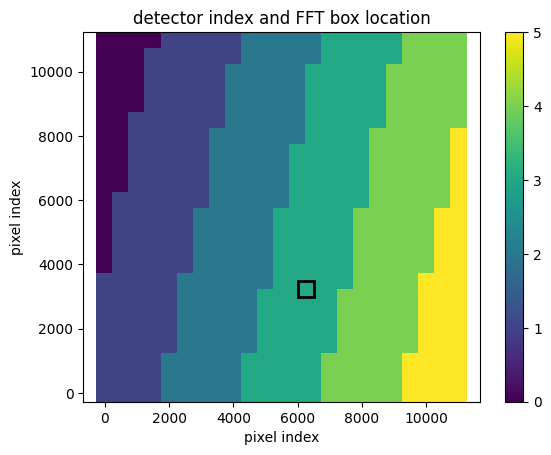

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947908147438635
(31, 31)
(31, 31)
(31, 31)


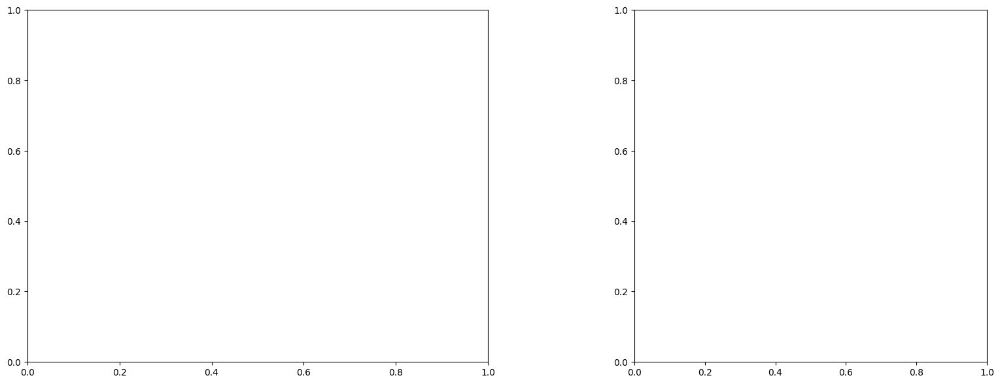

U and V components of current : [0.7823025  1.30422553]
uncertainties for U and V: 0.06766965882178946 0.08532771070374458


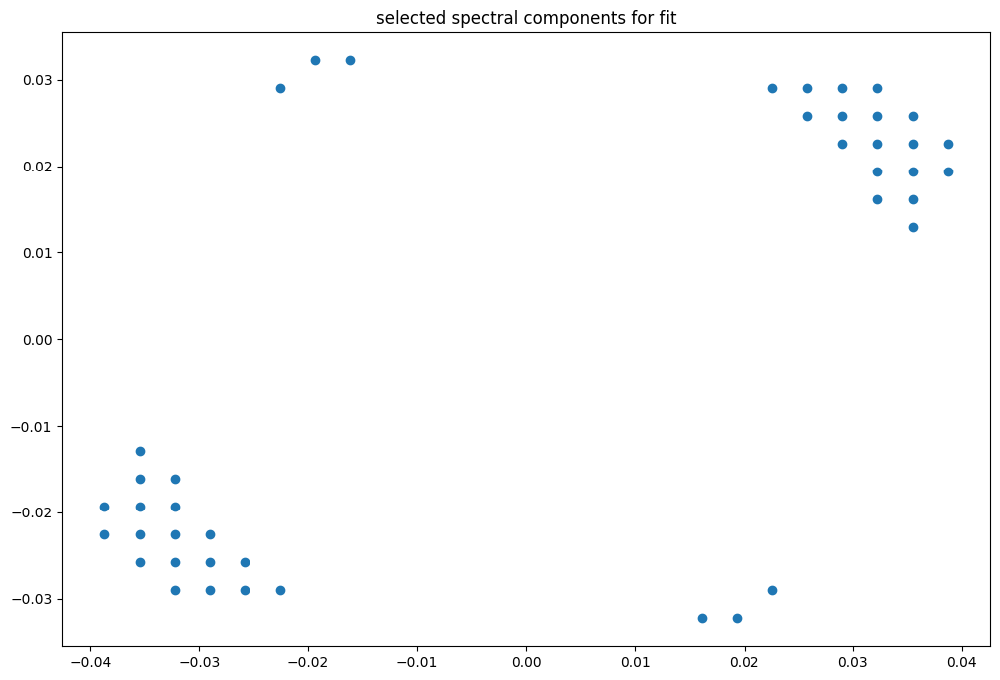

box [6000, 6500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

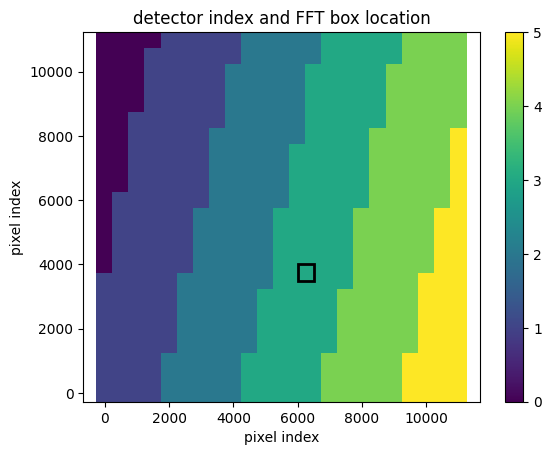

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


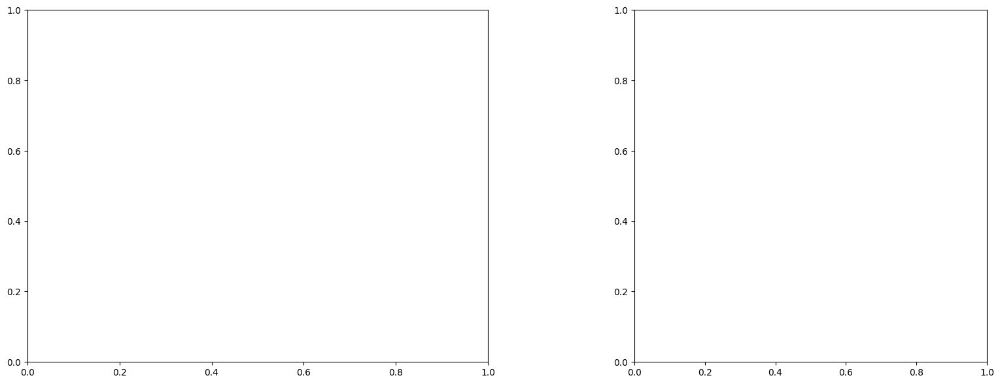

U and V components of current : [0.78248208 1.37284215]
uncertainties for U and V: 0.11186001659544943 0.12710583475415146


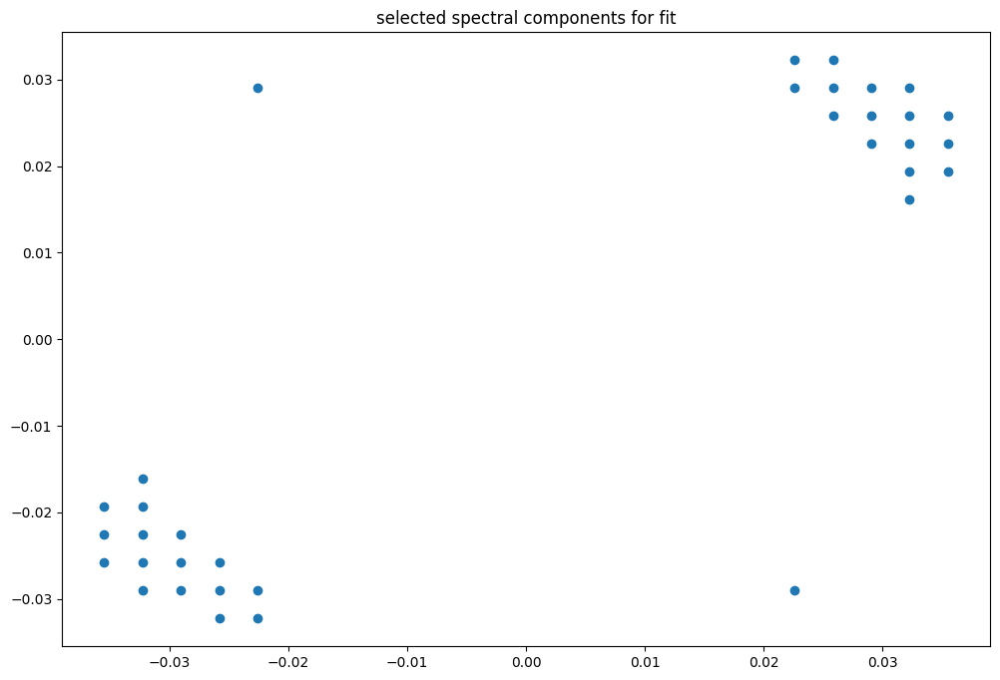

box [6000, 6500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

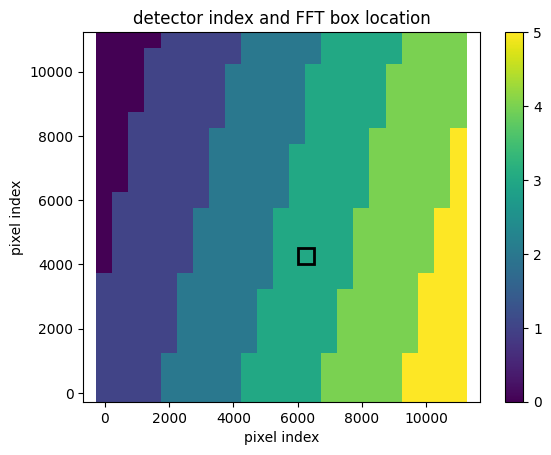

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947843606011624
(31, 31)
(31, 31)
(31, 31)


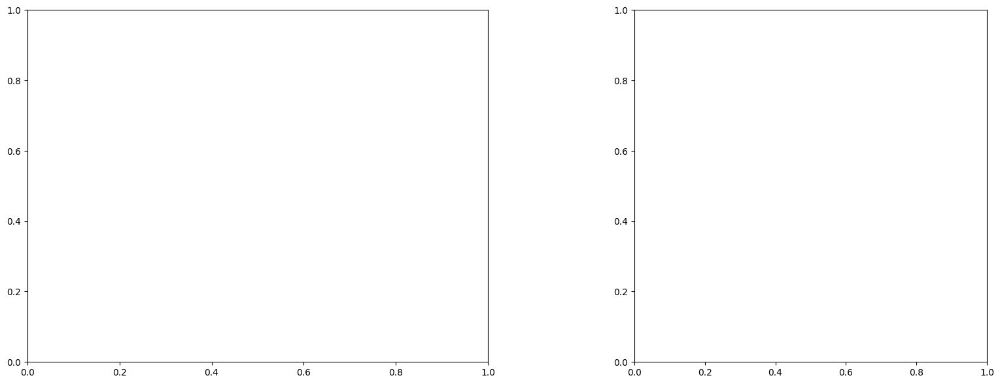

U and V components of current : [0.97262585 1.4052915 ]
uncertainties for U and V: 0.1003773277024119 0.11530001470645475


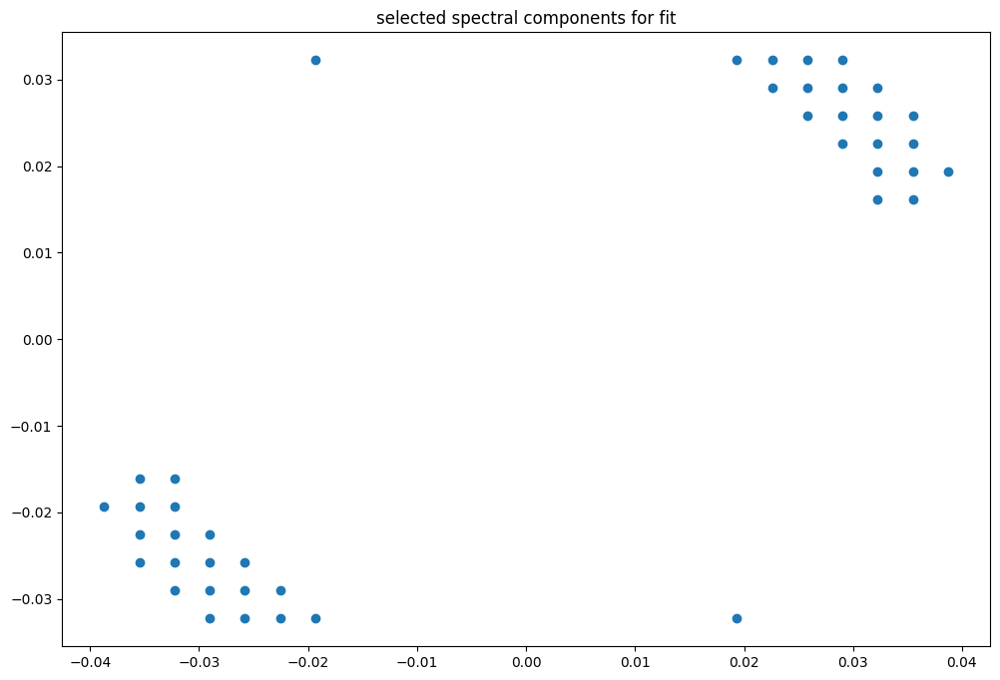

box [6000, 6500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

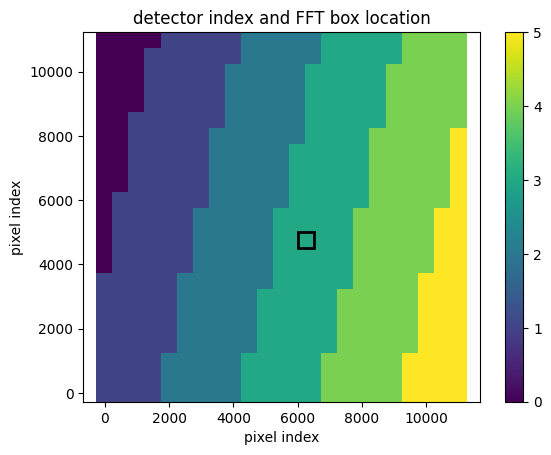

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


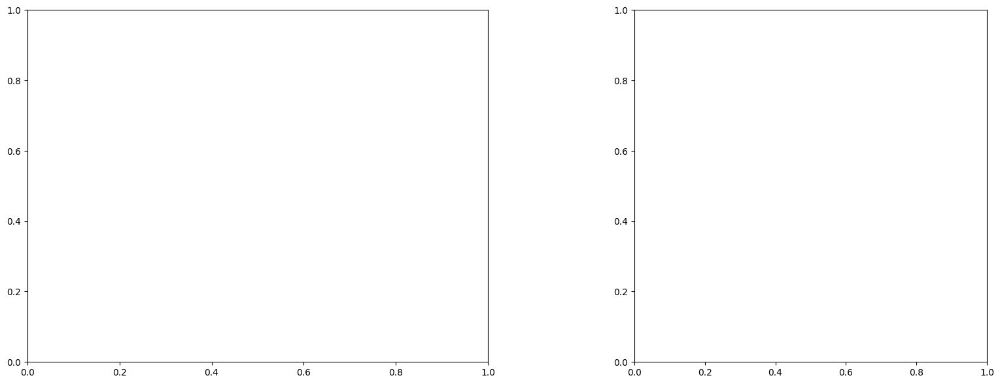

U and V components of current : [1.04330756 1.11739554]
uncertainties for U and V: 0.08038289848753044 0.08164516633704046


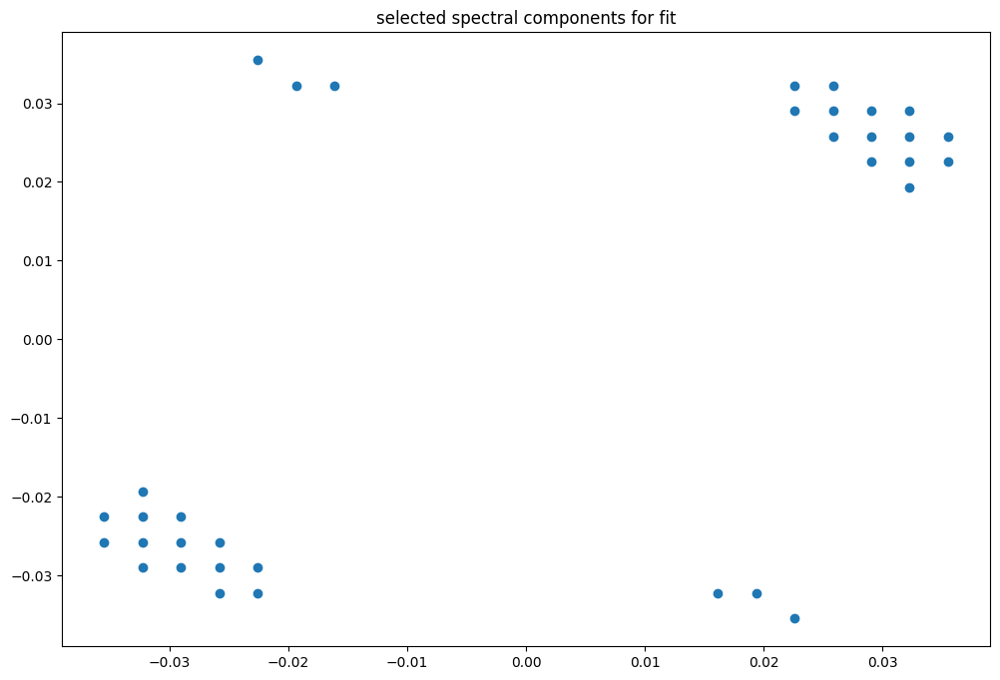

box [6000, 6500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

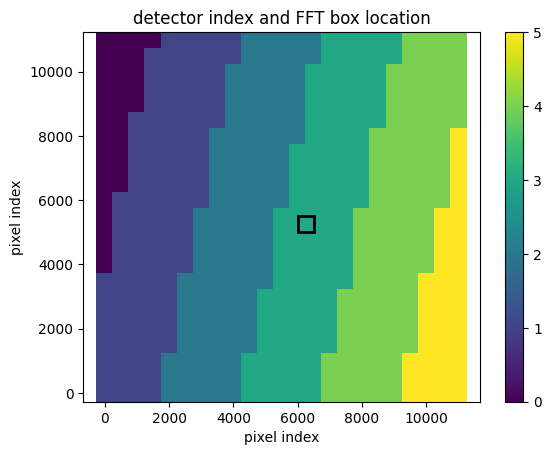

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


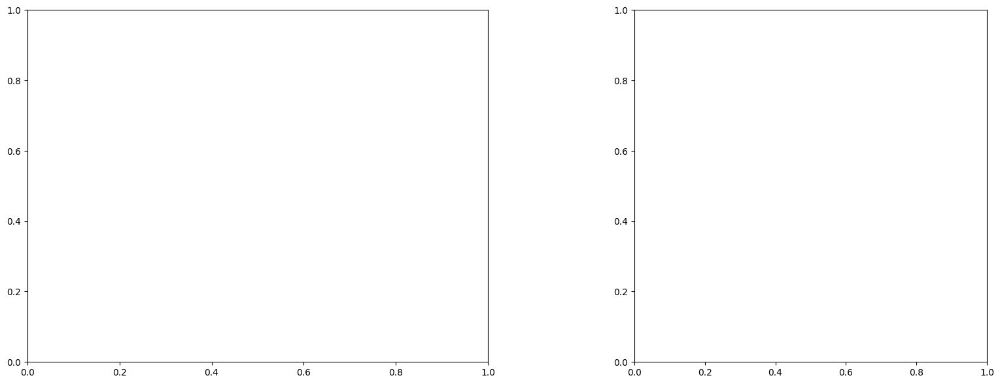

U and V components of current : [1.22628088 0.99005552]
uncertainties for U and V: 0.1820192285924399 0.1252201343899867


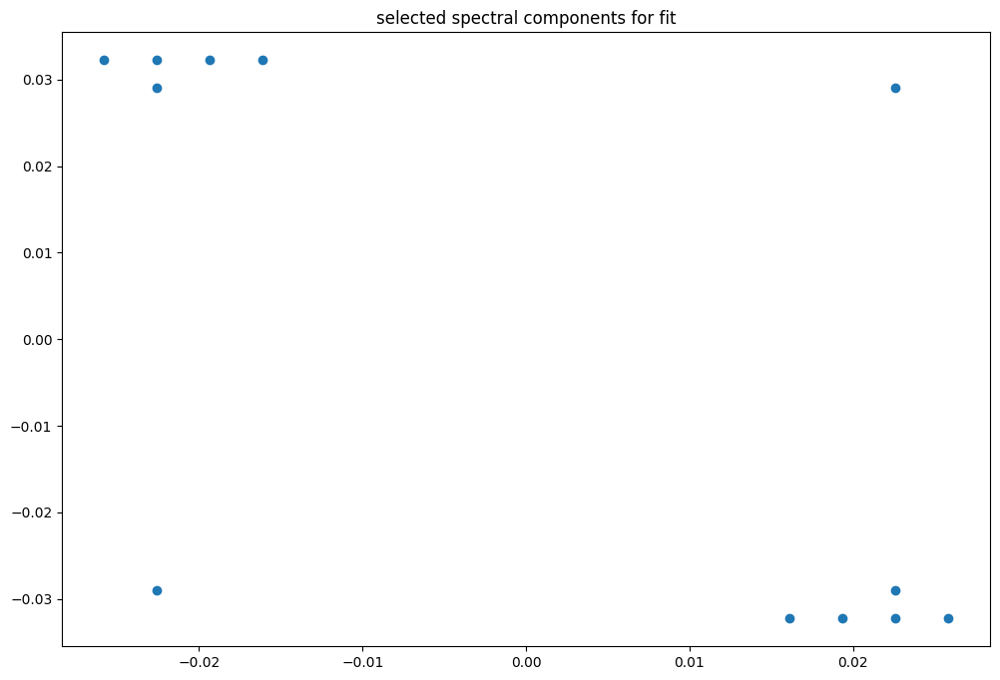

box [6000, 6500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

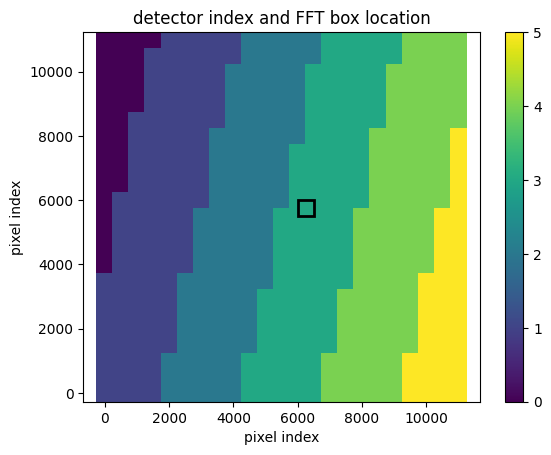

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947777013080478
(31, 31)
(31, 31)
(31, 31)


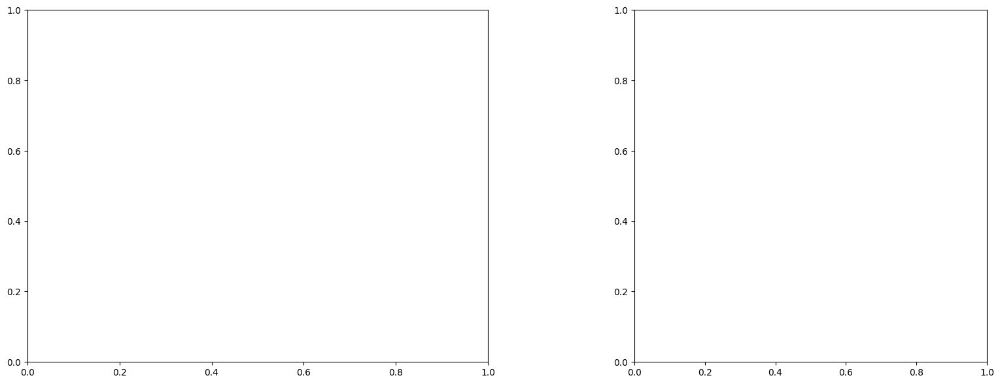

U and V components of current : [1.05404796 0.56241544]
uncertainties for U and V: 0.4833653935861765 0.34160656831104663


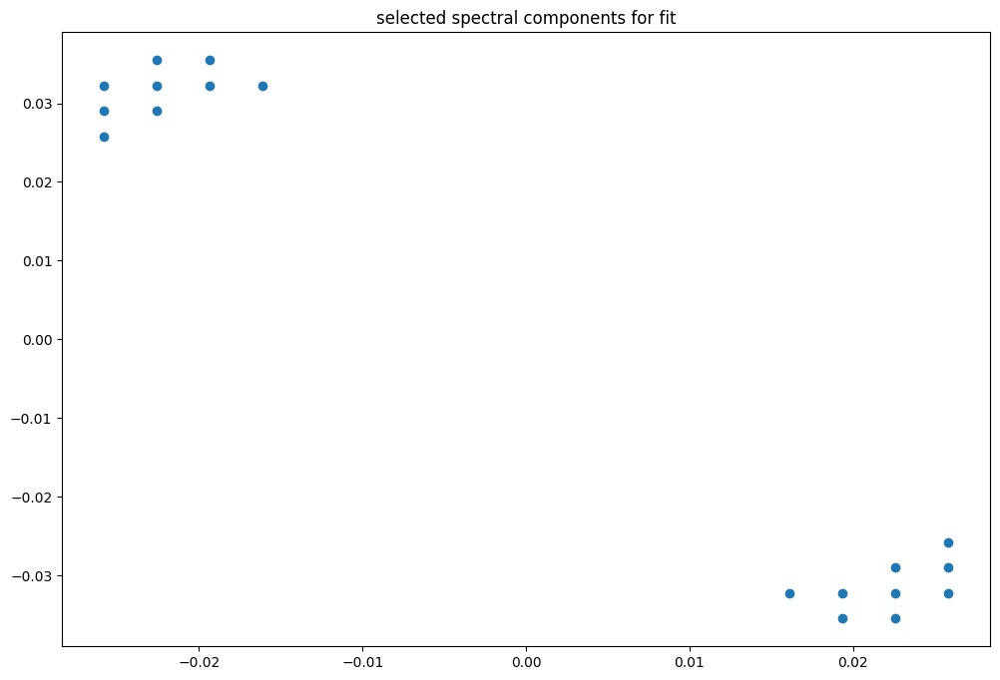

box [6000, 6500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

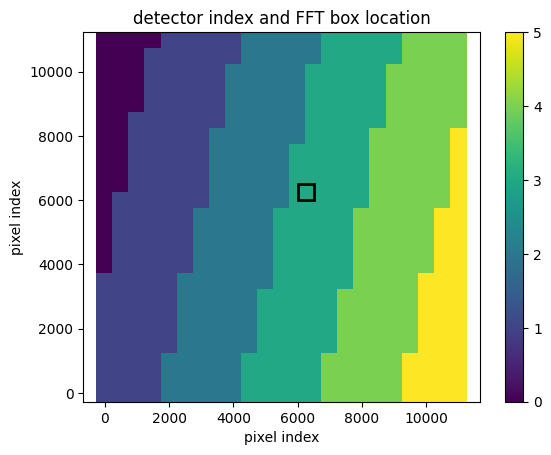

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947748237480838
(31, 31)
(31, 31)
(31, 31)


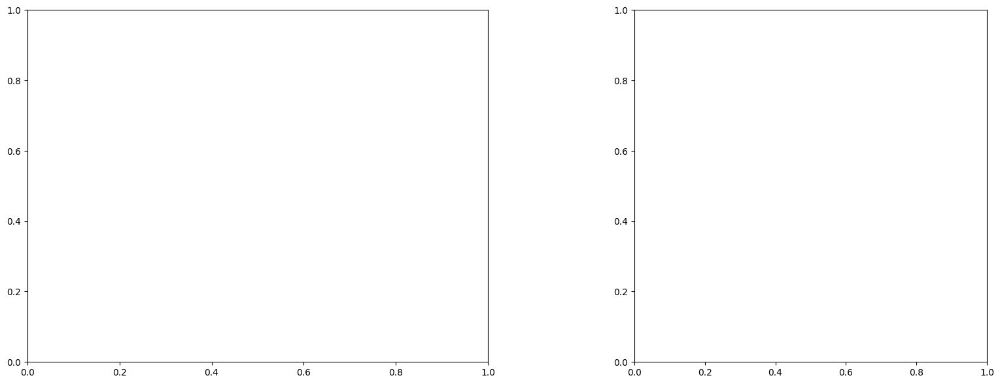

U and V components of current : [0.69707342 0.55501824]
uncertainties for U and V: 0.13883320822478934 0.11121114726485458


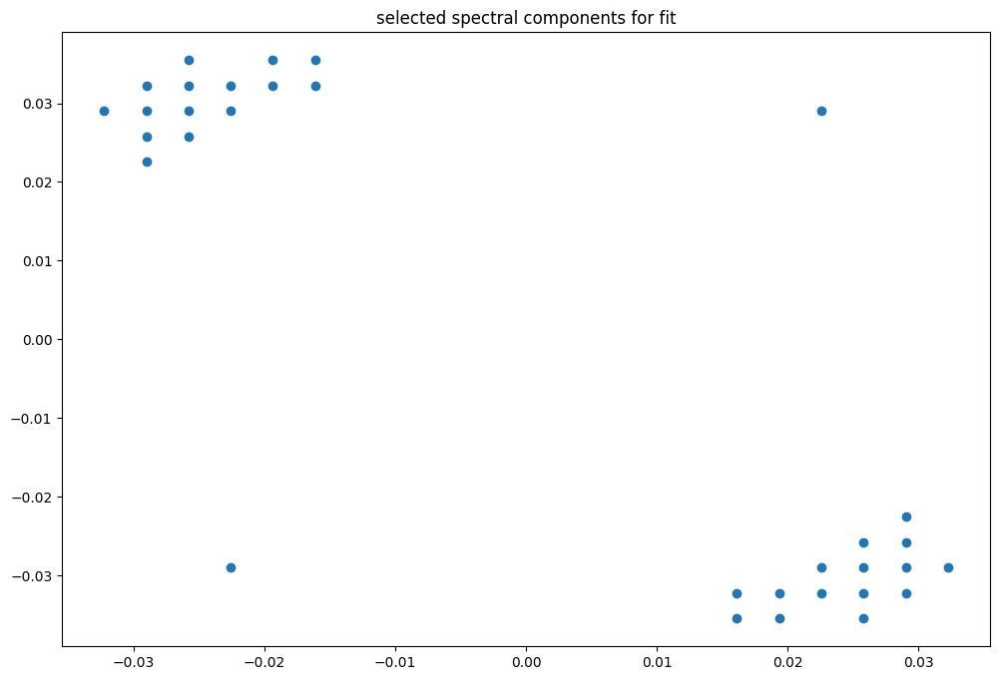

box [6000, 6500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

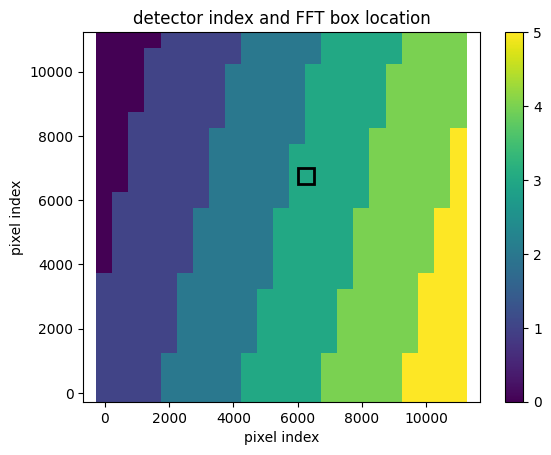

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


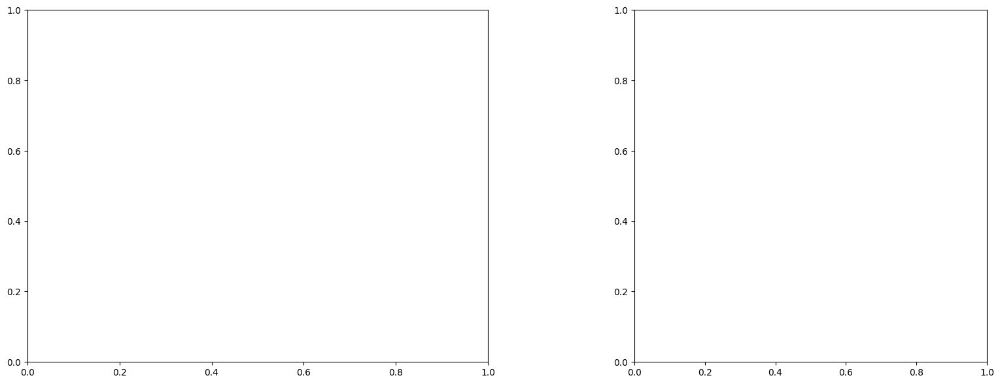

U and V components of current : [0.67639394 0.75641641]
uncertainties for U and V: 0.05709564229456229 0.050317929506392335


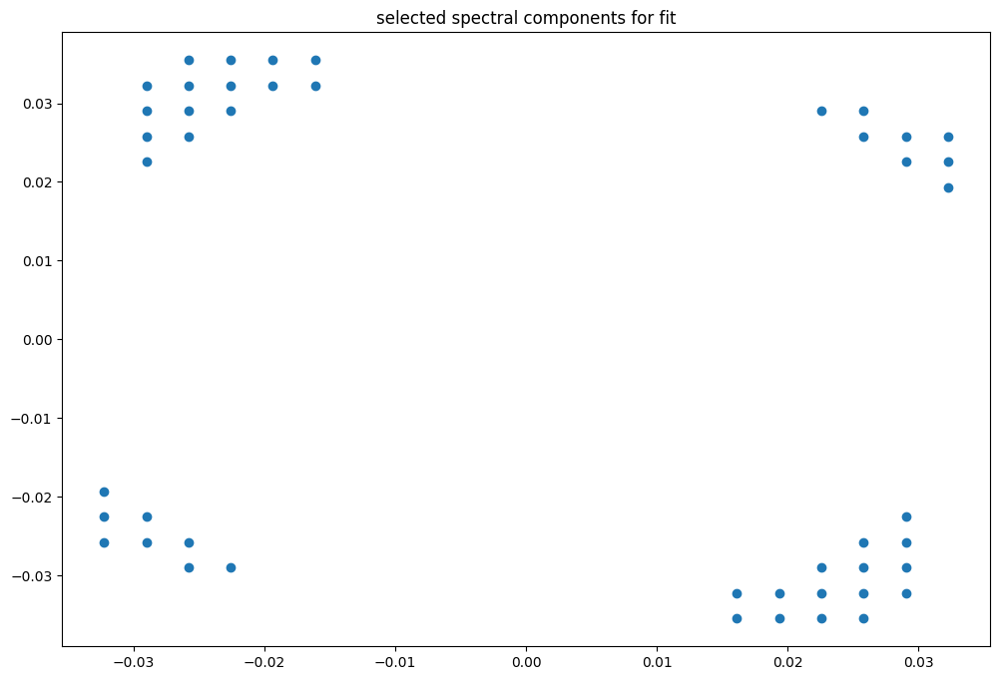

box [6000, 6500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

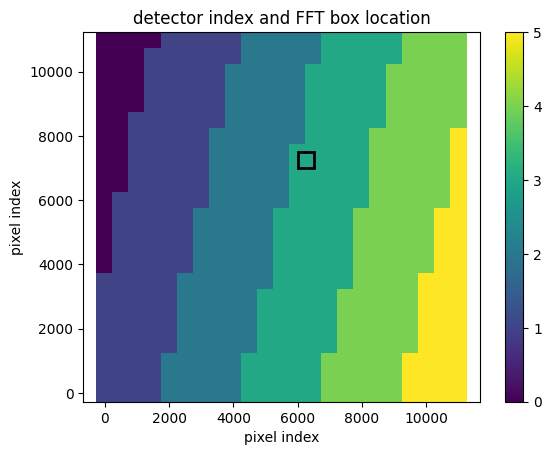

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


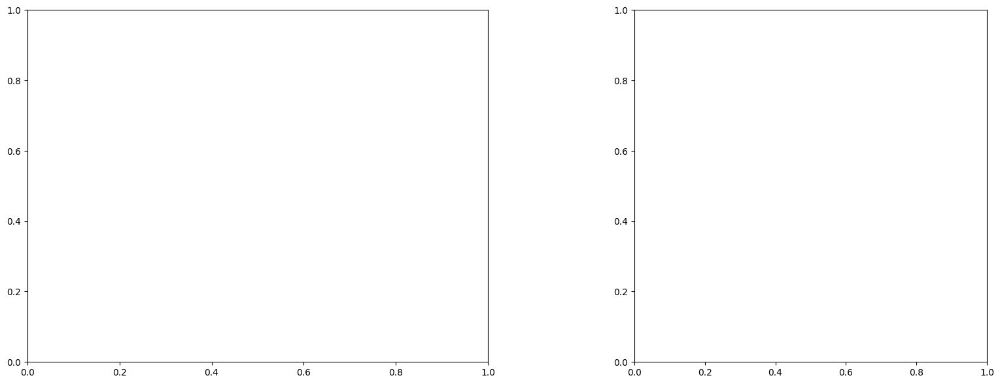

U and V components of current : [1.05093685 0.71520326]
uncertainties for U and V: 0.070781207585599 0.05905483504003481


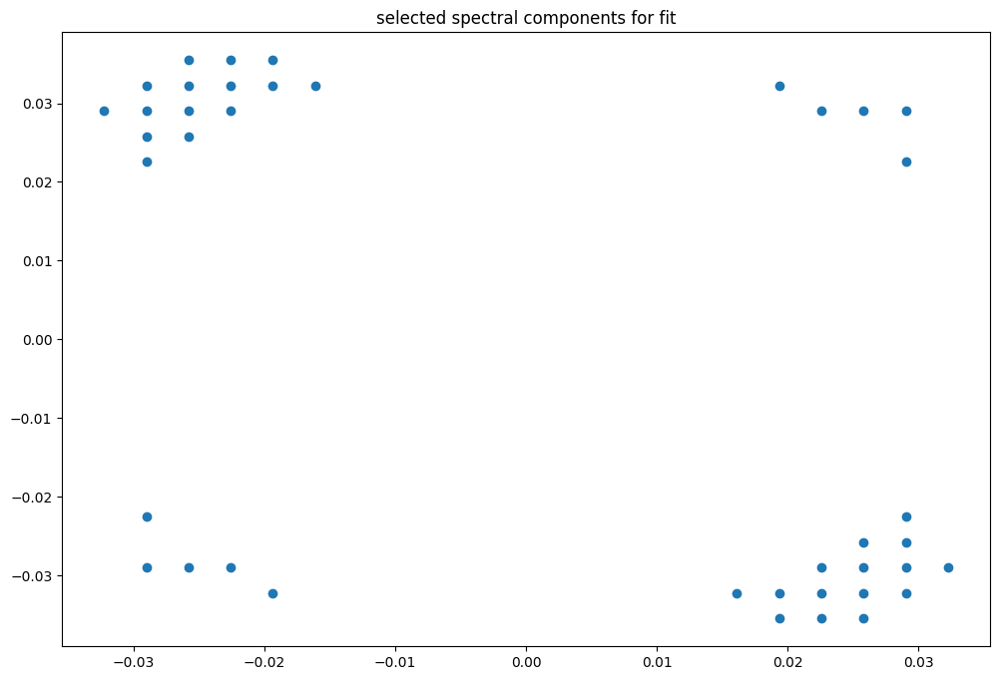

box [6000, 6500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

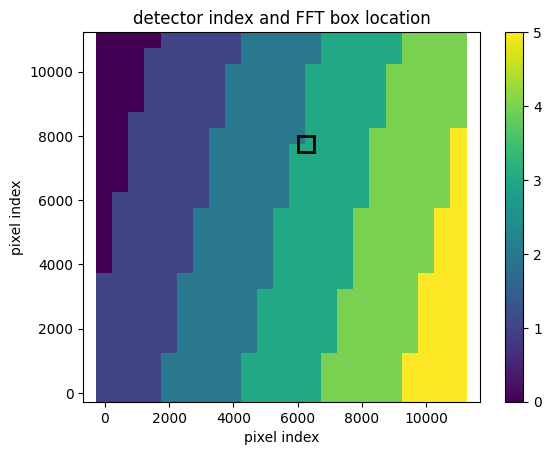

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.96
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


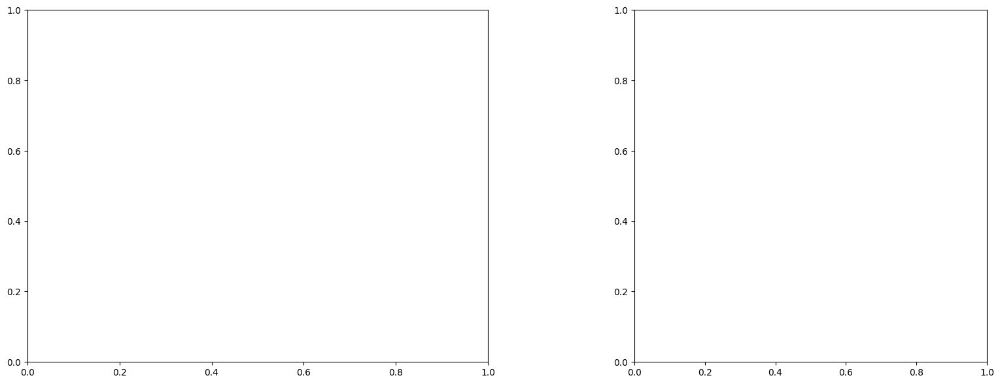

U and V components of current : [0.79407492 0.57846387]
uncertainties for U and V: 0.32831708133407955 0.2989015956324215


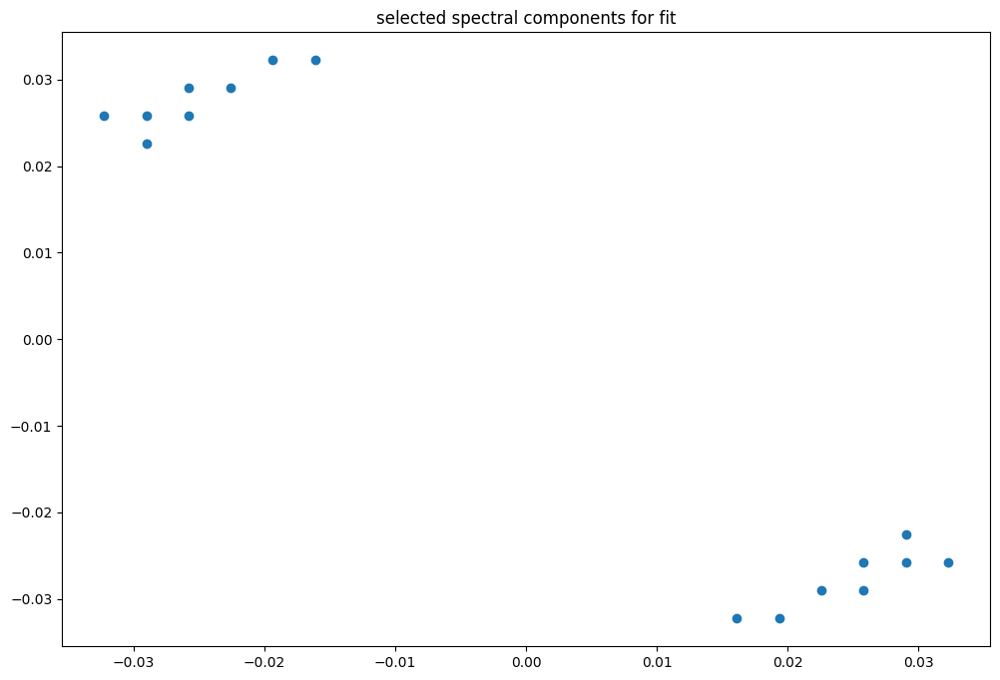

box [6000, 6500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

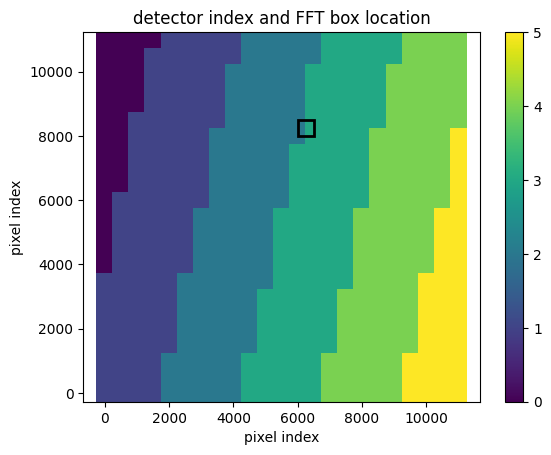

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


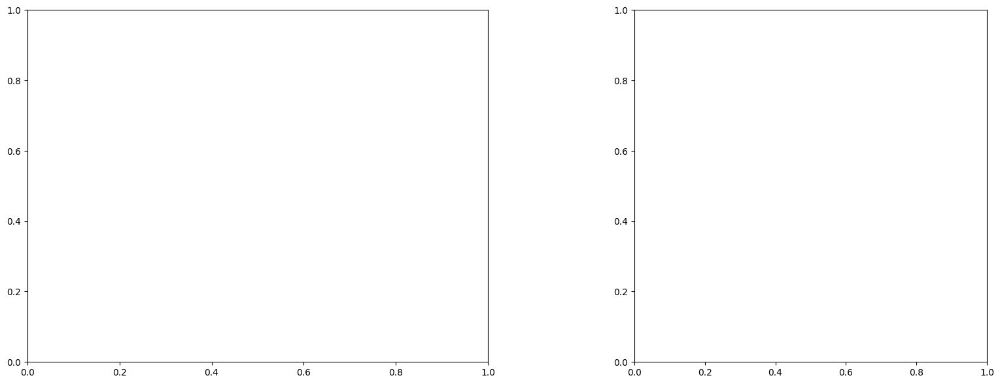

LinAlgError: Singular matrix

box [6000, 6500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

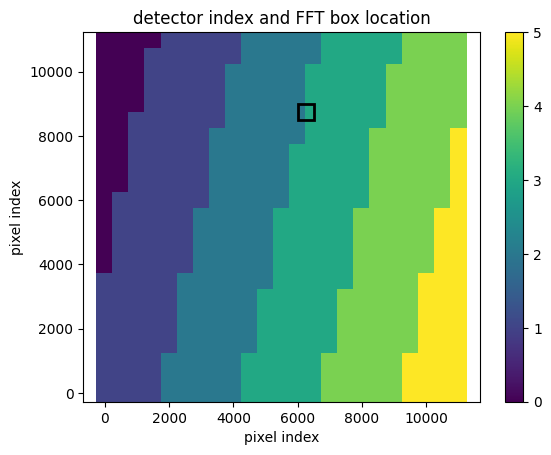

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091544470991989
(31, 31)
(31, 31)
(31, 31)


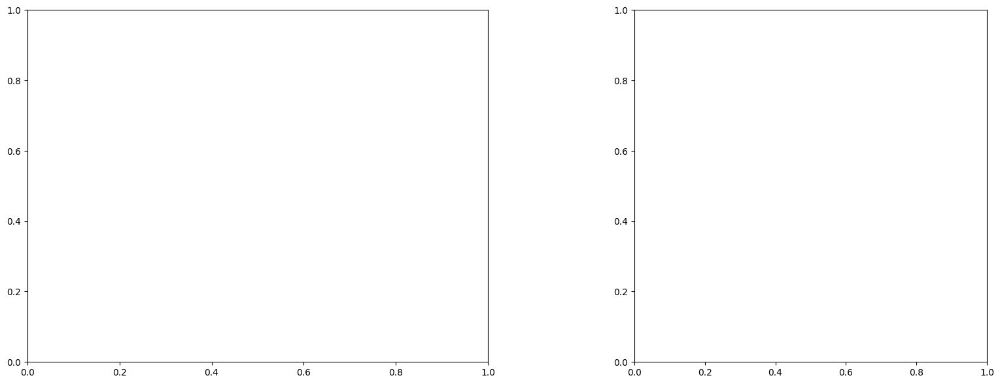

LinAlgError: Singular matrix

box [6000, 6500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

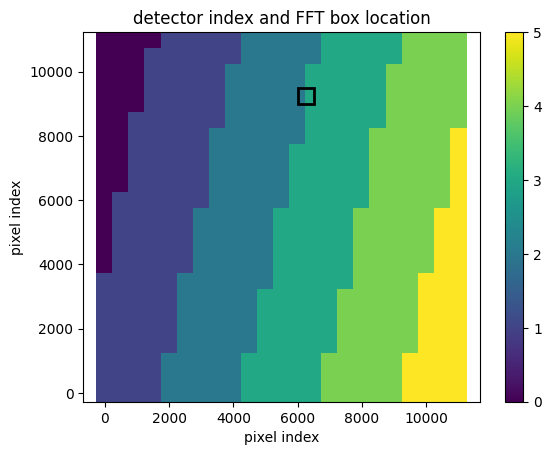

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009151282488385
(31, 31)
(31, 31)
(31, 31)


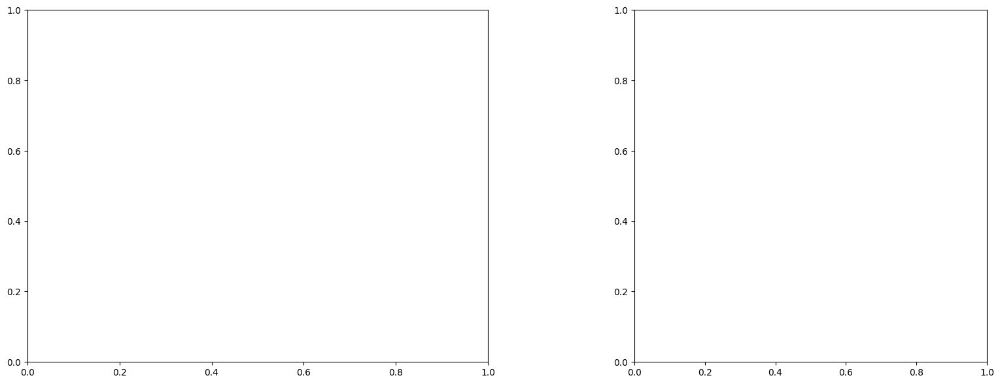

LinAlgError: Singular matrix

box [6000, 6500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

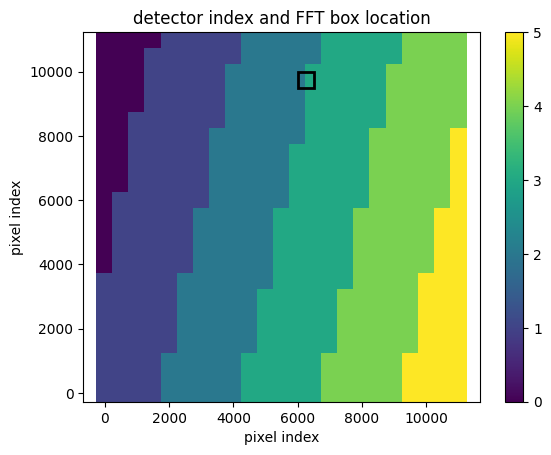

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(31, 31)
(31, 31)
(31, 31)


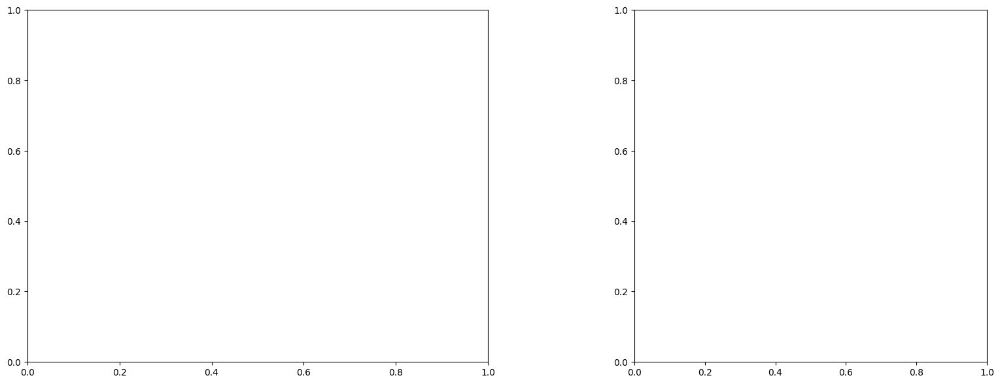

U and V components of current : [0.91104596 0.45482848]
uncertainties for U and V: 0.4042535080836705 0.39105227373486395


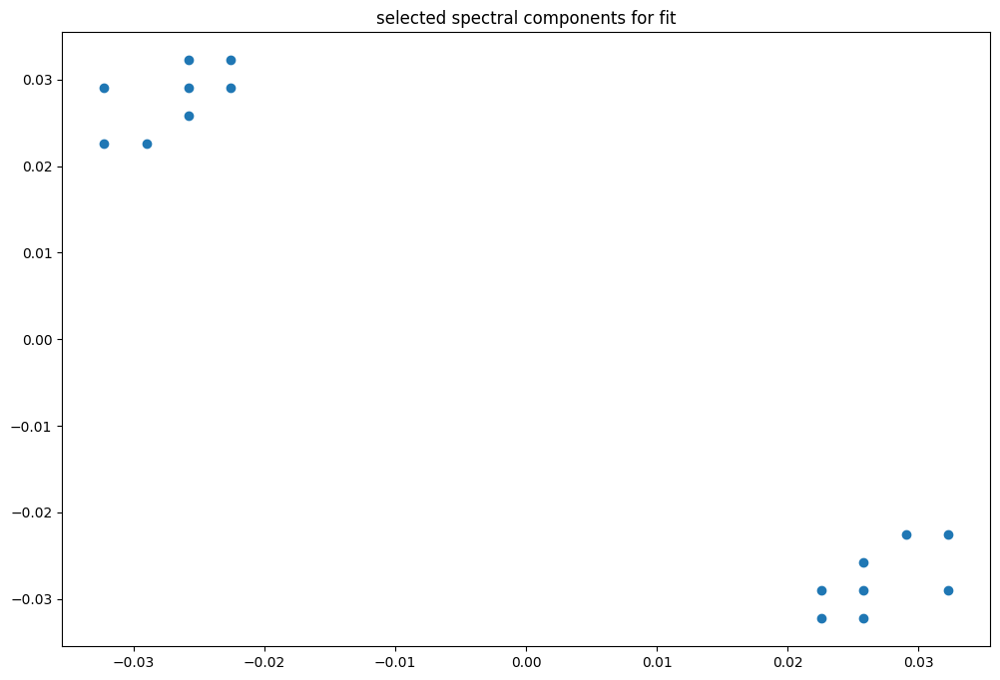

box [6000, 6500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

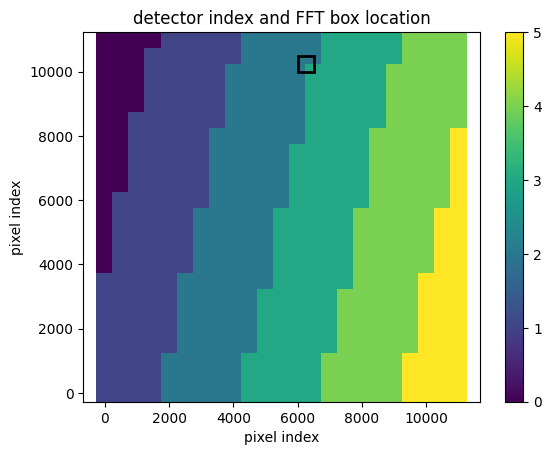

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.46
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 31)
(31, 31)
(31, 31)


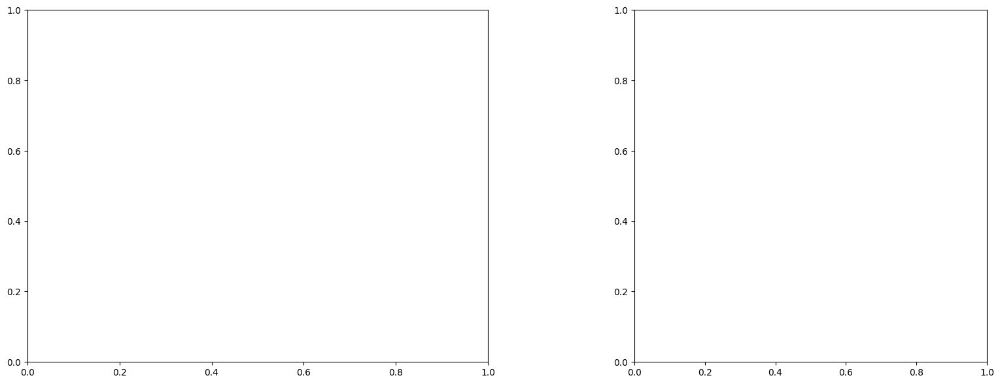

U and V components of current : [0.64974944 0.02562086]
uncertainties for U and V: 0.19835837878660903 0.19117692135874673


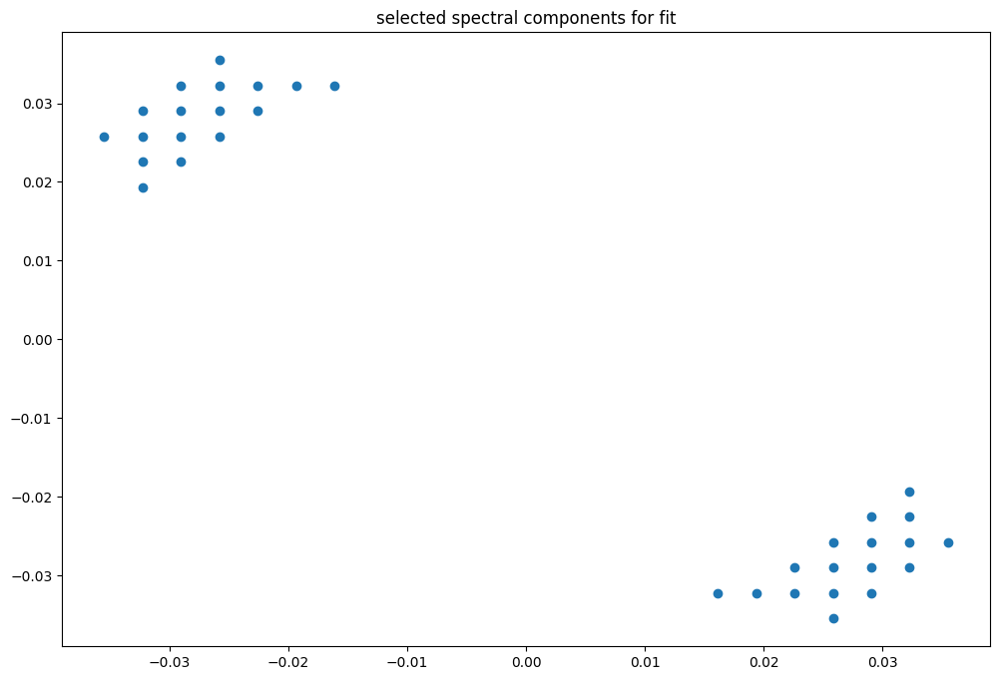

box [6000, 6500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

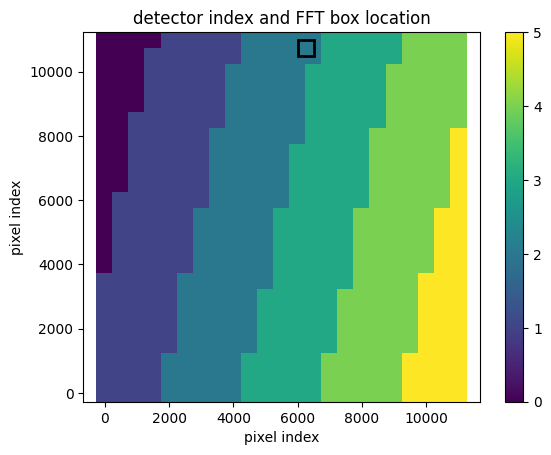

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 30)
(31, 30)
(31, 30)


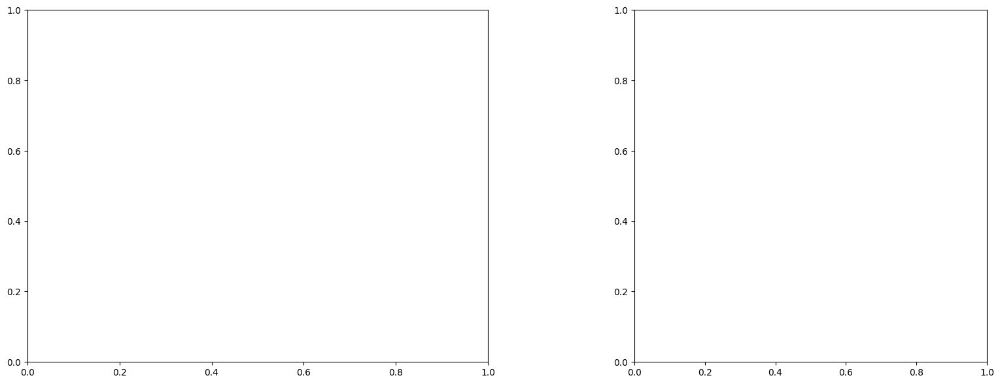

U and V components of current : [0.58299825 0.07241313]
uncertainties for U and V: 0.1413012822796888 0.14915672604059135


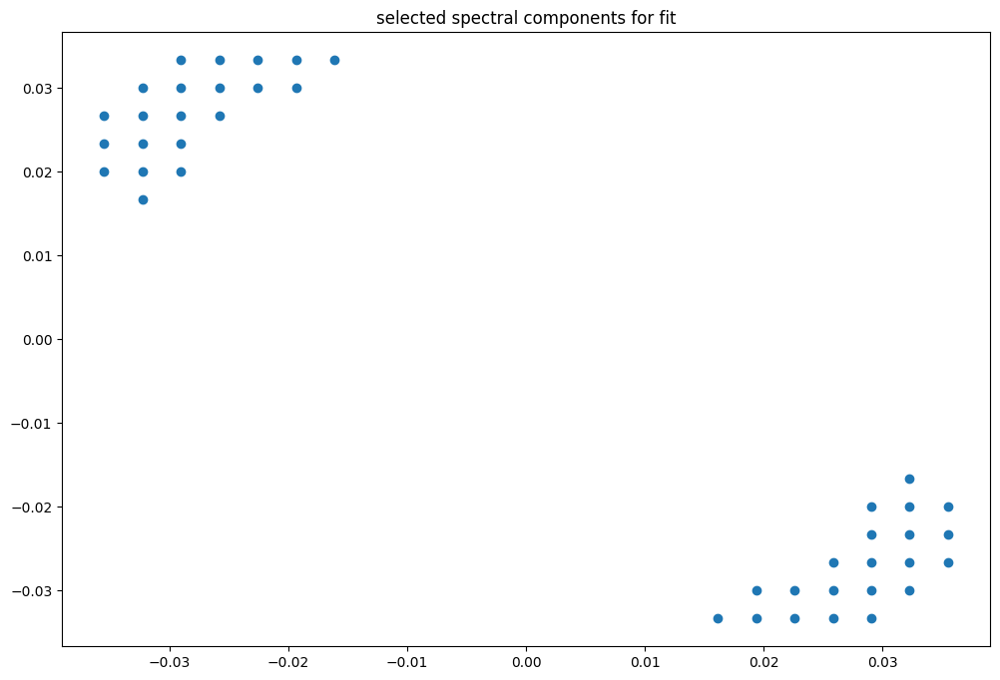

box [6500, 7000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

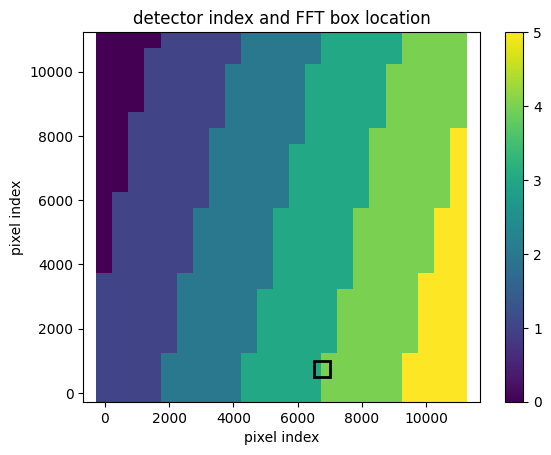

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987391765727964
(31, 31)
(31, 31)
(31, 31)


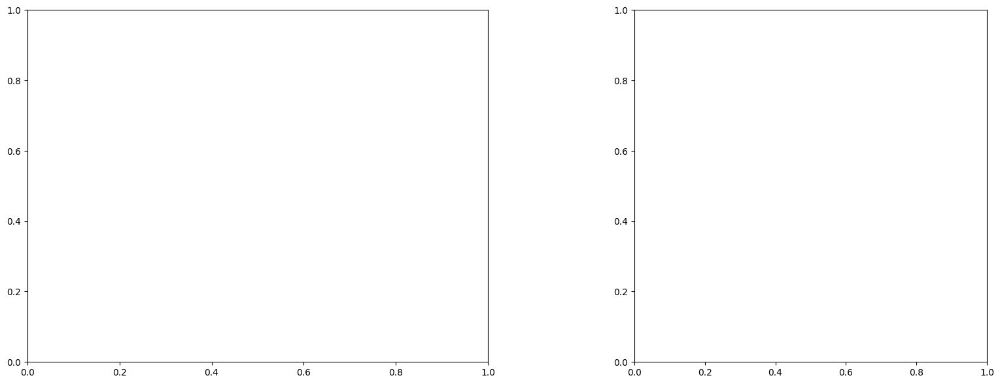

U and V components of current : [-0.63780387 -1.02161379]
uncertainties for U and V: 0.1564165786630628 0.2624273695925939


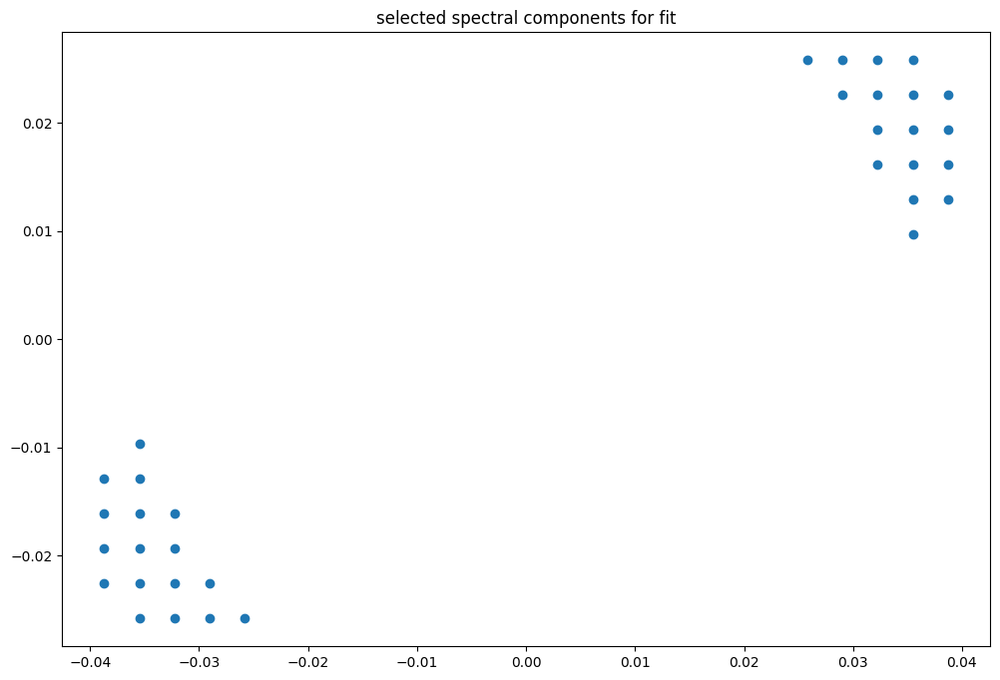

box [6500, 7000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

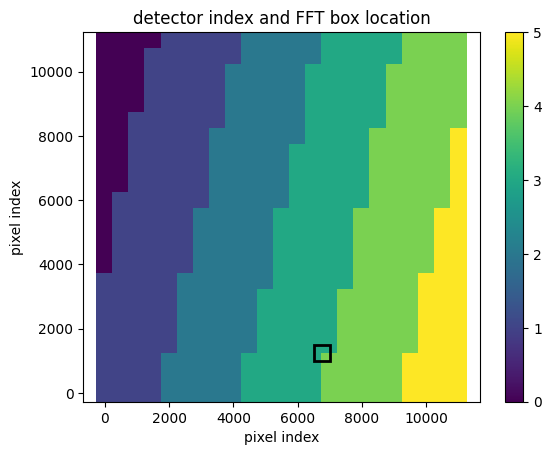

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.46
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


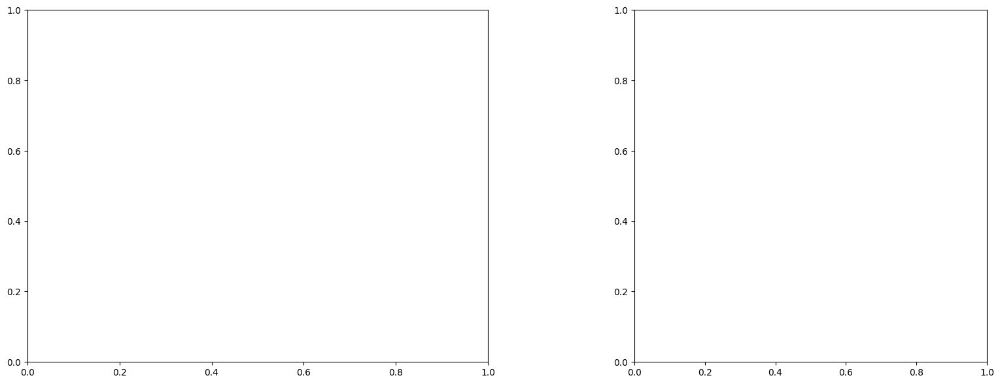

U and V components of current : [0.28434592 1.65223218]
uncertainties for U and V: 0.0947538917157496 0.16013676506460187


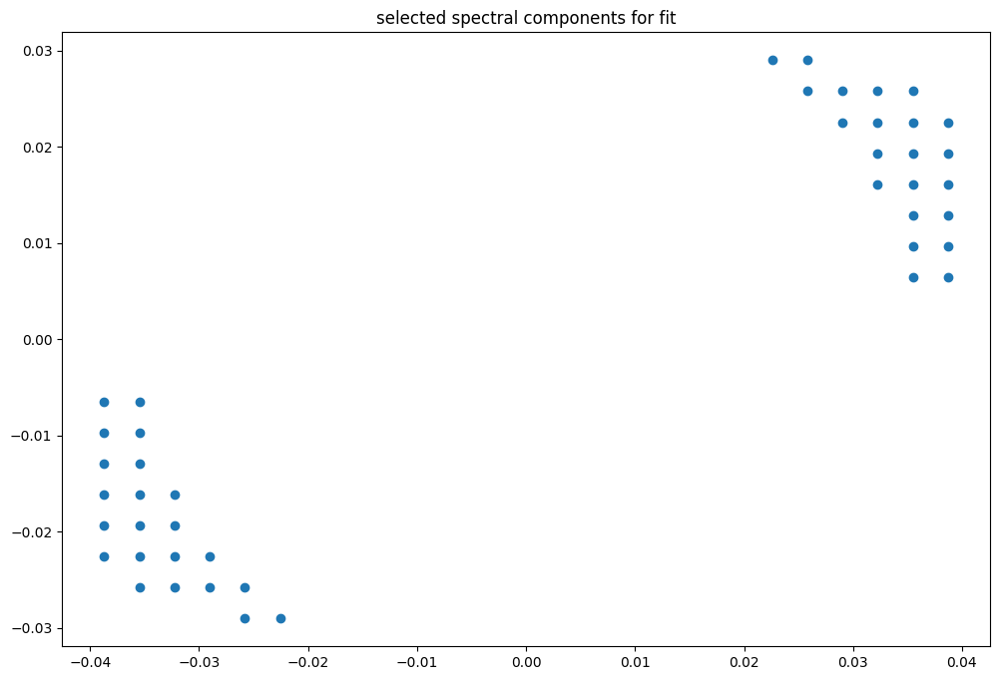

box [6500, 7000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

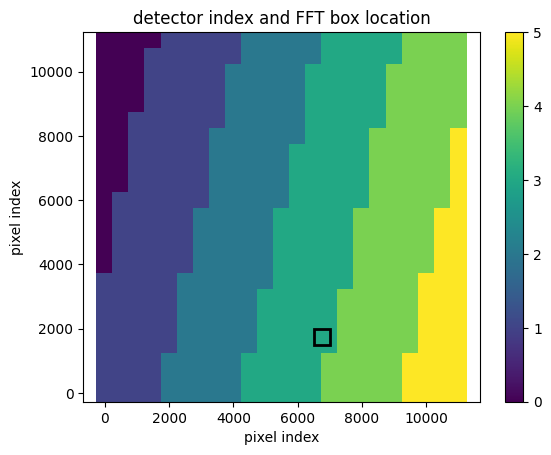

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947978229153754
(31, 31)
(31, 31)
(31, 31)


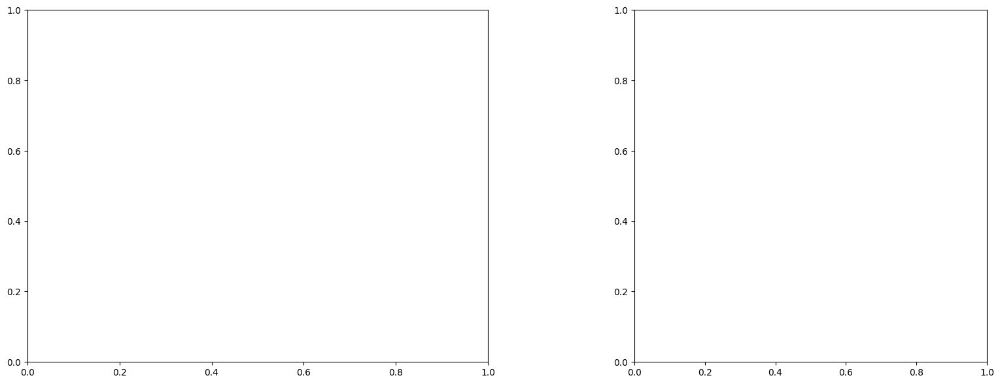

U and V components of current : [0.80421701 0.88907984]
uncertainties for U and V: 0.054064078056403966 0.07490391844335823


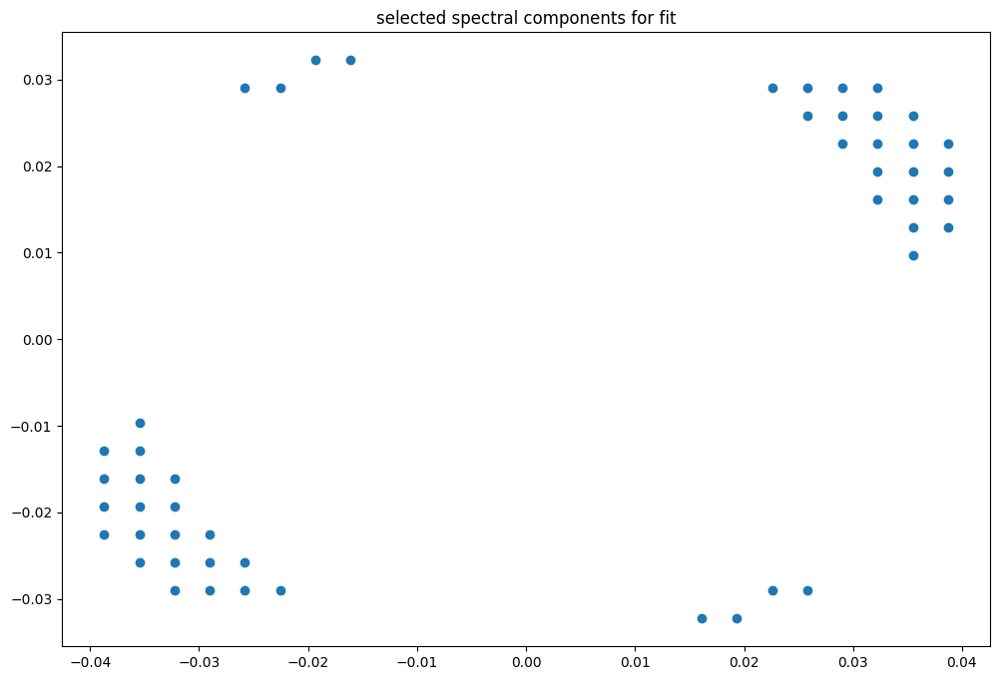

box [6500, 7000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

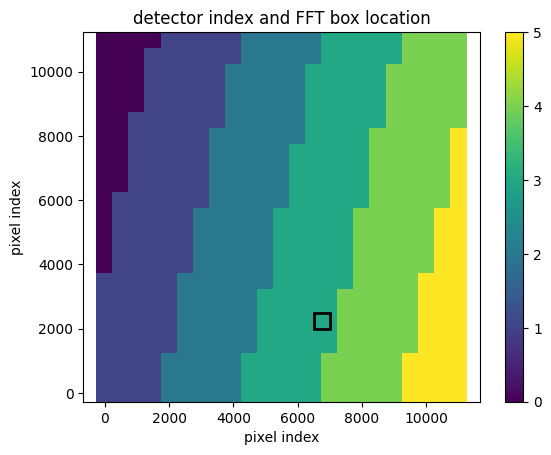

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947943483447979
(31, 31)
(31, 31)
(31, 31)


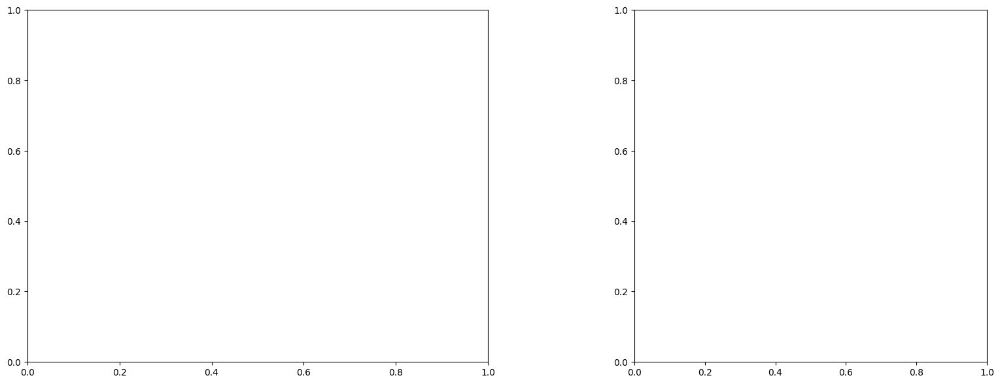

U and V components of current : [0.77593563 1.2415242 ]
uncertainties for U and V: 0.05915449094127349 0.07258253135932022


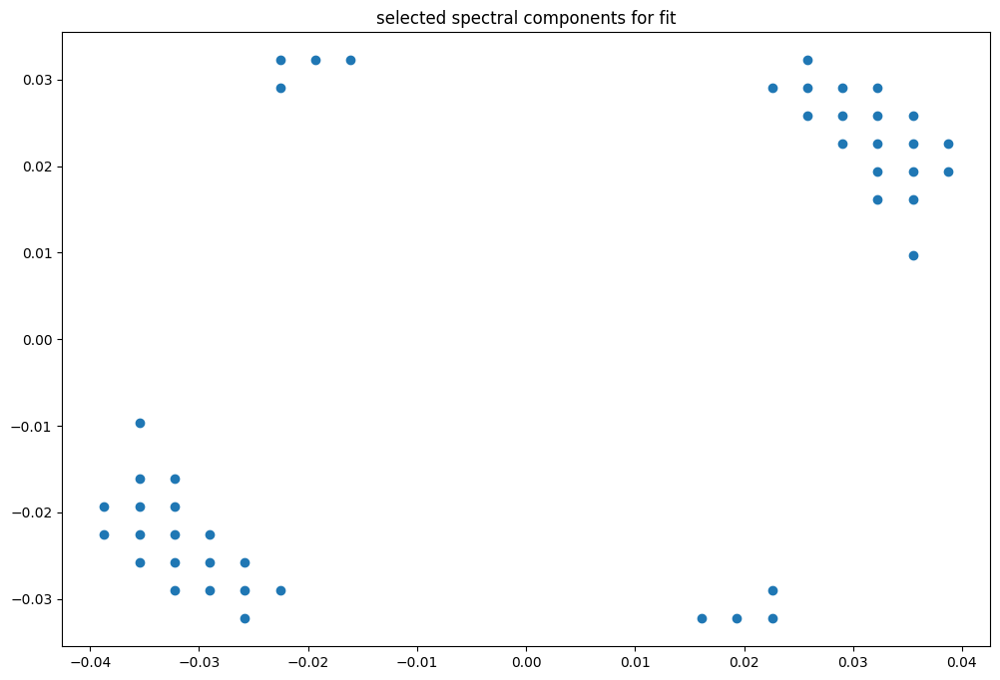

box [6500, 7000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

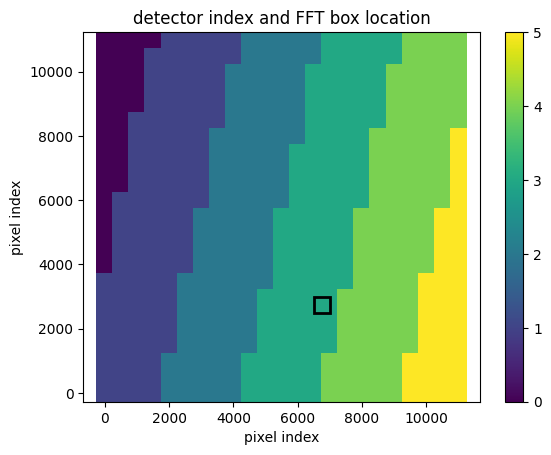

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947908147438635
(31, 31)
(31, 31)
(31, 31)


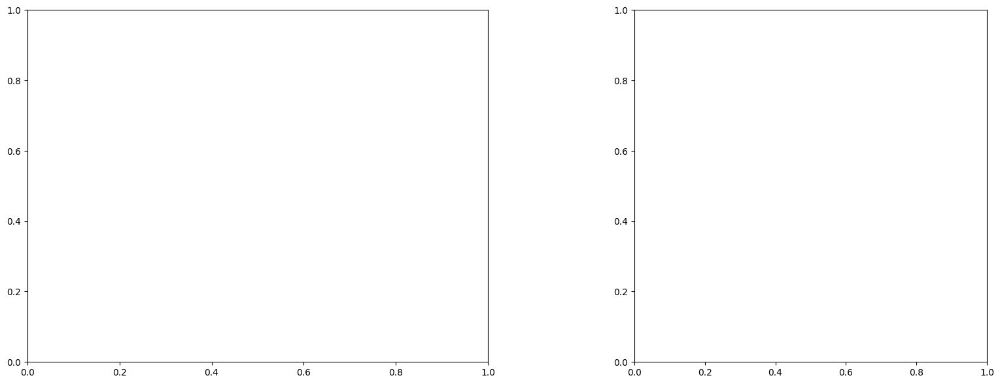

U and V components of current : [1.07645076 0.86961261]
uncertainties for U and V: 0.05174285631091493 0.06369288174122092


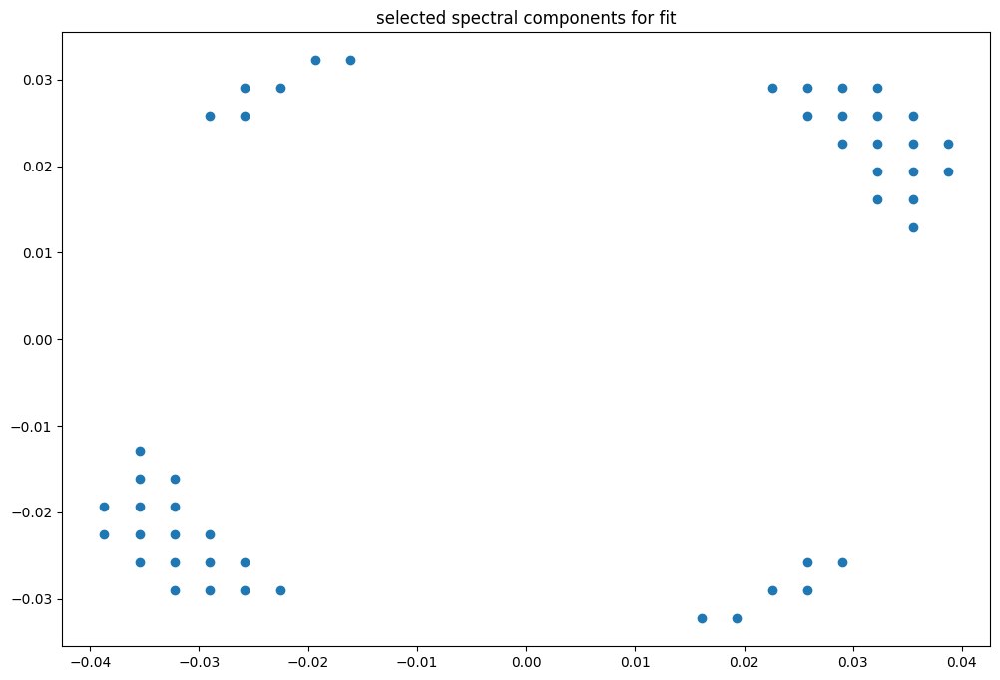

box [6500, 7000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

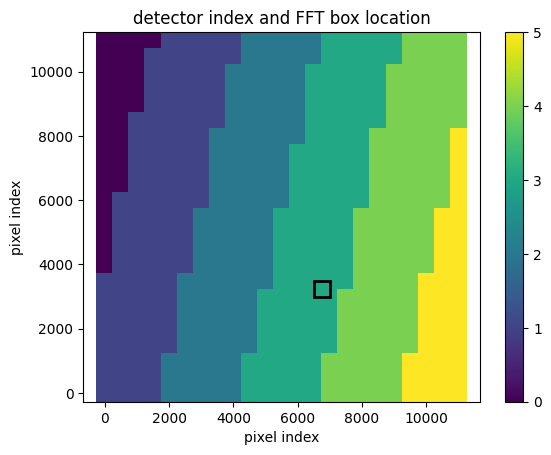

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


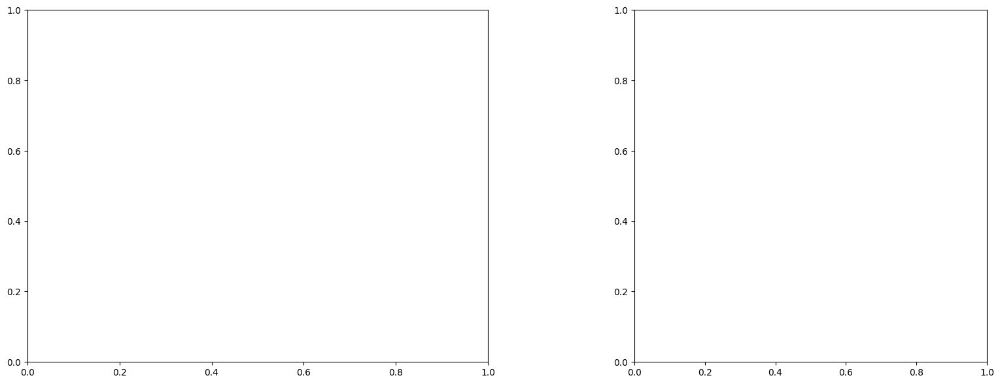

U and V components of current : [0.93954873 1.19170234]
uncertainties for U and V: 0.054999572895963585 0.06848959973895734


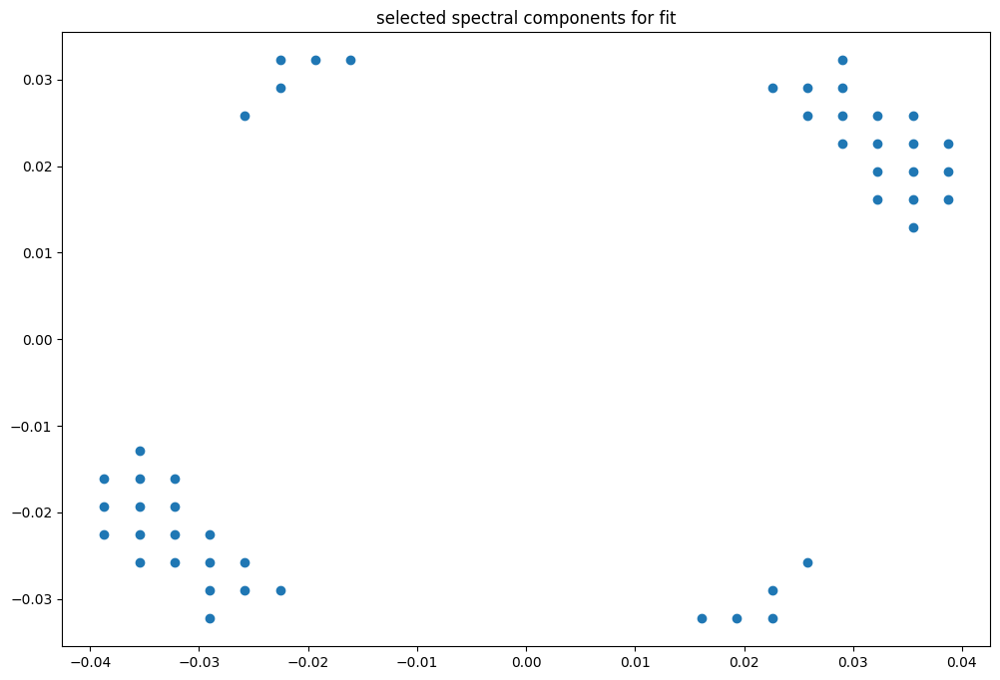

box [6500, 7000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

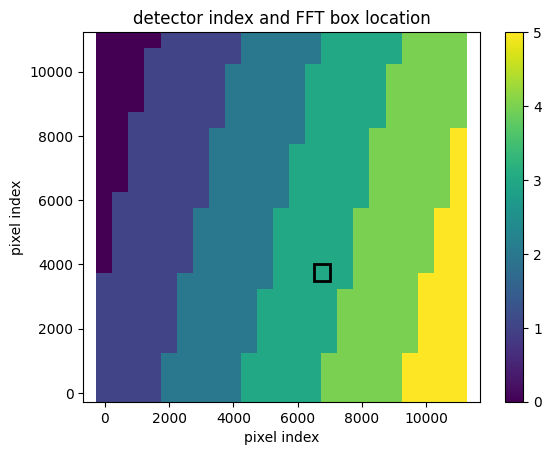

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


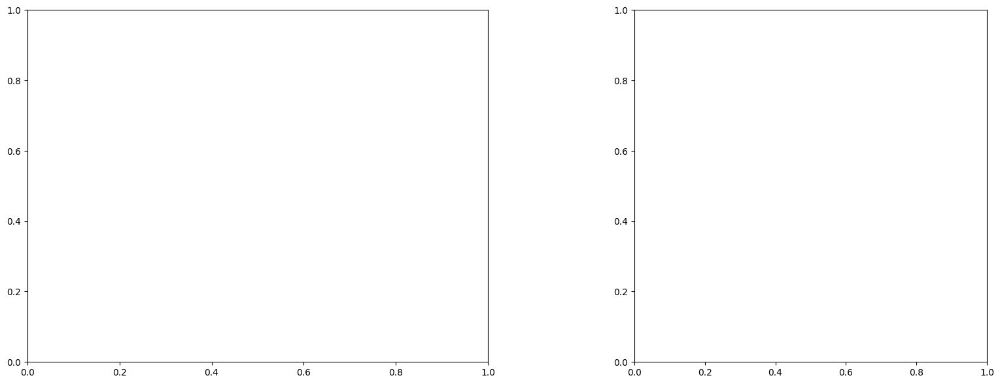

U and V components of current : [0.98836827 1.12485721]
uncertainties for U and V: 0.0582608741872683 0.07036092235419789


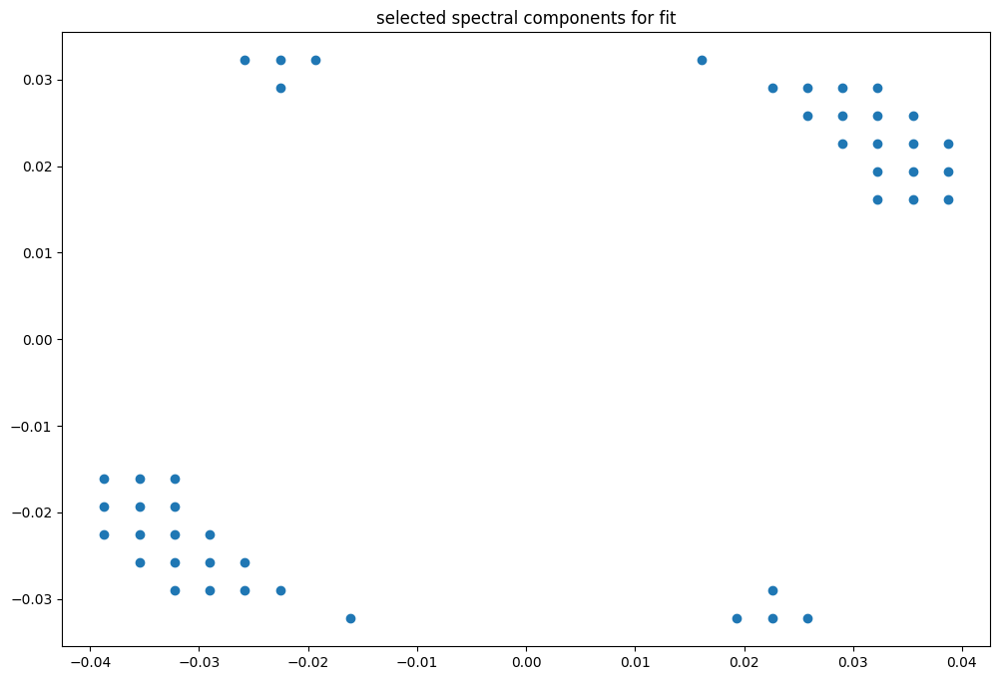

box [6500, 7000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

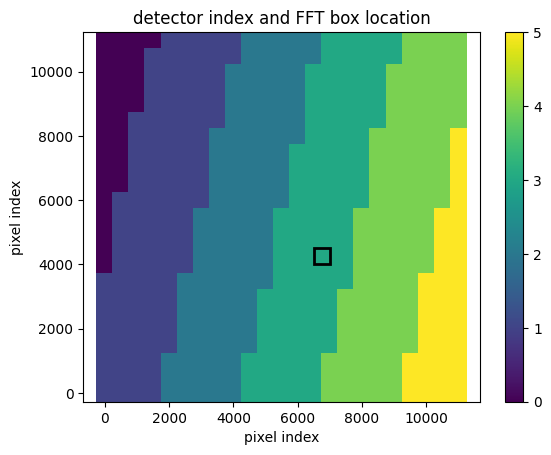

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947843606011624
(31, 31)
(31, 31)
(31, 31)


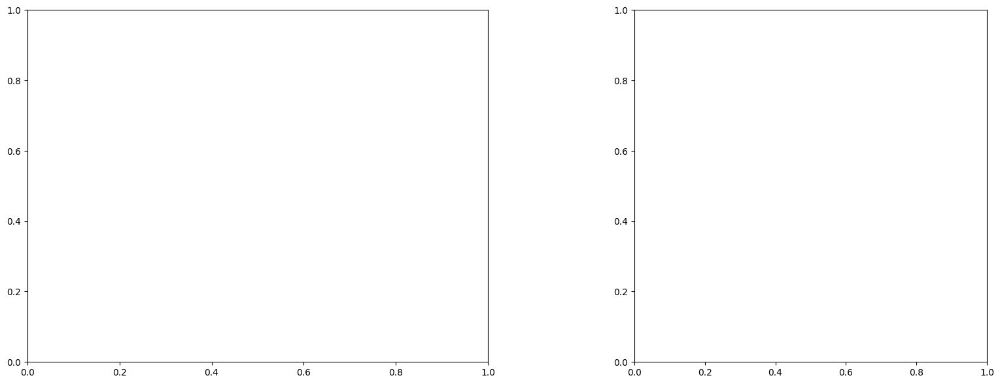

U and V components of current : [1.09460522 1.19575951]
uncertainties for U and V: 0.1018694597274294 0.1196336448317454


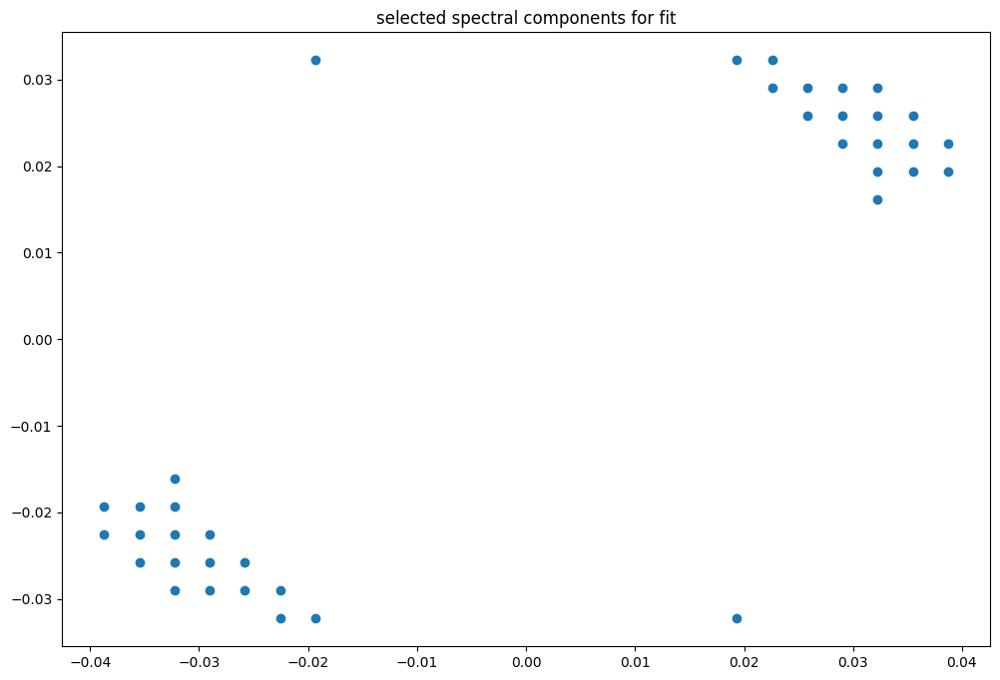

box [6500, 7000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

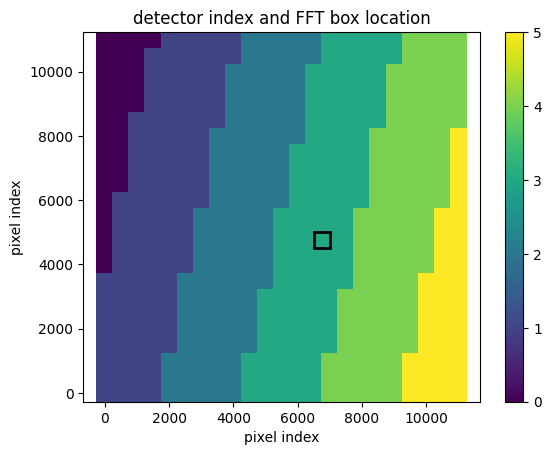

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


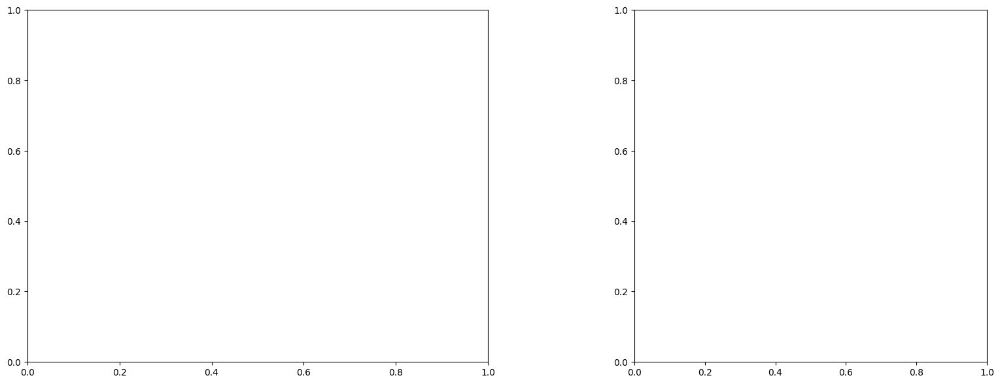

U and V components of current : [0.90088743 1.39140406]
uncertainties for U and V: 0.10874673065806528 0.13045820038997993


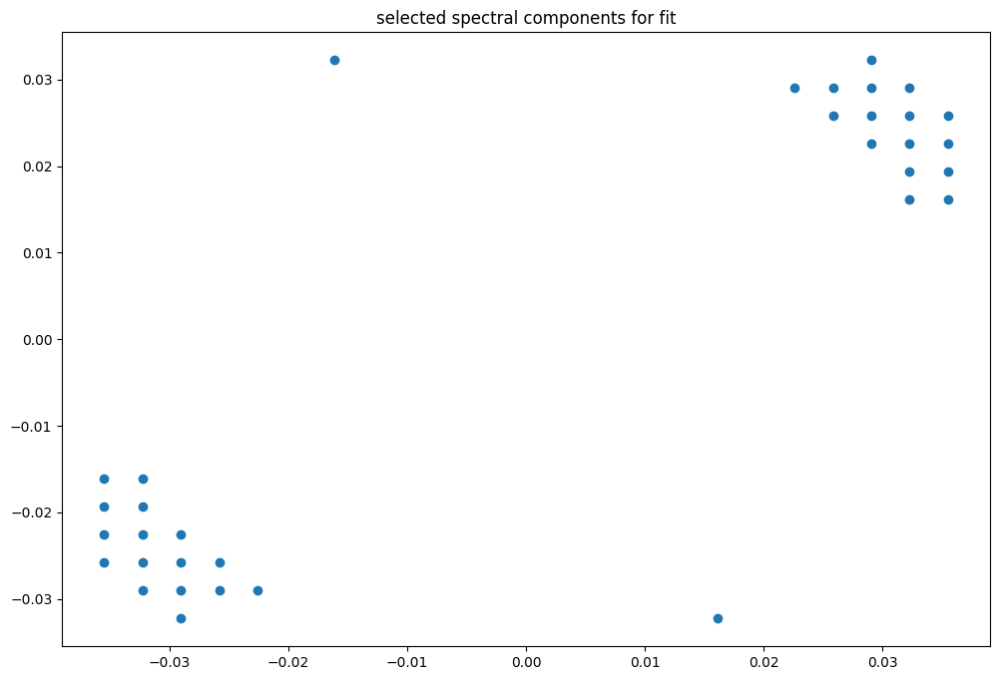

box [6500, 7000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

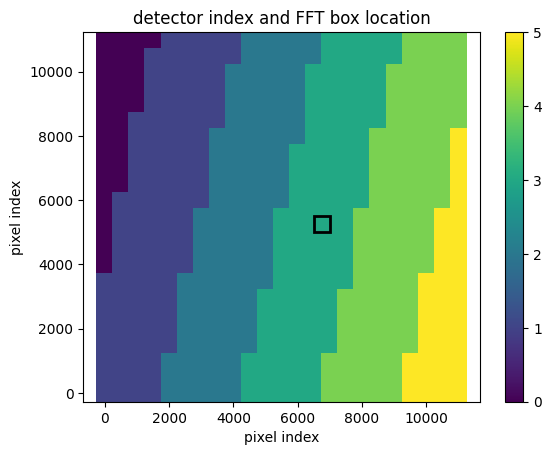

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


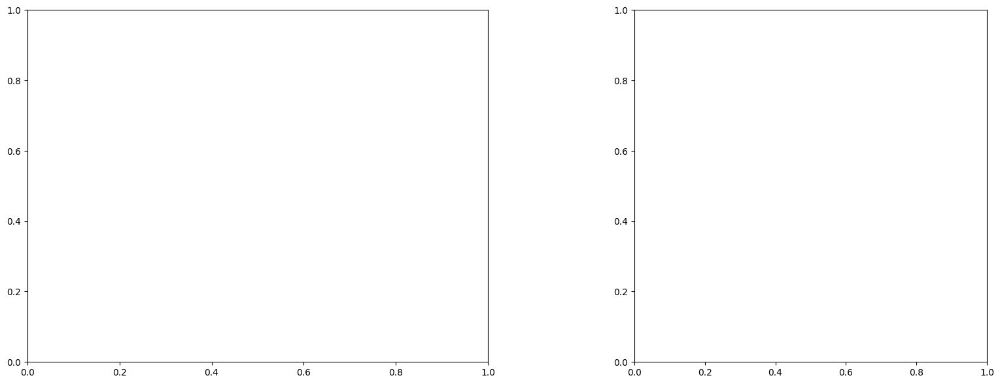

U and V components of current : [1.21216776 1.11443038]
uncertainties for U and V: 0.1039254361525543 0.1285253348800657


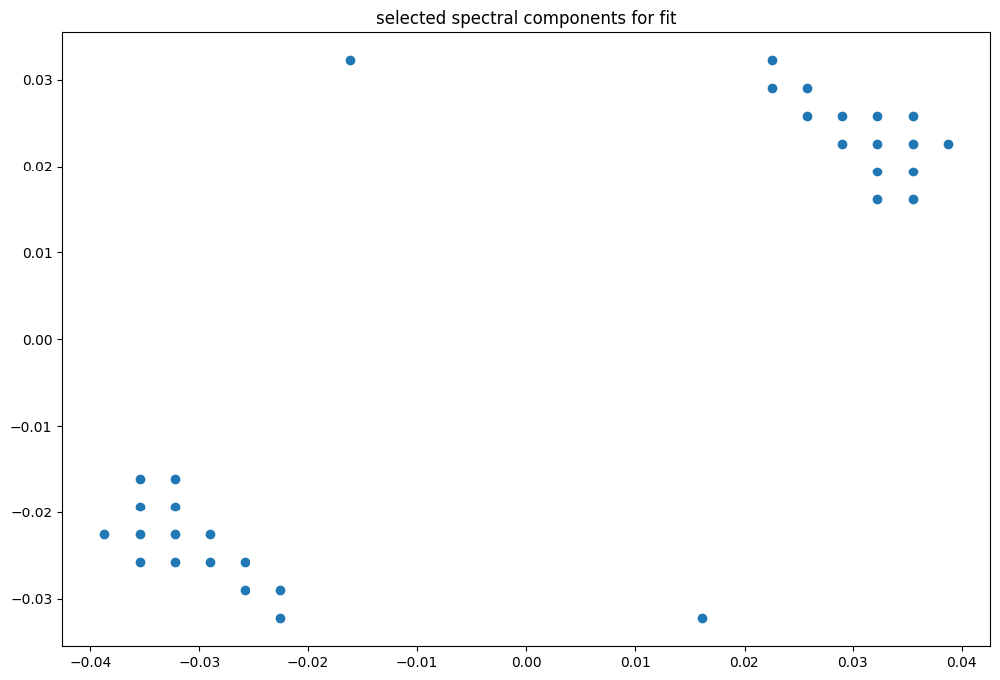

box [6500, 7000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

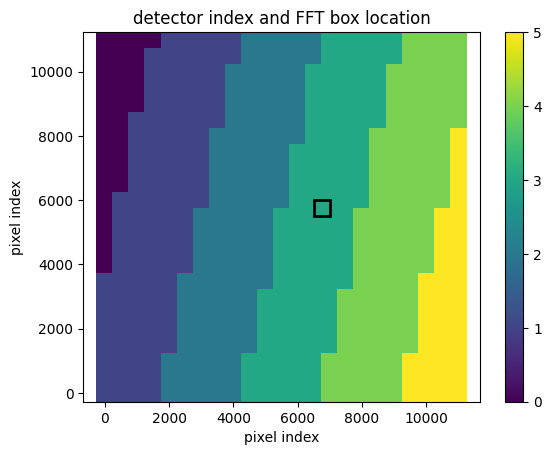

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947777013080478
(31, 31)
(31, 31)
(31, 31)


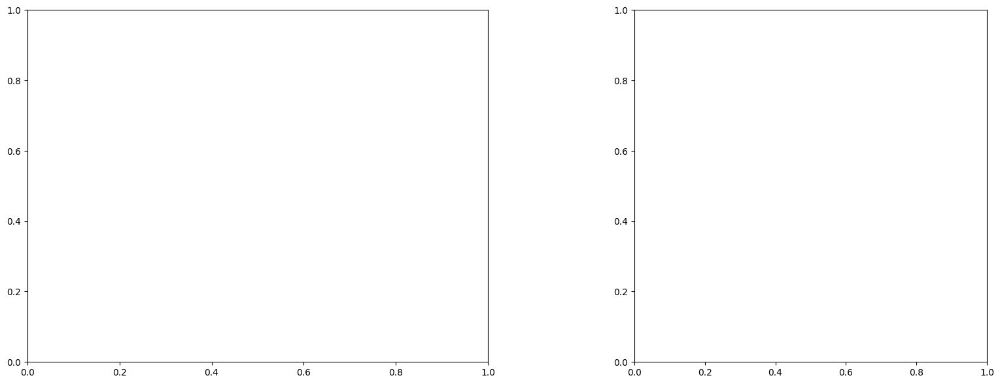

U and V components of current : [1.26737939 1.14330667]
uncertainties for U and V: 0.16558776375524603 0.10855886421860401


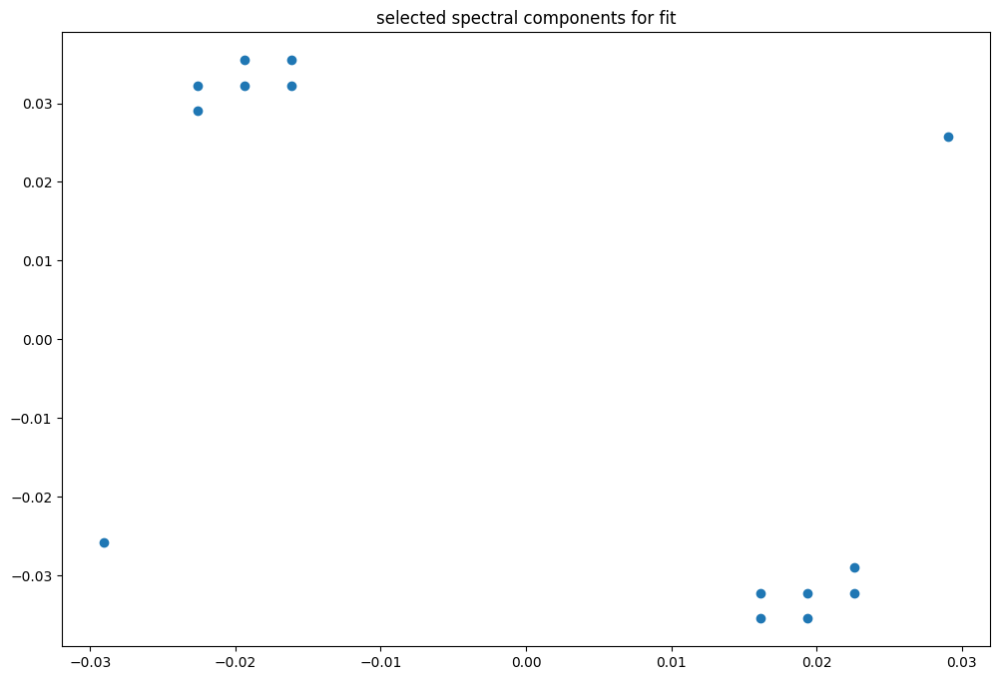

box [6500, 7000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

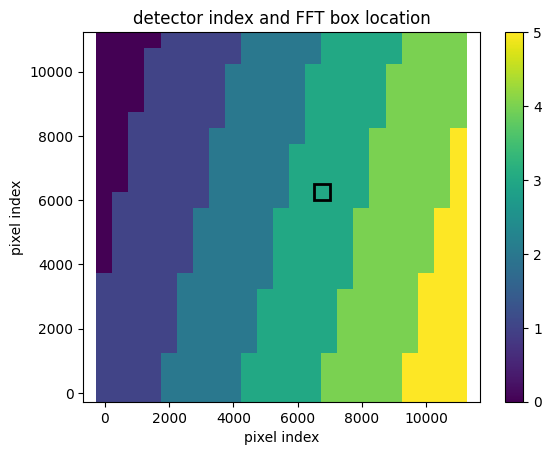

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947748237480838
(31, 31)
(31, 31)
(31, 31)


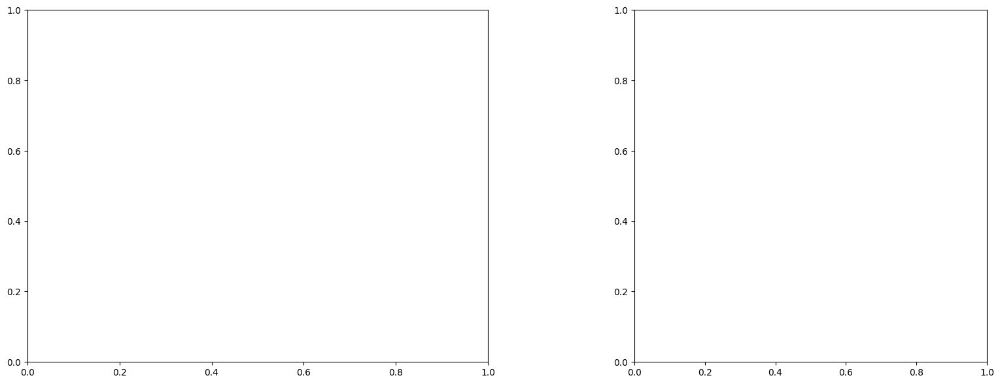

U and V components of current : [1.08605718 1.07311344]
uncertainties for U and V: 0.3423936338578174 0.24799108171422796


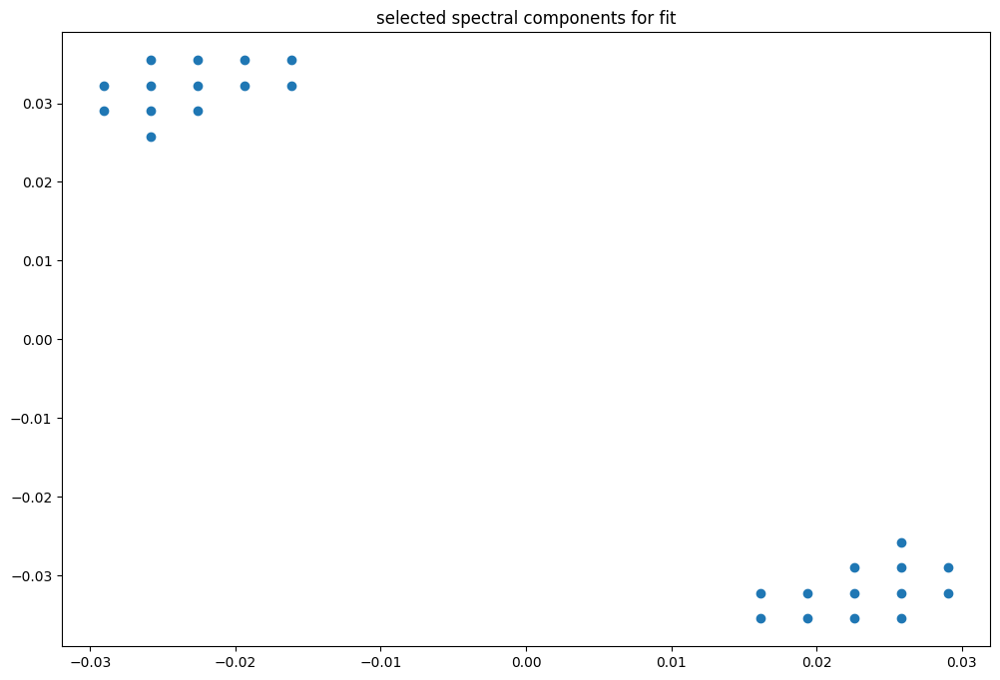

box [6500, 7000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

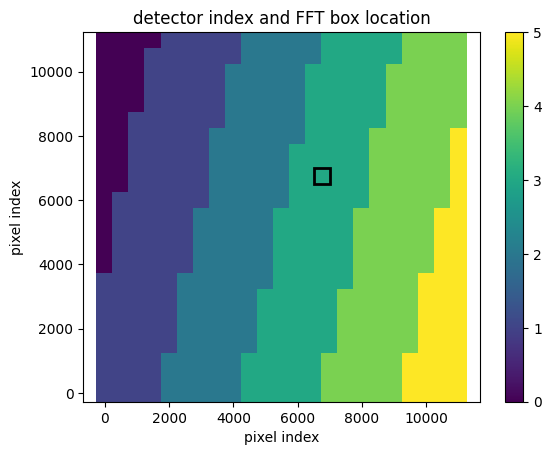

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


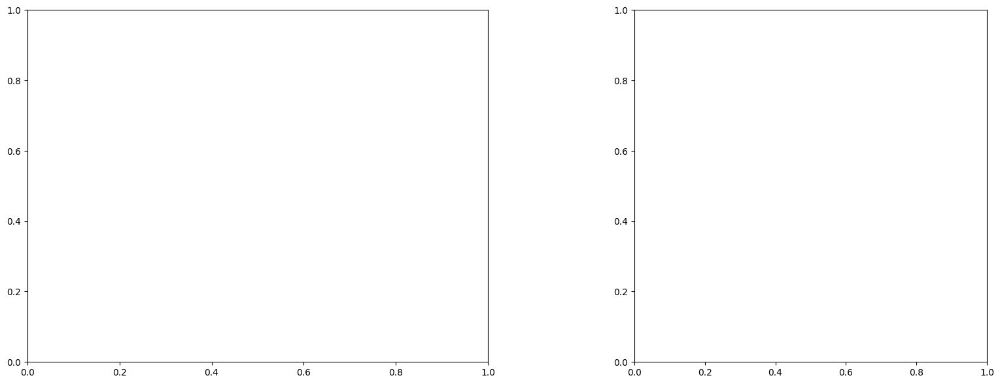

U and V components of current : [0.48567515 0.53499634]
uncertainties for U and V: 0.11010059669482732 0.08487395156983557


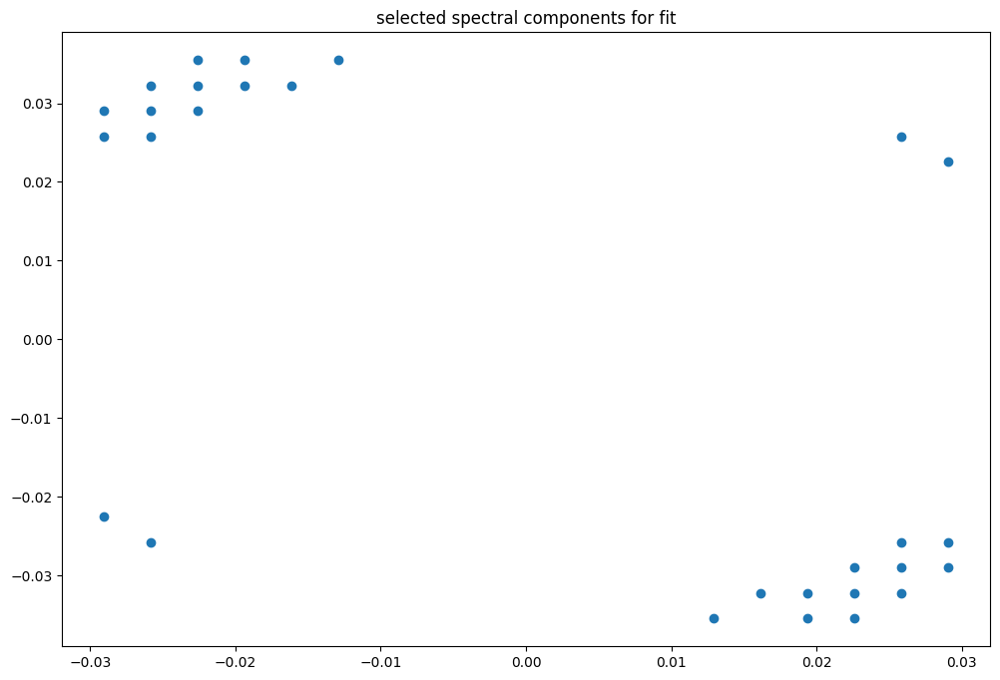

box [6500, 7000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

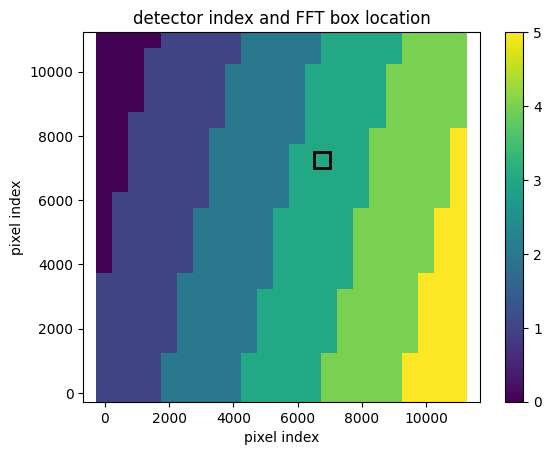

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


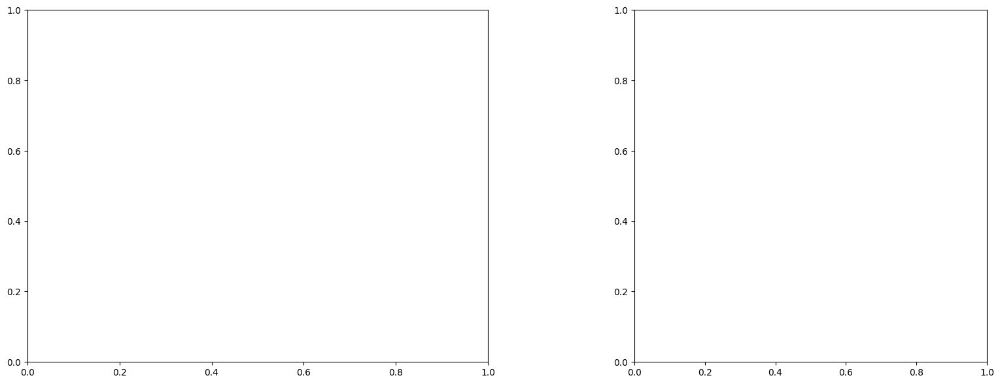

U and V components of current : [0.99255133 0.70646405]
uncertainties for U and V: 0.1350938941448729 0.1138338870208243


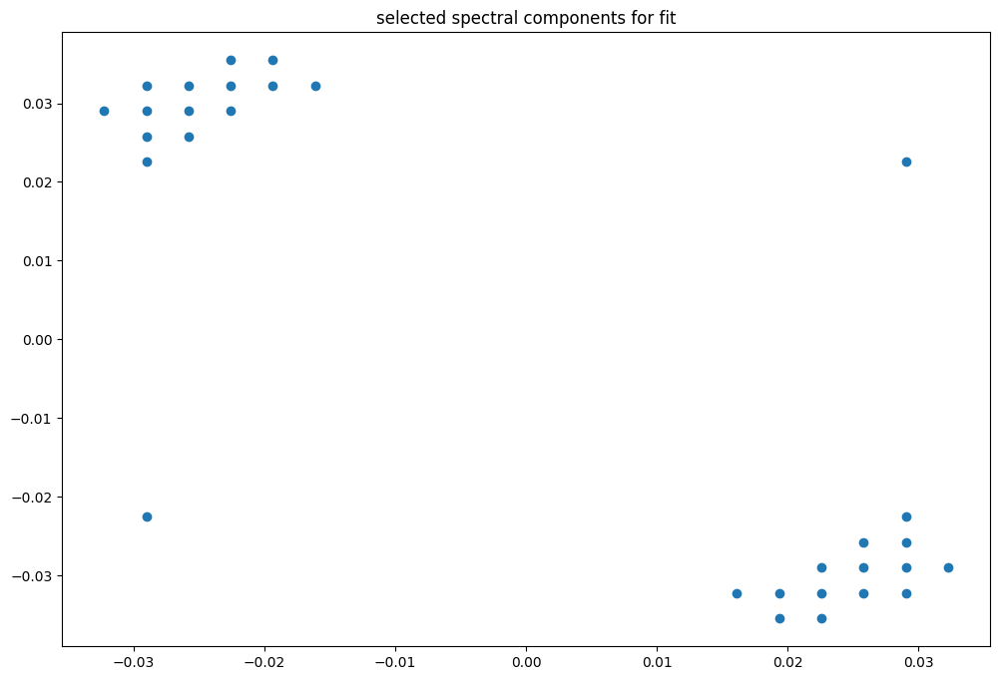

box [6500, 7000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

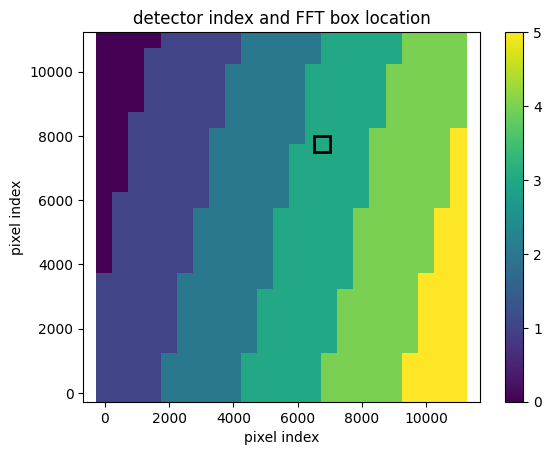

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


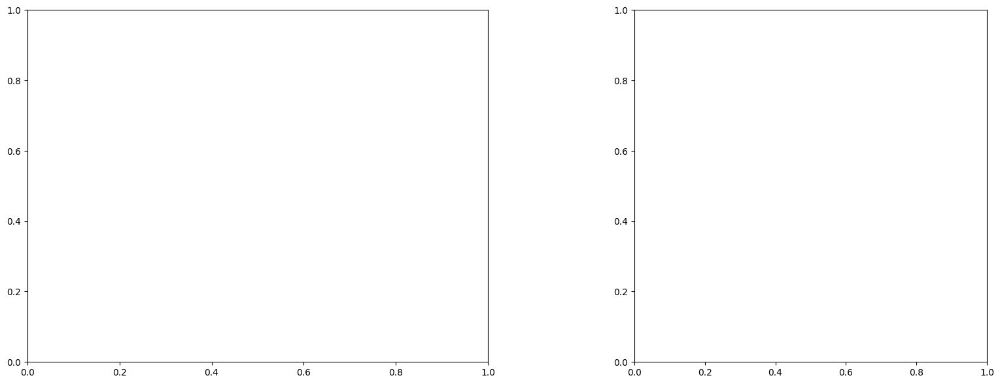

U and V components of current : [1.07356431 0.80098584]
uncertainties for U and V: 0.06087389459312448 0.05122340792085521


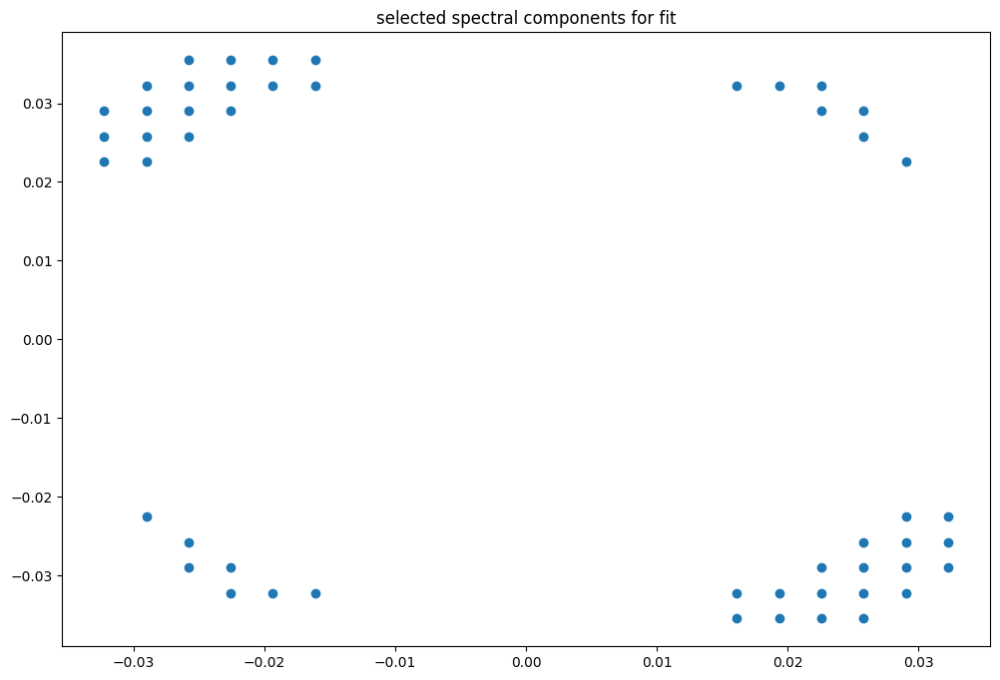

box [6500, 7000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

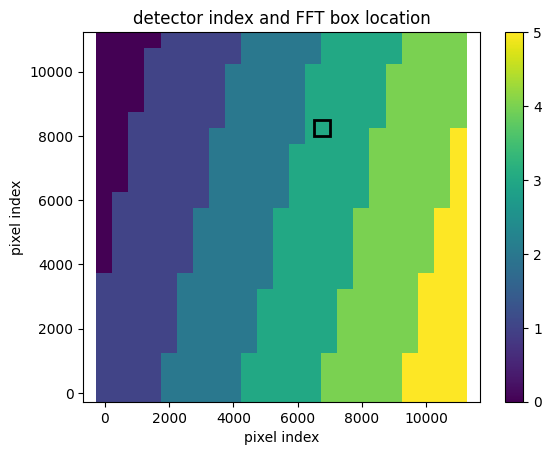

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947659149529672
(31, 31)
(31, 31)
(31, 31)


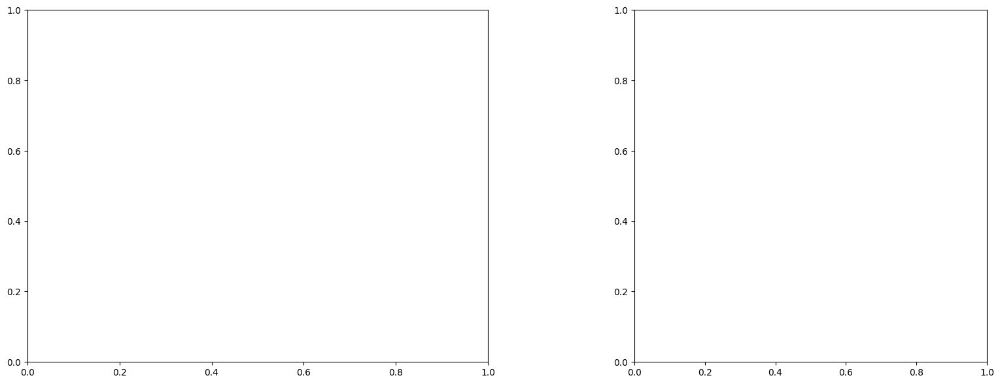

U and V components of current : [1.11993771 0.88623883]
uncertainties for U and V: 0.05929392011906139 0.04840587622991552


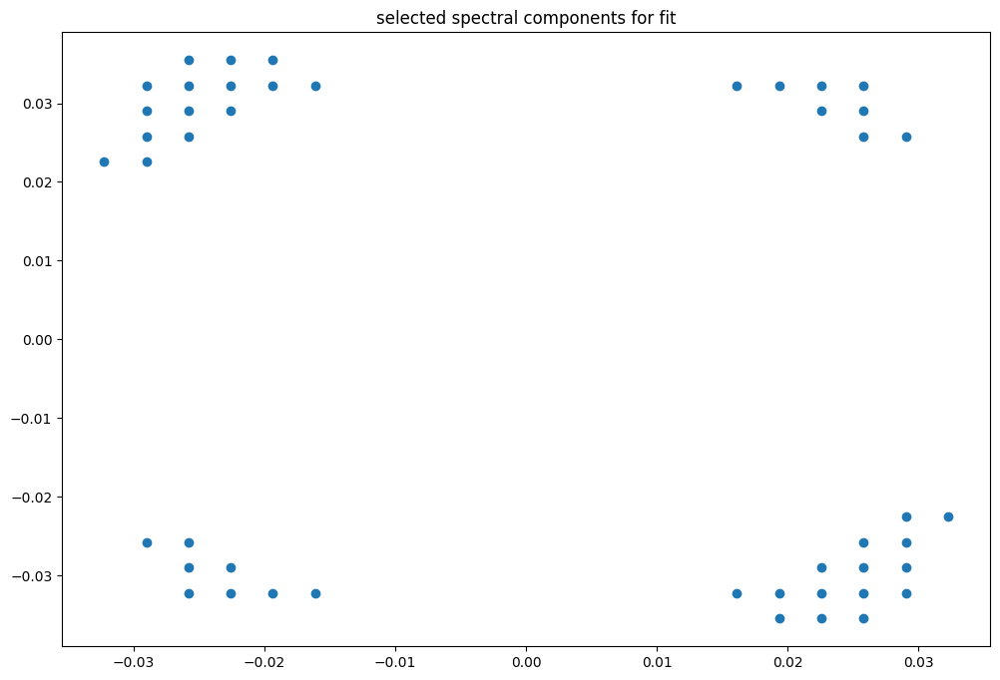

box [6500, 7000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

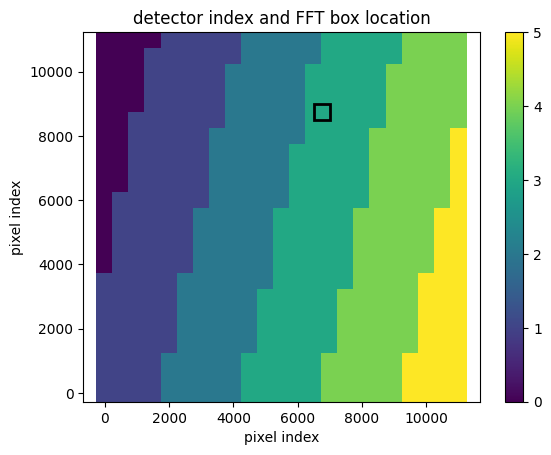

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


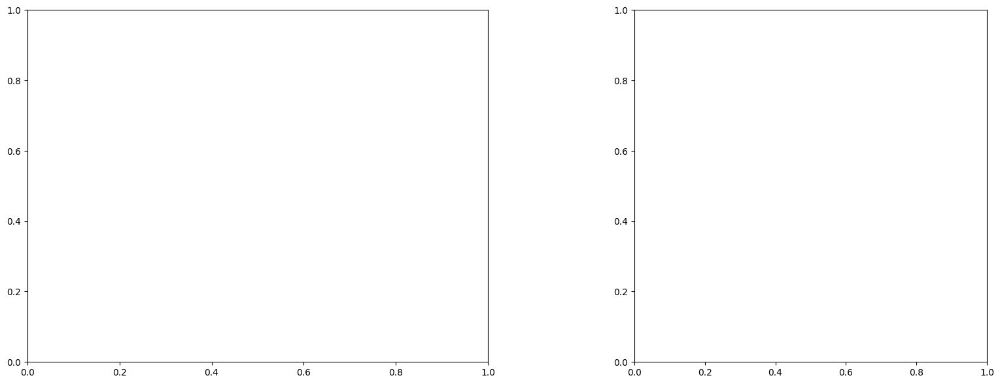

U and V components of current : [0.61021129 0.37003208]
uncertainties for U and V: 0.15424188419435503 0.1398699950646069


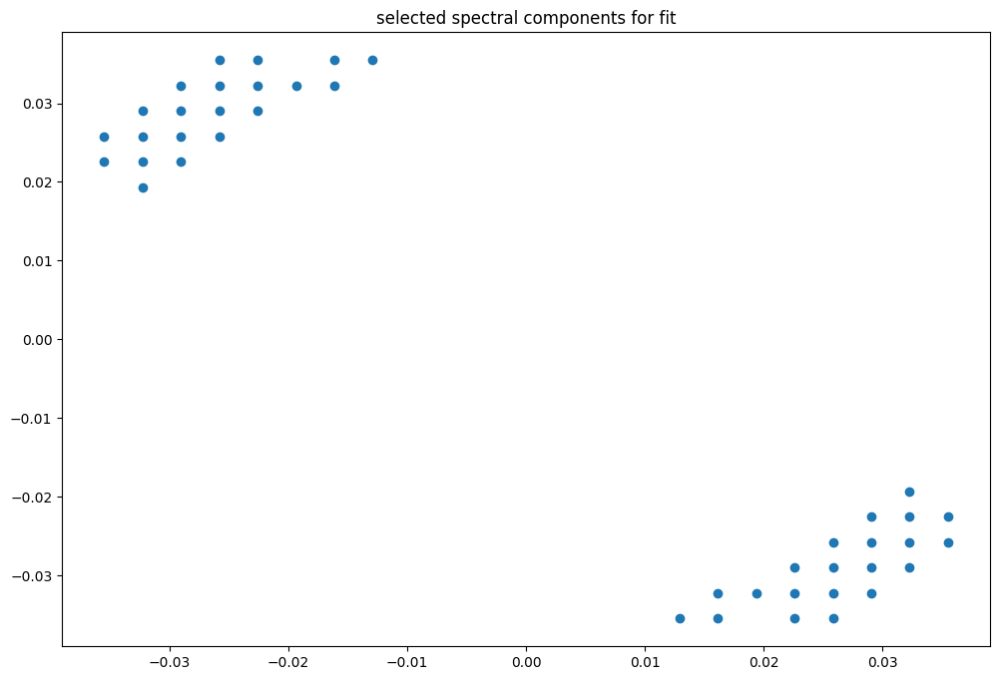

box [6500, 7000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

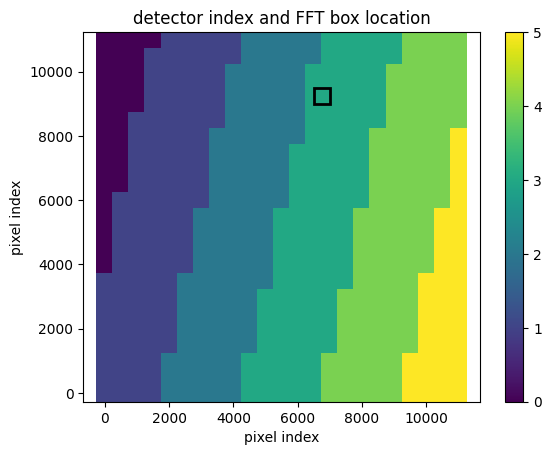

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


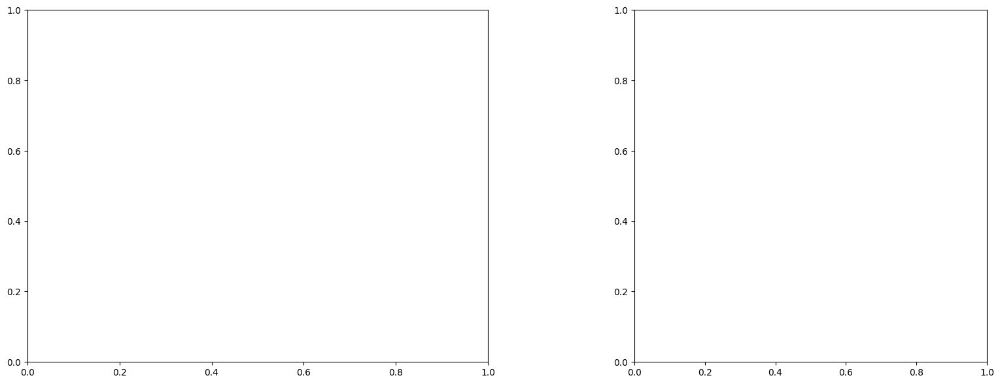

U and V components of current : [0.71903037 0.52135788]
uncertainties for U and V: 0.1498959629339786 0.12903377415549816


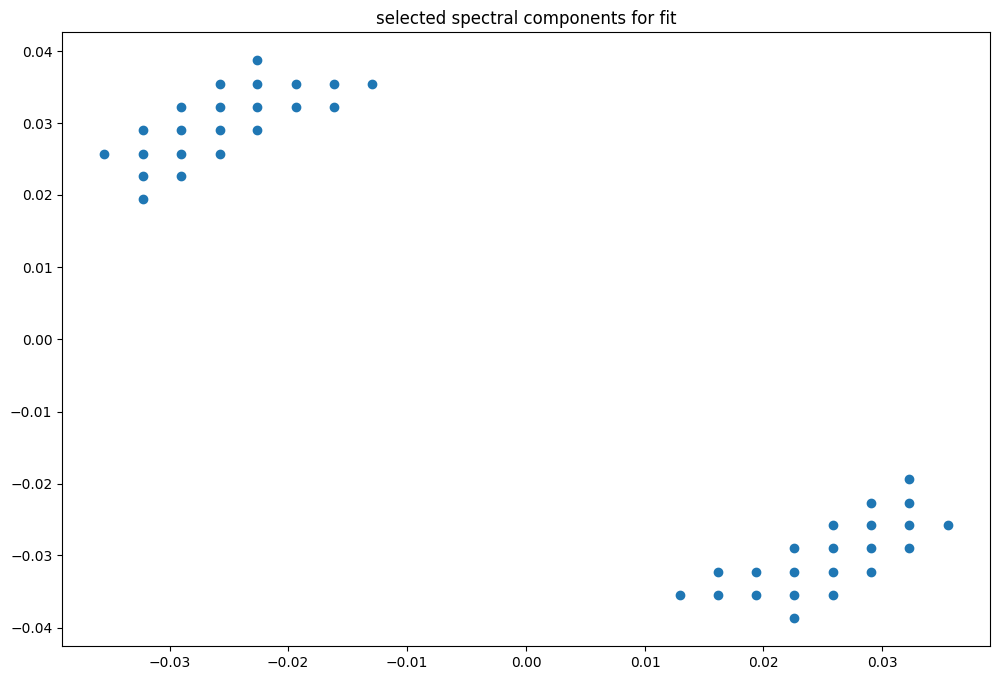

box [6500, 7000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

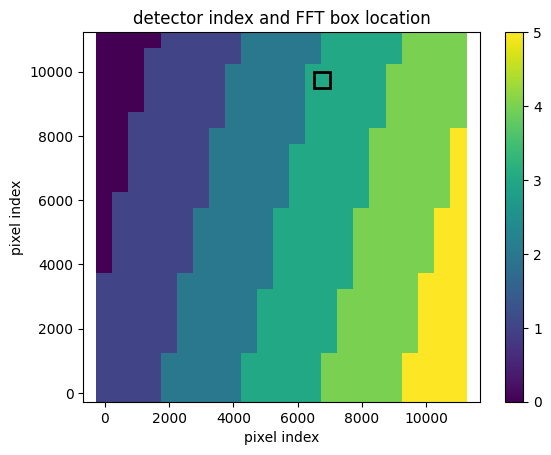

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947599942259363
(31, 31)
(31, 31)
(31, 31)


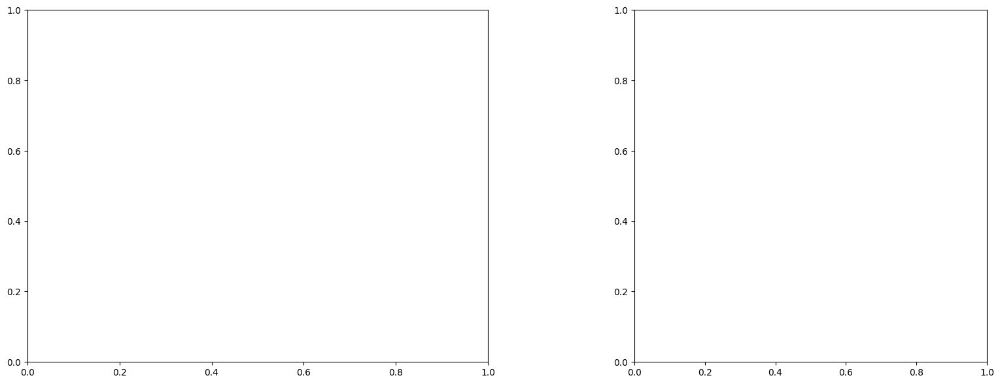

U and V components of current : [ 0.27662221 -0.1751596 ]
uncertainties for U and V: 0.1615220962686458 0.13778422650288355


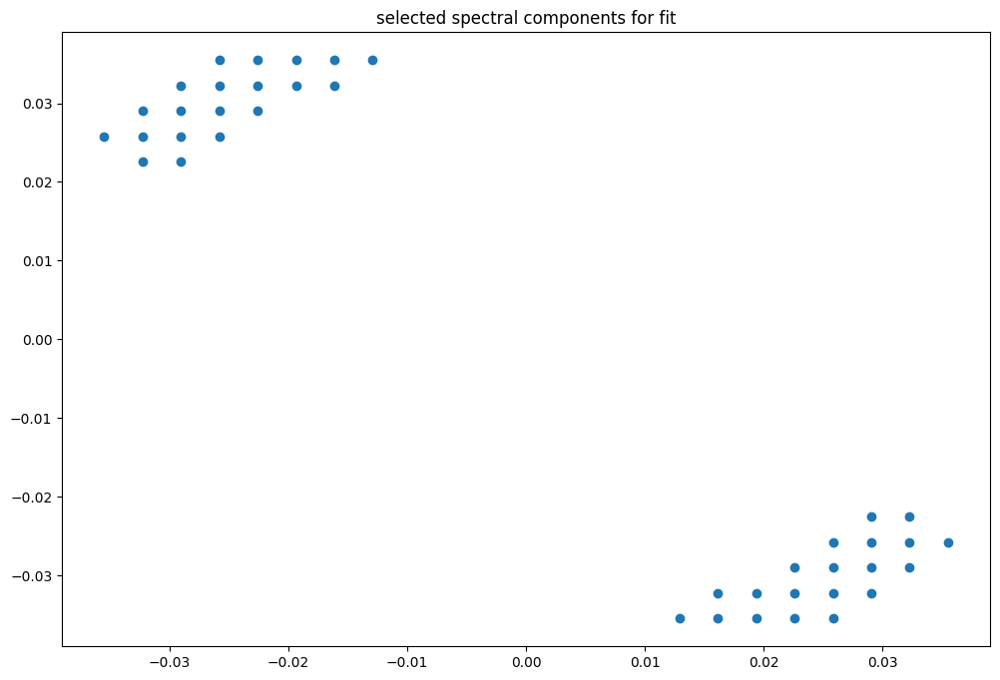

box [6500, 7000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

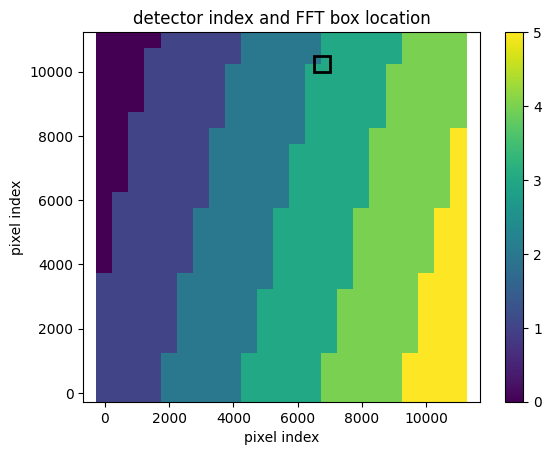

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(31, 31)
(31, 31)
(31, 31)


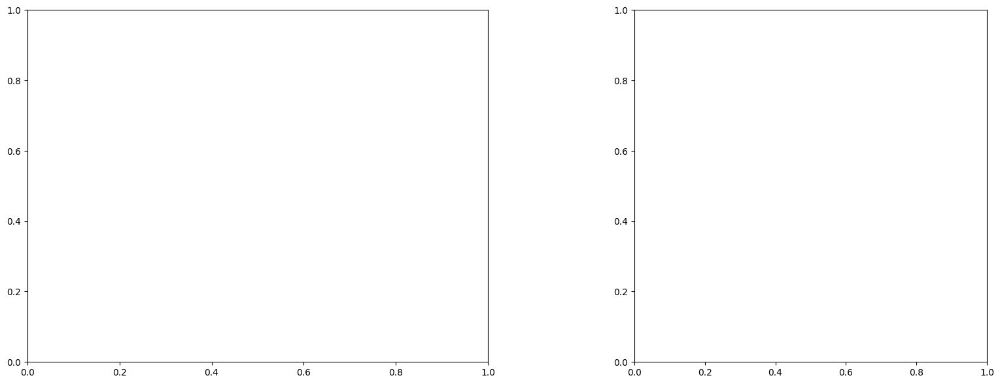

LinAlgError: Singular matrix

box [6500, 7000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

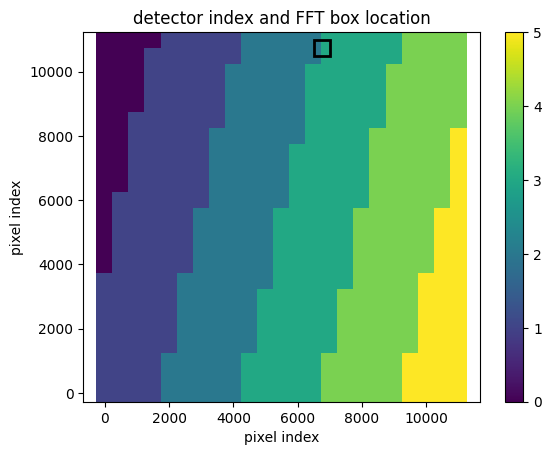

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.5
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(31, 30)
(31, 30)
(31, 30)


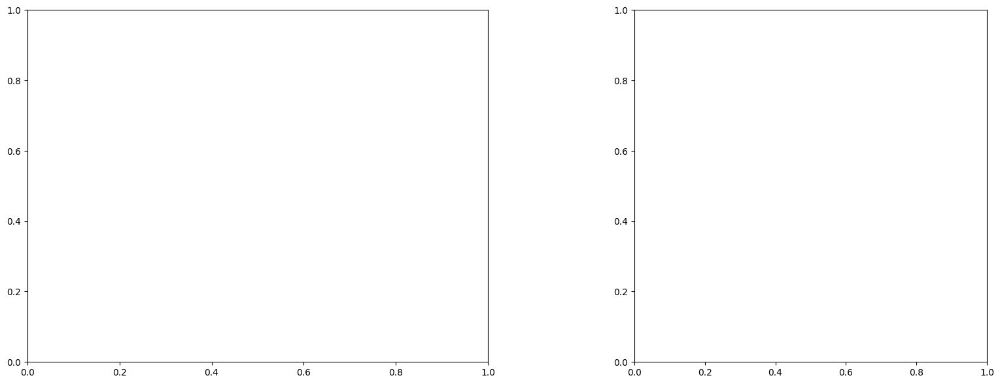

LinAlgError: Singular matrix

box [7000, 7500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

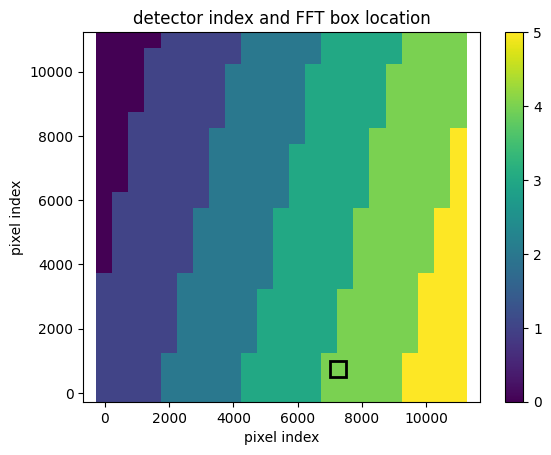

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987391765727964
(31, 31)
(31, 31)
(31, 31)


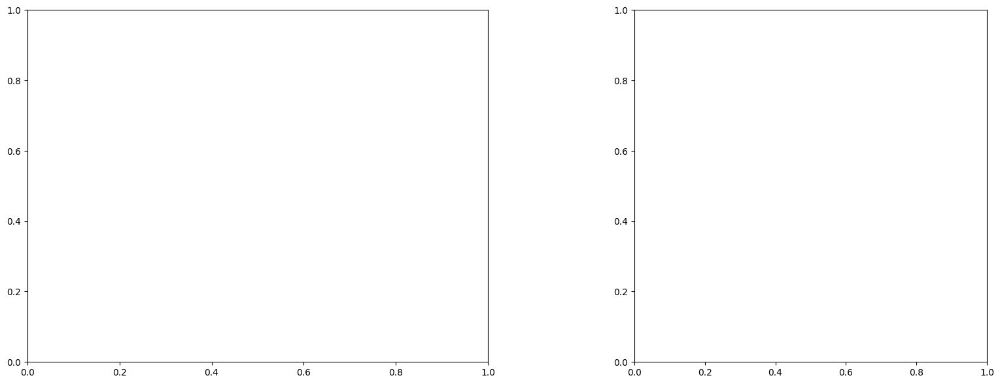

U and V components of current : [0.12465646 1.57320364]
uncertainties for U and V: 0.09203441129230097 0.1526988339935128


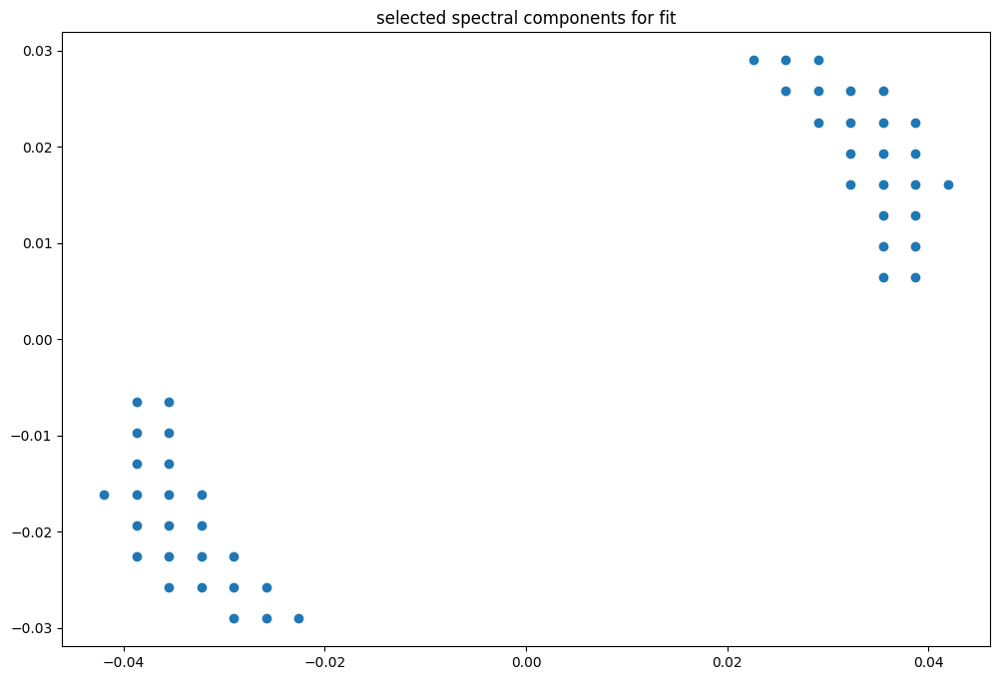

box [7000, 7500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

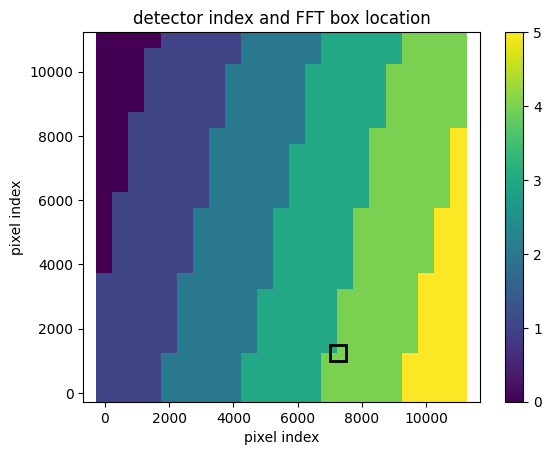

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


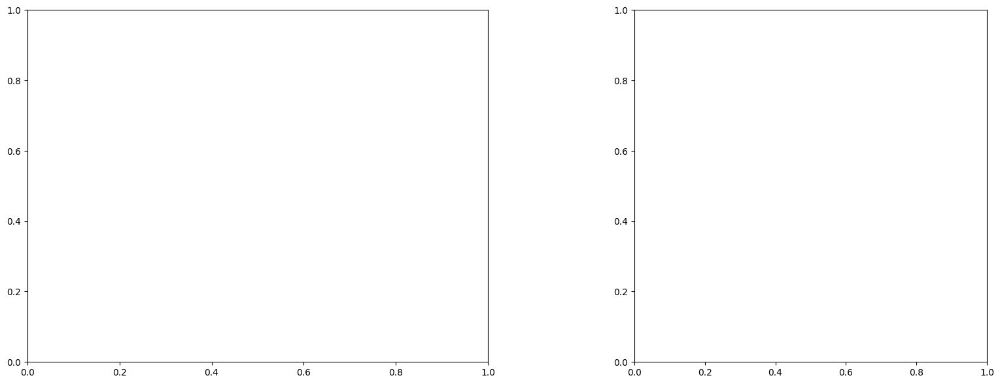

LinAlgError: Singular matrix

box [7000, 7500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

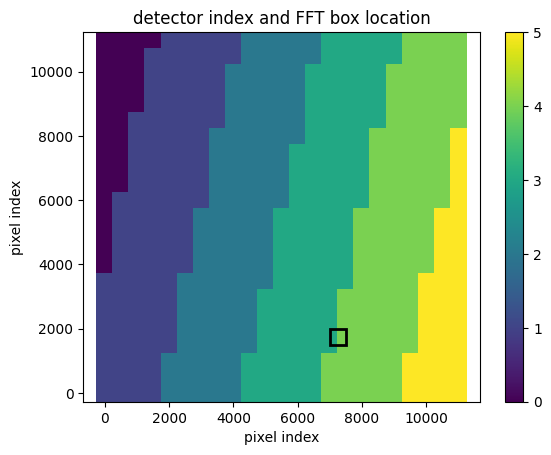

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


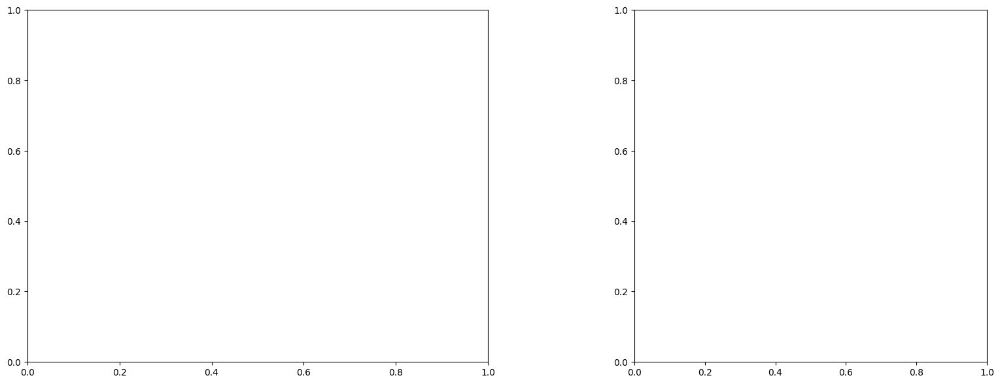

LinAlgError: Singular matrix

box [7000, 7500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

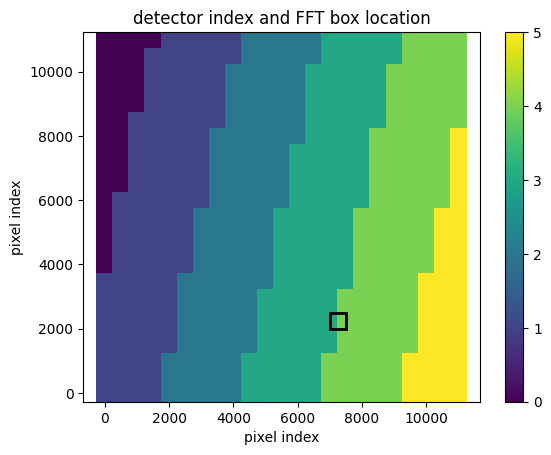

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


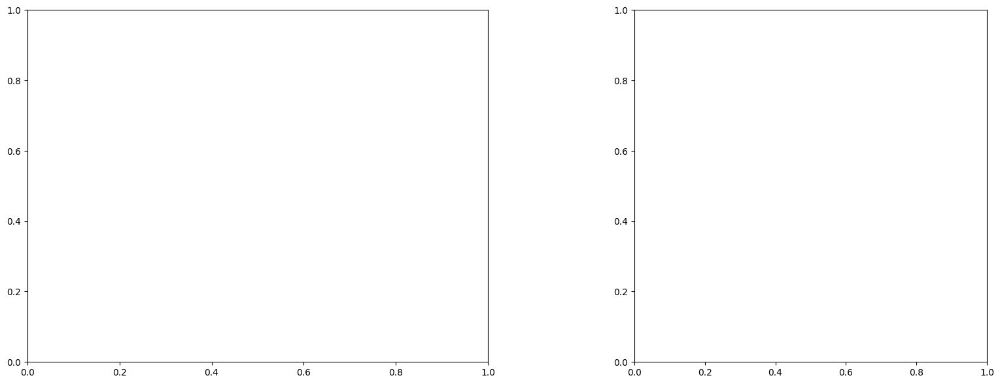

LinAlgError: Singular matrix

box [7000, 7500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

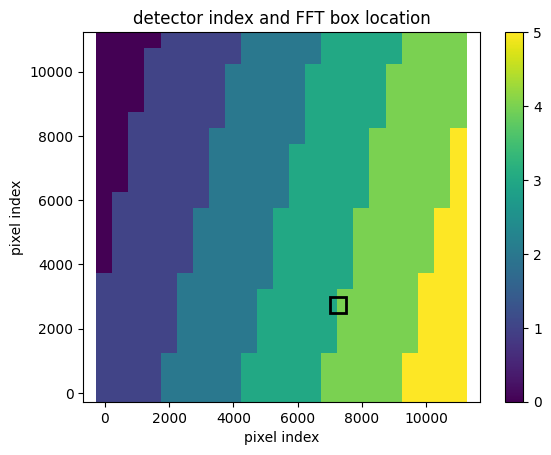

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


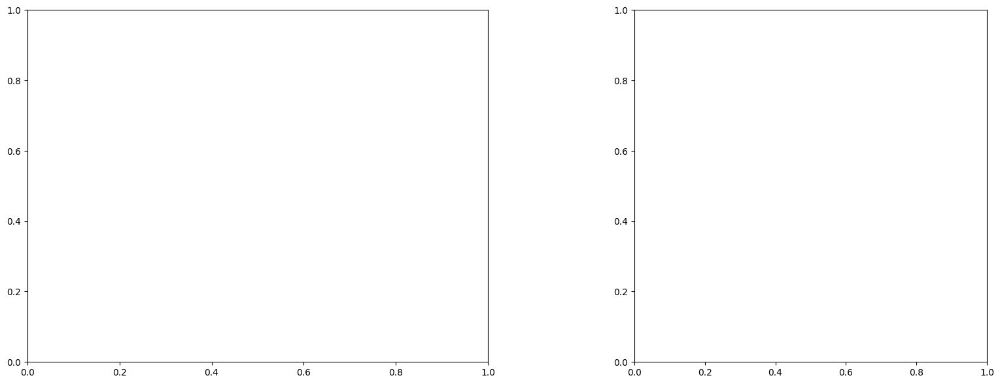

LinAlgError: Singular matrix

box [7000, 7500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

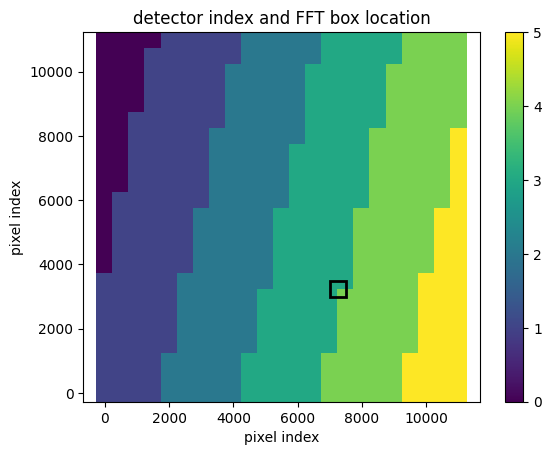

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


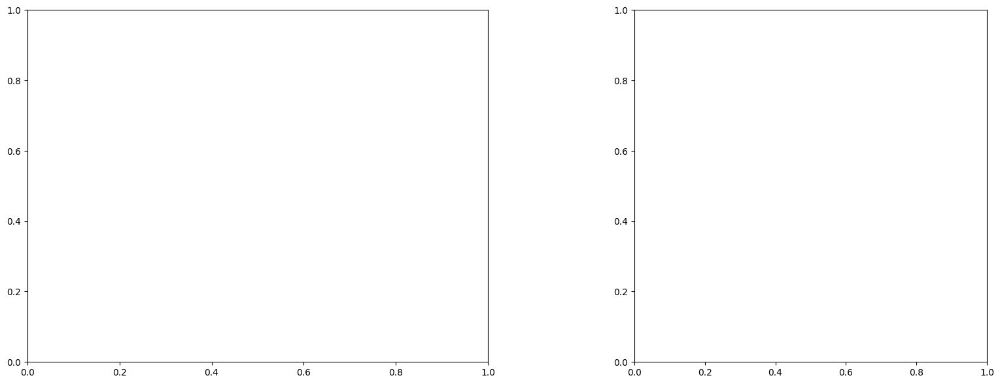

U and V components of current : [0.90779624 1.01174733]
uncertainties for U and V: 0.07573673203577382 0.10005473993262552


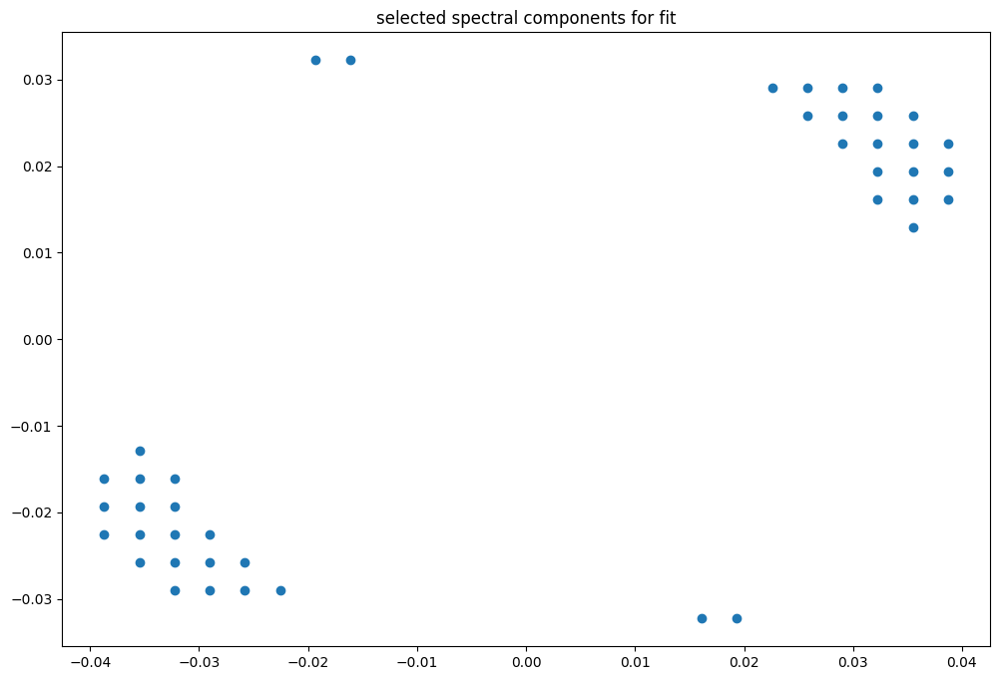

box [7000, 7500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

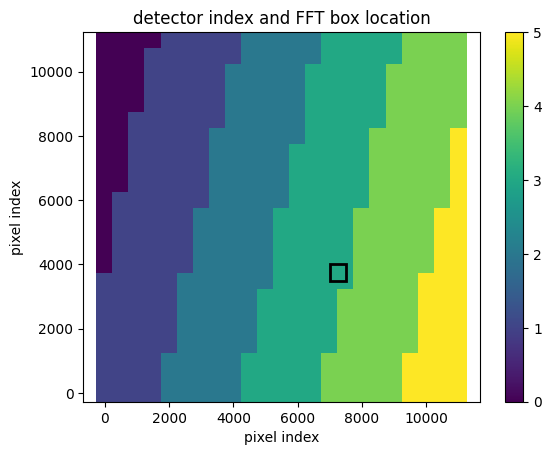

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947875099268992
(31, 31)
(31, 31)
(31, 31)


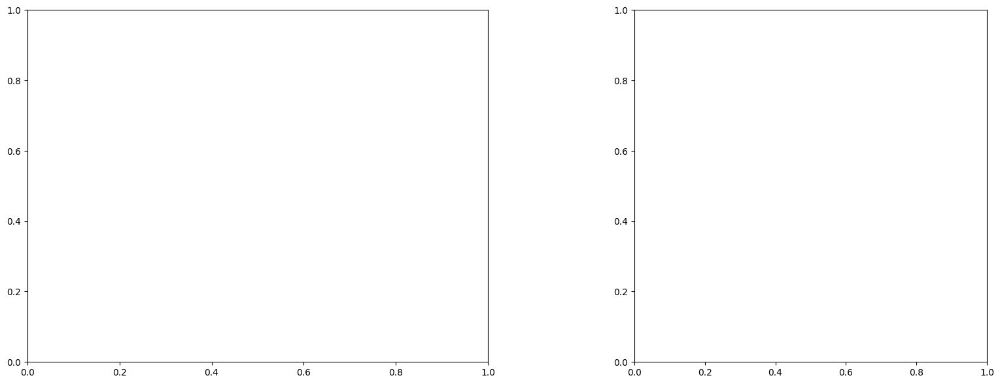

U and V components of current : [1.03467685 1.12747608]
uncertainties for U and V: 0.059370560824020334 0.07581326575243261


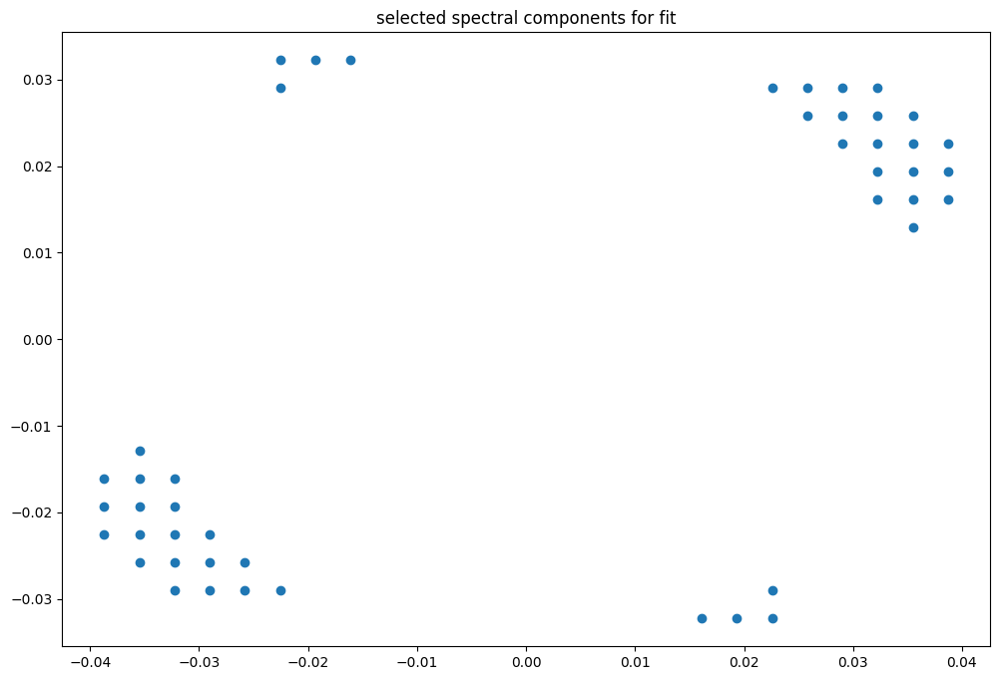

box [7000, 7500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

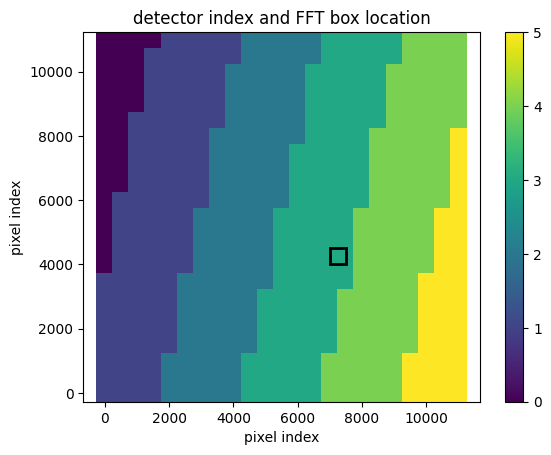

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947843606011624
(31, 31)
(31, 31)
(31, 31)


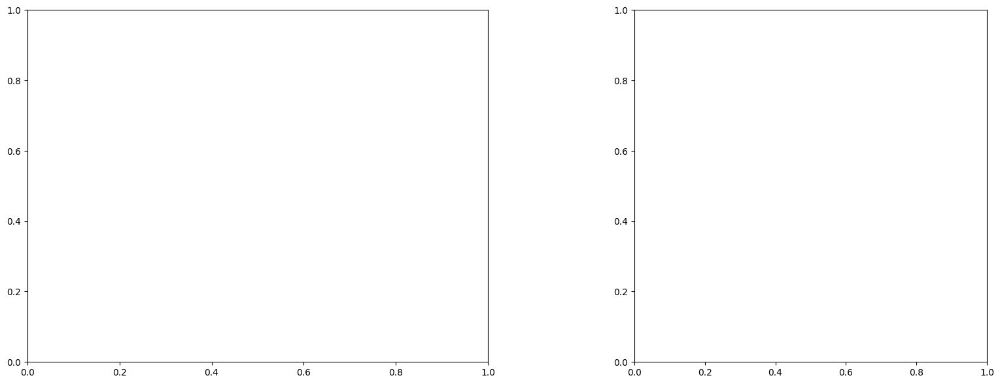

U and V components of current : [1.12631846 1.21174534]
uncertainties for U and V: 0.08027592770401765 0.09518353982264251


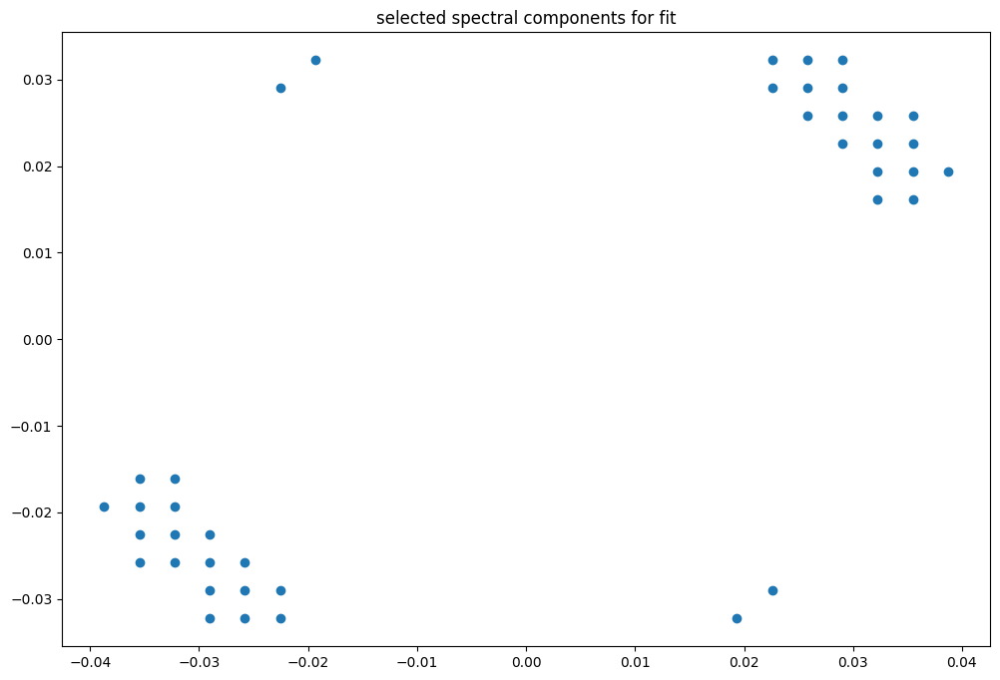

box [7000, 7500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

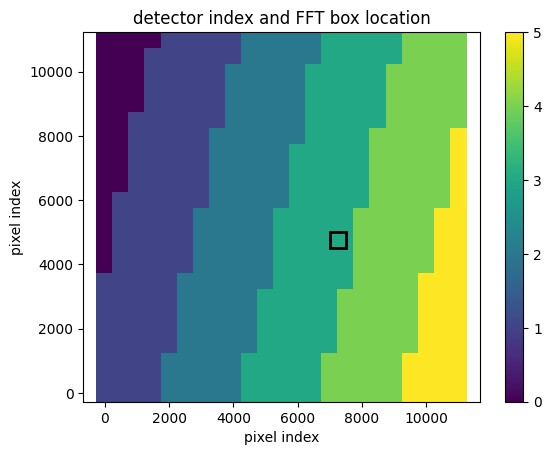

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947810975859519
(31, 31)
(31, 31)
(31, 31)


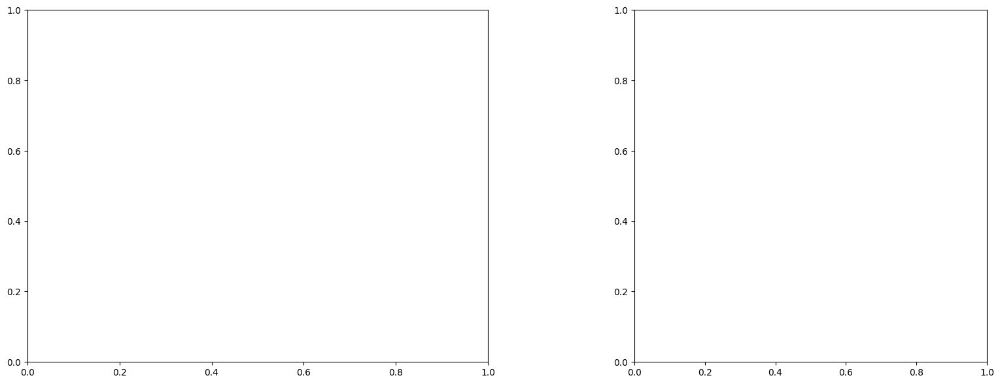

U and V components of current : [0.98610243 1.39576475]
uncertainties for U and V: 0.0907142975312608 0.11421058346540461


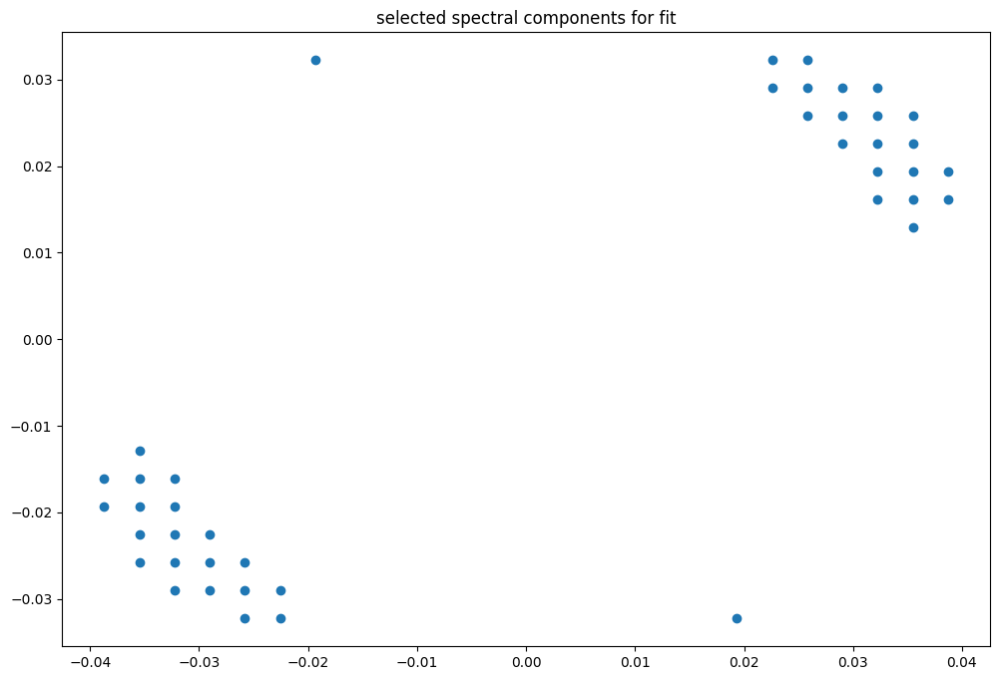

box [7000, 7500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

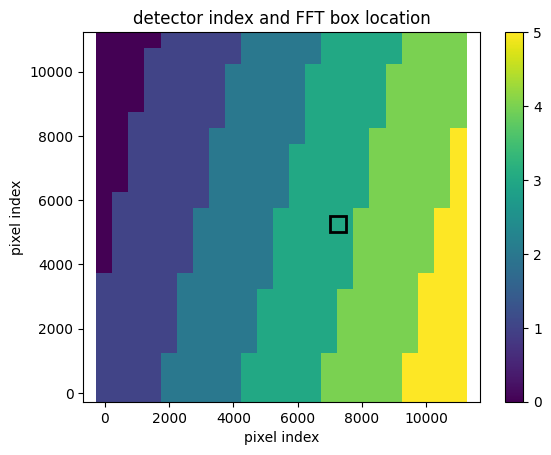

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947777013080478
(31, 31)
(31, 31)
(31, 31)


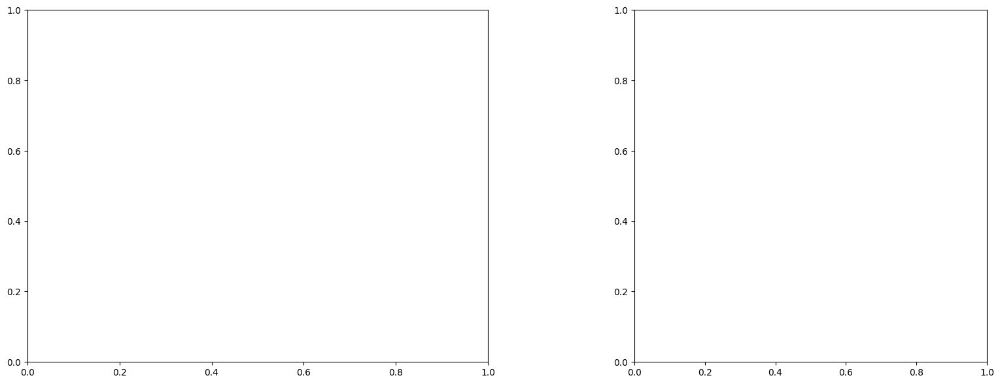

U and V components of current : [1.2450196  1.19827326]
uncertainties for U and V: 0.06898050176172607 0.07209175555924431


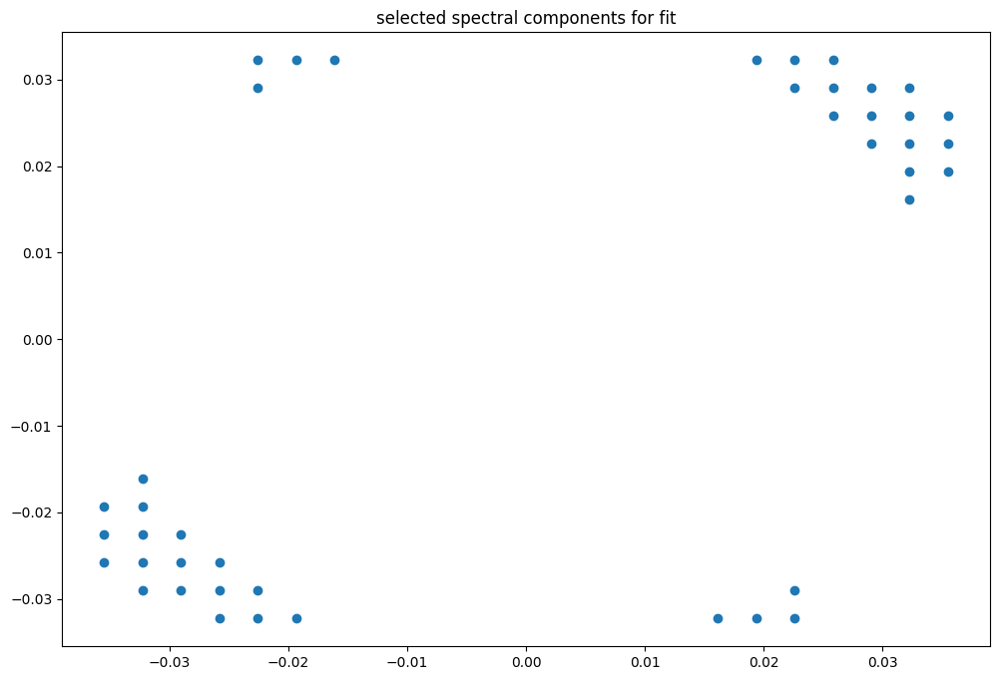

box [7000, 7500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

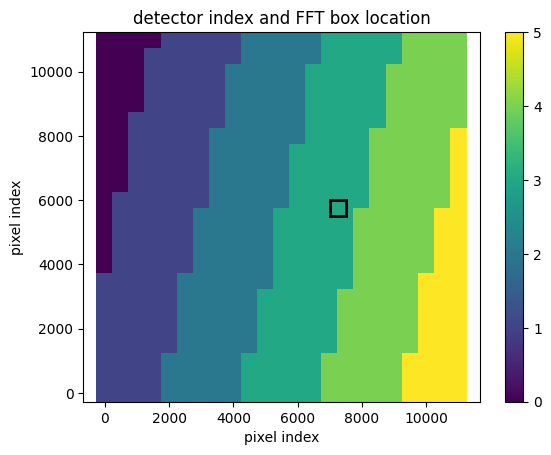

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947777013080478
(31, 31)
(31, 31)
(31, 31)


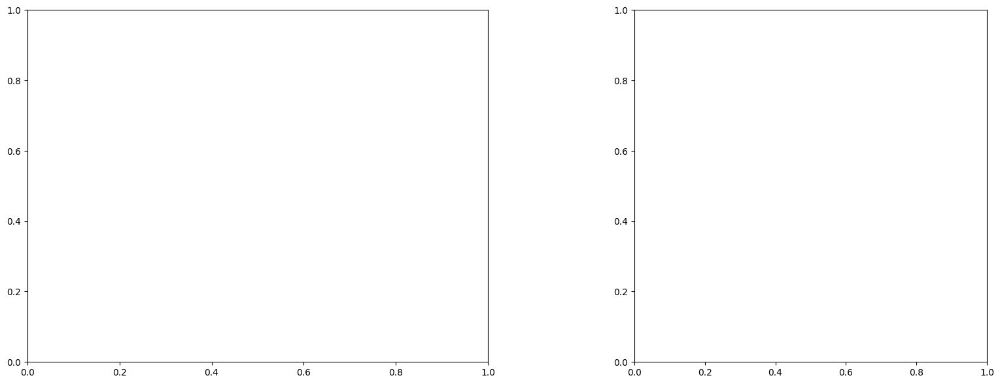

U and V components of current : [1.03000808 0.91881666]
uncertainties for U and V: 0.07114090527739372 0.08333935051775654


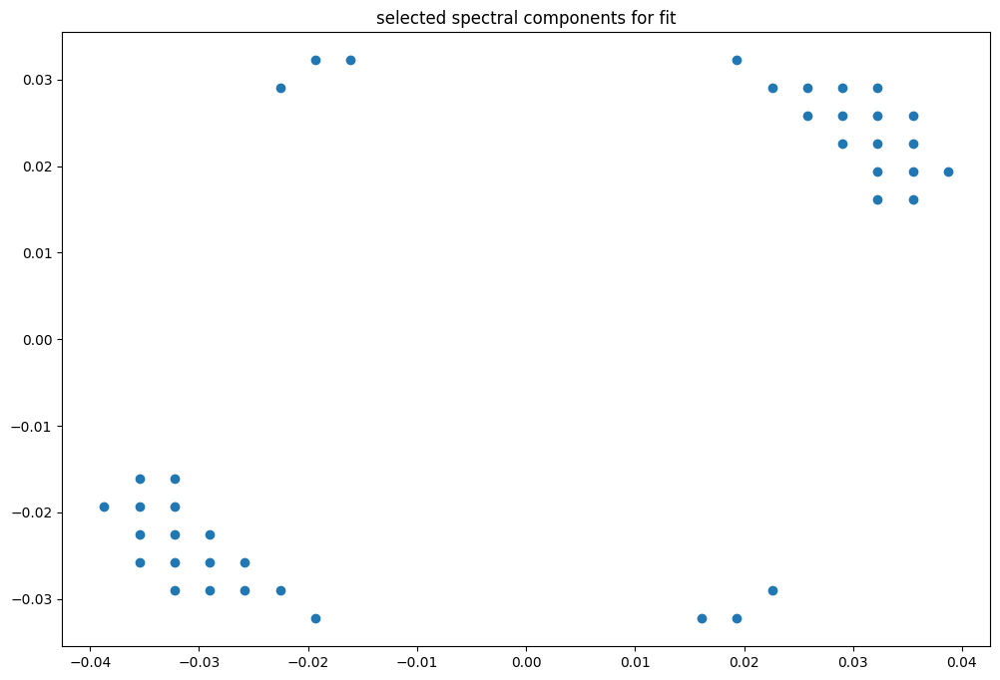

box [7000, 7500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

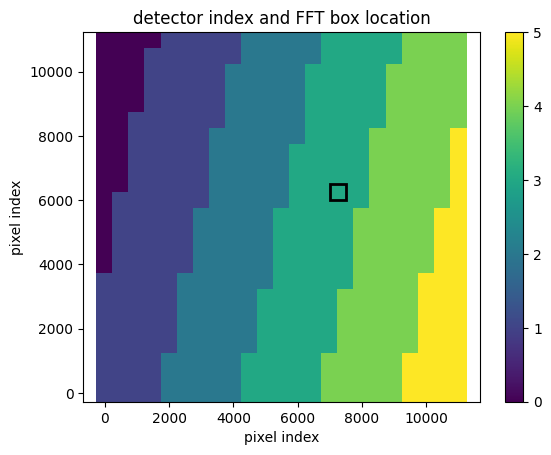

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947748237480838
(31, 31)
(31, 31)
(31, 31)


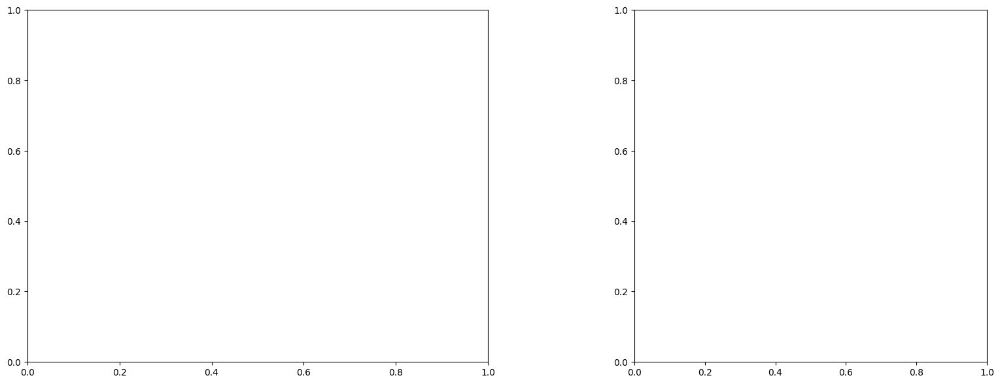

U and V components of current : [0.87940232 1.22377723]
uncertainties for U and V: 0.06011204698046206 0.04967346723722475


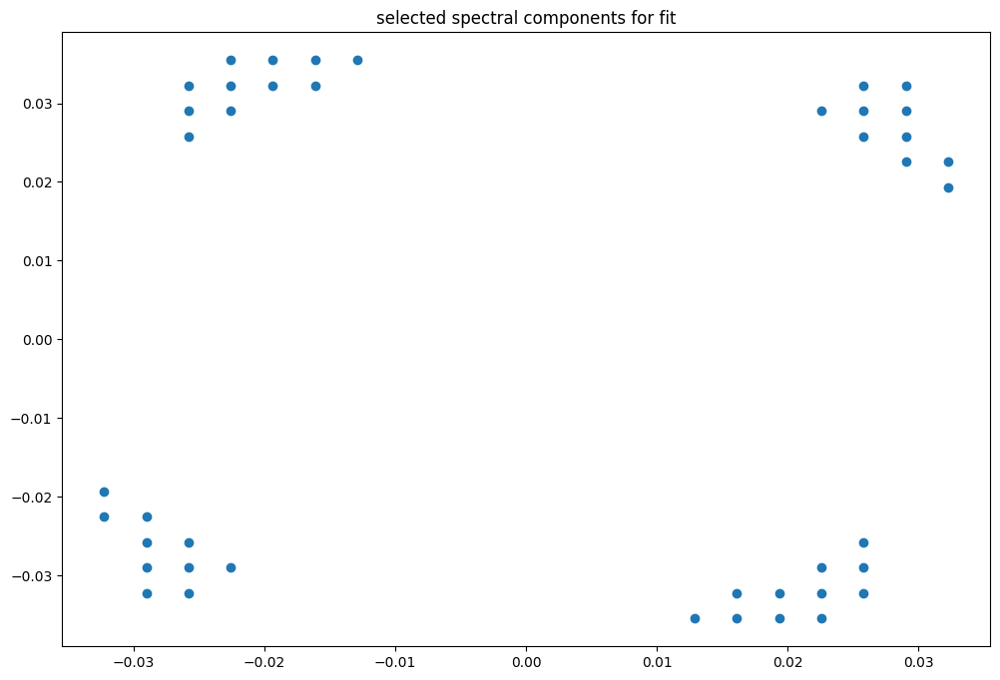

box [7000, 7500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

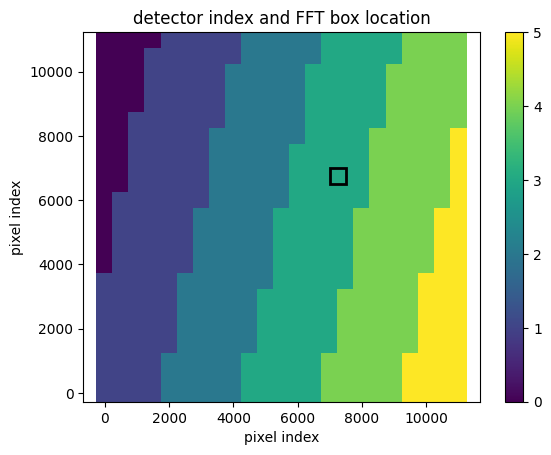

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


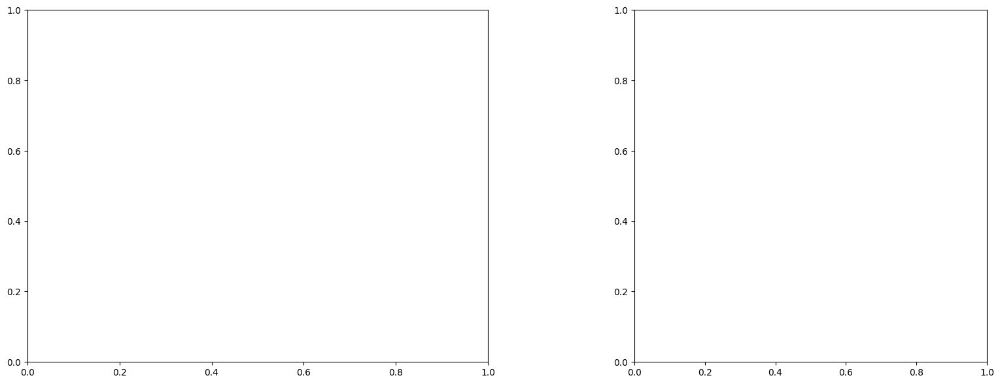

U and V components of current : [0.74627695 0.89748174]
uncertainties for U and V: 0.14824217200092657 0.10188919314326286


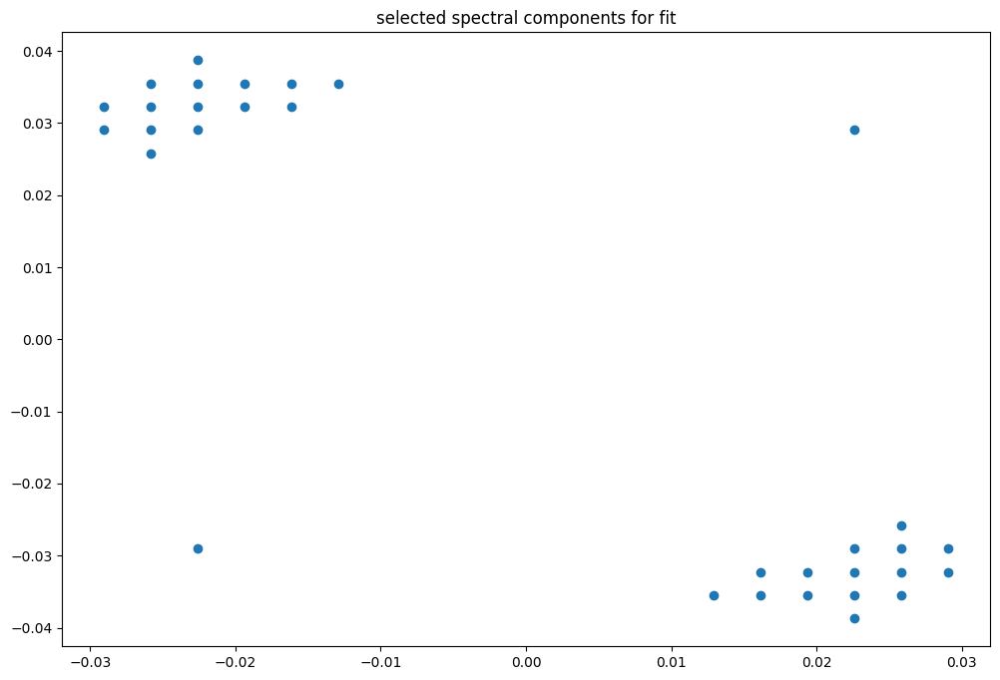

box [7000, 7500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

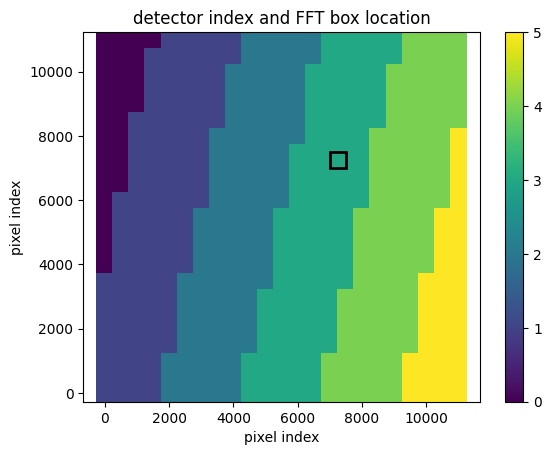

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


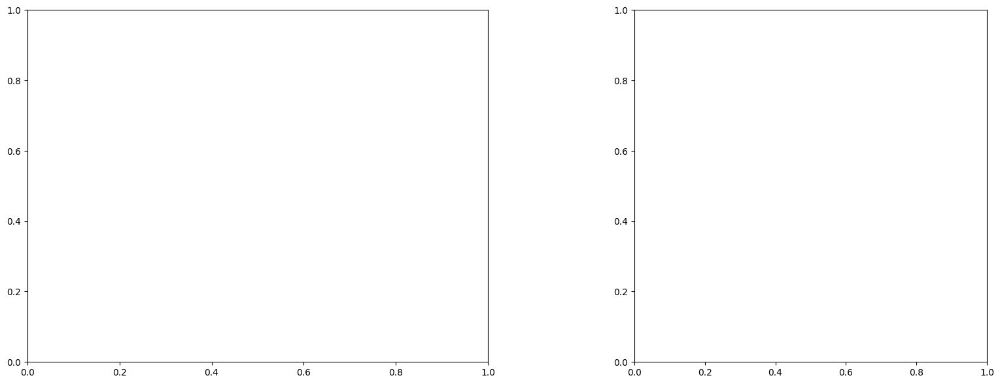

U and V components of current : [0.6613331  0.76873728]
uncertainties for U and V: 0.07362617351079738 0.05886622786790607


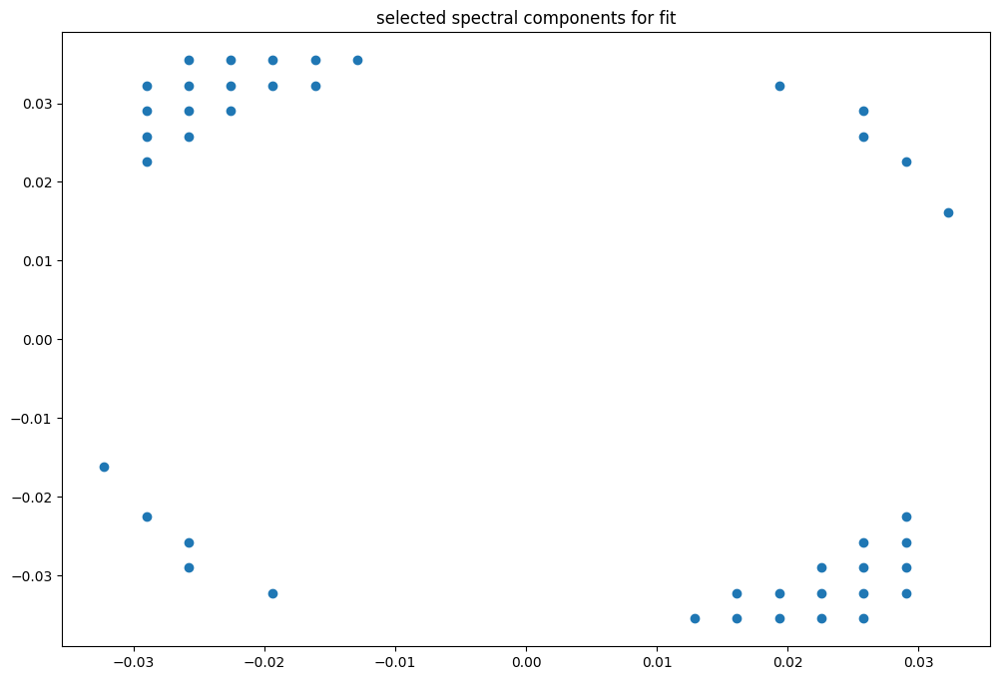

box [7000, 7500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

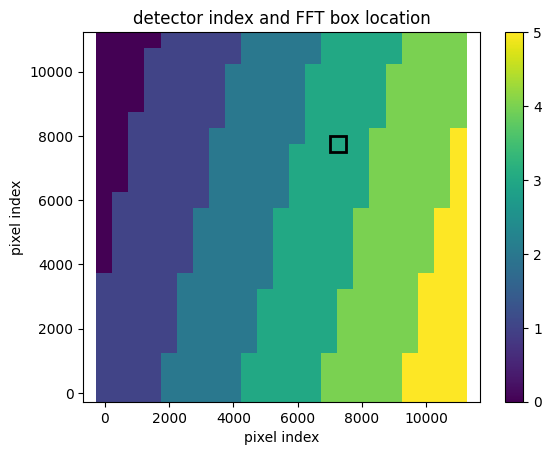

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


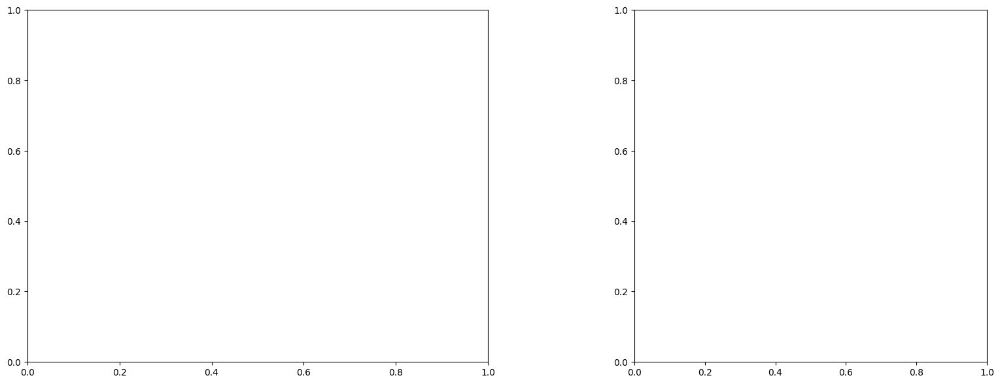

U and V components of current : [0.71364699 0.50958358]
uncertainties for U and V: 0.05604953879373602 0.050236041557236356


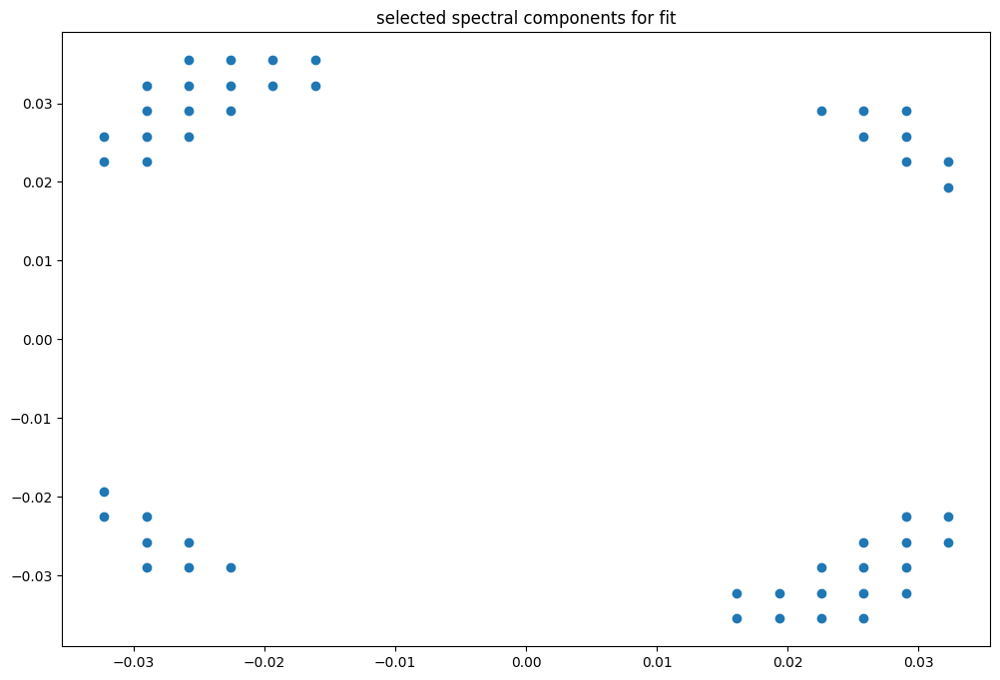

box [7000, 7500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

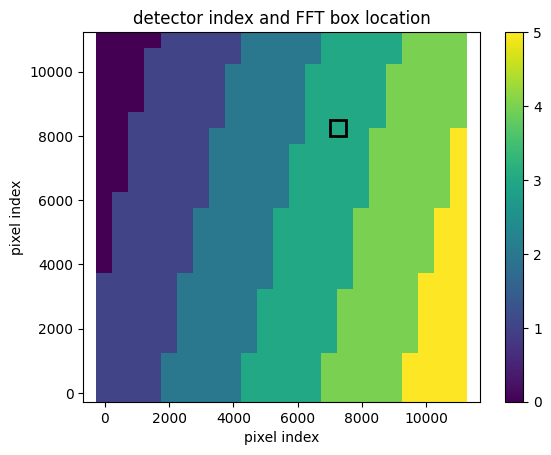

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947659149529672
(31, 31)
(31, 31)
(31, 31)


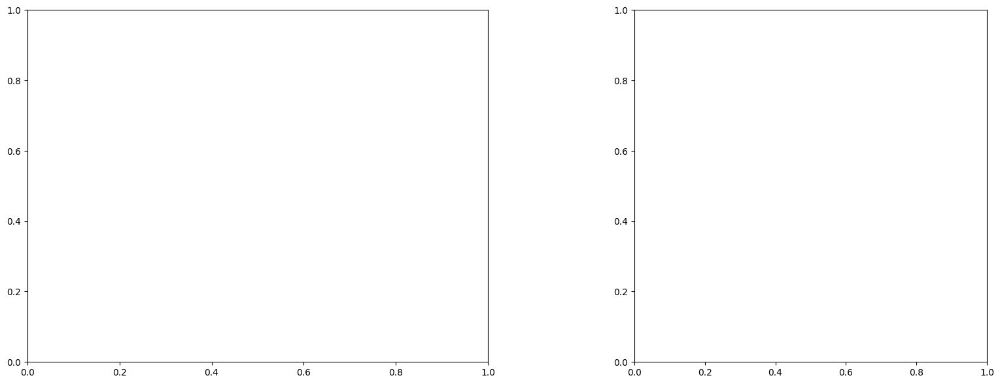

U and V components of current : [0.89529487 0.60784656]
uncertainties for U and V: 0.0497344864408066 0.0419837074201784


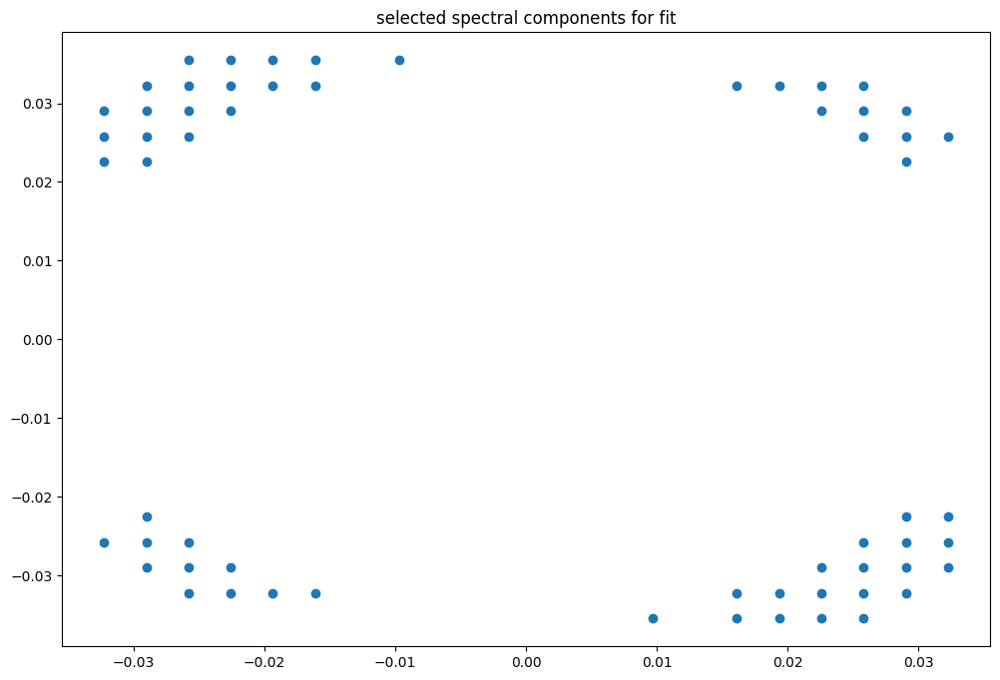

box [7000, 7500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

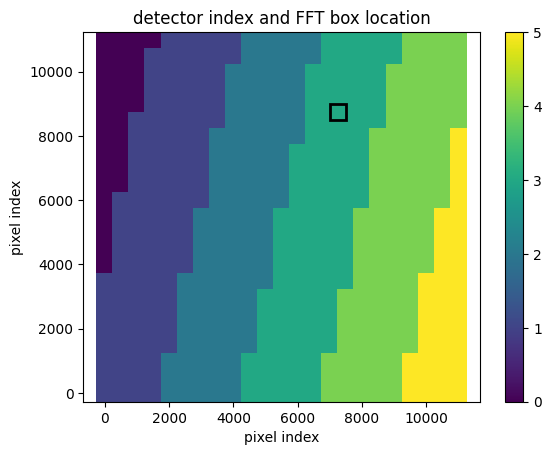

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


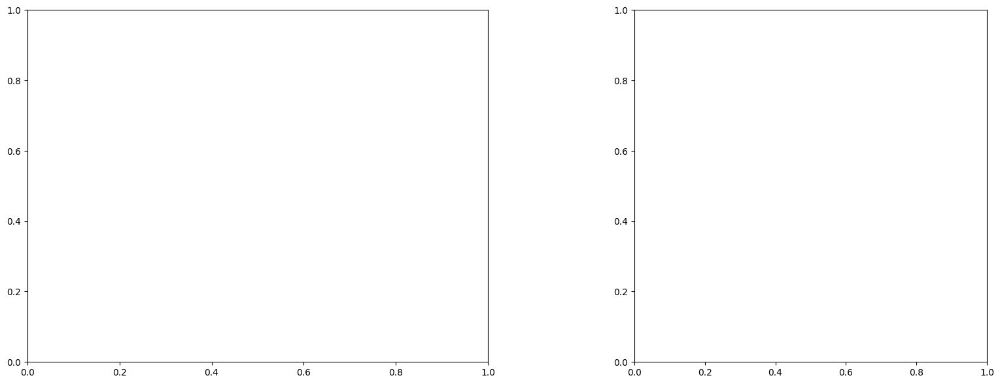

U and V components of current : [1.04039647 0.91131103]
uncertainties for U and V: 0.05360523381314138 0.04462879679309485


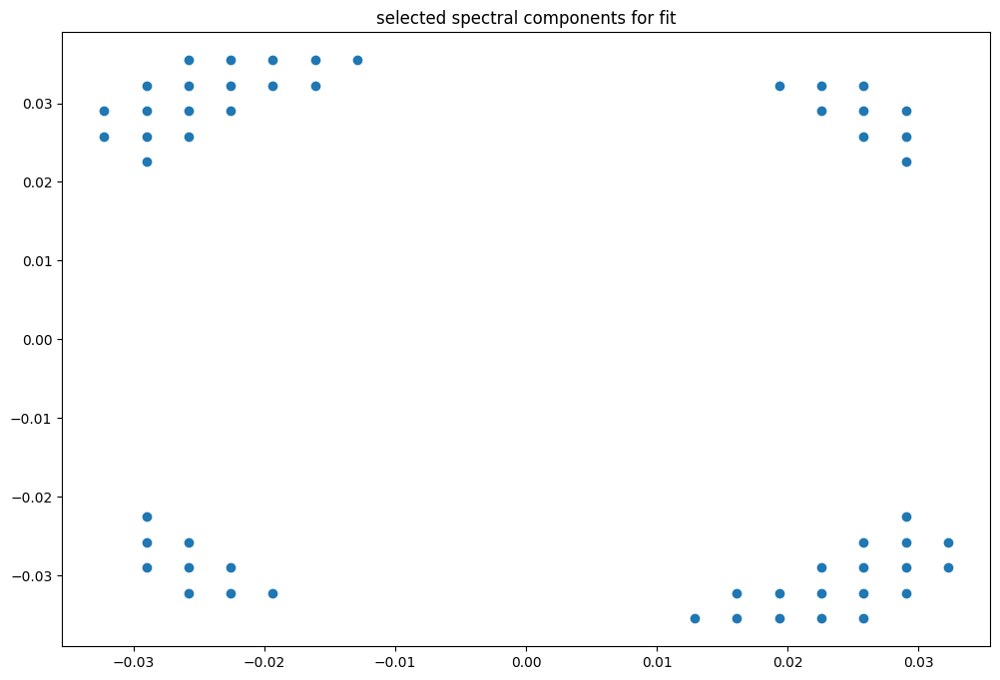

box [7000, 7500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

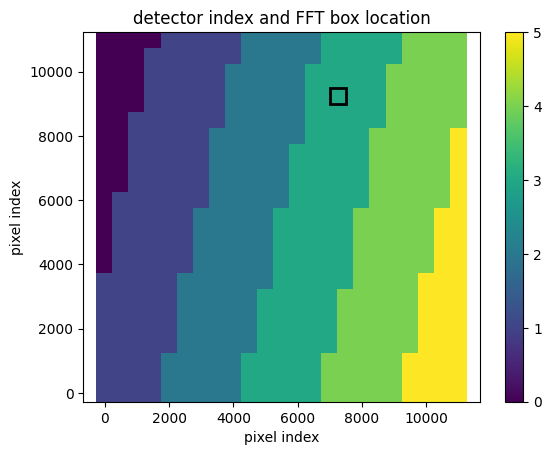

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


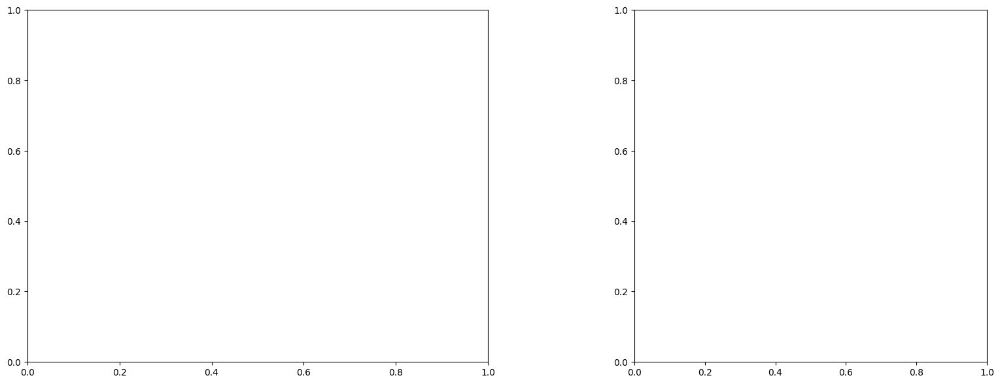

U and V components of current : [1.0163797  0.81191307]
uncertainties for U and V: 0.12696331326991334 0.10463521894897898


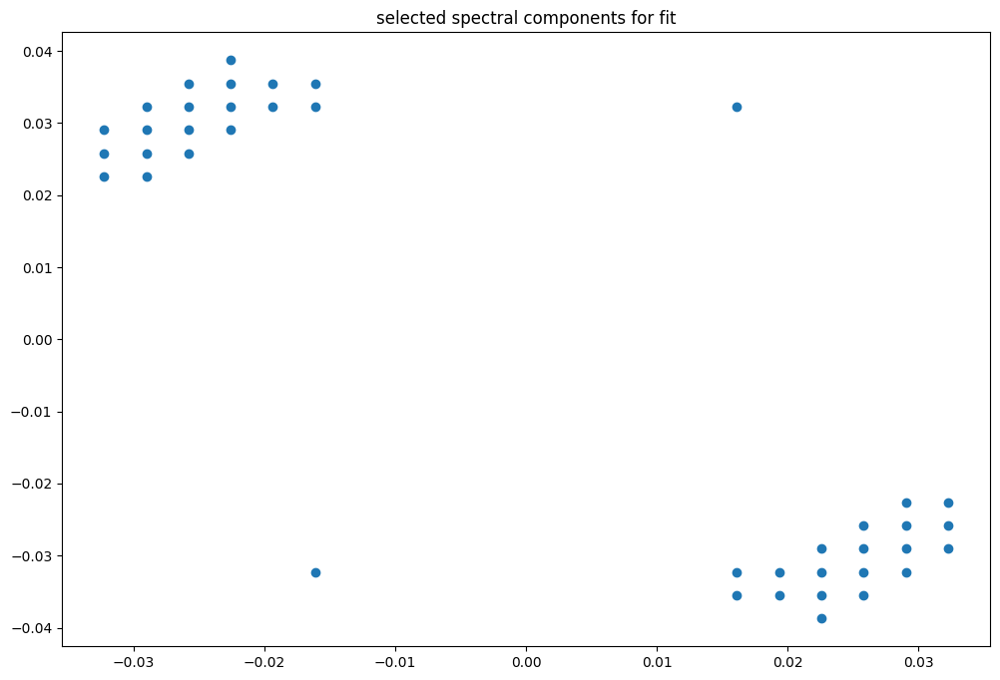

box [7000, 7500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

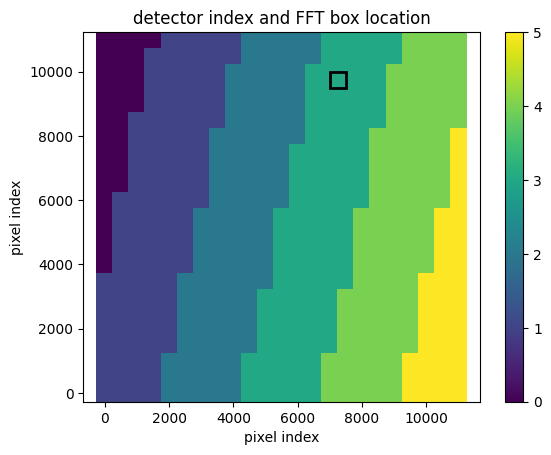

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947599942259363
(31, 31)
(31, 31)
(31, 31)


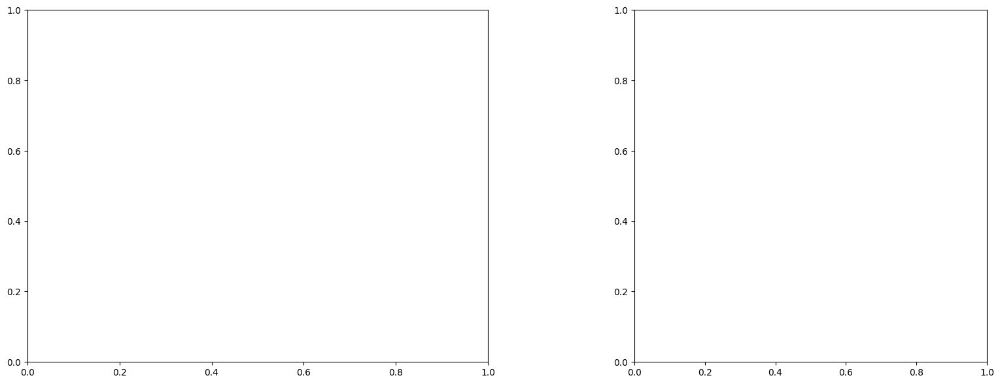

U and V components of current : [0.52708472 0.28559166]
uncertainties for U and V: 0.18740516302630914 0.15055678413555923


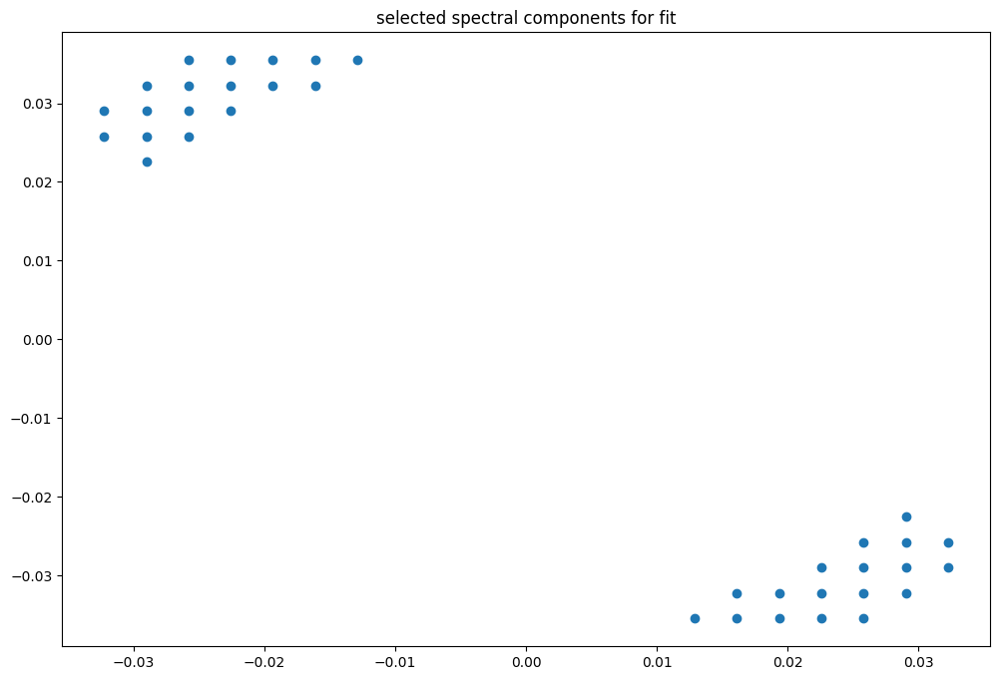

box [7000, 7500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

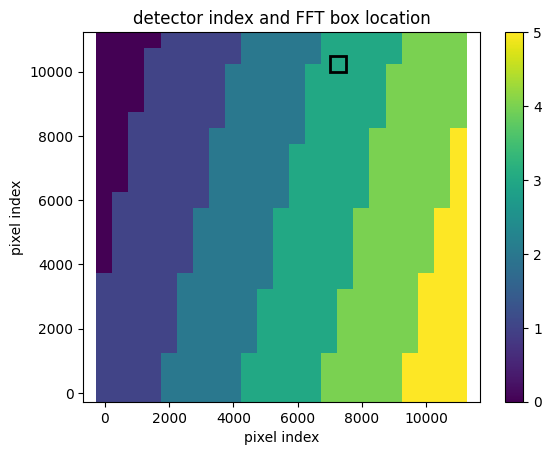

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(31, 31)
(31, 31)
(31, 31)


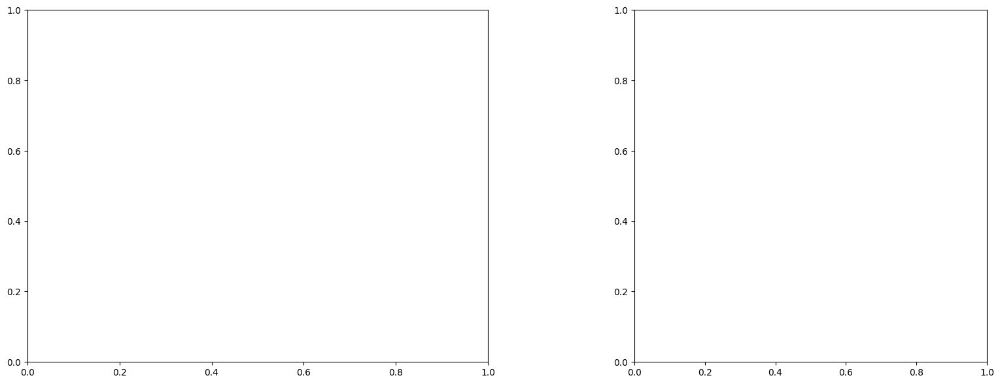

U and V components of current : [0.61681061 0.2612173 ]
uncertainties for U and V: 0.17678391029692994 0.14473834118676374


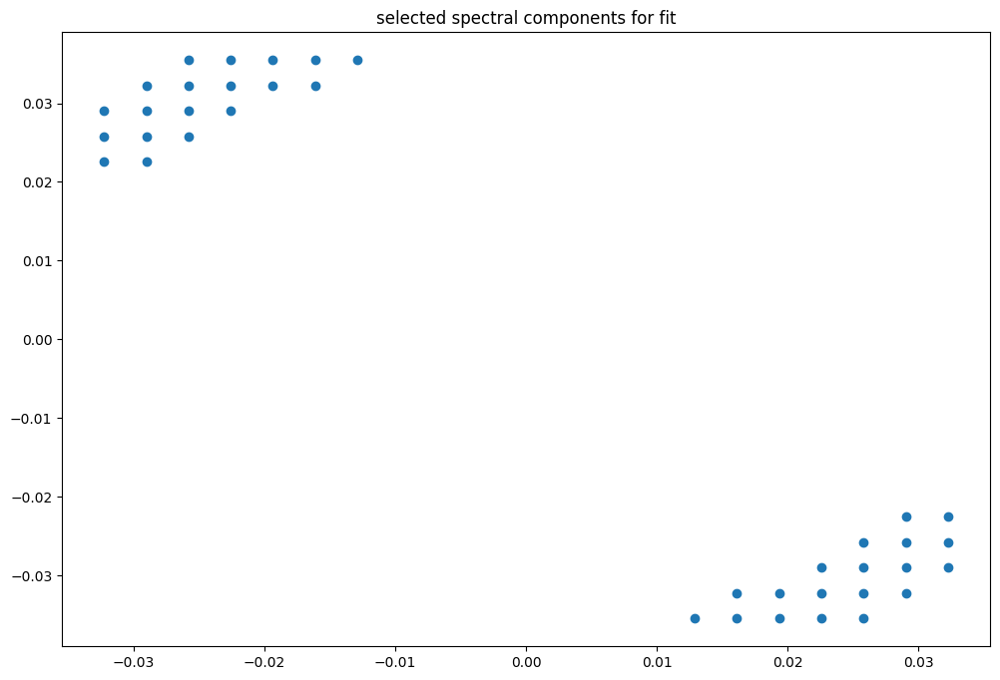

box [7000, 7500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

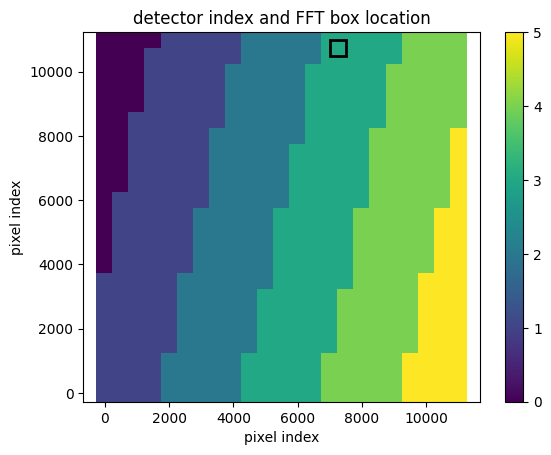

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(31, 30)
(31, 30)
(31, 30)


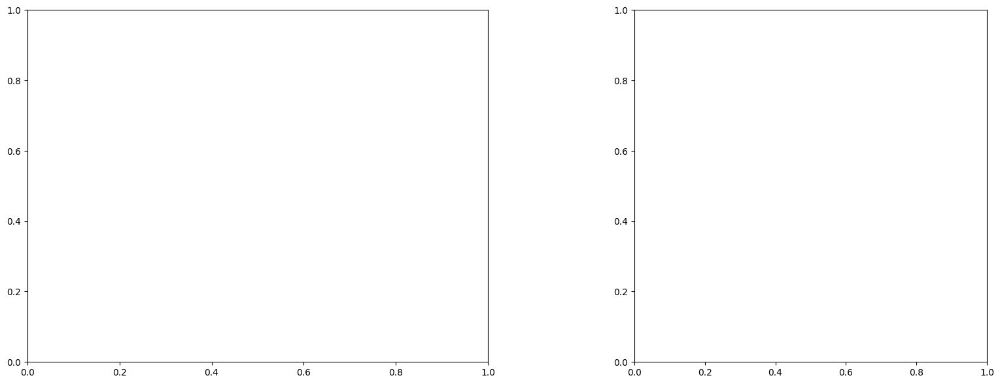

U and V components of current : [0.70995586 0.34286428]
uncertainties for U and V: 0.1687921448609984 0.1446645500182425


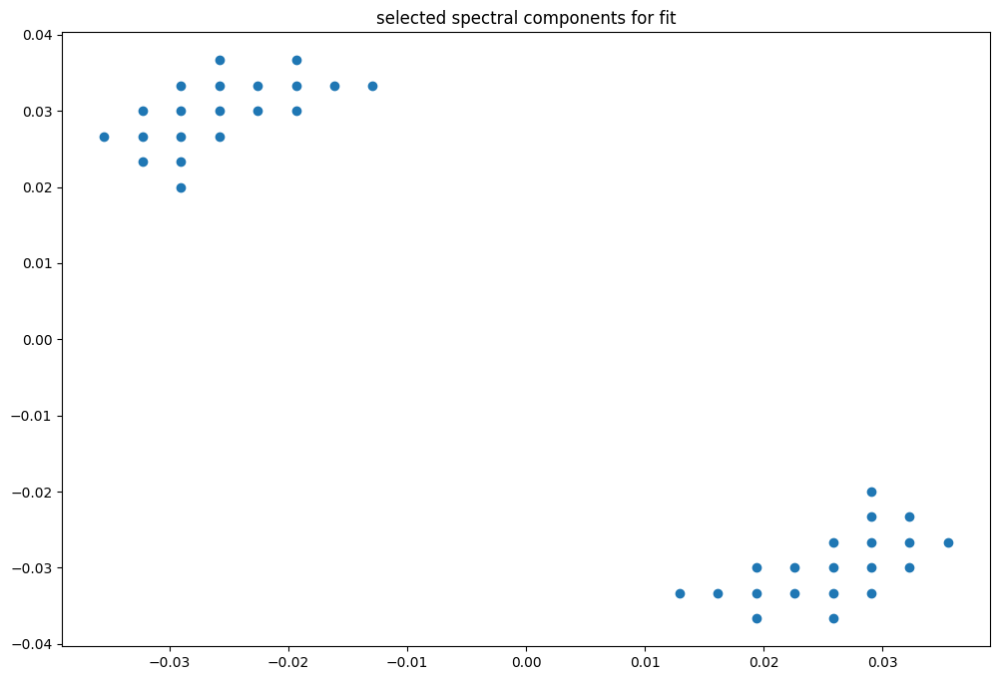

box [7500, 8000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

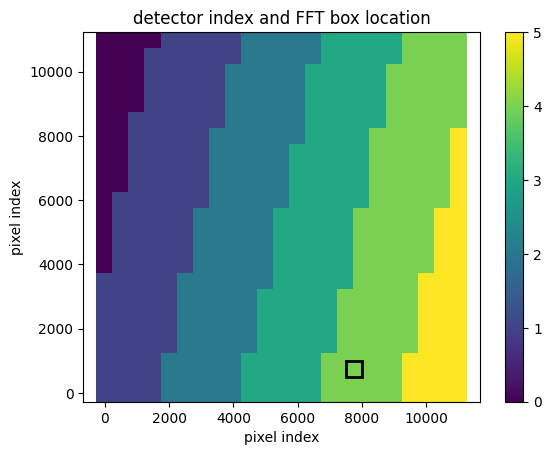

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987391765727964
(31, 31)
(31, 31)
(31, 31)


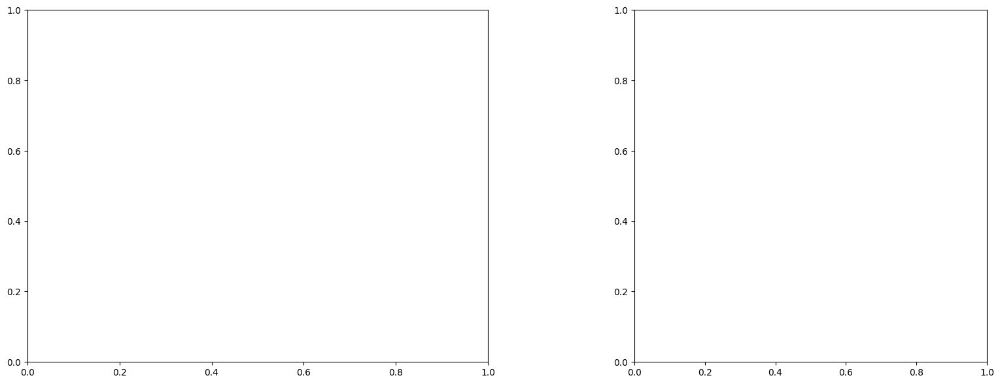

U and V components of current : [0.32573046 1.30518373]
uncertainties for U and V: 0.09402195100650786 0.15258805190429559


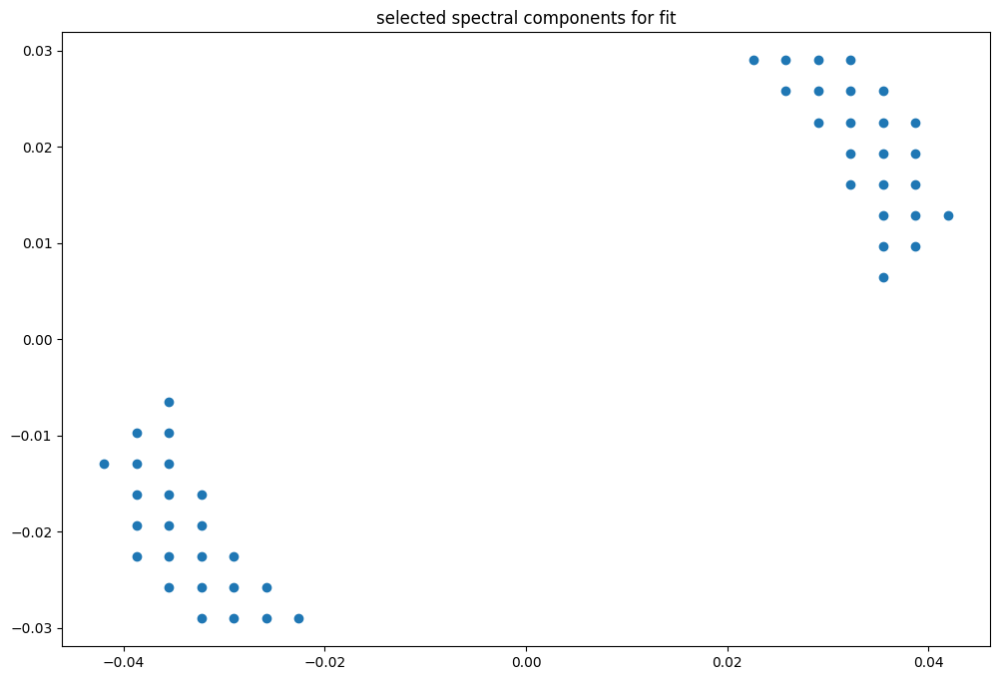

box [7500, 8000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

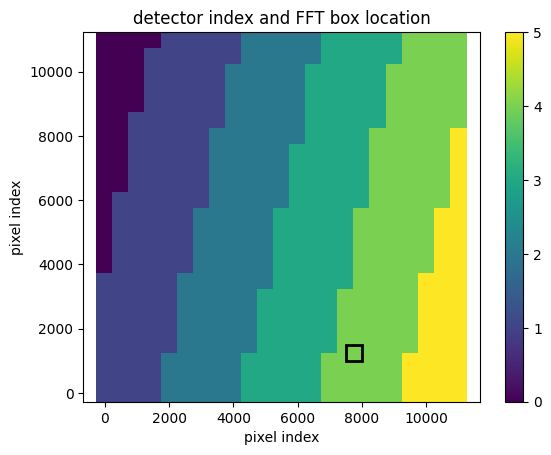

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


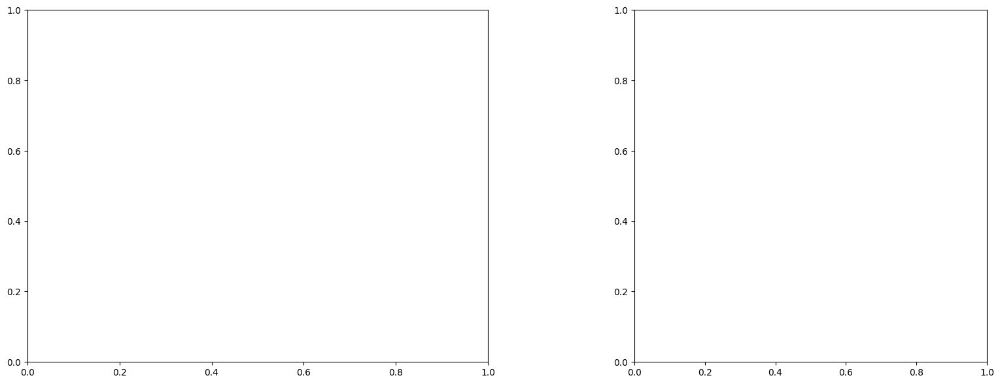

U and V components of current : [0.36784277 1.4590535 ]
uncertainties for U and V: 0.06883208923605616 0.12316407406912872


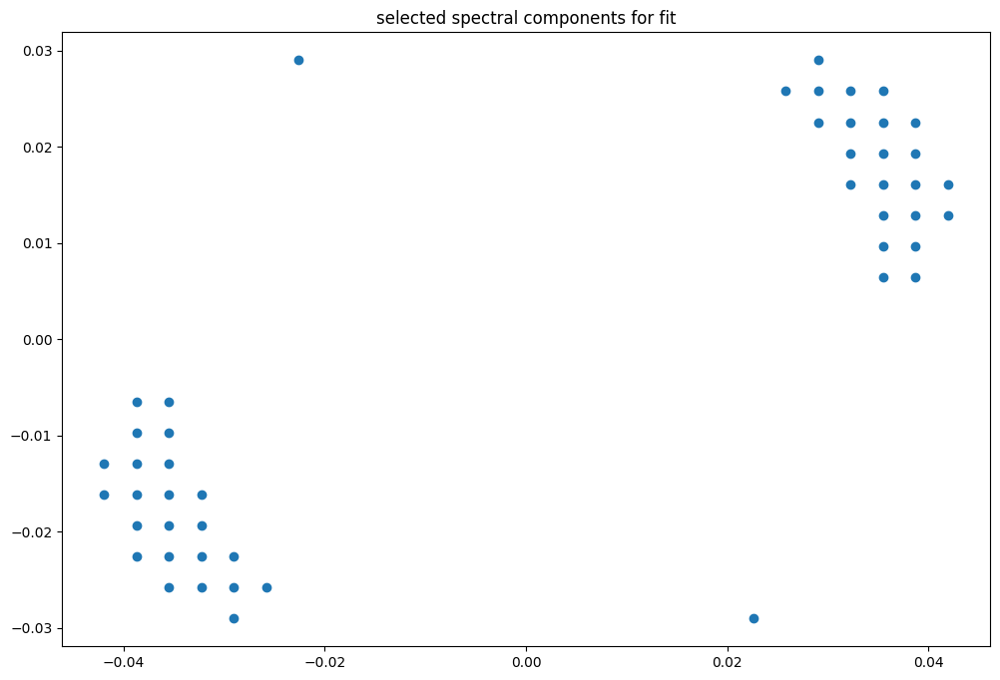

box [7500, 8000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

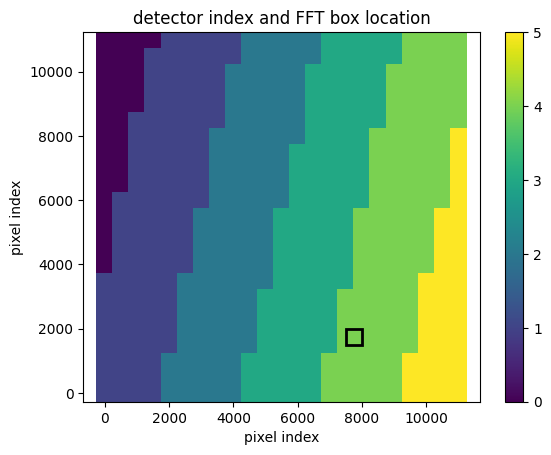

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


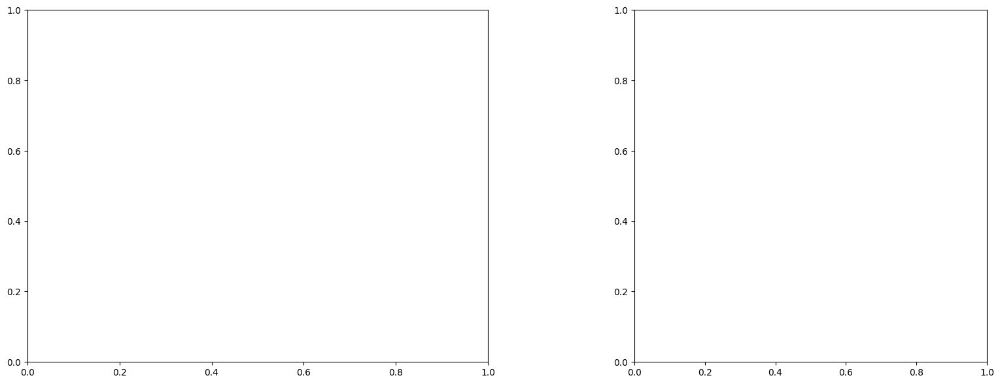

U and V components of current : [0.54464459 1.27119564]
uncertainties for U and V: 0.09350892512347787 0.1546749539017372


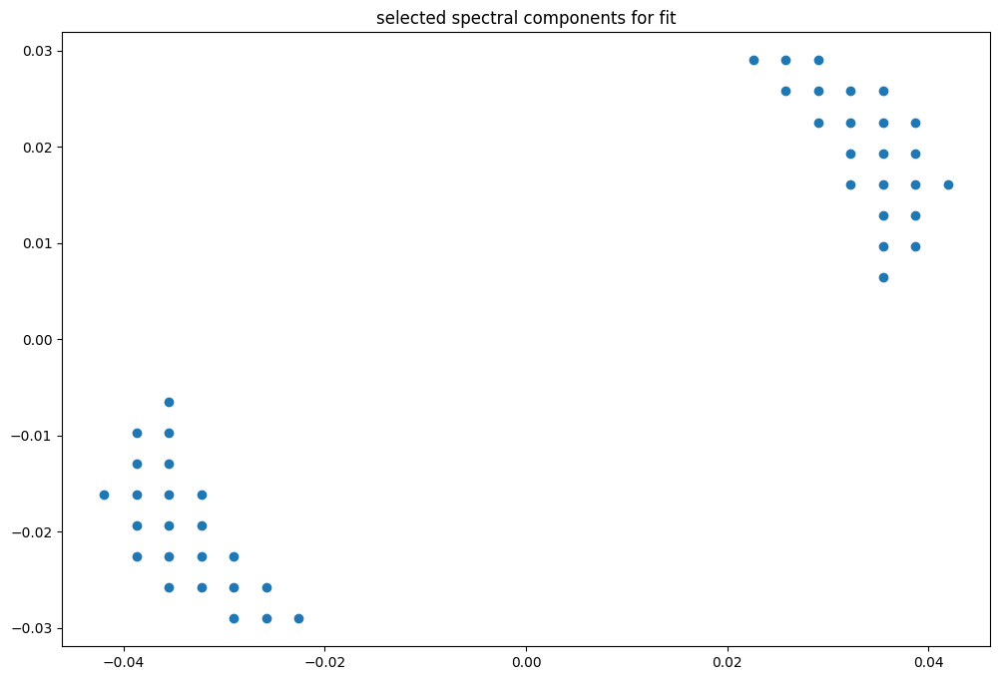

box [7500, 8000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

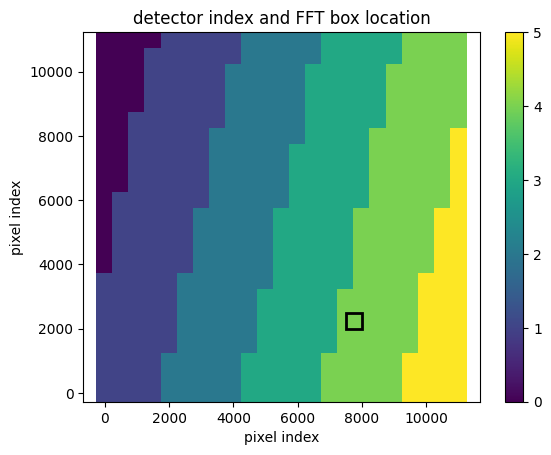

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


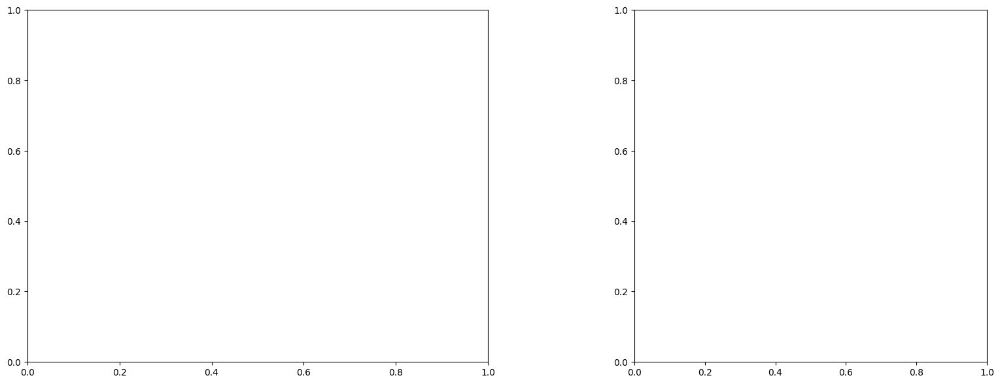

U and V components of current : [0.59015693 1.38803222]
uncertainties for U and V: 0.0706849771703108 0.11494241174941239


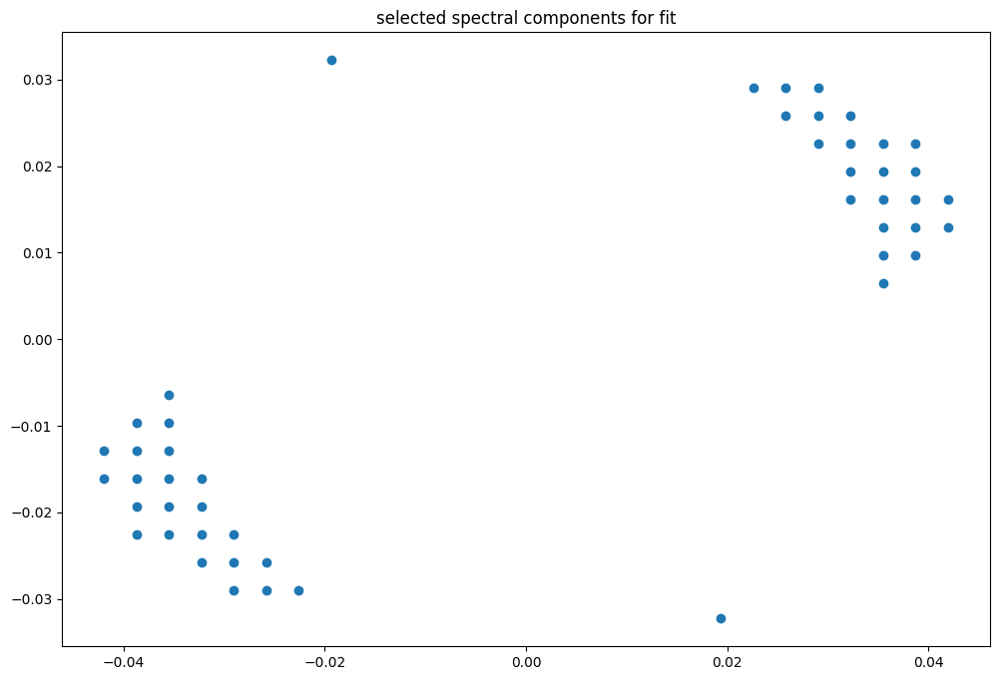

box [7500, 8000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

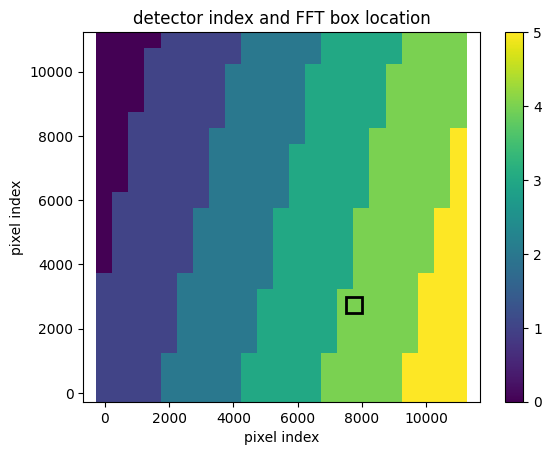

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


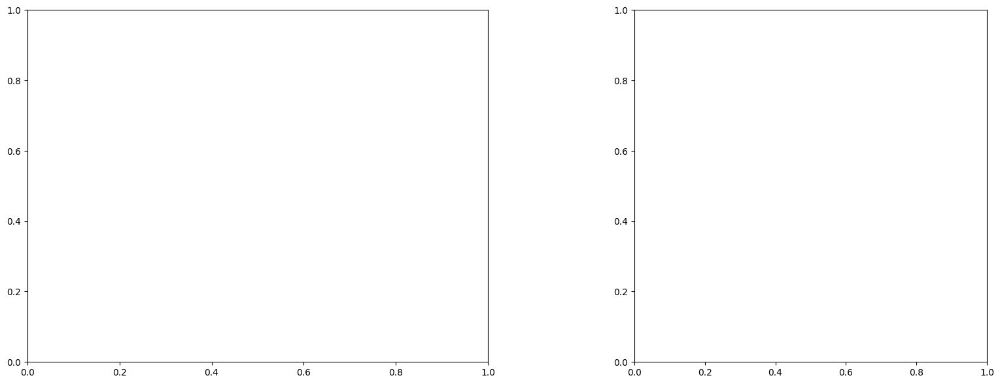

U and V components of current : [0.26464734 1.60966141]
uncertainties for U and V: 0.09965536221601408 0.15906054833674943


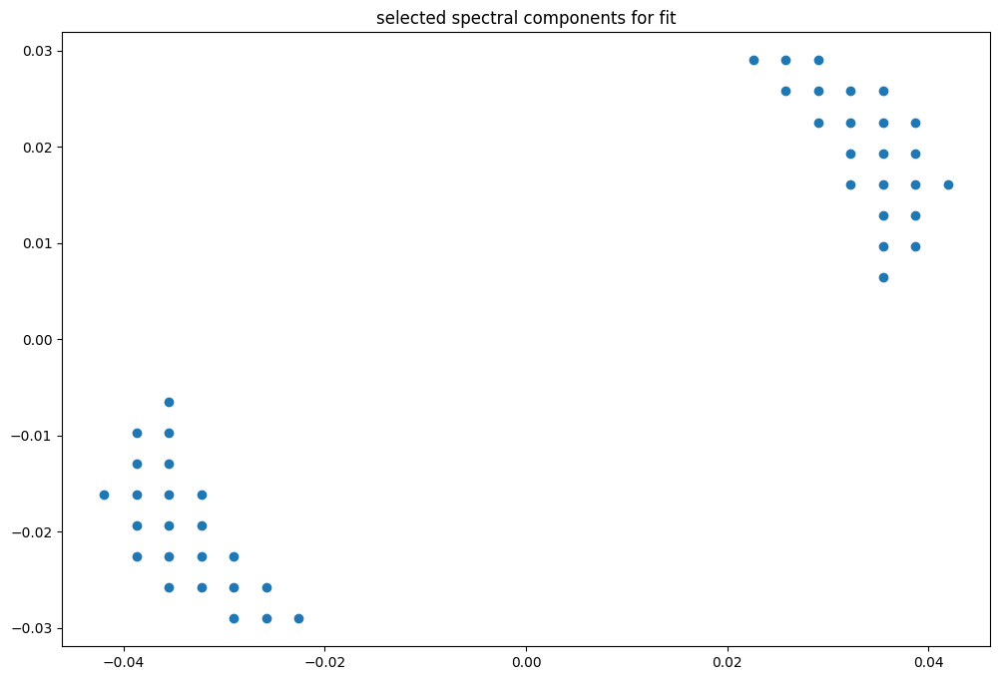

box [7500, 8000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

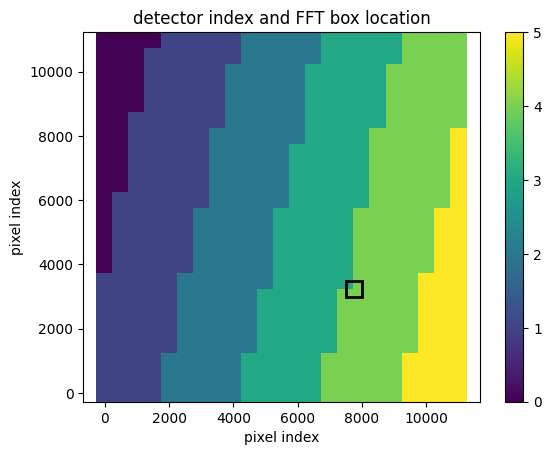

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.96
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


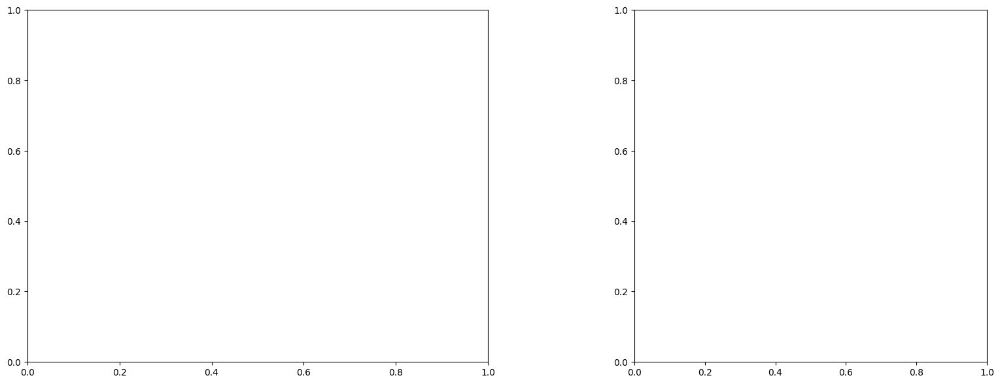

U and V components of current : [0.57054709 1.41819161]
uncertainties for U and V: 0.23199327699289854 0.36375431906075895


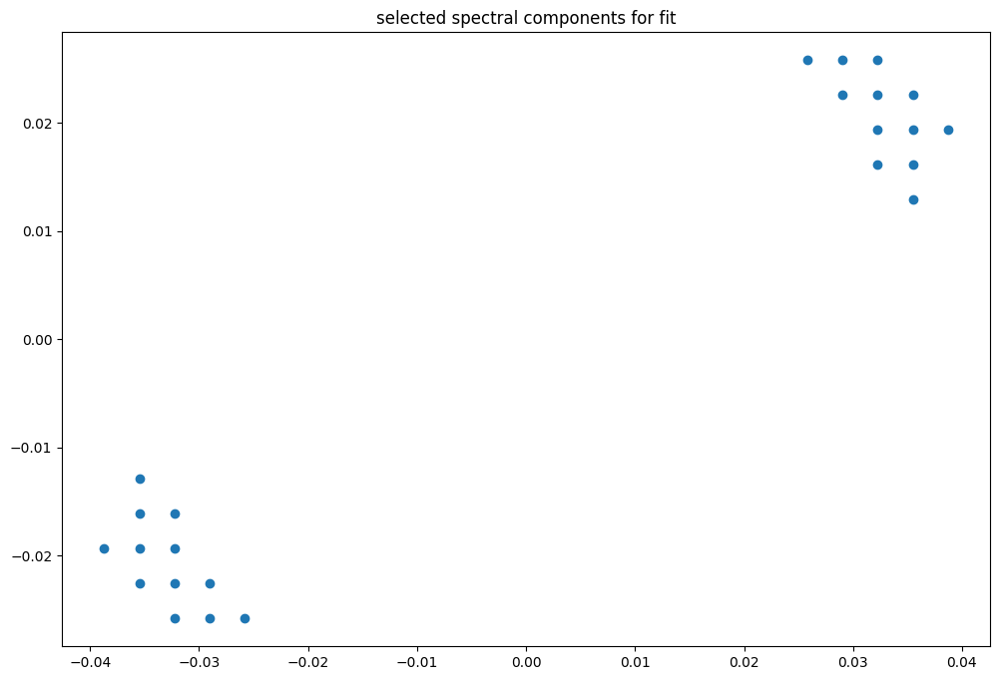

box [7500, 8000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

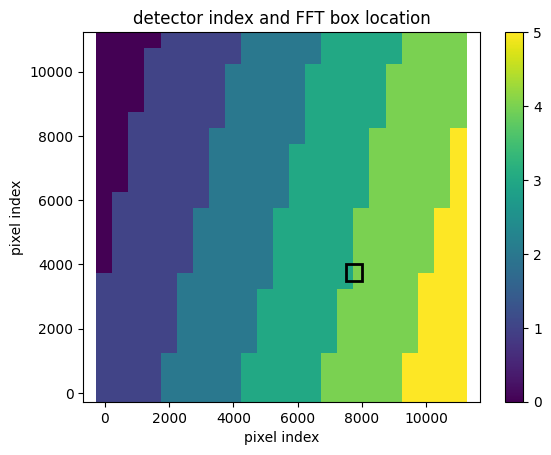

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


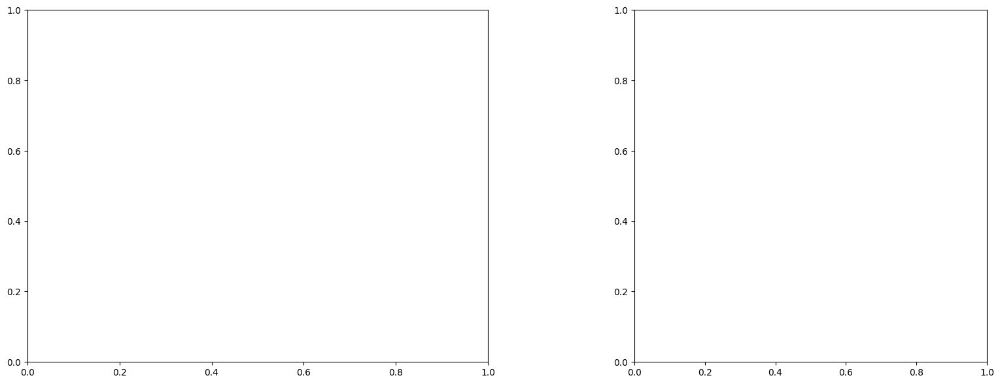

LinAlgError: Singular matrix

box [7500, 8000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

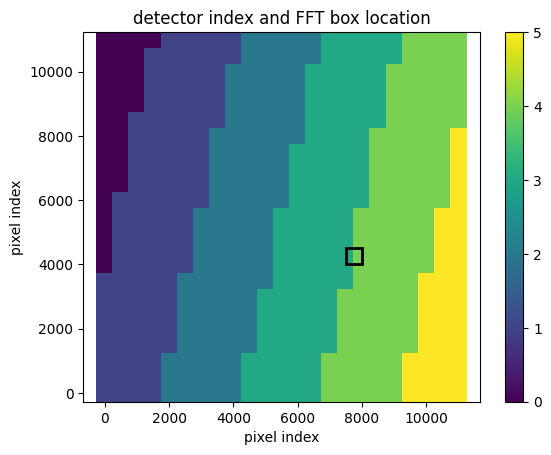

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


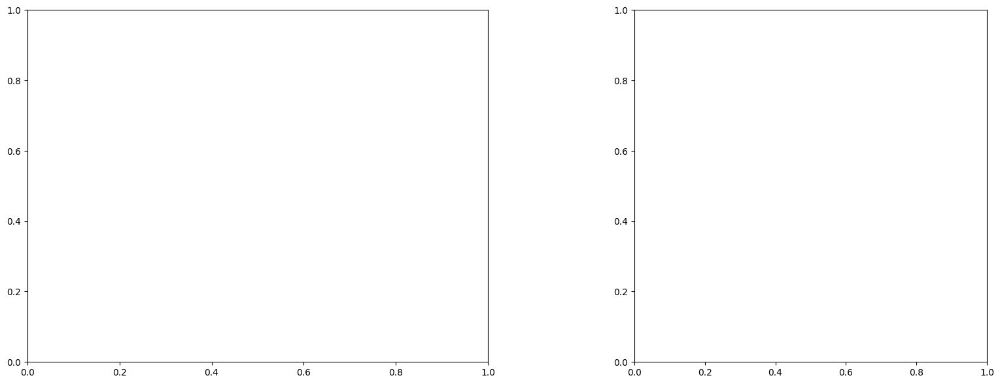

LinAlgError: Singular matrix

box [7500, 8000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

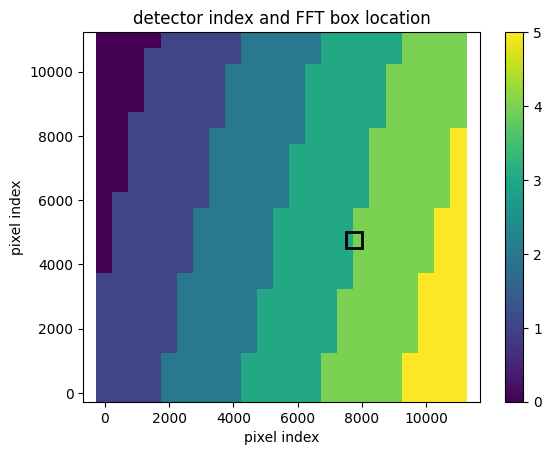

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


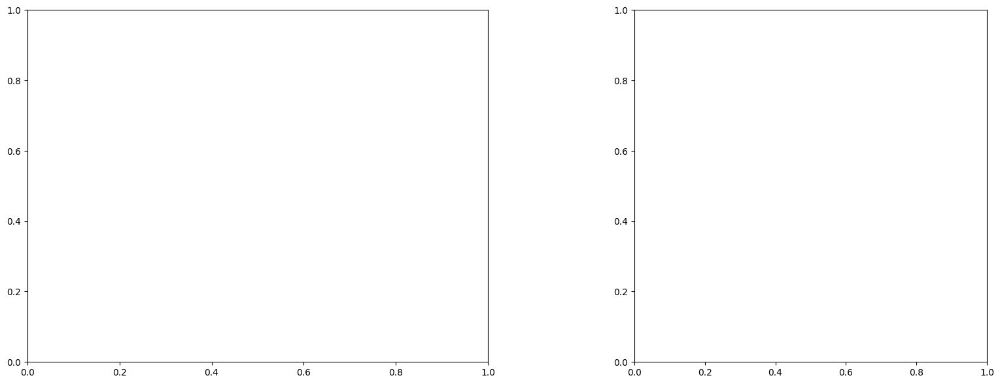

LinAlgError: Singular matrix

box [7500, 8000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

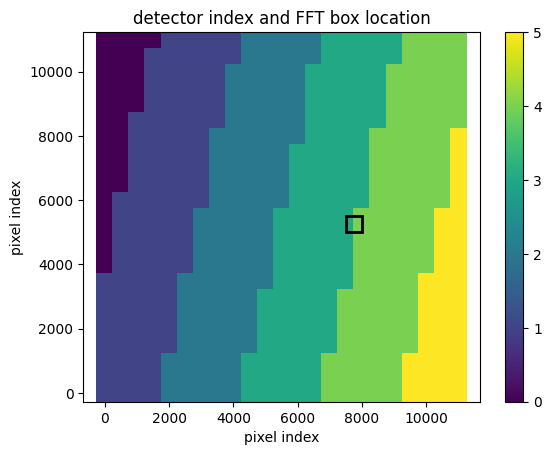

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


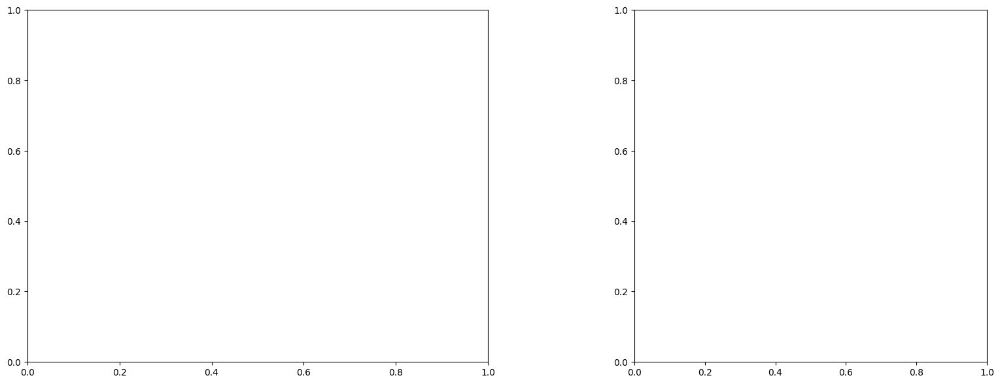

U and V components of current : [-0.93911759 -1.59643032]
uncertainties for U and V: 0.2755213016904821 0.3866825477133663


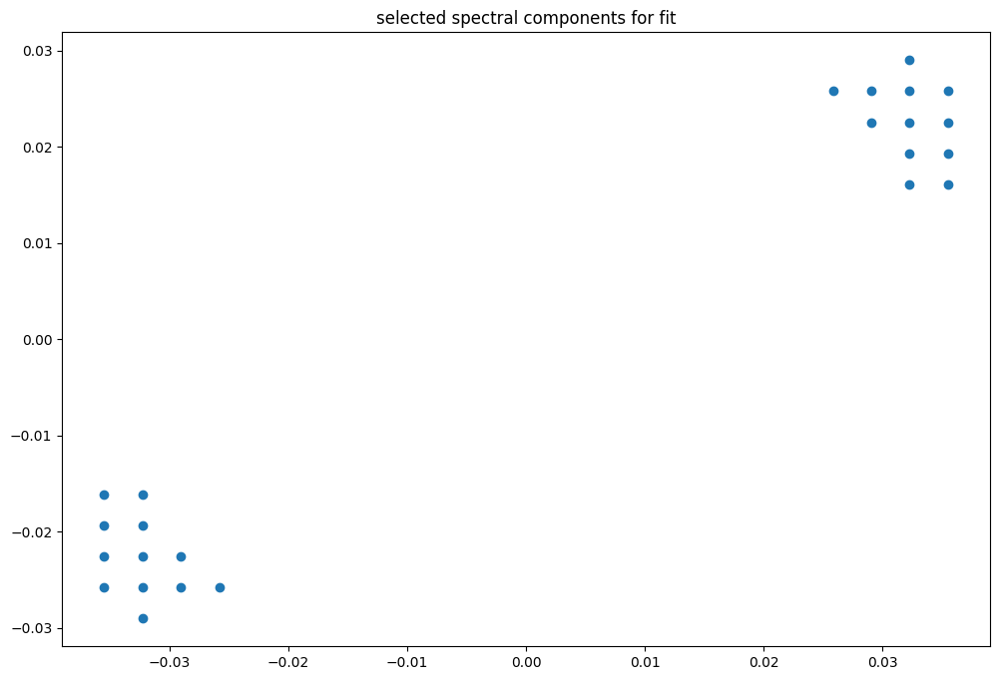

box [7500, 8000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

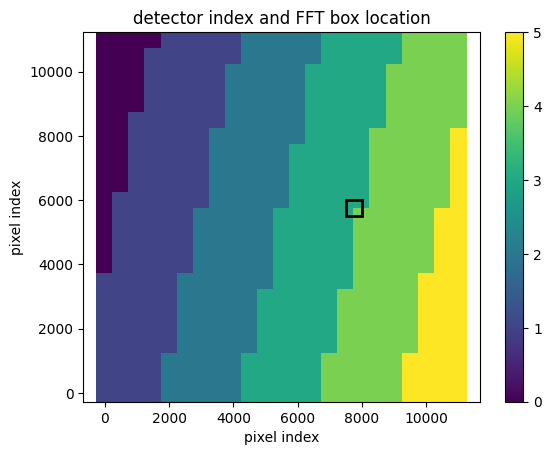

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947748237480838
(31, 31)
(31, 31)
(31, 31)


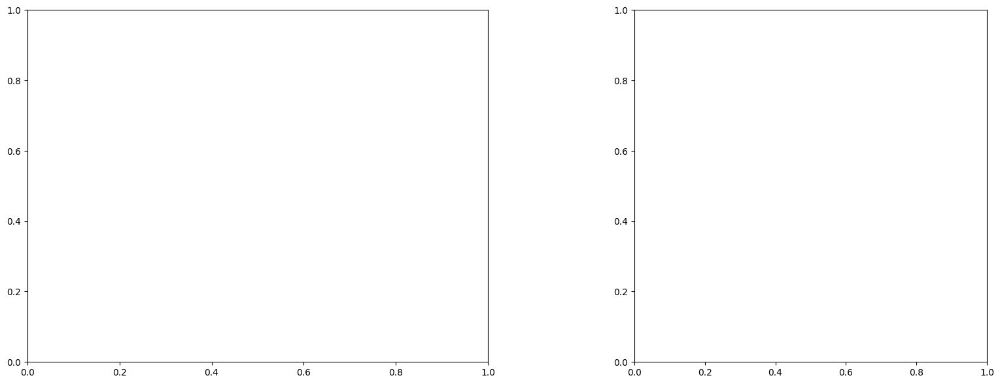

U and V components of current : [0.92121128 1.2639557 ]
uncertainties for U and V: 0.08059469660032154 0.0936553704033469


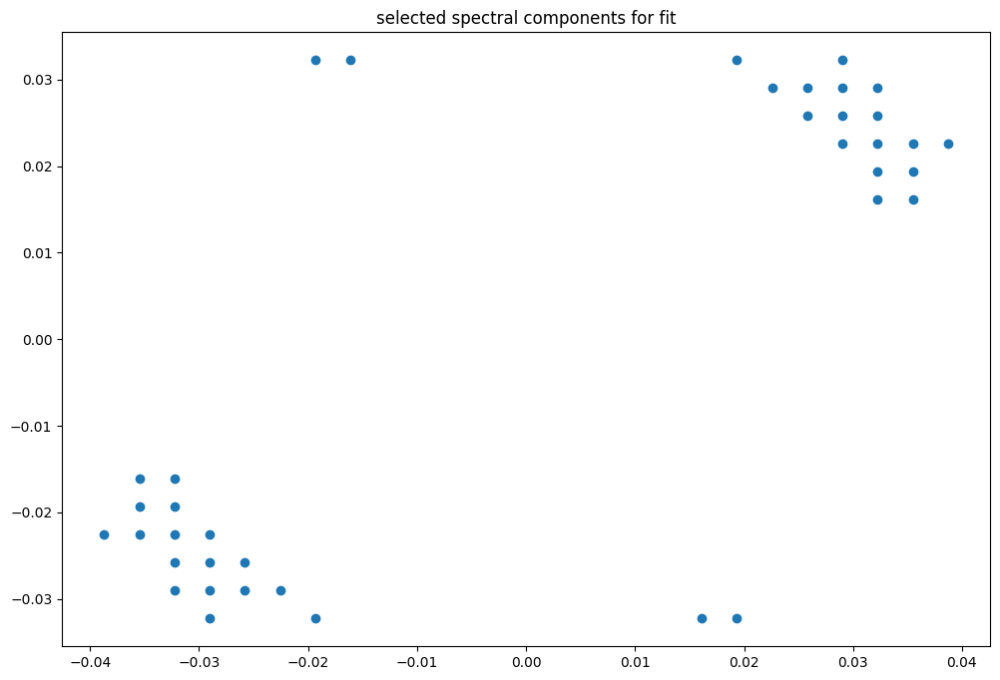

box [7500, 8000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

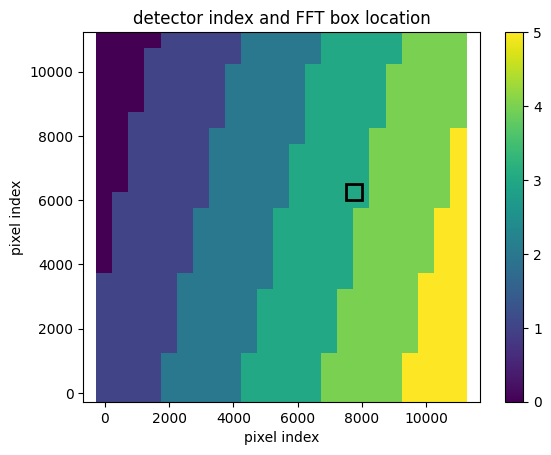

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947748237480838
(31, 31)
(31, 31)
(31, 31)


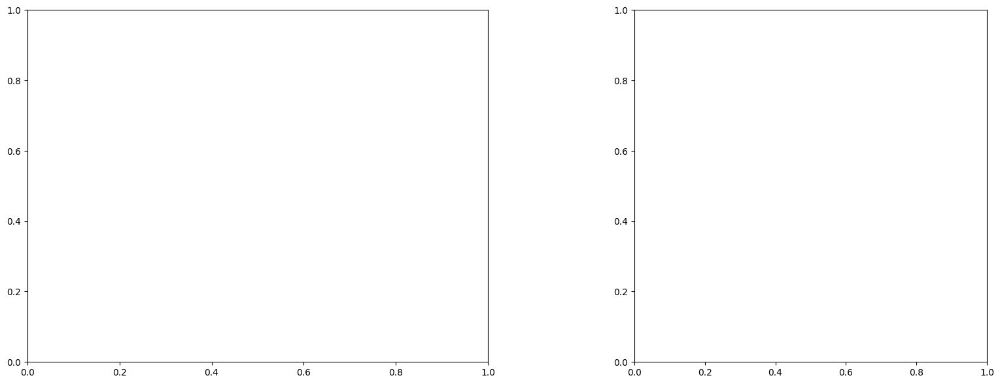

U and V components of current : [1.02685044 1.39186473]
uncertainties for U and V: 0.052438259797136344 0.05768255830435325


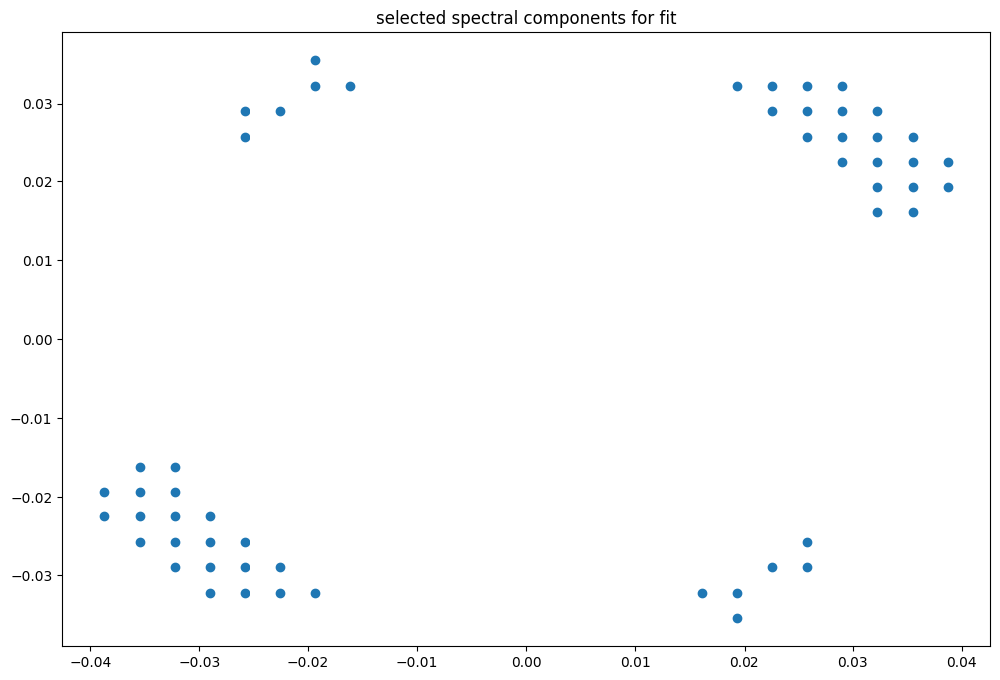

box [7500, 8000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

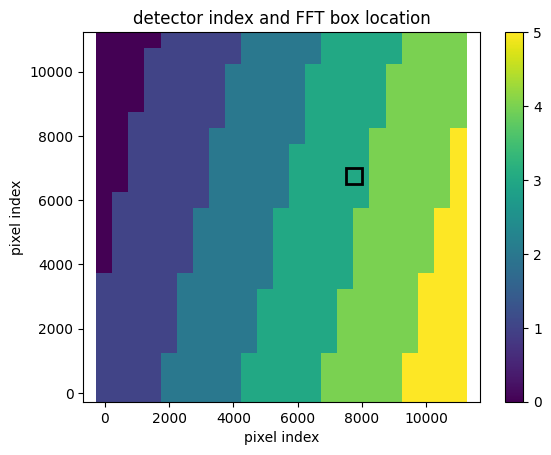

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947716311859437
(31, 31)
(31, 31)
(31, 31)


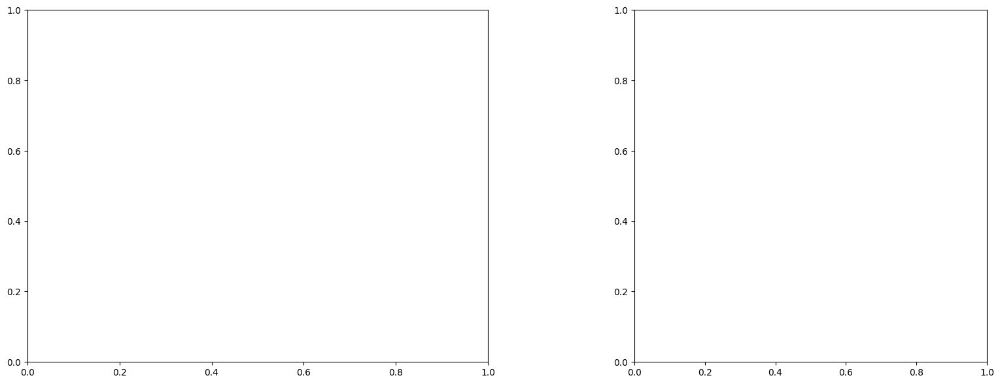

U and V components of current : [0.97923944 1.25649957]
uncertainties for U and V: 0.057376725480374674 0.05054370898784589


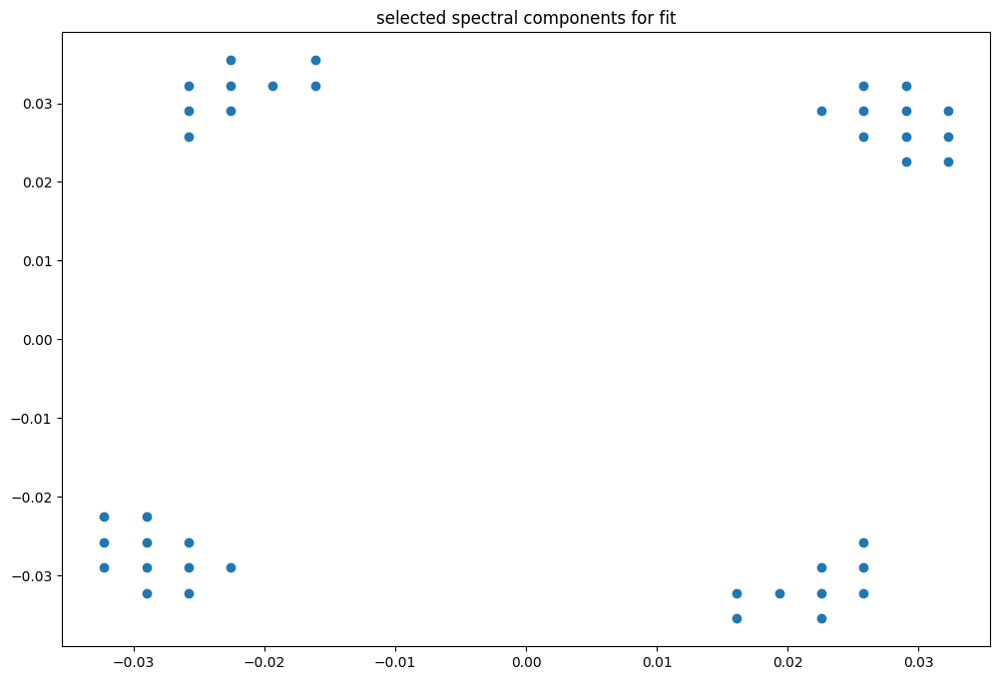

box [7500, 8000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

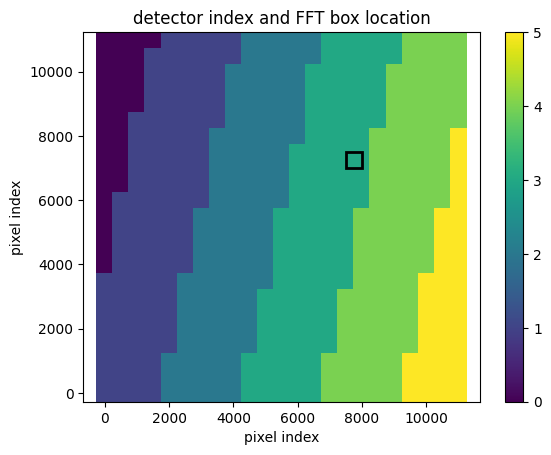

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


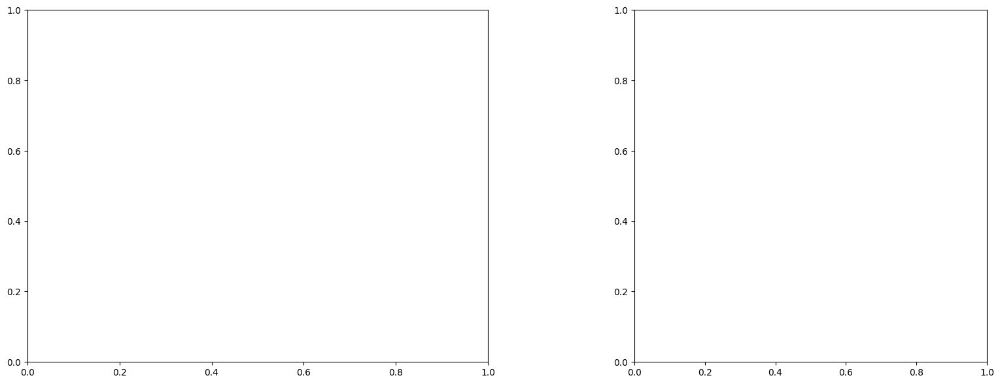

U and V components of current : [1.006012   1.16923319]
uncertainties for U and V: 0.09274045200092385 0.06835551544119843


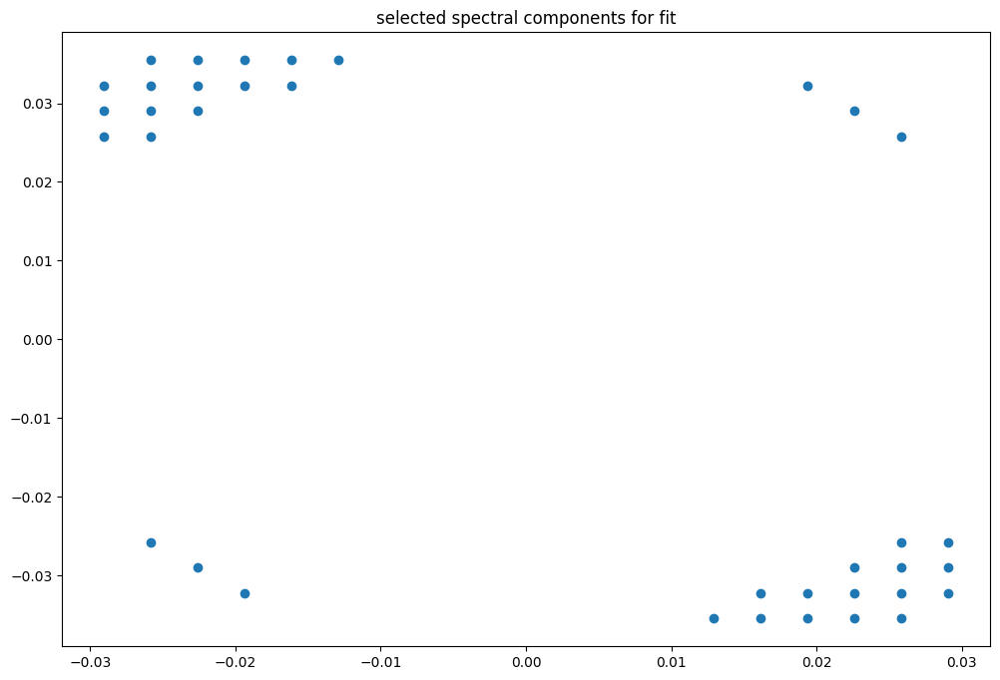

box [7500, 8000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

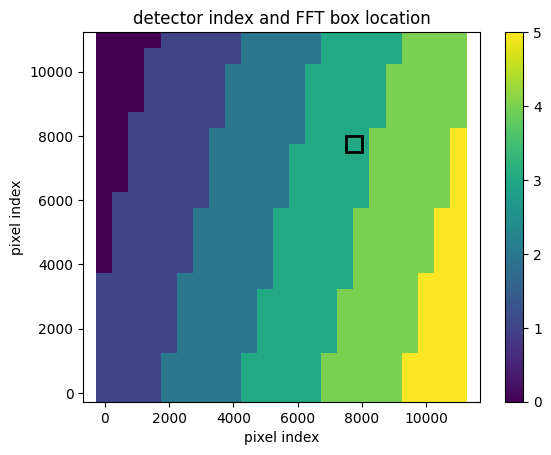

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.994768596986549
(31, 31)
(31, 31)
(31, 31)


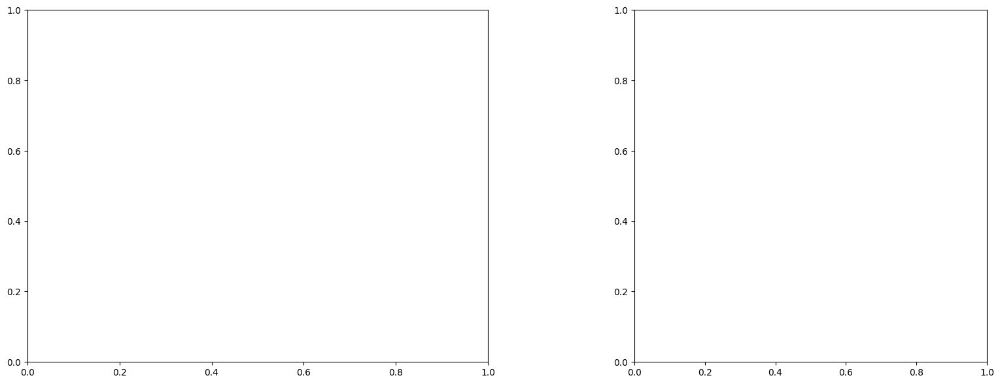

U and V components of current : [0.73722866 0.69422083]
uncertainties for U and V: 0.08211899092751539 0.06179611372839758


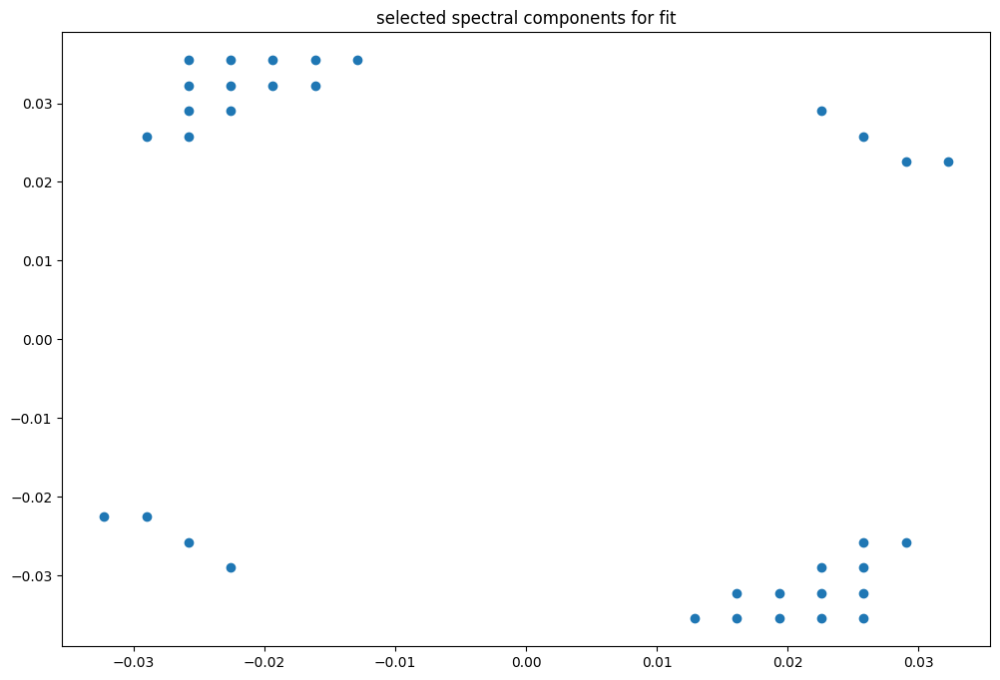

box [7500, 8000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

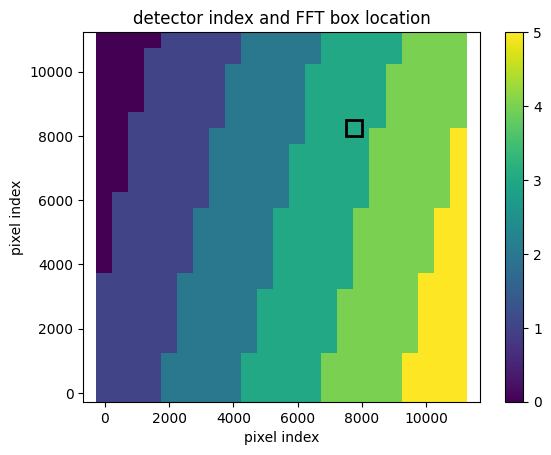

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947659149529672
(31, 31)
(31, 31)
(31, 31)


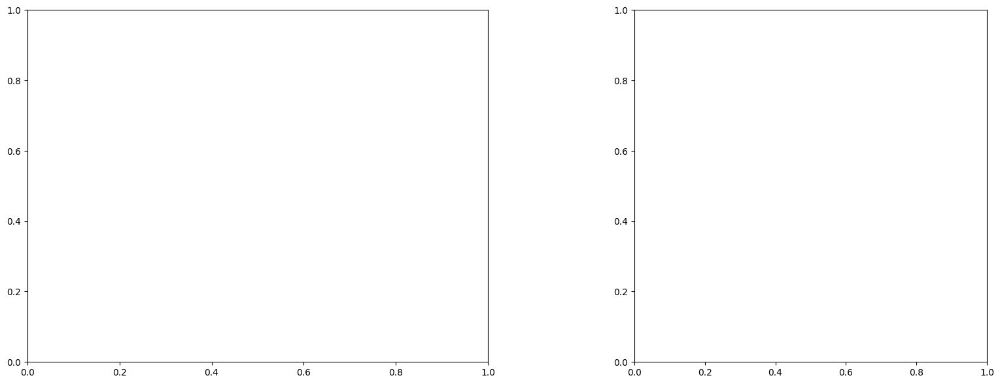

U and V components of current : [0.73122711 0.78558047]
uncertainties for U and V: 0.0507490672957175 0.04407979692815826


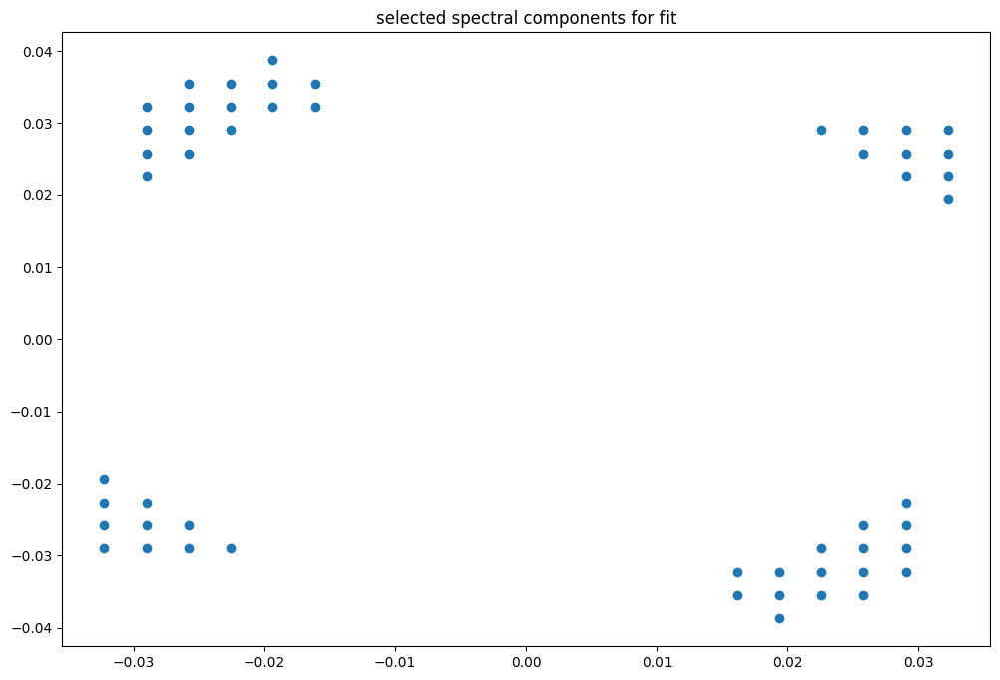

box [7500, 8000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

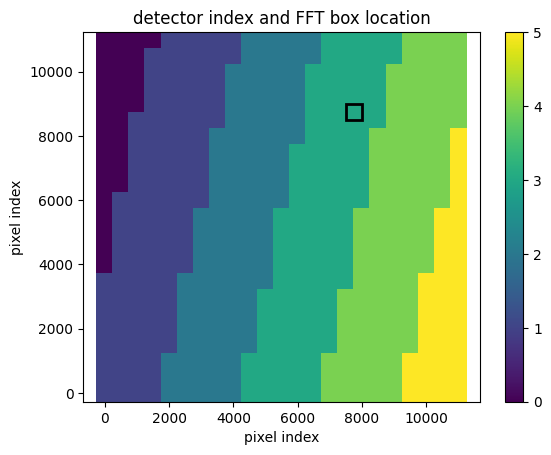

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


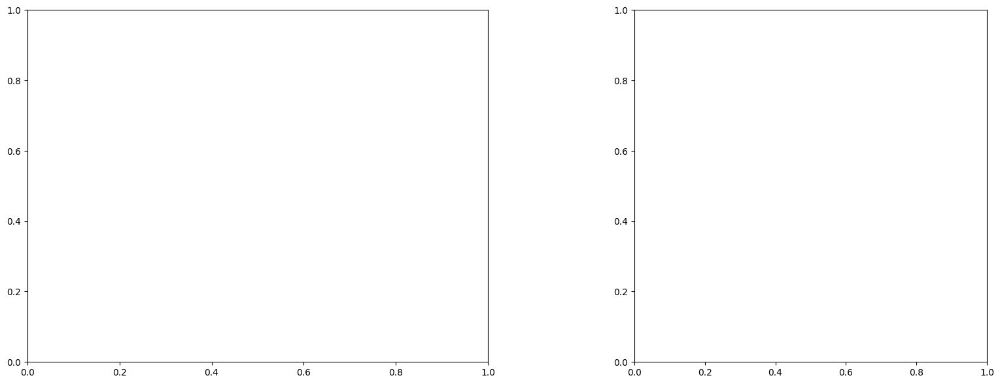

U and V components of current : [0.71682881 0.88694746]
uncertainties for U and V: 0.04495548749962376 0.04096650477242163


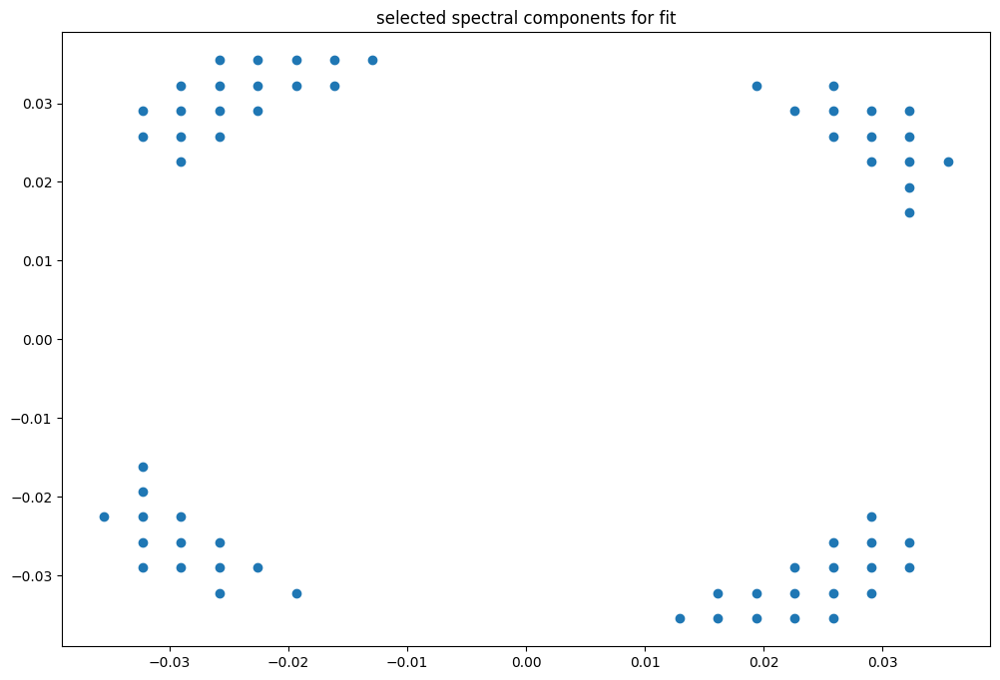

box [7500, 8000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

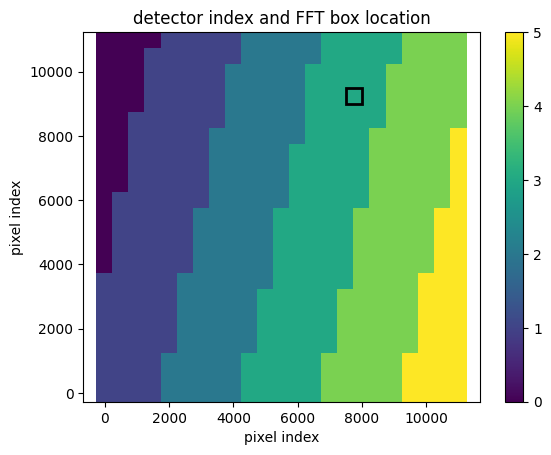

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947599942259363
(31, 31)
(31, 31)
(31, 31)


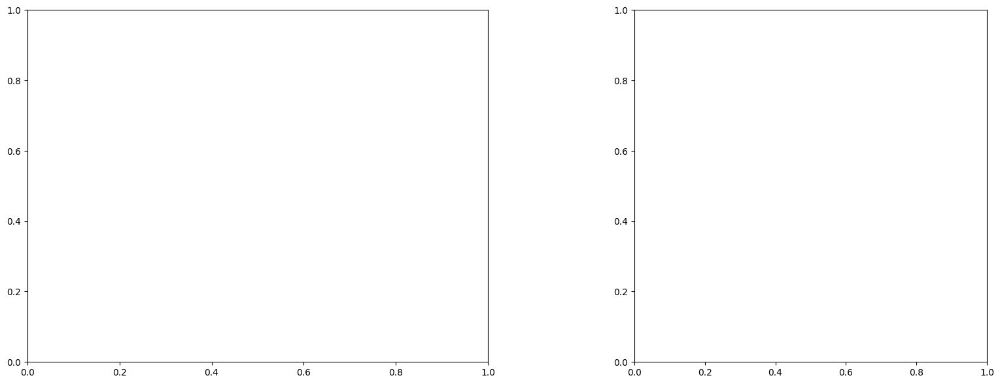

U and V components of current : [1.01711619 0.89953566]
uncertainties for U and V: 0.054406100411071544 0.043218504386931665


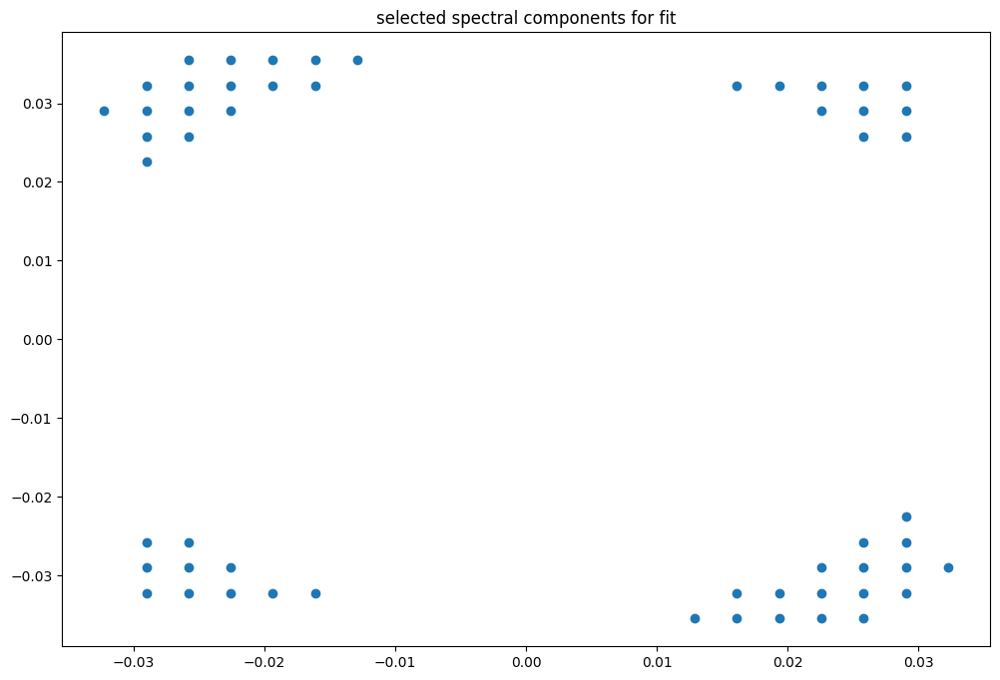

box [7500, 8000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

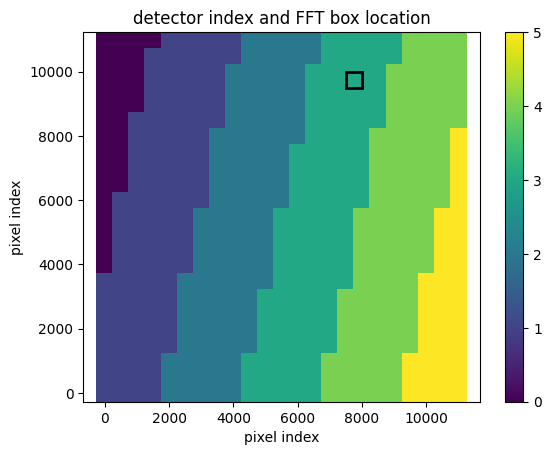

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947599942259363
(31, 31)
(31, 31)
(31, 31)


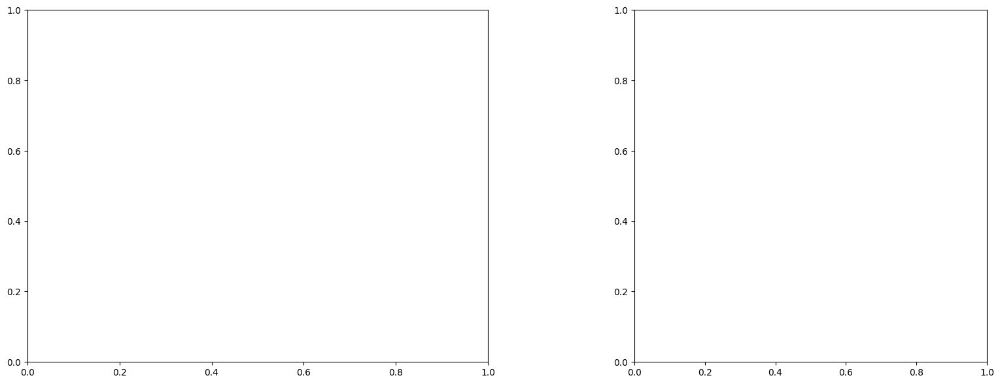

U and V components of current : [0.84079171 0.78135239]
uncertainties for U and V: 0.07065207357203457 0.0561249434773634


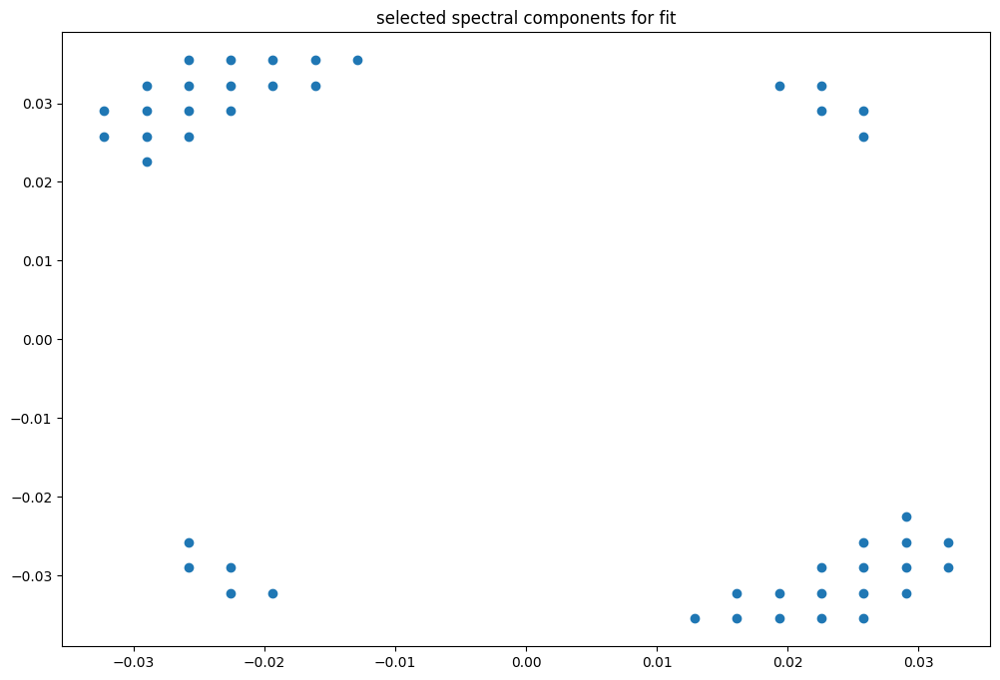

box [7500, 8000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

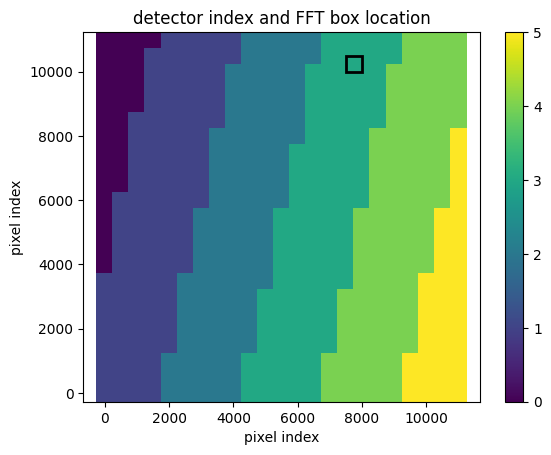

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(31, 31)
(31, 31)
(31, 31)


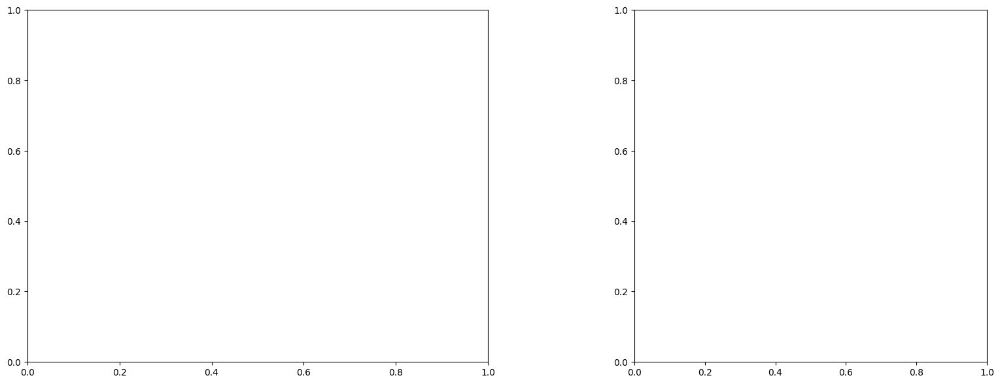

U and V components of current : [0.78474049 0.59037011]
uncertainties for U and V: 0.1773398818330616 0.14541611274156435


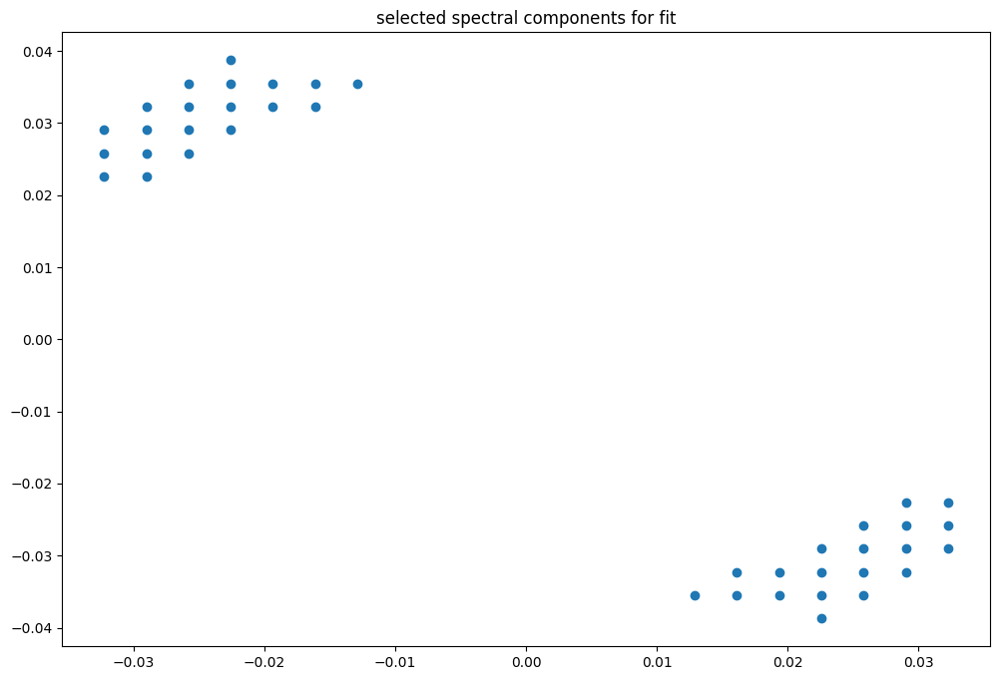

box [7500, 8000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

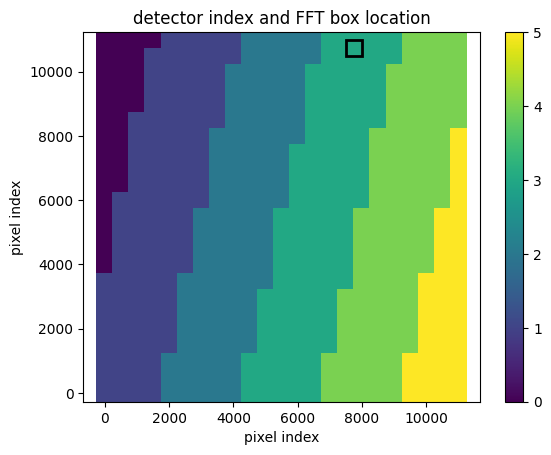

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(31, 30)
(31, 30)
(31, 30)


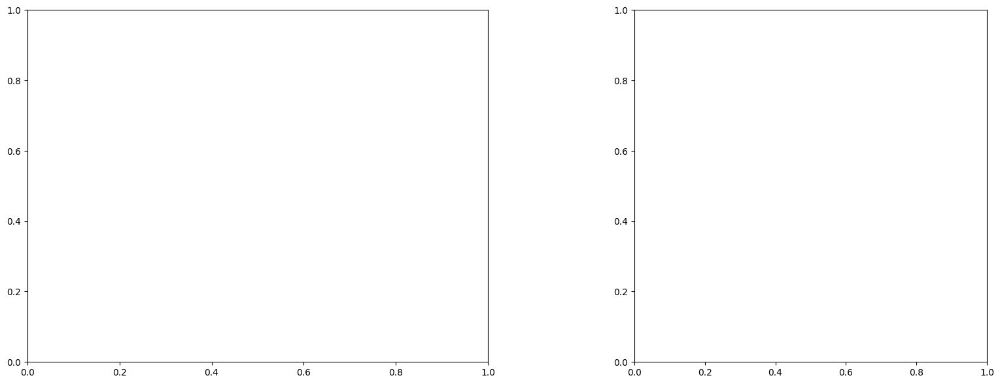

U and V components of current : [1.05508062 0.64659609]
uncertainties for U and V: 0.17069524427200317 0.13825170798494787


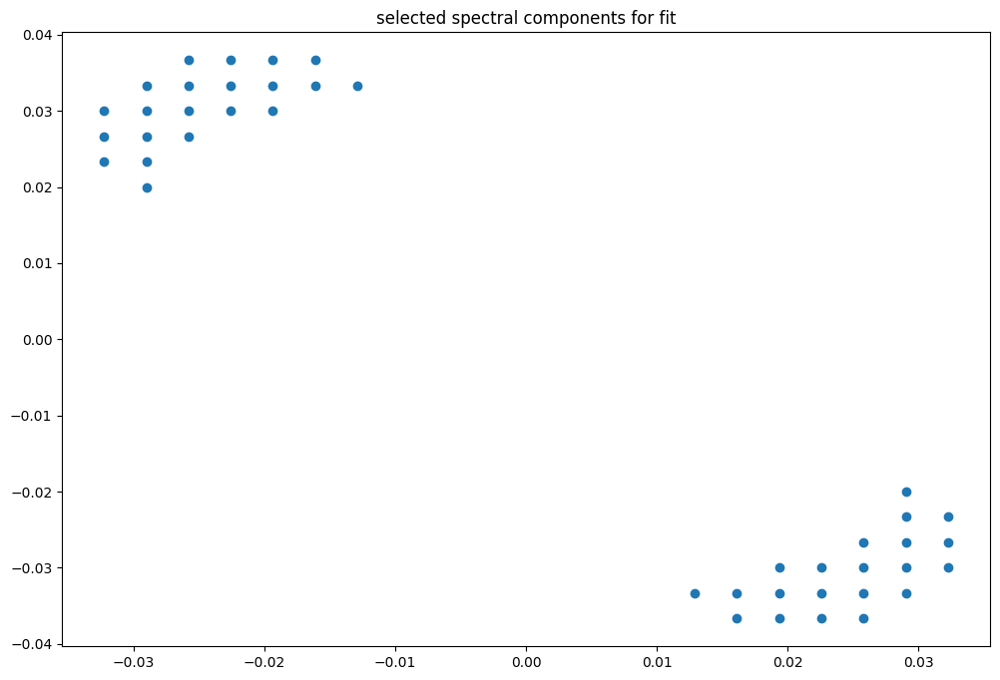

box [8000, 8500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

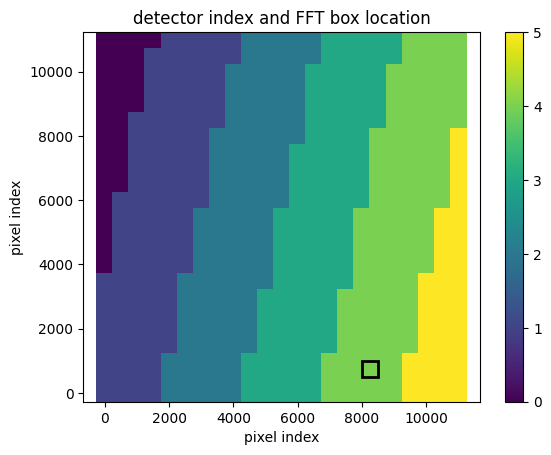

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987391765727964
(31, 31)
(31, 31)
(31, 31)


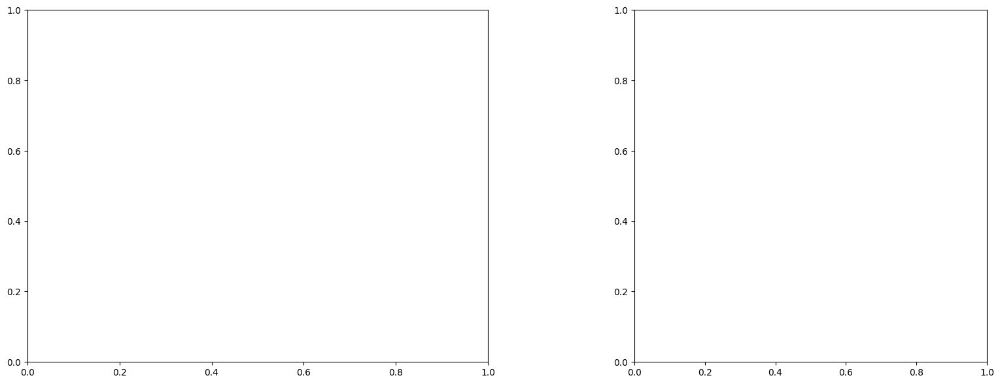

U and V components of current : [0.38420299 1.10823601]
uncertainties for U and V: 0.08952561004258579 0.17707938081267482


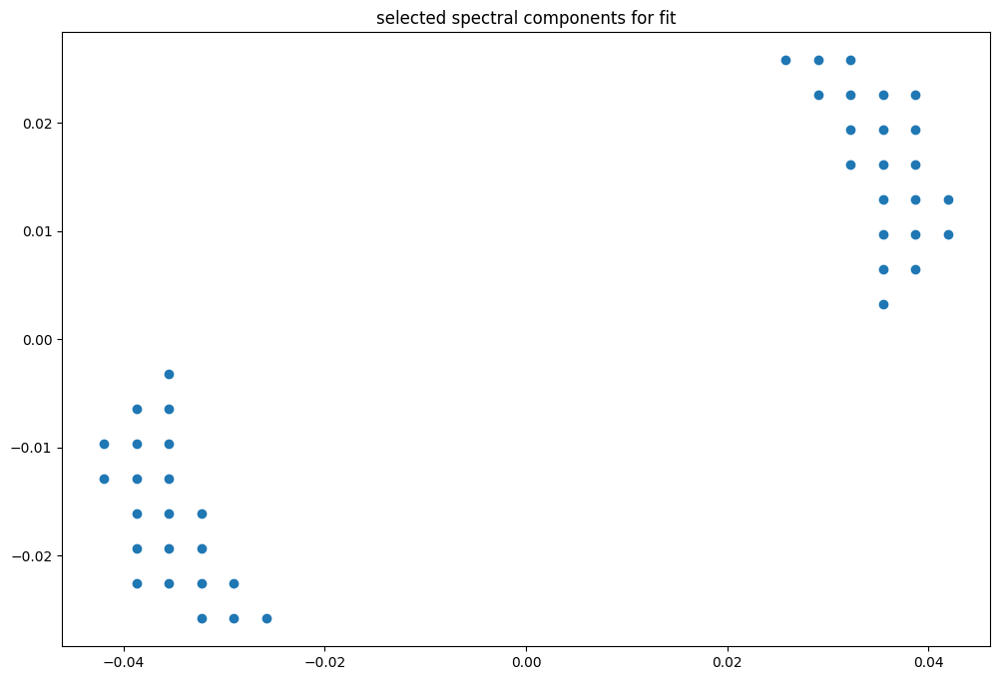

box [8000, 8500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

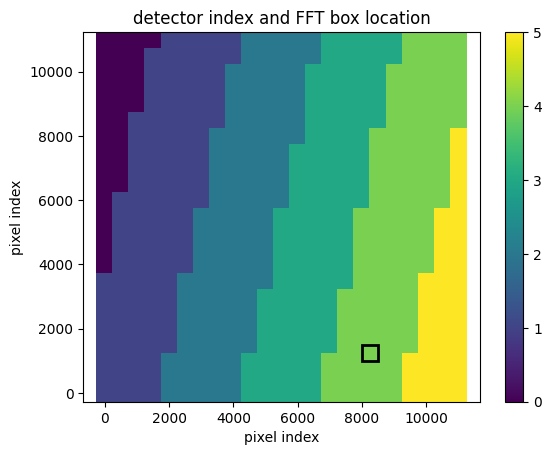

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


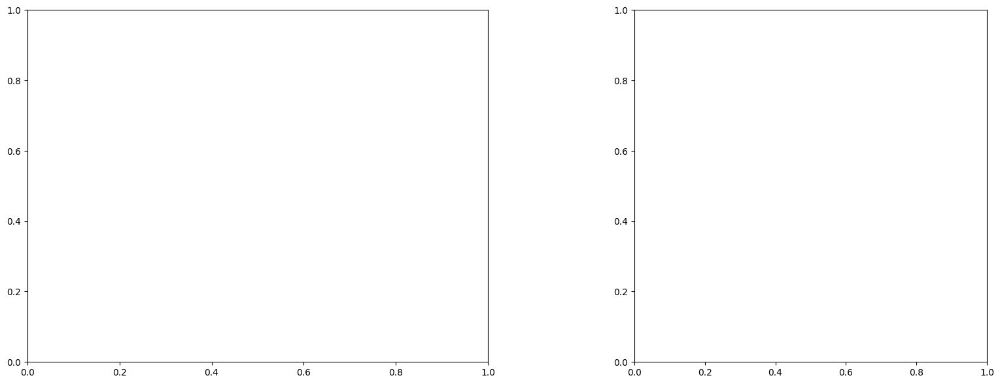

U and V components of current : [0.3311806 1.5975731]
uncertainties for U and V: 0.08111524468748733 0.13934265212727756


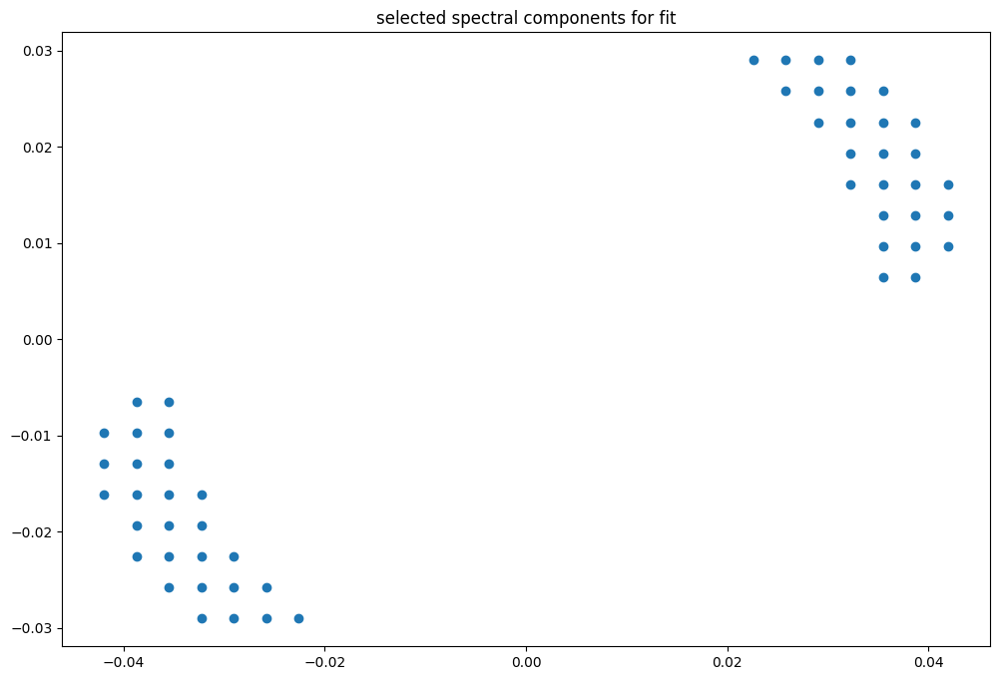

box [8000, 8500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

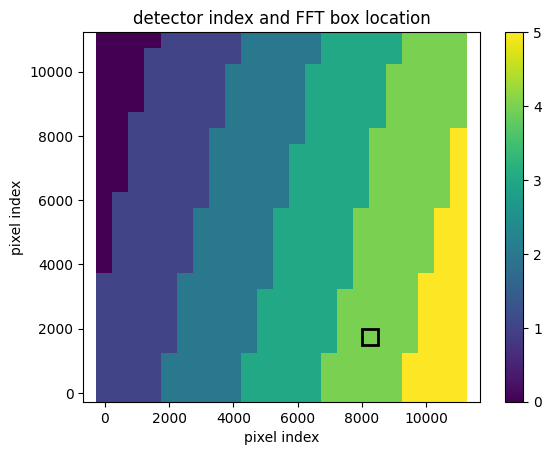

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


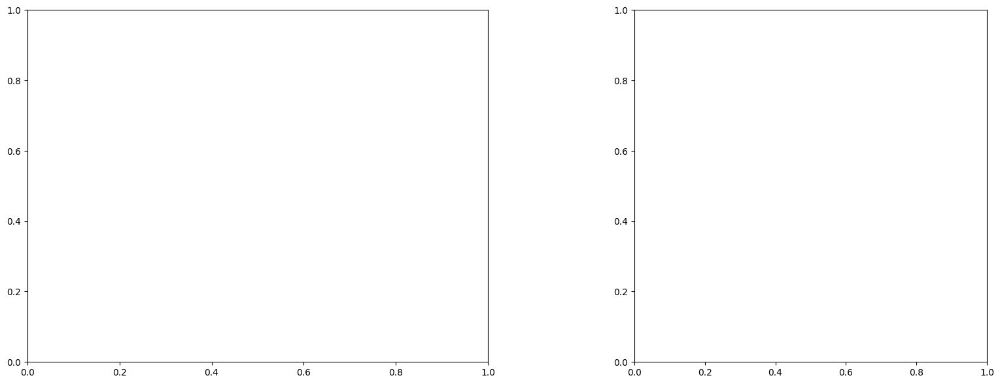

U and V components of current : [0.61404536 1.14171361]
uncertainties for U and V: 0.05267038947516539 0.08133516226040202


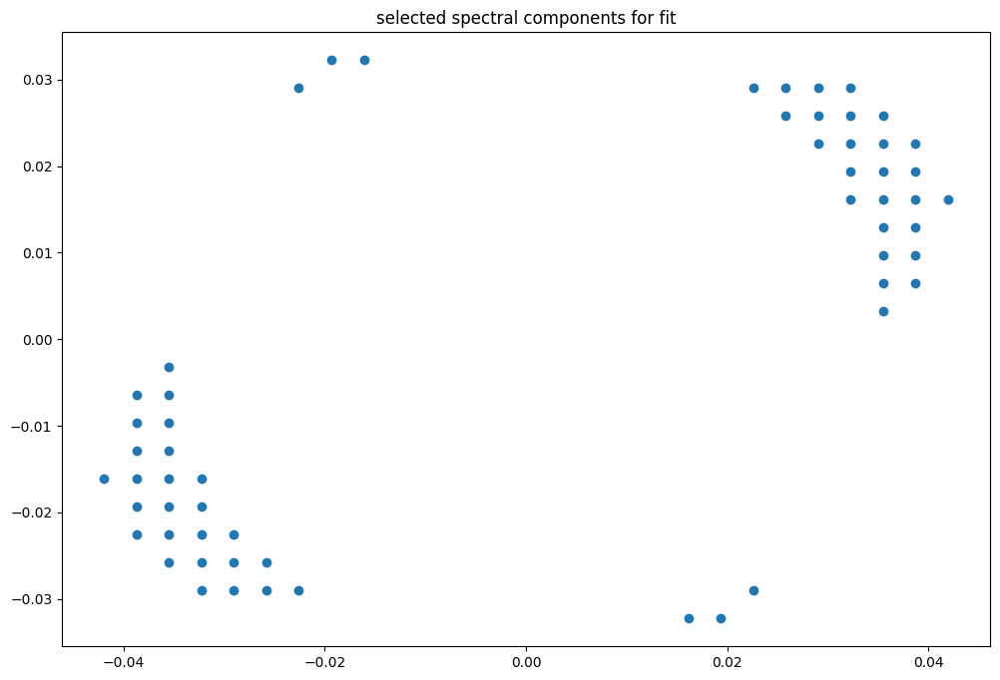

box [8000, 8500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

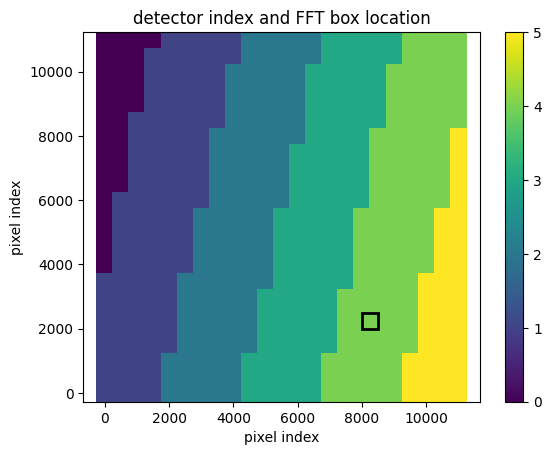

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


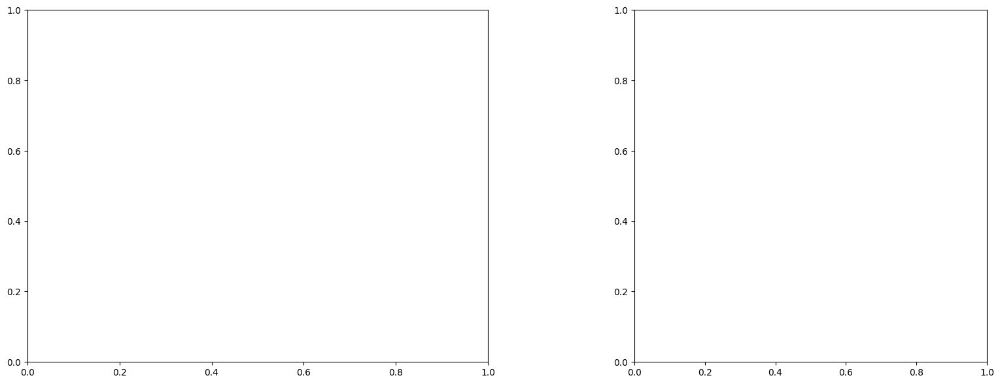

U and V components of current : [0.57161794 1.31933565]
uncertainties for U and V: 0.06576488509529431 0.11109579889499804


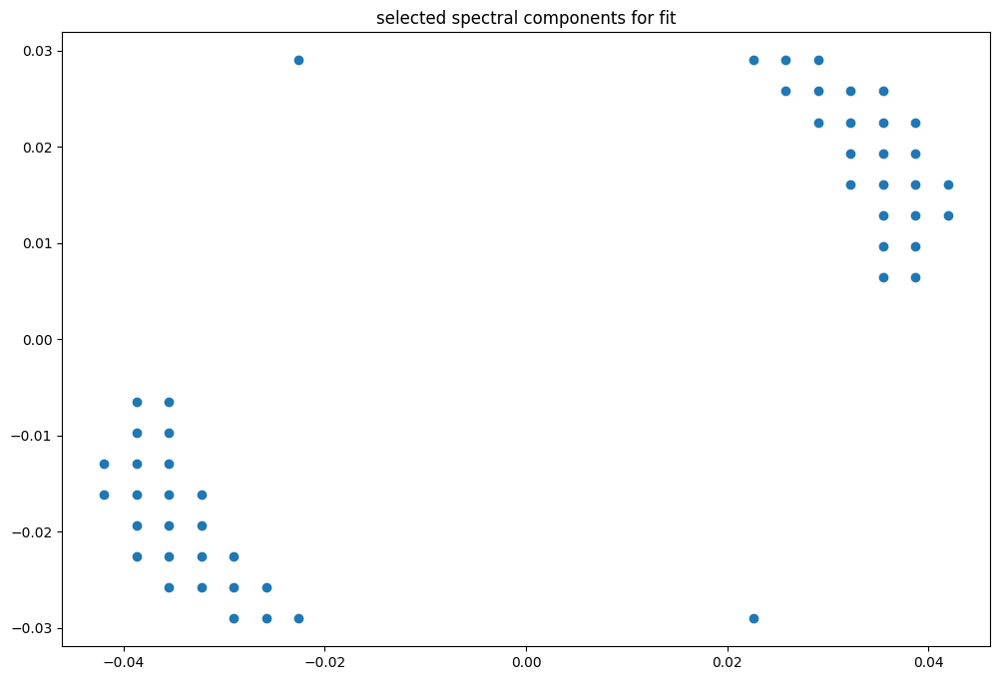

box [8000, 8500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

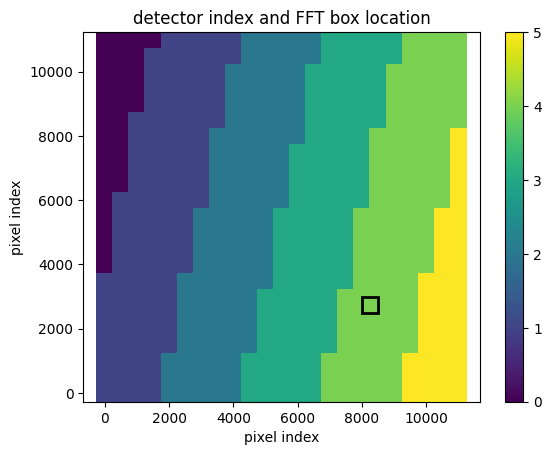

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


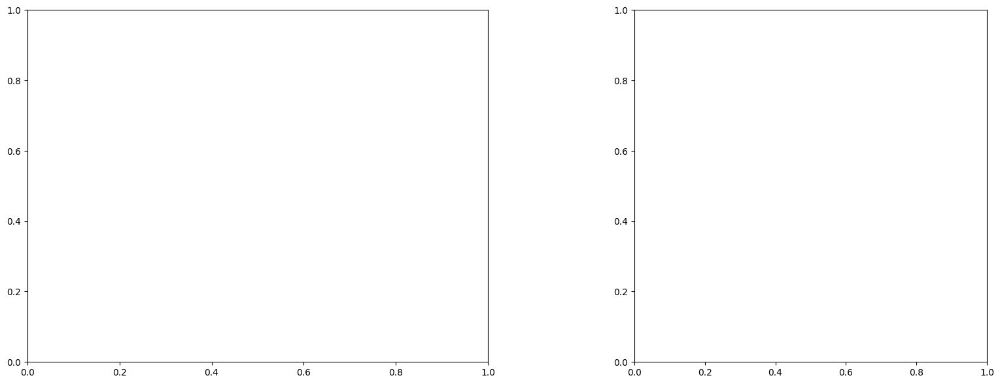

U and V components of current : [0.45341374 1.58810638]
uncertainties for U and V: 0.0927207361530969 0.15005965175599617


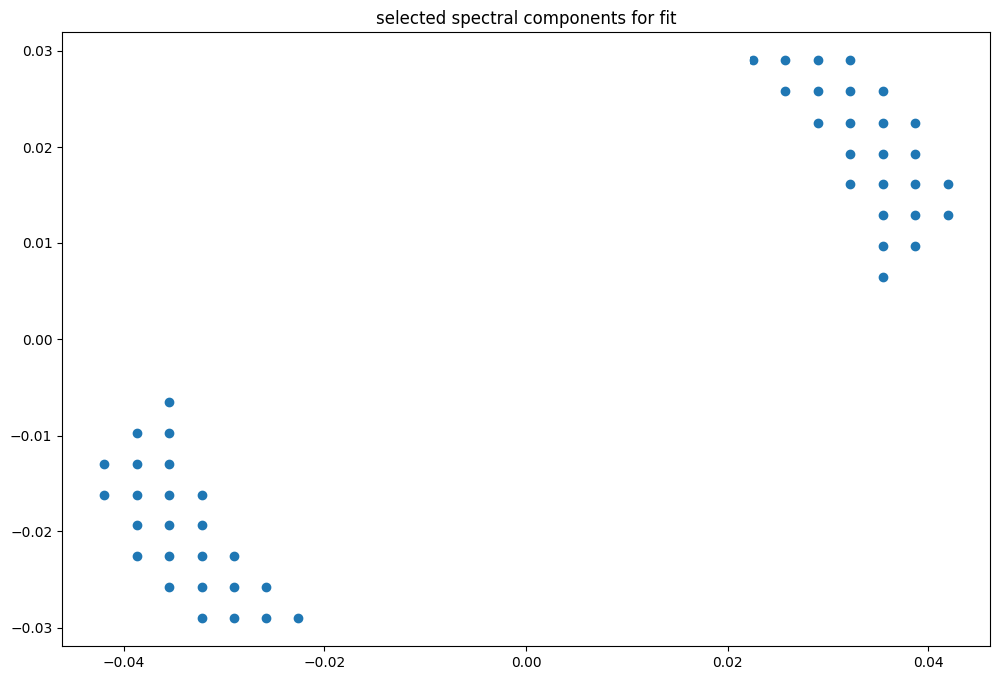

box [8000, 8500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

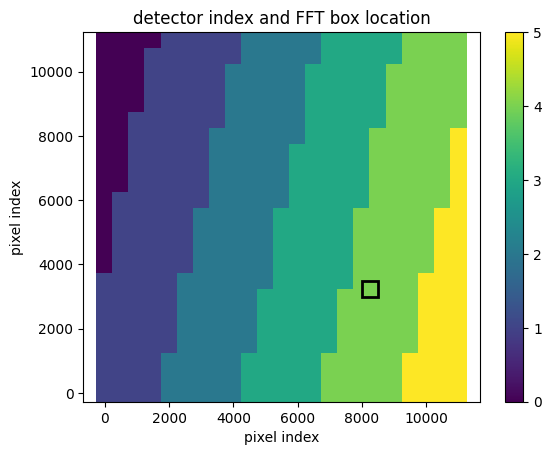

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


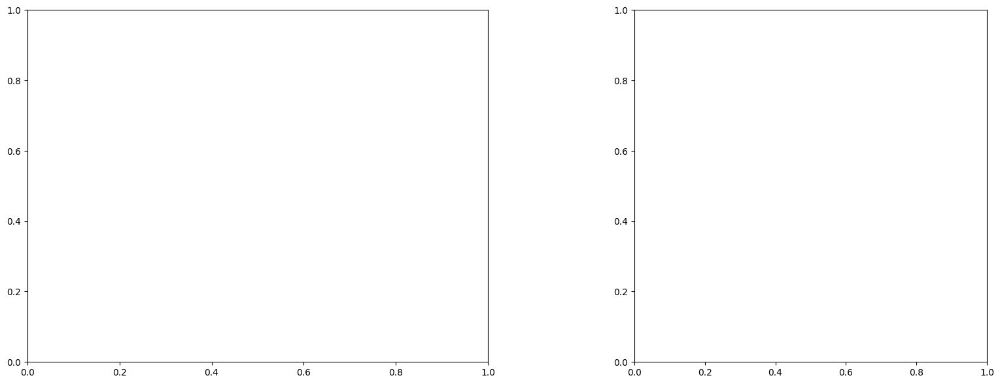

U and V components of current : [0.47590672 1.36530358]
uncertainties for U and V: 0.09048724856139558 0.1516678097774279


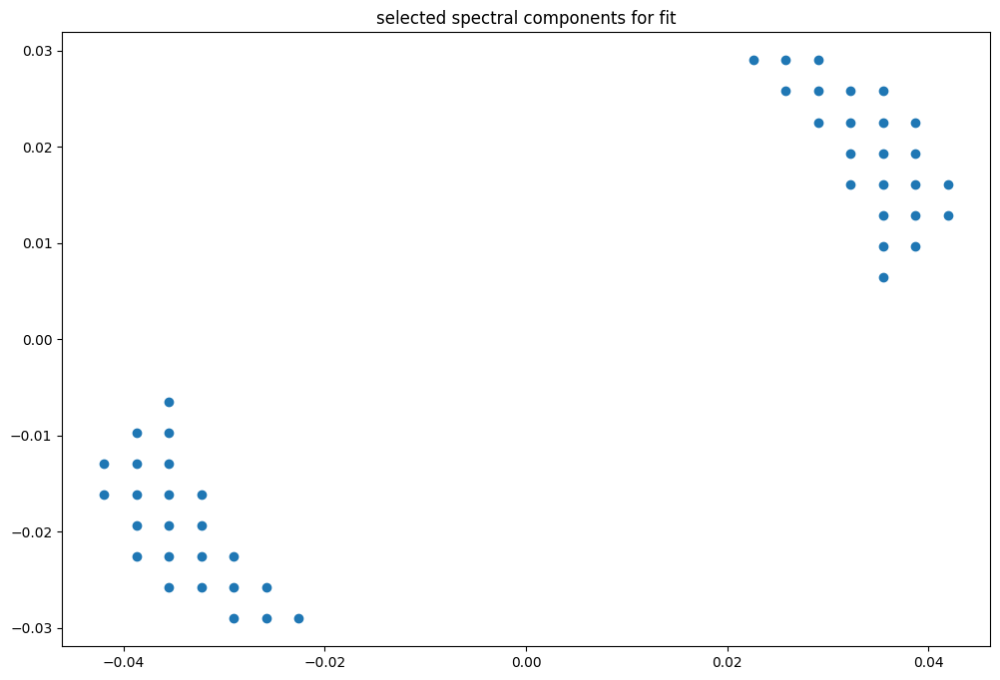

box [8000, 8500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

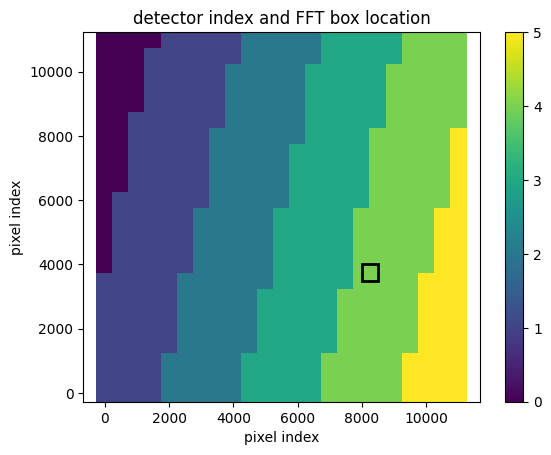

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


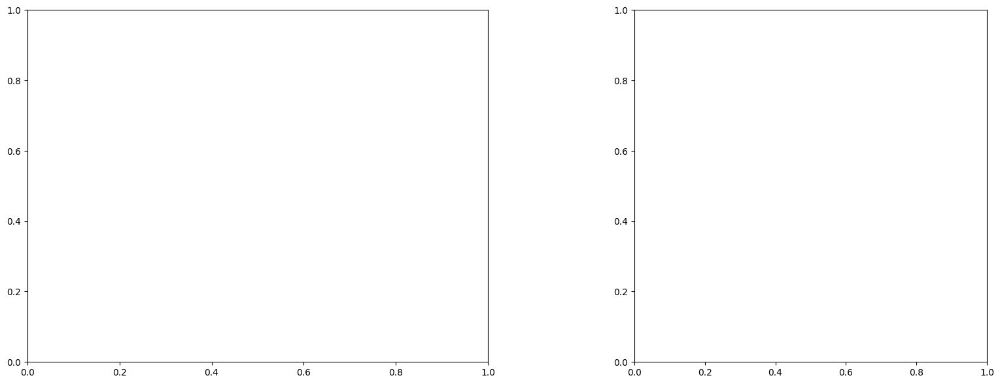

U and V components of current : [0.24731429 1.5638006 ]
uncertainties for U and V: 0.07704870089682701 0.13001923227811008


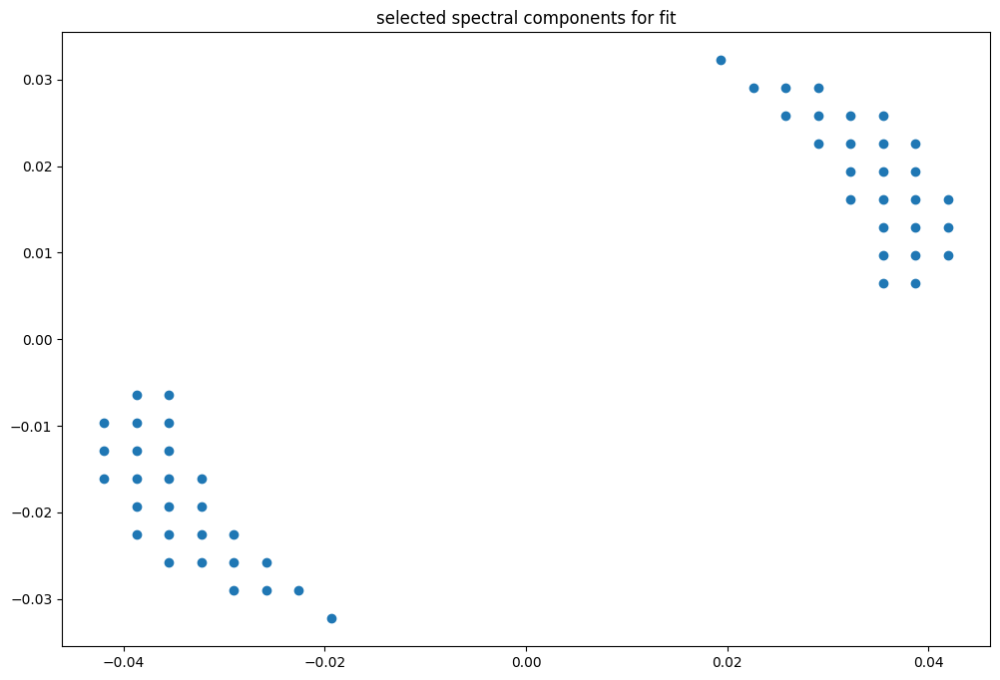

box [8000, 8500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

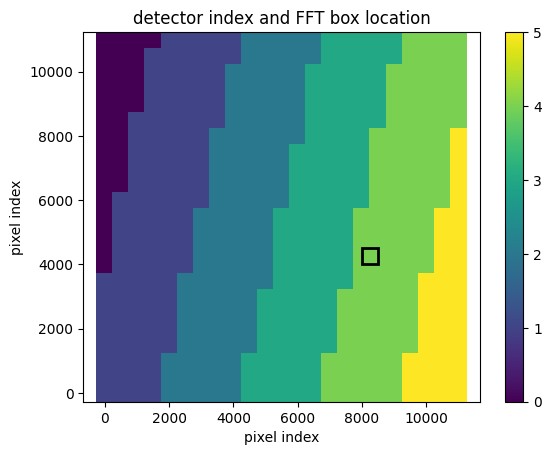

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


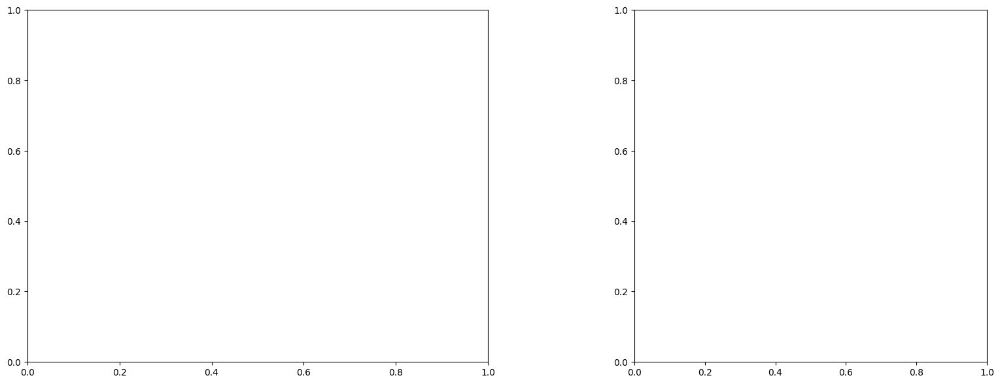

U and V components of current : [0.66436695 1.21624226]
uncertainties for U and V: 0.06969323322389478 0.09877295235368783


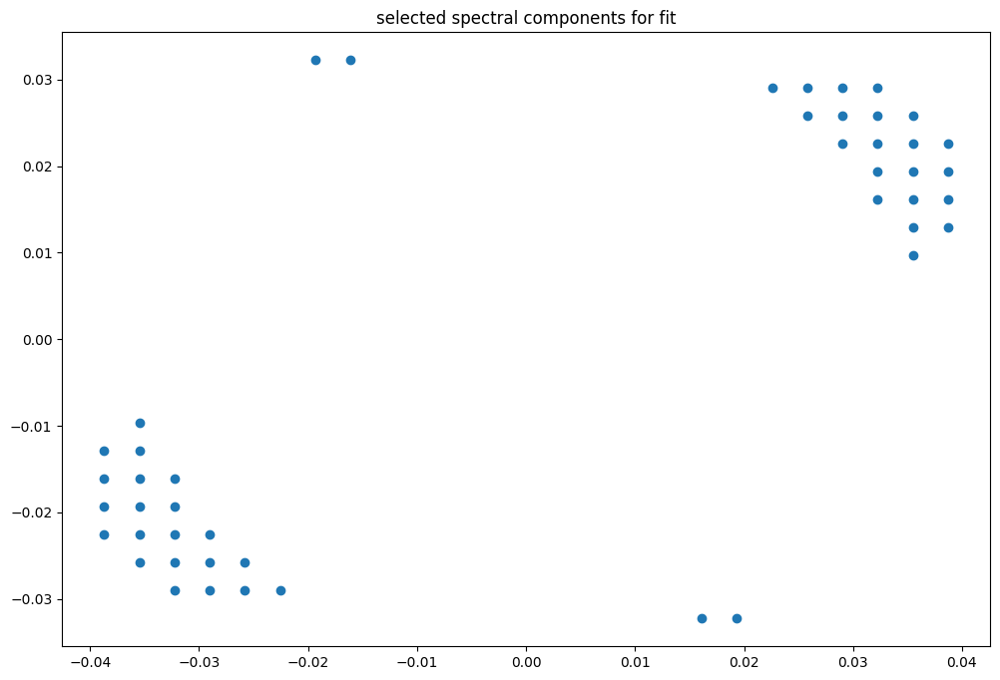

box [8000, 8500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

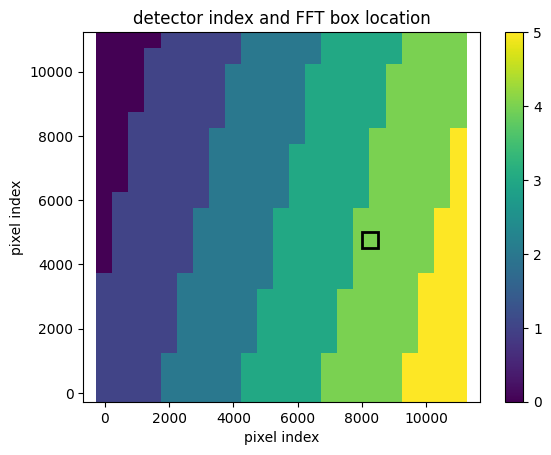

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


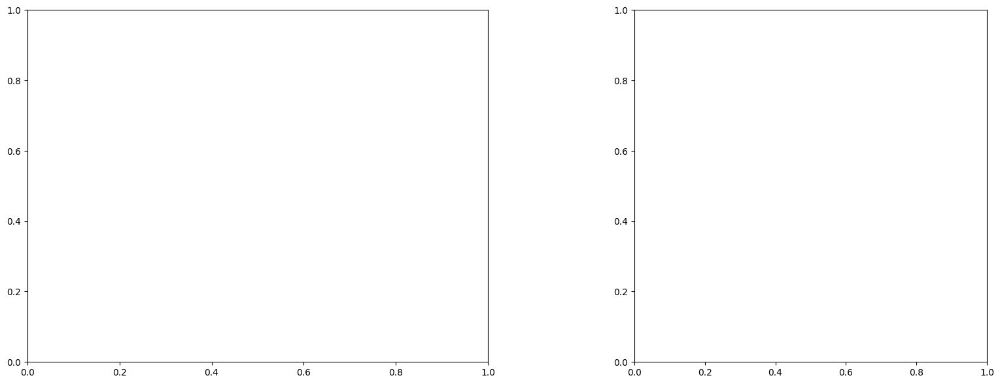

U and V components of current : [0.84800915 1.24101334]
uncertainties for U and V: 0.06244822582375342 0.07962966694173522


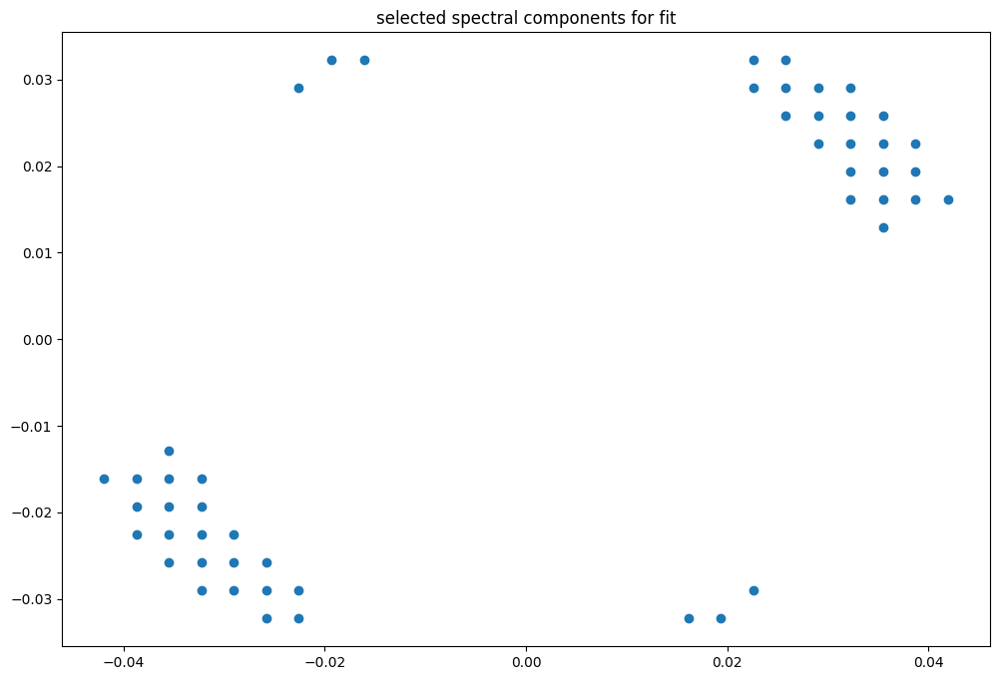

box [8000, 8500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

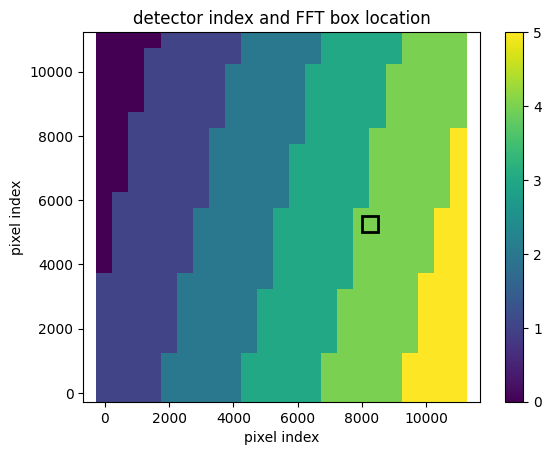

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


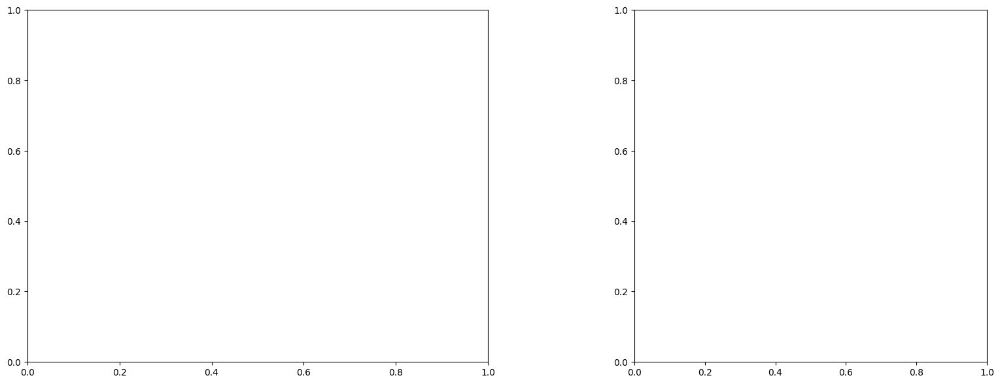

U and V components of current : [0.76473136 1.2080458 ]
uncertainties for U and V: 0.07580487536382254 0.09815600695305965


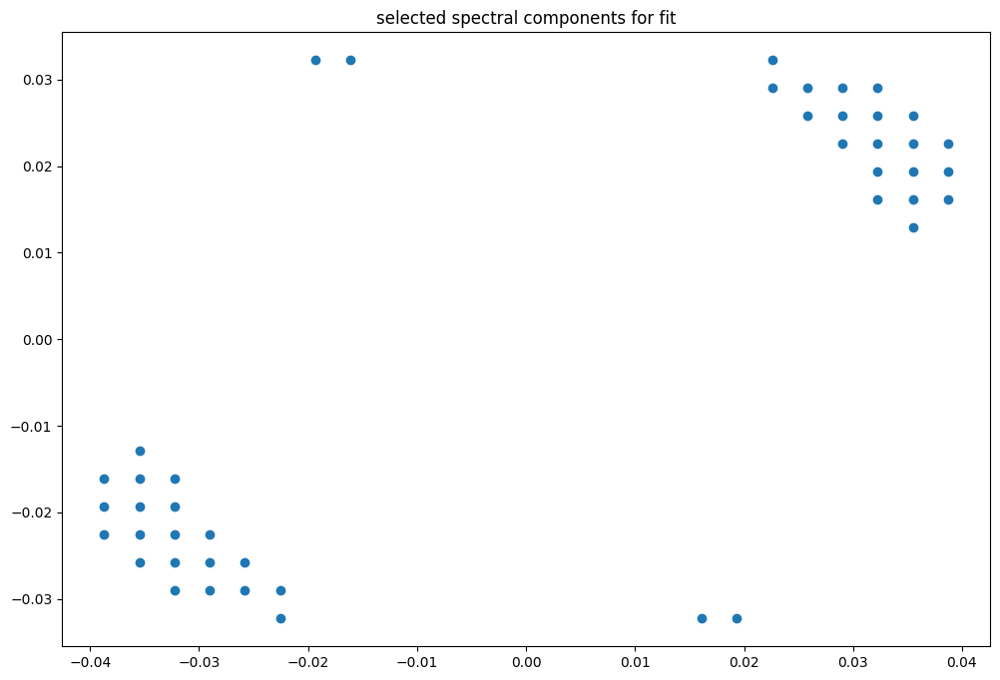

box [8000, 8500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

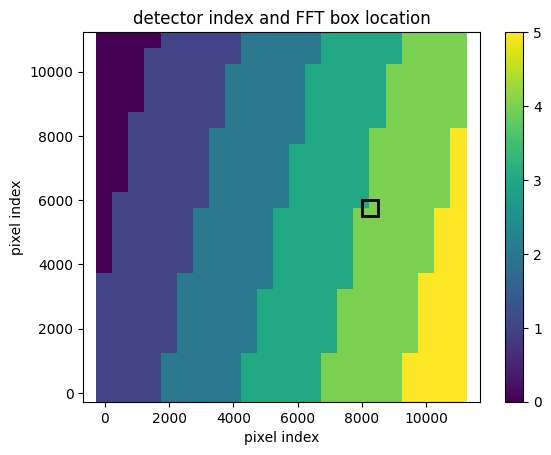

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


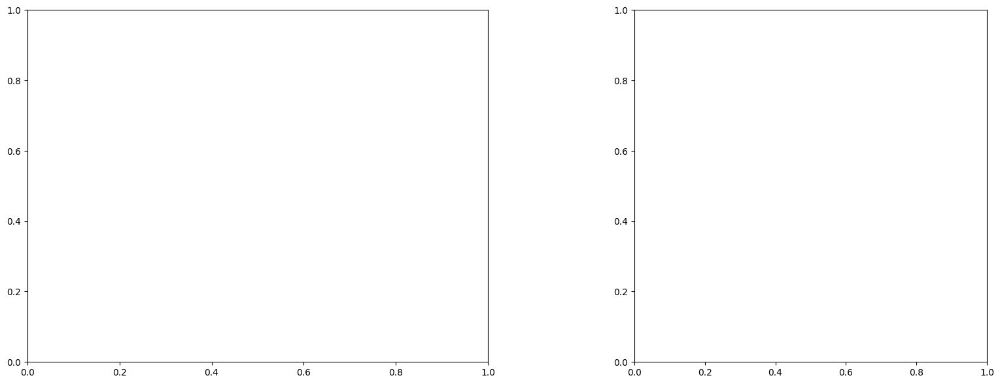

LinAlgError: Singular matrix

box [8000, 8500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

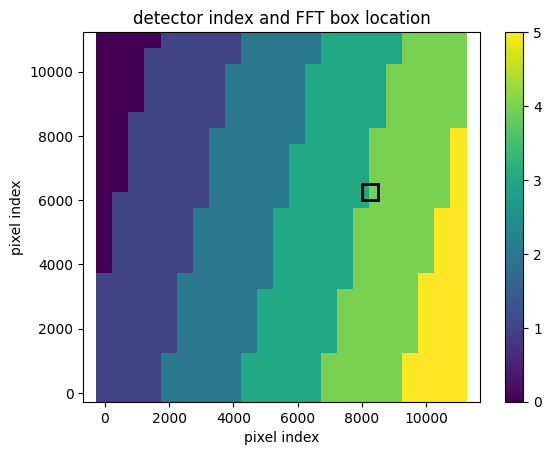

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


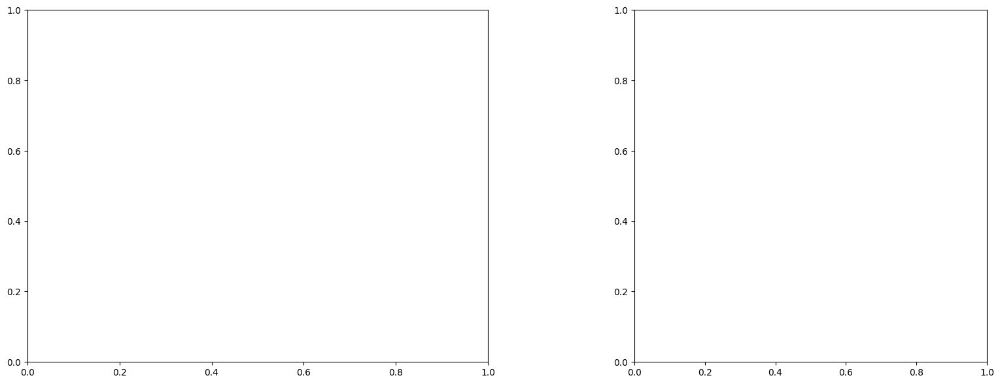

LinAlgError: Singular matrix

box [8000, 8500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

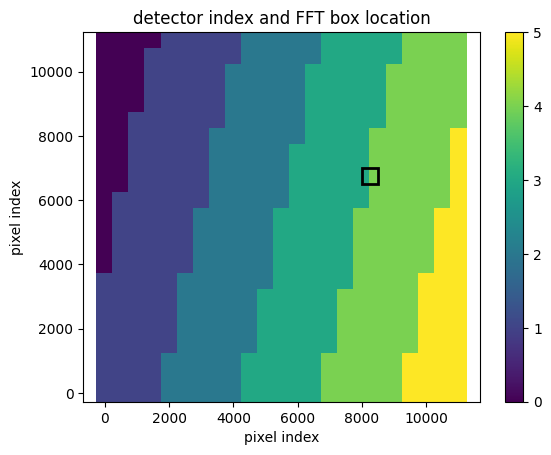

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


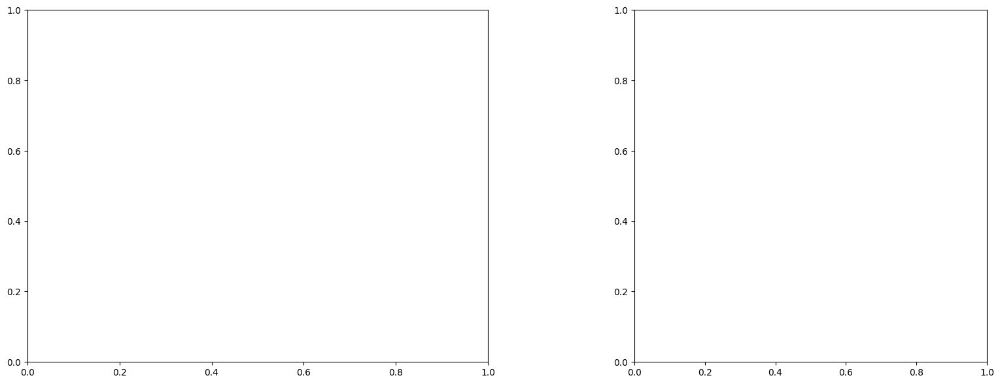

LinAlgError: Singular matrix

box [8000, 8500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

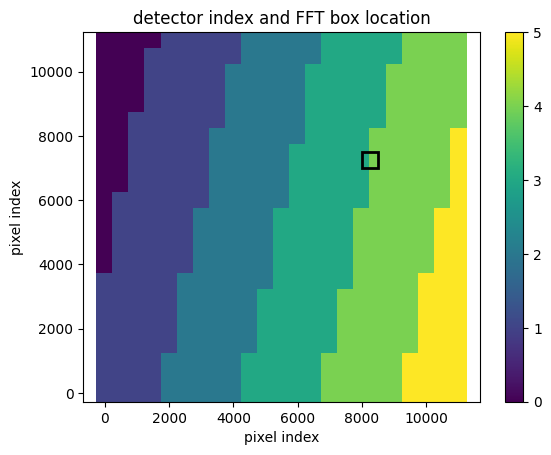

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


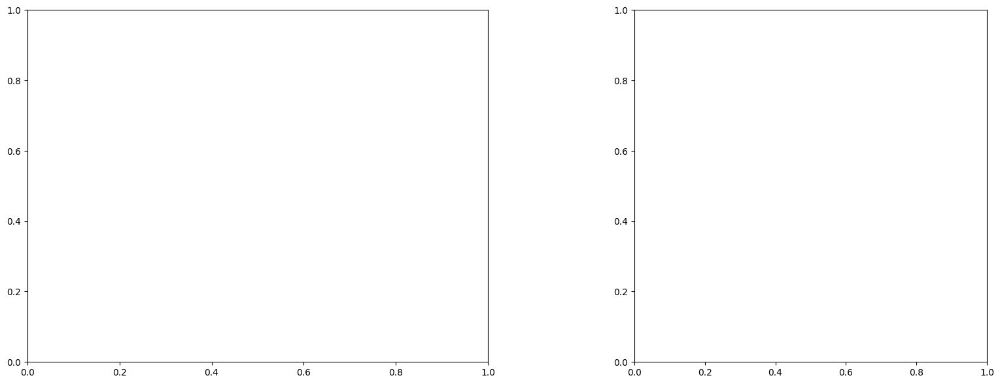

LinAlgError: Singular matrix

box [8000, 8500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

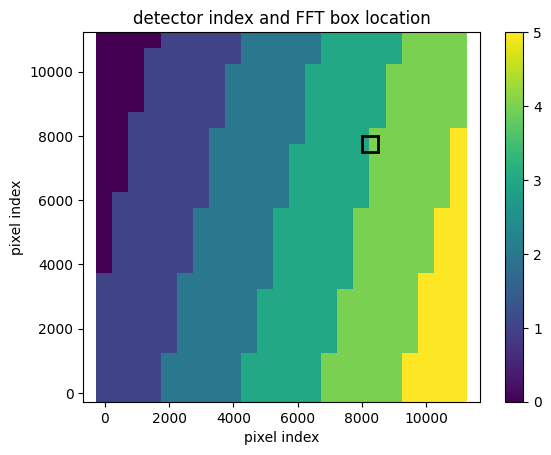

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


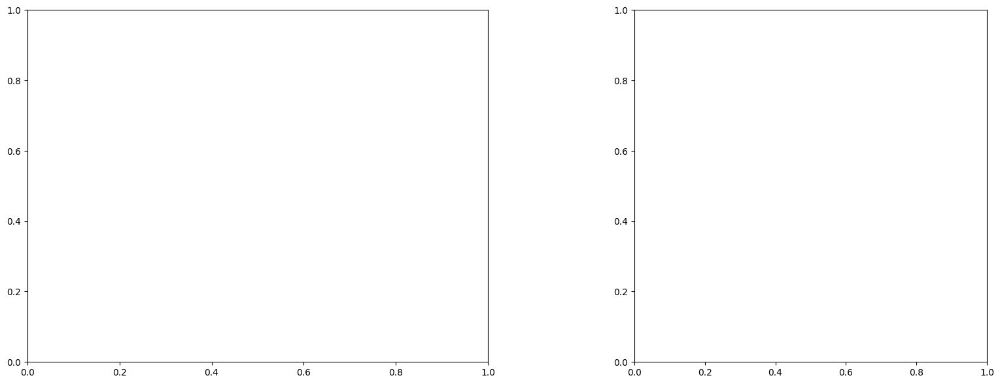

U and V components of current : [-1.08001745 -0.98795726]
uncertainties for U and V: 0.06436444953969736 0.05103597917102834


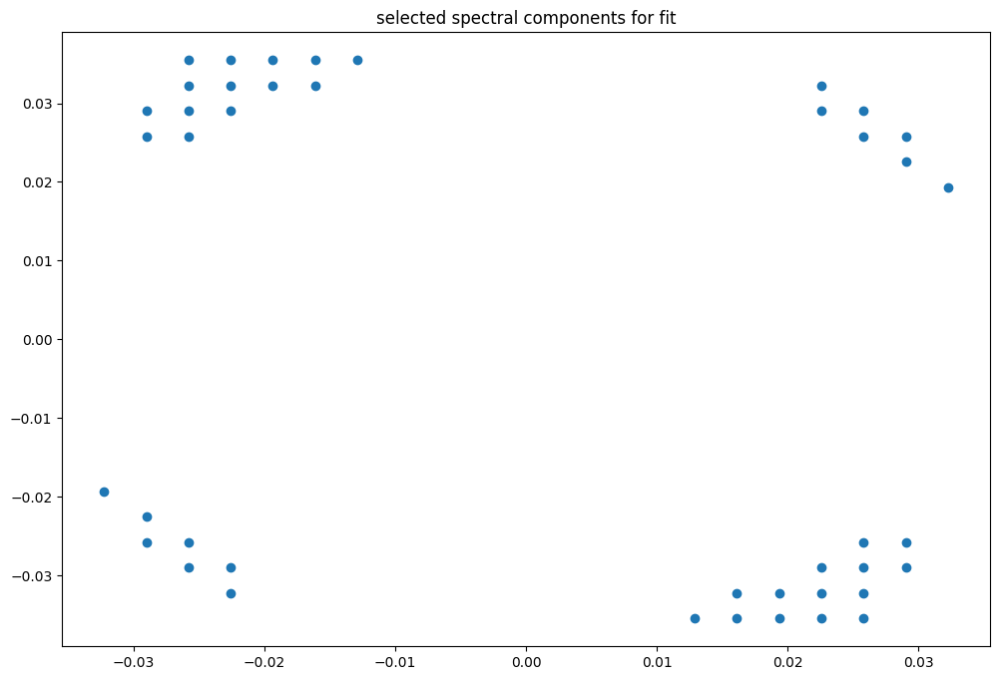

box [8000, 8500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

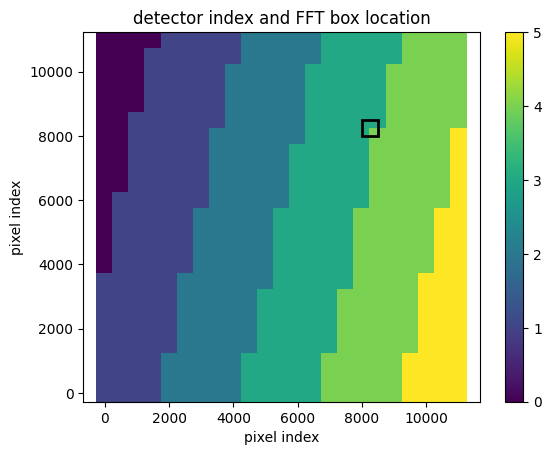

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947659149529672
(31, 31)
(31, 31)
(31, 31)


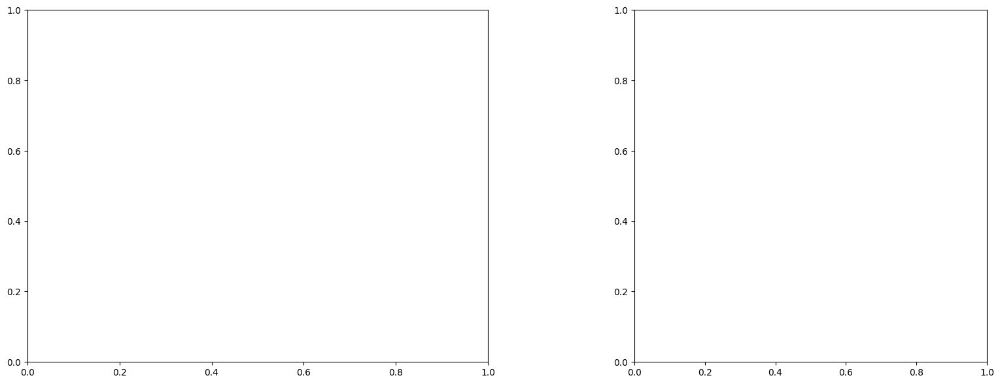

U and V components of current : [0.86363965 1.00050884]
uncertainties for U and V: 0.06341502053341698 0.0480128879363182


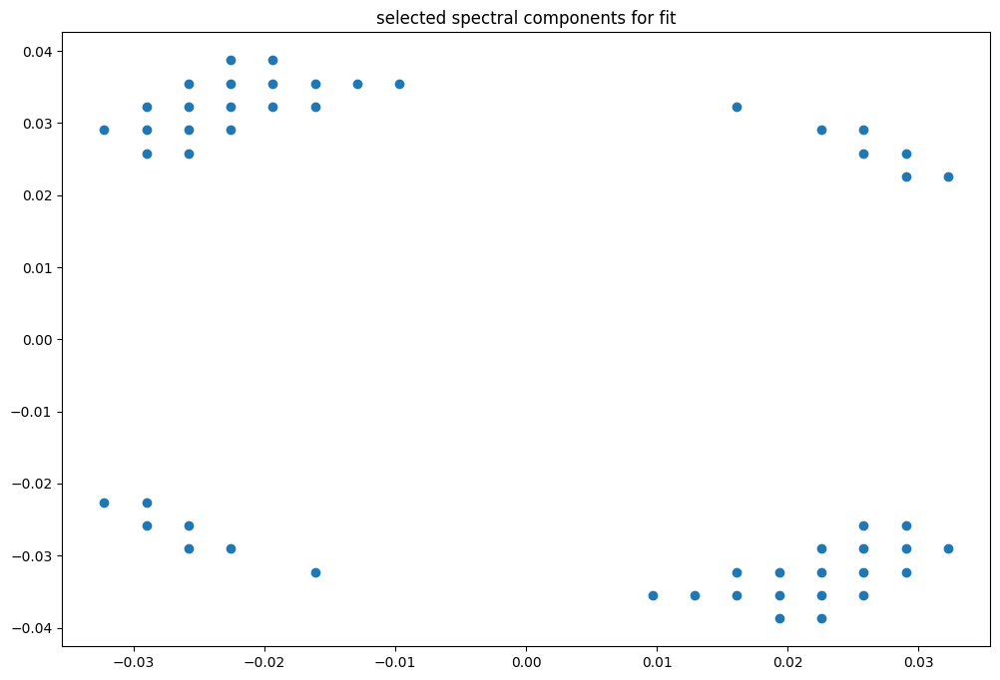

box [8000, 8500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

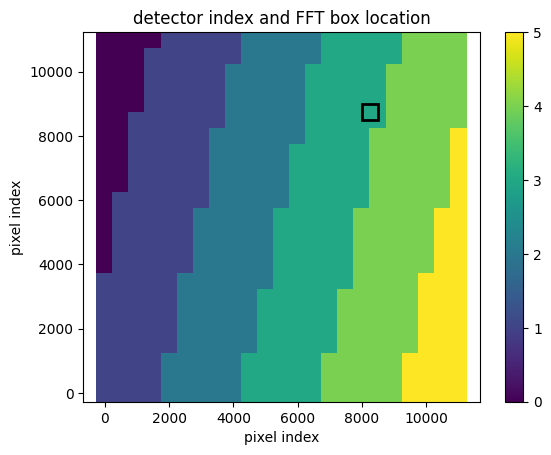

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947627954631996
(31, 31)
(31, 31)
(31, 31)


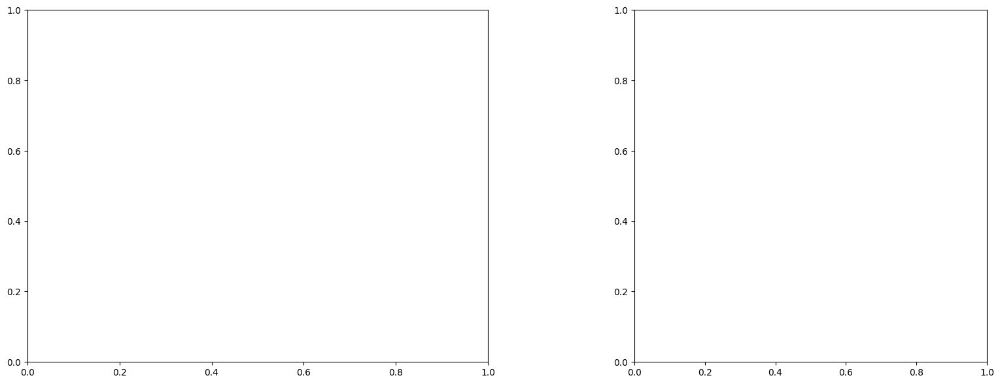

U and V components of current : [0.81764932 1.01326027]
uncertainties for U and V: 0.05268556252324982 0.0430864586450624


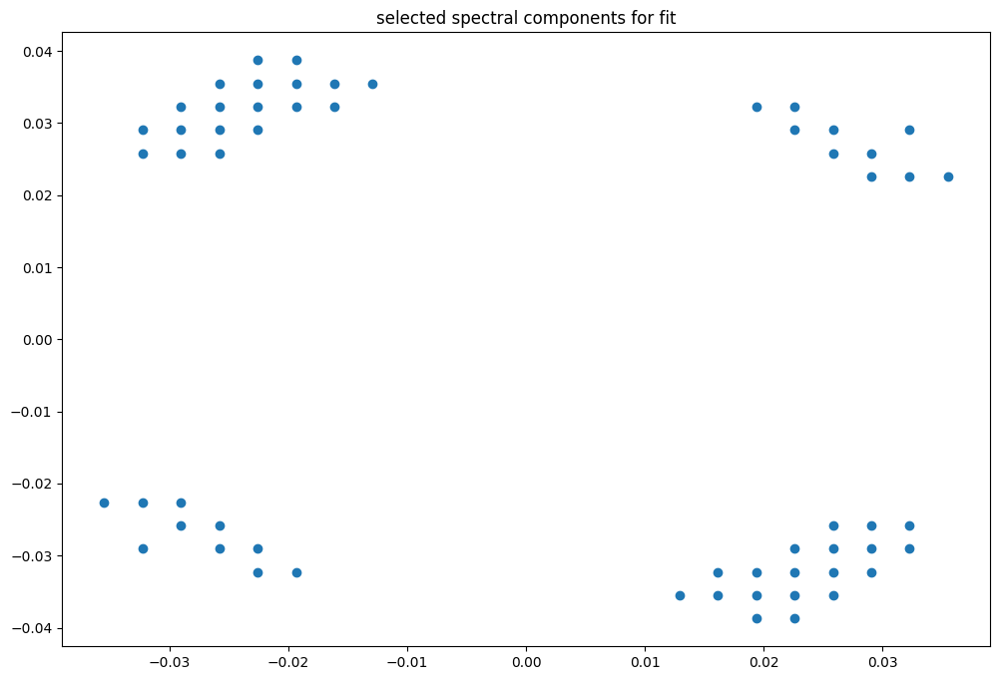

box [8000, 8500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

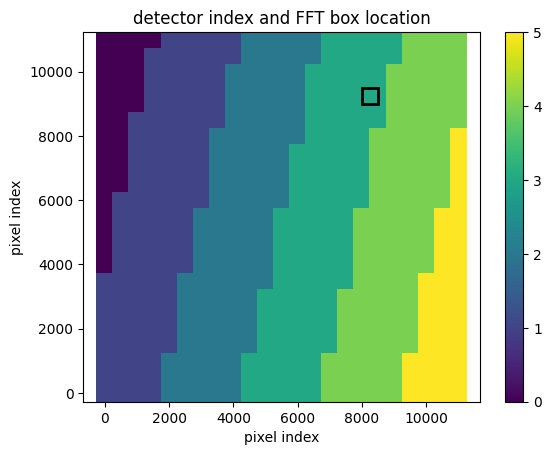

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947599942259363
(31, 31)
(31, 31)
(31, 31)


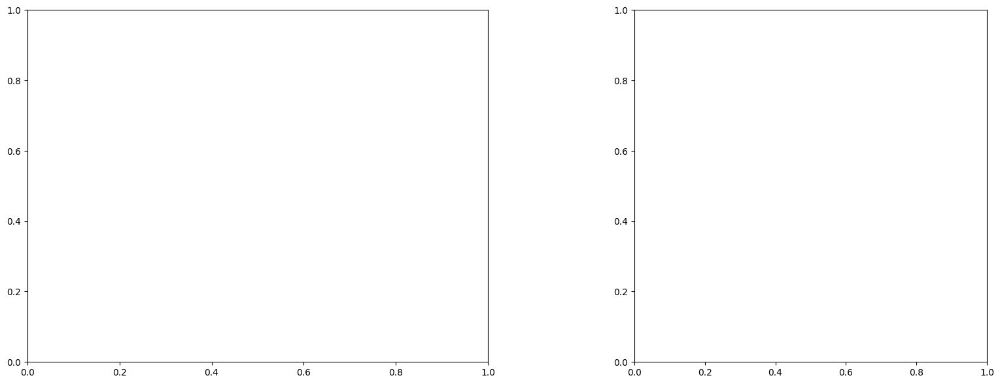

U and V components of current : [0.87846105 0.97080887]
uncertainties for U and V: 0.051450070624159884 0.041008825839368365


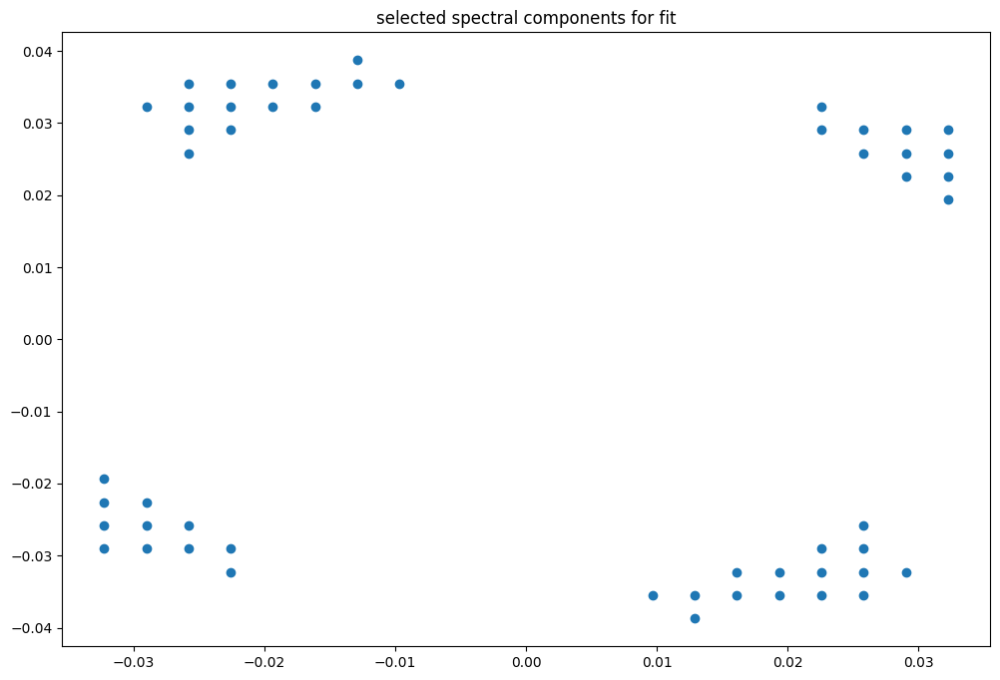

box [8000, 8500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

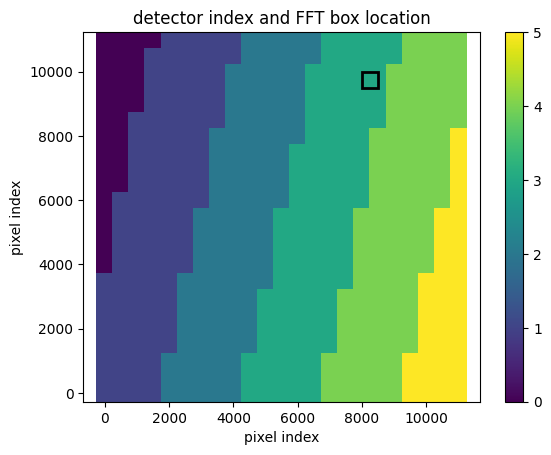

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(31, 31)
(31, 31)
(31, 31)


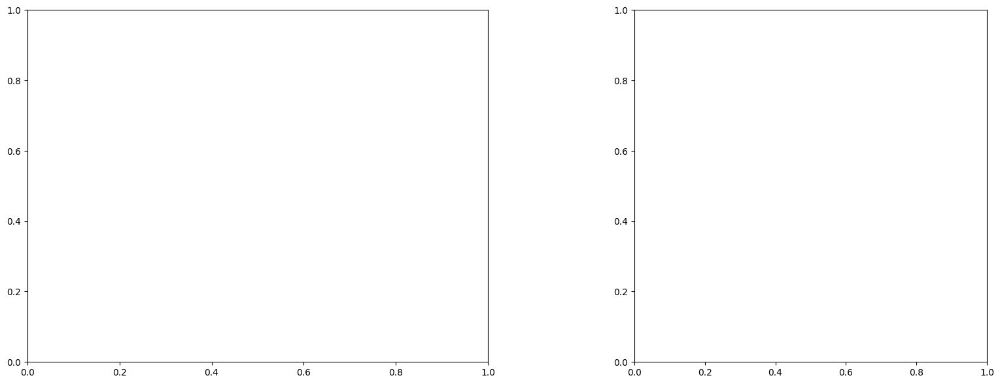

U and V components of current : [0.78317853 0.87128579]
uncertainties for U and V: 0.04960558935202513 0.03862998040254014


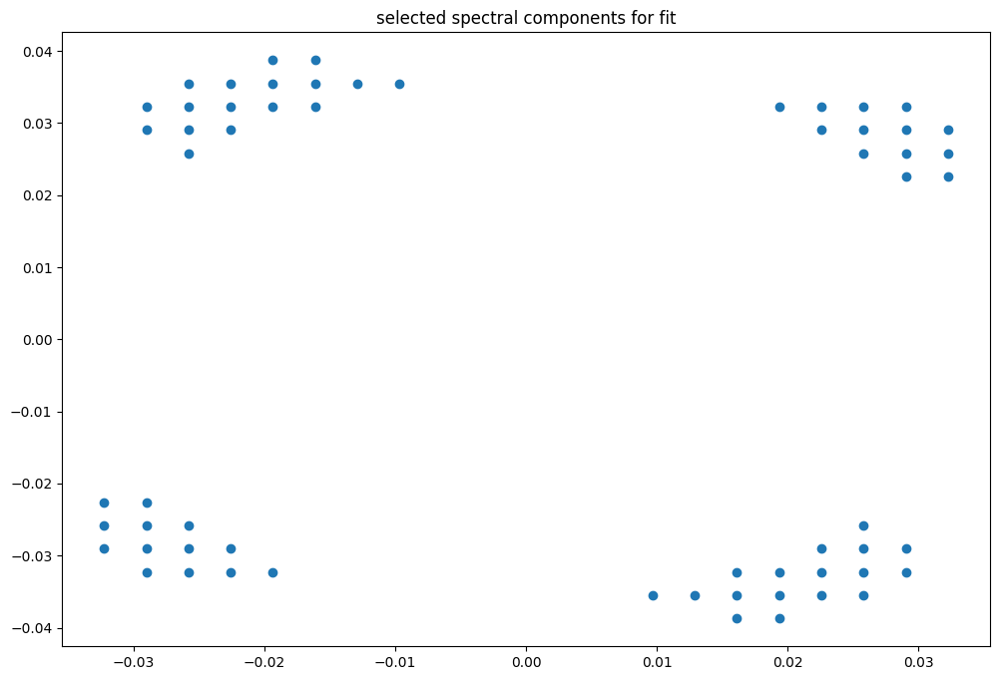

box [8000, 8500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

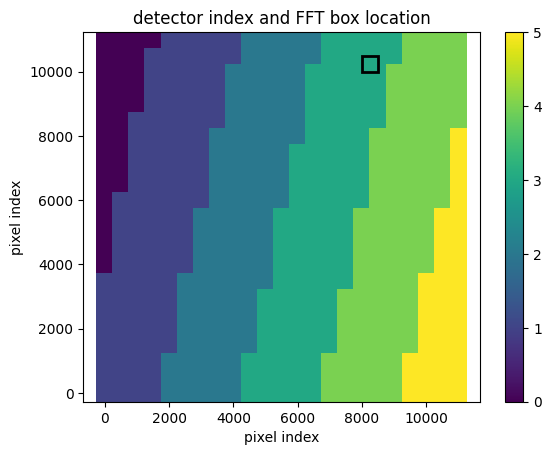

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(31, 31)
(31, 31)
(31, 31)


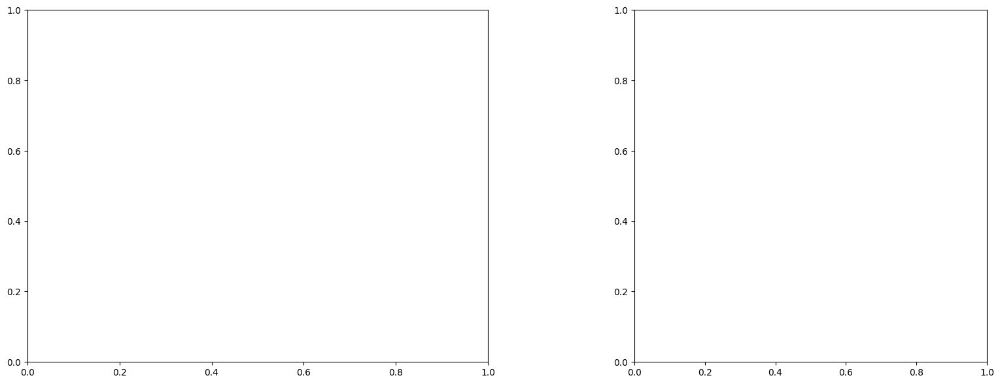

U and V components of current : [0.65667201 0.70146843]
uncertainties for U and V: 0.0771005647332788 0.0596686235902209


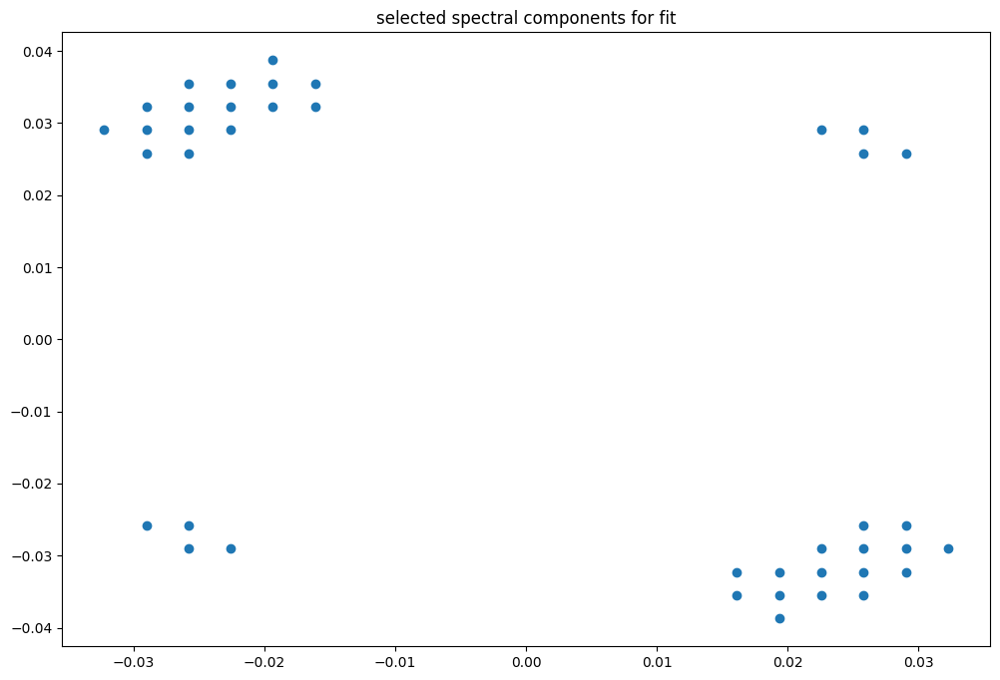

box [8000, 8500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

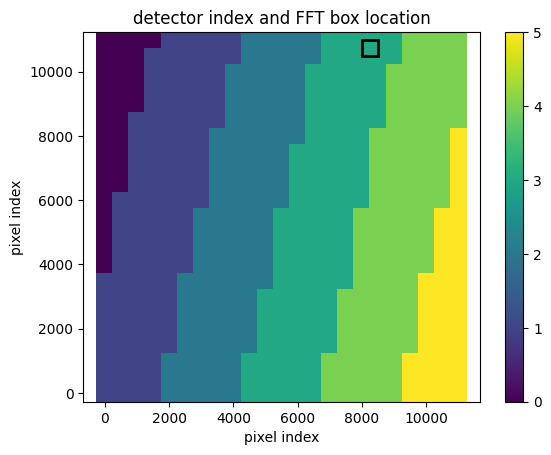

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(31, 30)
(31, 30)
(31, 30)


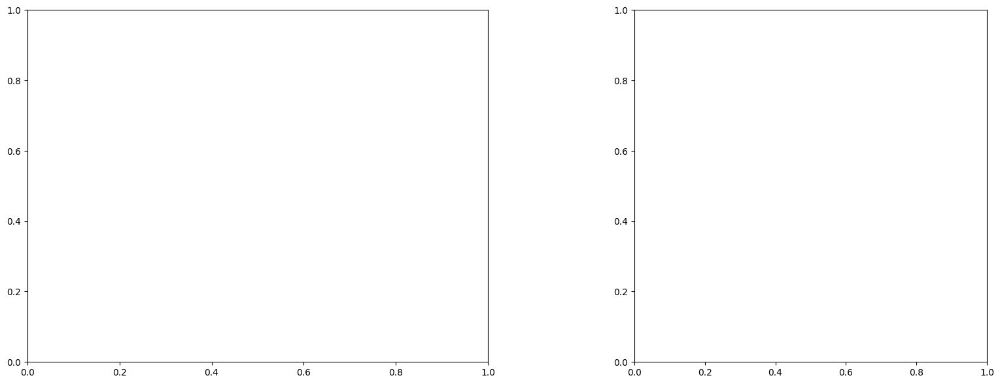

U and V components of current : [0.90682115 0.6384909 ]
uncertainties for U and V: 0.0805992828143434 0.061312882750781963


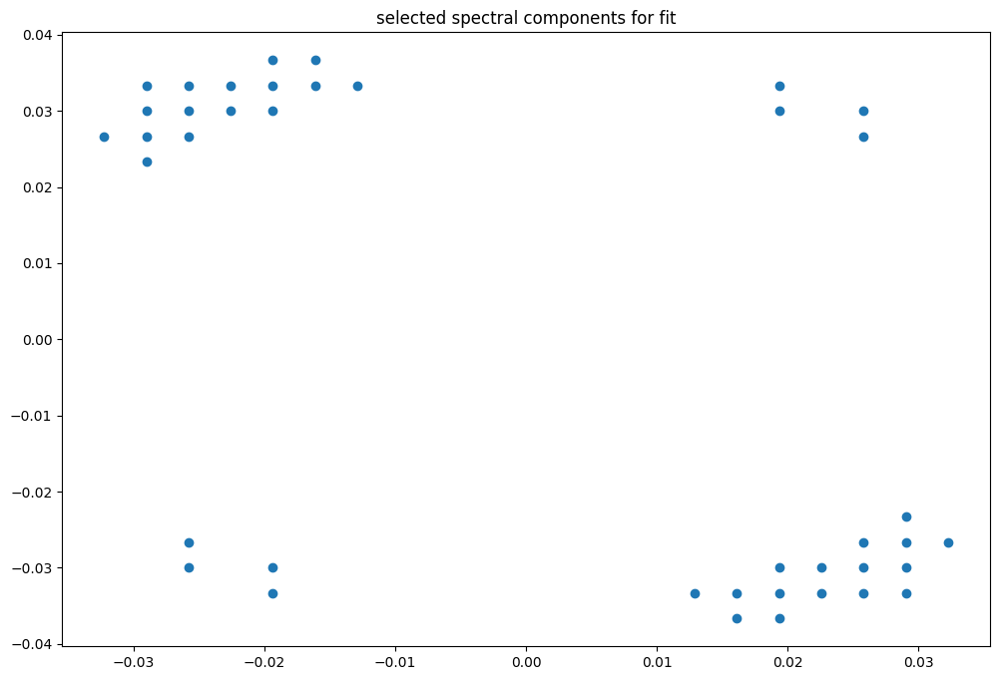

box [8500, 9000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

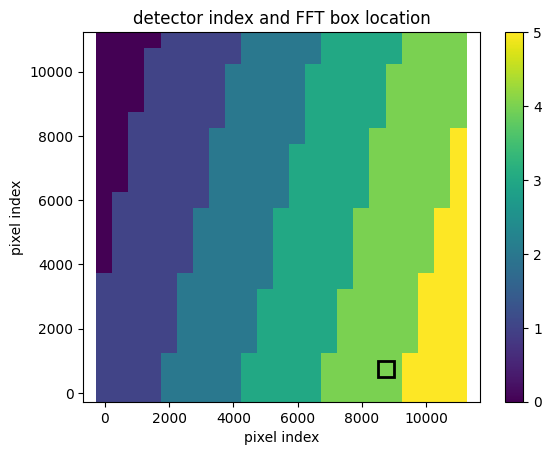

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


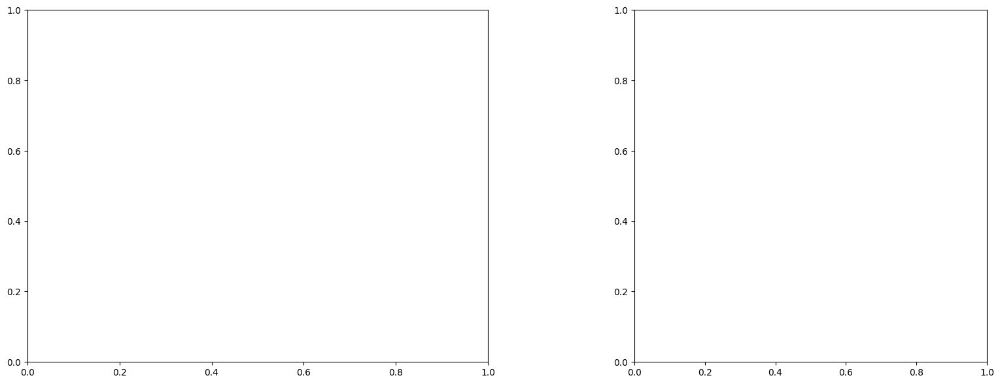

U and V components of current : [0.20311567 1.55159123]
uncertainties for U and V: 0.07850782787441428 0.1535585834476896


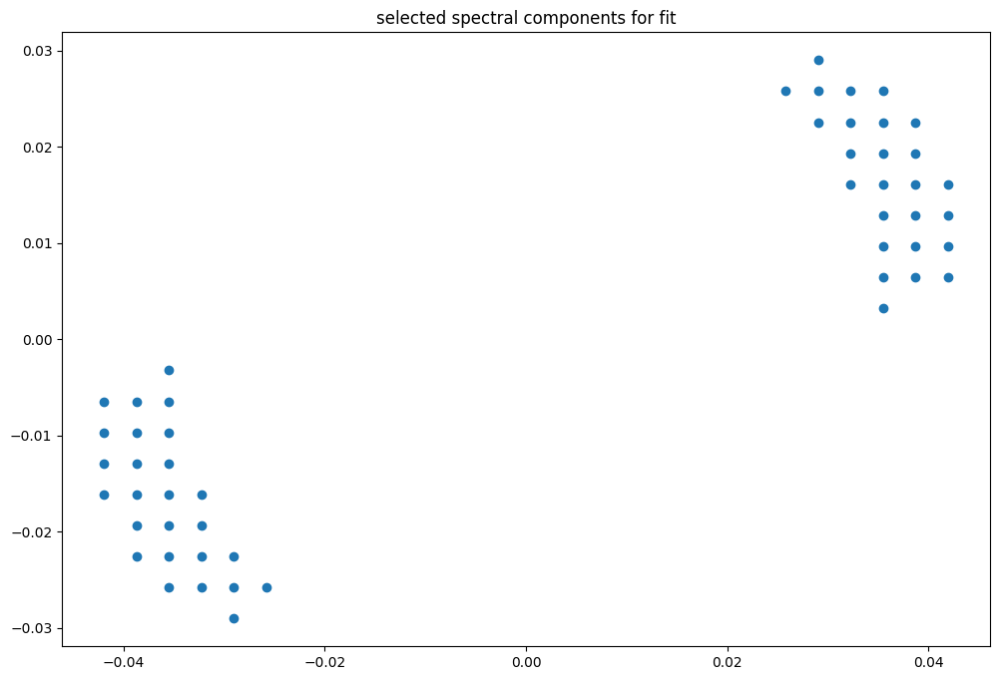

box [8500, 9000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

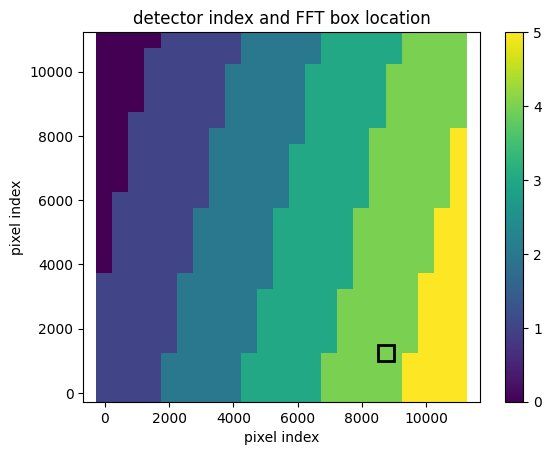

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


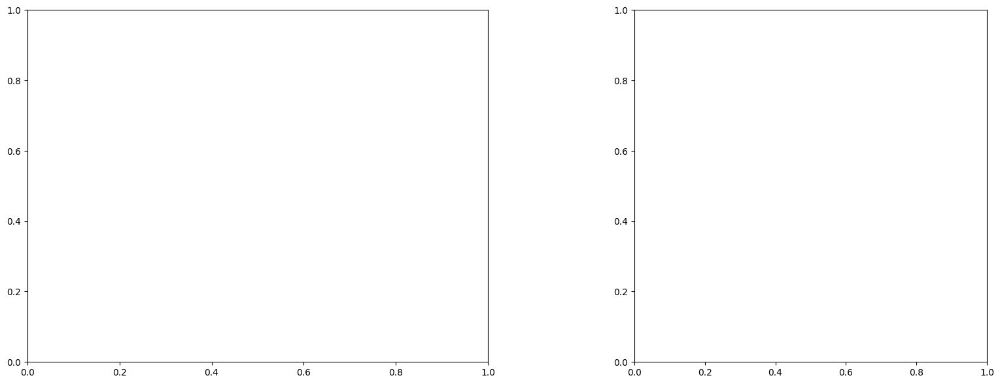

U and V components of current : [0.36083198 1.6843855 ]
uncertainties for U and V: 0.08204499107992985 0.14574752856260134


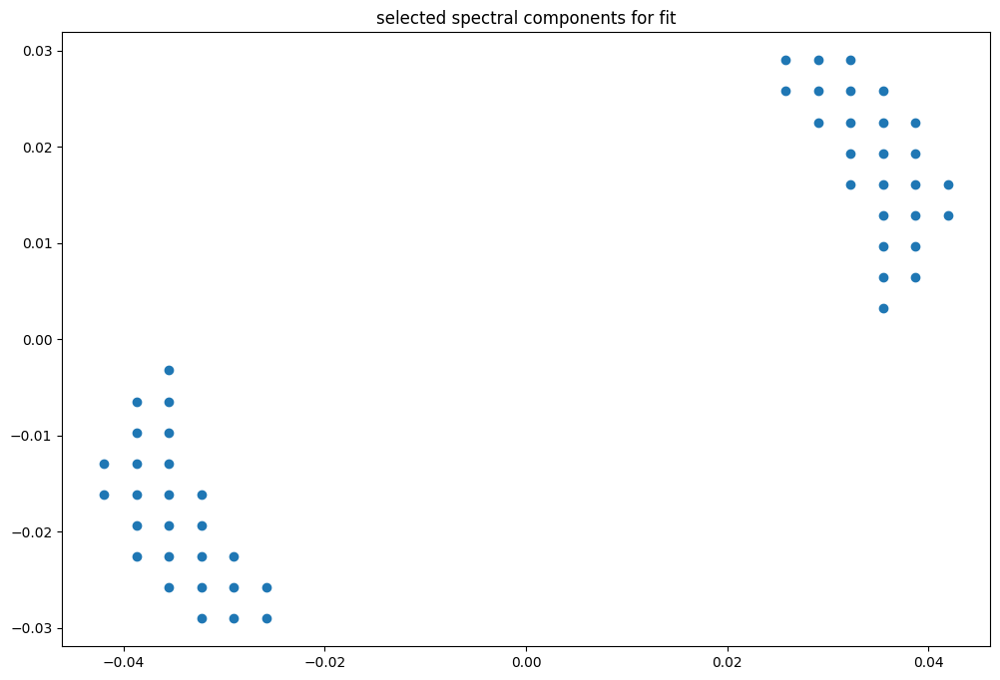

box [8500, 9000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

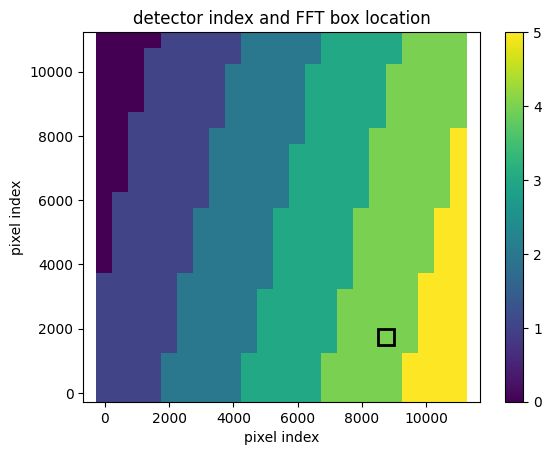

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


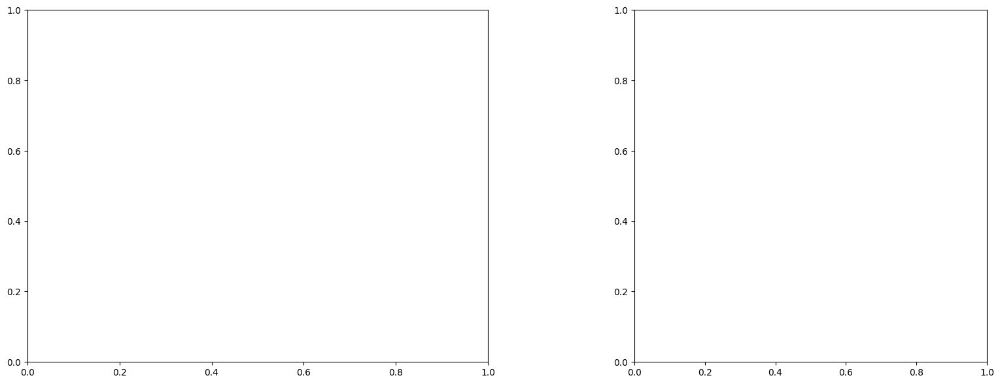

U and V components of current : [0.45309276 1.32614102]
uncertainties for U and V: 0.08665708282064796 0.15903795561776216


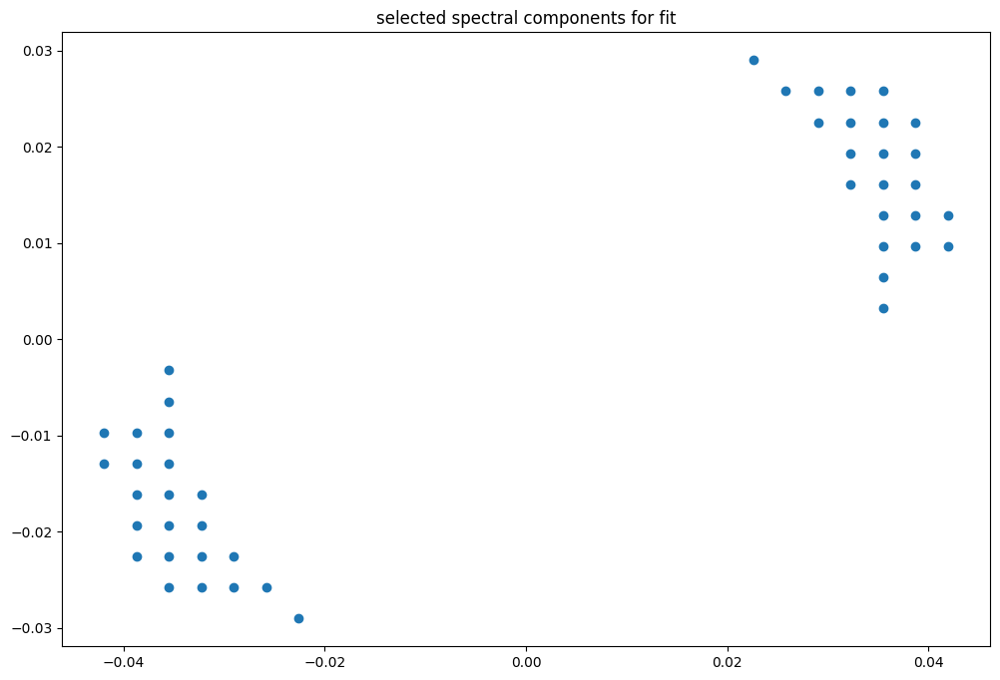

box [8500, 9000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

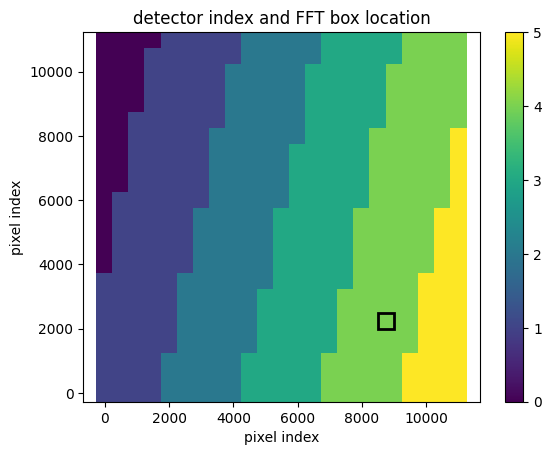

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


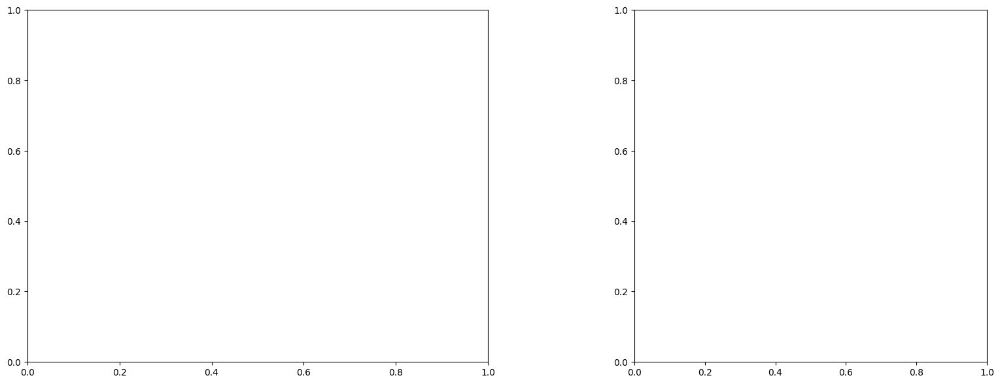

U and V components of current : [0.54534898 1.44827576]
uncertainties for U and V: 0.07923514184995725 0.14543275926653326


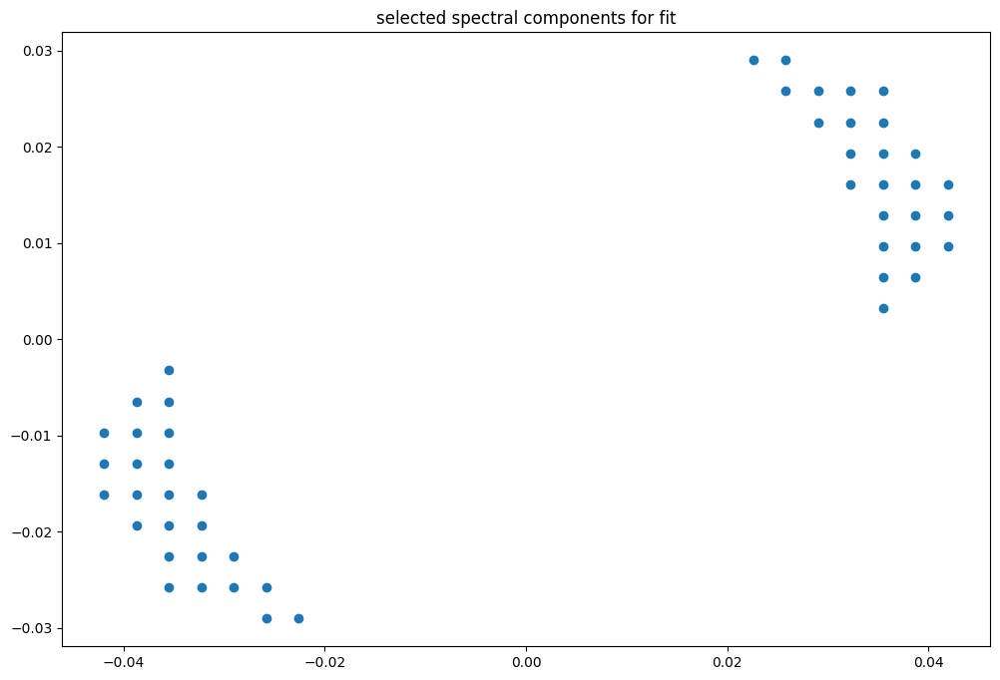

box [8500, 9000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

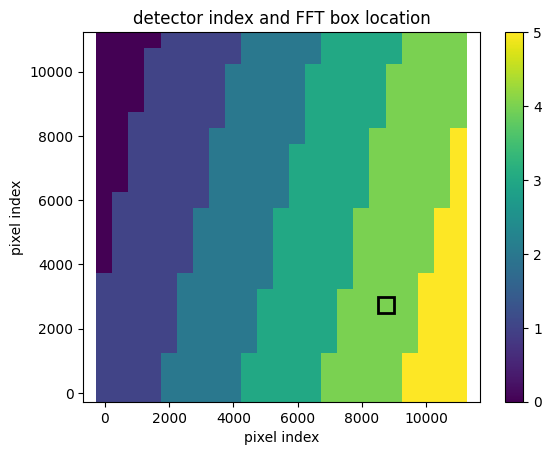

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


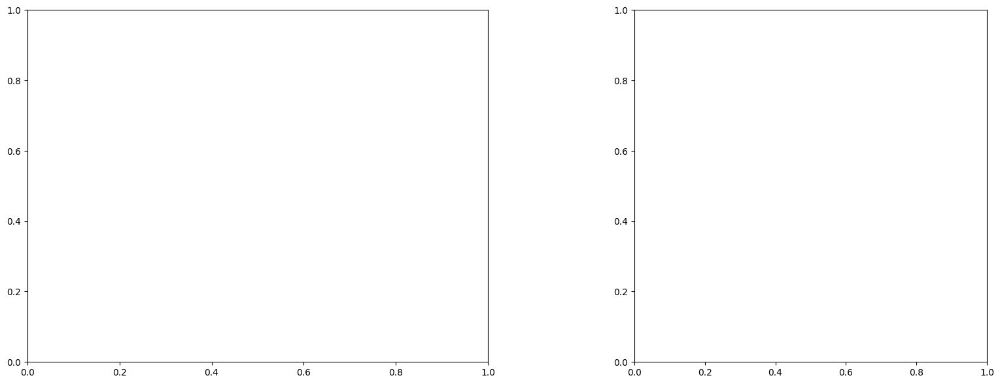

U and V components of current : [0.62101254 1.42399273]
uncertainties for U and V: 0.07895927768586485 0.13350215143213875


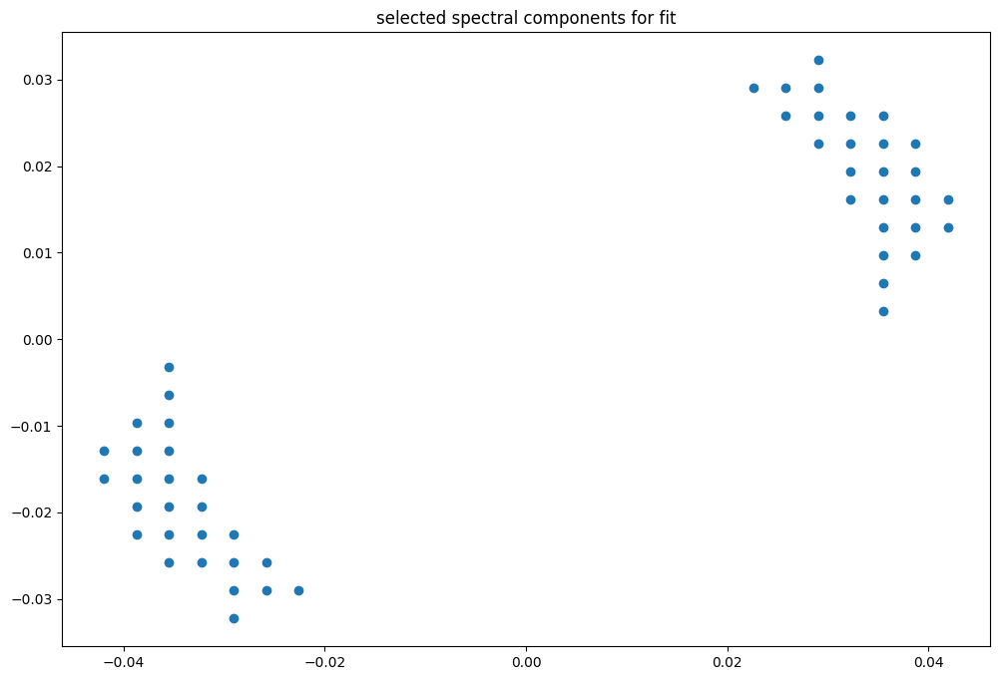

box [8500, 9000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

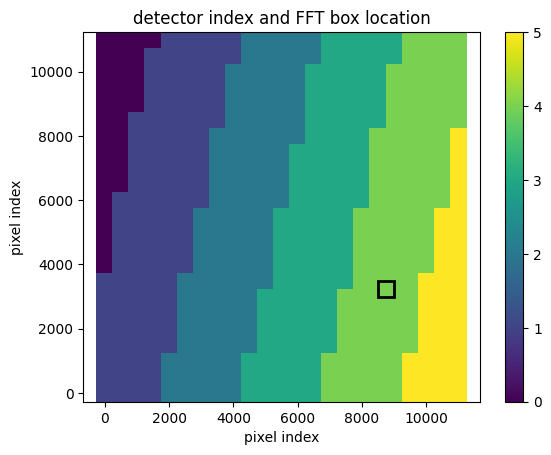

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


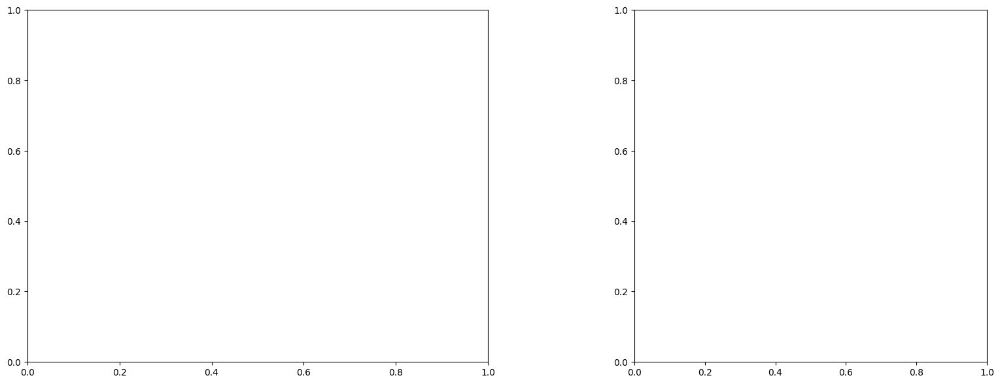

U and V components of current : [0.80199126 1.08908804]
uncertainties for U and V: 0.0663625278015363 0.10970008528940199


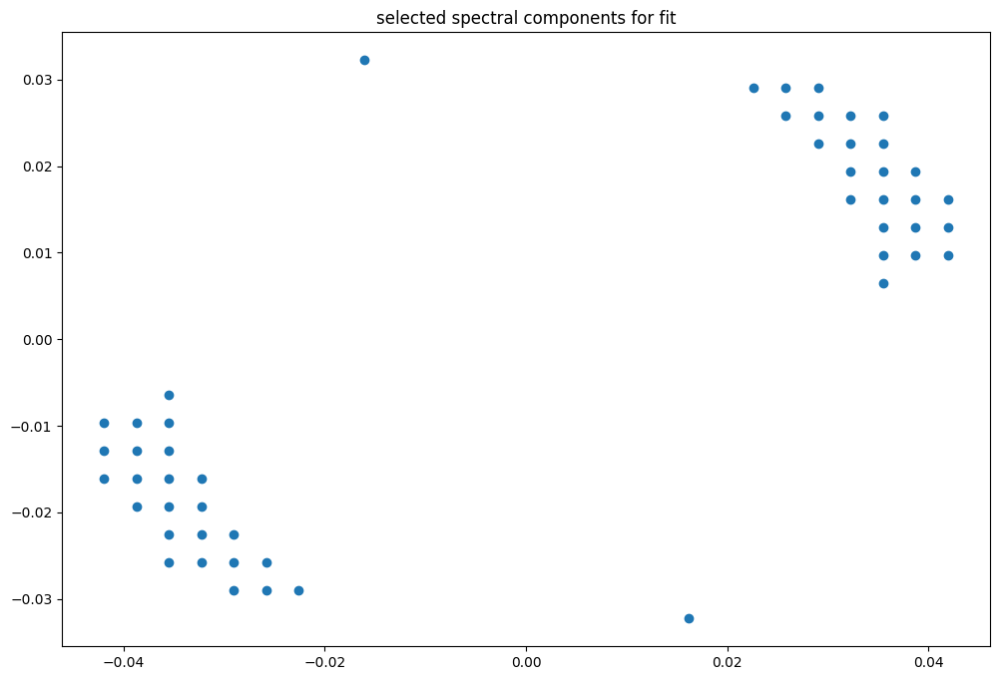

box [8500, 9000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

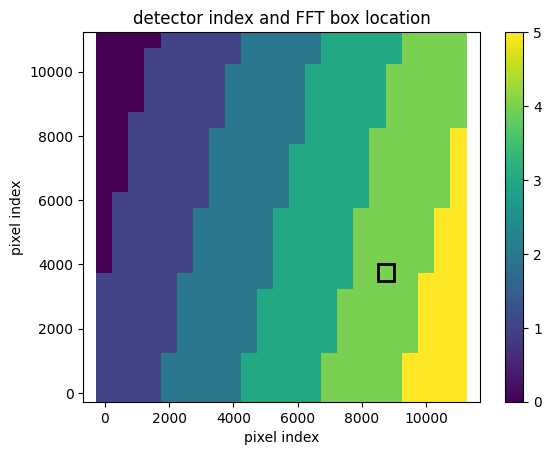

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


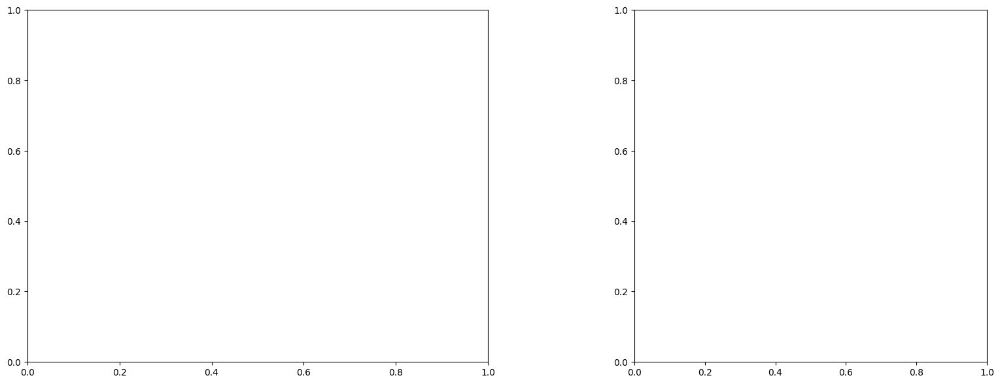

U and V components of current : [0.39072859 1.78950089]
uncertainties for U and V: 0.07994631254761855 0.13542065761319155


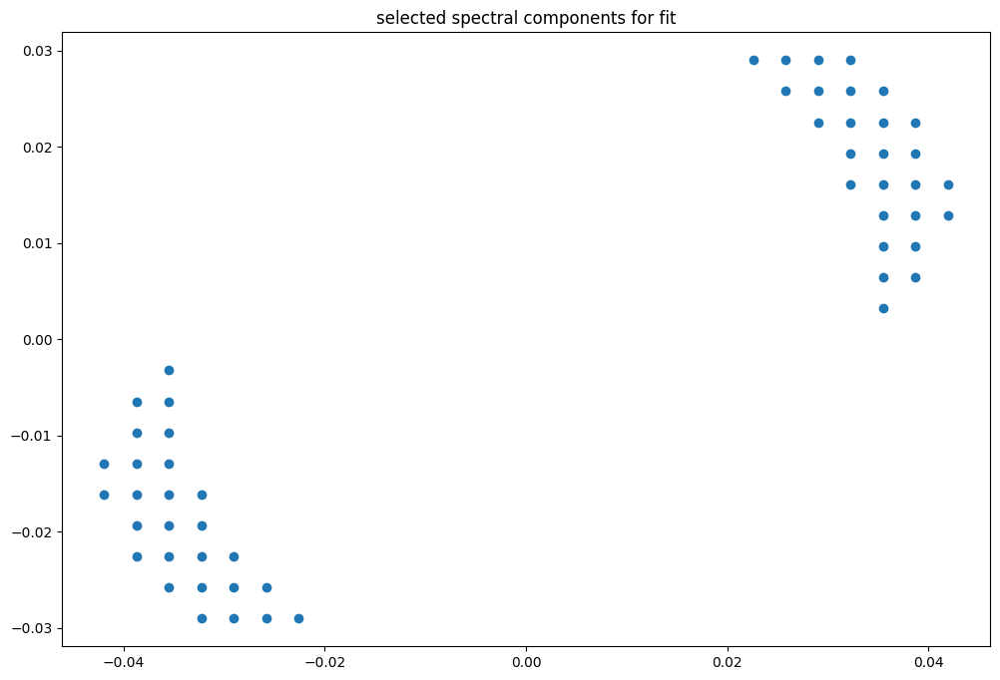

box [8500, 9000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

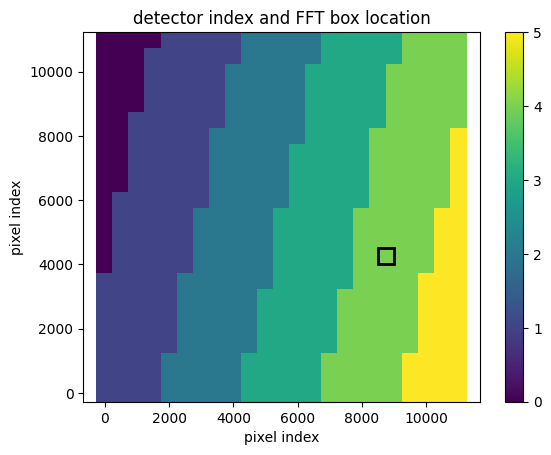

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


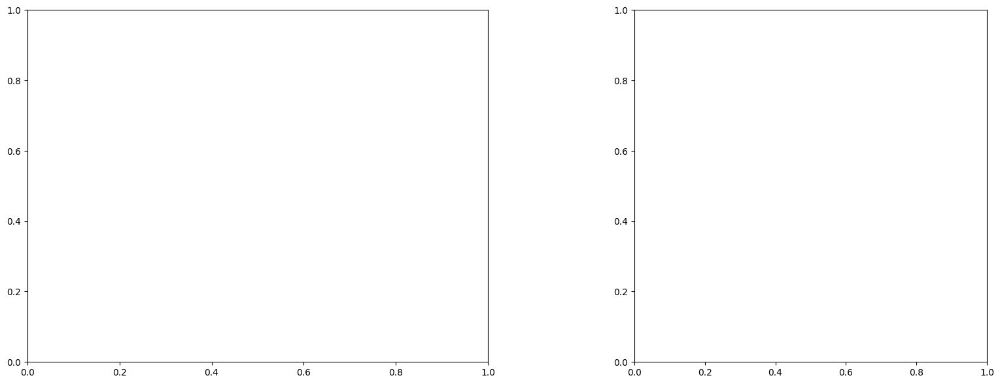

U and V components of current : [0.63598745 1.36004042]
uncertainties for U and V: 0.06988650119170005 0.11255095848203321


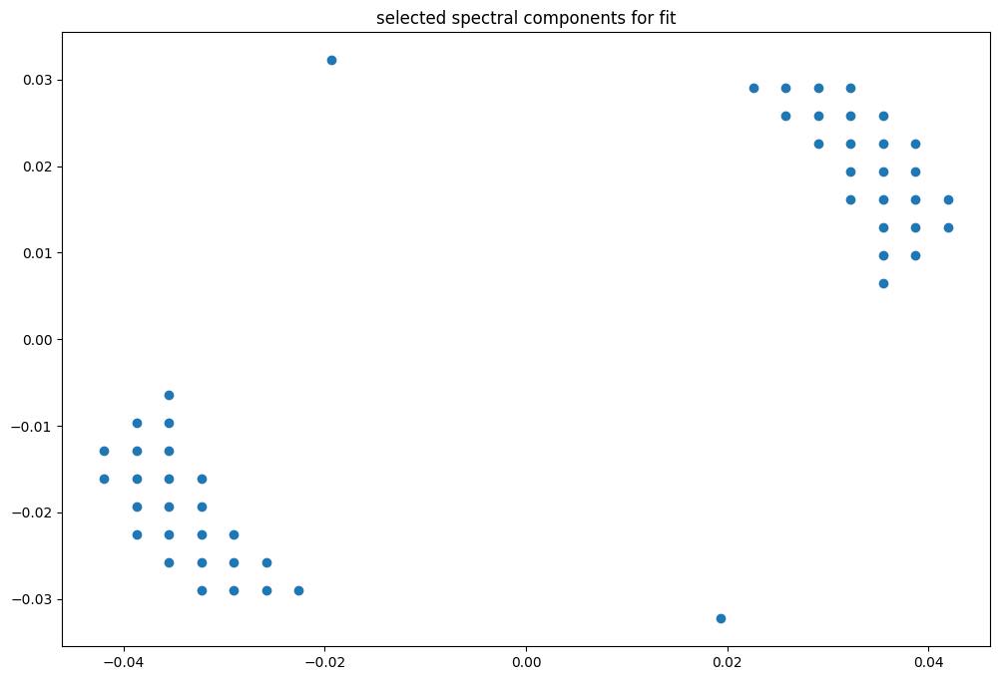

box [8500, 9000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

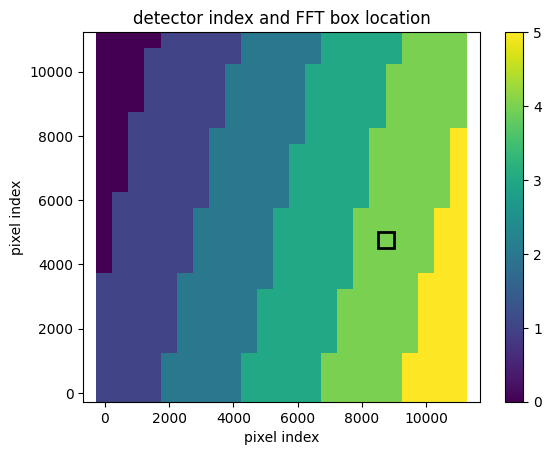

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


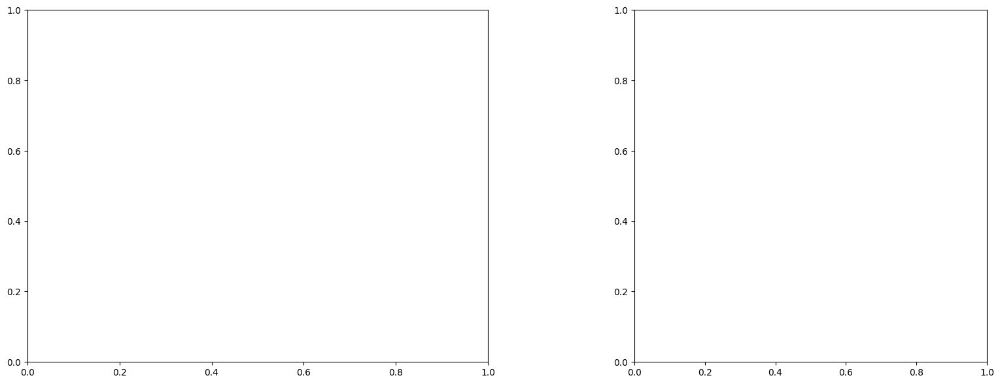

U and V components of current : [0.80683527 1.15931078]
uncertainties for U and V: 0.09855353966292384 0.159208620581262


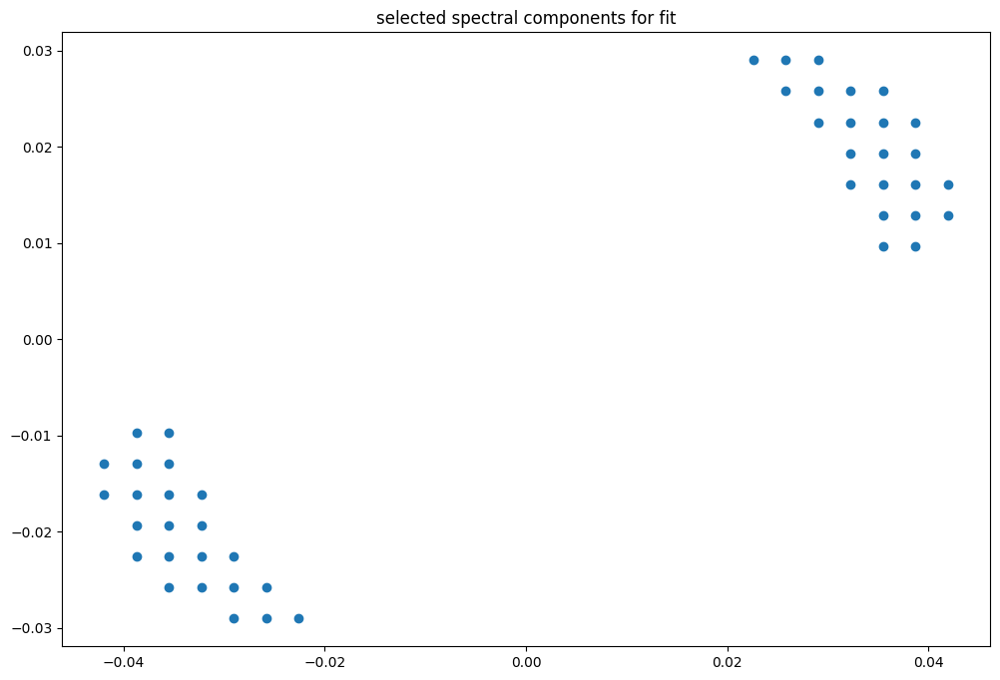

box [8500, 9000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

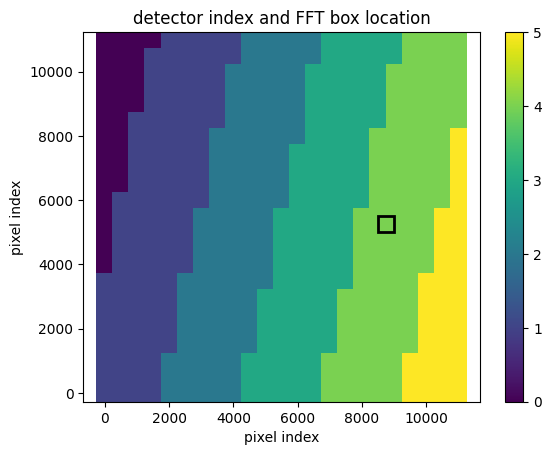

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


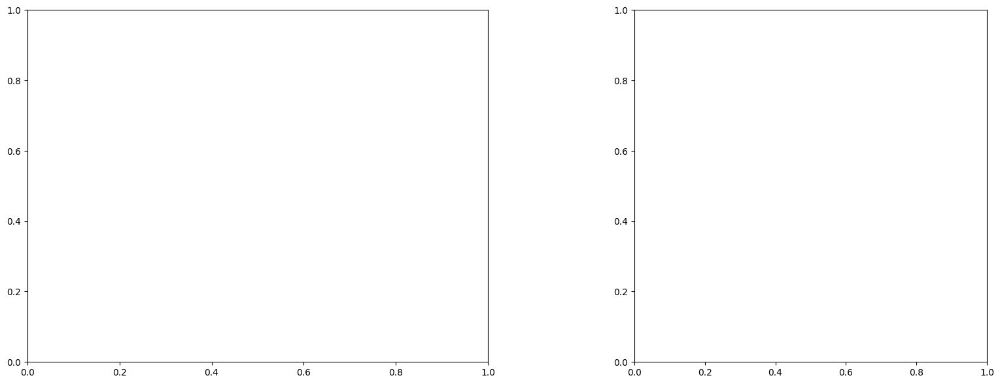

U and V components of current : [0.47582464 1.51000813]
uncertainties for U and V: 0.10224968919117089 0.14813343544861882


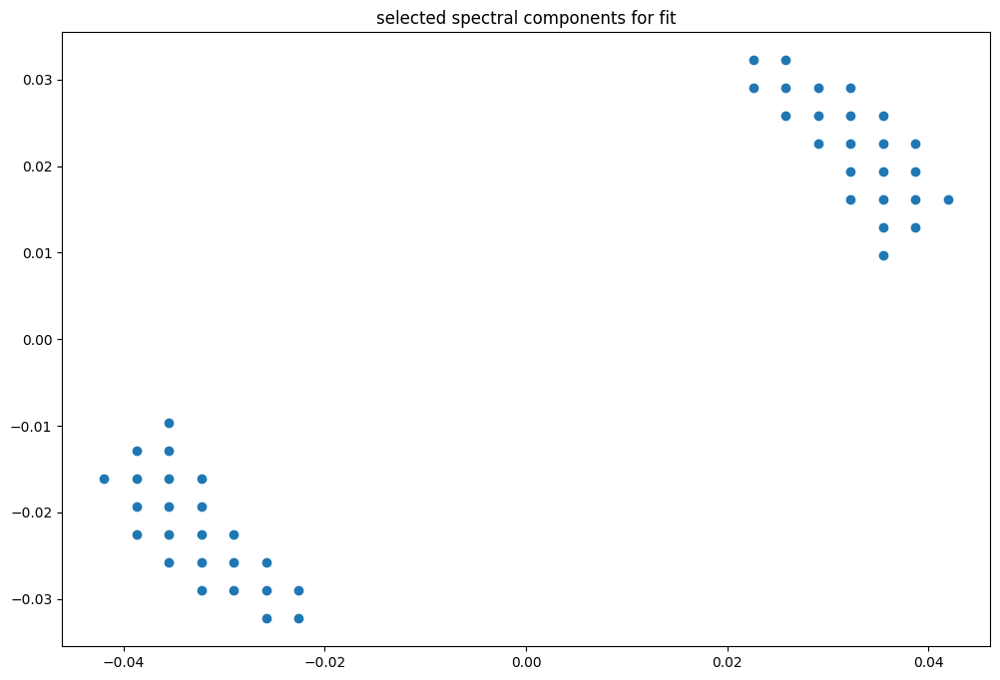

box [8500, 9000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

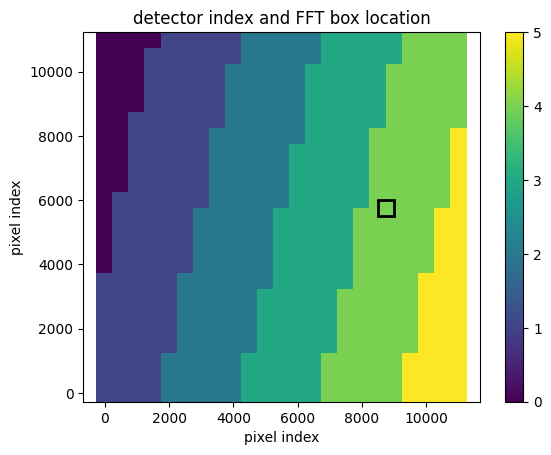

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


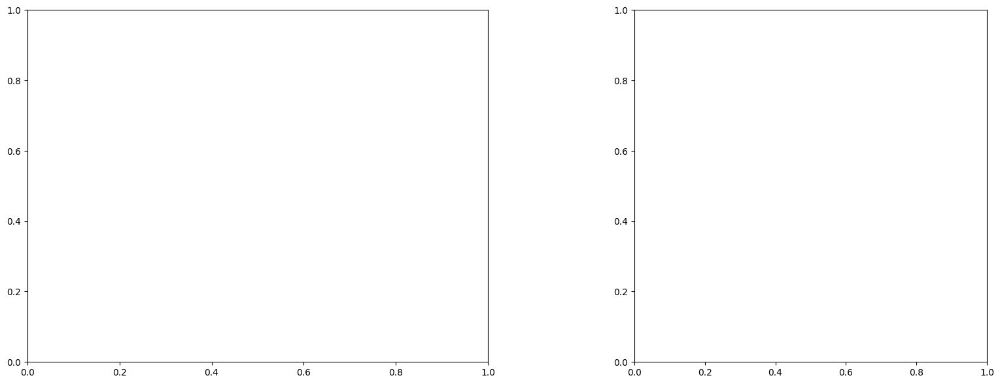

U and V components of current : [0.88755371 1.39544569]
uncertainties for U and V: 0.08302532881193687 0.11847929416598567


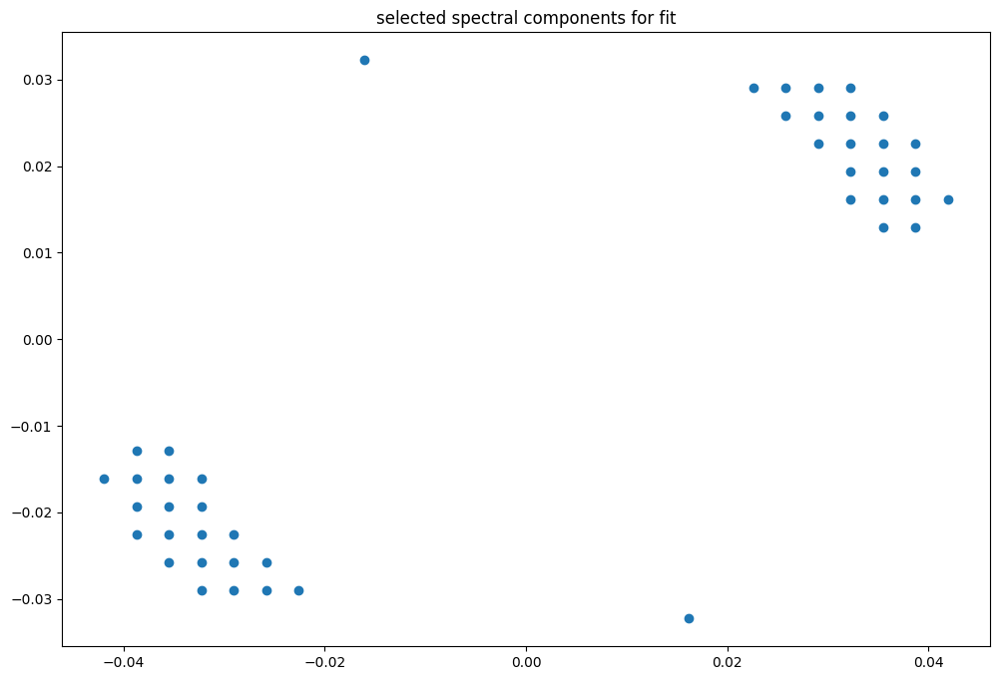

box [8500, 9000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

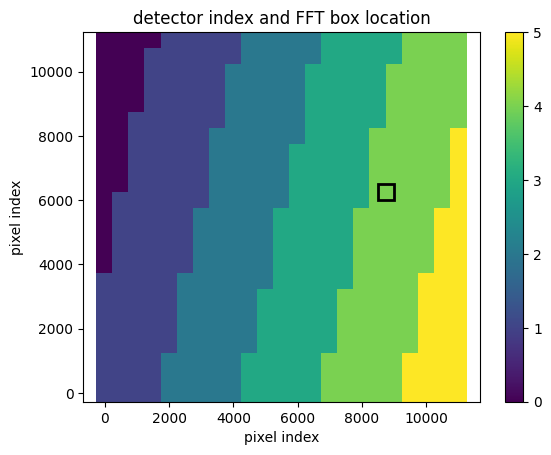

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


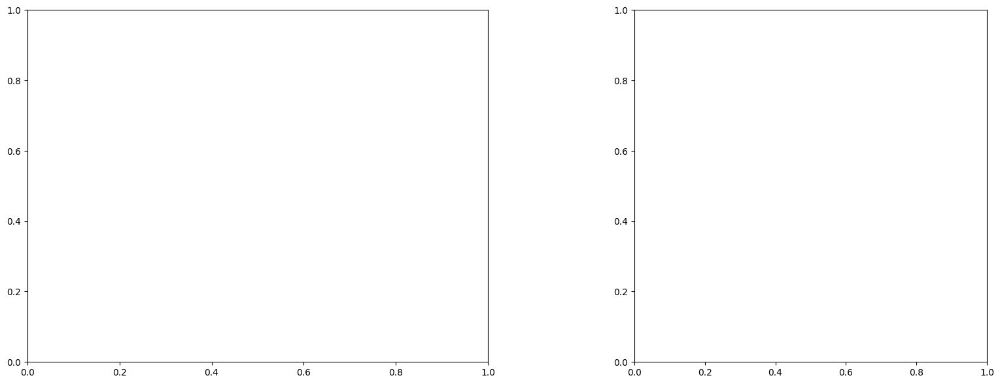

U and V components of current : [0.64654814 1.74000235]
uncertainties for U and V: 0.1188576975927843 0.15508133596966167


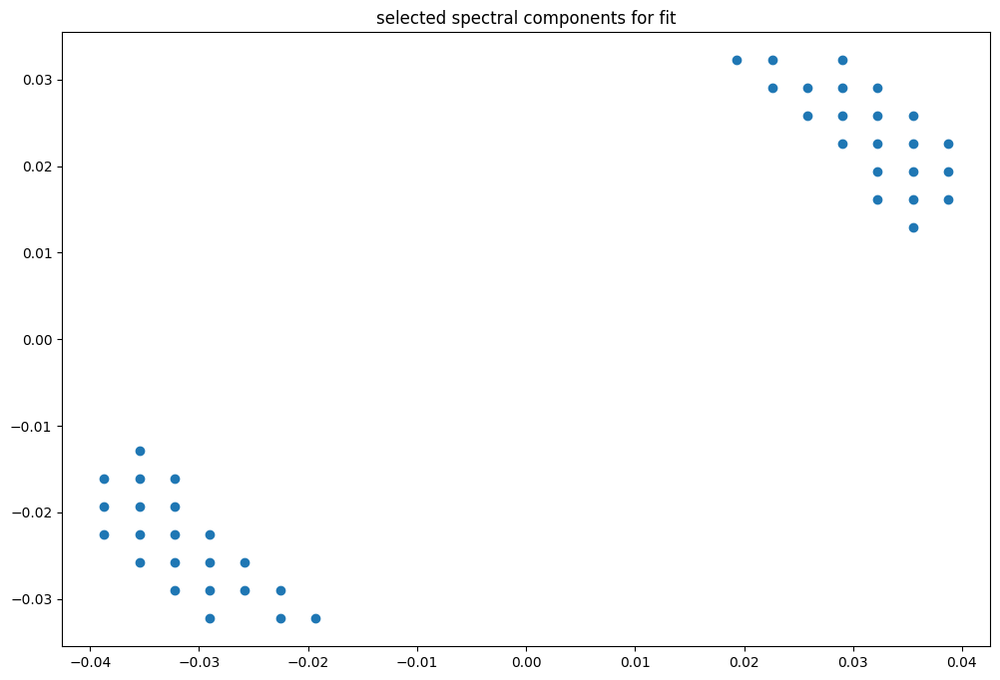

box [8500, 9000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

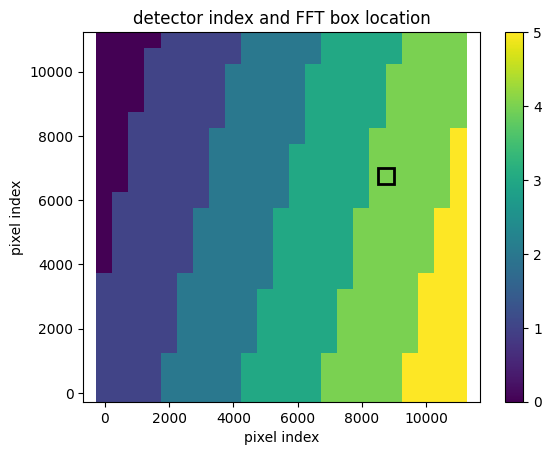

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


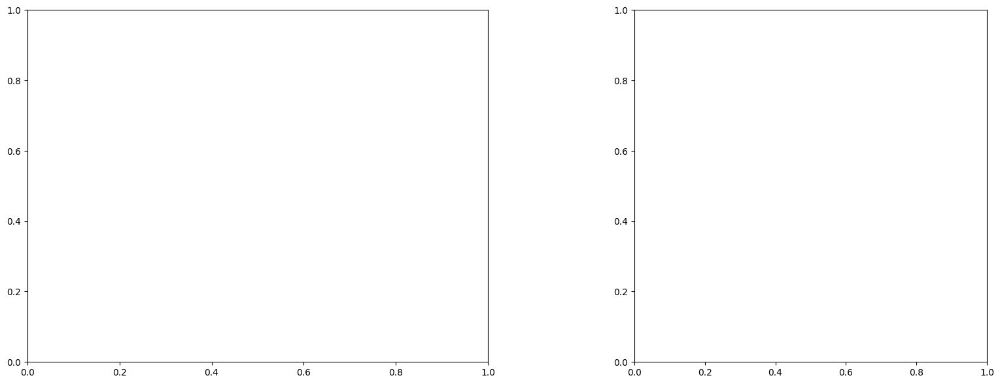

U and V components of current : [0.74872468 1.60613592]
uncertainties for U and V: 0.06396544839147839 0.08537453674542124


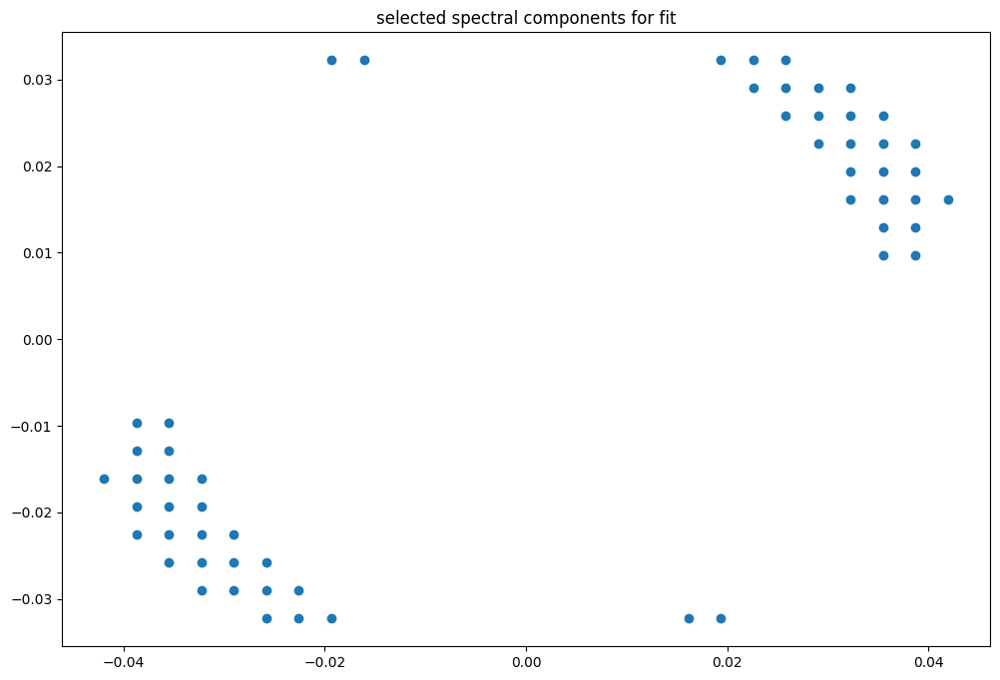

box [8500, 9000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

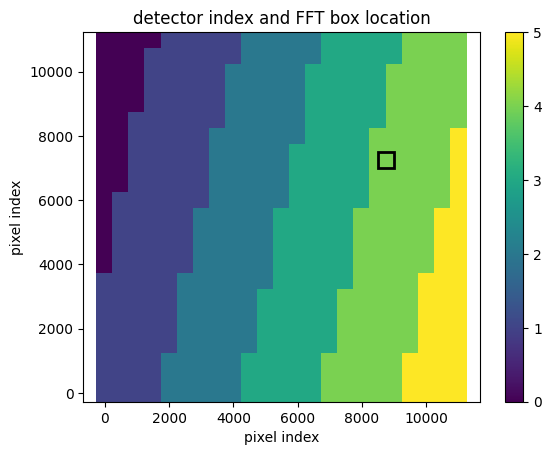

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


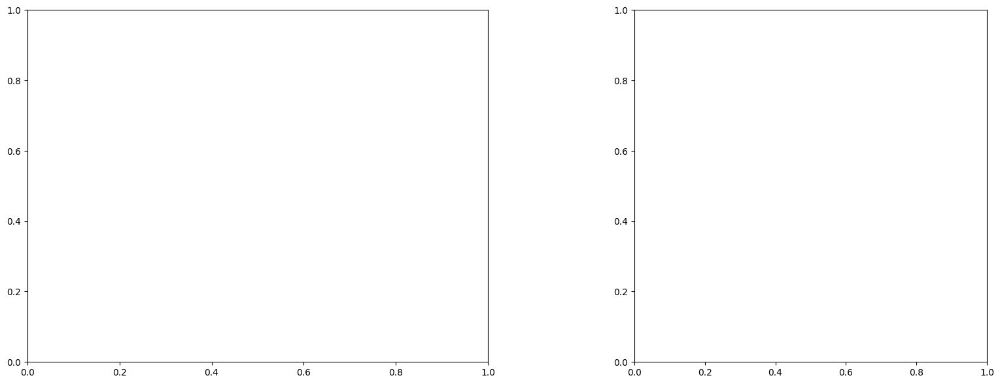

U and V components of current : [1.0517199  1.18254064]
uncertainties for U and V: 0.0740174927163835 0.07847637496299346


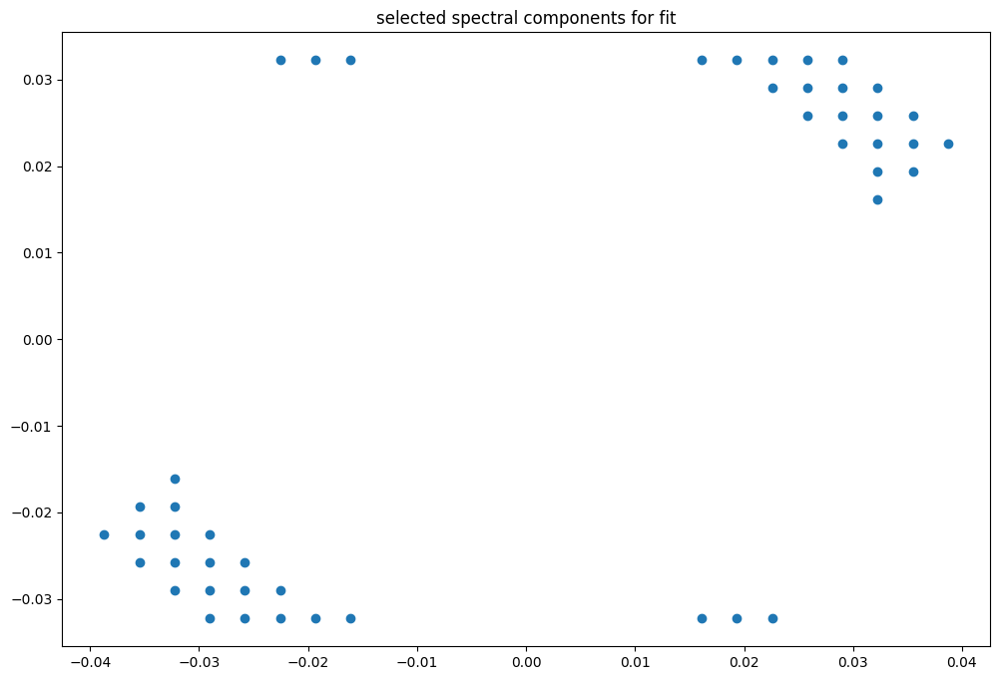

box [8500, 9000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

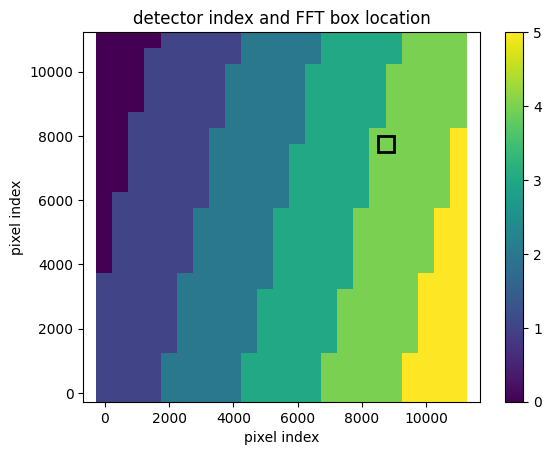

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


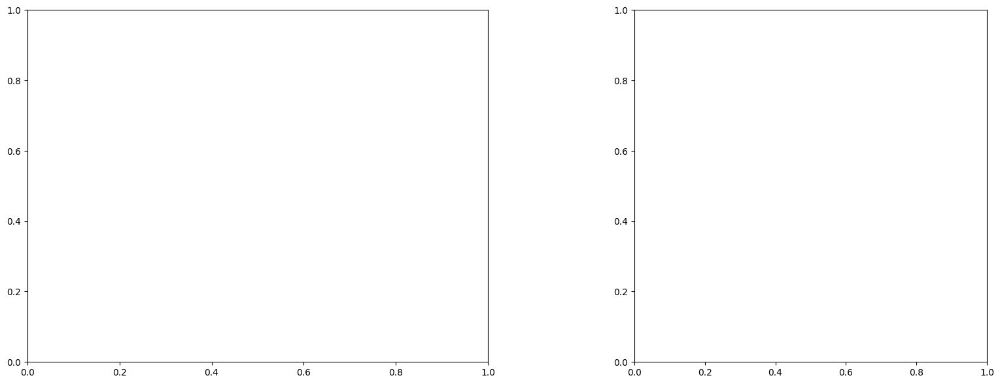

U and V components of current : [1.03678065 1.25594088]
uncertainties for U and V: 0.13396033299217777 0.141269519655139


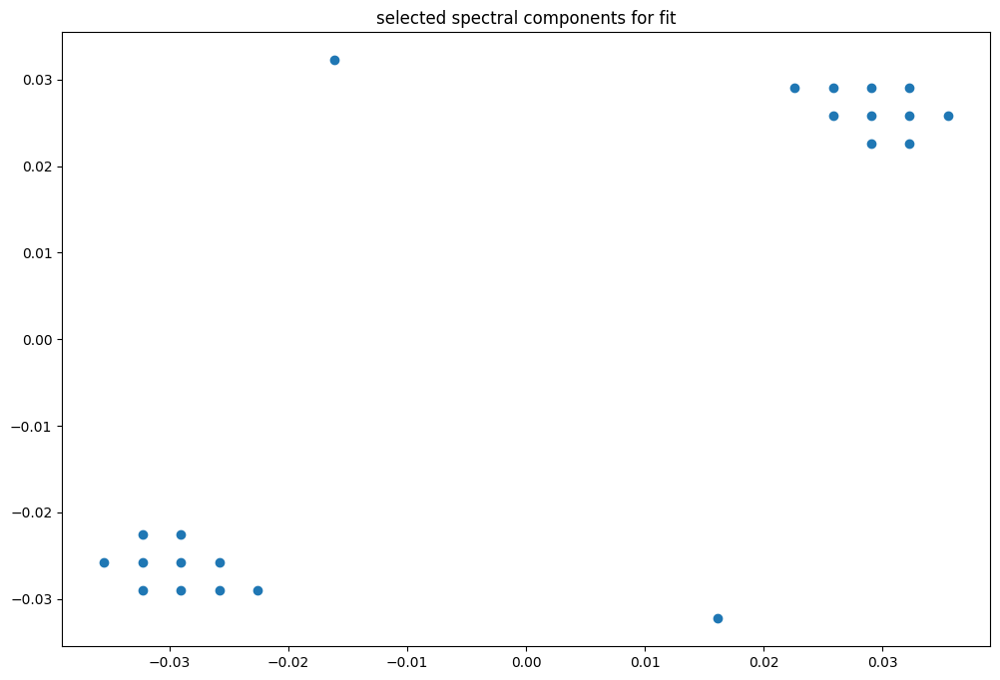

box [8500, 9000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

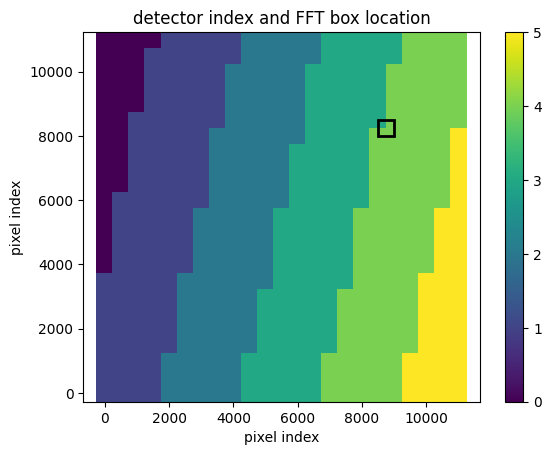

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


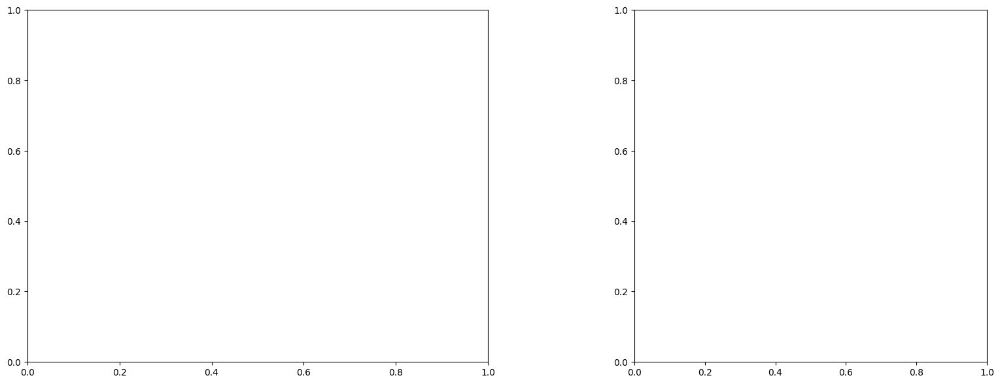

LinAlgError: Singular matrix

box [8500, 9000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

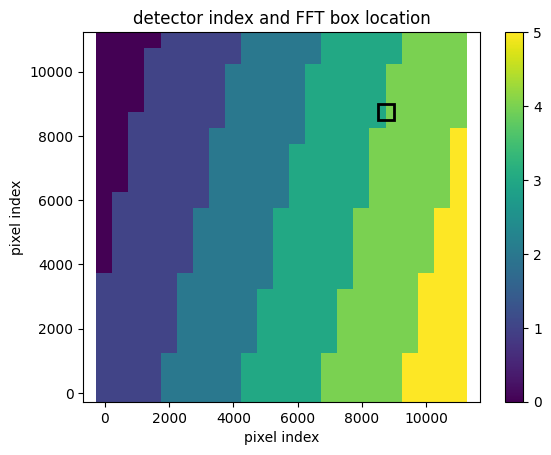

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(31, 31)
(31, 31)
(31, 31)


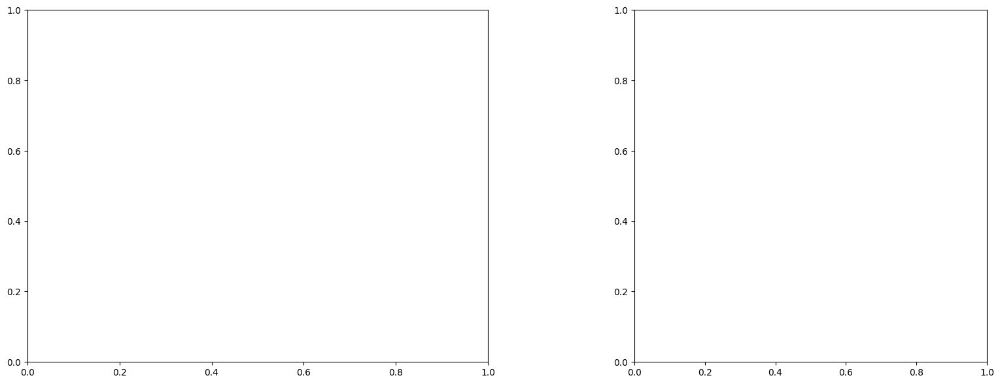

LinAlgError: Singular matrix

box [8500, 9000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

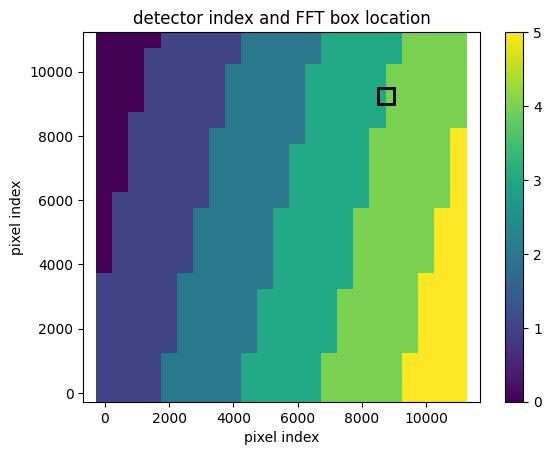

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


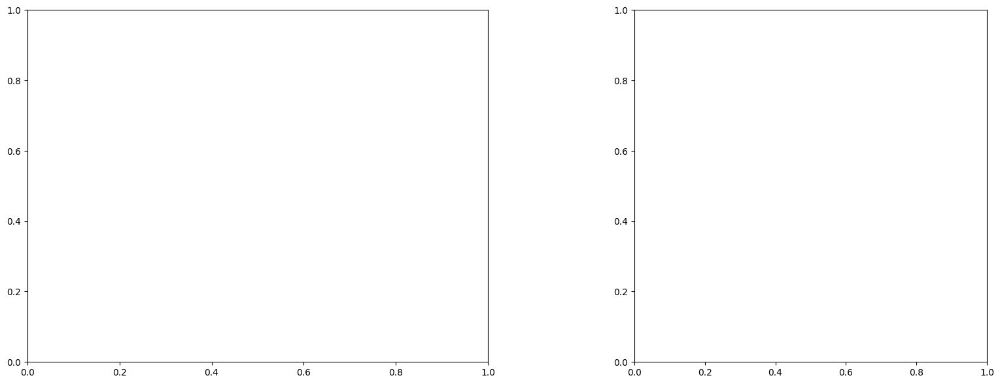

LinAlgError: Singular matrix

box [8500, 9000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

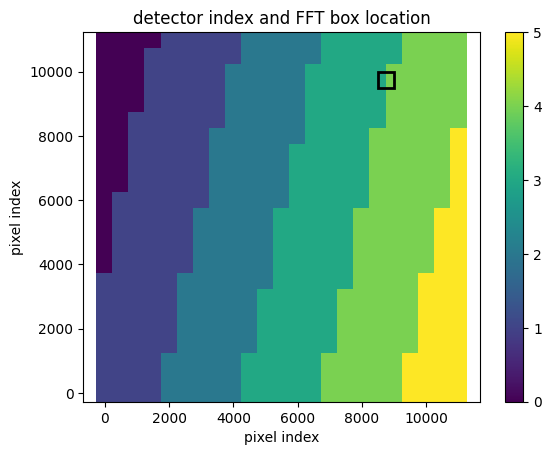

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(31, 31)
(31, 31)
(31, 31)


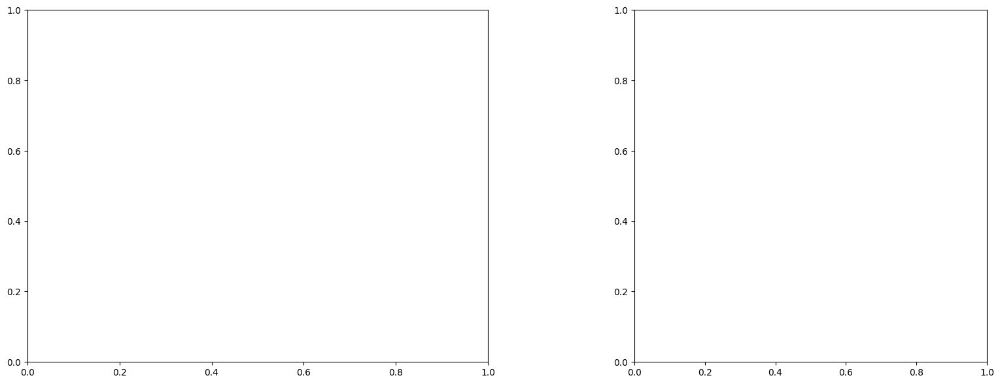

LinAlgError: Singular matrix

box [8500, 9000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

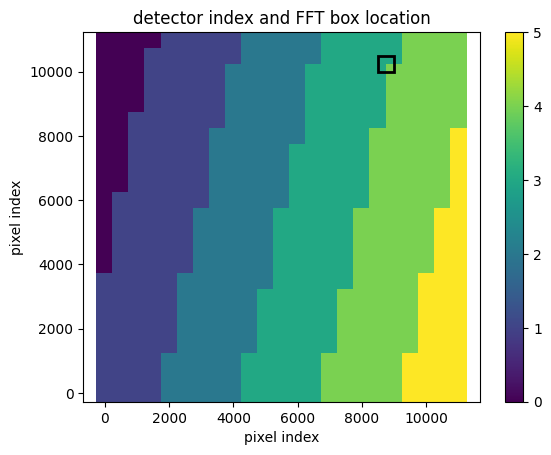

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(31, 31)
(31, 31)
(31, 31)


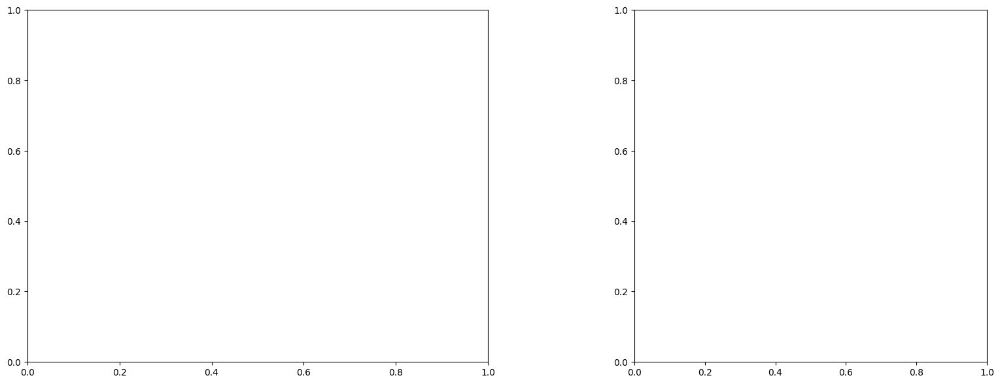

U and V components of current : [0.8108648  0.73098187]
uncertainties for U and V: 0.0566030836715656 0.046887169723595176


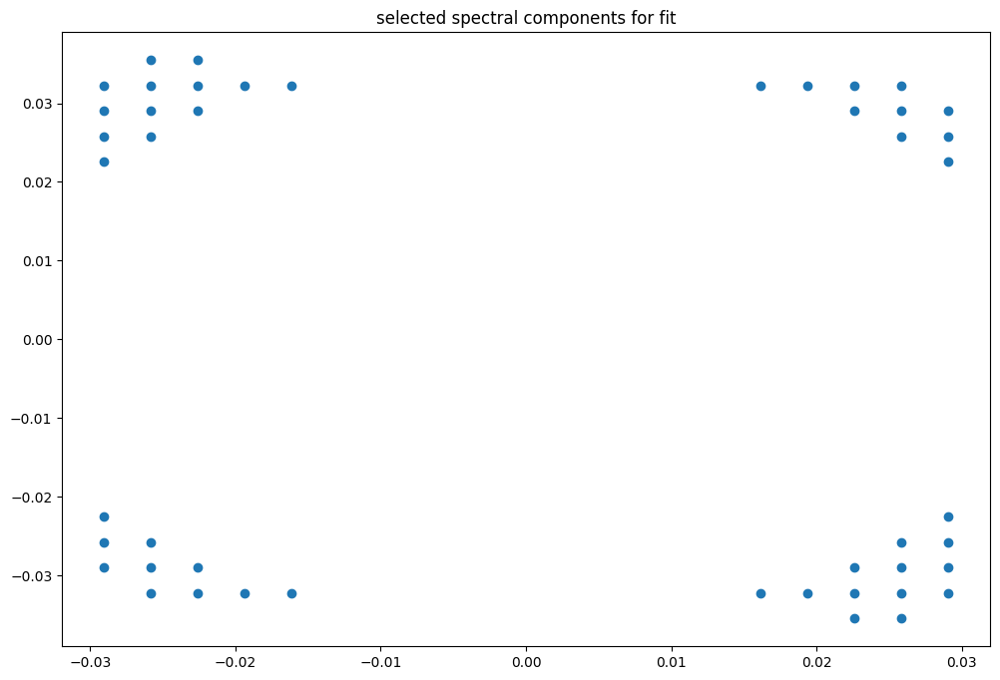

box [8500, 9000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

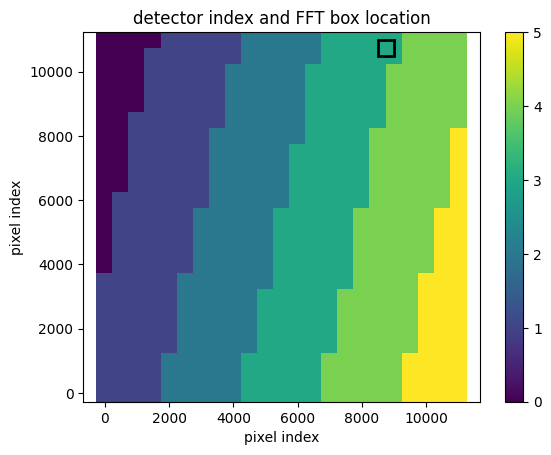

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(31, 30)
(31, 30)
(31, 30)


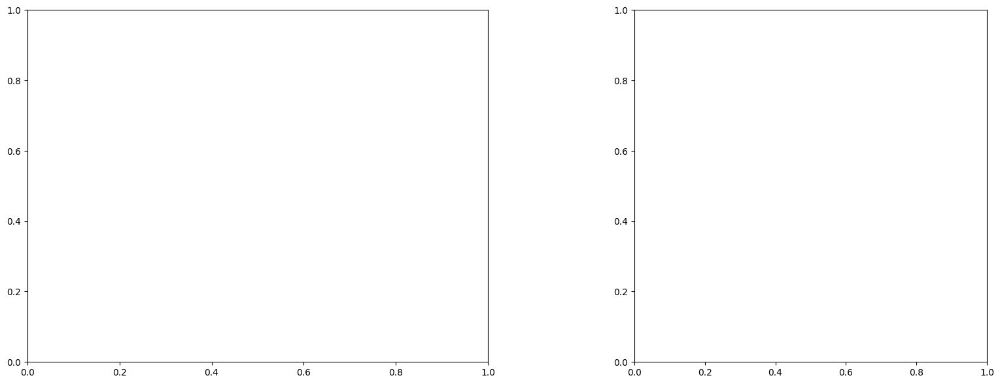

U and V components of current : [0.8987051  0.56516079]
uncertainties for U and V: 0.10688580562077481 0.08177500830069356


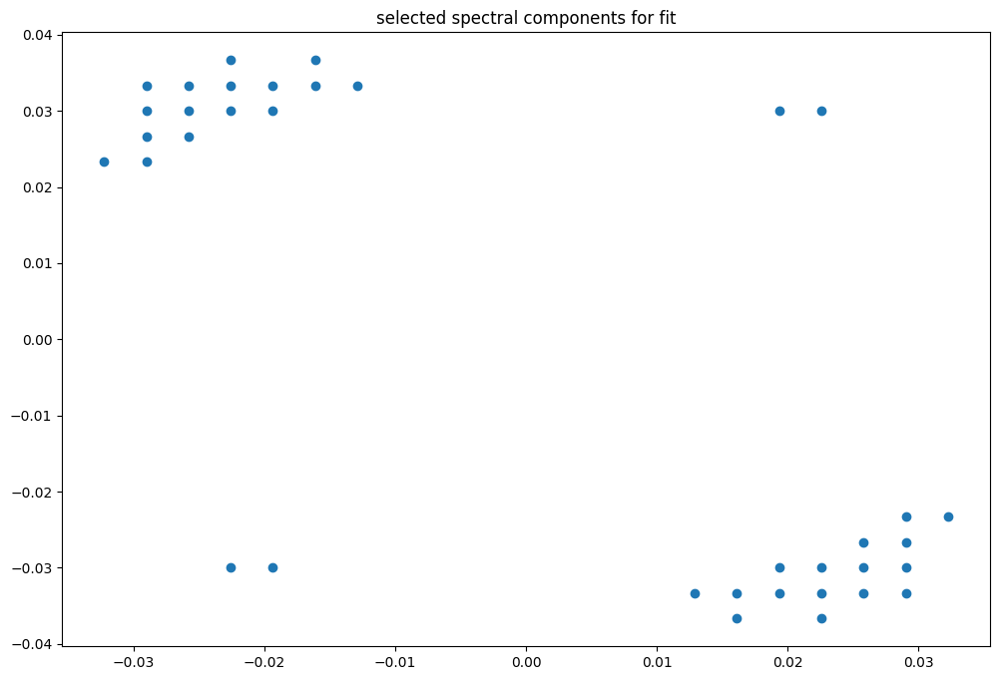

box [9000, 9500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading 

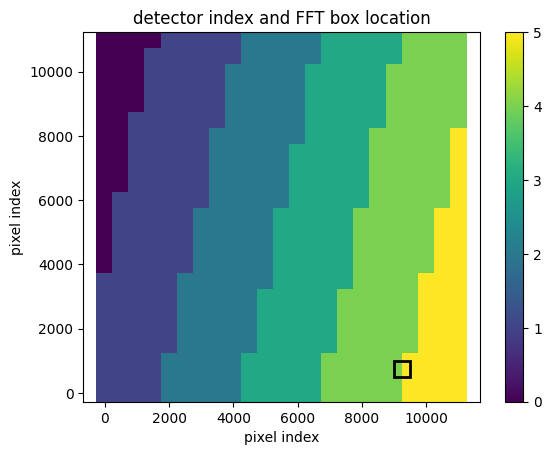

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.500000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876730752059386
(31, 31)
(31, 31)
(31, 31)


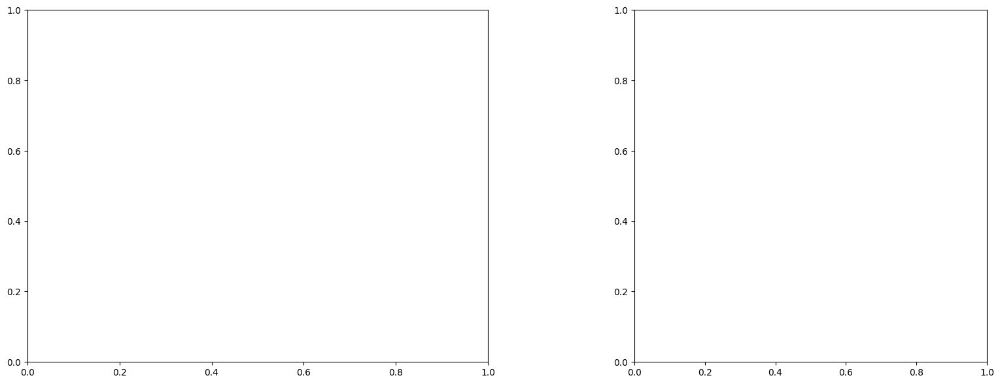

U and V components of current : [-0.46369525 -1.62324593]
uncertainties for U and V: 0.4030860993092279 0.7352898089603173


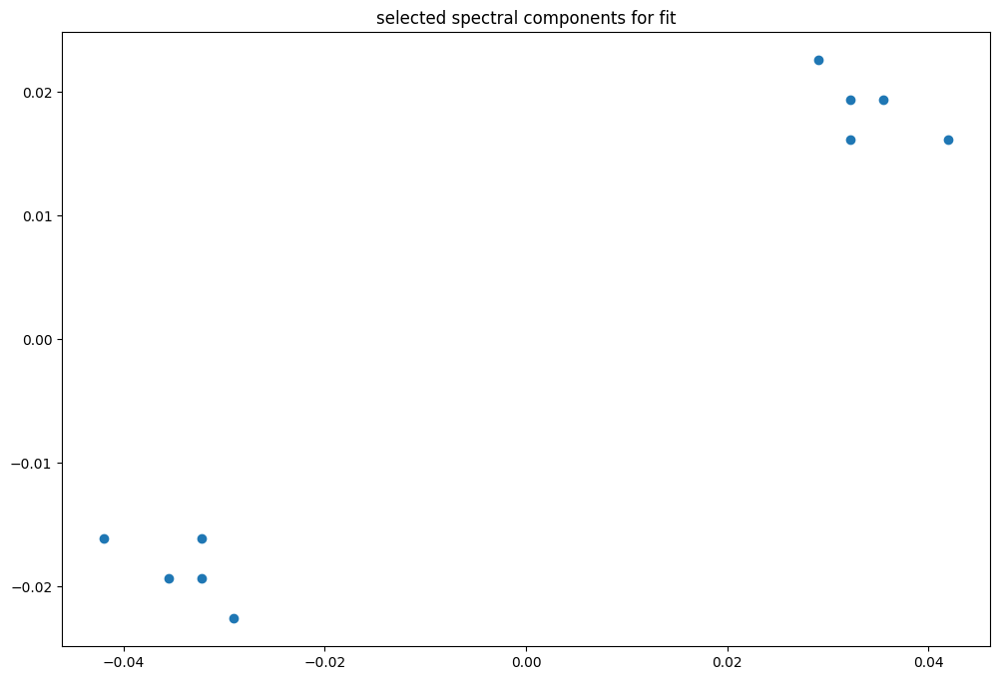

box [9000, 9500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

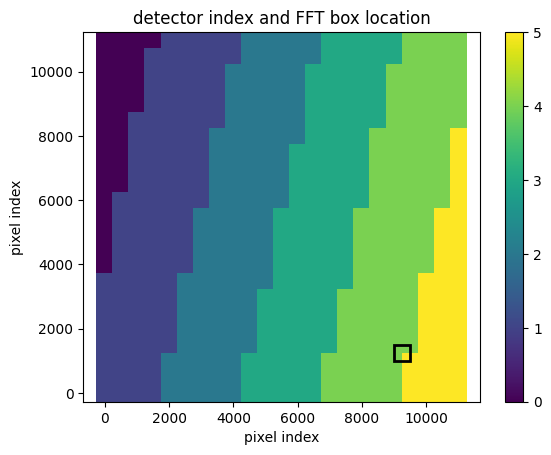

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987353684535256
(31, 31)
(31, 31)
(31, 31)


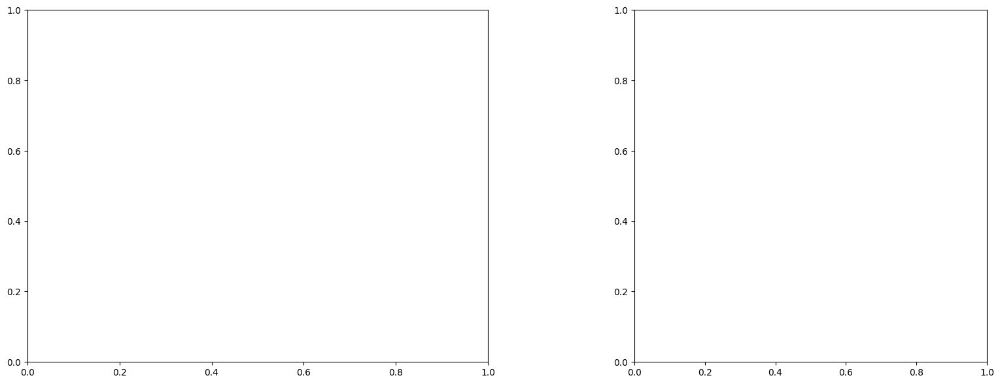

U and V components of current : [0.57834454 1.1696873 ]
uncertainties for U and V: 0.06969165302696897 0.12982864013245596


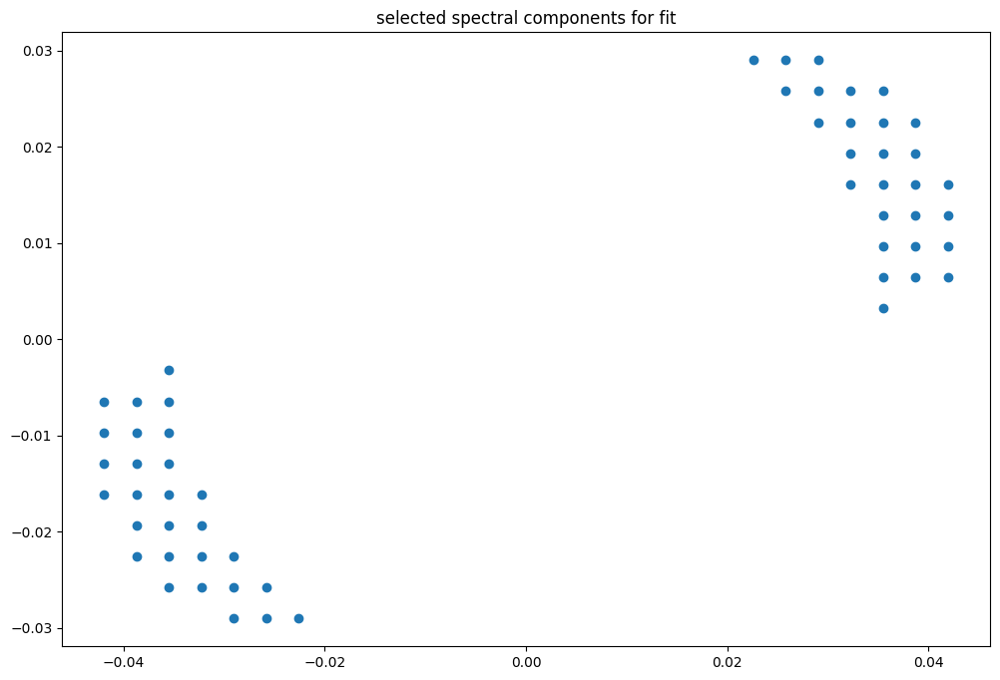

box [9000, 9500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

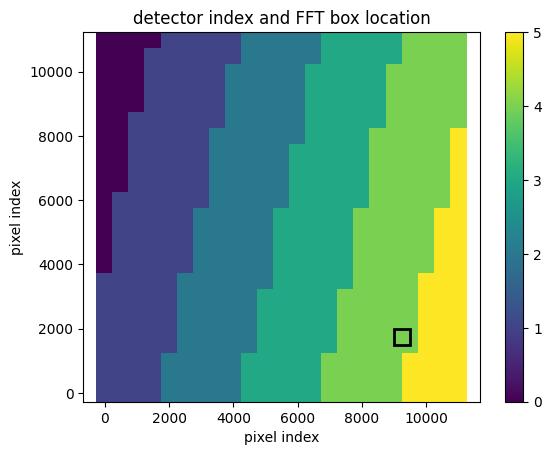

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


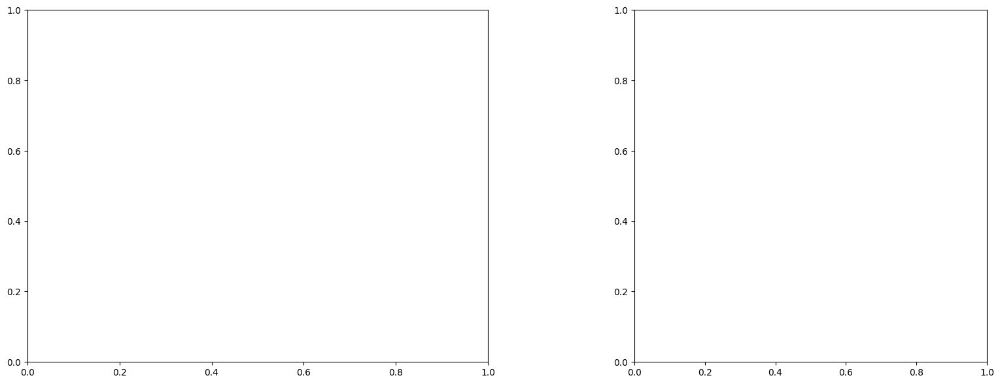

U and V components of current : [0.5927159  1.10729109]
uncertainties for U and V: 0.06851175739726978 0.12976941102032913


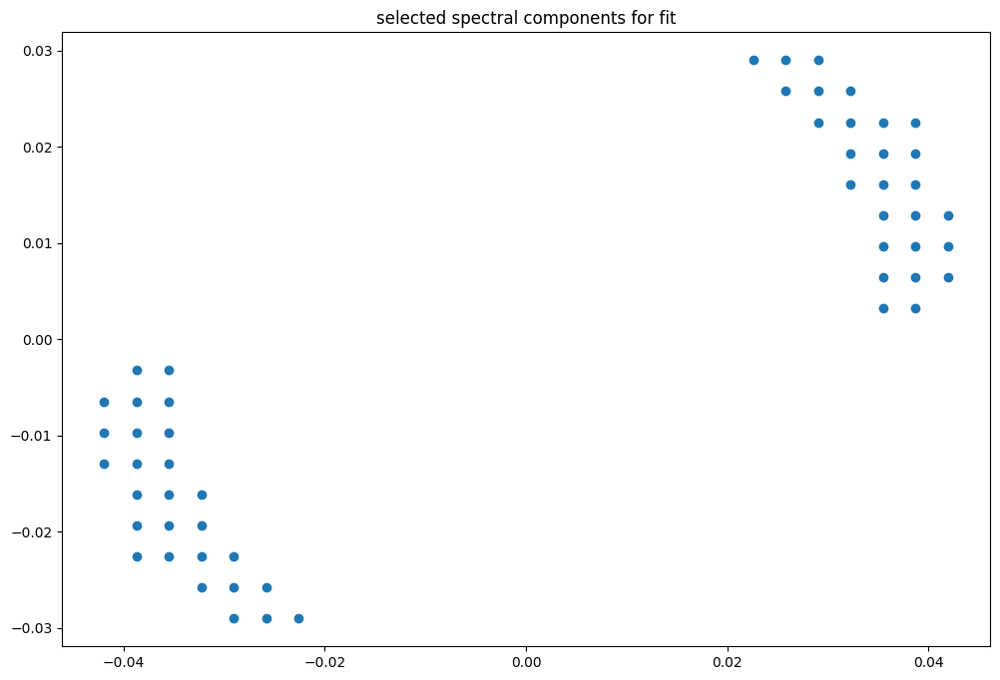

box [9000, 9500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

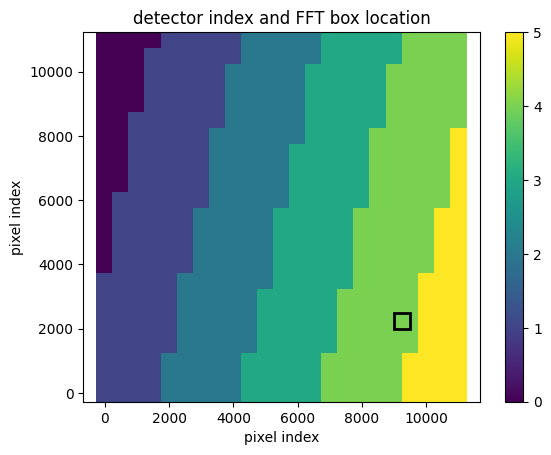

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


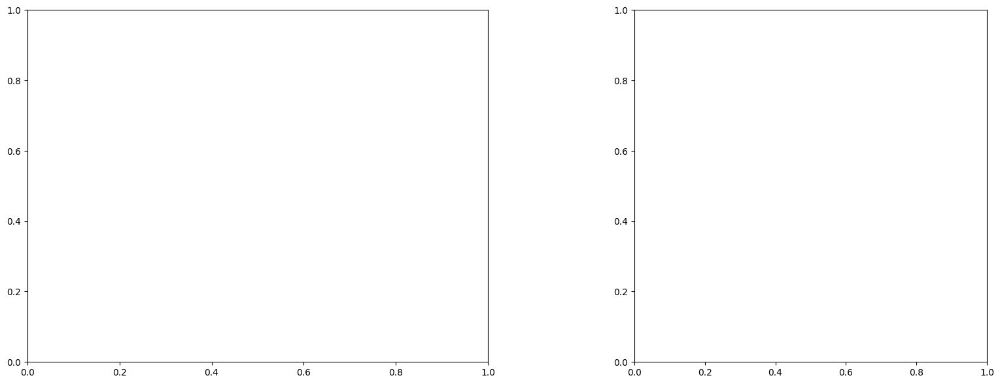

U and V components of current : [0.59502879 1.10107727]
uncertainties for U and V: 0.061658717889131937 0.11114331159459943


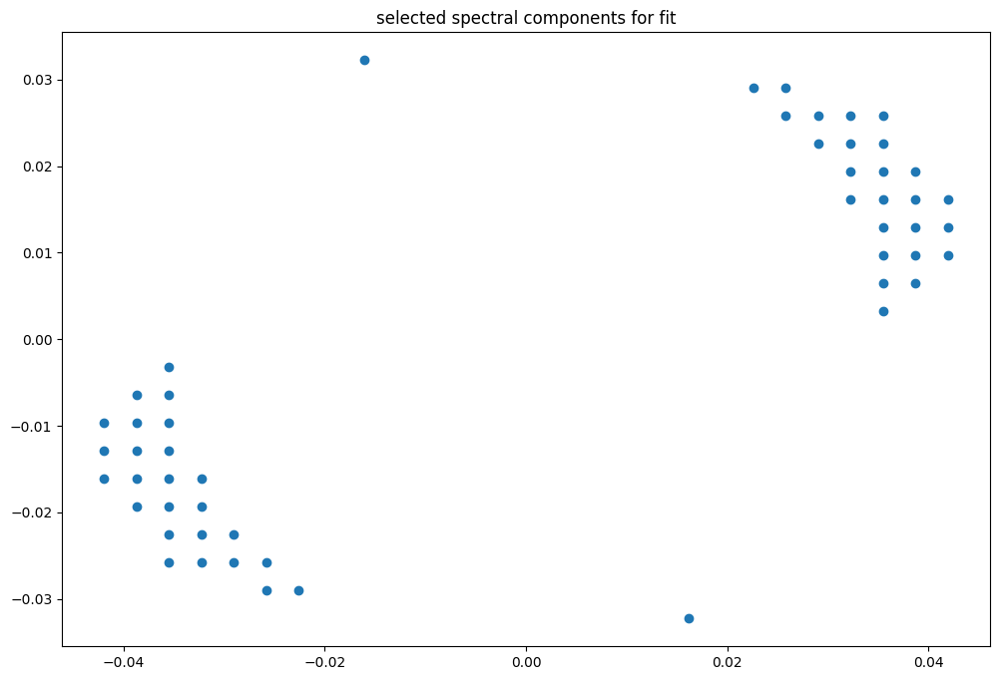

box [9000, 9500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

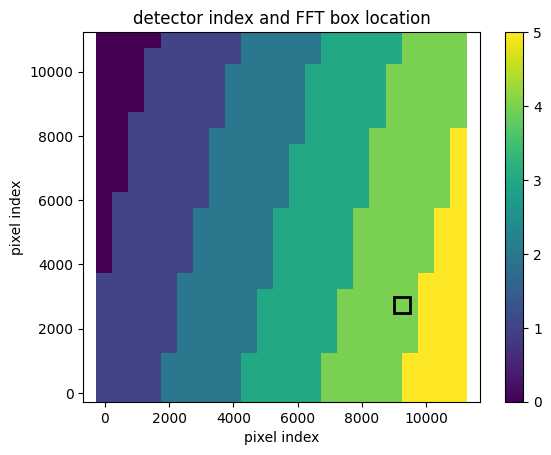

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


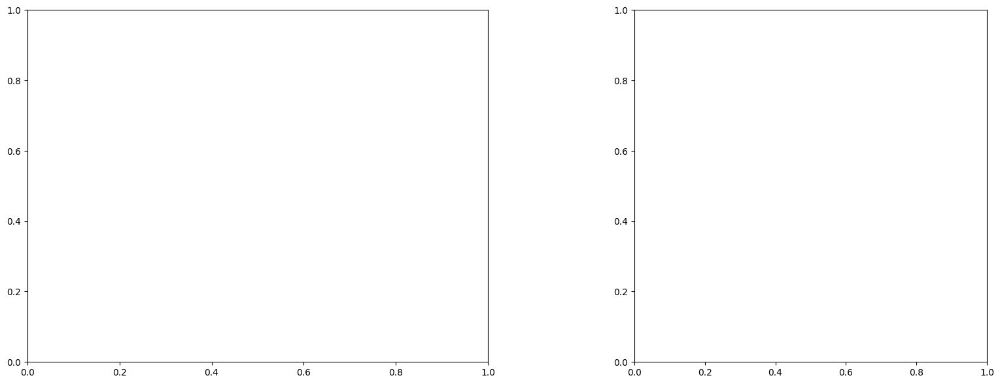

U and V components of current : [0.56586203 1.2893777 ]
uncertainties for U and V: 0.08374137686758786 0.14576796643431794


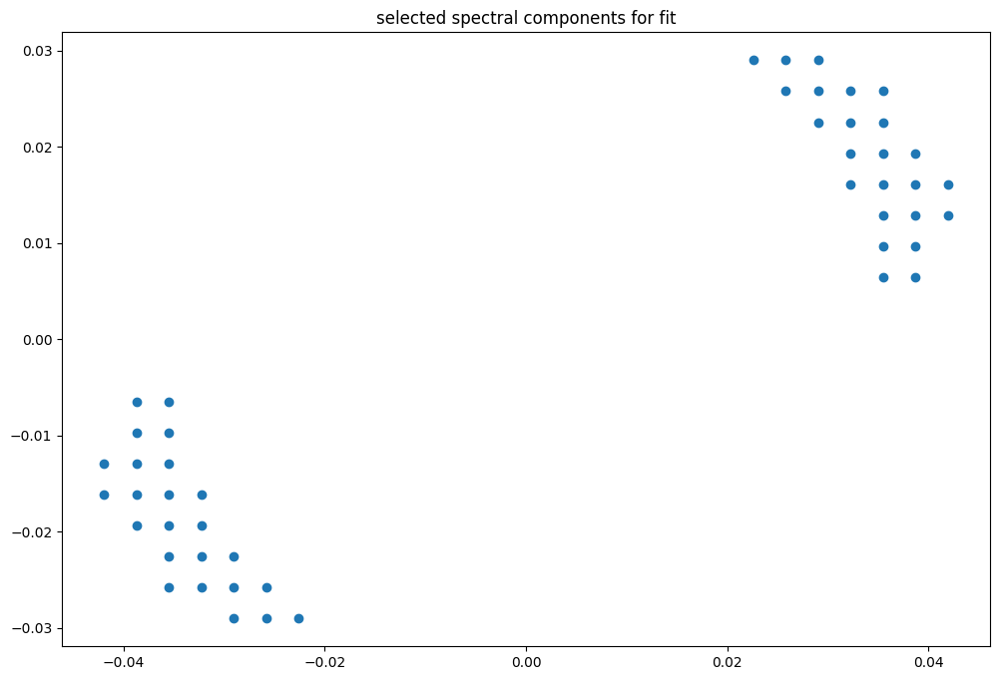

box [9000, 9500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

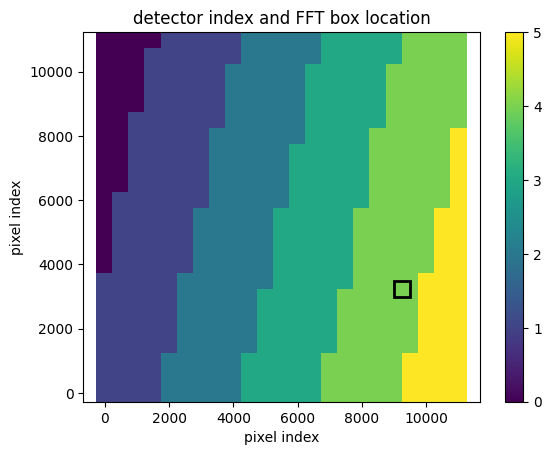

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


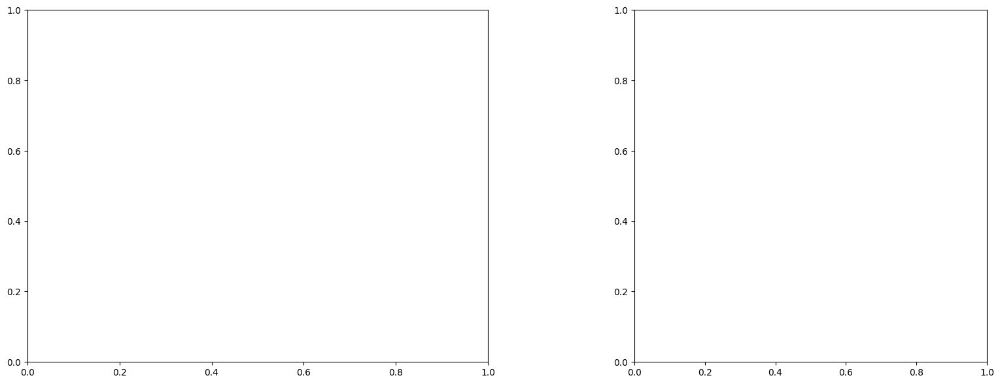

U and V components of current : [0.6797013 1.1824458]
uncertainties for U and V: 0.06552874884579939 0.1083207457105455


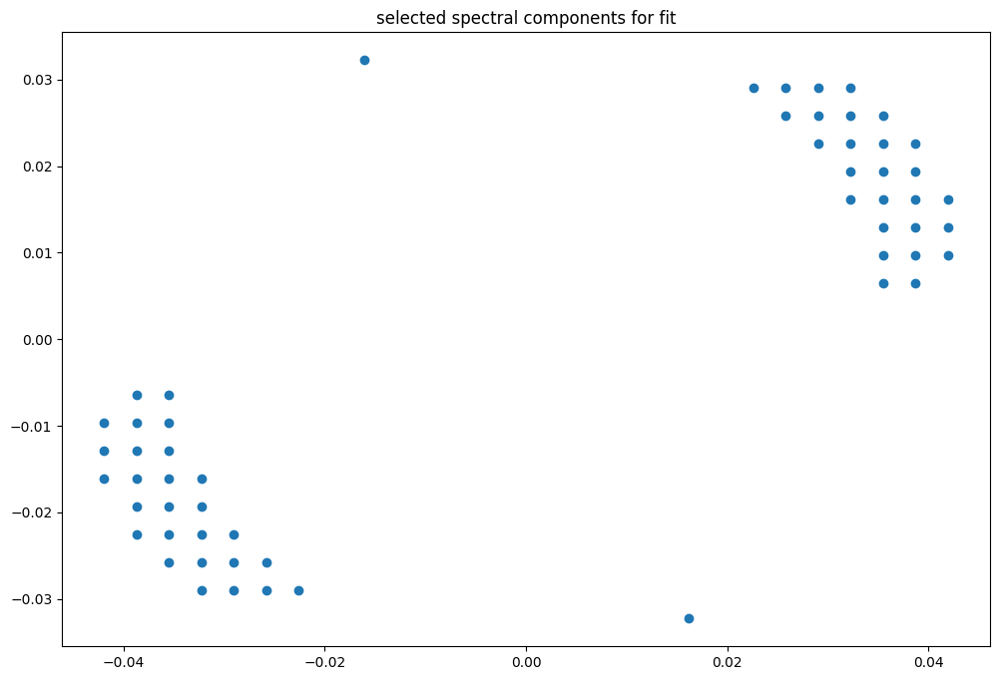

box [9000, 9500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

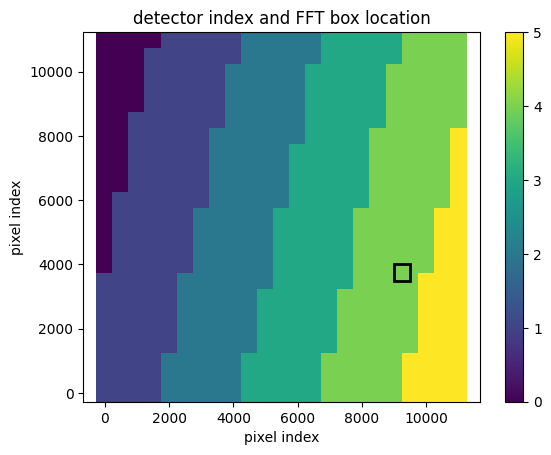

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


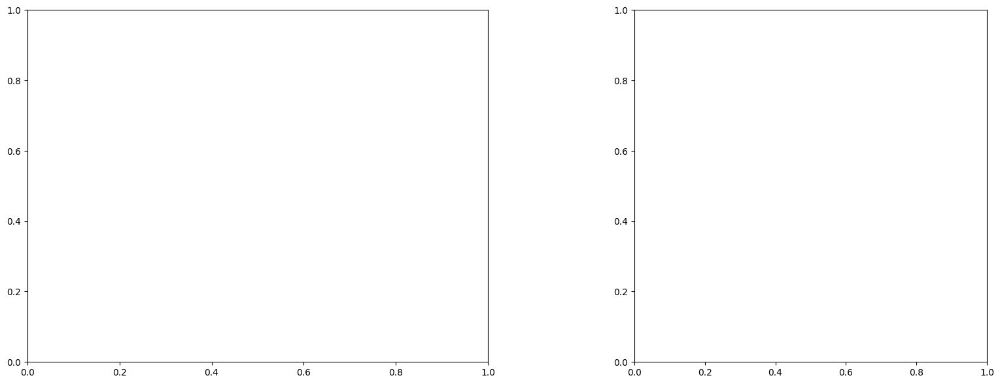

U and V components of current : [0.79140574 1.17097876]
uncertainties for U and V: 0.056332735079679515 0.09297205178950993


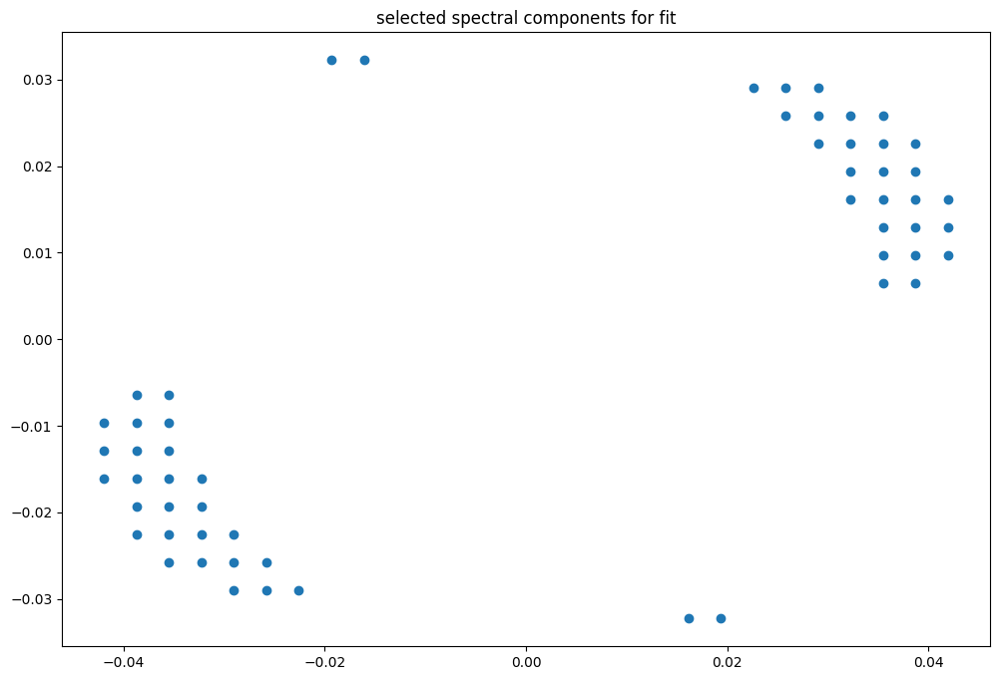

box [9000, 9500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

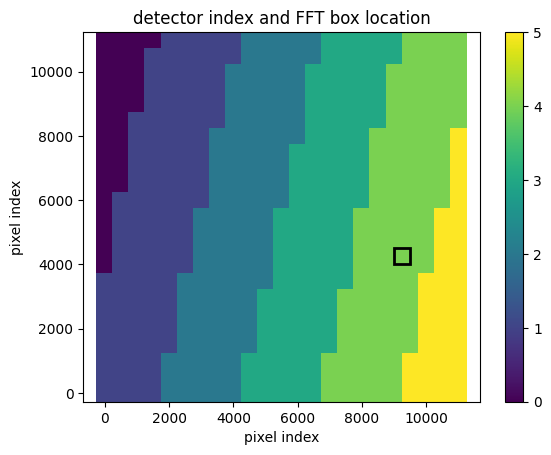

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


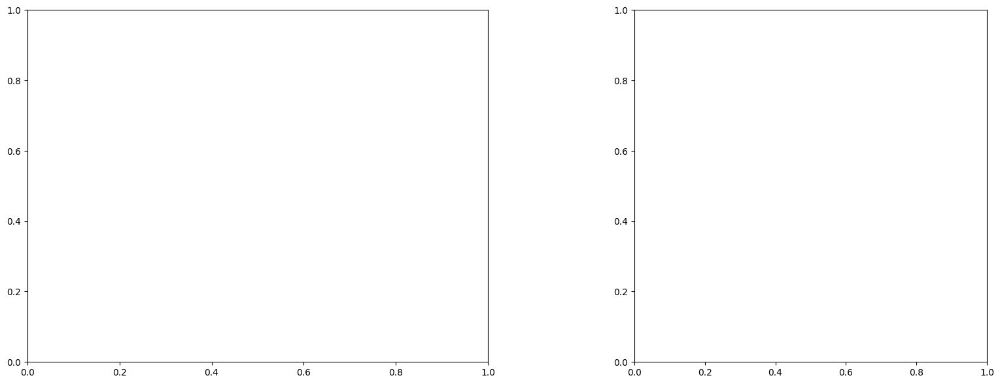

U and V components of current : [0.80290168 1.07453135]
uncertainties for U and V: 0.05879835560369148 0.0897678496266321


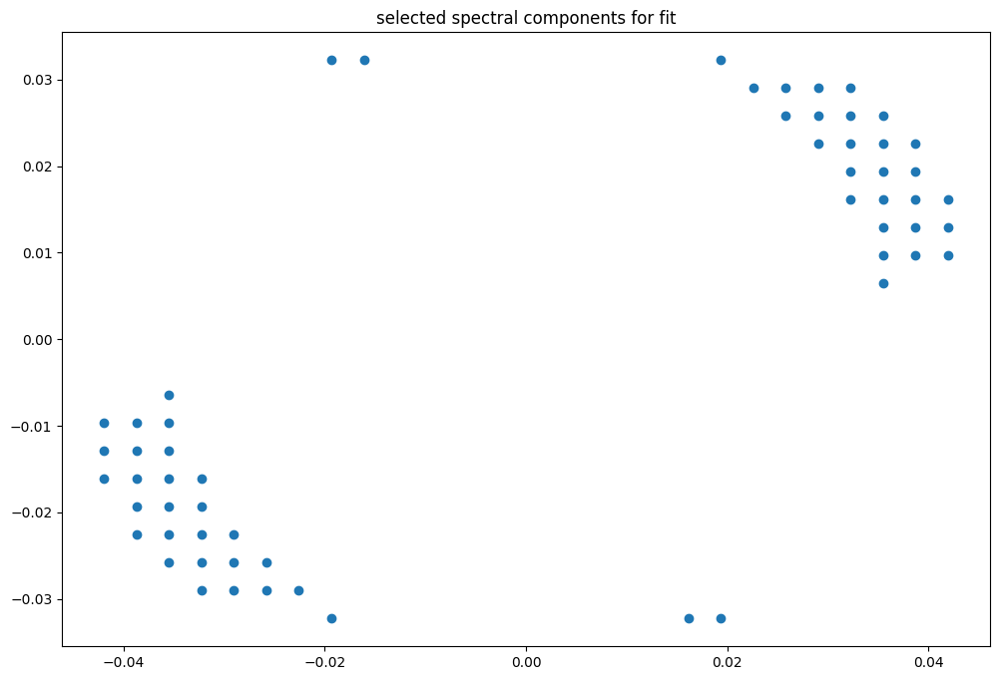

box [9000, 9500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

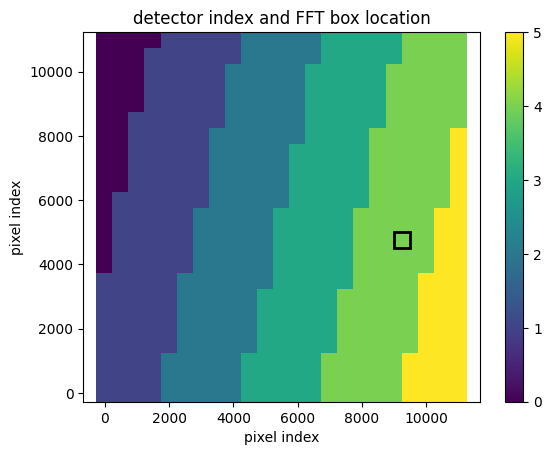

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


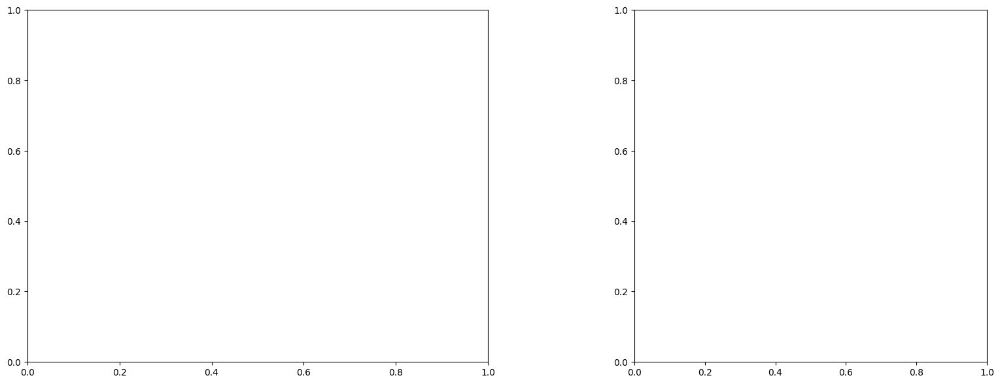

U and V components of current : [0.8142669  1.48700201]
uncertainties for U and V: 0.07273048921140453 0.11330093593114544


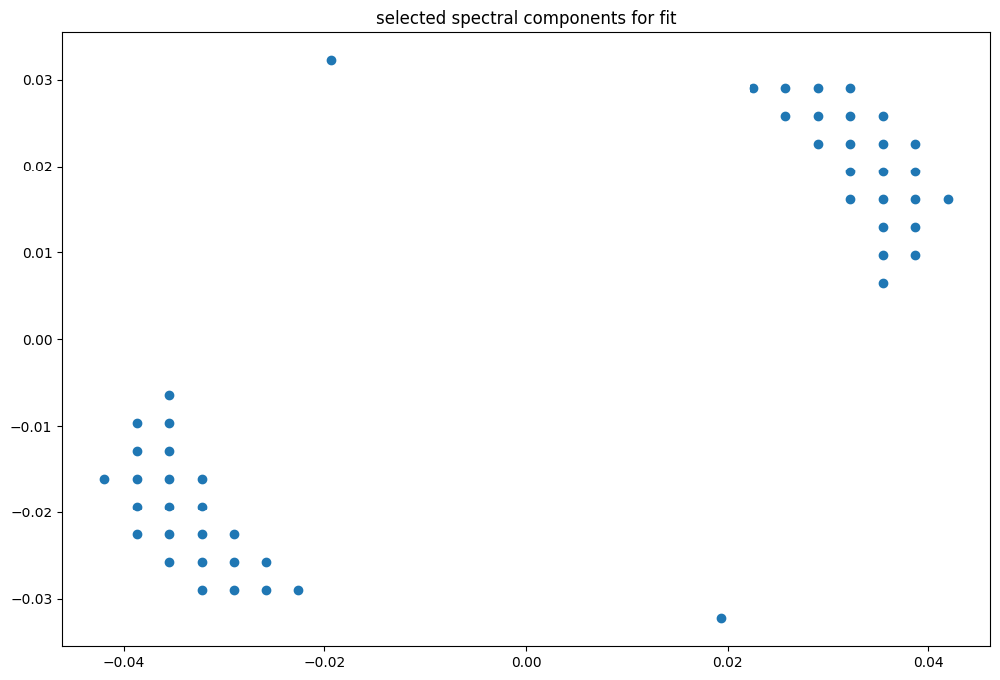

box [9000, 9500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

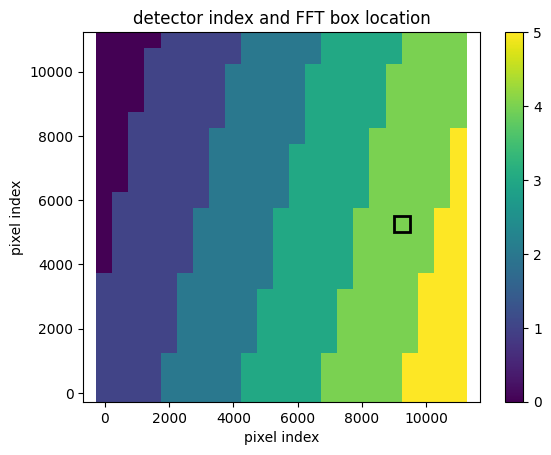

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


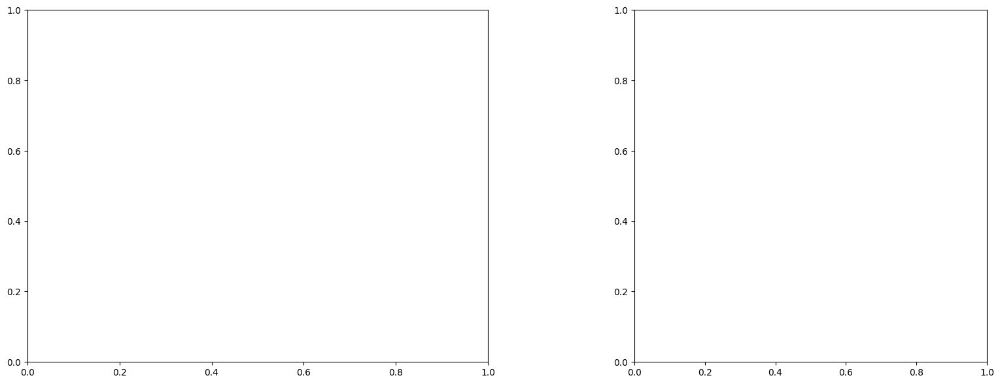

U and V components of current : [0.99757571 1.28235389]
uncertainties for U and V: 0.06259580818371176 0.09069570873531012


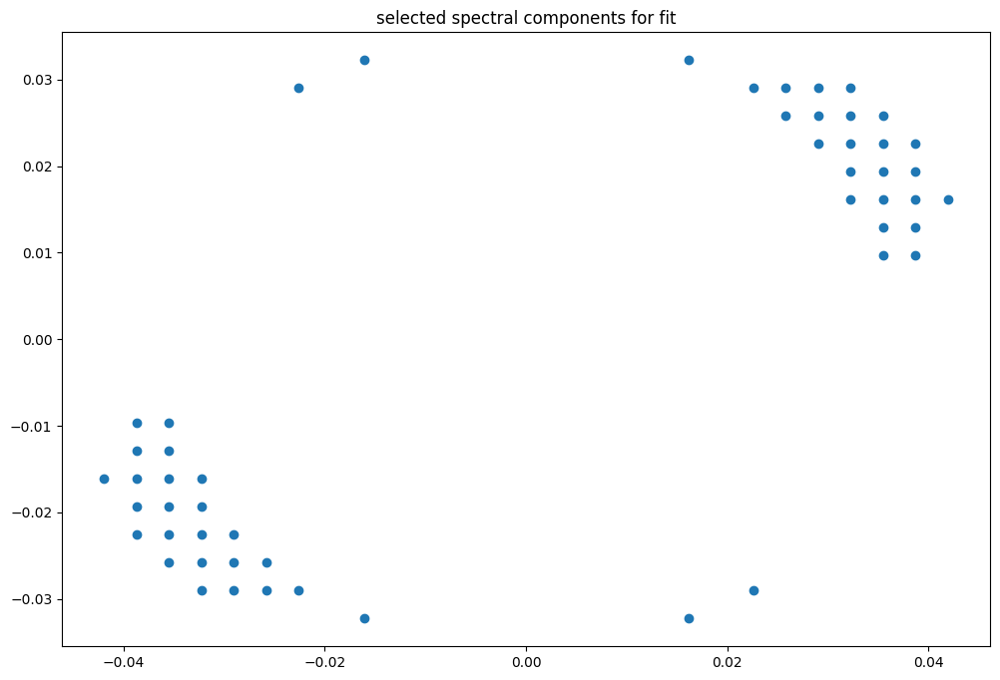

box [9000, 9500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

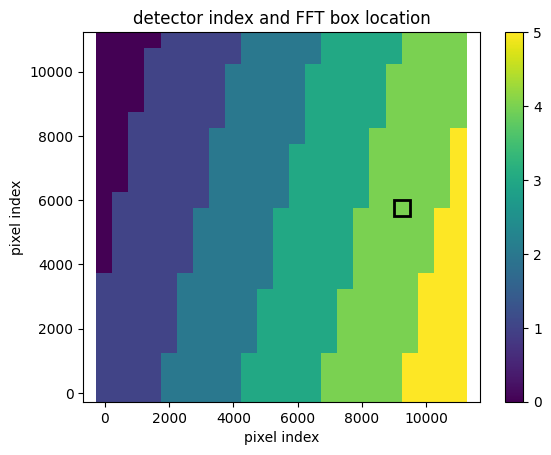

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


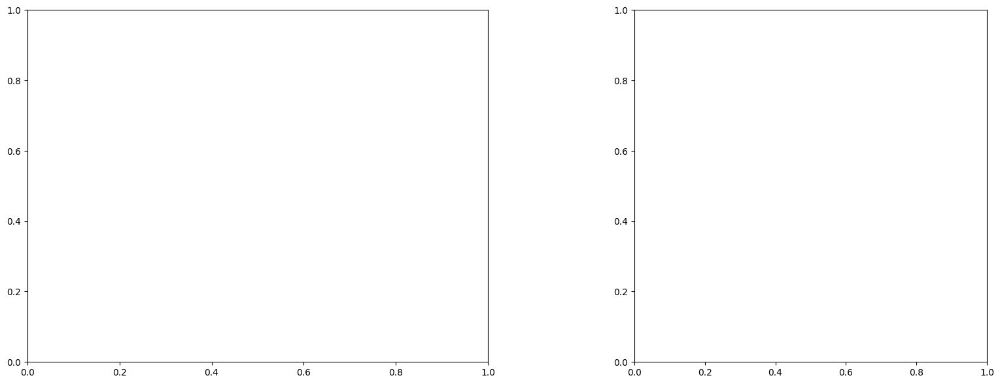

U and V components of current : [1.2763128  1.14246912]
uncertainties for U and V: 0.10702278182414073 0.14703285807855349


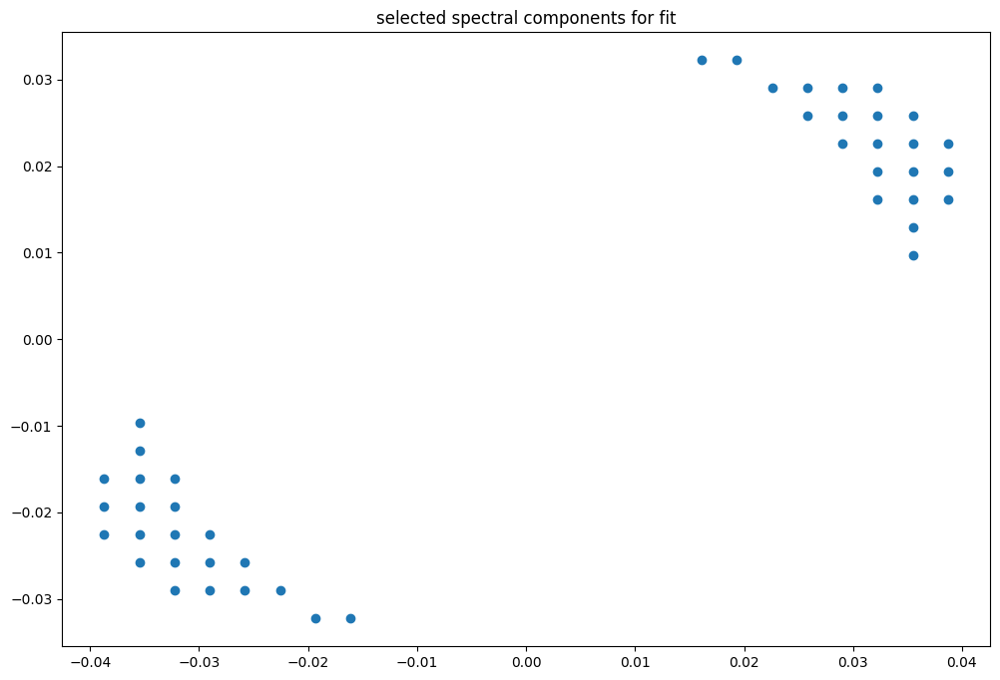

box [9000, 9500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

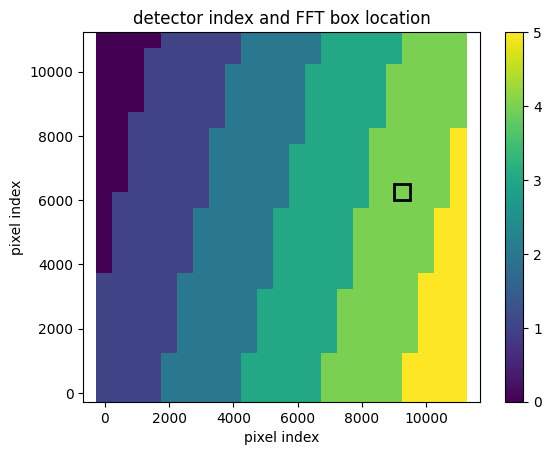

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


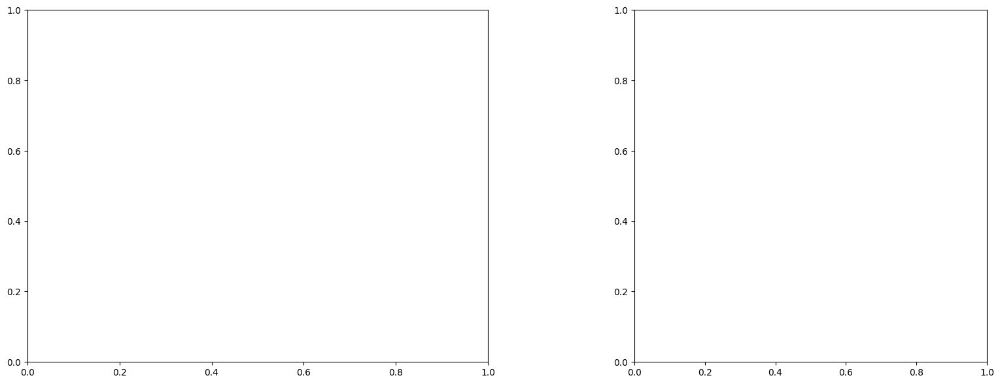

U and V components of current : [0.90412145 1.49222659]
uncertainties for U and V: 0.08517809057861221 0.11790464005359472


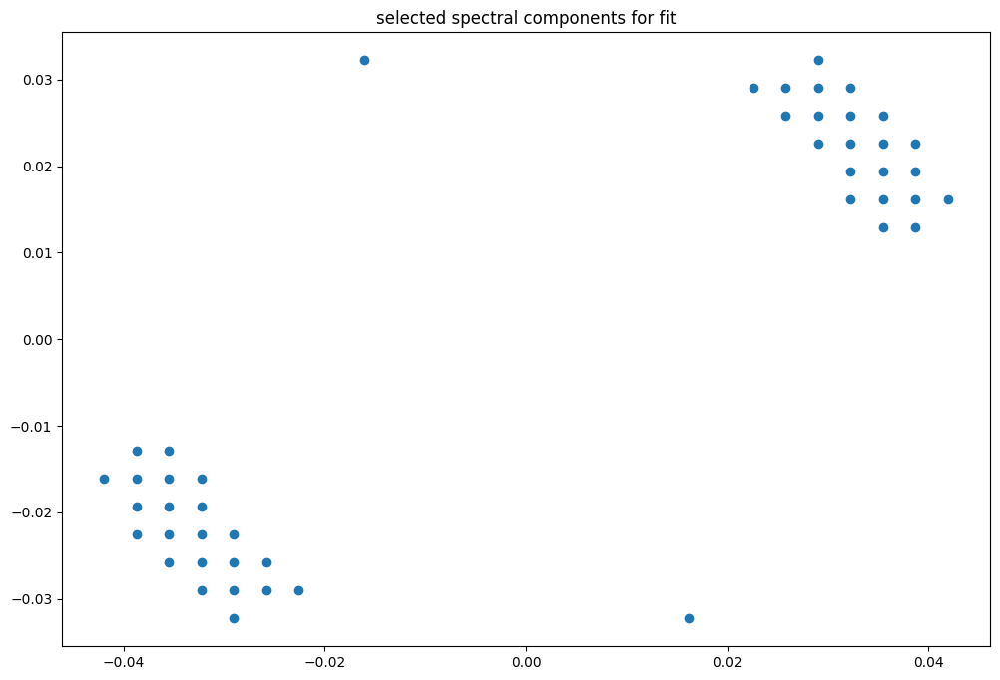

box [9000, 9500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

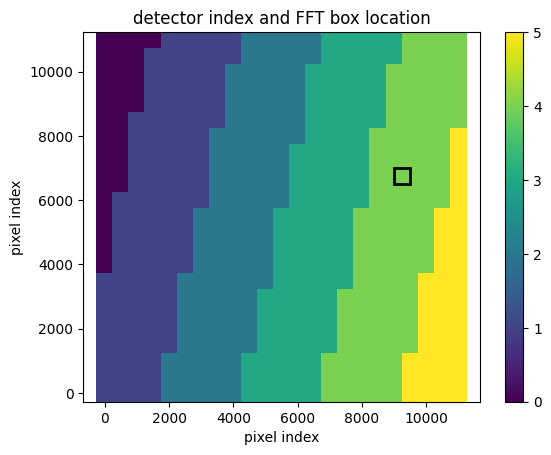

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


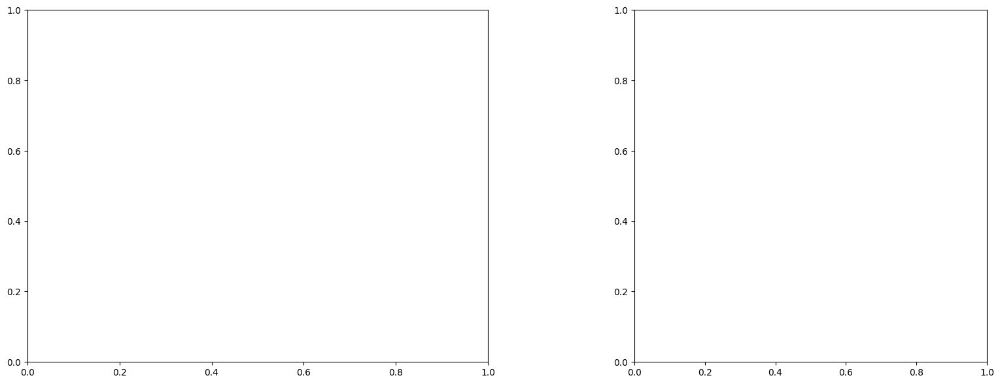

U and V components of current : [1.08387741 1.32298648]
uncertainties for U and V: 0.06451591707759807 0.08176709830373934


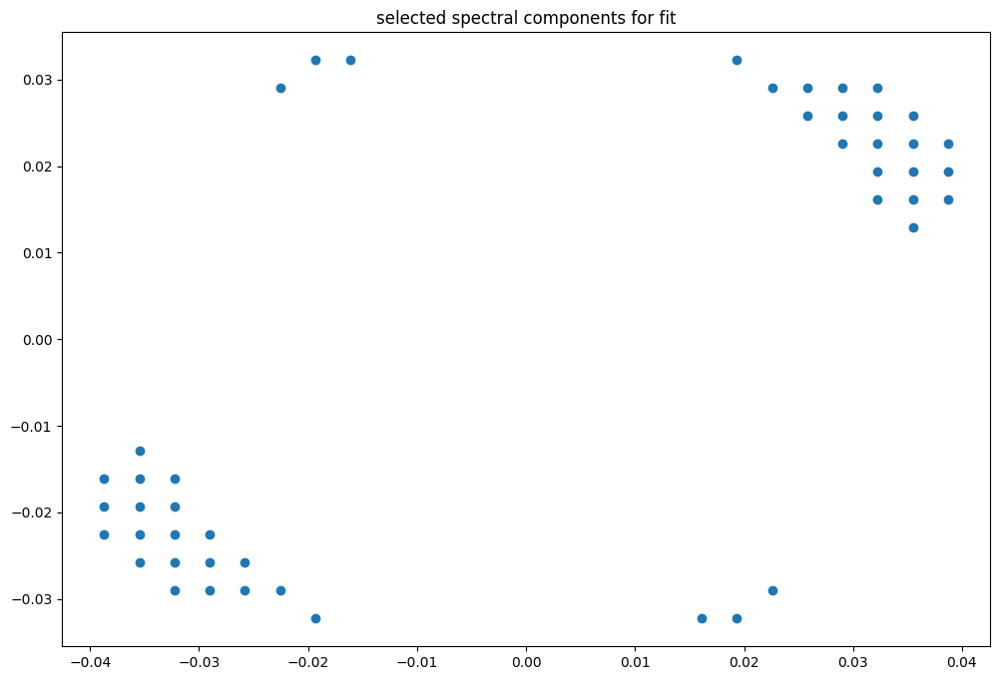

box [9000, 9500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

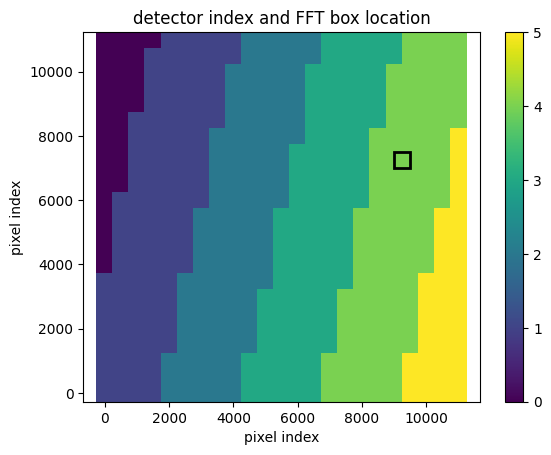

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


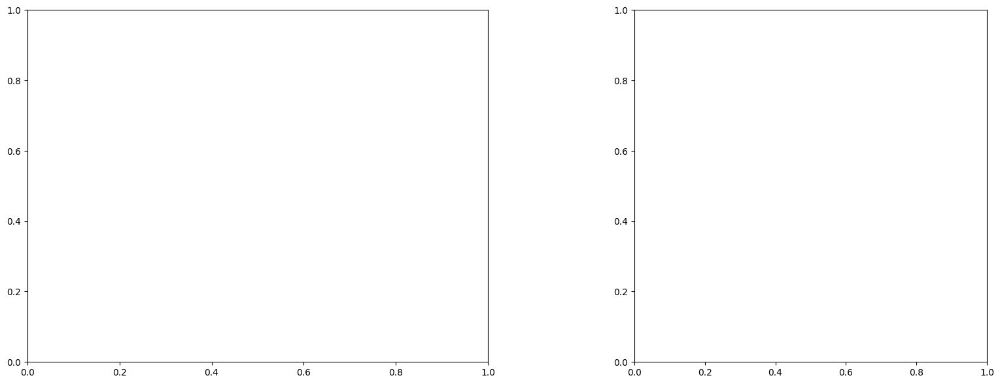

U and V components of current : [1.15404008 1.19917045]
uncertainties for U and V: 0.06547978996887867 0.08022632420418319


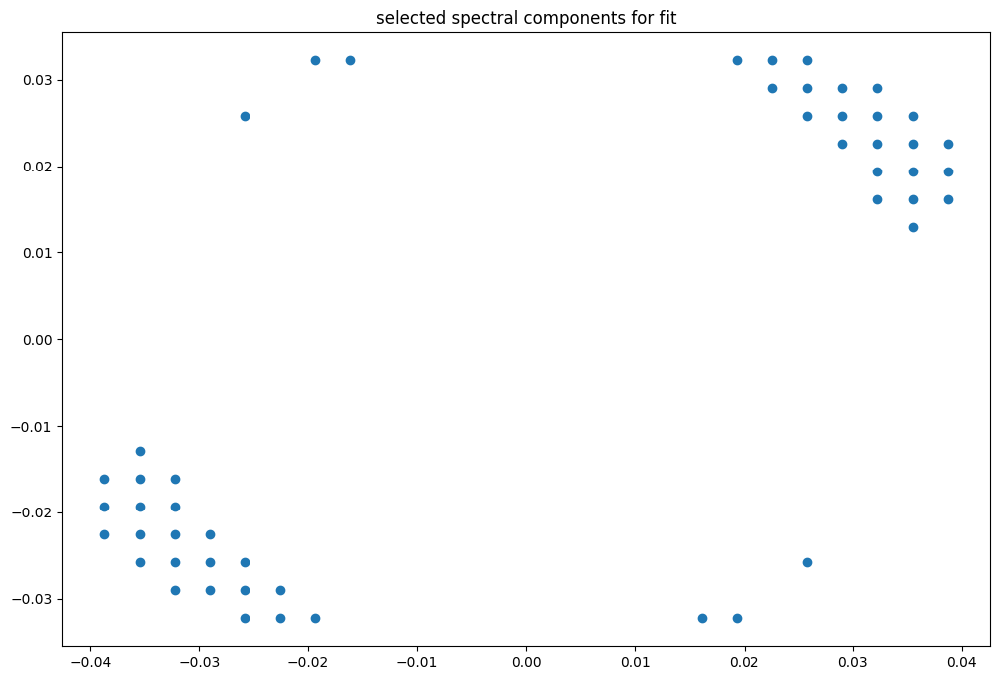

box [9000, 9500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

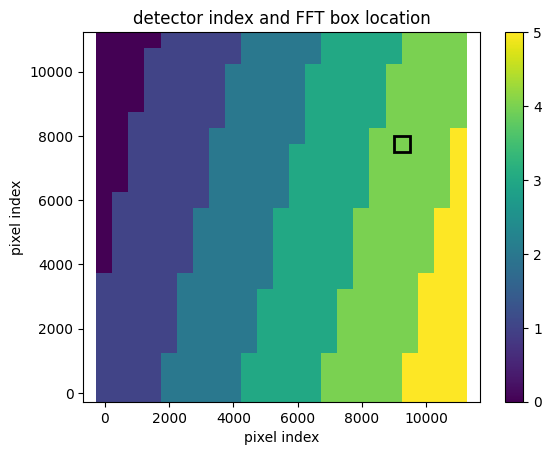

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


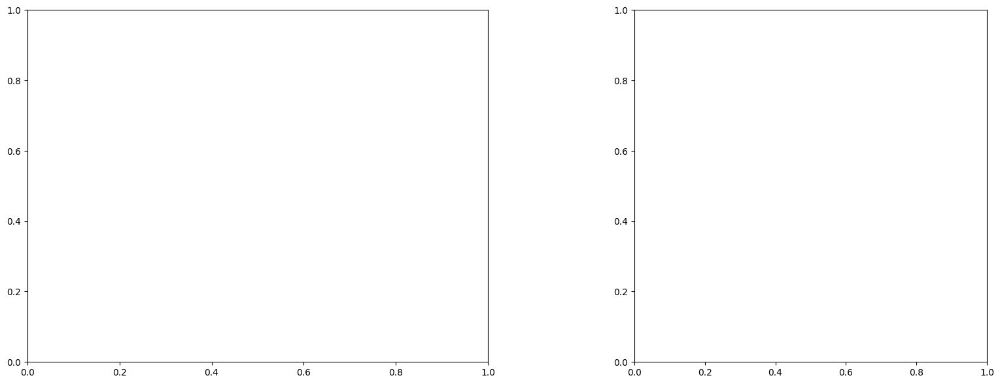

U and V components of current : [1.32806284 1.02878473]
uncertainties for U and V: 0.07548720128474373 0.07078522047486283


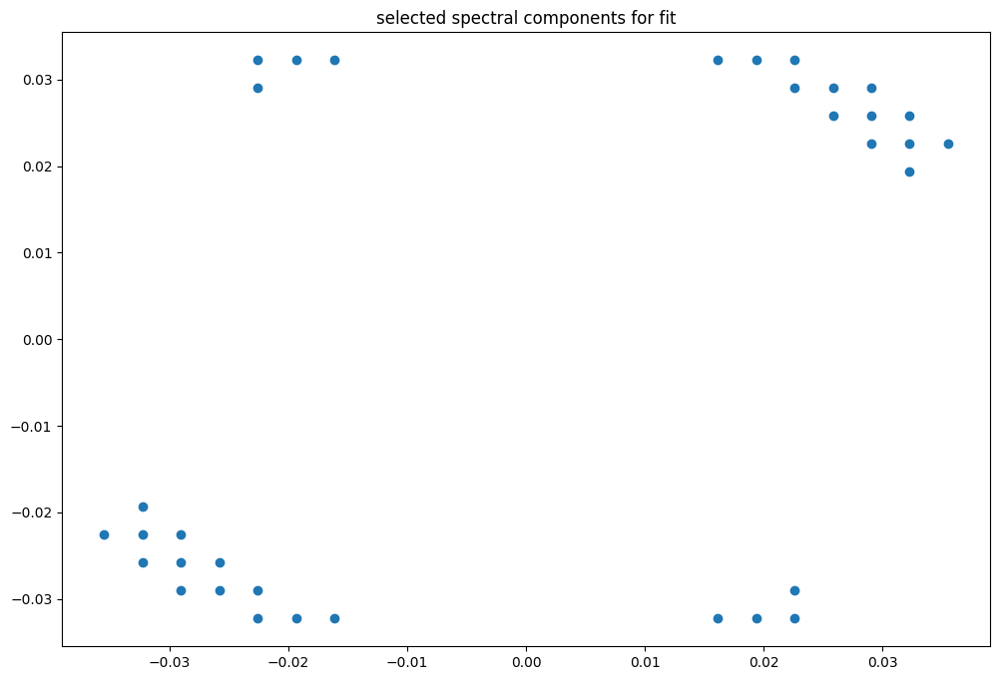

box [9000, 9500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

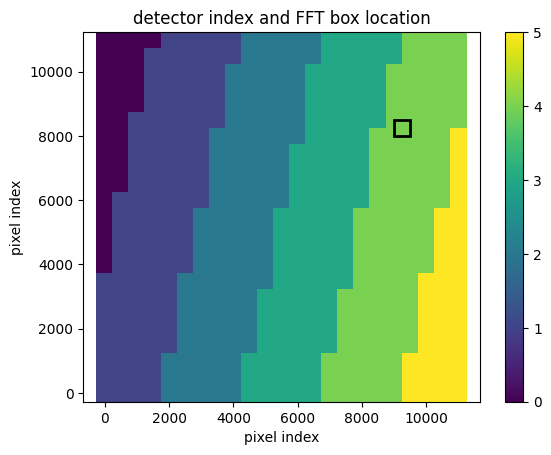

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(31, 31)
(31, 31)
(31, 31)


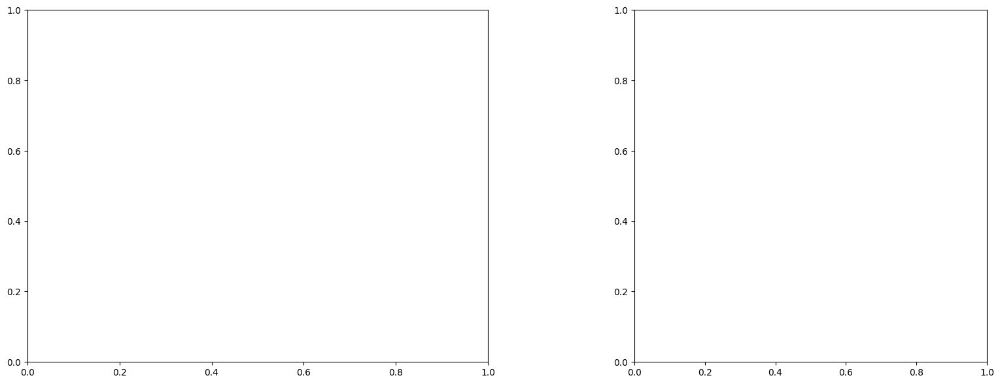

U and V components of current : [1.16793407 1.27583485]
uncertainties for U and V: 0.05274441460891583 0.047024961426579866


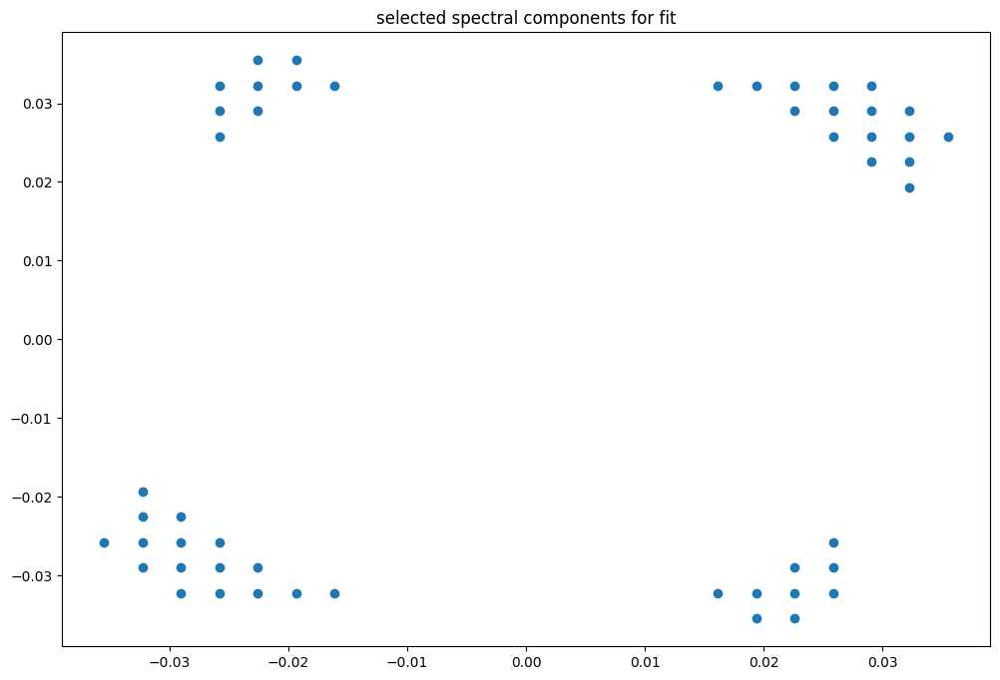

box [9000, 9500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

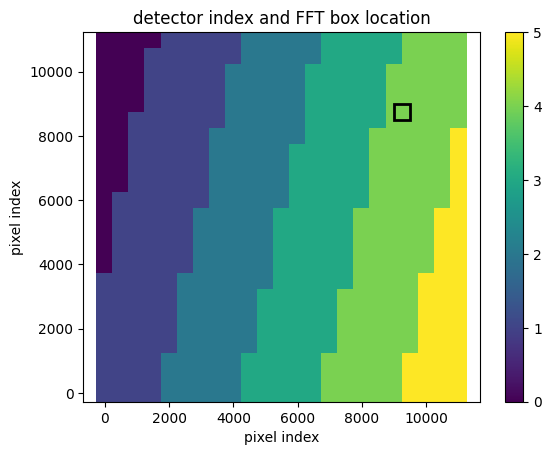

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(31, 31)
(31, 31)
(31, 31)


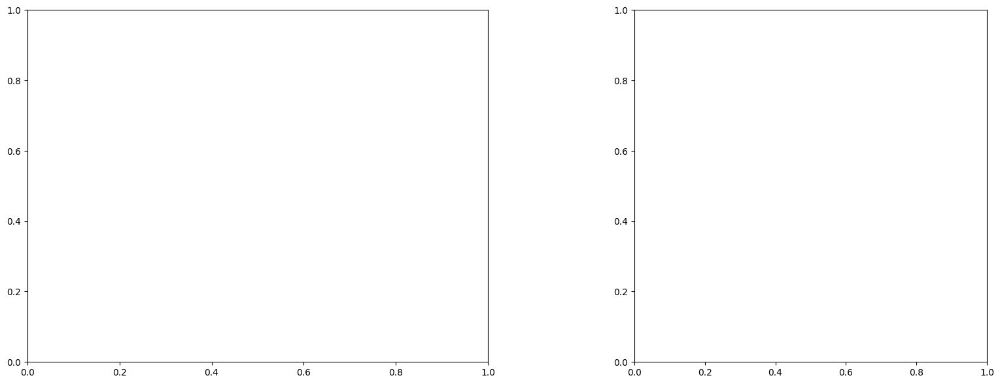

U and V components of current : [1.10032405 1.36111125]
uncertainties for U and V: 0.04399112924237109 0.039353114361779545


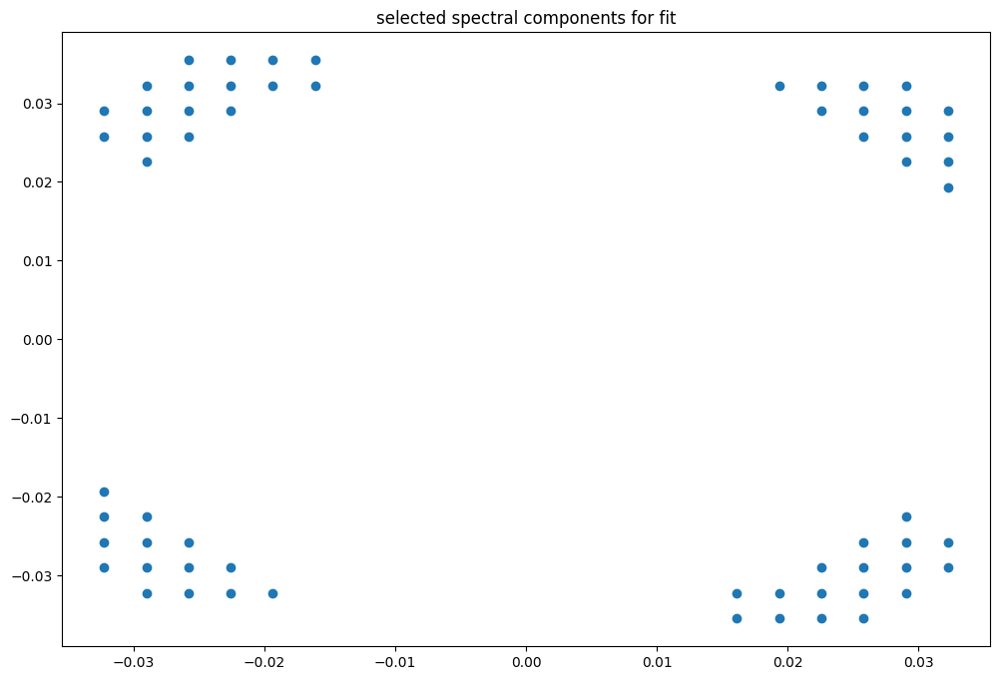

box [9000, 9500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

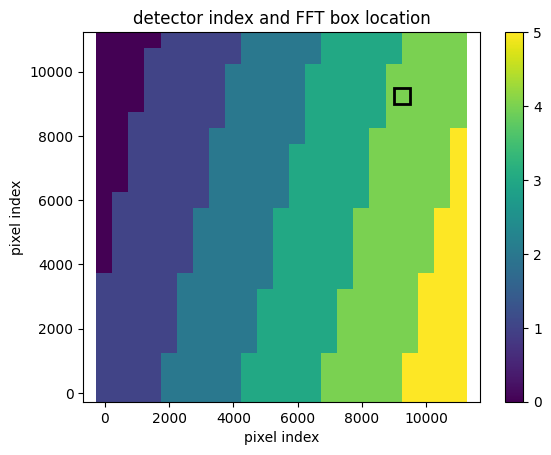

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


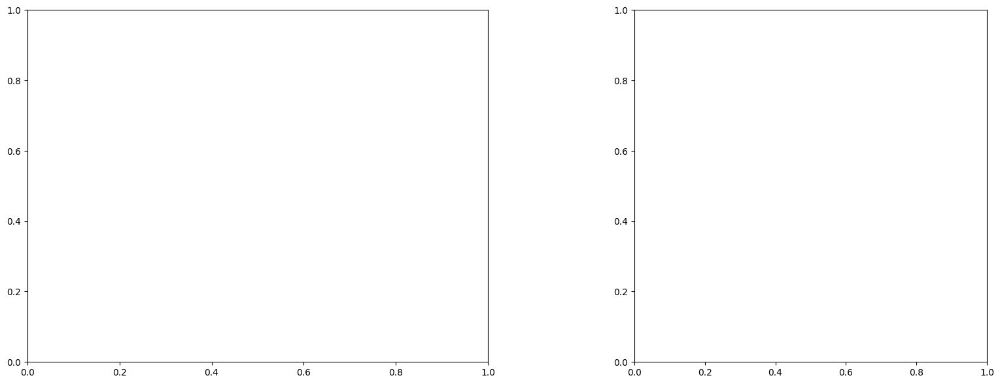

U and V components of current : [0.93110235 1.03785877]
uncertainties for U and V: 0.055717248152925634 0.044987383687547094


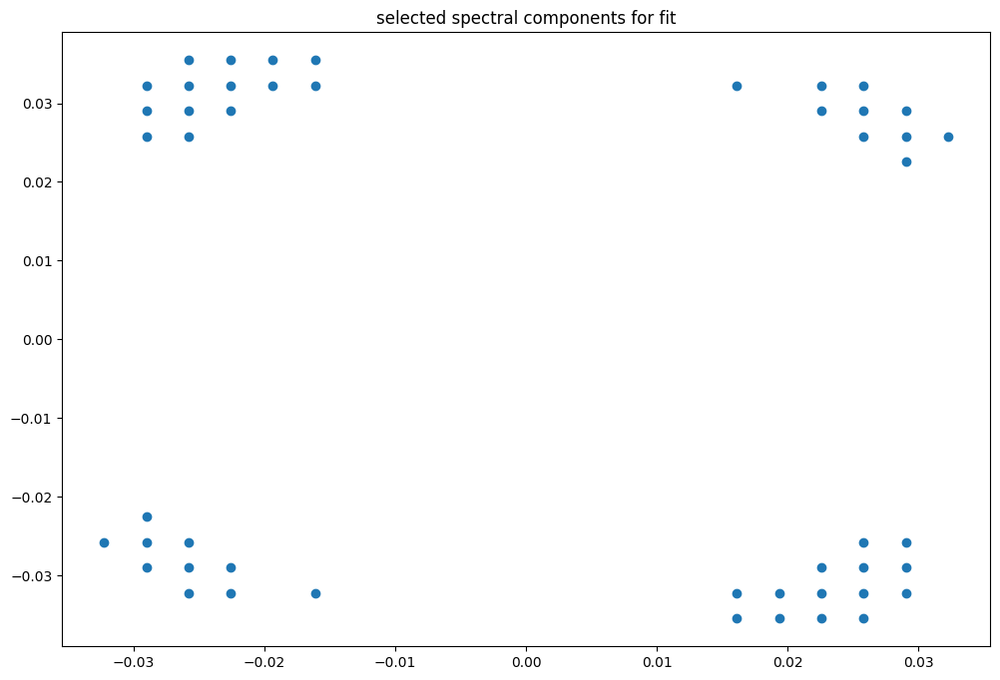

box [9000, 9500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

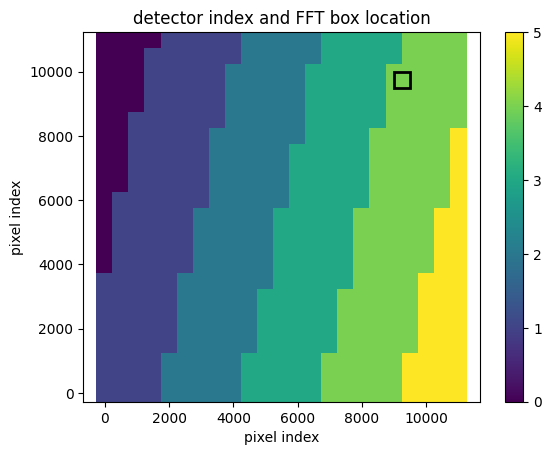

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(31, 31)
(31, 31)
(31, 31)


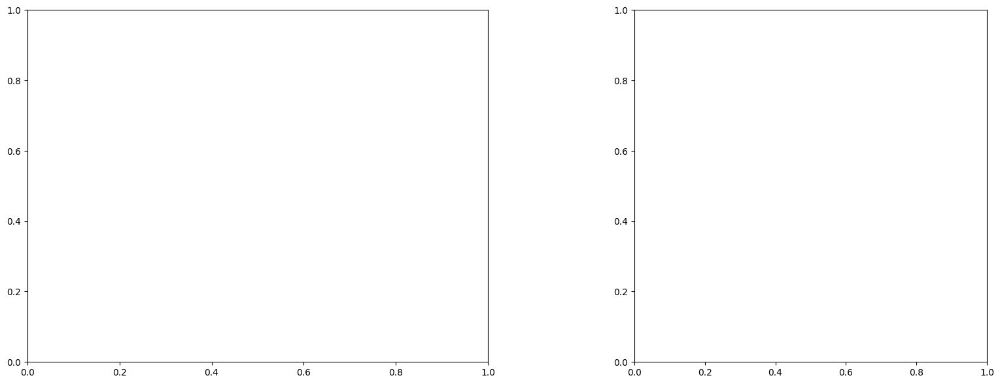

U and V components of current : [0.92406885 1.00032227]
uncertainties for U and V: 0.055991168962166014 0.04578040622515882


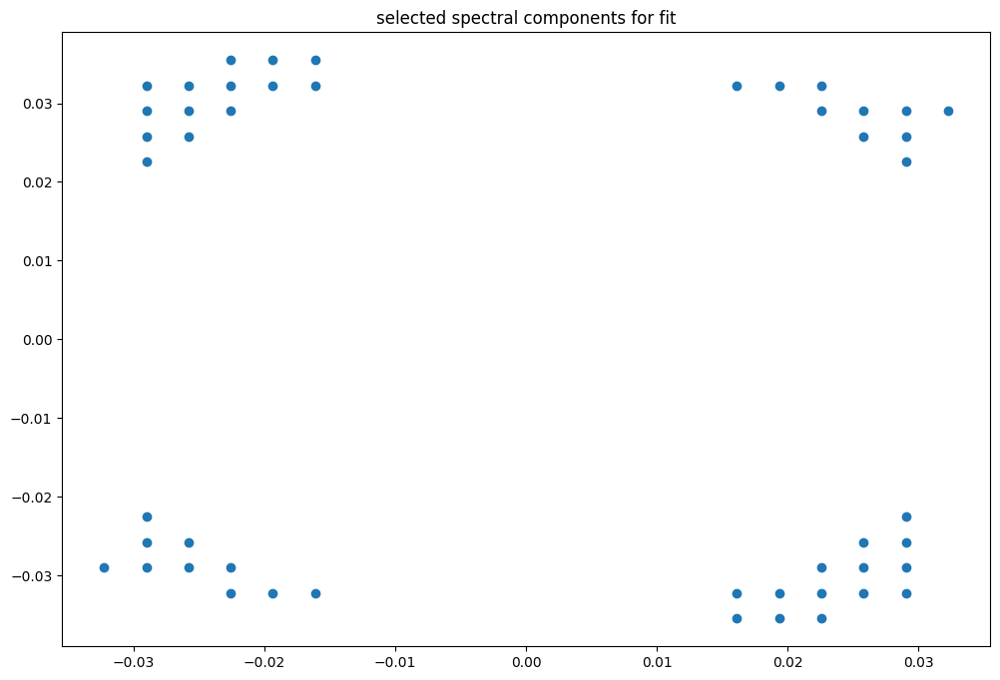

box [9000, 9500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

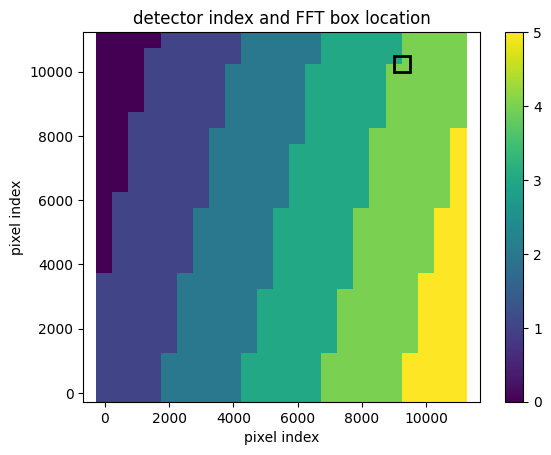

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(31, 31)
(31, 31)
(31, 31)


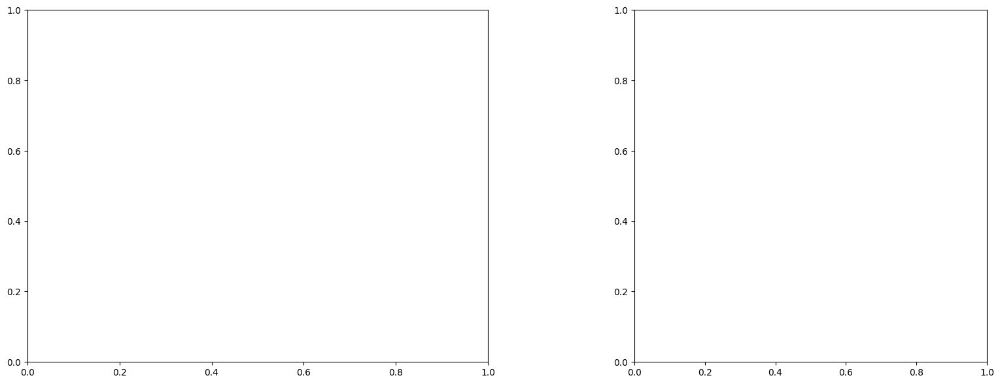

LinAlgError: Singular matrix

box [9000, 9500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

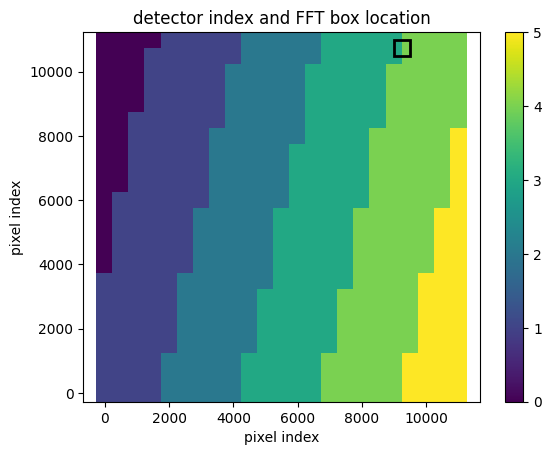

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(31, 30)
(31, 30)
(31, 30)


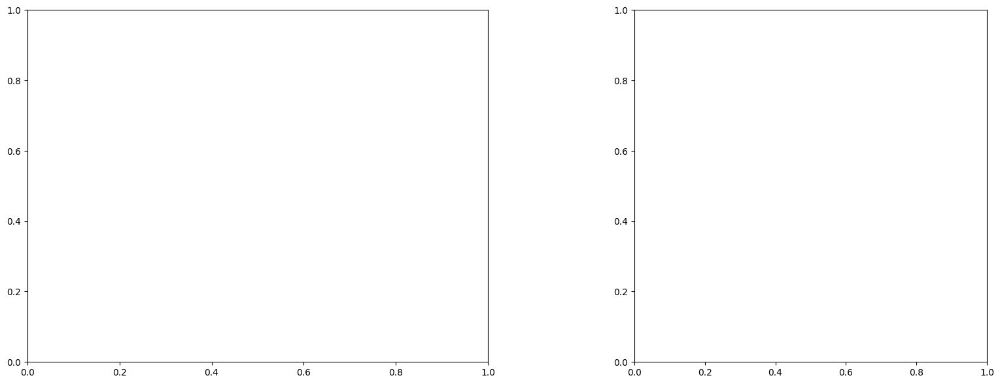

LinAlgError: Singular matrix

box [9500, 10000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Reading

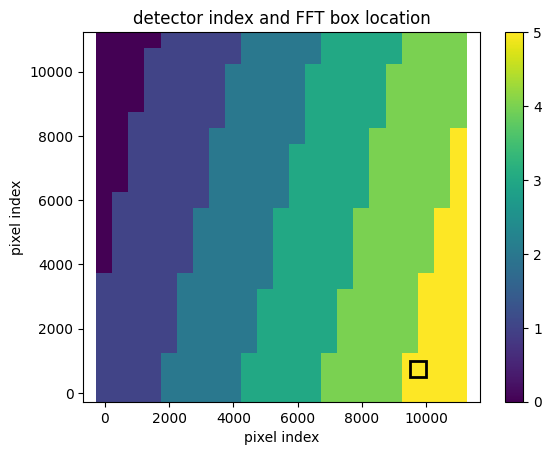

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876730752059386
(31, 31)
(31, 31)
(31, 31)


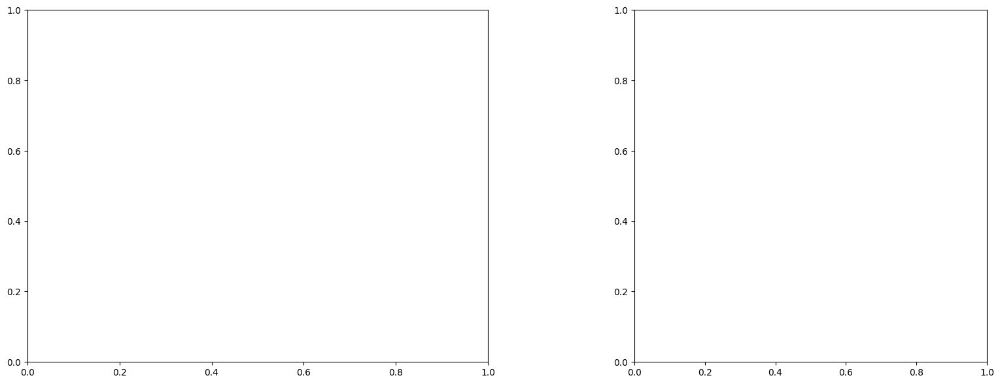

U and V components of current : [0.55154608 1.25302589]
uncertainties for U and V: 0.05362369326099162 0.1061188386221439


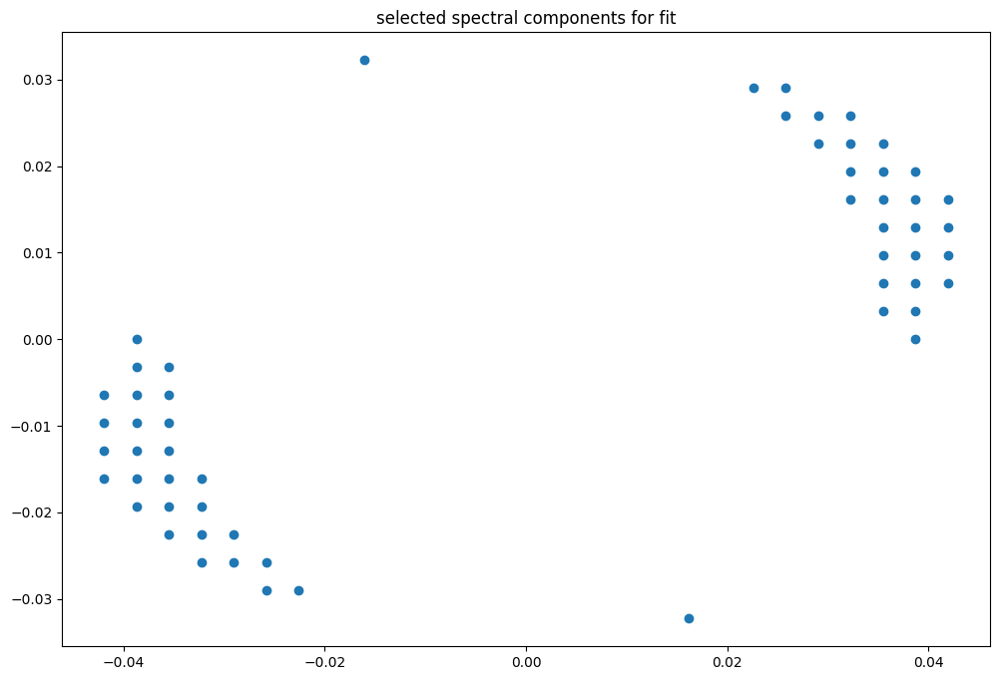

box [9500, 10000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

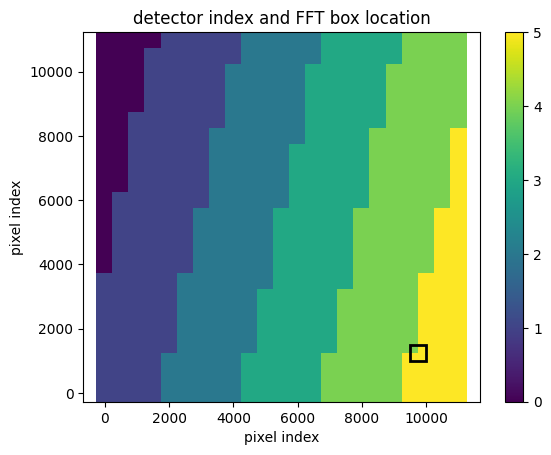

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.500000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876696255202555
(31, 31)
(31, 31)
(31, 31)


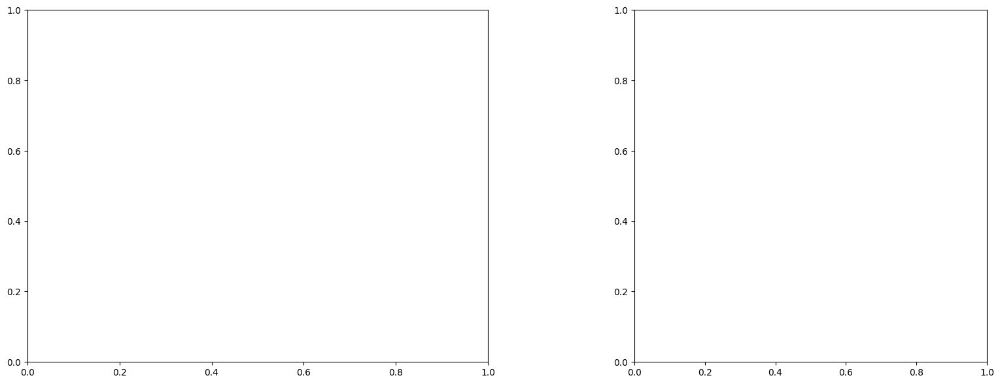

LinAlgError: Singular matrix

box [9500, 10000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

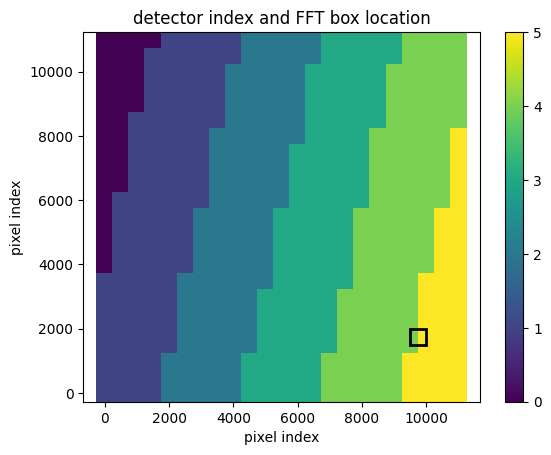

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987318801301236
(31, 31)
(31, 31)
(31, 31)


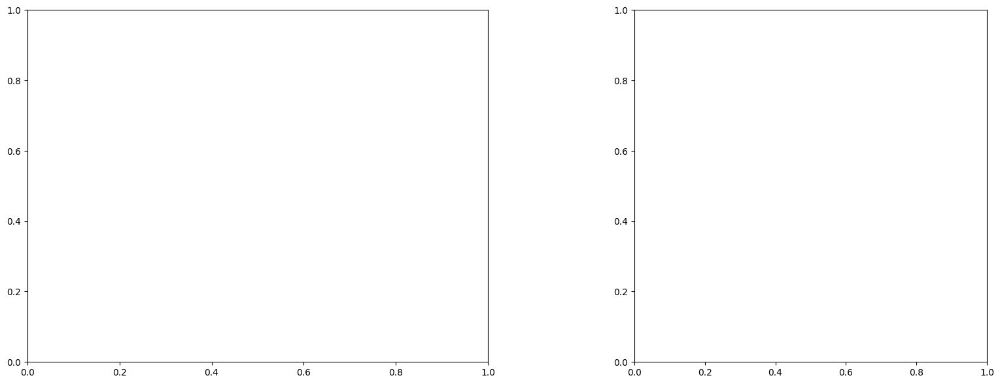

LinAlgError: Singular matrix

box [9500, 10000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

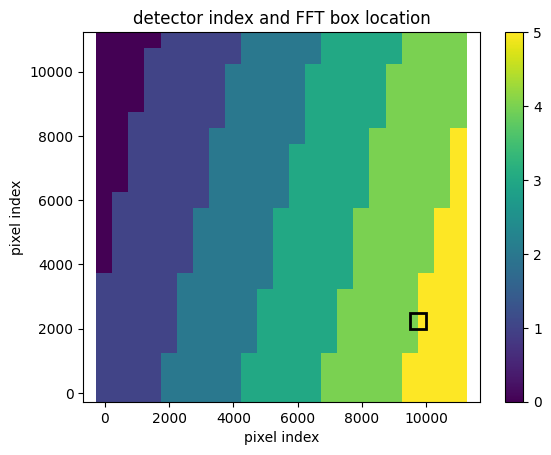

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987283325427144
(31, 31)
(31, 31)
(31, 31)


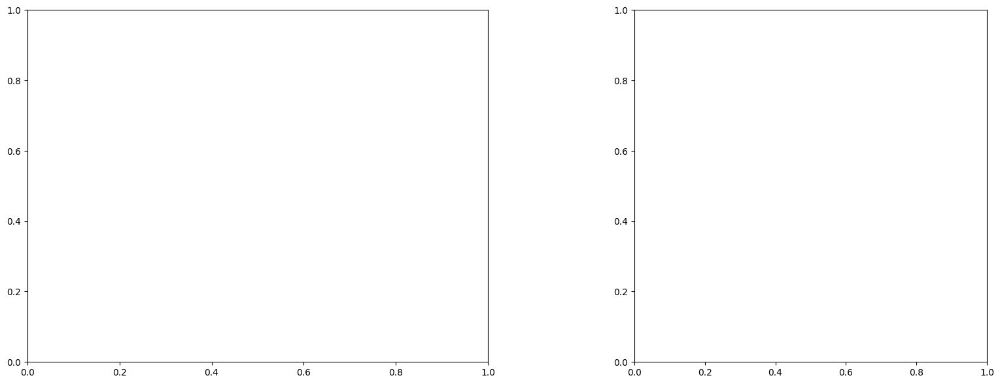

LinAlgError: Singular matrix

box [9500, 10000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

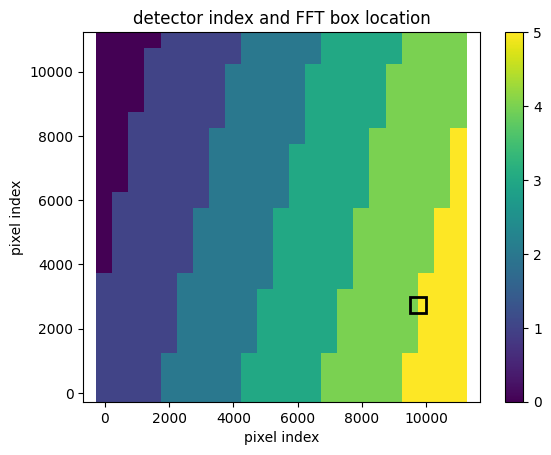

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987250146448339
(31, 31)
(31, 31)
(31, 31)


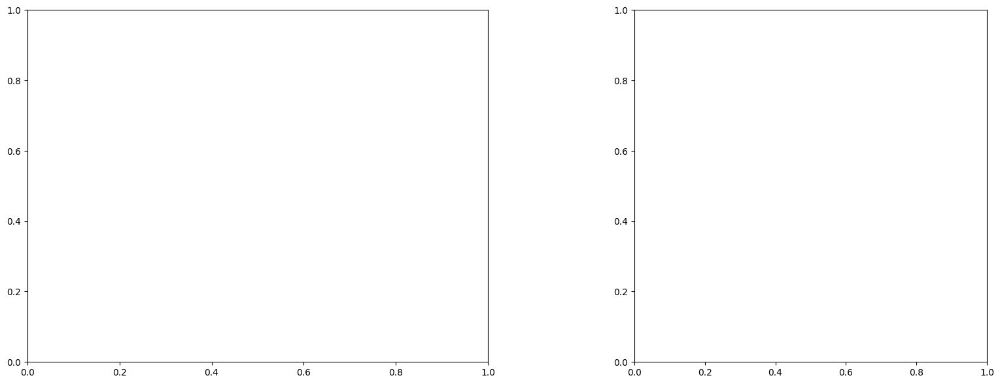

LinAlgError: Singular matrix

box [9500, 10000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

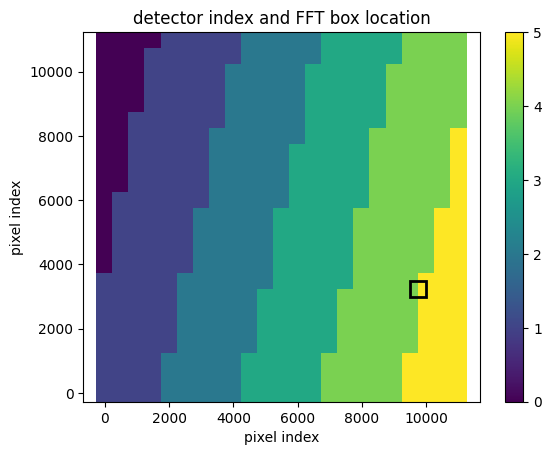

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.500000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.987659709308897
(31, 31)
(31, 31)
(31, 31)


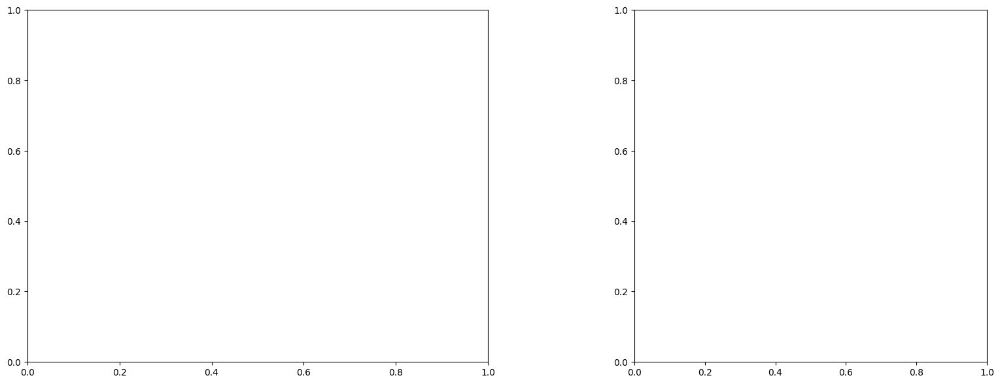

U and V components of current : [-0.87524116 -1.17566901]
uncertainties for U and V: 0.09171139143085358 0.16911824493620295


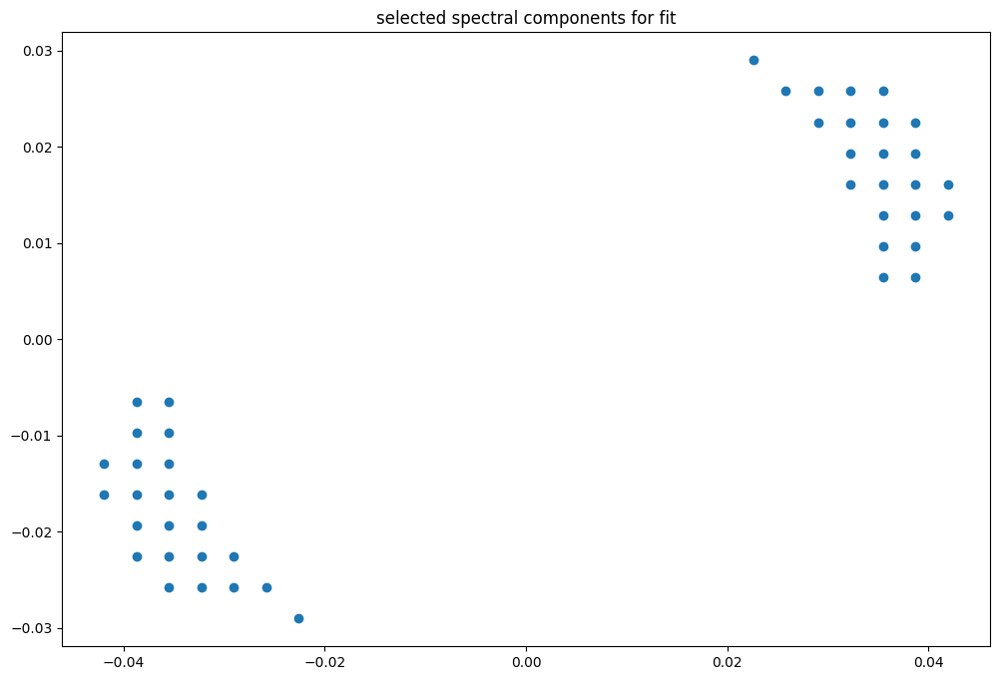

box [9500, 10000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

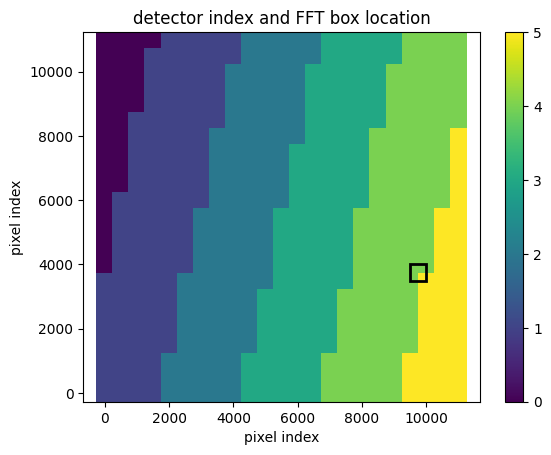

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987218528536358
(31, 31)
(31, 31)
(31, 31)


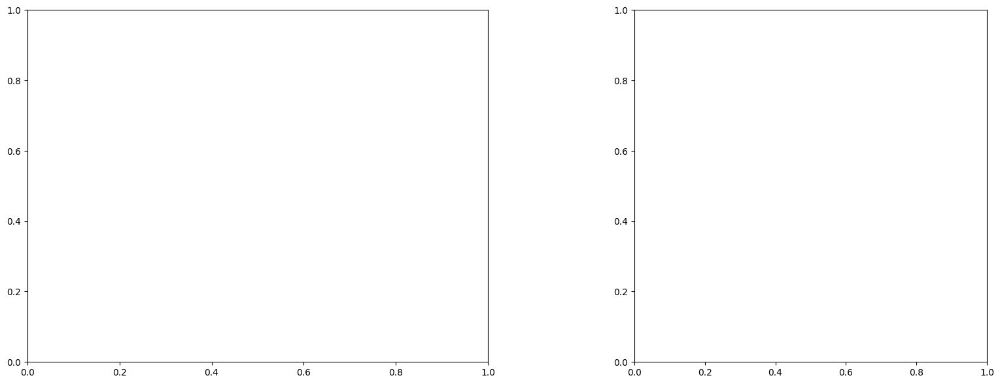

U and V components of current : [0.36613545 1.84967624]
uncertainties for U and V: 0.07965202891451877 0.15351379645919774


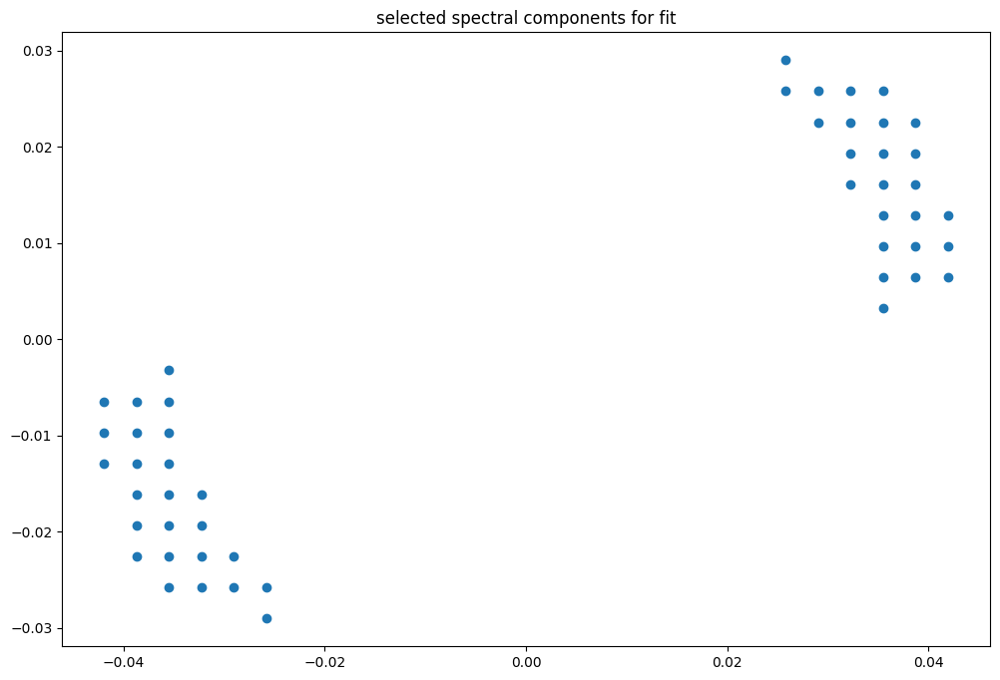

box [9500, 10000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

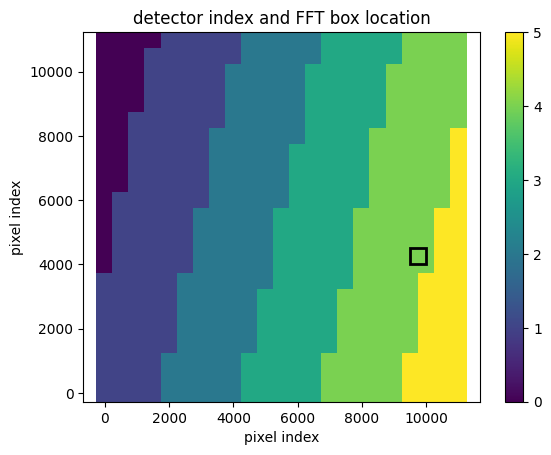

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


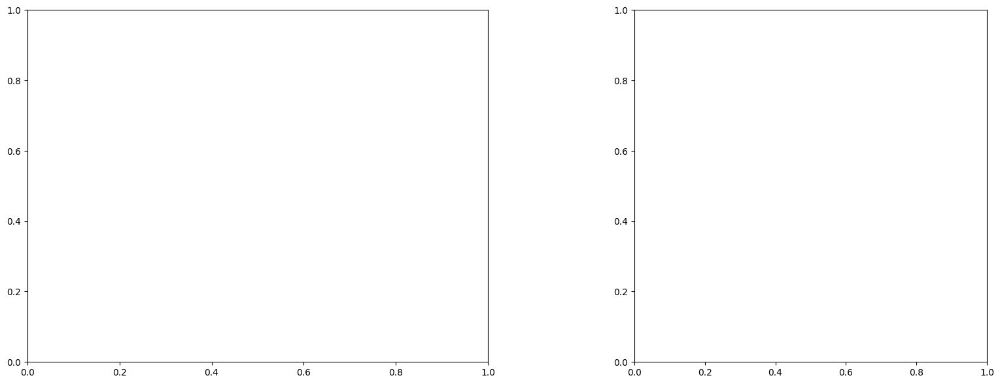

U and V components of current : [0.6616948  1.42803574]
uncertainties for U and V: 0.08746664011845381 0.14890105095836534


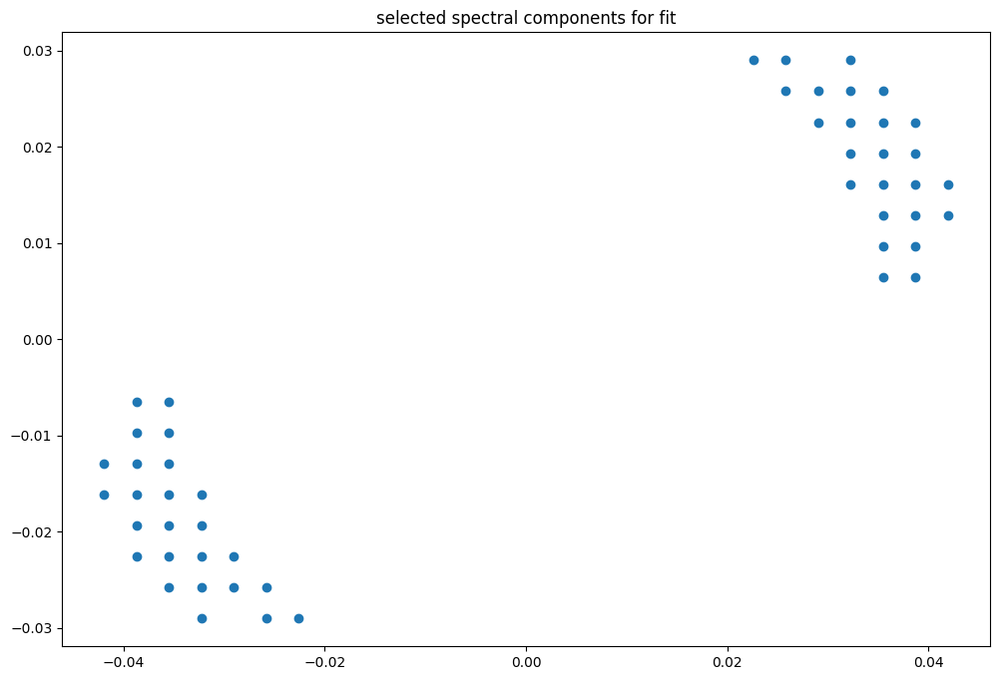

box [9500, 10000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

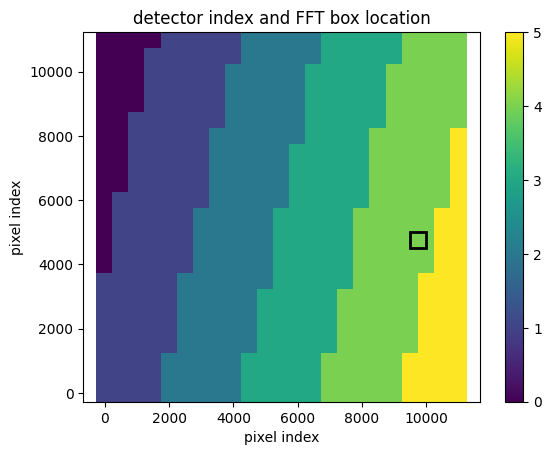

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


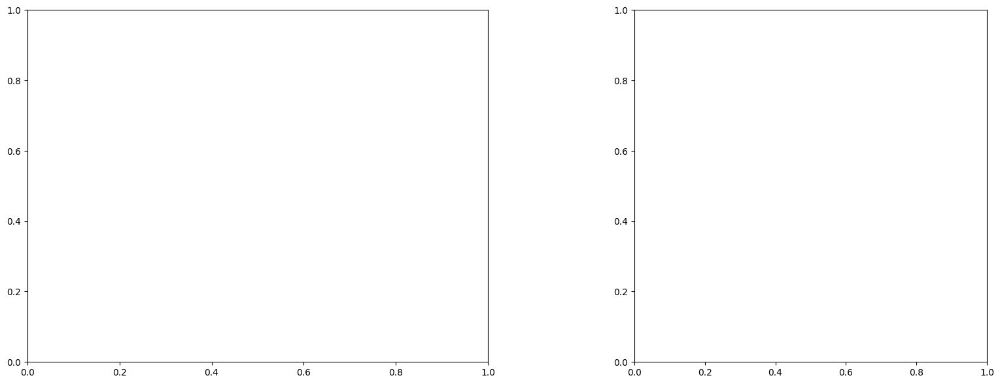

U and V components of current : [0.94178138 1.25871119]
uncertainties for U and V: 0.06036319717799468 0.09464058153265464


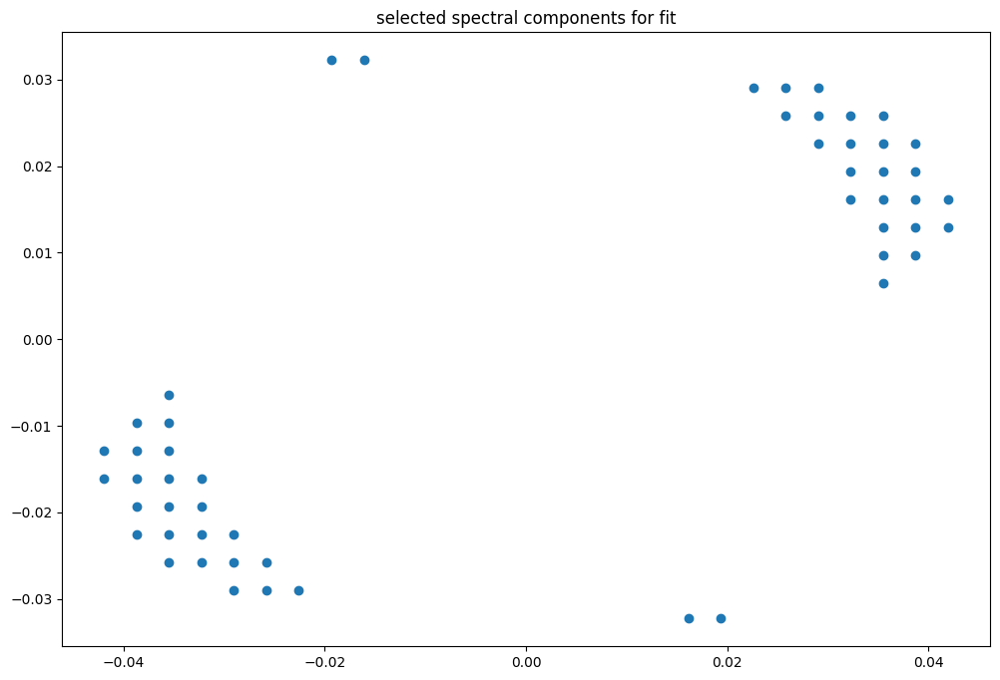

box [9500, 10000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

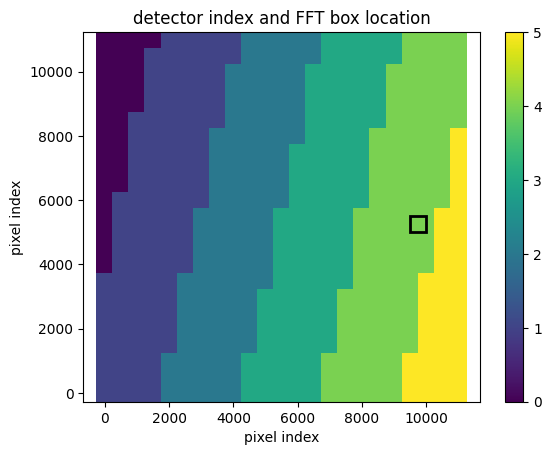

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


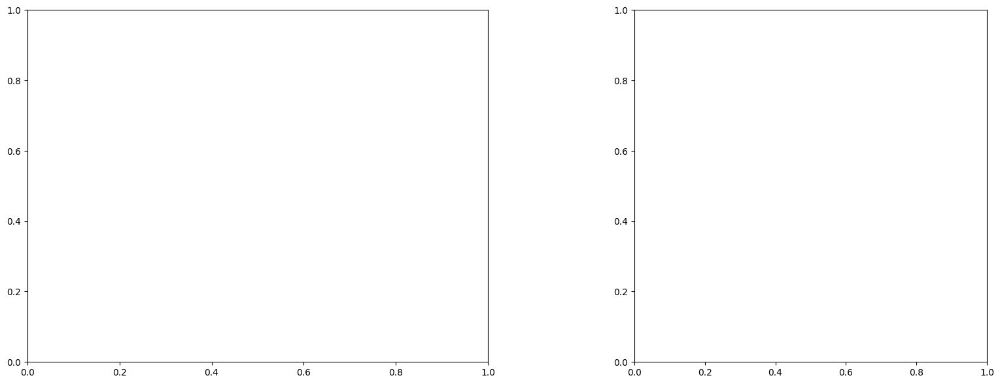

U and V components of current : [1.0598456  1.46102466]
uncertainties for U and V: 0.06839394507315273 0.10458390619284365


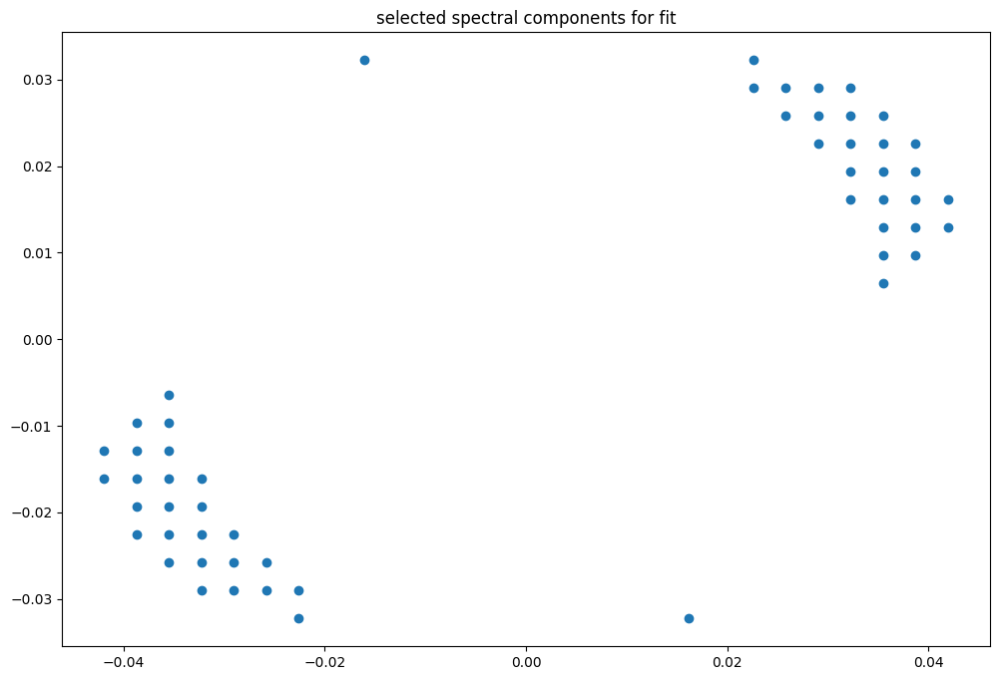

box [9500, 10000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

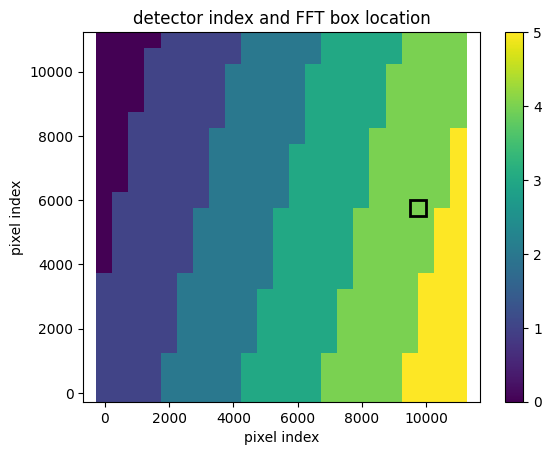

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


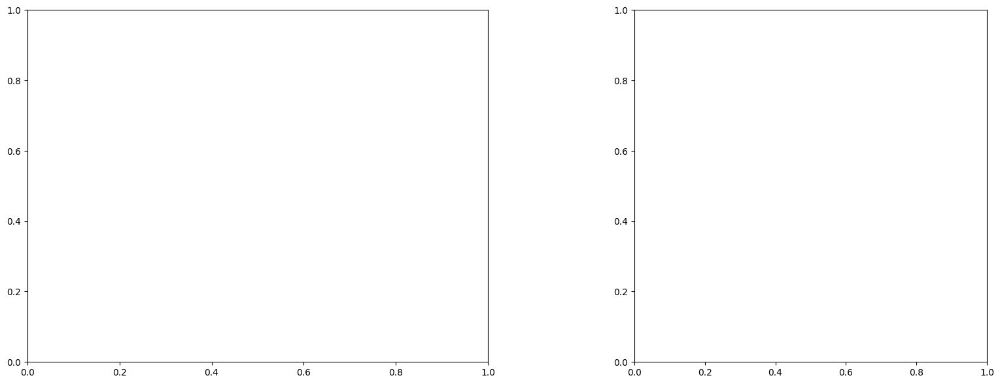

U and V components of current : [1.08496384 1.21562812]
uncertainties for U and V: 0.06542220974976325 0.0983125574641858


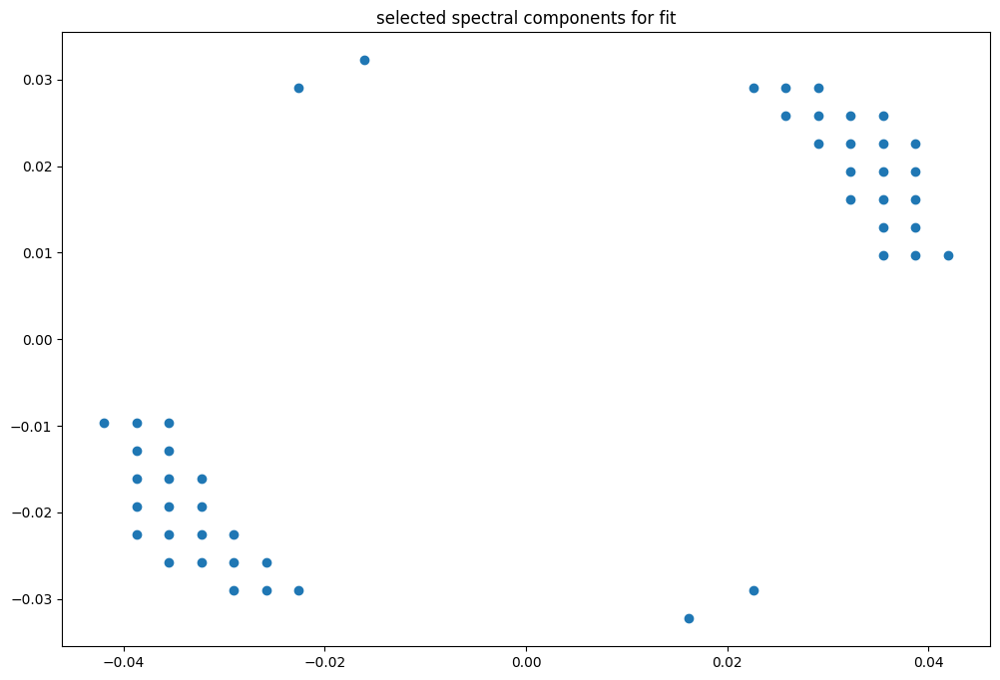

box [9500, 10000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

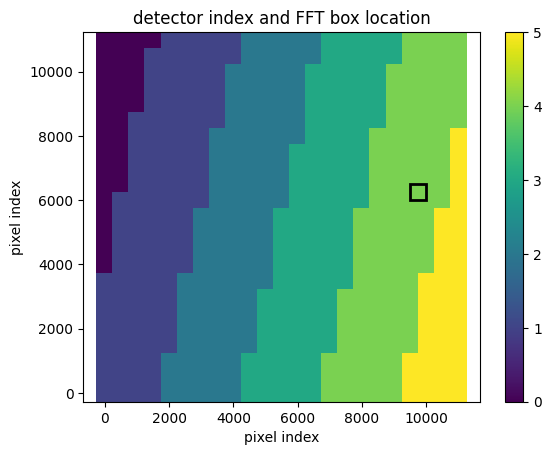

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


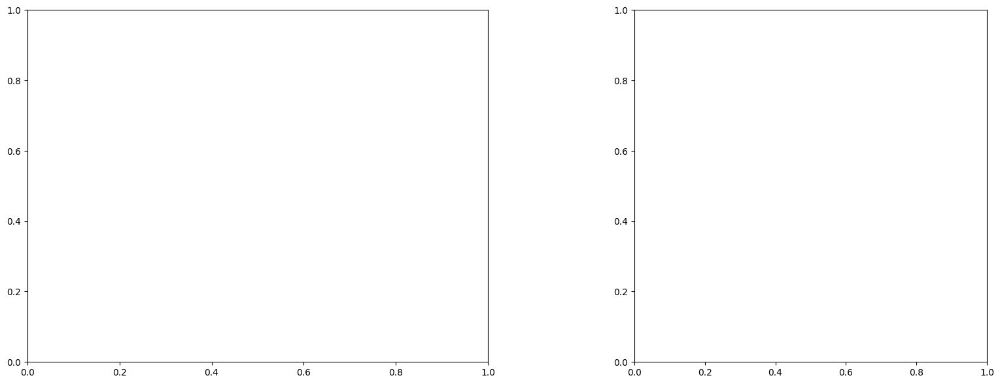

U and V components of current : [1.06623441 1.08853744]
uncertainties for U and V: 0.08206684518836249 0.11959846350532839


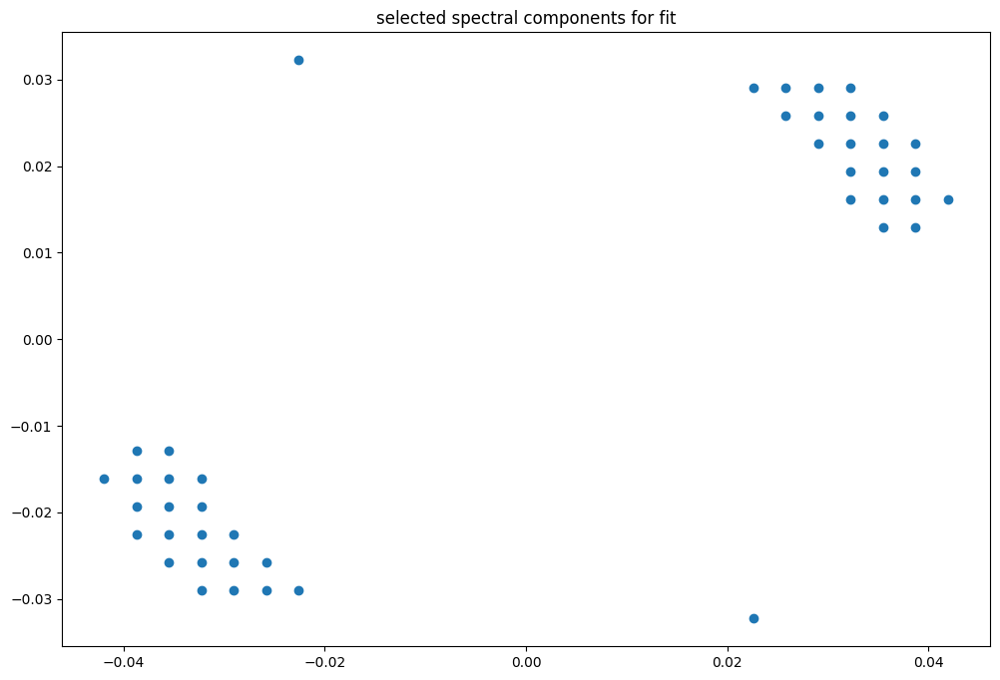

box [9500, 10000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

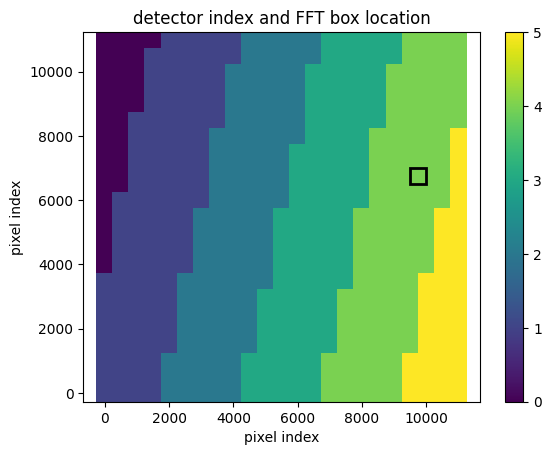

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


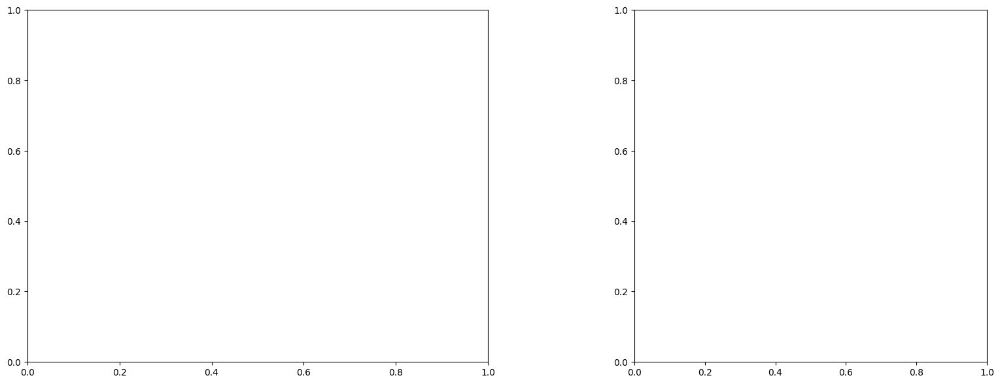

U and V components of current : [0.85587958 1.4974162 ]
uncertainties for U and V: 0.09918846845218025 0.1389215391948866


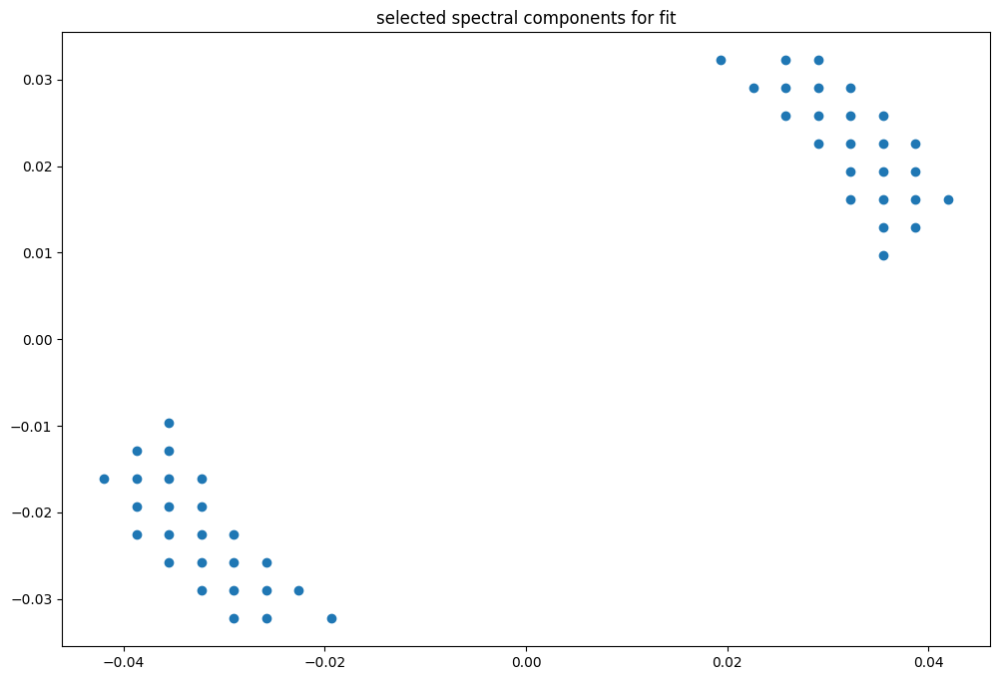

box [9500, 10000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

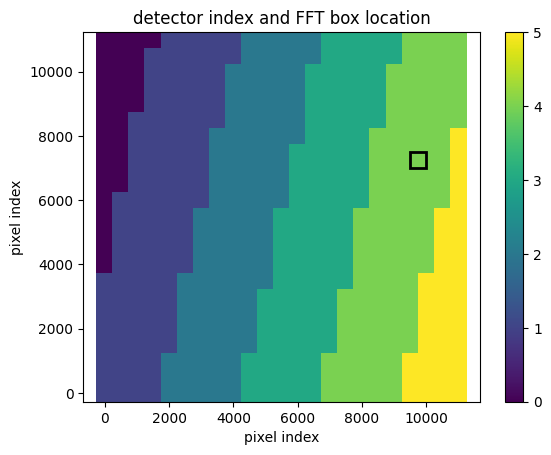

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


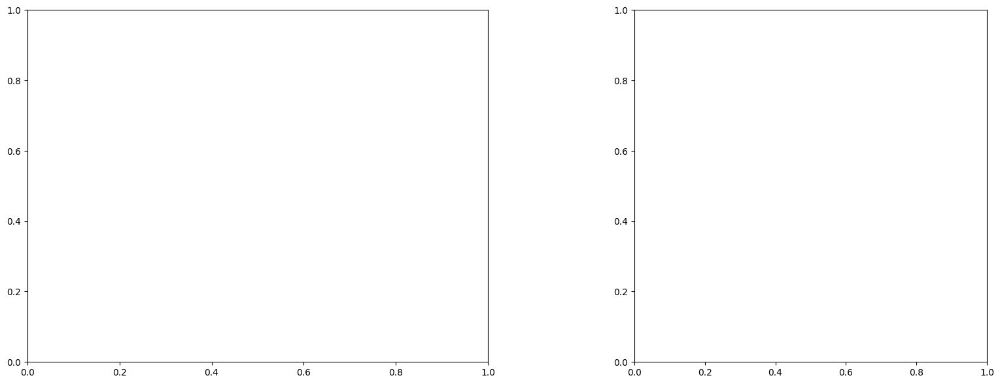

U and V components of current : [0.98266924 1.30279441]
uncertainties for U and V: 0.06380877980939491 0.08951984120321353


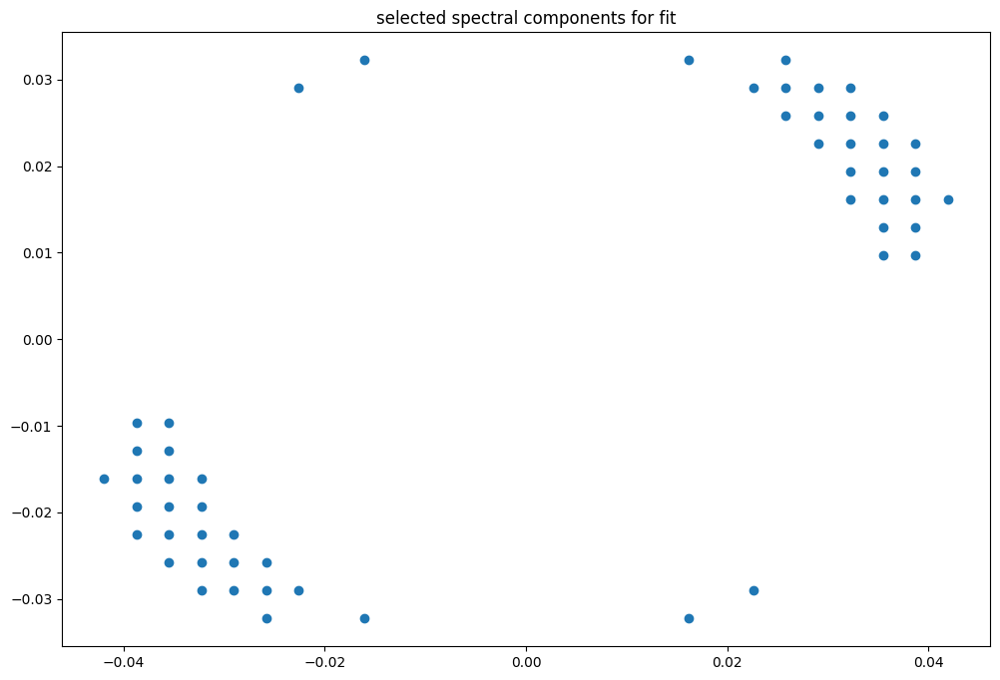

box [9500, 10000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

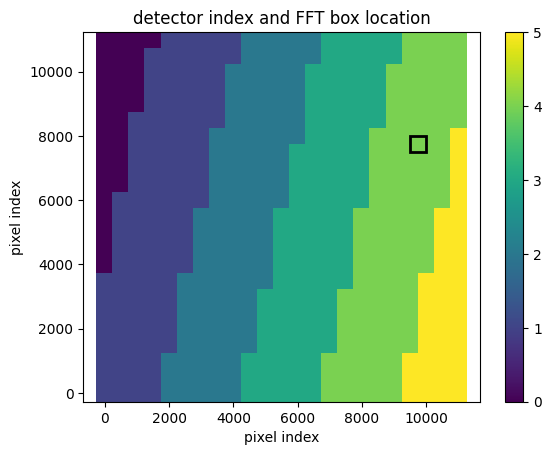

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


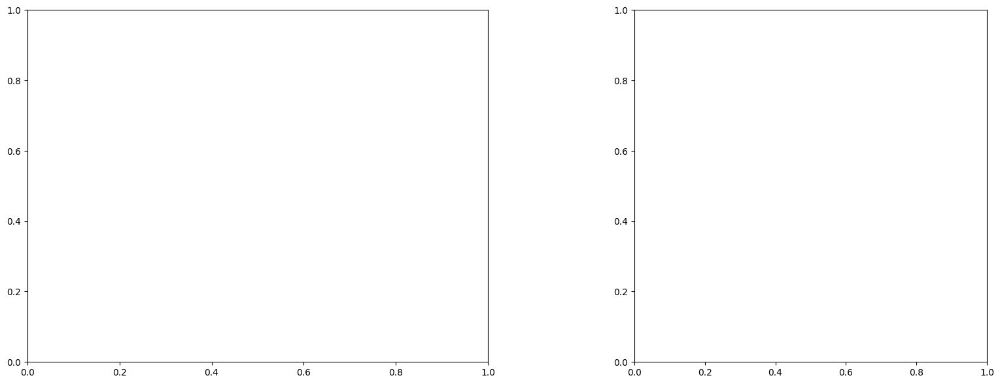

U and V components of current : [0.96154795 1.35680576]
uncertainties for U and V: 0.09017346999439477 0.11300422502689994


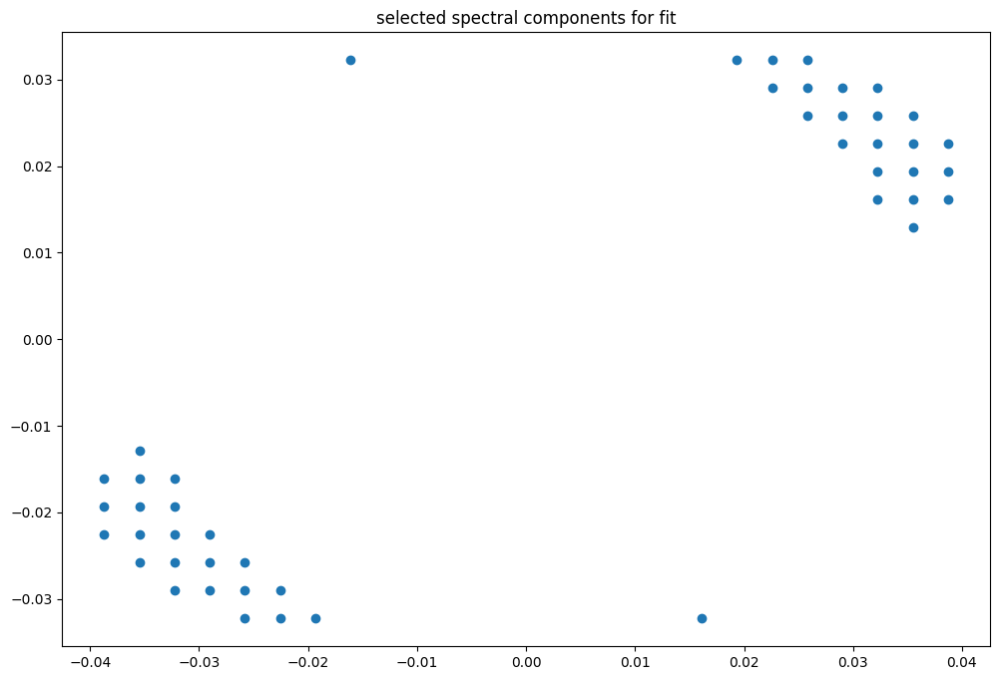

box [9500, 10000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

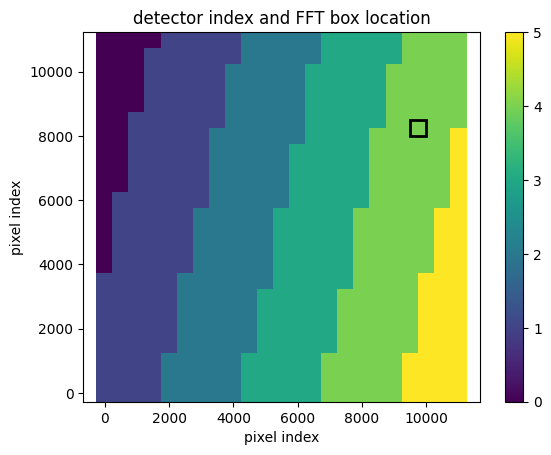

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(31, 31)
(31, 31)
(31, 31)


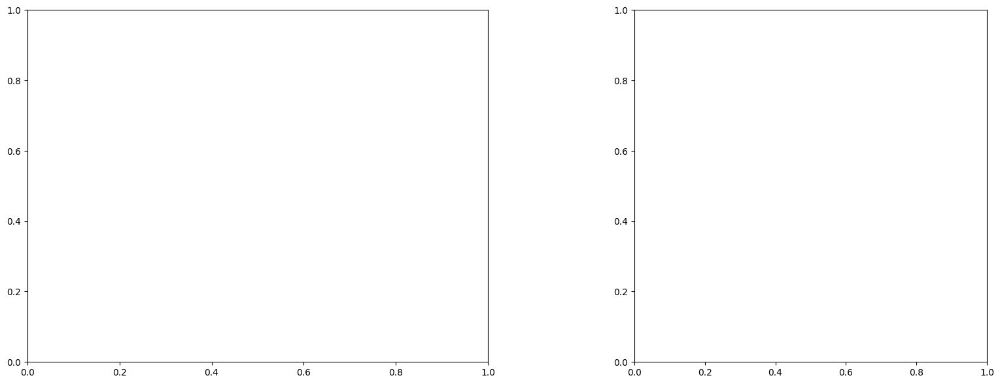

U and V components of current : [1.03424053 1.18072581]
uncertainties for U and V: 0.05561492350103212 0.05762582045730666


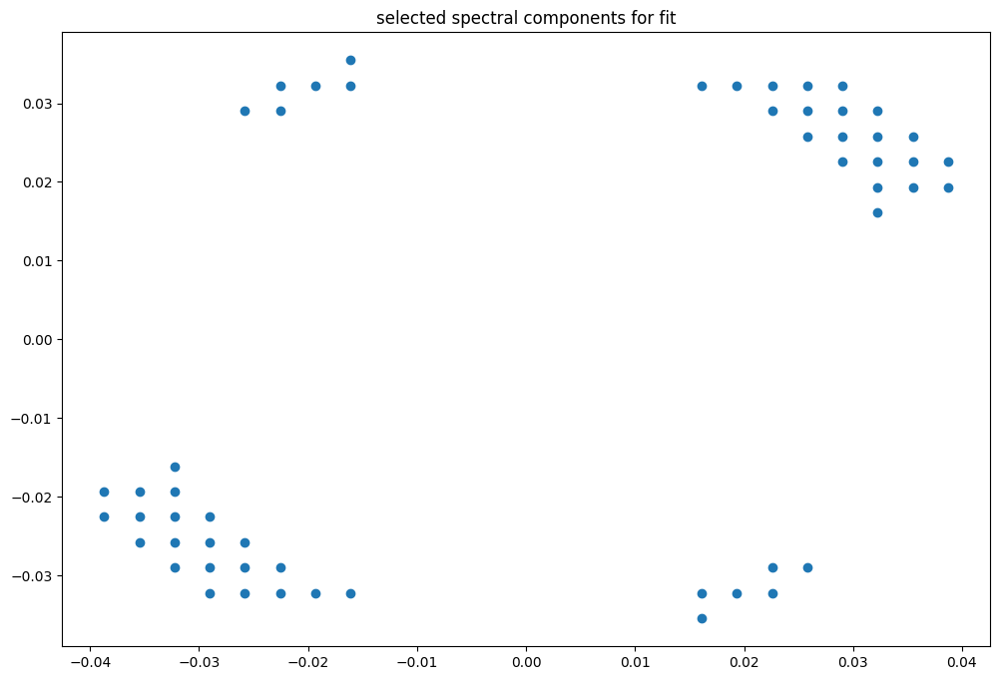

box [9500, 10000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

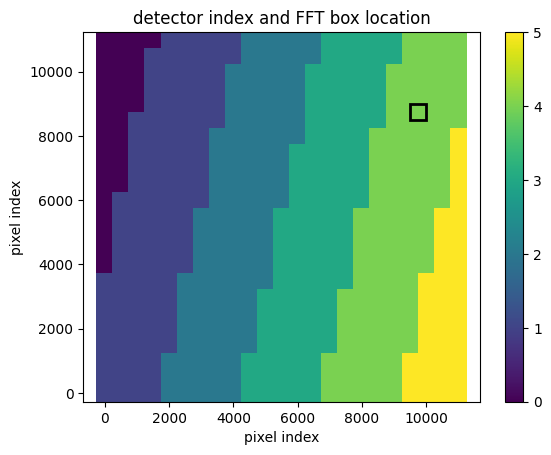

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


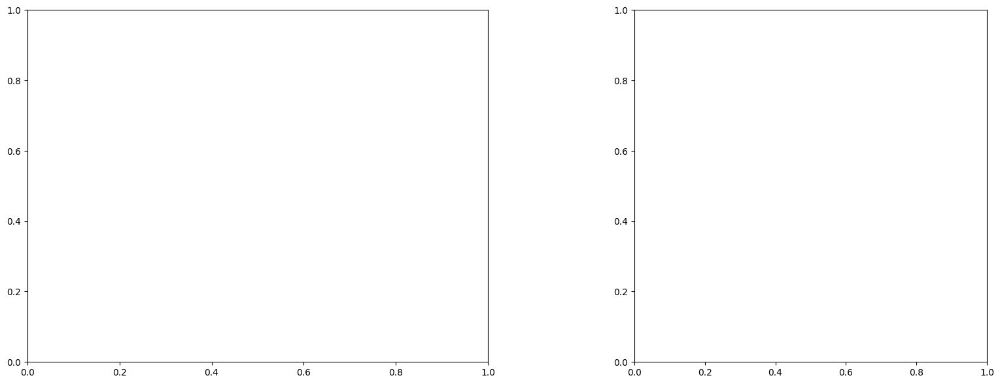

U and V components of current : [1.059968   1.42765192]
uncertainties for U and V: 0.043275048071305694 0.04255971468729665


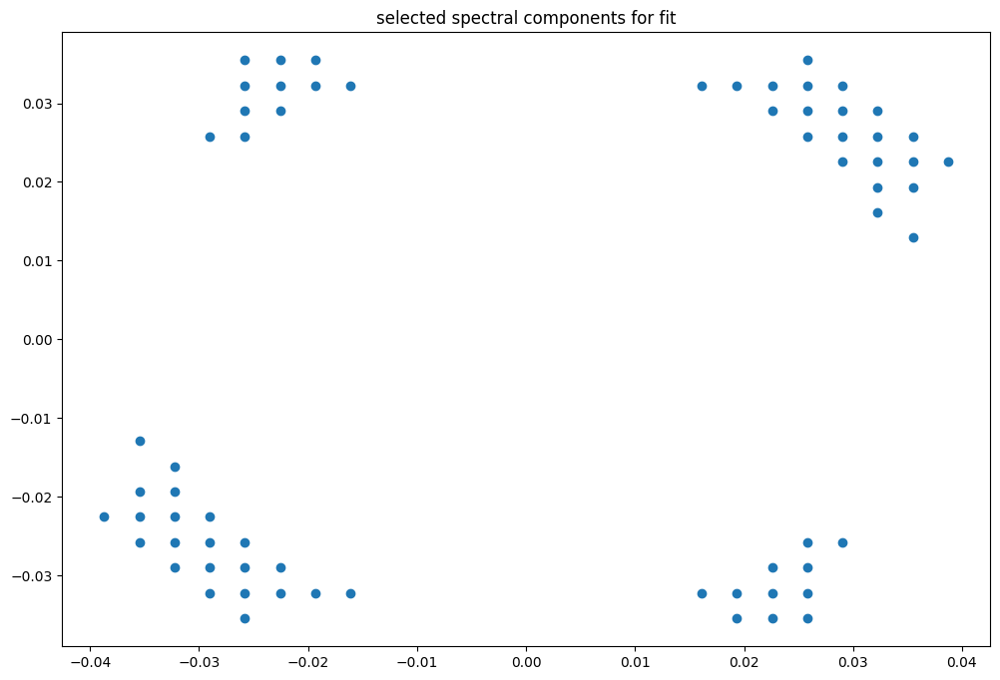

box [9500, 10000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

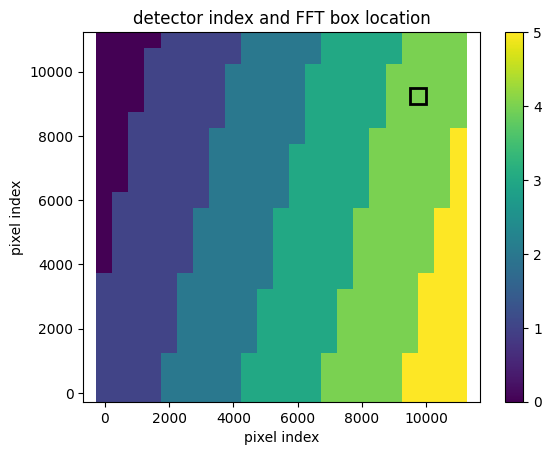

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


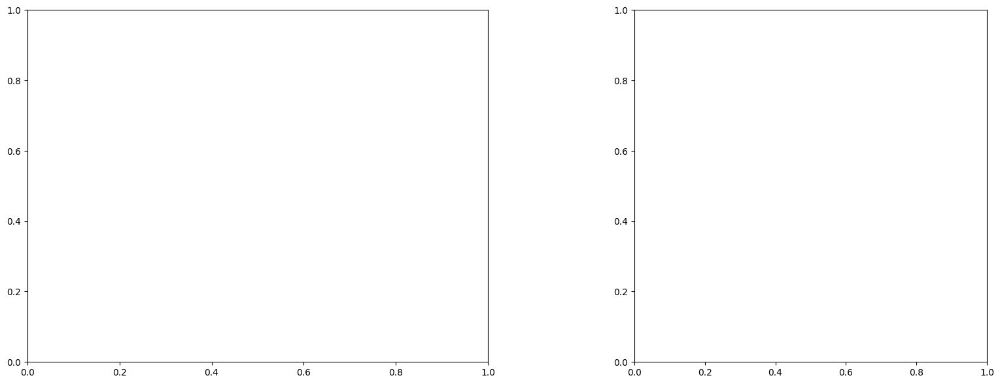

U and V components of current : [1.09978887 0.81944686]
uncertainties for U and V: 0.05916712876007112 0.051138772376672706


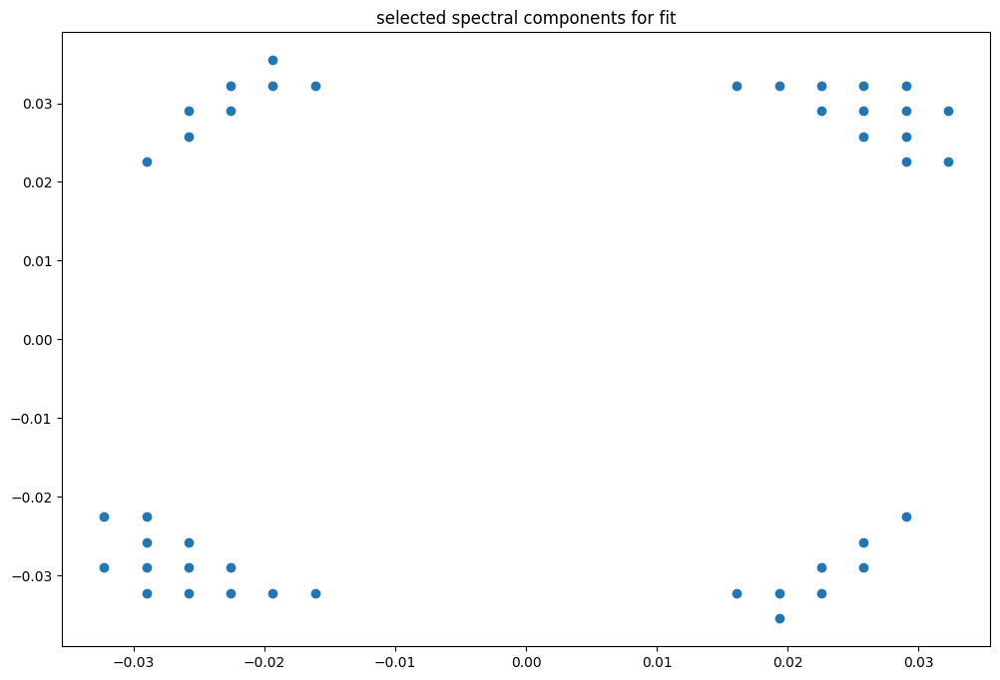

box [9500, 10000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

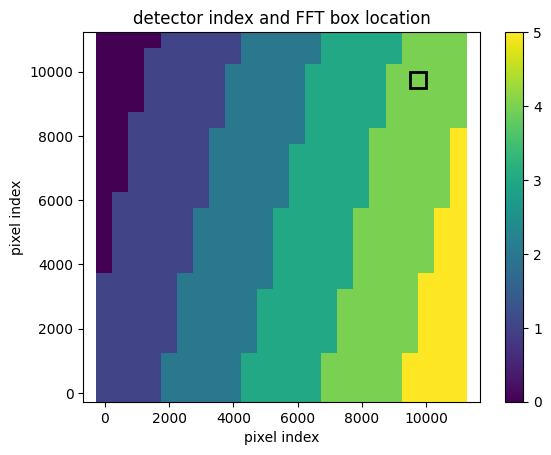

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(31, 31)
(31, 31)
(31, 31)


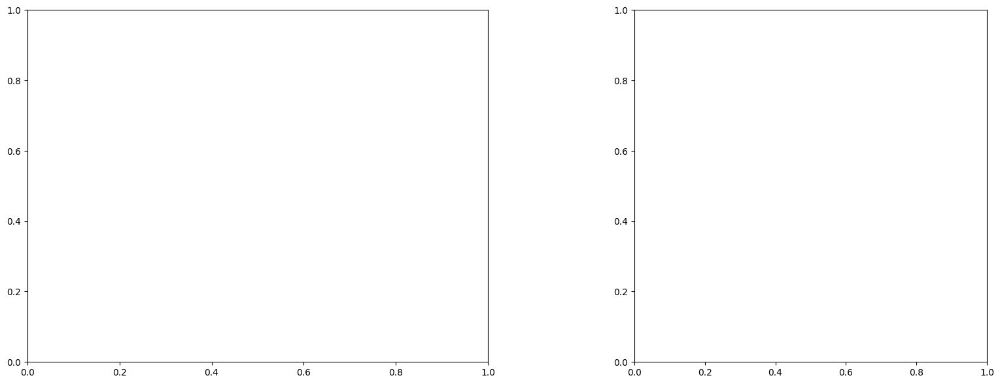

U and V components of current : [1.14471125 1.03749474]
uncertainties for U and V: 0.04990485085929701 0.0427140126657961


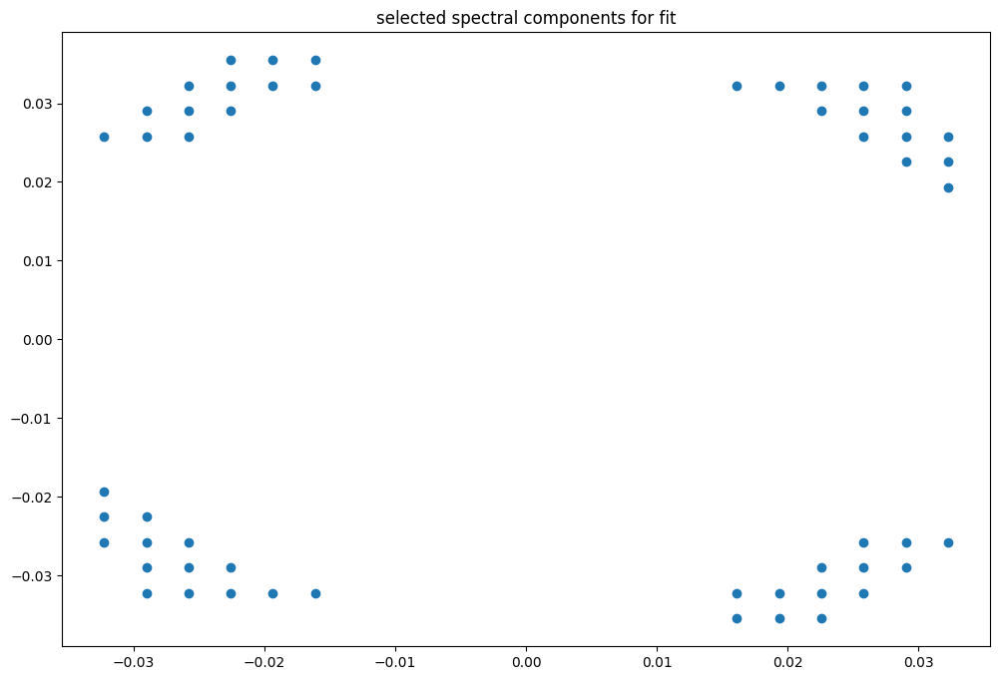

box [9500, 10000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Read

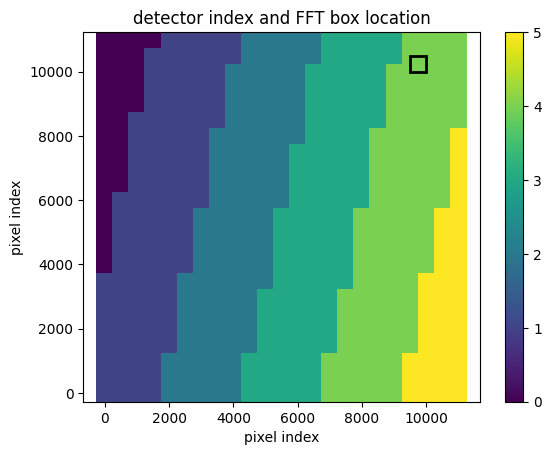

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(31, 31)
(31, 31)
(31, 31)


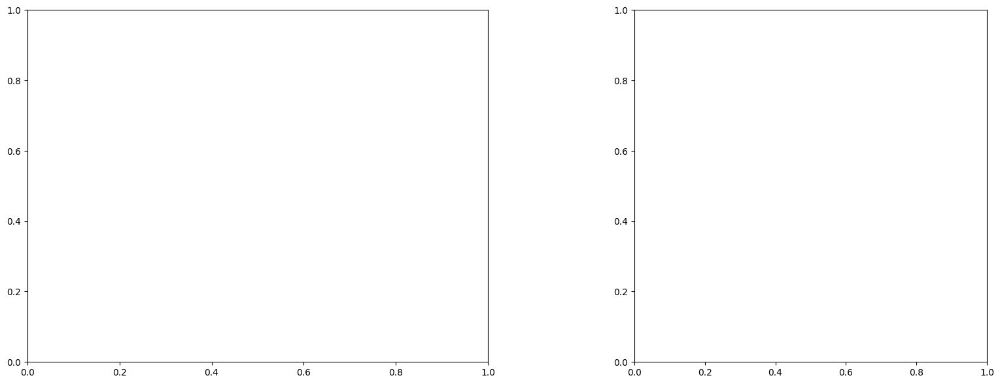

U and V components of current : [1.0827423  0.96188956]
uncertainties for U and V: 0.0542841157969623 0.04472186140659996


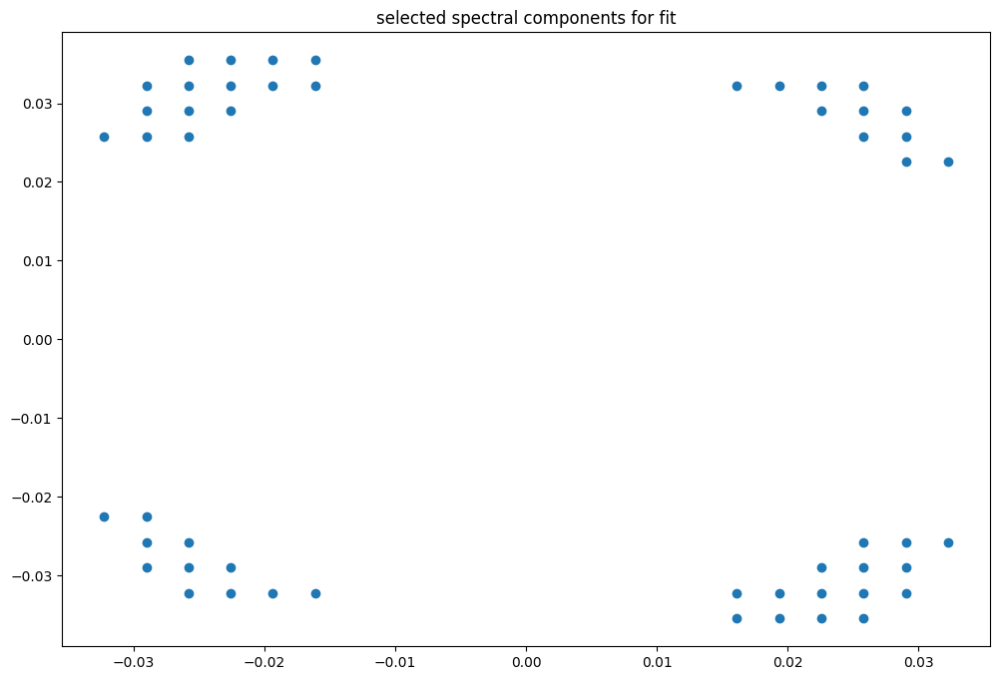

box [9500, 10000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Read

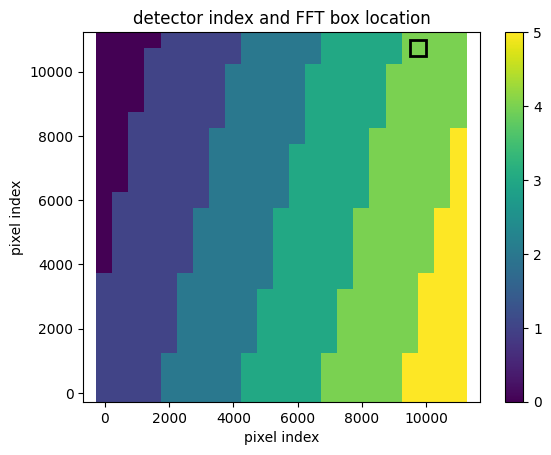

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(31, 30)
(31, 30)
(31, 30)


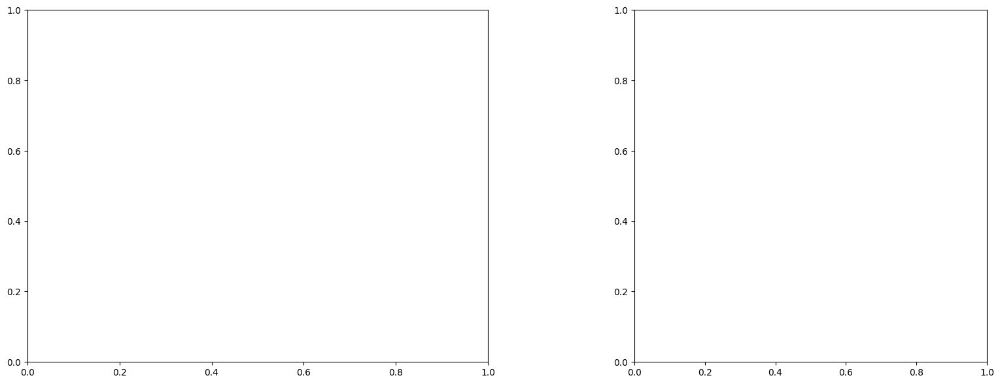

U and V components of current : [0.87443669 0.8556328 ]
uncertainties for U and V: 0.05361996195519216 0.042495666442348534


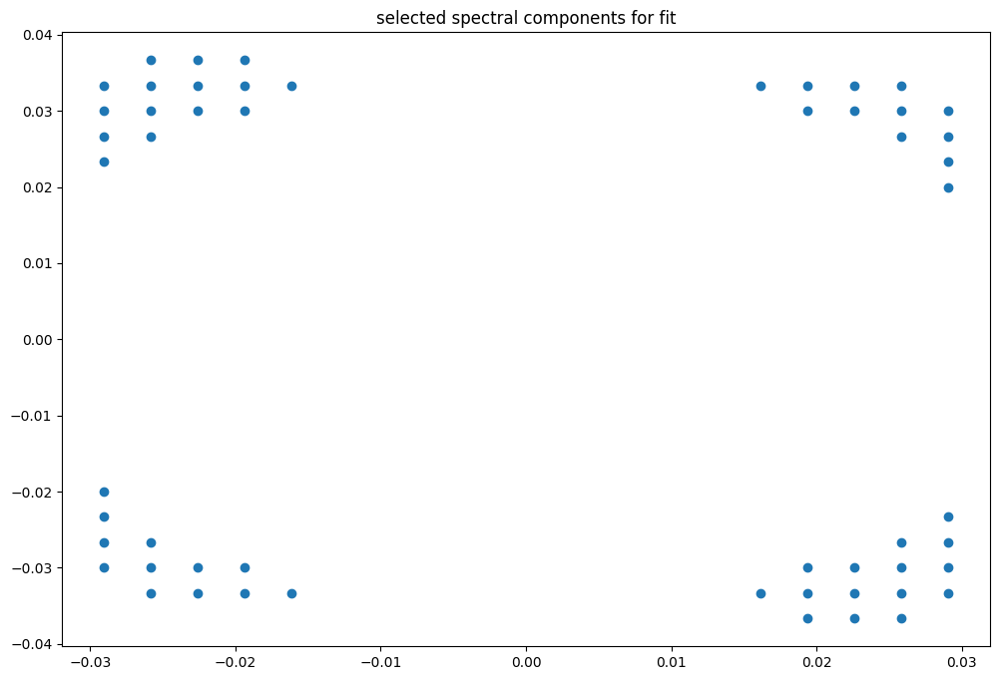

box [10000, 10500, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

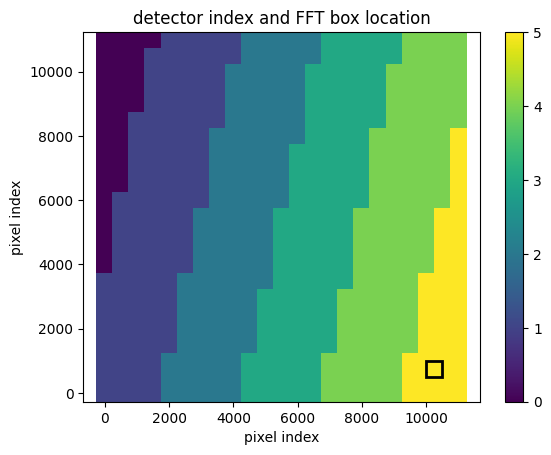

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876730752059386
(31, 31)
(31, 31)
(31, 31)


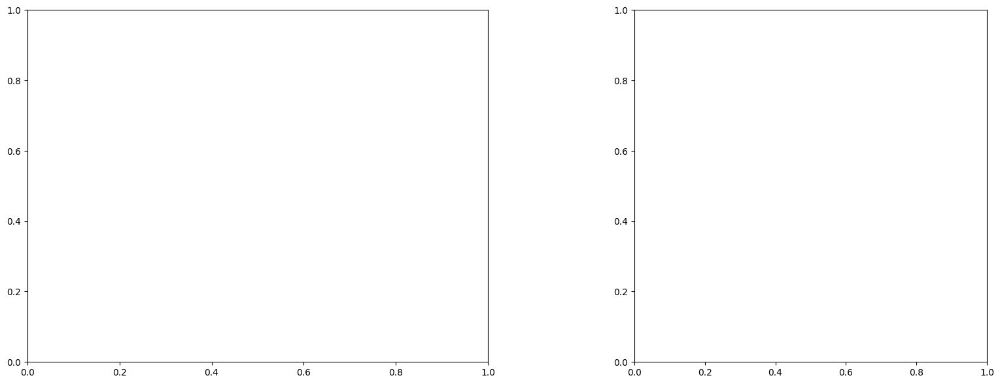

U and V components of current : [0.42332737 1.66561291]
uncertainties for U and V: 0.07786974549798745 0.16339116327560188


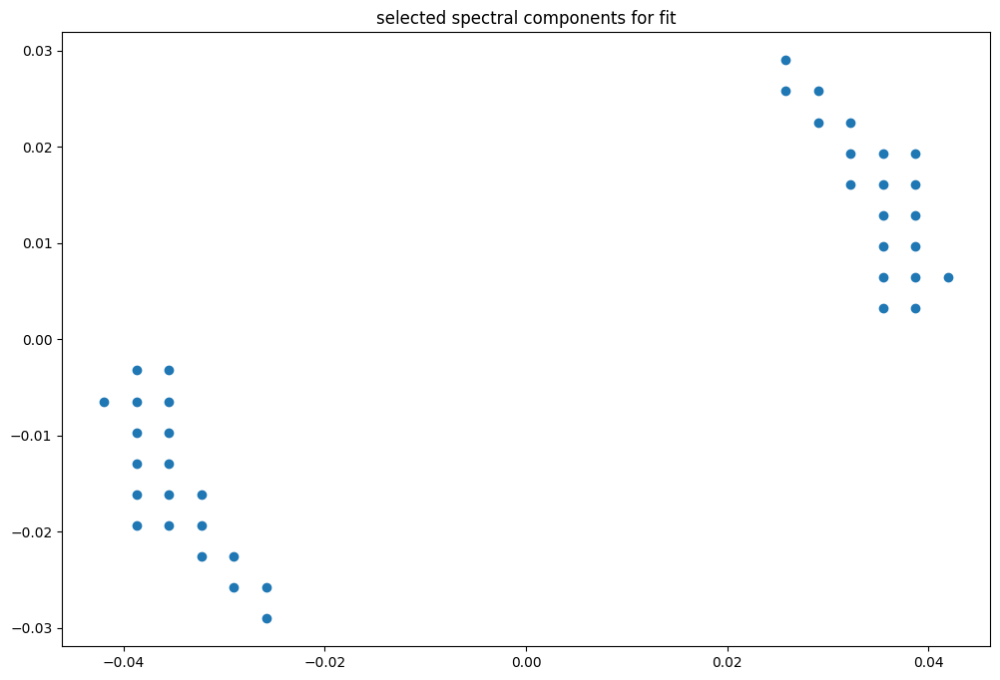

box [10000, 10500, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

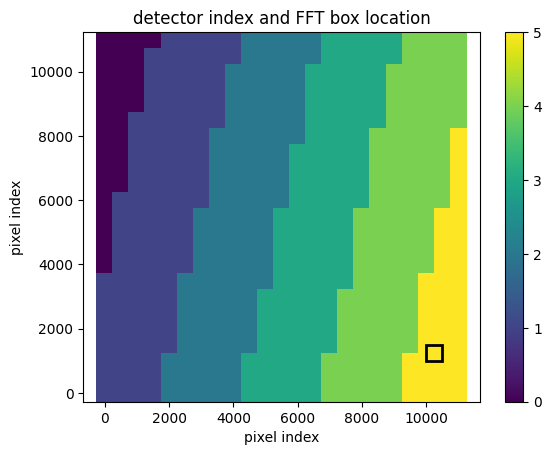

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876696255202555
(31, 31)
(31, 31)
(31, 31)


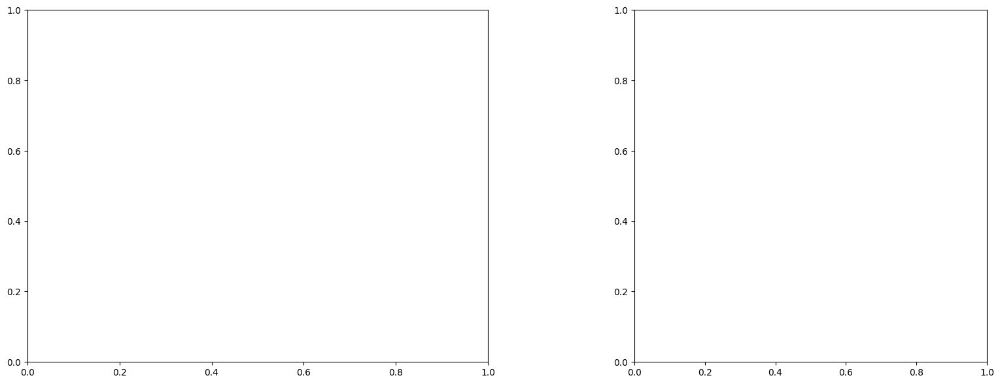

U and V components of current : [0.57332339 1.23134781]
uncertainties for U and V: 0.0746193988325132 0.16282112992880257


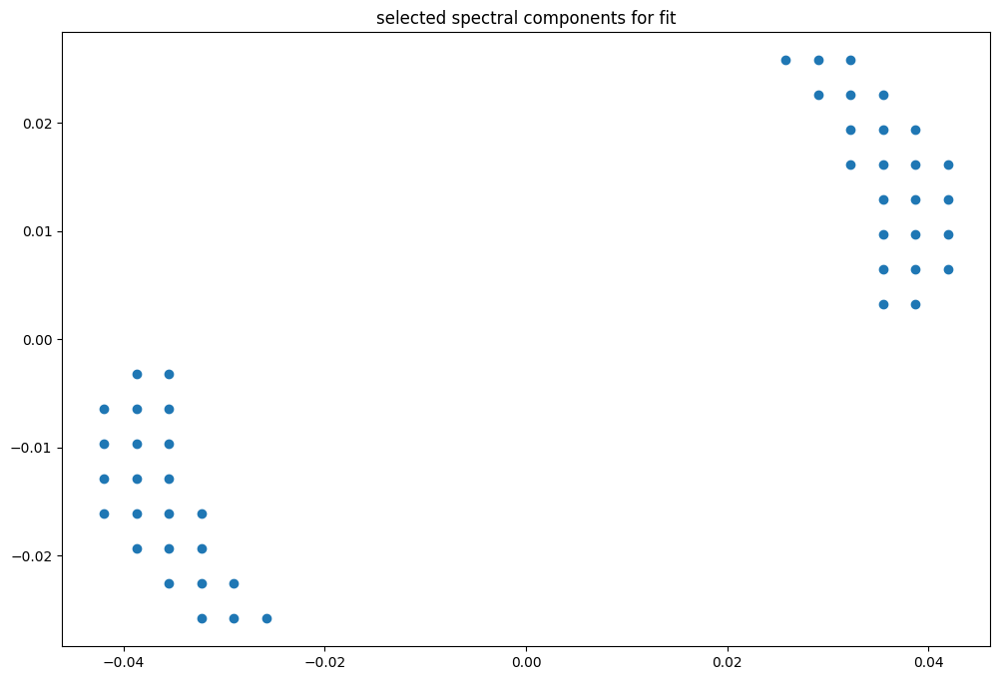

box [10000, 10500, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

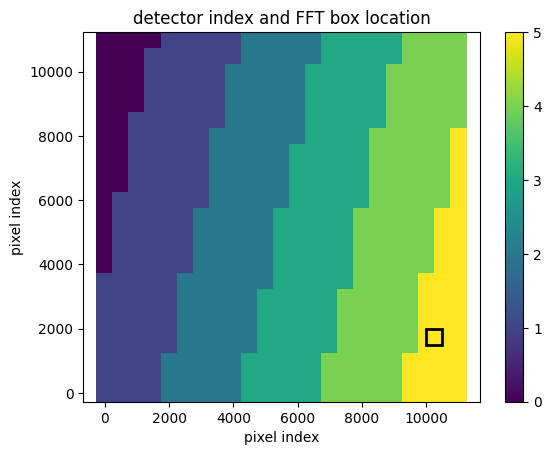

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876696255202555
(31, 31)
(31, 31)
(31, 31)


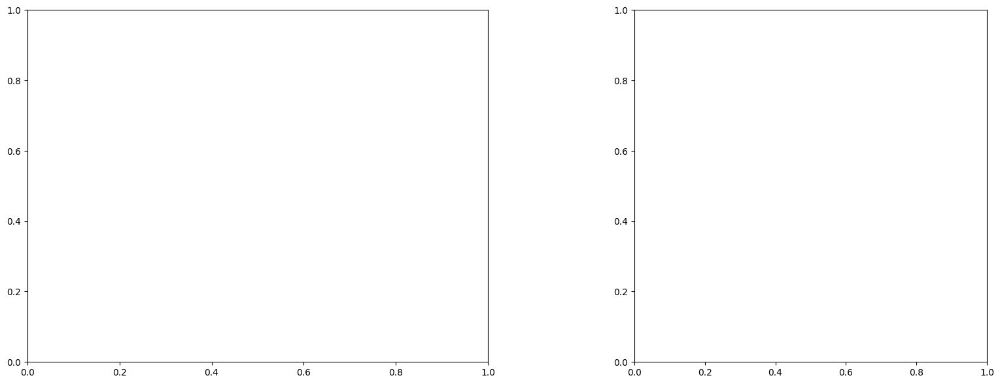

U and V components of current : [0.62088722 1.25245319]
uncertainties for U and V: 0.07389753220708896 0.151518315292725


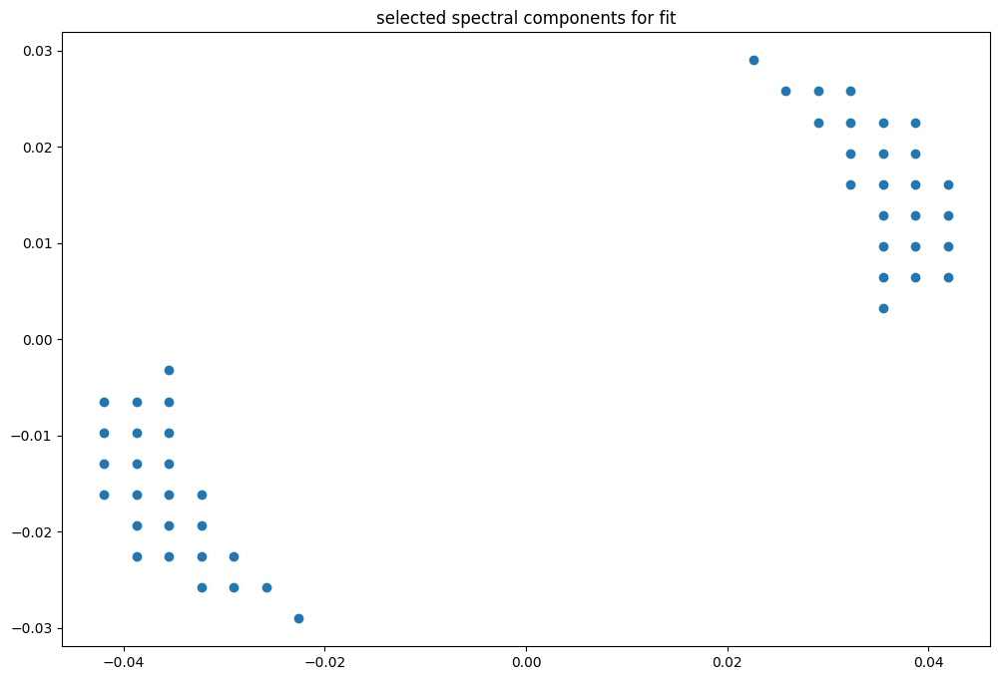

box [10000, 10500, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

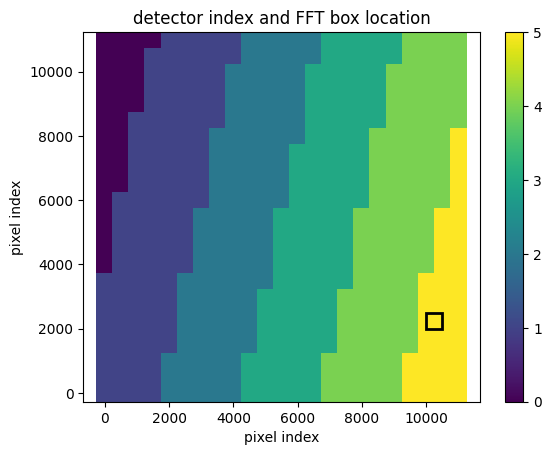

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876661172269913
(31, 31)
(31, 31)
(31, 31)


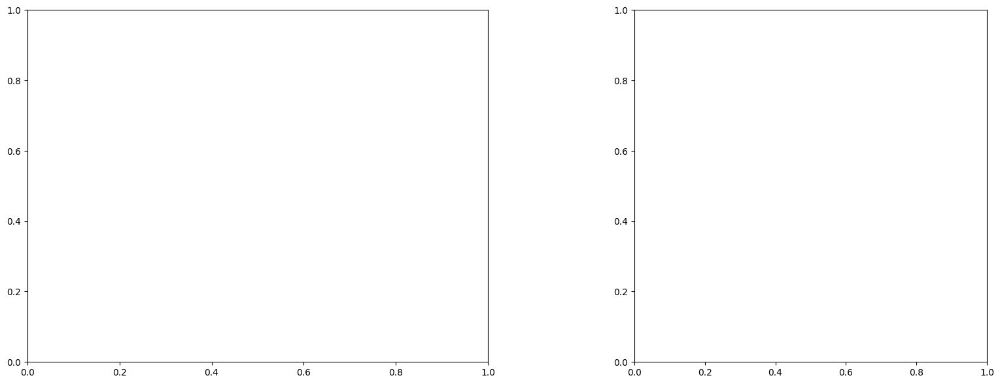

U and V components of current : [0.48993732 1.70856867]
uncertainties for U and V: 0.07573230342217009 0.15553560941001293


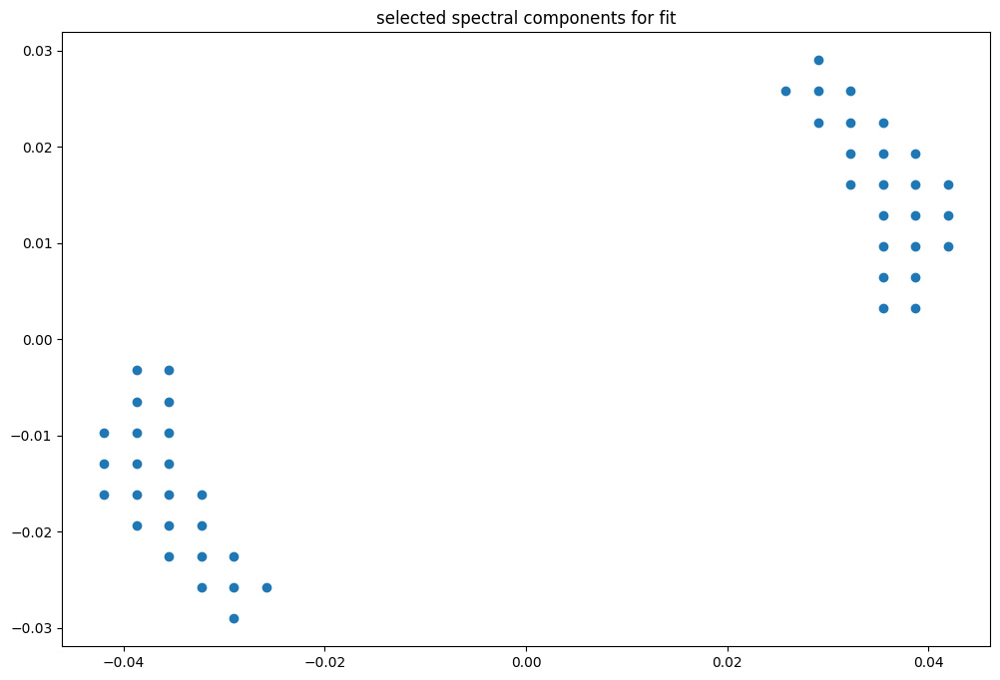

box [10000, 10500, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

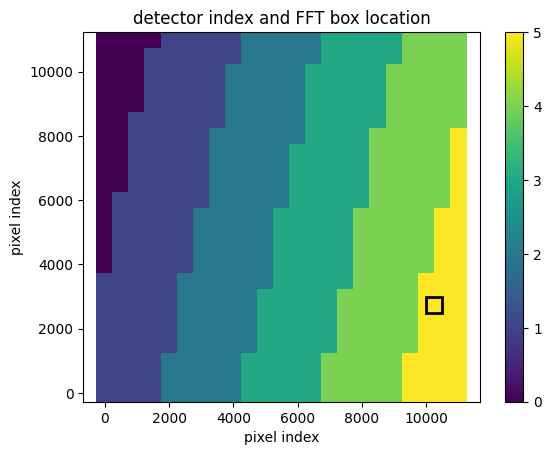

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876628360791453
(31, 31)
(31, 31)
(31, 31)


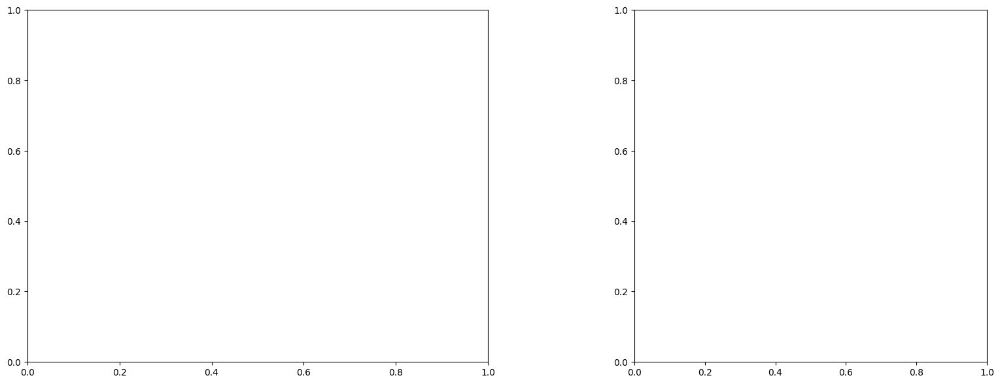

U and V components of current : [0.60908008 1.00931113]
uncertainties for U and V: 0.0711041618983826 0.13483711107043075


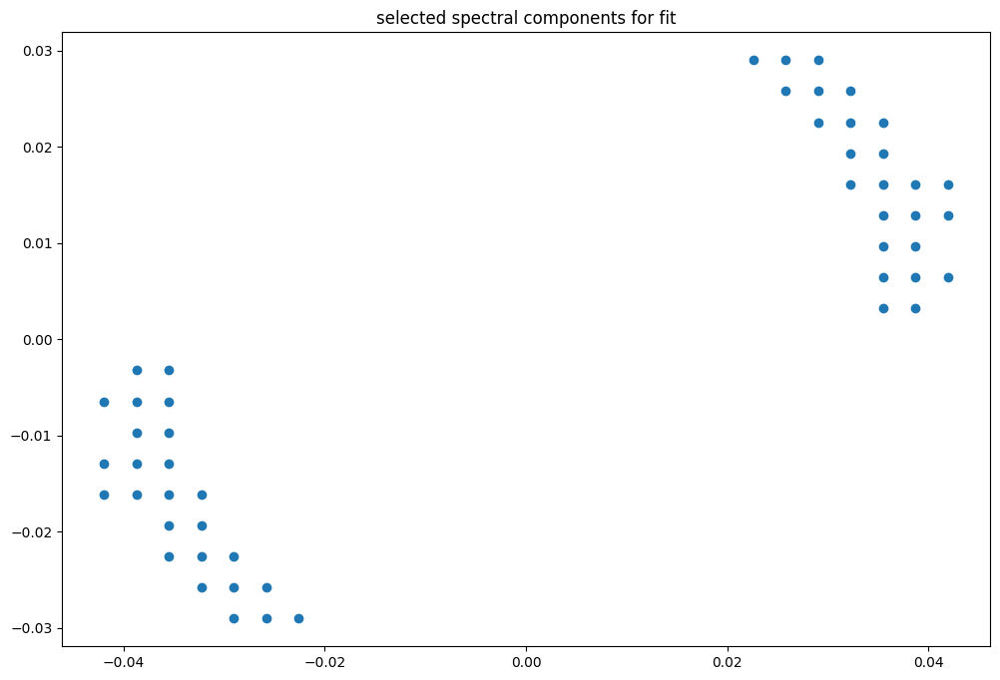

box [10000, 10500, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

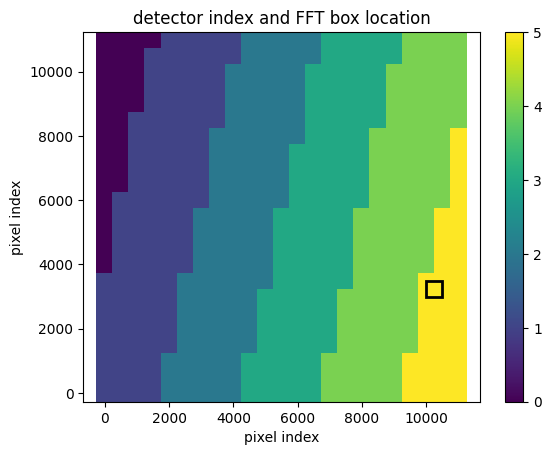

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.987659709308897
(31, 31)
(31, 31)
(31, 31)


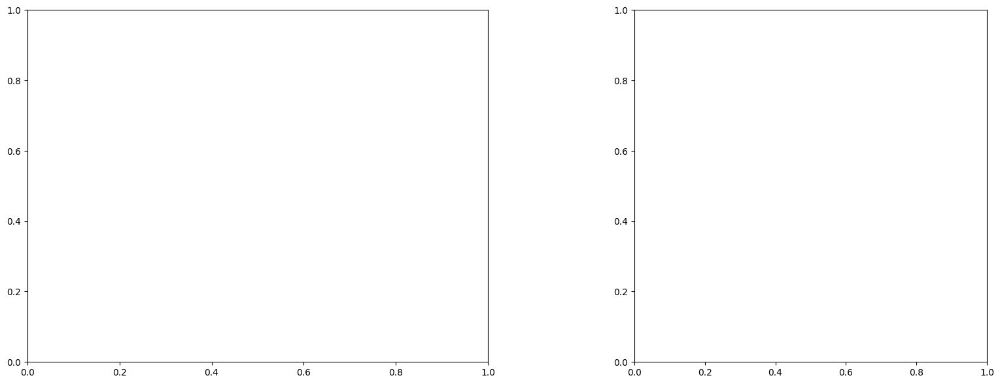

U and V components of current : [0.72168893 1.16297131]
uncertainties for U and V: 0.117940198258097 0.2295598684549306


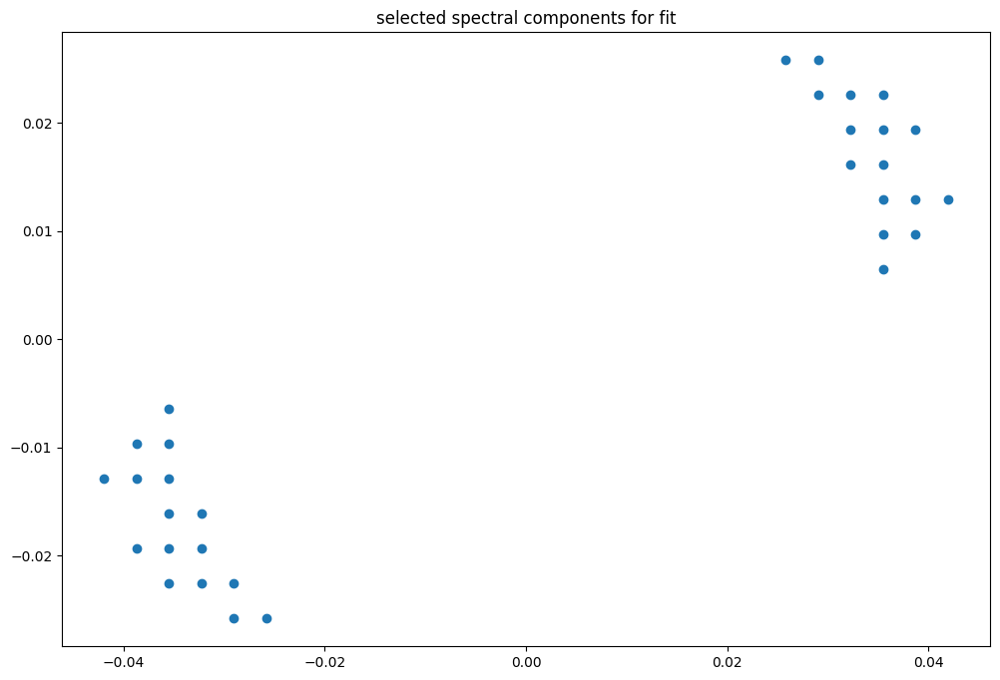

box [10000, 10500, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

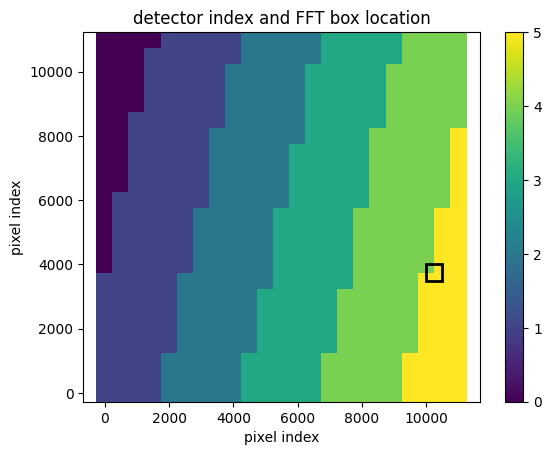

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.500000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.987659709308897
(31, 31)
(31, 31)
(31, 31)


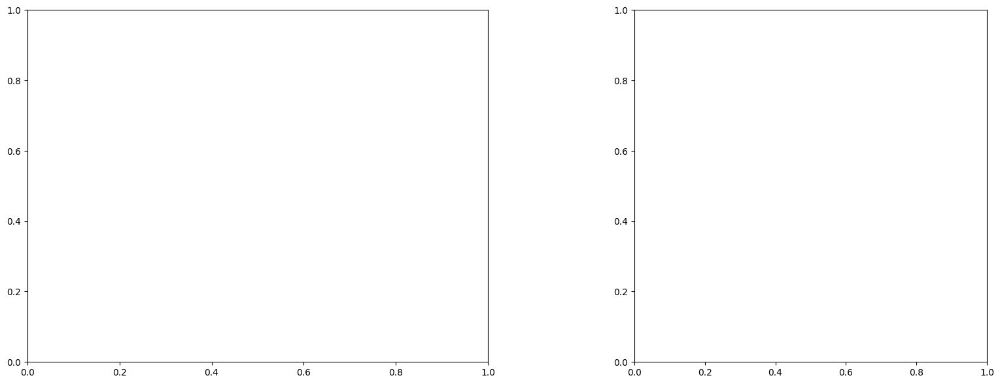

LinAlgError: Singular matrix

box [10000, 10500, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

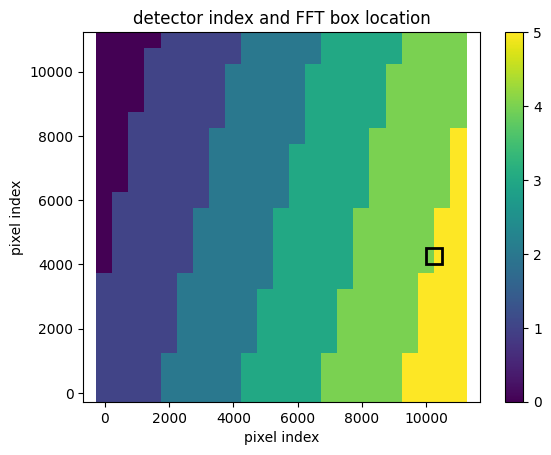

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987185769229658
(31, 31)
(31, 31)
(31, 31)


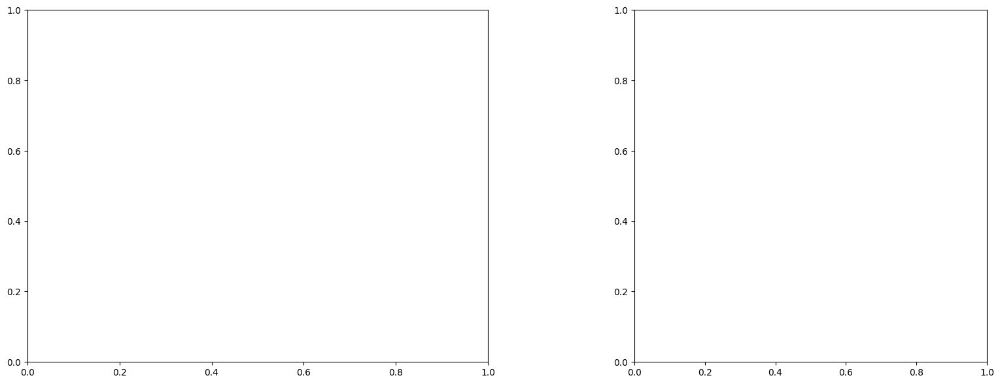

LinAlgError: Singular matrix

box [10000, 10500, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

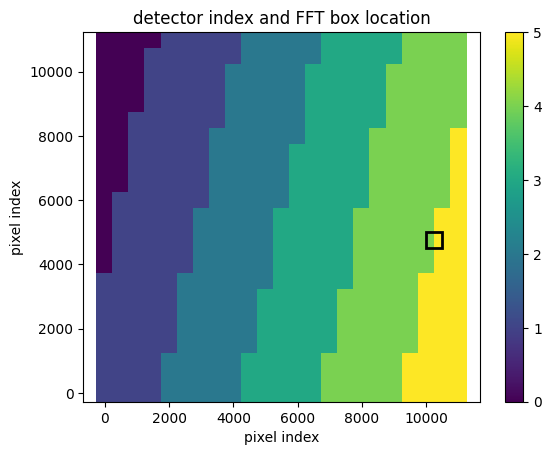

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987151672021304
(31, 31)
(31, 31)
(31, 31)


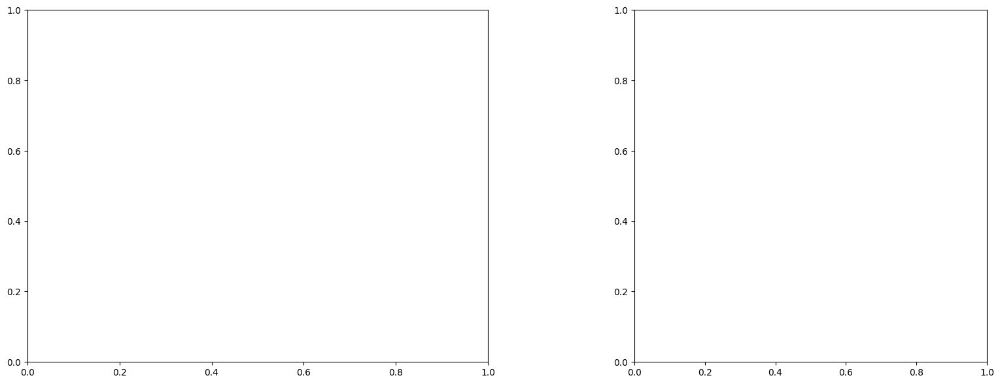

LinAlgError: Singular matrix

box [10000, 10500, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

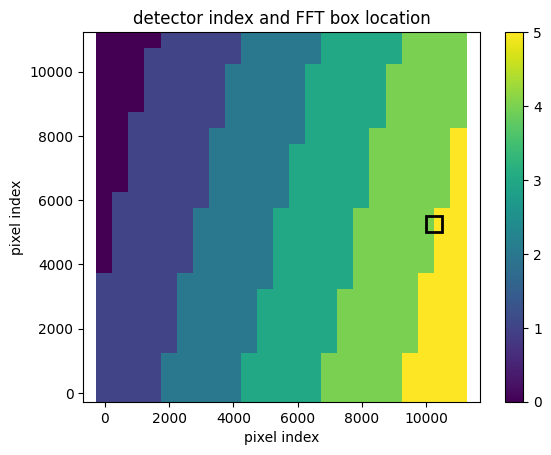

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


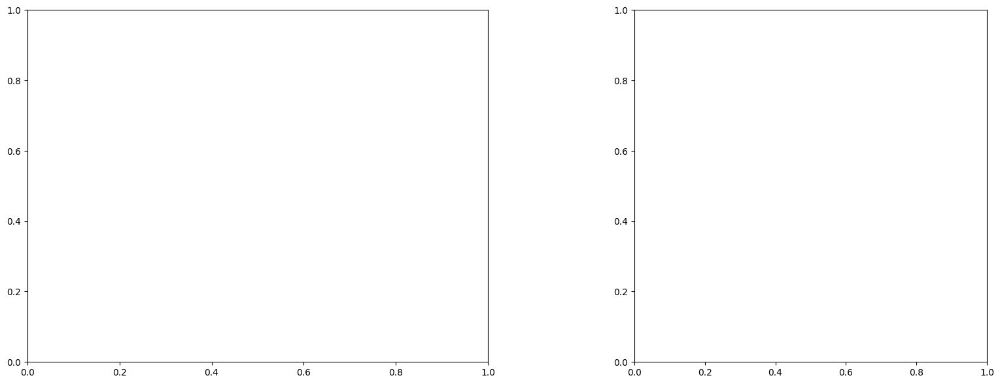

LinAlgError: Singular matrix

box [10000, 10500, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

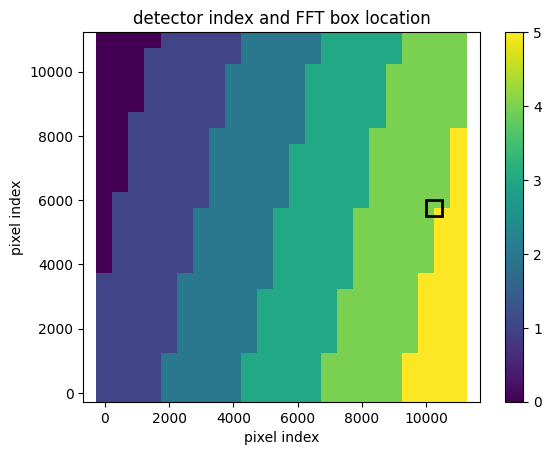

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(31, 31)
(31, 31)
(31, 31)


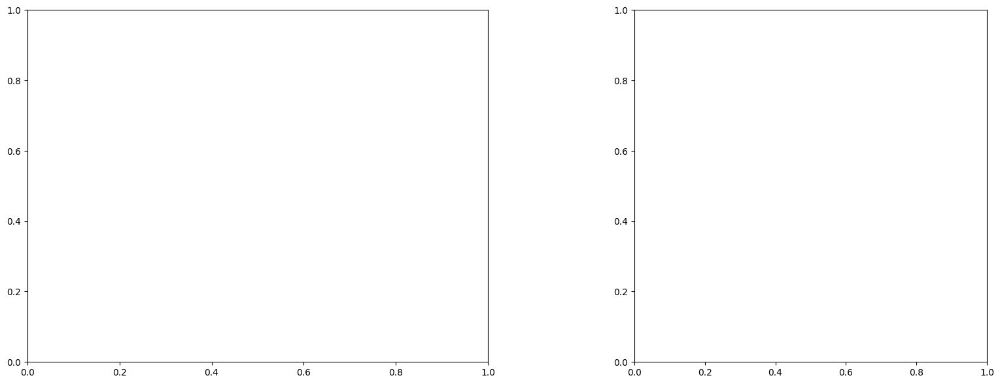

U and V components of current : [0.69824928 1.3766789 ]
uncertainties for U and V: 0.10177903903176984 0.16759268064339158


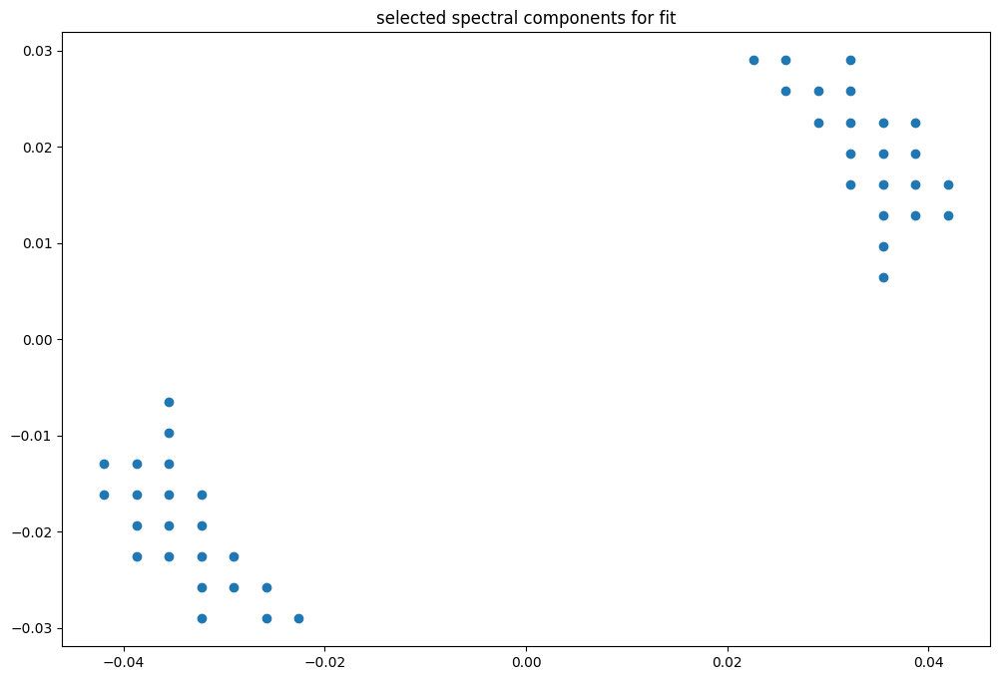

box [10000, 10500, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

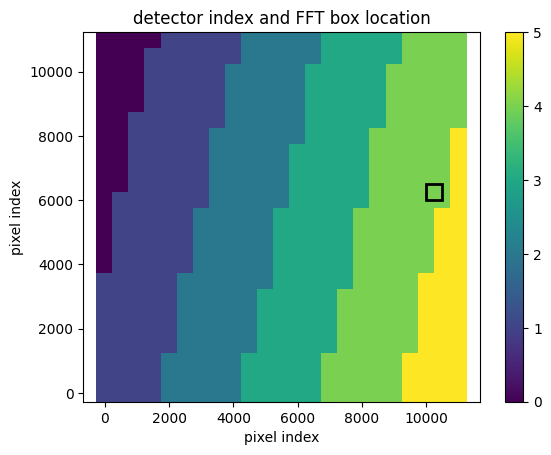

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987090730536545
(31, 31)
(31, 31)
(31, 31)


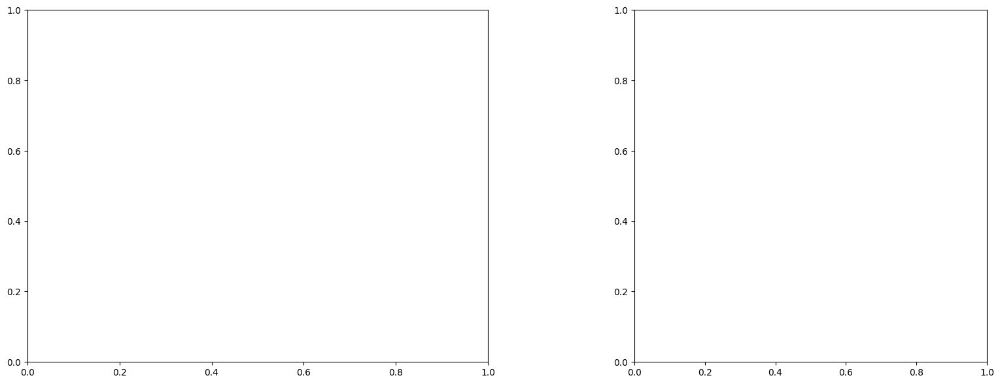

U and V components of current : [0.80173345 1.29441031]
uncertainties for U and V: 0.08305172213298684 0.12559108074196973


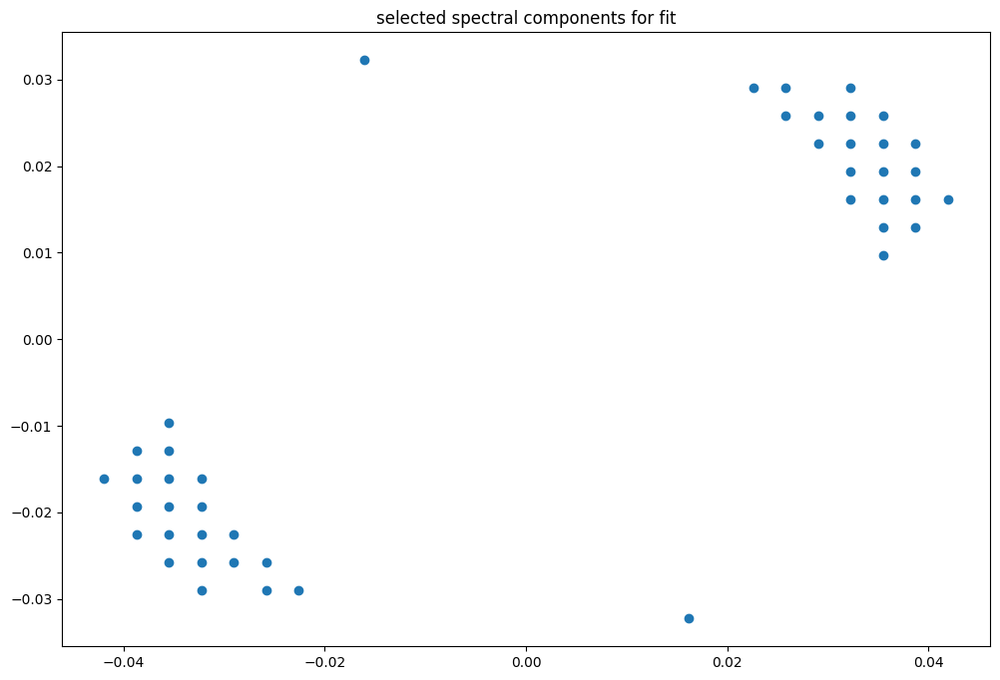

box [10000, 10500, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

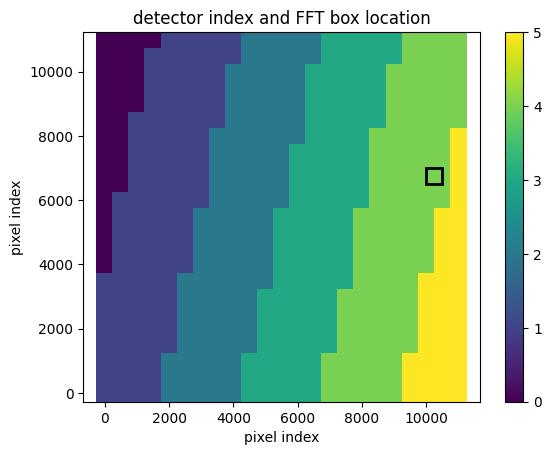

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(31, 31)
(31, 31)
(31, 31)


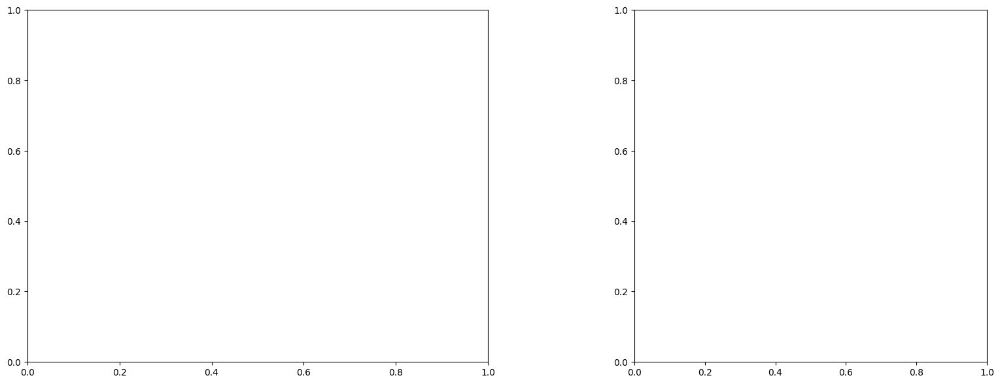

U and V components of current : [0.99543928 1.28752751]
uncertainties for U and V: 0.10506449823831514 0.1535095716968186


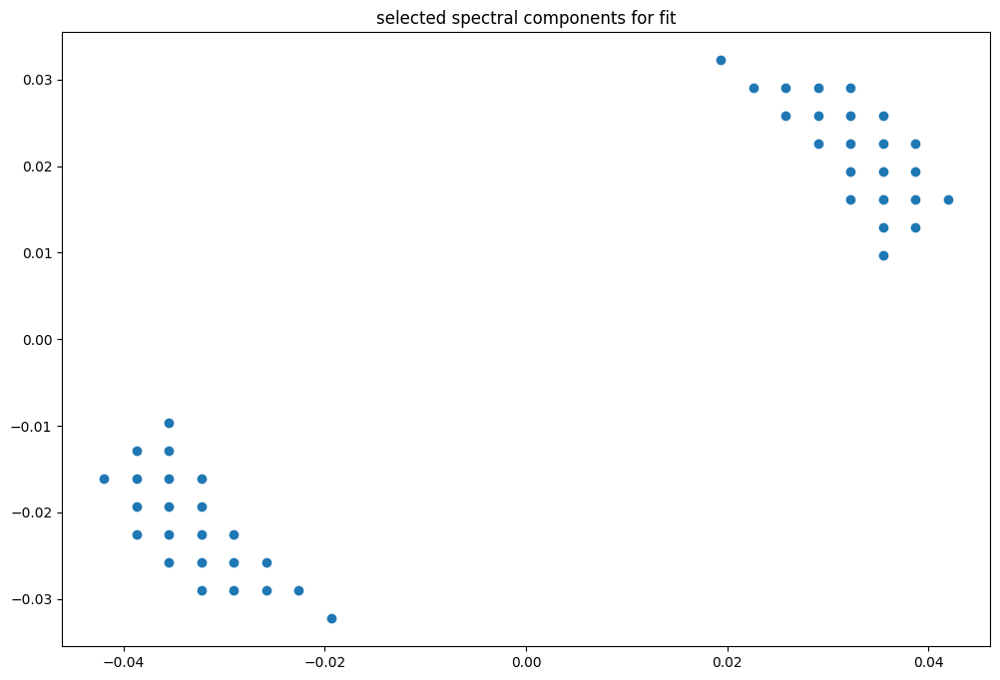

box [10000, 10500, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

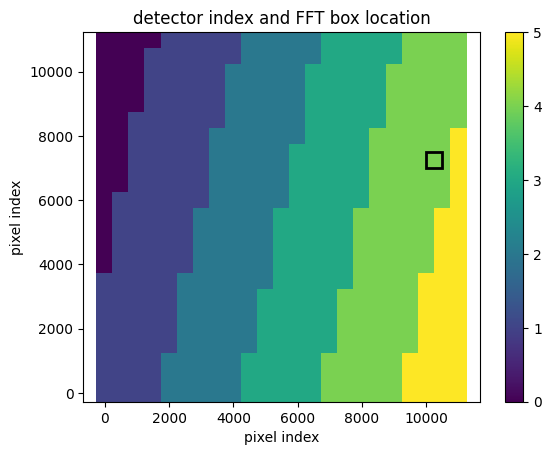

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


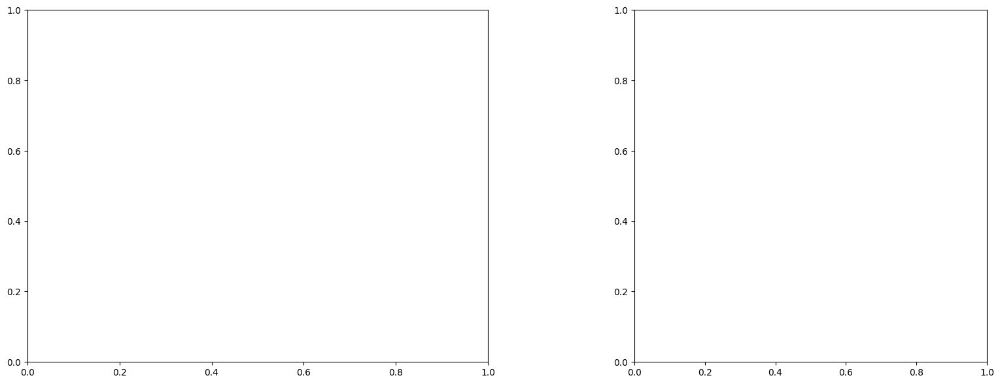

U and V components of current : [0.91499324 1.39086726]
uncertainties for U and V: 0.07684281633094885 0.11512035170812386


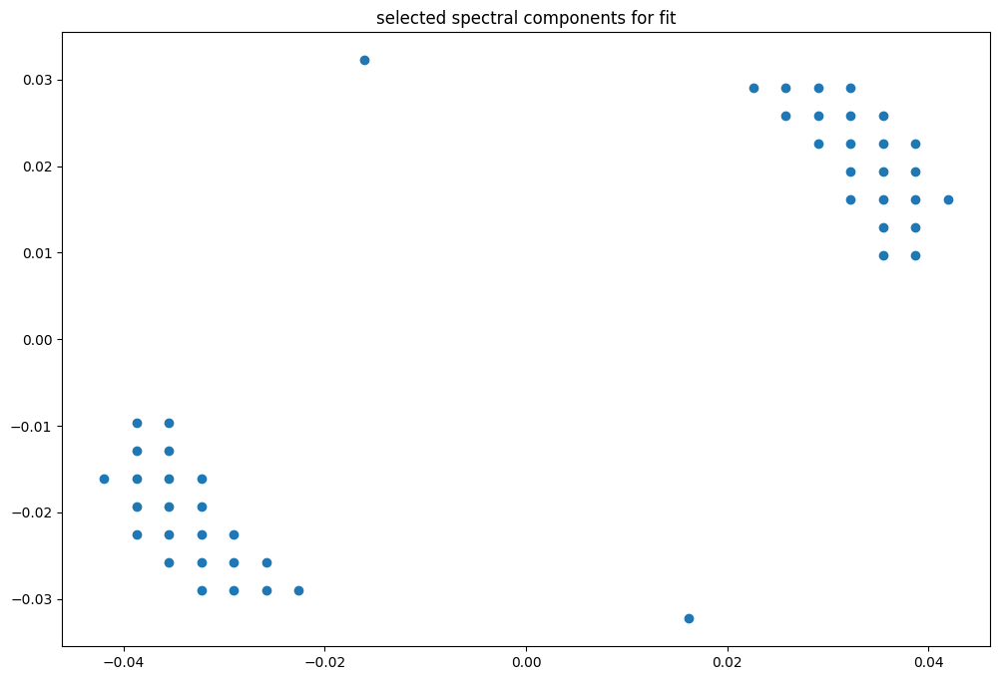

box [10000, 10500, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

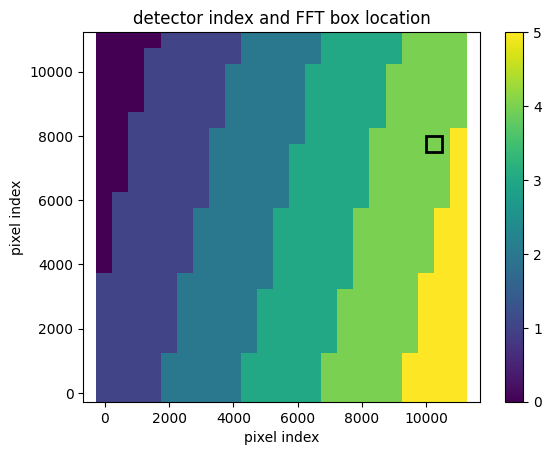

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(31, 31)
(31, 31)
(31, 31)


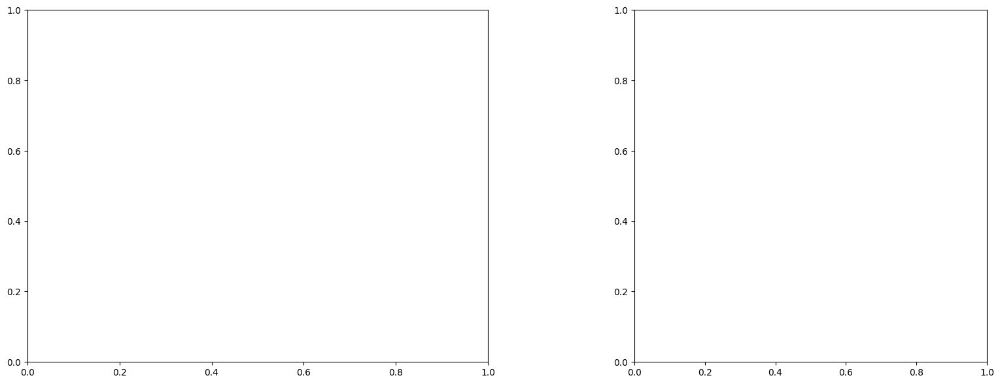

U and V components of current : [0.73171341 1.59884819]
uncertainties for U and V: 0.10428155981430692 0.14675300823055792


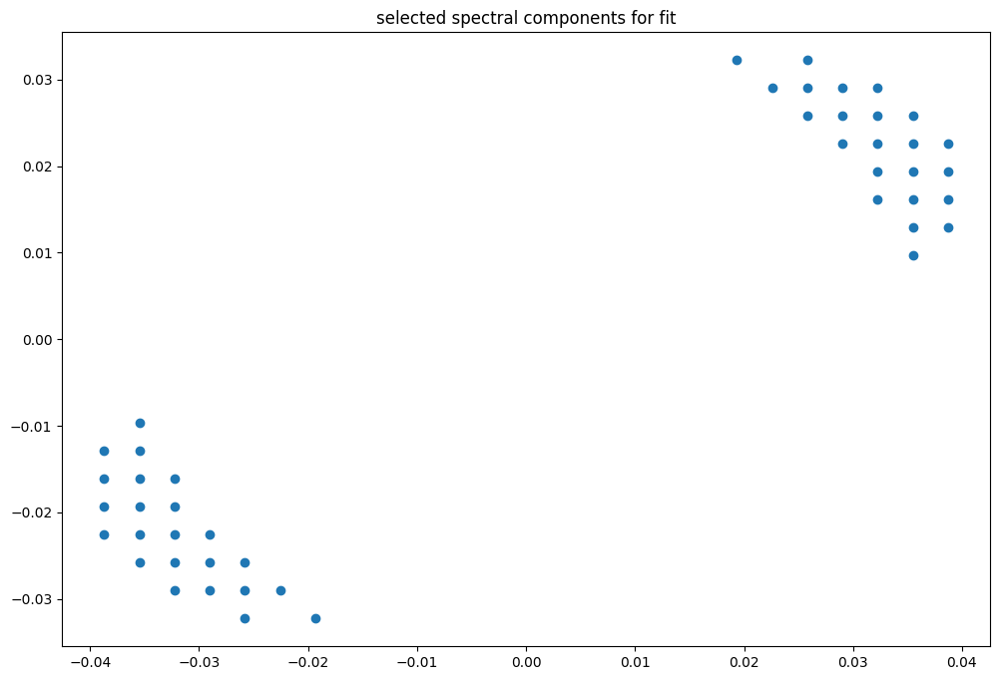

box [10000, 10500, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

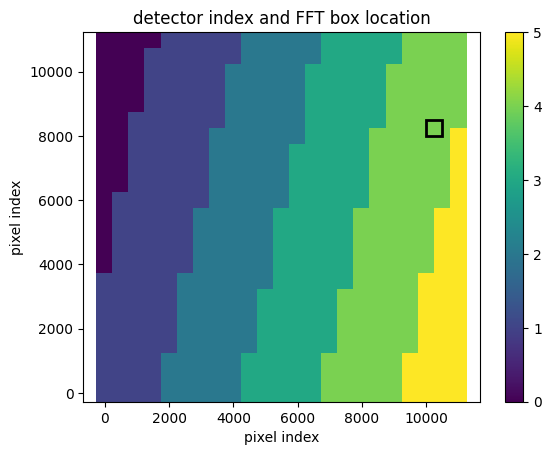

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(31, 31)
(31, 31)
(31, 31)


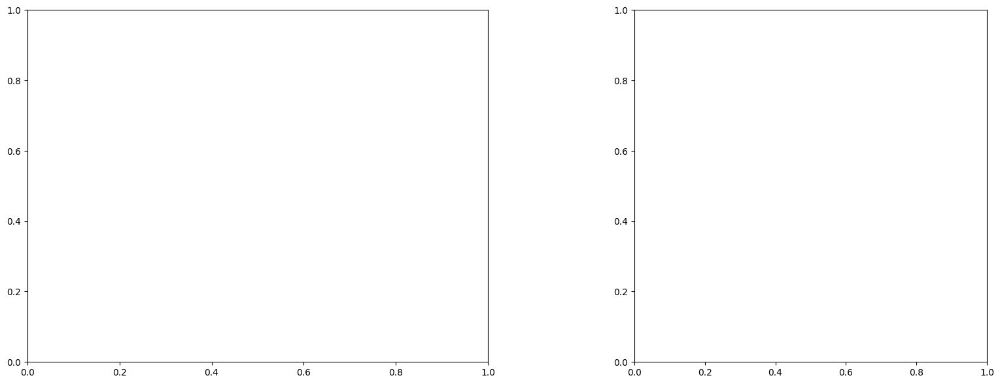

U and V components of current : [0.72946703 1.38082514]
uncertainties for U and V: 0.0753477700349597 0.10243077388654541


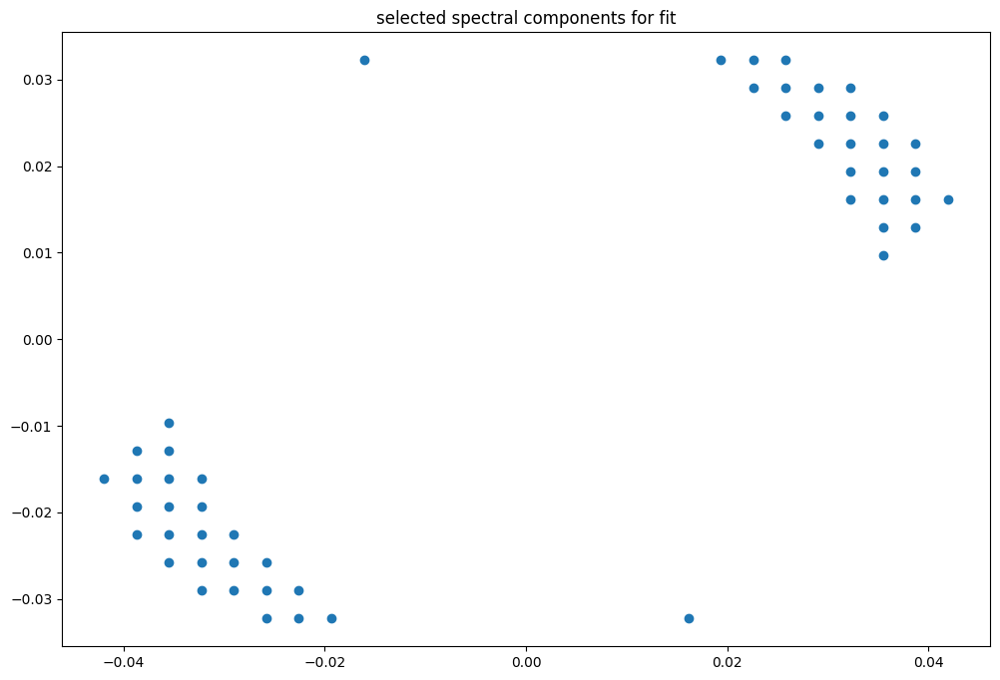

box [10000, 10500, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

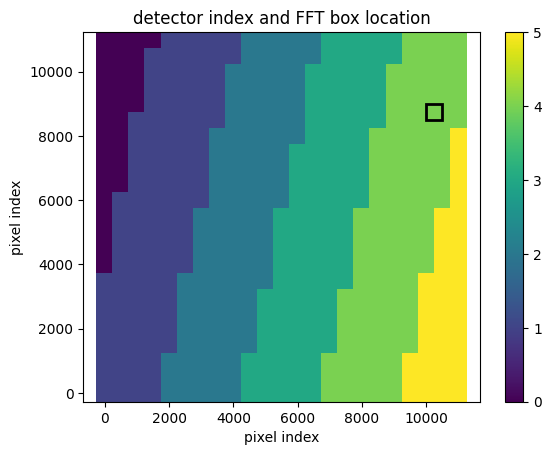

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


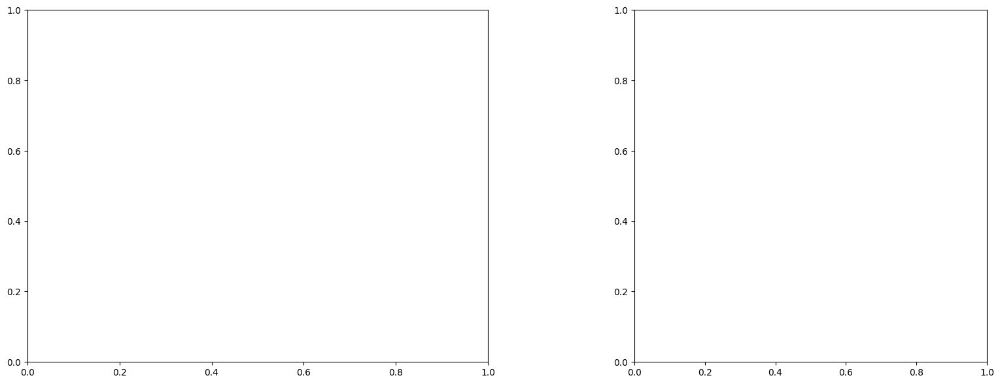

U and V components of current : [1.0310301  1.53522195]
uncertainties for U and V: 0.06219085113025126 0.07743186363902844


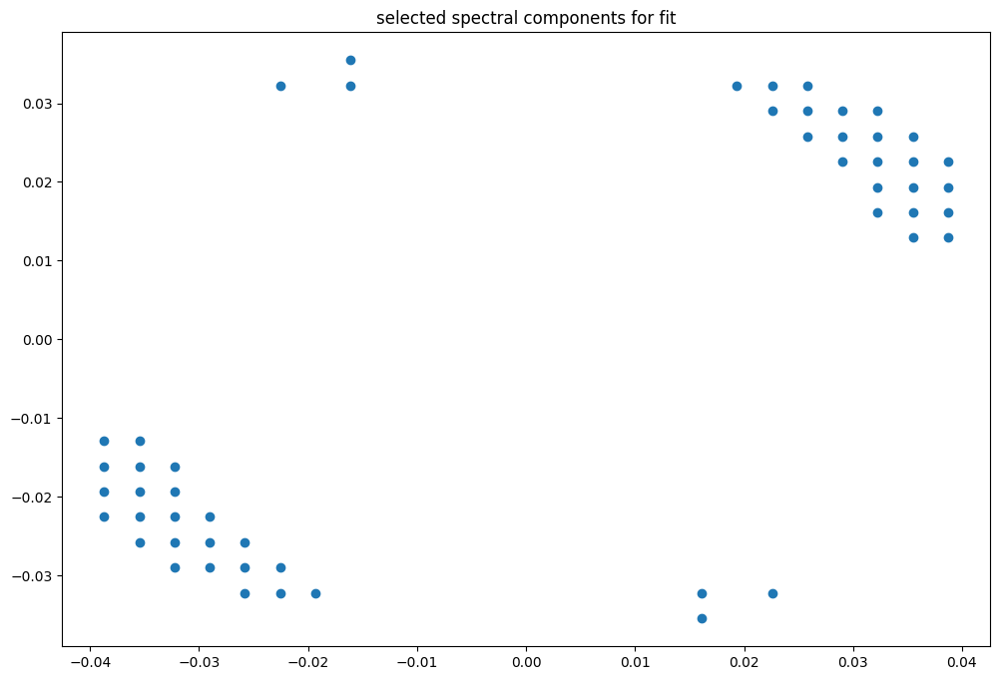

box [10000, 10500, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

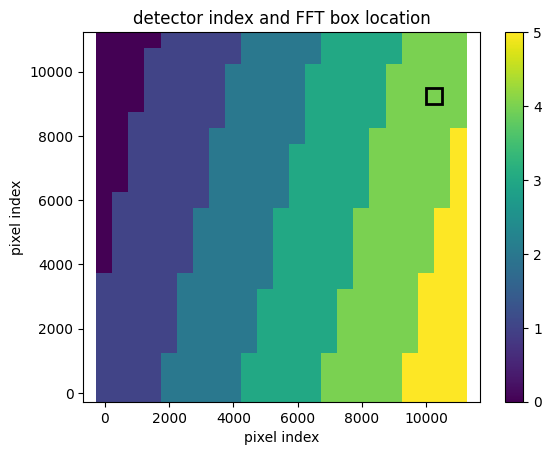

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(31, 31)
(31, 31)
(31, 31)


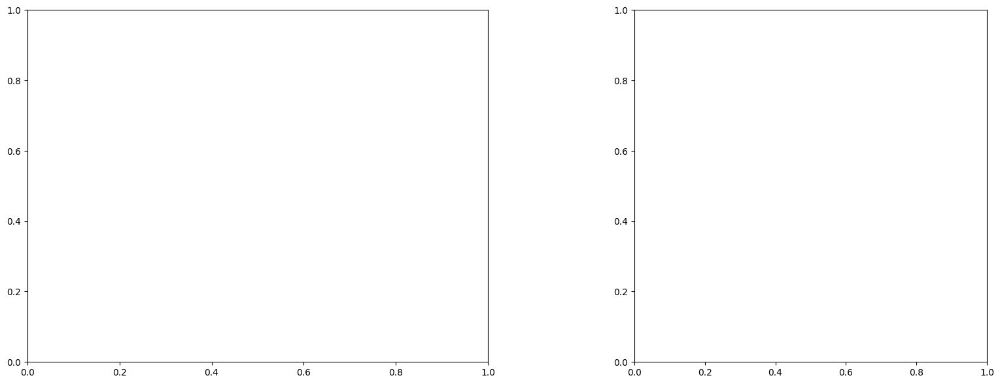

U and V components of current : [0.99439276 1.17278154]
uncertainties for U and V: 0.07210135603018251 0.07815403787134954


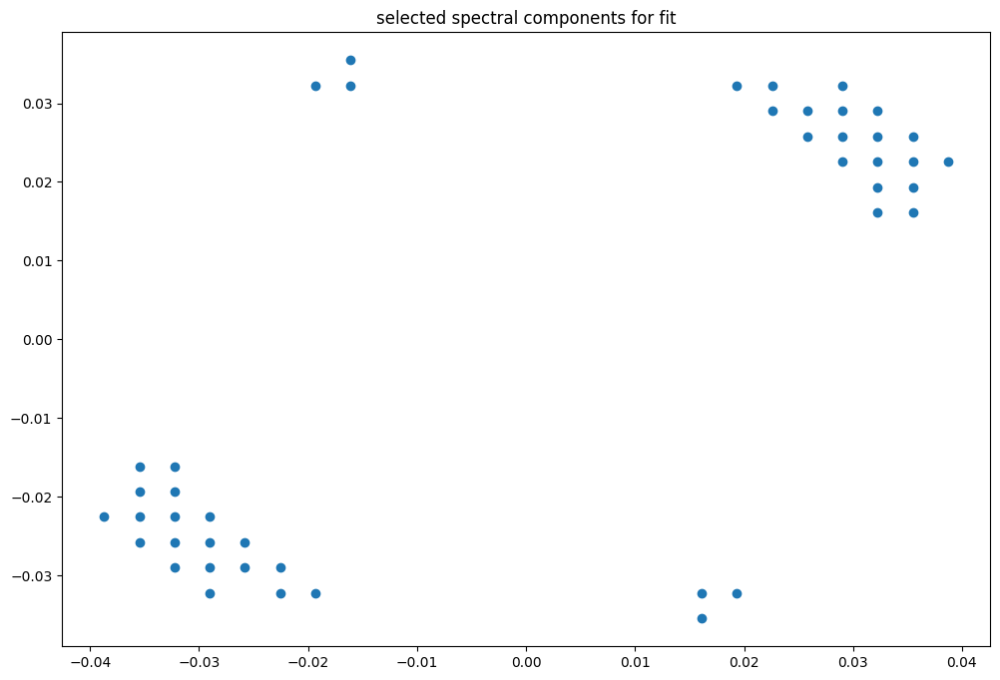

box [10000, 10500, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Read

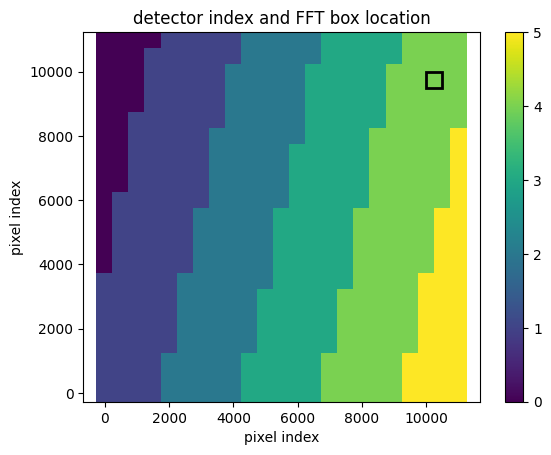

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(31, 31)
(31, 31)
(31, 31)


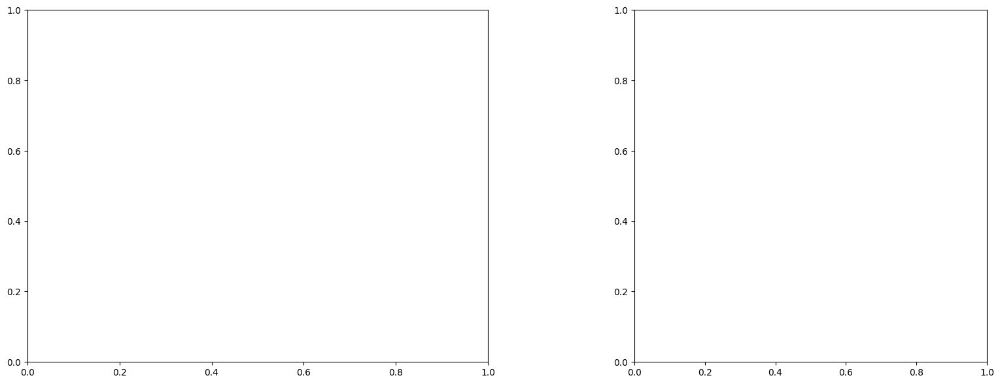

U and V components of current : [1.1828416 1.0436516]
uncertainties for U and V: 0.05230595596453965 0.04801974971967167


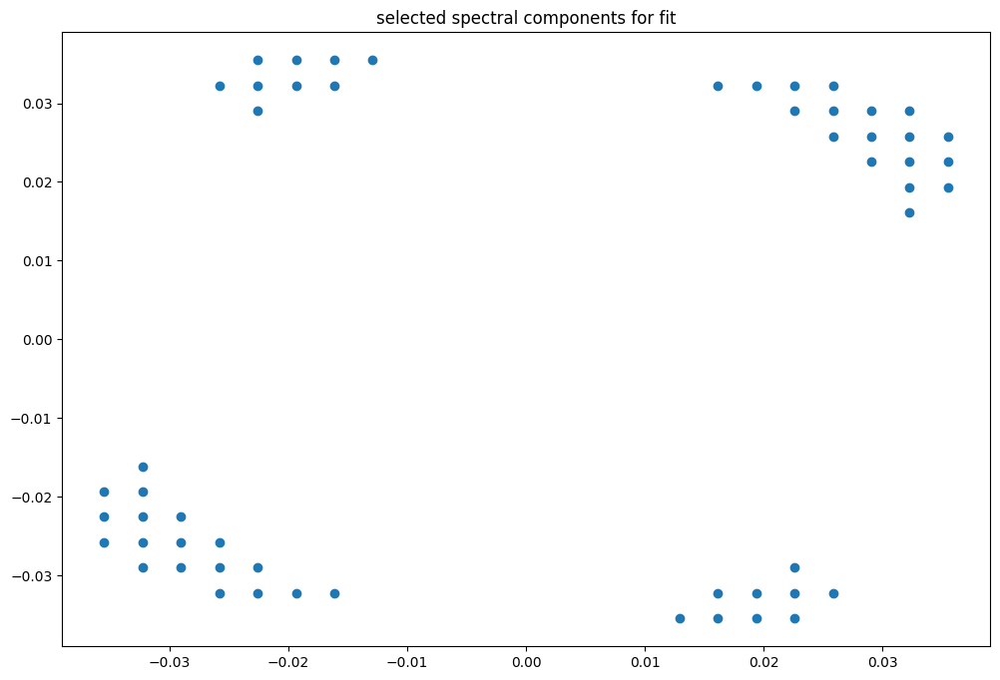

box [10000, 10500, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Rea

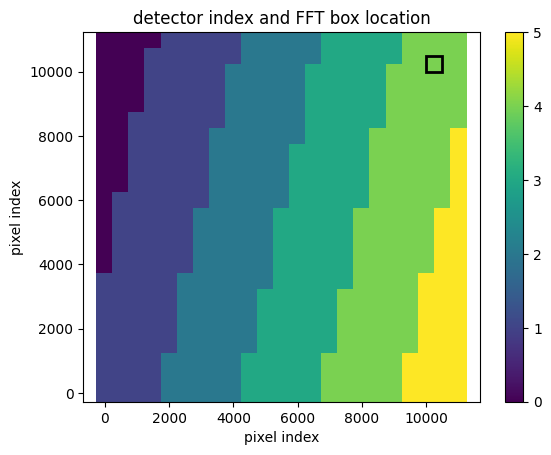

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(31, 31)
(31, 31)
(31, 31)


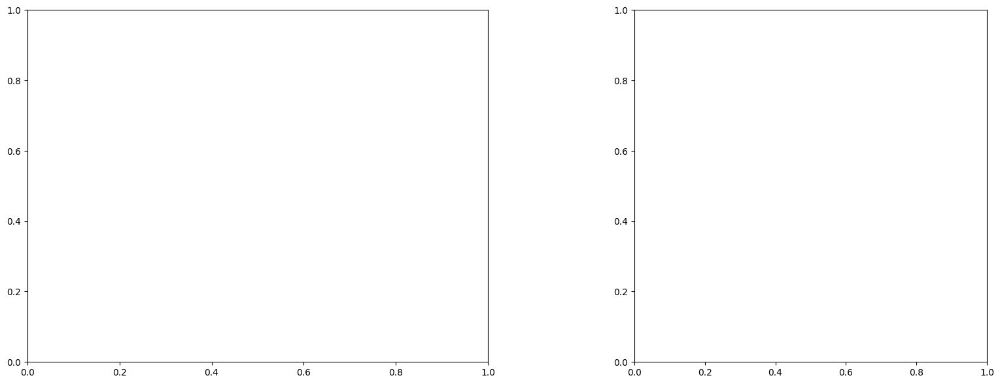

U and V components of current : [1.31036292 0.94771391]
uncertainties for U and V: 0.046807851505129706 0.04113889202054677


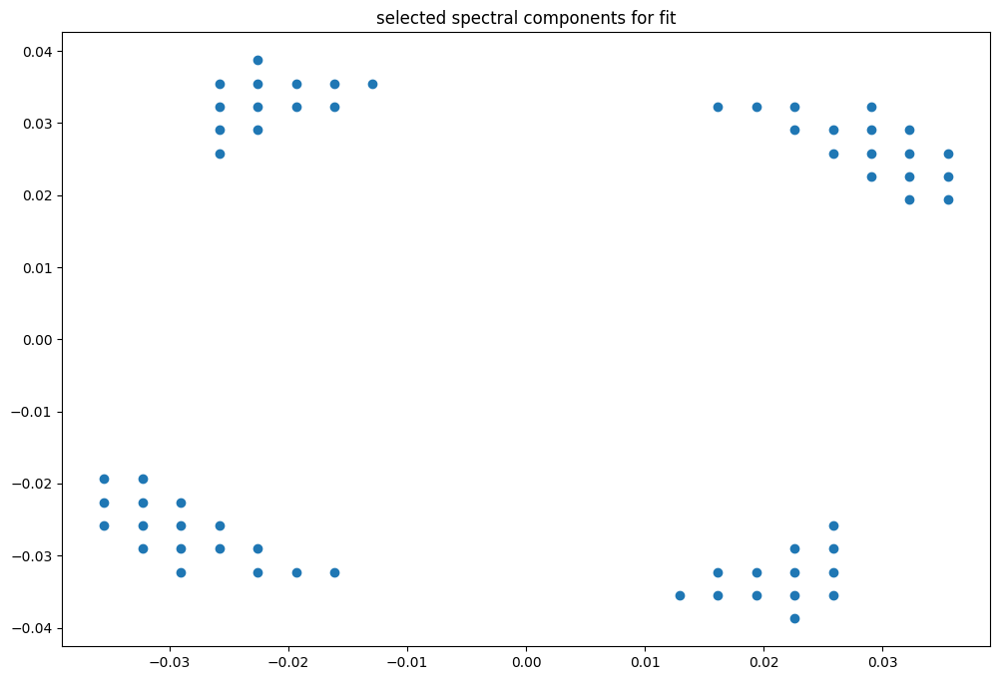

box [10000, 10500, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Rea

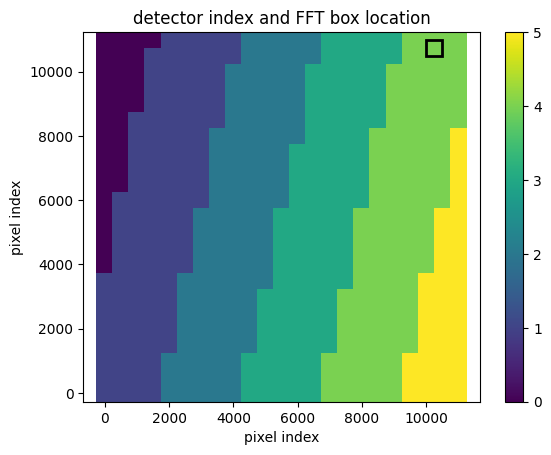

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(31, 30)
(31, 30)
(31, 30)


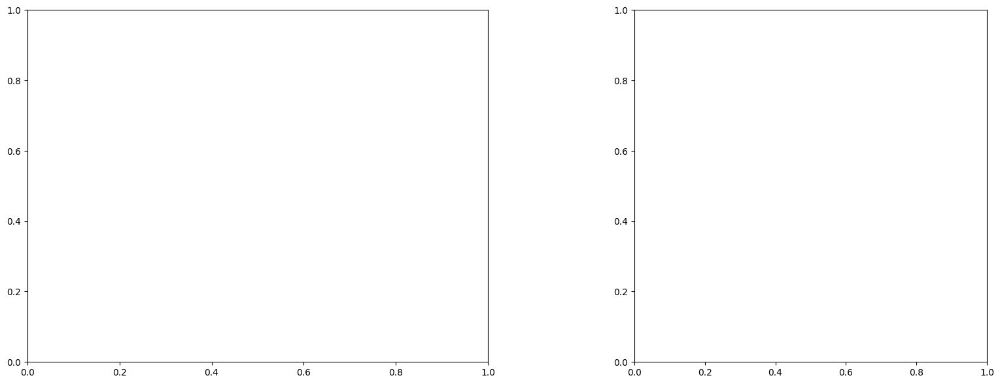

U and V components of current : [1.25568955 0.96597488]
uncertainties for U and V: 0.05344349648720715 0.04149604982089176


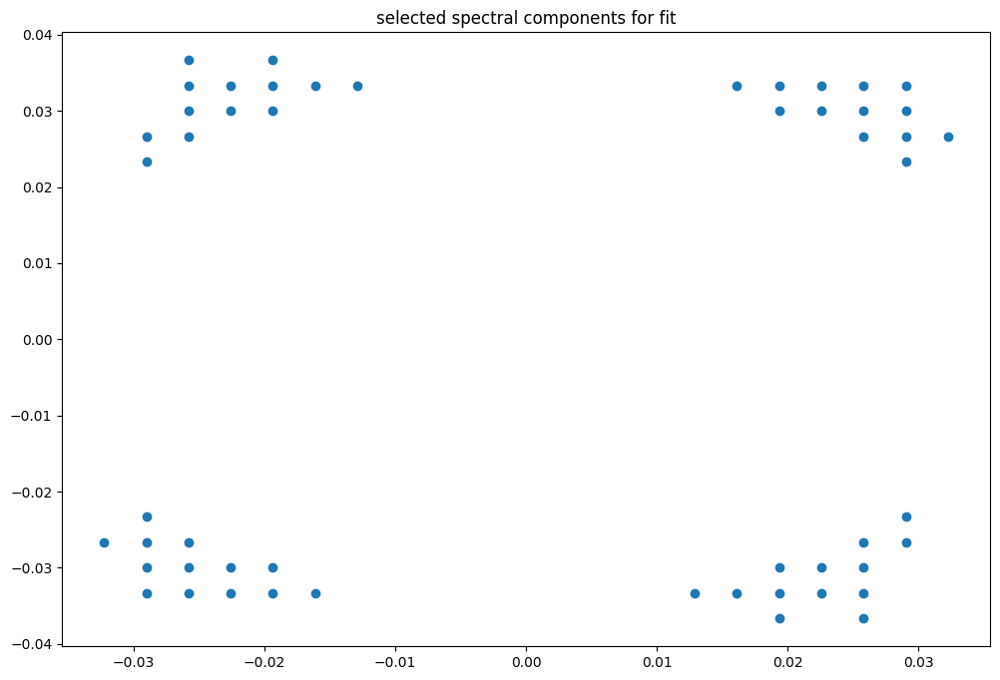

box [10500, 11000, 500, 1000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readin

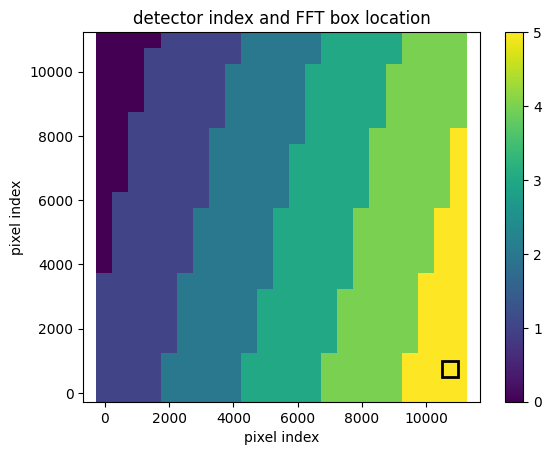

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876730752059386
(30, 31)
(30, 31)
(30, 31)


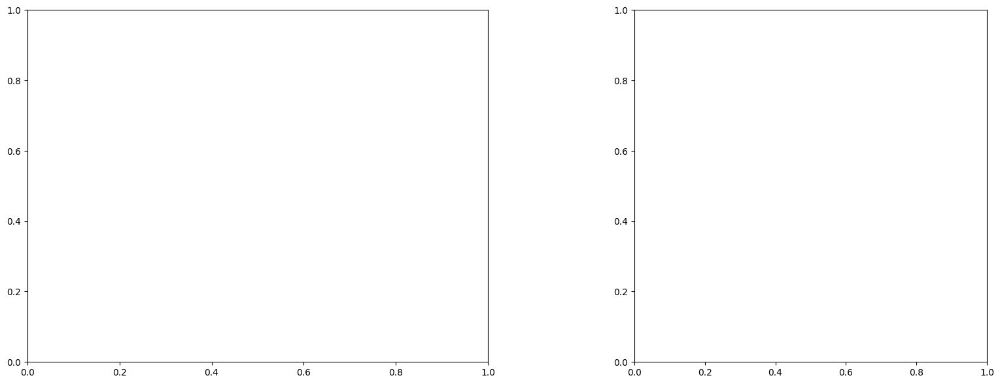

U and V components of current : [0.42520112 1.5534111 ]
uncertainties for U and V: 0.08958404656997286 0.20041802659579347


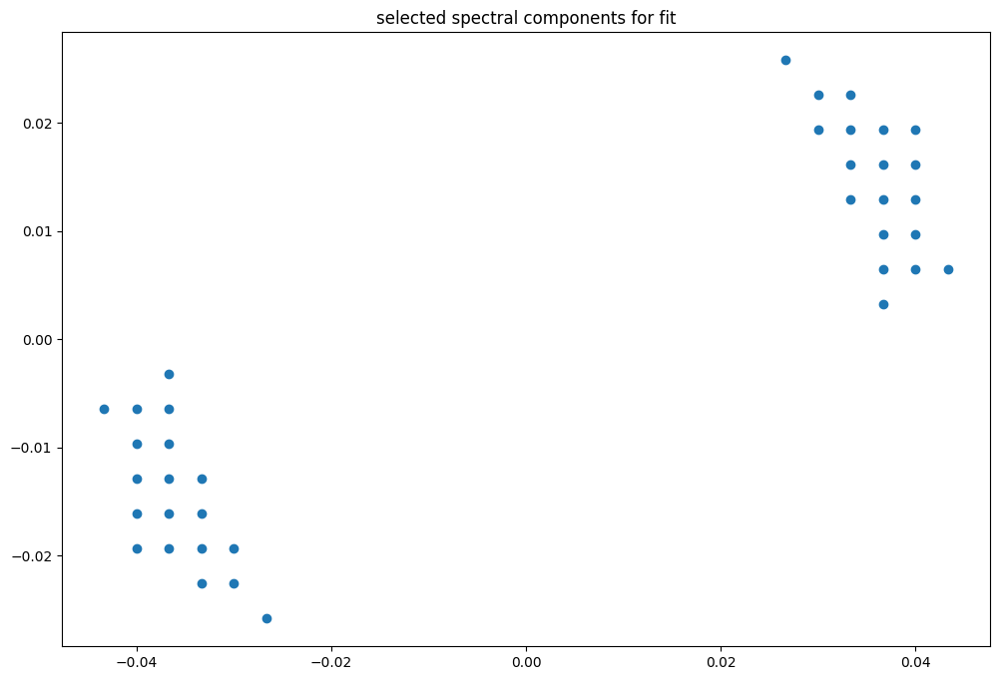

box [10500, 11000, 1000, 1500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

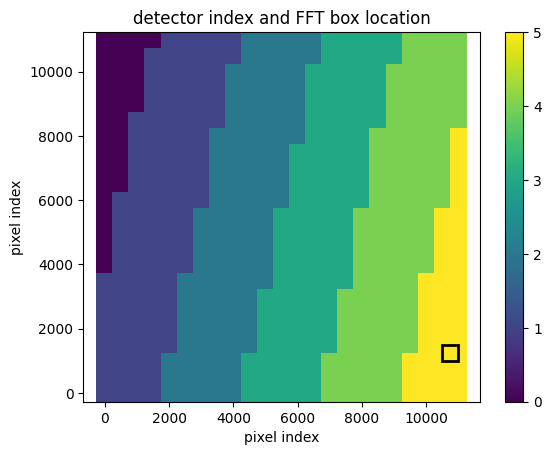

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876696255202555
(30, 31)
(30, 31)
(30, 31)


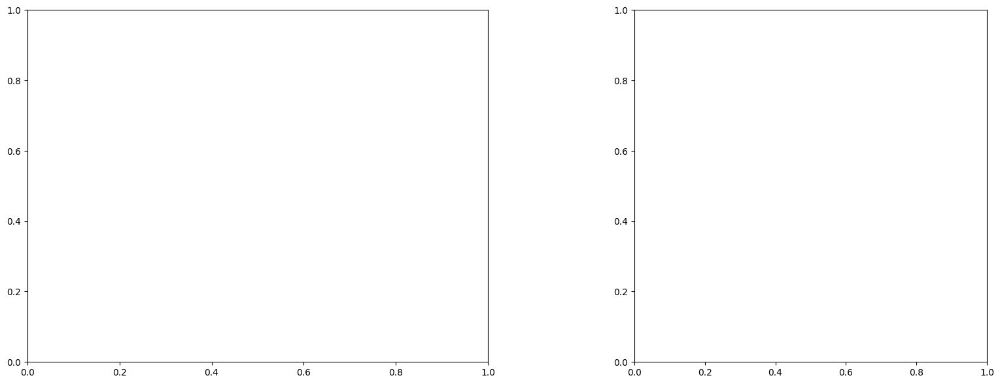

U and V components of current : [0.33290261 1.58208318]
uncertainties for U and V: 0.10167440646042503 0.2307533952745828


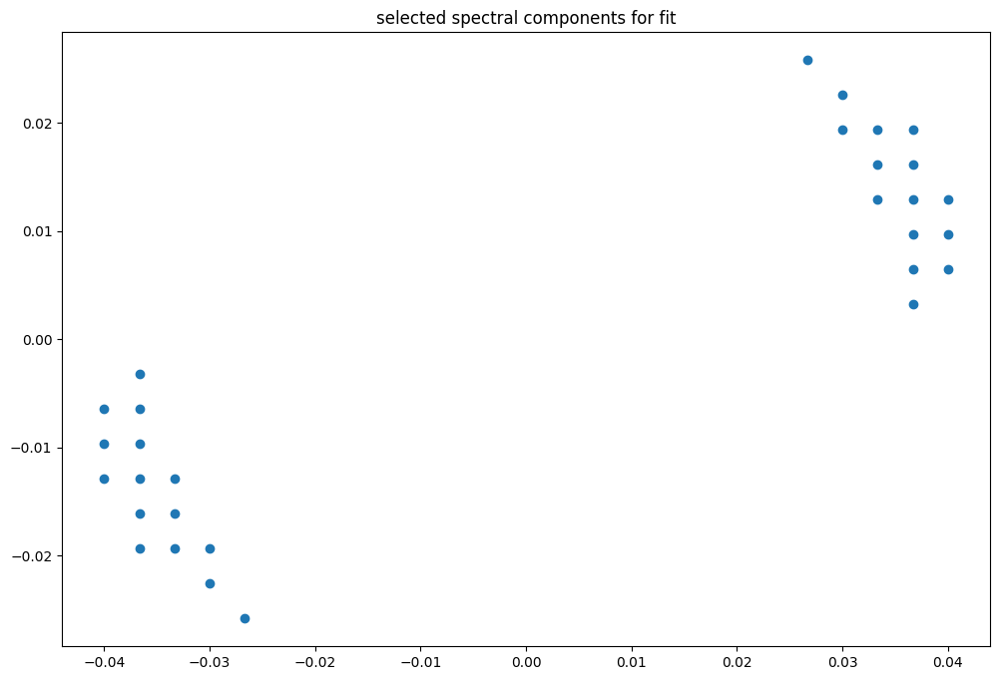

box [10500, 11000, 1500, 2000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

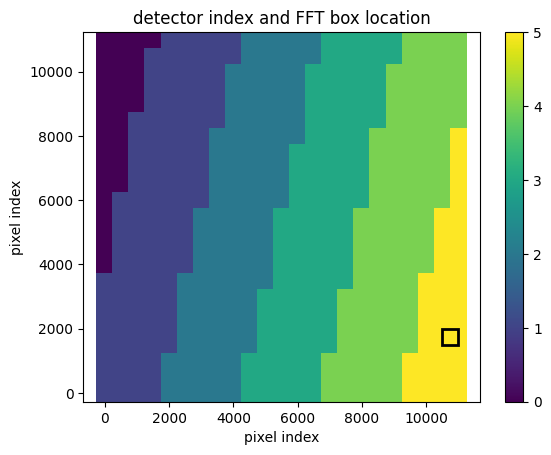

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876661172269913
(30, 31)
(30, 31)
(30, 31)


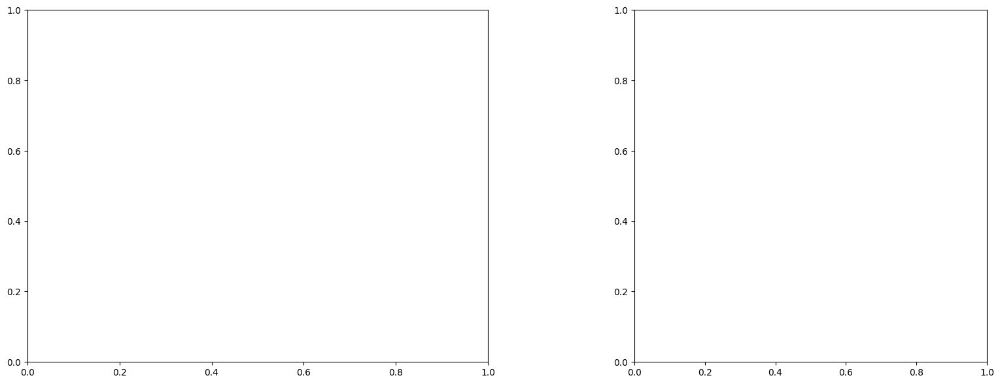

U and V components of current : [0.49452202 1.49793641]
uncertainties for U and V: 0.09466289604486686 0.18986321333273462


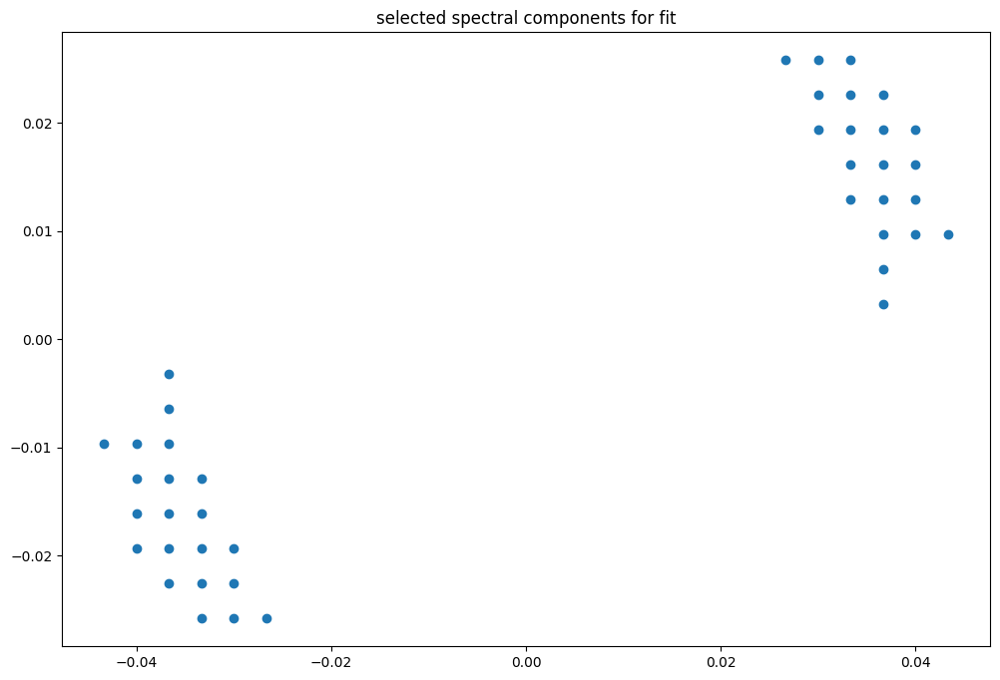

box [10500, 11000, 2000, 2500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

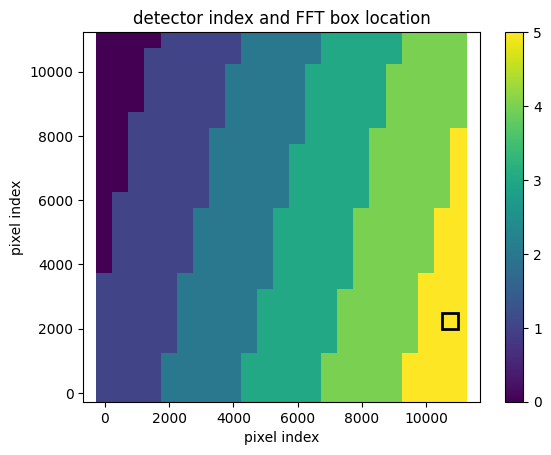

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876661172269913
(30, 31)
(30, 31)
(30, 31)


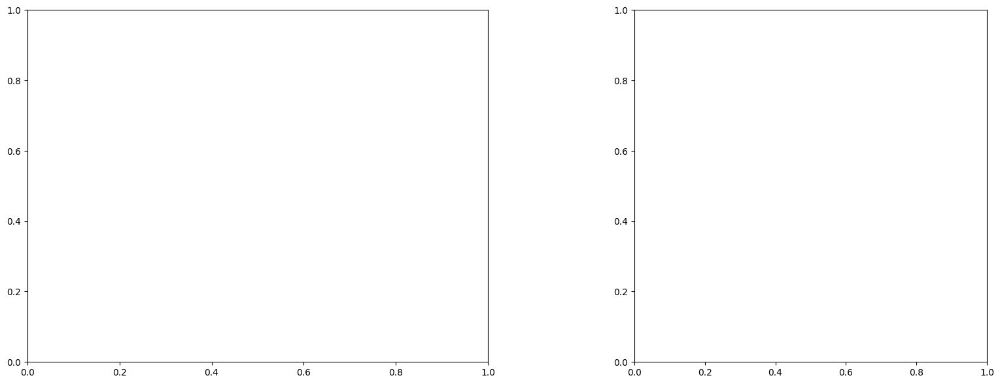

U and V components of current : [0.4940146  1.54046616]
uncertainties for U and V: 0.08190488514167125 0.1673907849409432


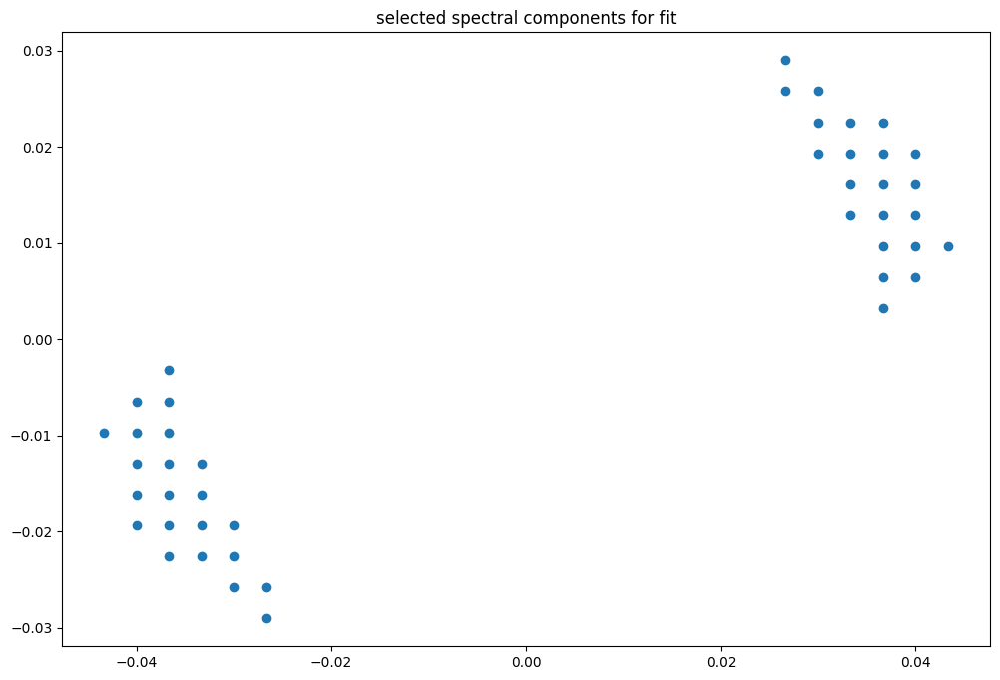

box [10500, 11000, 2500, 3000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

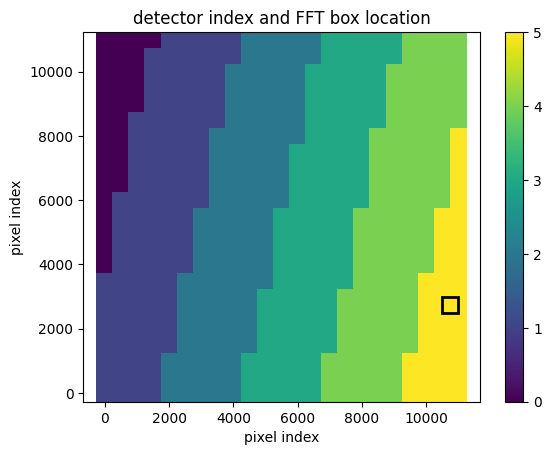

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876628360791453
(30, 31)
(30, 31)
(30, 31)


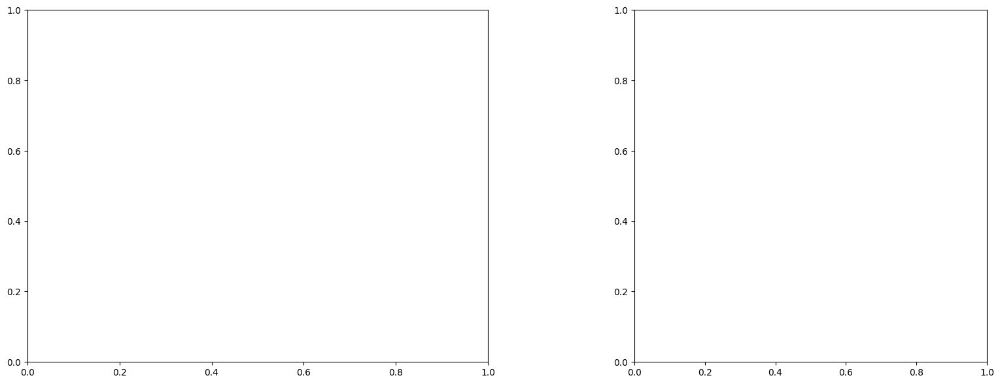

U and V components of current : [0.66689221 1.13892627]
uncertainties for U and V: 0.08614682842971827 0.16545115378359695


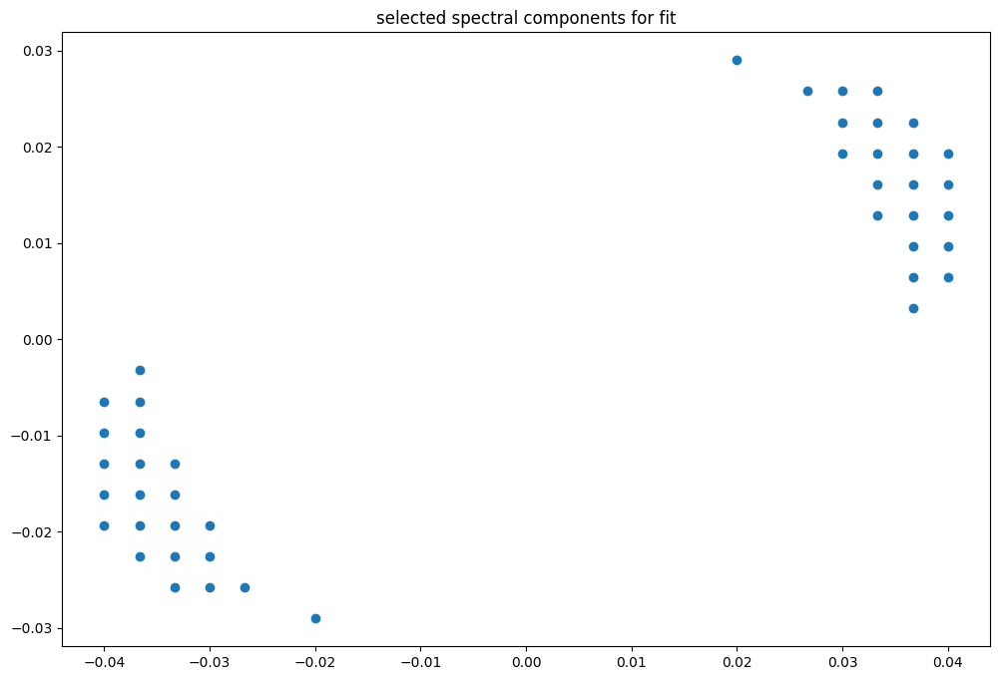

box [10500, 11000, 3000, 3500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

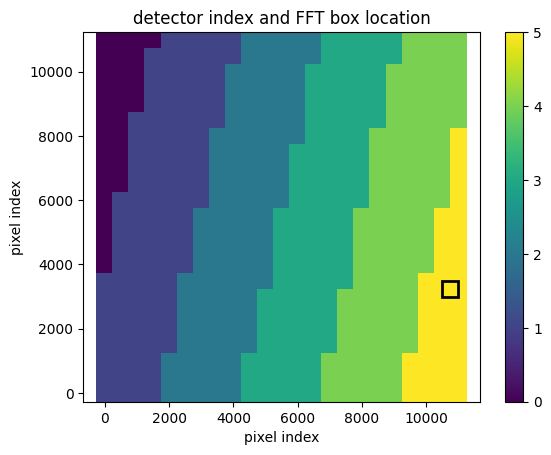

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.0
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.987659709308897
(30, 31)
(30, 31)
(30, 31)


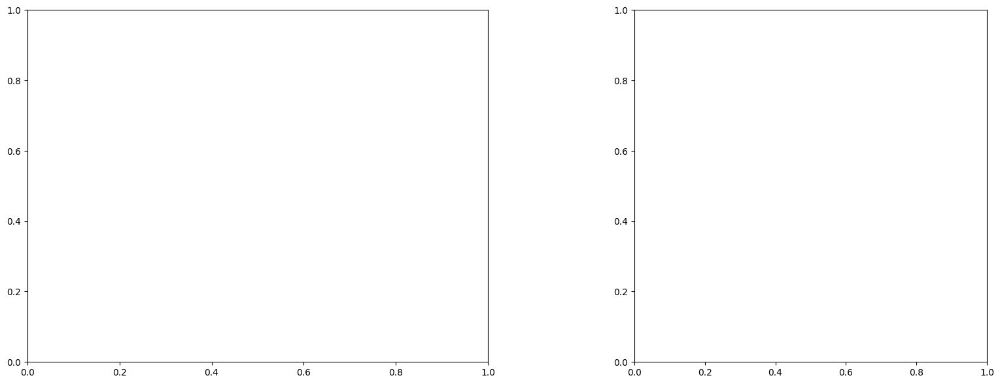

U and V components of current : [0.88291562 1.01736093]
uncertainties for U and V: 0.06481098653810738 0.1196603368833103


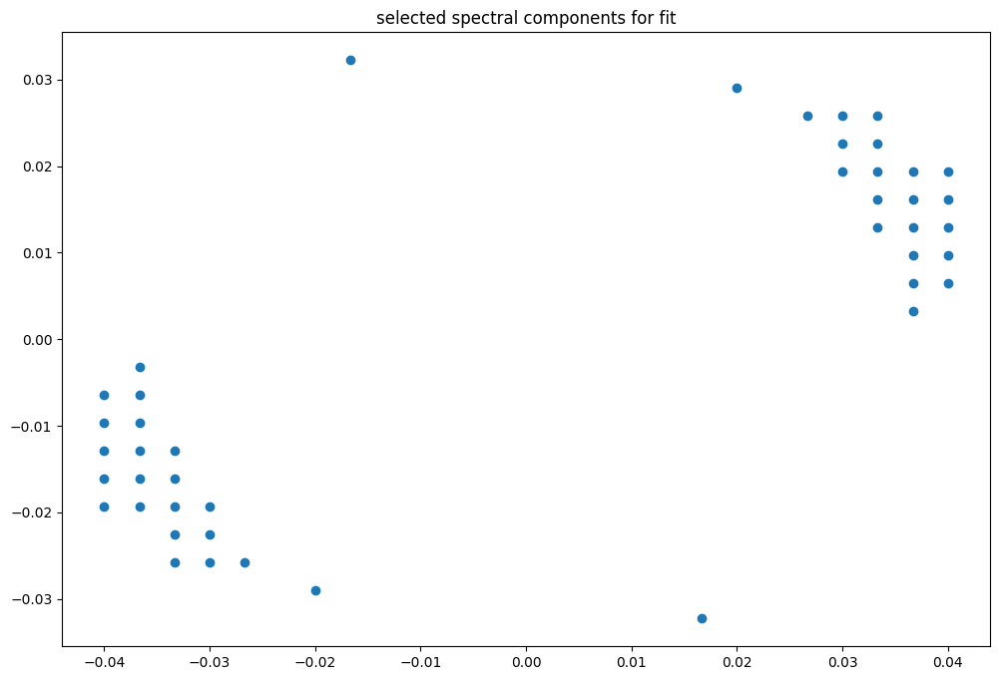

box [10500, 11000, 3500, 4000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

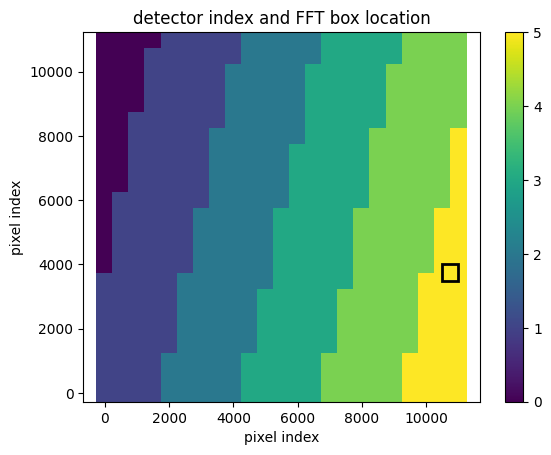

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876564696634201
(30, 31)
(30, 31)
(30, 31)


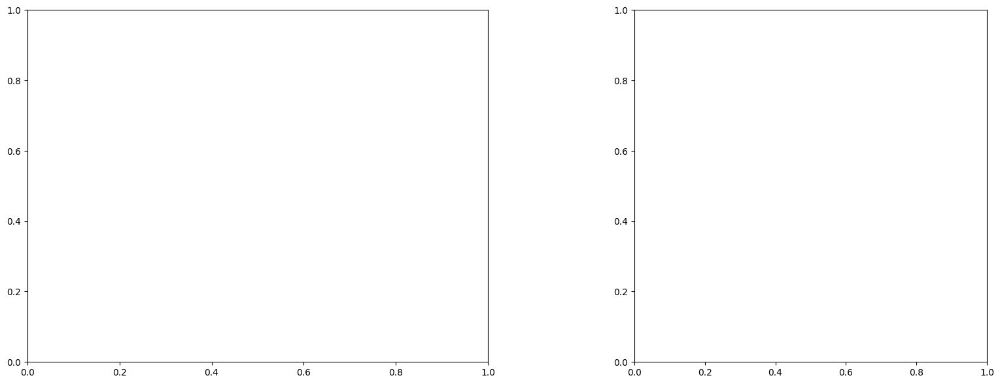

U and V components of current : [0.69285885 1.4592301 ]
uncertainties for U and V: 0.07450626215739518 0.1410513885370758


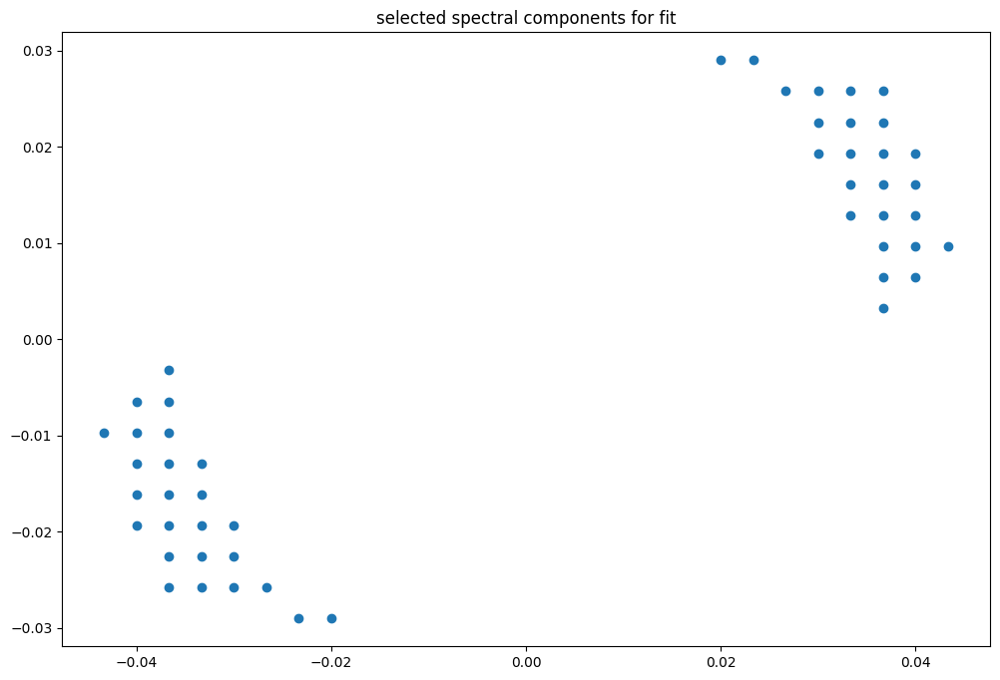

box [10500, 11000, 4000, 4500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

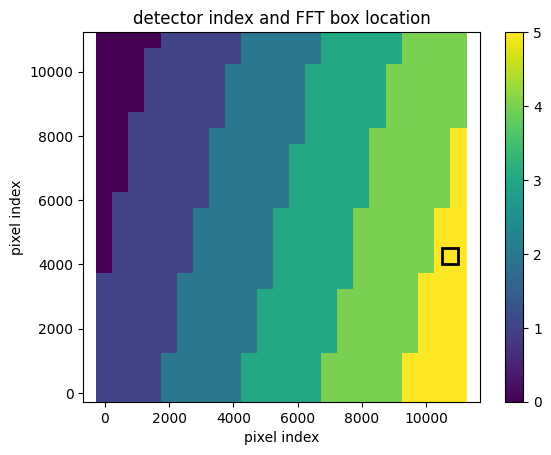

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876564696634201
(30, 31)
(30, 31)
(30, 31)


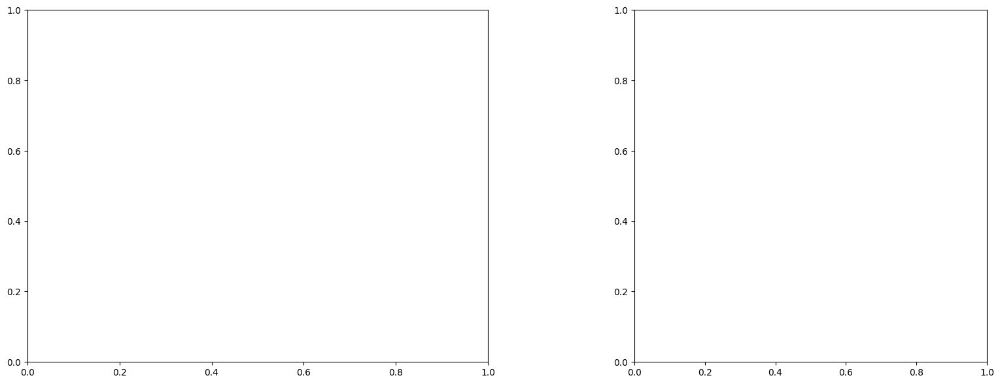

U and V components of current : [0.79674201 1.2579327 ]
uncertainties for U and V: 0.07202477537553947 0.13896926009195223


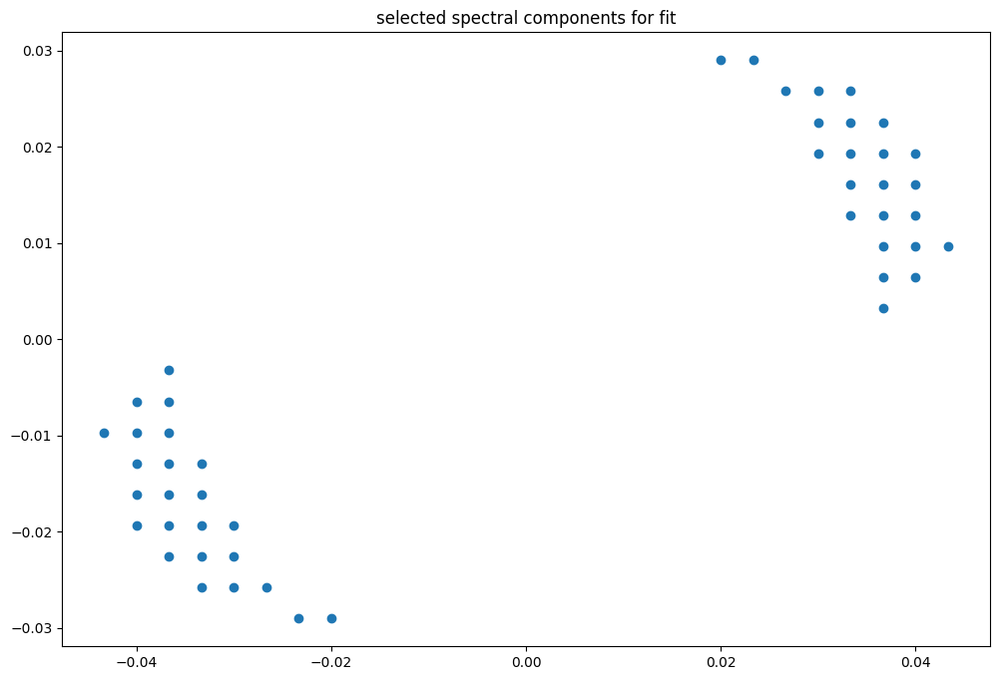

box [10500, 11000, 4500, 5000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

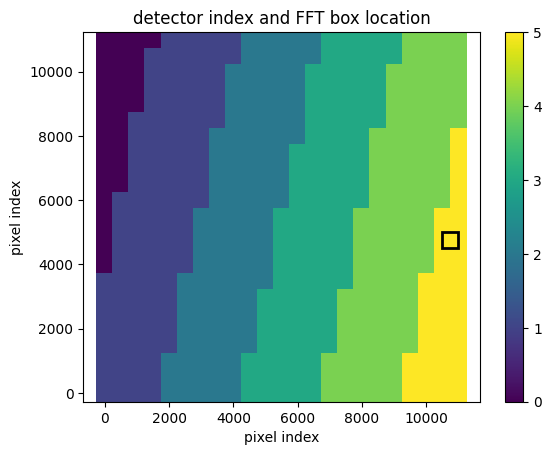

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876530977096779
(30, 31)
(30, 31)
(30, 31)


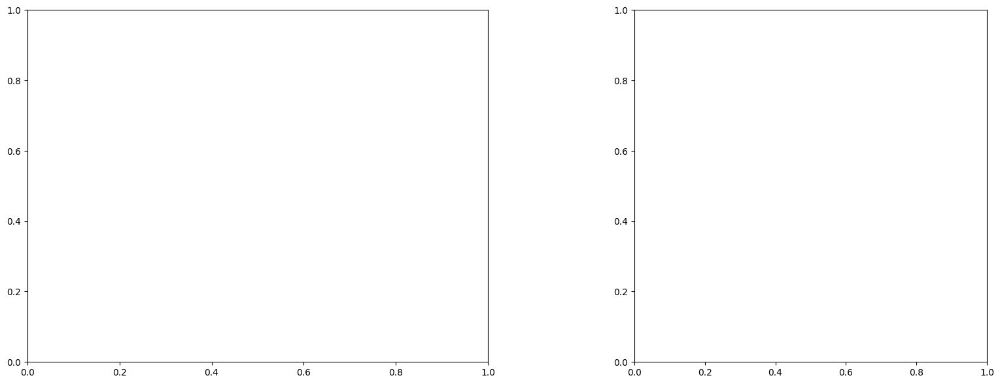

U and V components of current : [0.93334931 1.32472199]
uncertainties for U and V: 0.07165000801350116 0.1276576089959085


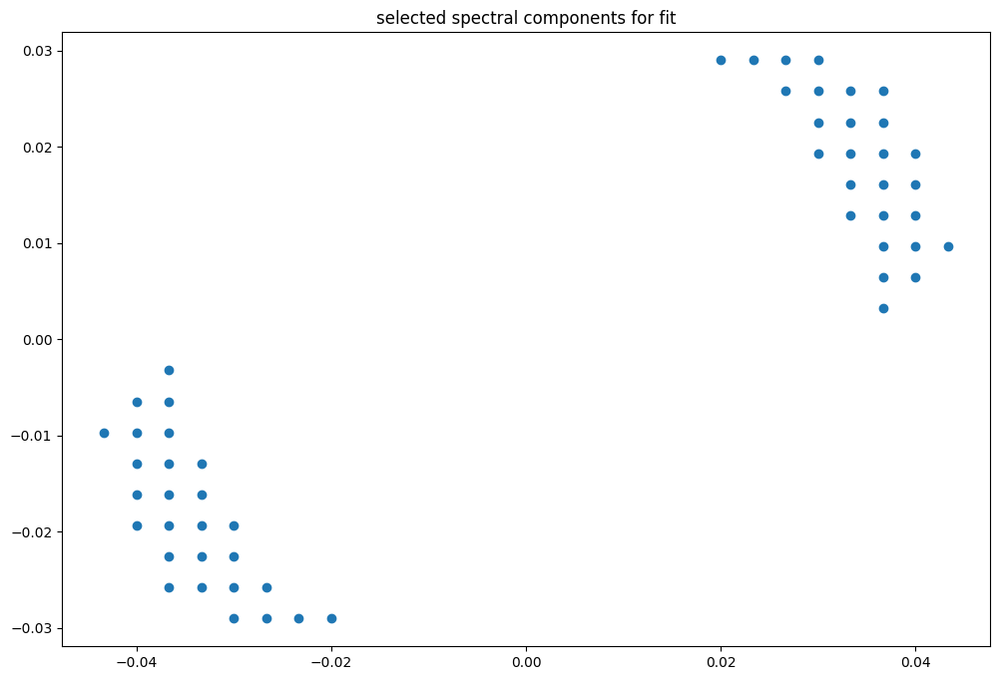

box [10500, 11000, 5000, 5500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

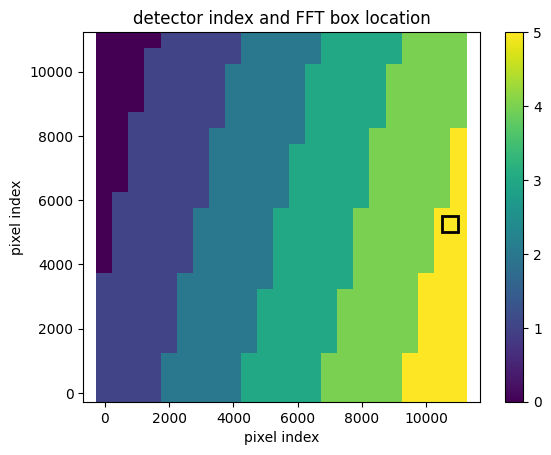

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
5.000000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.987650240758815
(30, 31)
(30, 31)
(30, 31)


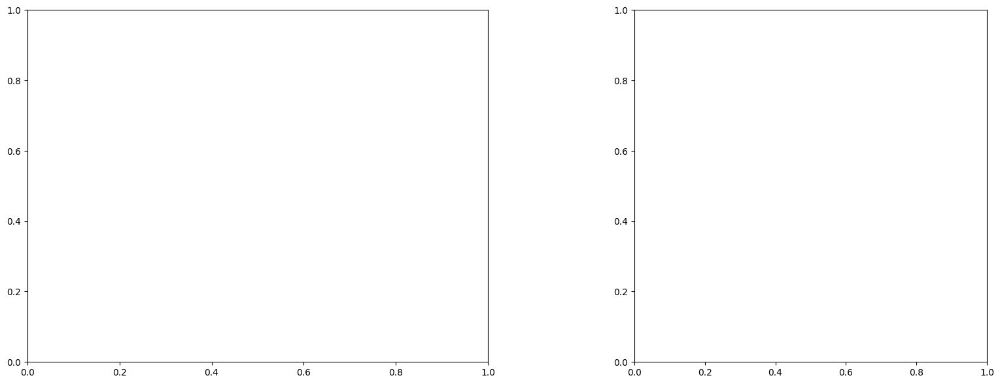

U and V components of current : [0.8782695  1.15444029]
uncertainties for U and V: 0.0701212344821853 0.13081793178822182


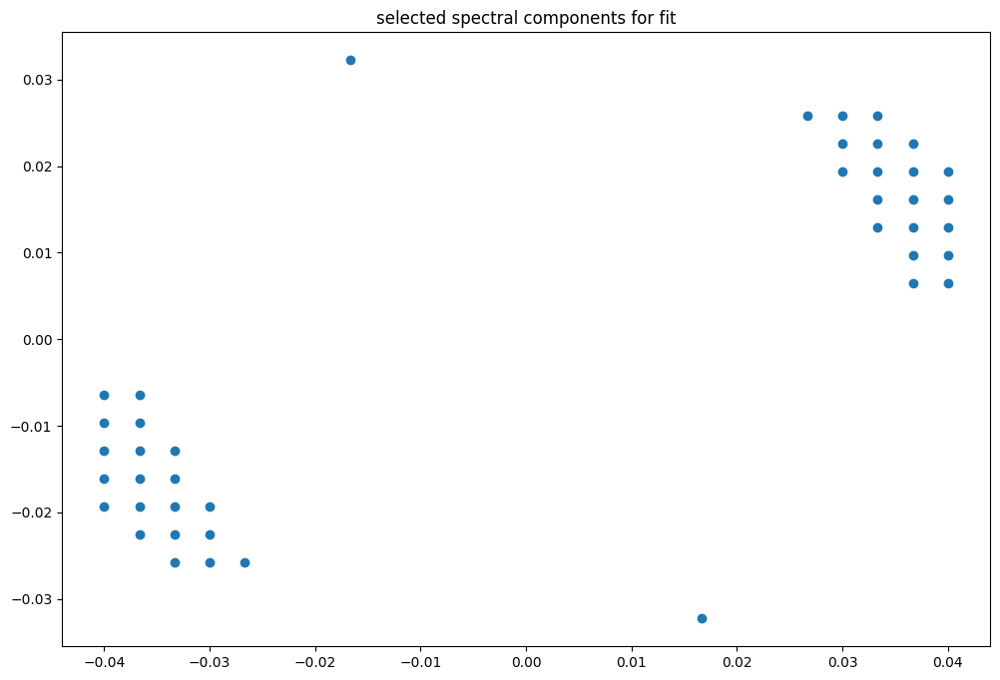

box [10500, 11000, 5500, 6000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

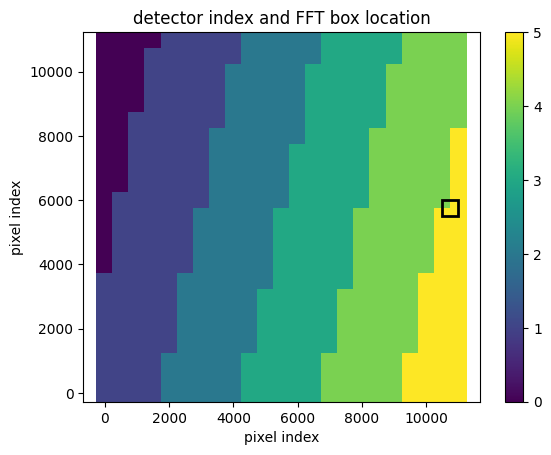

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987122782523913
(30, 31)
(30, 31)
(30, 31)


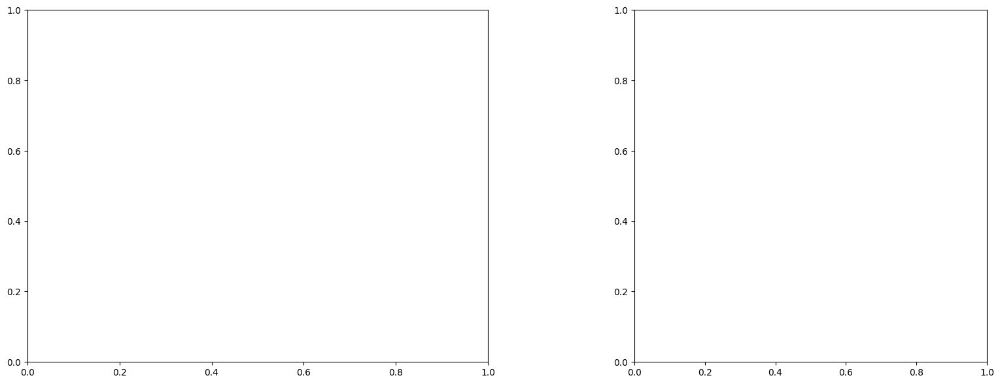

U and V components of current : [-0.88079659 -1.38216779]
uncertainties for U and V: 0.7916302149224248 1.4389376851794178


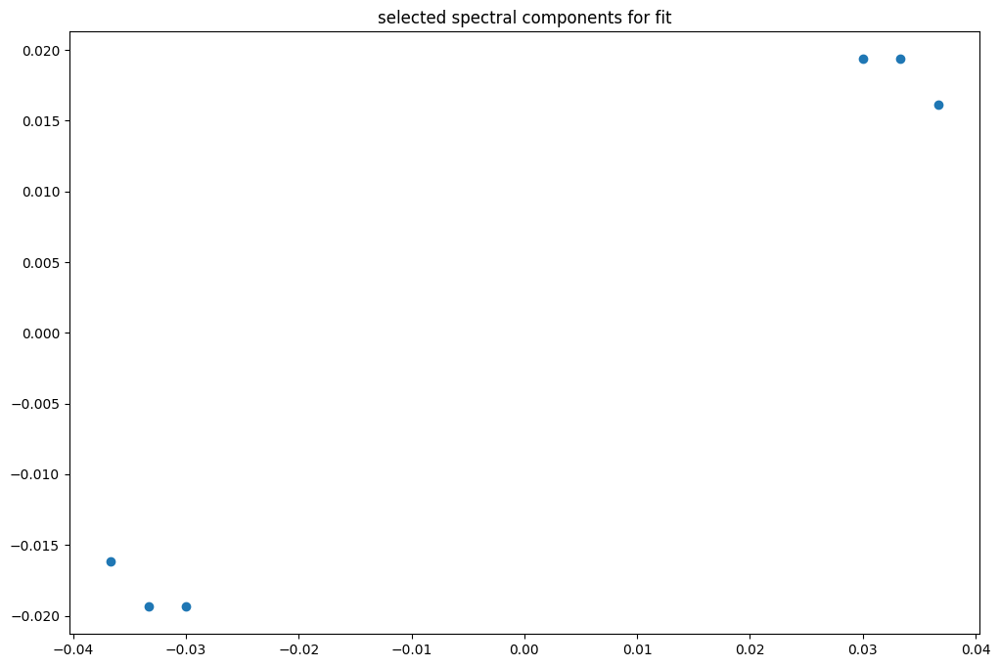

box [10500, 11000, 6000, 6500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

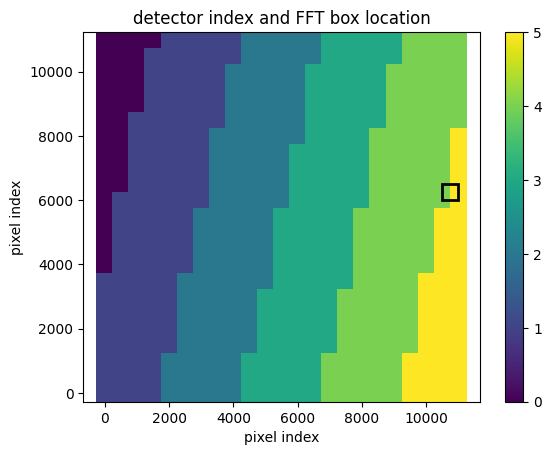

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.500000000000001
D05
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= 0.9876470710618231
(30, 31)
(30, 31)
(30, 31)


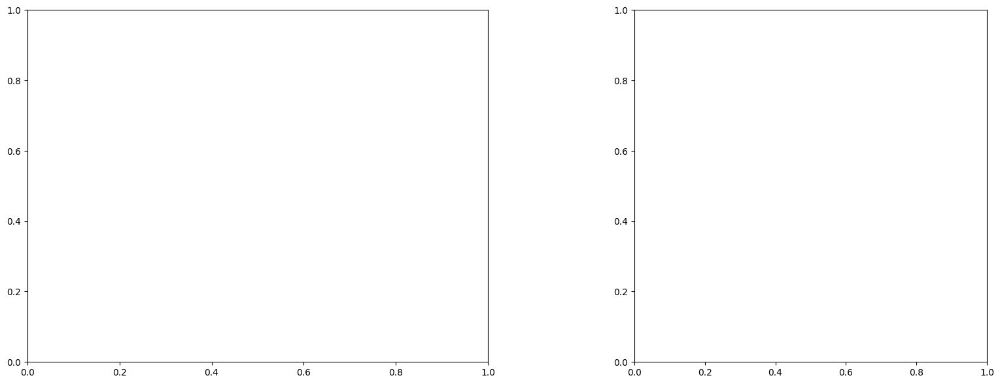

LinAlgError: Singular matrix

box [10500, 11000, 6500, 7000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

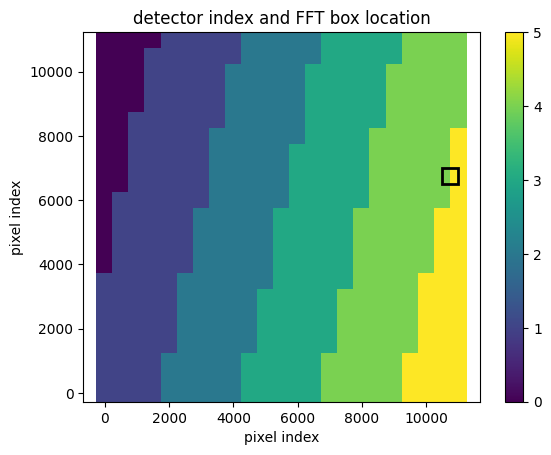

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987060268444846
(30, 31)
(30, 31)
(30, 31)


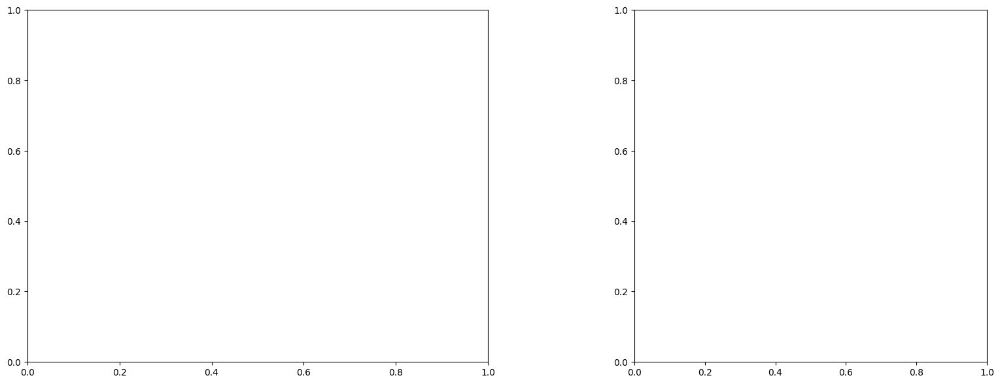

LinAlgError: Singular matrix

box [10500, 11000, 7000, 7500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

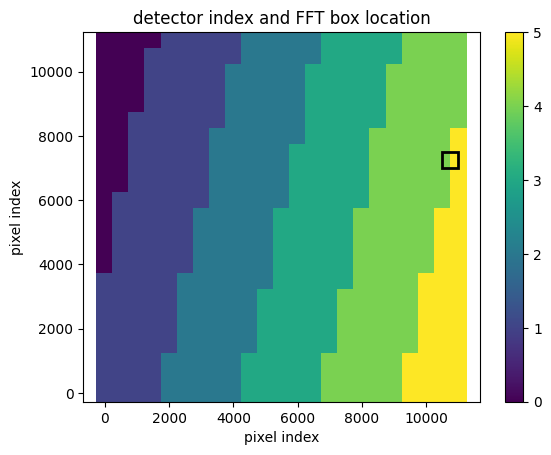

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(30, 31)
(30, 31)
(30, 31)


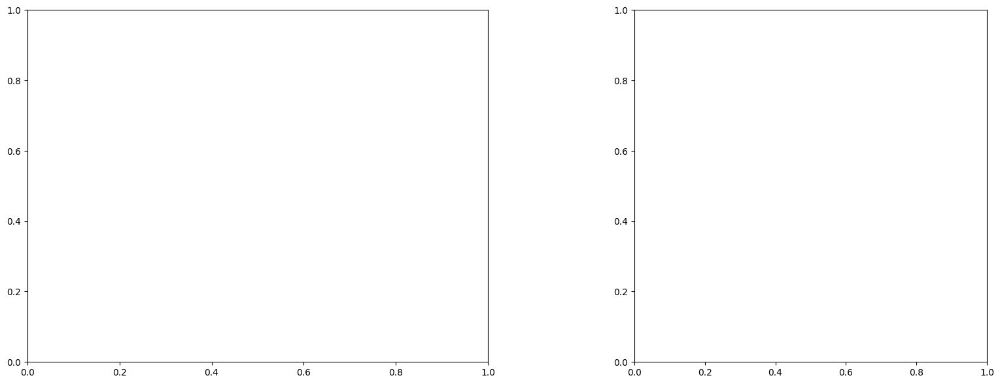

LinAlgError: Singular matrix

box [10500, 11000, 7500, 8000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

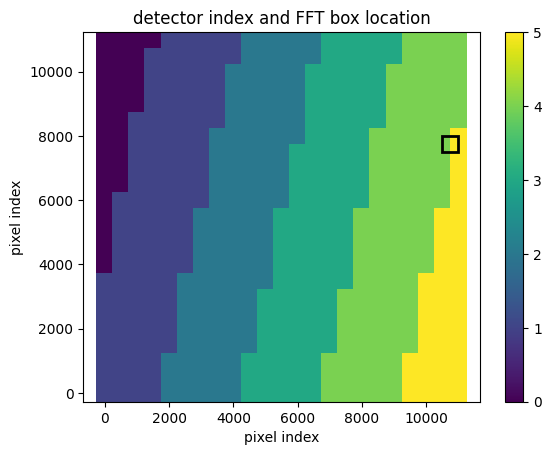

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.5
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9987033341950478
(30, 31)
(30, 31)
(30, 31)


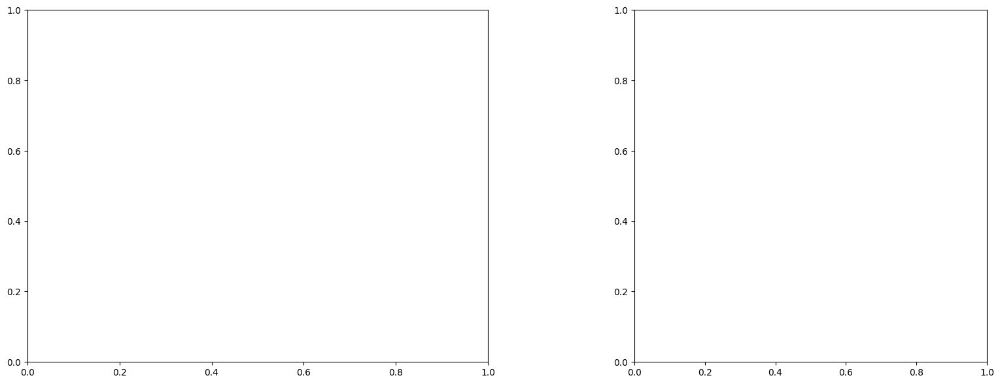

U and V components of current : [1.29370133 1.21845926]
uncertainties for U and V: 0.08580552762822392 0.12448999554585809


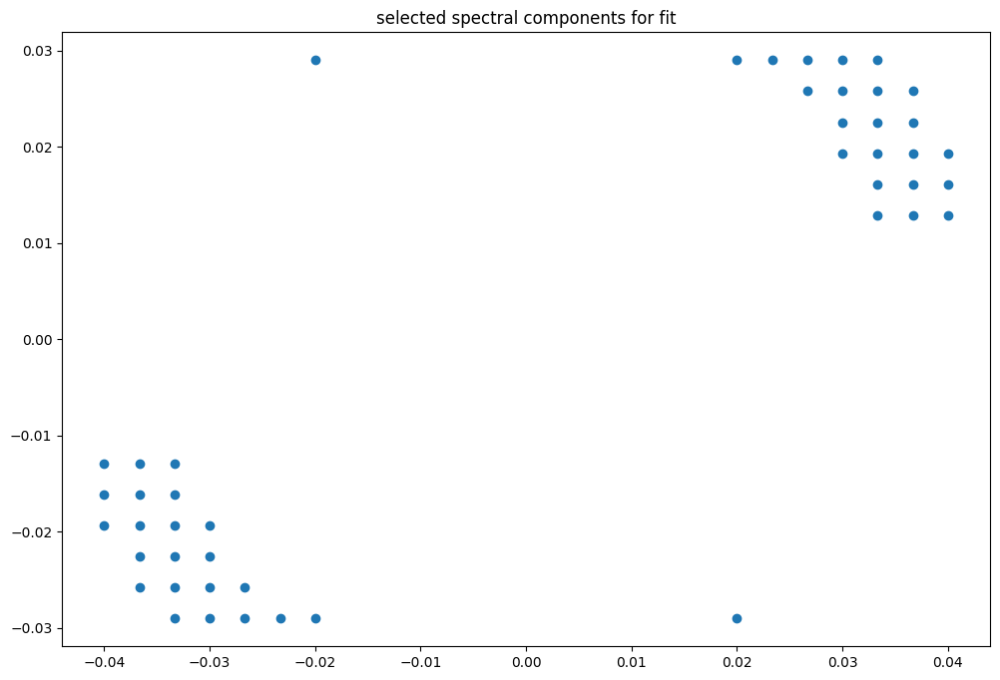

box [10500, 11000, 8000, 8500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

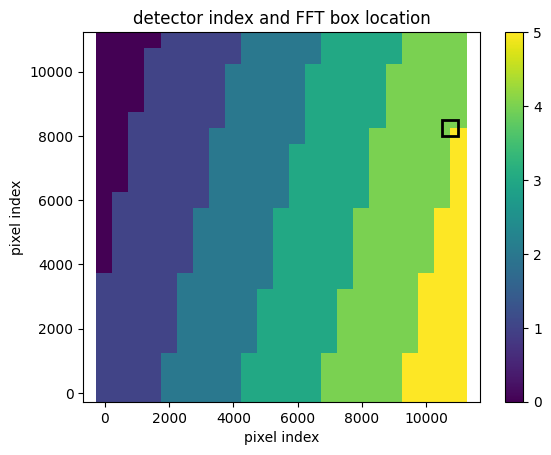

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.998700202357914
(30, 31)
(30, 31)
(30, 31)


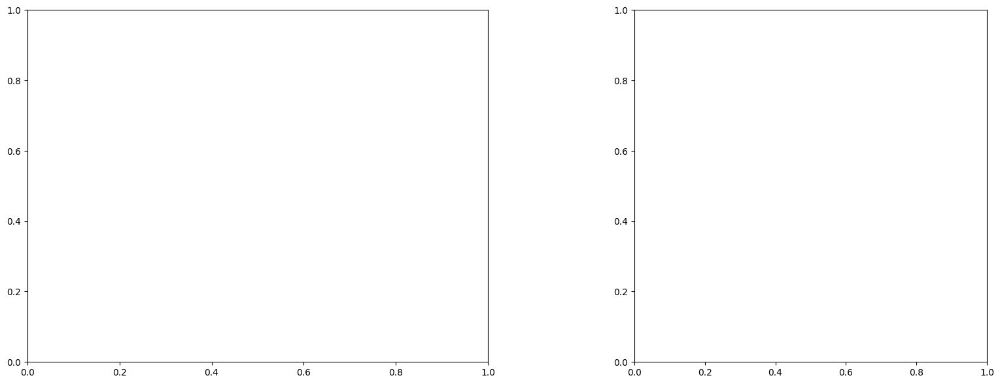

U and V components of current : [1.06285622 1.33228991]
uncertainties for U and V: 0.07562397132701809 0.10521931430699473


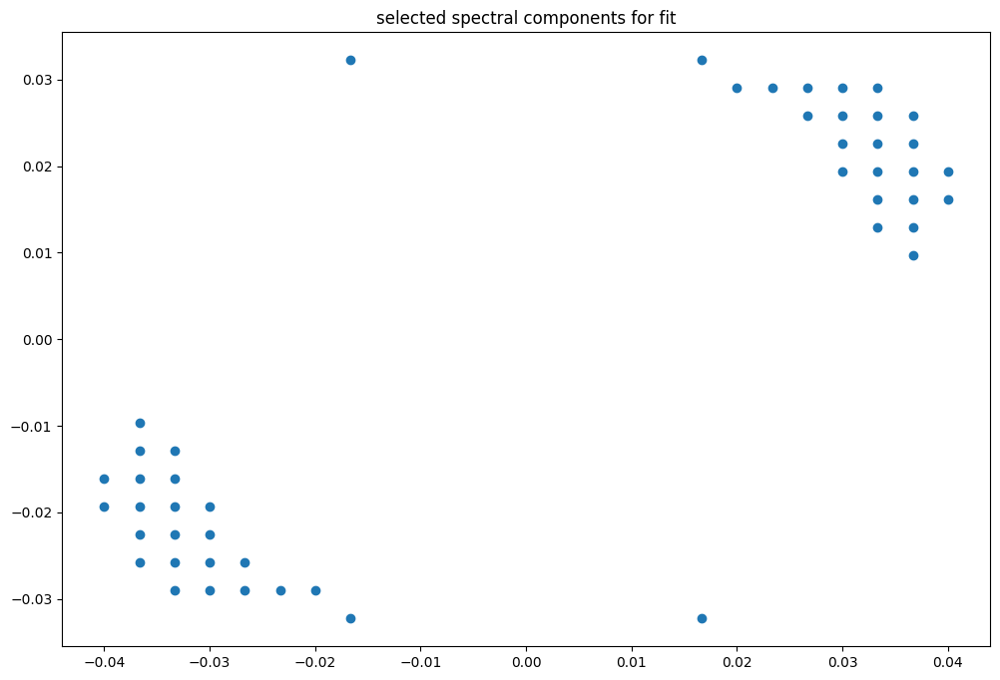

box [10500, 11000, 8500, 9000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

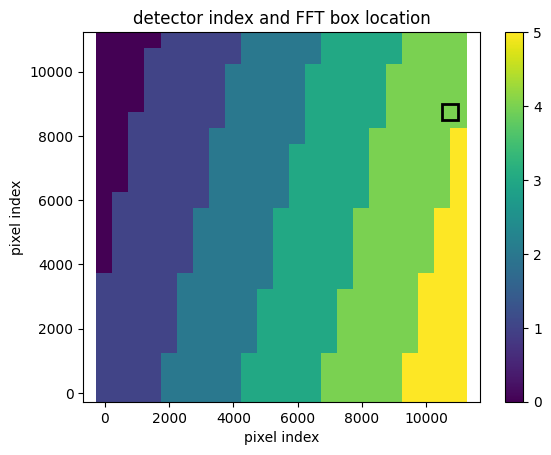

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986973900329713
(30, 31)
(30, 31)
(30, 31)


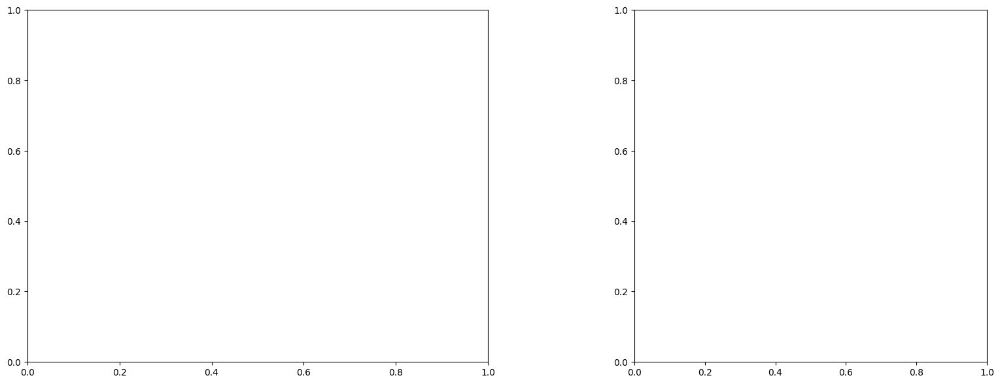

U and V components of current : [0.97804441 1.66378627]
uncertainties for U and V: 0.05873018850536321 0.07959475083219798


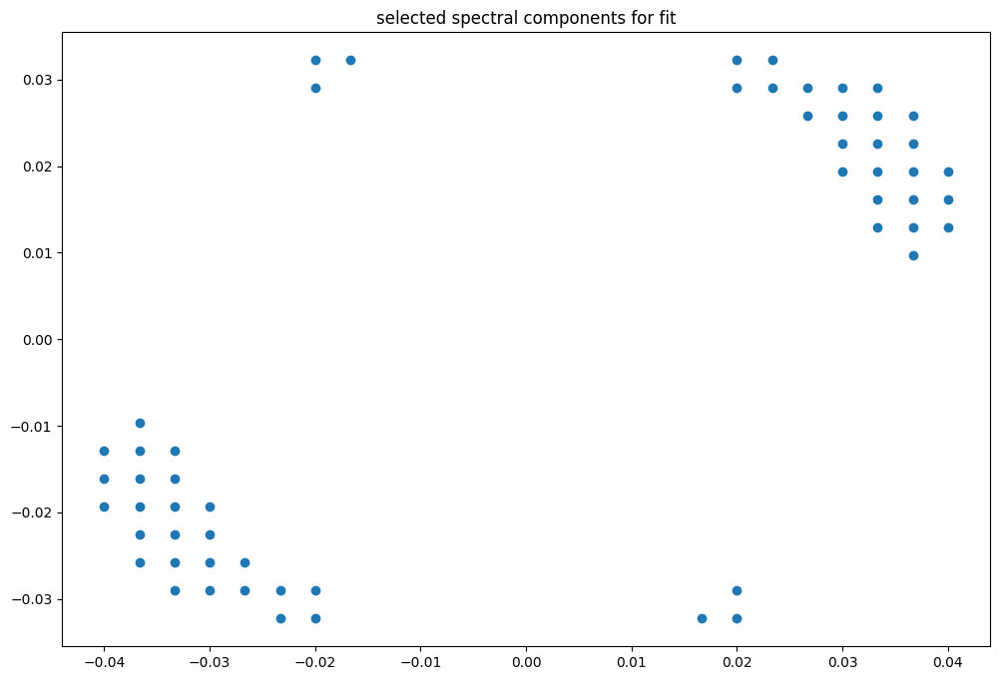

box [10500, 11000, 9000, 9500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Readi

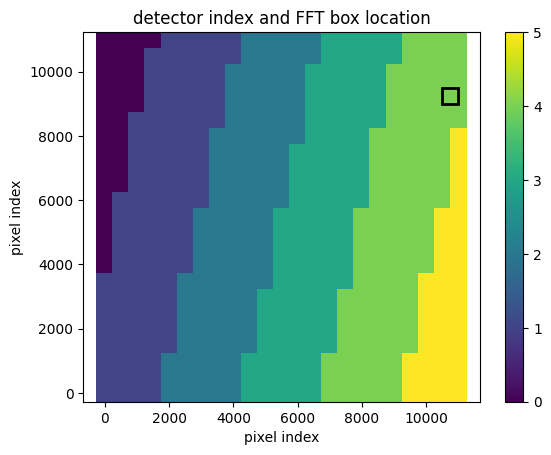

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(30, 31)
(30, 31)
(30, 31)


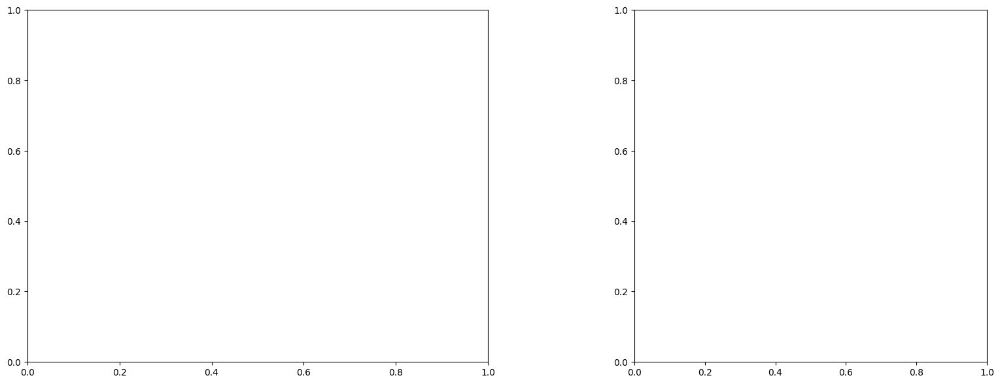

U and V components of current : [1.18728168 1.26169819]
uncertainties for U and V: 0.07629866560230009 0.0901838545076389


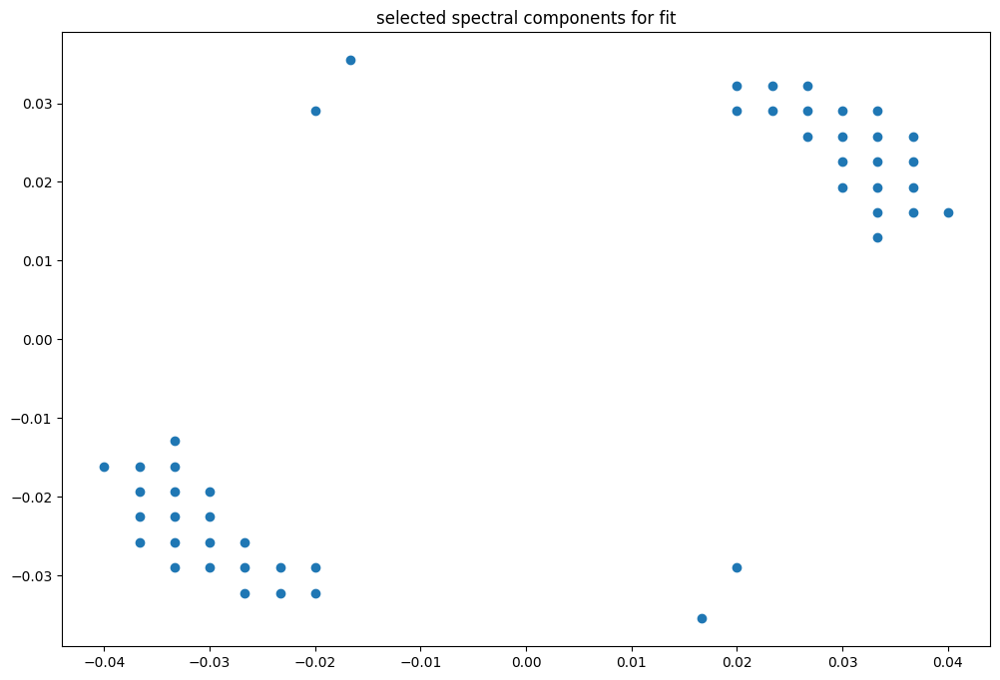

box [10500, 11000, 9500, 10000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Read

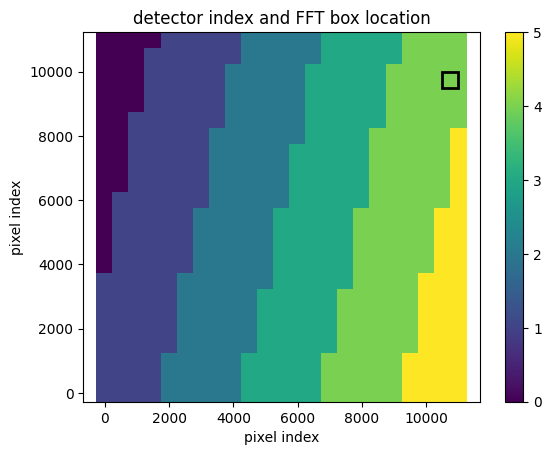

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986945159132669
(30, 31)
(30, 31)
(30, 31)


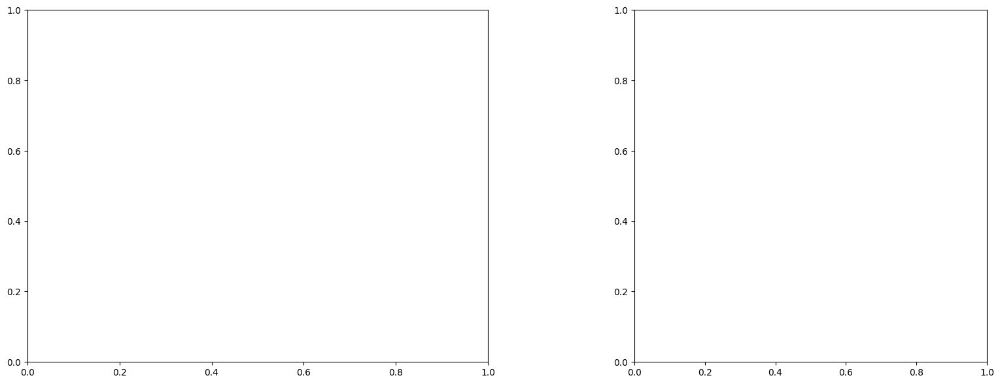

U and V components of current : [1.169789   1.15943937]
uncertainties for U and V: 0.05991084777926365 0.06197514330881974


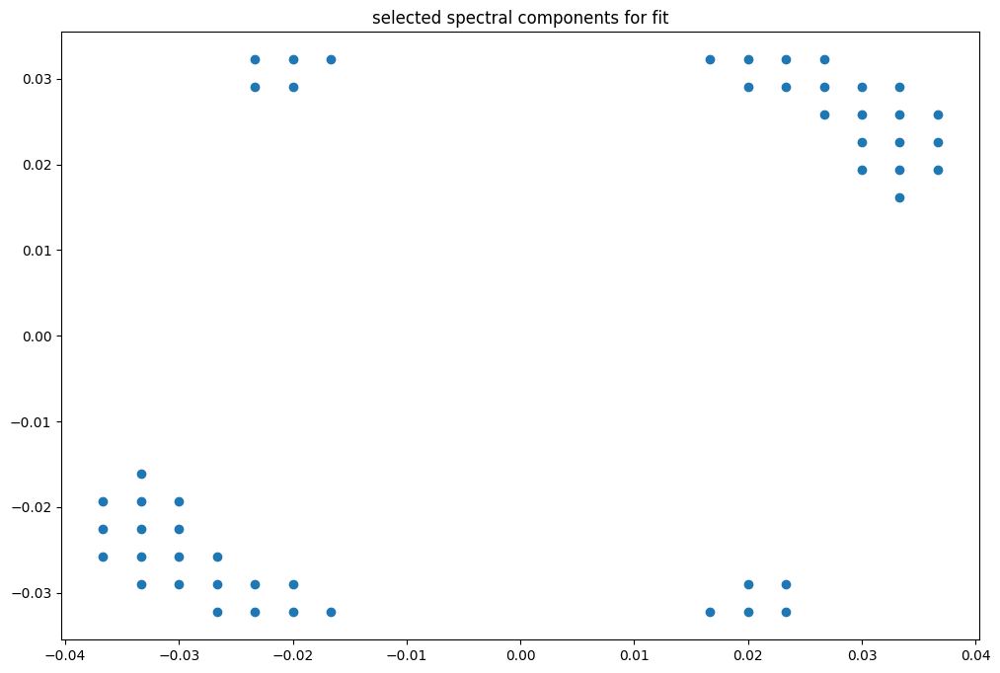

box [10500, 11000, 10000, 10500]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Rea

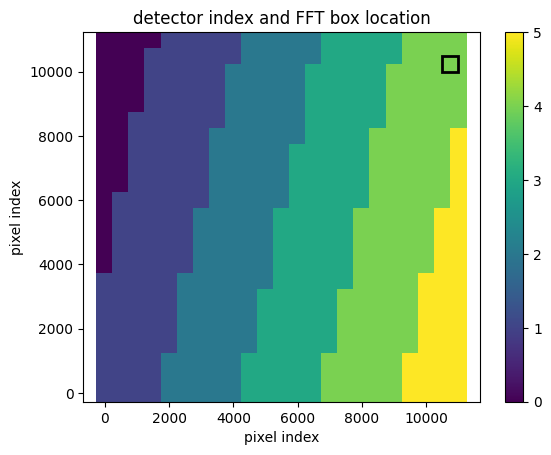

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(30, 31)
(30, 31)
(30, 31)


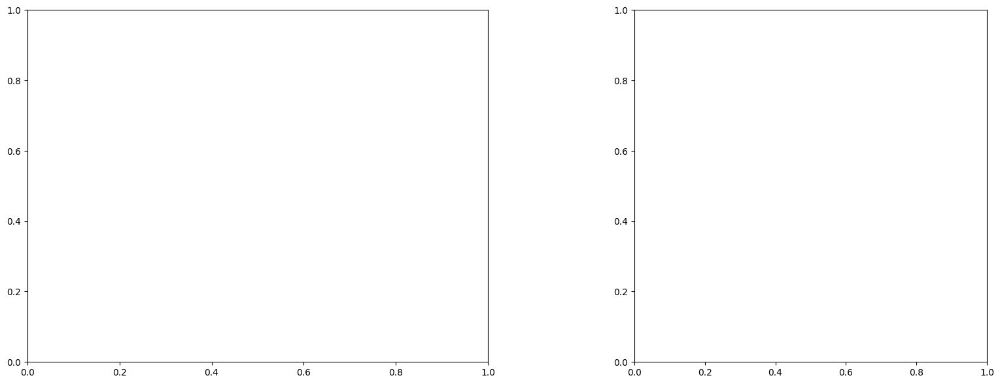

U and V components of current : [1.15112189 1.14367949]
uncertainties for U and V: 0.05189815630768734 0.056712931016504424


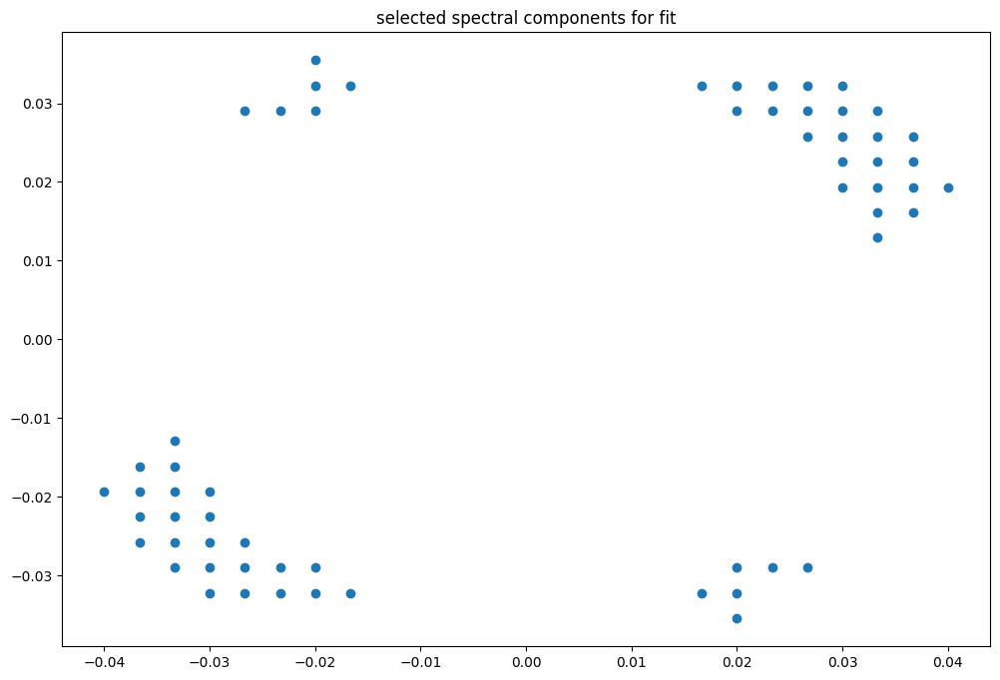

box [10500, 11000, 10500, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/GRANULE/L1C_T39PWM_A006166_20160827T065722/IMG_DATA/T39PWM_20160827T064622_B03.jp2
Rea

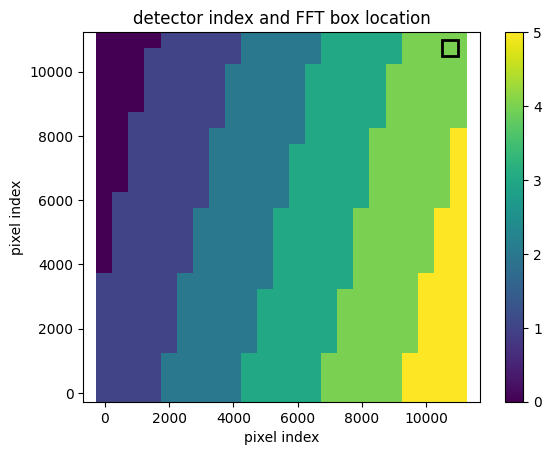

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/DATASTRIP/DS_MTI__20160827T103851_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(30, 30)
(30, 30)
(30, 30)


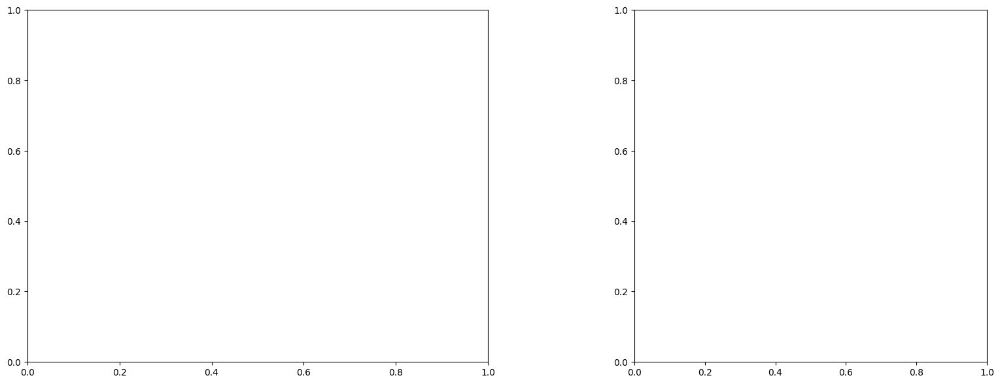

U and V components of current : [1.2218999  1.08355406]
uncertainties for U and V: 0.04533487389047553 0.03961635670487874


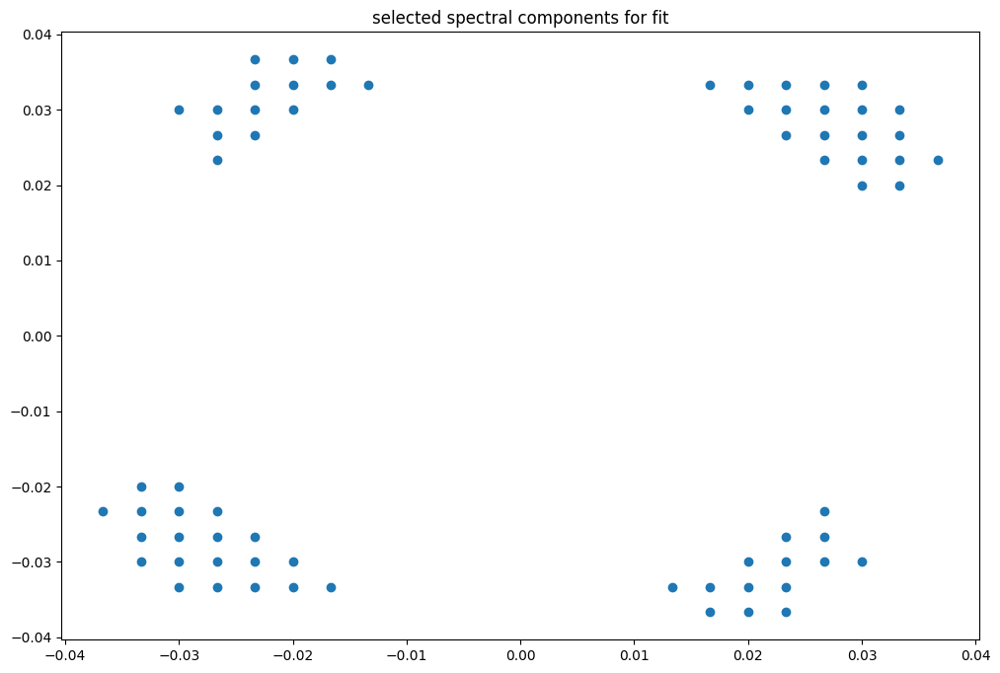

In [8]:
# Initialisation de vos tableaux avec les dimensions calculées
U = np.zeros((width,length))
V = np.zeros((width, length))
coordlon = np.zeros((width, length))
coordlat = np.zeros((width, length))
Sat='A'

# Mother_box=[2000, 10000, 6000,10000]
# taille_boite=800


# Parcourir les boîtes de la grille
for ii in range(1, width ):
    for jj in range(1, length ):

        # Calculer les coordonnées de la boîte en cours
#         index_ii = Mother_box[0] + (ii - 1) * taille_boite
#         index_jj = Mother_box[2] + (jj - 1) * taille_boite
        index_ii = Mother_box[0] + (ii) * taille_boite
        index_jj = Mother_box[2] + (jj) * taille_boite
        # Coordonnées de la boîte en cours
        boxi = [index_ii, min(index_ii + taille_boite , Mother_box[1]), index_jj, min(index_jj + taille_boite , Mother_box[3])]
        print('box',boxi)
        # Traitement de la boîte en cours
        try:
            %run S2_get.ipynb

        except ValueError as ve:
            if str(ve) == "Interpolated value is NaN":
                print(f"Interpolated value is NaN at ii={ii}, jj={jj}, skipping to next iteration")
                U[ii, jj] = np.nan
                V[ii, jj] = np.nan
                coordlon[ii, jj] = loncenter
                coordlat[ii, jj] = latcenter
                continue
                
        except Exception as e:
            print("Une erreur s'est produite lors de l'exécution de 'run' :", e)     
            U[ii, jj] = np.nan
            V[ii, jj] = np.nan
            coordlon[ii, jj] = loncenter  # ii-1 et jj-1 pour compenser le décalage
            coordlat[ii, jj] = latcenter  # ii-1 et jj-1 pour compenser le décalage
            
            continue
        # Récupérer les données
        # Remplacer X[0] et X[1] par les valeurs que vous souhaitez affecter à U et V
        U[ii, jj] = X[0]  # ii-1 et jj-1 pour compenser le décalage
        V[ii, jj] = X[1]  # ii-1 et jj-1 pour compenser le décalage
        coordlon[ii, jj] = loncenter  # ii-1 et jj-1 pour compenser le décalage
        coordlat[ii, jj] = latcenter  # ii-1 et jj-1 pour compenser le décalage


In [9]:
# Si Erreurs 
print(boxi)

[10500, 11000, 10500, 11000]


In [10]:
#taille de tile
print(ntile)
print(k_min_fit)
print(k_max_fit)
print(dirC1)
print(dirC2)

16
35
45
-100
-90


In [11]:
print ('taille U',np.shape(U))
print('taille V',np.shape(V))

print ('type U',type(U))
print('type V',type(V))

# print('box',boxi)
# print('Nsx',ntile)

taille U (22, 22)
taille V (22, 22)
type U <class 'numpy.ndarray'>
type V <class 'numpy.ndarray'>


In [12]:
# print('V=',V)
# print('U=',U)


In [13]:
magnitude = np.sqrt(U**2 + V**2)
print('C=',magnitude)
print('taille C',np.shape(magnitude))

C= [[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.        ]
 [ 0.          0.80769068  0.546183    0.43906324  0.04286528  0.19036703
   0.2895278   0.19096732  0.27406173  0.4852646   0.74720333  7.17886573
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.        ]
 [ 0.          1.1216075   0.21181732  0.24512274  0.33496655  0.26809506
   0.41953344  0.24262593  0.3148172   0.41919559  0.60648579  0.61616848
  10.         10.         10.         10.          3.48604725 10.
  10.         10.         10.         10.        ]
 [ 0.          2.14939309  0.596925    1.21824932  0.20724283  0.35334947
   0.19387168  0.57972227  0.45440863  0.4855652   0.84785537  0.6637351
  10.         10.         10.         10.         10.         10.
   0.

In [14]:
# os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/Results/2025/boxsize_500_test2/')
U1 = U[magnitude <= 3]
V1 = V[magnitude <= 3]
lon1 = coordlon[magnitude <= 3]
lat1 = coordlat[magnitude <= 3]
C1=magnitude[magnitude<=3]
U_filtre=U1
V_filtre=V1
coordlon_filtre=lon1
coordlat_filtre=lat1




In [15]:
# Obtenir le répertoire de travail courant
repertoire_actuel = os.getcwd()

# Afficher le répertoire de travail courant
print(f"Répertoire de travail actuel : {repertoire_actuel}")

Répertoire de travail actuel : /home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant


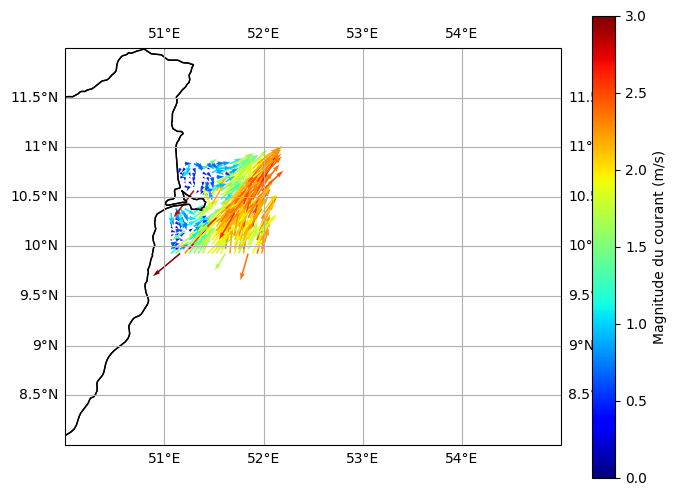

In [16]:
thick = 0.002
scale_quiver = 30
import cartopy.crs as ccrs
import cartopy.feature as cfeature
vmin=0
vmax=3
# Créer une figure avec une projection cartographique
fig, ax = plt.subplots(figsize=(8, 6), subplot_kw={'projection': ccrs.PlateCarree()})

# Tracé du quiver plot
ax.quiver(coordlon_filtre, coordlat_filtre, U_filtre, V_filtre,C1, scale=scale_quiver, cmap='jet', transform=ccrs.PlateCarree()) 

# Afficher la flèche horizontale
# ax.quiver(-9.5, 34, 1, 0, scale=scale_quiver, color='black', width=thick, transform=ccrs.PlateCarree(), label='Horizontal')

# # Afficher la flèche verticale
# ax.quiver(-9.5, 34, 0, 1, scale=scale_quiver, color='black', width=thick, transform=ccrs.PlateCarree(), label='Vertical')

# ax.text(-9.5, 33.9, '1 m/s', fontsize=12, color='black', transform=ccrs.PlateCarree())
# Ajouter la colorbar globale à la figure
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(cmap='jet', norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.05)
cbar.set_label('Magnitude du courant (m/s)')
# Ajouter les côtes
ax.add_feature(cfeature.COASTLINE)
# Ajouter les côtes
ax.add_feature(cfeature.COASTLINE)

# Configuration des axes
ax.set_xlabel('Longitude [°]')
ax.set_ylabel('Latitude [°]')

# ax.set_xlim(8, 11)
# ax.set_ylim(50, 52)


ax.set_xlim(50, 55)
ax.set_ylim(8, 12)

# Ajouter une grille
ax.gridlines(draw_labels=True)
# plt.savefig("sizebox100_ntile8_test2.png", dpi=300)
# Affichage de la carte
plt.show()

In [17]:
# os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/Results/2025/no_white_cap_test2/')

# np.save('U_PYN',U1)
# np.save('V_PYN',V1)
# np.save('lon_PYN',lon1)
# np.save('lat_PYN',lat1)
# np.save('C_PYN',C1)

# # Obtenir le répertoire de travail courant
# repertoire_actuel = os.getcwd()

# # Afficher le répertoire de travail courant
# print(f"Répertoire de travail actuel : {repertoire_actuel}")